In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
default_max_columns=pd.get_option('display.max_columns')

In [10]:
default_max_rows=pd.get_option('display.max_rows')

In [11]:
default_precision=pd.get_option('display.precision')

In [12]:
pd.set_option('display.precision', 2)

In [13]:
default_threshold=np.get_printoptions()['threshold']

In [14]:
#np.set_printoptions(threshold=10000000)

# Read meta data

In [15]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [16]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [17]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [18]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [19]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [20]:
meta.head()

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,


# Read raw matrix

In [21]:
df = pd.read_csv('20210428-EV/report.csv',index_col=0,header=None)

In [22]:
df.shape

(309, 528)

In [23]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,7706323,7706323,7706323,7706323,7706323,7706323,10555114,10555114,10555114,10555114,...,10323625,10323625,10323625,10323625,13959130,13959130,13959130,13959130,13959130,13959130
Raw Read Length,201,201,201,201,201,201,201,201,201,201,...,201,201,201,201,201,201,201,201,201,201
Trimmed Read Count,4578177,7054912,7067406,4879448,4877655,4877495,8524196,10205171,10212051,8828603,...,3781877,3796529,3738351,3735601,4571854,4941457,4965205,5007069,4953640,4951125
Trimmed Ave Read Length,57.8849,60.3426,60.5684,132.375,131.86,131.853,57.5903,67.8537,67.9501,152.468,...,35.3093,40.5618,36.6429,35.0324,30.66,35.8833,36.3939,42.7485,39.1607,37.2782


In [24]:
df.drop("---",inplace=True)

In [25]:
df.shape

(308, 528)

In [26]:
df.rename({'  ':'sample'},axis='rows',inplace=True)

In [27]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,7706323,7706323,7706323,7706323,7706323,7706323,10555114,10555114,10555114,10555114,...,10323625,10323625,10323625,10323625,13959130,13959130,13959130,13959130,13959130,13959130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rnL1PA6,538,3529,3651,612,612,612,1527,4280,4335,2181,...,37,46,46,46,83,88,88,81,81,81
rnSSU-rRNA_Hsa,773,825,825,912,912,912,907,939,942,927,...,4645,4500,4558,4573,2894,2965,2957,2896,2954,2960
rnL1M2,297,3056,3268,524,524,524,1311,7635,7491,1546,...,43,NaN,NaN,NaN,NaN,7,8,1,1,1


In [28]:
df=df.T

In [29]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rnHY4,rnL1MA2,rnL1MA3,rnL1M1,rnL1MA4A,rnL1PA6,rnSSU-rRNA_Hsa,rnL1M2,rnL1MB7,rnA-rich
1,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,4578177,57.8849,99328,2.16,...,33,425,559,389,87,538,773,297,306,87
2,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,7054912,60.3426,140222,1.98,...,33,2756,1627,3296,2103,3529,825,3056,1883,5067
3,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,7067406,60.5684,138584,1.96,...,33,2794,1668,3426,2236,3651,825,3268,2038,5298
4,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,4879448,132.375,105508,2.16,...,33,650,765,604,175,612,912,524,594,273
5,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,4877655,131.86,119834,2.45,...,33,650,765,604,175,612,912,524,594,273


In [30]:
df=df.merge(meta,left_on='Subject',right_on='subject')

In [31]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rnL1M2,rnL1MB7,rnA-rich,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,4578177,57.8849,99328,2.16,...,297,306,87,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,7054912,60.3426,140222,1.98,...,3056,1883,5067,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,7067406,60.5684,138584,1.96,...,3268,2038,5298,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,4879448,132.375,105508,2.16,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,4877655,131.86,119834,2.45,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [32]:
df.columns

Index(['sample', 'Subject', 'Lab kit', 'Trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'rnL1M2', 'rnL1MB7', 'rnA-rich', 'subject', 'dplex', 'lexogen', 'diag',
       'disease', 'idh', 'x1p19q'],
      dtype='object', length=315)


---
Subject
Lab kit
Trimmer
Raw Read Count
Raw Read Length
Trimmed Read Count
Trimmed Ave Read Length
STAR Aligned to Transcriptome
STAR Aligned to Transcriptome %
STAR Aligned to Genome
STAR Aligned to Genome %
STAR Unaligned
STAR Unaligned %
STAR Unmapped
STAR Unmapped %
Bowtie2 Aligned to hg38 (1)
Bowtie2 Aligned to hg38 (1) %
STAR Aligned to mirna
STAR Aligned to mirna %
Bowtie Aligned to mirna
Bowtie Aligned to mirna %
Bowtie2 Aligned to mirna
Bowtie2 Aligned to mirna %
Bowtie2 Aligned to phiX
Bowtie2 Aligned to phiX %
Bowtie2 Aligned to Salmonella
Bowtie2 Aligned to Salmonella %
Bowtie2 Aligned to Burkholderia
Bowtie2 Aligned to Burkholderia %
STAR Gene Counts
LOC102724859
RPH3A
PLCE1
ADGRG6
CCDC151
IGF2
P2RX6
PIGG
MAPT
MIR486-1
MIR486-2
RO60
RWDD2A
RARS2
LOC100335030
NAALADL2
HASPIN
NOL4L
GOLGA2P10
KCNN3
RNA45SN2
GREM2
RNA45SN3
RNA45SN4
RNA45SN1
RNA45SN5
PACS2
MECP2
CASP1P2
FGD2
KIF18B
MIRLET7BHG
FRMD4A
ZMYM2
GRB10
RNA28SN2
RNA28SN3
RNA28SN1
RNA28SN5
RNA28SN4
AHDC1
INS-IGF2
MICAL2
NOTCH2NLB
TTN
TTC21A
TUBGCP4
WSB1
EDEM3
NACC2
STAR miRNA Counts
hsa-mir-4329-hairpin
hsa-mir-5588-hairpin
hsa-mir-92b-hairpin
hsa-mir-4271-hairpin
hsa-mir-548u-hairpin
hsa-mir-1260a-hairpin
hsa-mir-944-hairpin
hsa-mir-10226-hairpin
hsa-mir-4538-hairpin
hsa-mir-4538-mature
hsa-mir-552-hairpin
hsa-mir-486-1-hairpin
hsa-mir-486-2-hairpin
hsa-mir-3908-hairpin
hsa-mir-3168-hairpin
hsa-mir-3168-mature
hsa-mir-4314-hairpin
hsa-mir-3613-hairpin
hsa-mir-6735-hairpin
hsa-mir-8086-hairpin
hsa-mir-137-hairpin
hsa-mir-552-3p-mature
hsa-mir-4668-hairpin
hsa-mir-4668-5p-mature
hsa-mir-484-hairpin
hsa-mir-486-5p-mature
hsa-mir-216b-hairpin
hsa-mir-3658-hairpin
hsa-mir-4283-2-hairpin
hsa-mir-4283-1-hairpin
hsa-mir-1273c-hairpin
hsa-mir-567-hairpin
hsa-mir-3183-hairpin
hsa-mir-1303-hairpin
hsa-mir-662-hairpin
hsa-mir-184-hairpin
hsa-mir-7110-hairpin
hsa-mir-8052-hairpin
hsa-mir-3613-5p-mature
hsa-mir-8052-mature
hsa-mir-509-1-hairpin
hsa-mir-892b-hairpin
hsa-mir-509-2-hairpin
hsa-mir-509-3-hairpin
hsa-mir-6787-hairpin
hsa-mir-6787-5p-mature
hsa-mir-1281-hairpin
hsa-mir-6887-hairpin
hsa-mir-6887-5p-mature
hsa-mir-3613-3p-mature

In [33]:
genes=df.columns[37:87]

In [34]:
genes

Index(['LOC102724859', 'RPH3A', 'PLCE1', 'ADGRG6', 'CCDC151', 'IGF2', 'P2RX6',
       'PIGG', 'MAPT', 'MIR486-1', 'MIR486-2', 'RO60', 'RWDD2A', 'RARS2',
       'LOC100335030', 'NAALADL2', 'HASPIN', 'NOL4L', 'GOLGA2P10', 'KCNN3',
       'RNA45SN2', 'GREM2', 'RNA45SN3', 'RNA45SN4', 'RNA45SN1', 'RNA45SN5',
       'PACS2', 'MECP2', 'CASP1P2', 'FGD2', 'KIF18B', 'MIRLET7BHG', 'FRMD4A',
       'ZMYM2', 'GRB10', 'RNA28SN2', 'RNA28SN3', 'RNA28SN1', 'RNA28SN5',
       'RNA28SN4', 'AHDC1', 'INS-IGF2', 'MICAL2', 'NOTCH2NLB', 'TTN', 'TTC21A',
       'TUBGCP4', 'WSB1', 'EDEM3', 'NACC2'],
      dtype='object')

In [35]:
mirnas=df.columns[88:138]

In [36]:
mirnas

Index(['hsa-mir-4329-hairpin', 'hsa-mir-5588-hairpin', 'hsa-mir-92b-hairpin',
       'hsa-mir-4271-hairpin', 'hsa-mir-548u-hairpin', 'hsa-mir-1260a-hairpin',
       'hsa-mir-944-hairpin', 'hsa-mir-10226-hairpin', 'hsa-mir-4538-hairpin',
       'hsa-mir-4538-mature', 'hsa-mir-552-hairpin', 'hsa-mir-486-1-hairpin',
       'hsa-mir-486-2-hairpin', 'hsa-mir-3908-hairpin', 'hsa-mir-3168-hairpin',
       'hsa-mir-3168-mature', 'hsa-mir-4314-hairpin', 'hsa-mir-3613-hairpin',
       'hsa-mir-6735-hairpin', 'hsa-mir-8086-hairpin', 'hsa-mir-137-hairpin',
       'hsa-mir-552-3p-mature', 'hsa-mir-4668-hairpin',
       'hsa-mir-4668-5p-mature', 'hsa-mir-484-hairpin',
       'hsa-mir-486-5p-mature', 'hsa-mir-216b-hairpin', 'hsa-mir-3658-hairpin',
       'hsa-mir-4283-2-hairpin', 'hsa-mir-4283-1-hairpin',
       'hsa-mir-1273c-hairpin', 'hsa-mir-567-hairpin', 'hsa-mir-3183-hairpin',
       'hsa-mir-1303-hairpin', 'hsa-mir-662-hairpin', 'hsa-mir-184-hairpin',
       'hsa-mir-7110-hairpin', 'hsa-mir-80

In [37]:
families=df.columns[139:189]

In [38]:
families

Index(['Burkholderiaceae', 'no family', 'Enterobacteriaceae', 'Vibrionaceae',
       'Fabaceae', 'Morganellaceae', 'Neisseriaceae', 'Hominidae',
       'Mycobacteriaceae', 'Alcaligenaceae', 'Nocardiaceae', 'Cercopithecidae',
       'Bacillaceae', 'Microcystaceae', 'Lactobacillaceae', 'Pseudomonadaceae',
       'Corynebacteriaceae', 'Peptostreptococcaceae', 'Chromobacteriaceae',
       'Comamonadaceae', 'Streptococcaceae', 'Sutterellaceae', 'Moraxellaceae',
       'Chlamydiaceae', 'Staphylococcaceae', 'Enterococcaceae',
       'Actinomycetaceae', 'Pasteurellaceae', 'Paenibacillaceae',
       'Onchocercidae', 'Hylobatidae', 'Methylophilaceae', 'Chromatiaceae',
       'Xanthomonadaceae', 'Rhodobacteraceae', 'Legionellaceae',
       'Chenopodiaceae', 'Streptomycetaceae', 'Desulfobacteraceae',
       'Lachnospiraceae', 'Listeriaceae', 'Clostridiaceae', 'Oscillospiraceae',
       'Daphniidae', 'Poaceae', 'Rhodospirillaceae', 'Brucellaceae',
       'Erwiniaceae', 'Microviridae', 'Shewanellace

In [39]:
df[families].head()

,Burkholderiaceae,no family,Enterobacteriaceae,Vibrionaceae,Fabaceae,Morganellaceae,Neisseriaceae,Hominidae,Mycobacteriaceae,Alcaligenaceae,...,Listeriaceae,Clostridiaceae,Oscillospiraceae,Daphniidae,Poaceae,Rhodospirillaceae,Brucellaceae,Erwiniaceae,Microviridae,Shewanellaceae
0,56888,37401,16455,8072,15694,2899,5471,8824,3127,13513,...,1490,2261,1876,2126,1449,2942,1630,2106,1546,963
1,82044,62657,26585,12432,21878,4597,27294,16532,4906,20499,...,2910,3181,2425,2649,1696,3992,1921,3326,2139,15309
2,82026,62032,26595,12422,21879,4595,25366,16533,4905,20578,...,2917,3186,2421,2648,1698,3992,1921,3326,2140,14248
3,93215,77742,35032,15143,22929,5091,27191,20578,6847,28961,...,4063,3729,3410,2814,1795,4784,2117,4018,3313,15031
4,93226,66299,35029,15159,22946,5095,12985,20584,6846,20519,...,4067,3732,3410,2815,1796,4782,2116,4024,3312,2272


In [40]:
# These repeat masker names aren't unique so will likely cause an issue later

In [41]:
rmskfamilies=df.columns[190:240]

In [42]:
rmskfamilies

Index(['rfSimple_repeat', 'rfAlu', 'rfL1', 'rfERV1', 'rfL2', 'rfERVL-MaLR',
       'rfMIR', 'rfLow_complexity', 'rfERVL', 'rfhAT-Charlie',
       'rfTcMar-Tigger', 'rfrRNA', 'rfcentr', 'rfscRNA', 'rfSatellite',
       'rfCR1', 'rfsnRNA', 'rfhAT-Tip100', 'rfERVK', 'rftRNA', 'rfSVA',
       'rfGypsy', 'rfRTE-X', 'rfhAT-Blackjack', 'rfTcMar-Mariner',
       'rfTcMar-Tc2', 'rfhAT?', 'rfGypsy?', 'rfRTE-BovB', 'rfhAT',
       'rfMULE-MuDR', 'rftelo', 'rfsrpRNA', 'rftRNA-RTE', 'rfUnknown', 'rfLTR',
       'rfacro', 'rfPiggyBac', 'rfhAT-Ac', 'rfERVL?', 'rfHelitron',
       'rfhAT-Tip100?', 'rf5S-Deu-L2', 'rfDNA', 'rfERV1?', 'rfPenelope',
       'rfRNA', 'rfDong-R4', 'rfTcMar?', 'rftRNA-Deu'],
      dtype='object')

In [43]:
#rmskclasses=df.columns[242:292]
#only 16 classes
rmskclasses=df.columns[241:257]

In [44]:
rmskclasses

Index(['rcSimple_repeat', 'rcSINE', 'rcLINE', 'rcLTR', 'rcDNA',
       'rcLow_complexity', 'rcSatellite', 'rcrRNA', 'rcscRNA', 'rcsnRNA',
       'rctRNA', 'rcRetroposon', 'rcsrpRNA', 'rcUnknown', 'rcRC', 'rcRNA'],
      dtype='object')

In [45]:
#rmsknames=df.columns[294:344]
#There aren't 50 names?
rmsknames=df.columns[258:308]

In [46]:
rmsknames

Index(['rn(G)n', 'rnMER52A', 'rn(C)n', 'rnAluY', 'rnAluSz', 'rn(T)n',
       'rnAluJb', 'rnAluSx', 'rnAluSx1', 'rnL1P4', 'rnAluJr', 'rnAluSq2',
       'rnL2a', 'rnAluJo', 'rnAluSp', 'rnL2c', 'rnG-rich', 'rn(A)n', 'rnL1PA7',
       'rnAluSg', 'rnAluSx3', 'rnAluSz6', 'rnMIR', 'rnMIRb', 'rnAluSc',
       'rnALR/Alpha', 'rnL1ME1', 'rnMER61-int', 'rnL1PB1', 'rnAluSc8',
       'rnAluJr4', 'rnL1M5', 'rnLSU-rRNA_Hsa', 'rnL1PA3', 'rnL2b', 'rnL1PA4',
       'rnL1M4', 'rnL1PA5', 'rnL2', 'rnL1PA16', 'rnHY4', 'rnL1MA2', 'rnL1MA3',
       'rnL1M1', 'rnL1MA4A', 'rnL1PA6', 'rnSSU-rRNA_Hsa', 'rnL1M2', 'rnL1MB7',
       'rnA-rich'],
      dtype='object')

In [47]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [48]:
all_diags=df['diag'].unique()
diags=all_diags[0:3]
diags=np.append(diags,all_diags[4])

In [49]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [50]:
diags=diags.tolist()

In [51]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [52]:
#pd.set_option('display.max_rows',None)

In [53]:
df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

,subject,sample,Raw Read Count
6,3_5,SFHH006aa,10023215
126,4_4,SFHH006ak,10050672
144,4_6,SFHH005am,10062593
270,1_5,SFHH006e,1008964
60,3_10,SFHH005af,10094714
...,...,...,...
156,4_7,SFHH005an,9517041
180,4_9,SFHH005ap,9538332
30,3_7,SFHH006ac,9652912
402,2_5,SFHH006p,9793448


In [54]:
df[['subject','sample','Trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

,subject,sample,Trimmer,Trimmed Read Count
13,3_6,SFHH005ab,bbduk2,10205171
14,3_6,SFHH005ab,bbduk3,10212051
25,3_7,SFHH005ac,bbduk2,10228530
26,3_7,SFHH005ac,bbduk3,10251779
109,4_3,SFHH005aj,bbduk2,10273320
...,...,...,...,...
293,1_7,SFHH005g,cutadapt3,9767418
292,1_7,SFHH005g,cutadapt2,9767588
291,1_7,SFHH005g,cutadapt1,9768194
85,4_1,SFHH005ah,bbduk2,9833609


In [55]:
#pd.set_option('display.max_rows',default_max_rows)

In [56]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rnL1M2,rnL1MB7,rnA-rich,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,4578177,57.8849,99328,2.16,...,297,306,87,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,7054912,60.3426,140222,1.98,...,3056,1883,5067,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,7067406,60.5684,138584,1.96,...,3268,2038,5298,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,4879448,132.375,105508,2.16,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,4877655,131.86,119834,2.45,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [57]:
# Needed to avoid boxplot warning?
#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

# Normalize by Raw Read Count

In [58]:
dfn=df.copy()

In [59]:
dfn.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rnL1M2,rnL1MB7,rnA-rich,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,4578177,57.8849,99328,2.16,...,297,306,87,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,7054912,60.3426,140222,1.98,...,3056,1883,5067,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,7067406,60.5684,138584,1.96,...,3268,2038,5298,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,4879448,132.375,105508,2.16,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,4877655,131.86,119834,2.45,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [60]:
dfn[rmskfamilies].head()

,rfSimple_repeat,rfAlu,rfL1,rfERV1,rfL2,rfERVL-MaLR,rfMIR,rfLow_complexity,rfERVL,rfhAT-Charlie,...,rfHelitron,rfhAT-Tip100?,rf5S-Deu-L2,rfDNA,rfERV1?,rfPenelope,rfRNA,rfDong-R4,rfTcMar?,rftRNA-Deu
0,496246,23725,25395,5066,7323,4905,3707,1791,2847,1807,...,2,38,35,10,2,1,NaN,NaN,NaN,9
1,809608,364708,158691,34998,18956,15716,6480,8057,9000,6203,...,12,40,36,12,42,3,NaN,NaN,2,10
2,812104,382295,169092,35749,19853,15872,6578,8245,9223,6539,...,11,40,36,12,42,3,NaN,NaN,2,10
3,2205852,31688,36882,79672,8776,6960,9422,18111,3843,2479,...,3,40,37,14,43,3,NaN,NaN,3,12
4,2200064,31740,36887,79644,9146,6971,9471,18108,3843,2479,...,3,40,37,14,43,3,NaN,NaN,3,12


In [61]:
dfn[rmskfamilies]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmskfamilies])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[rmskclasses]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmskclasses])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[rmsknames]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsknames])/pd.to_numeric(row['Raw Read Count']), axis=1 )


In [62]:
dfn[rmskfamilies].head()

,rfSimple_repeat,rfAlu,rfL1,rfERV1,rfL2,rfERVL-MaLR,rfMIR,rfLow_complexity,rfERVL,rfhAT-Charlie,...,rfHelitron,rfhAT-Tip100?,rf5S-Deu-L2,rfDNA,rfERV1?,rfPenelope,rfRNA,rfDong-R4,rfTcMar?,rftRNA-Deu
0,6.44e+07,3.08e+06,3.30e+06,6.57e+05,9.50e+05,6.36e+05,4.81e+05,2.32e+05,3.69e+05,234482.77,...,259.53,4931.02,4541.73,1297.64,259.53,129.76,NaN,NaN,NaN,1167.87
1,1.05e+08,4.73e+07,2.06e+07,4.54e+06,2.46e+06,2.04e+06,8.41e+05,1.05e+06,1.17e+06,804923.44,...,1557.16,5190.54,4671.49,1557.16,5450.07,389.29,NaN,NaN,259.53,1297.64
2,1.05e+08,4.96e+07,2.19e+07,4.64e+06,2.58e+06,2.06e+06,8.54e+05,1.07e+06,1.20e+06,848524.00,...,1427.40,5190.54,4671.49,1557.16,5450.07,389.29,NaN,NaN,259.53,1297.64
3,2.86e+08,4.11e+06,4.79e+06,1.03e+07,1.14e+06,9.03e+05,1.22e+06,2.35e+06,4.99e+05,321683.90,...,389.29,5190.54,4801.25,1816.69,5579.83,389.29,NaN,NaN,389.29,1557.16
4,2.85e+08,4.12e+06,4.79e+06,1.03e+07,1.19e+06,9.05e+05,1.23e+06,2.35e+06,4.99e+05,321683.90,...,389.29,5190.54,4801.25,1816.69,5579.83,389.29,NaN,NaN,389.29,1557.16


rfSimple_repeat D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.572218965727758
	p = 0.01918627083843878
rfSimple_repeat D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8301663533213575
	p = 0.08383582316110644
rfSimple_repeat D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.572218965727758
	p = 0.01918627083843878
rfSimple_repeat D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8301663533213575
	p = 0.08383582316110644


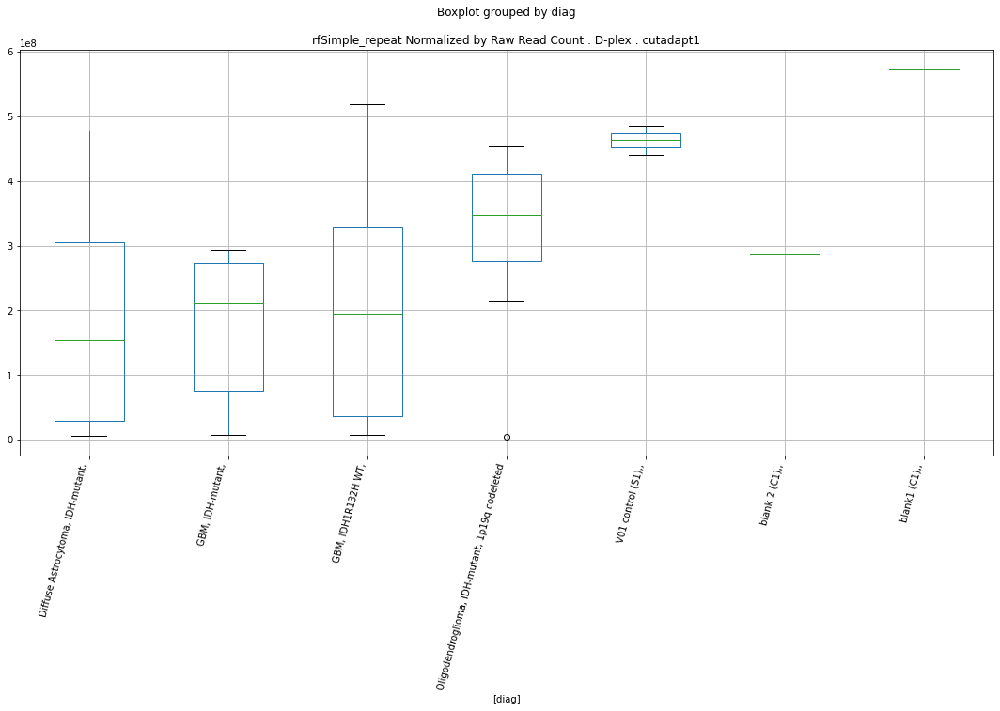

rfSimple_repeat D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.574614935577638
	p = 0.019090147103099513
rfSimple_repeat D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8314915217413985
	p = 0.08362994156037709
rfSimple_repeat D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.574614935577638
	p = 0.019090147103099513
rfSimple_repeat D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8314915217413985
	p = 0.08362994156037709


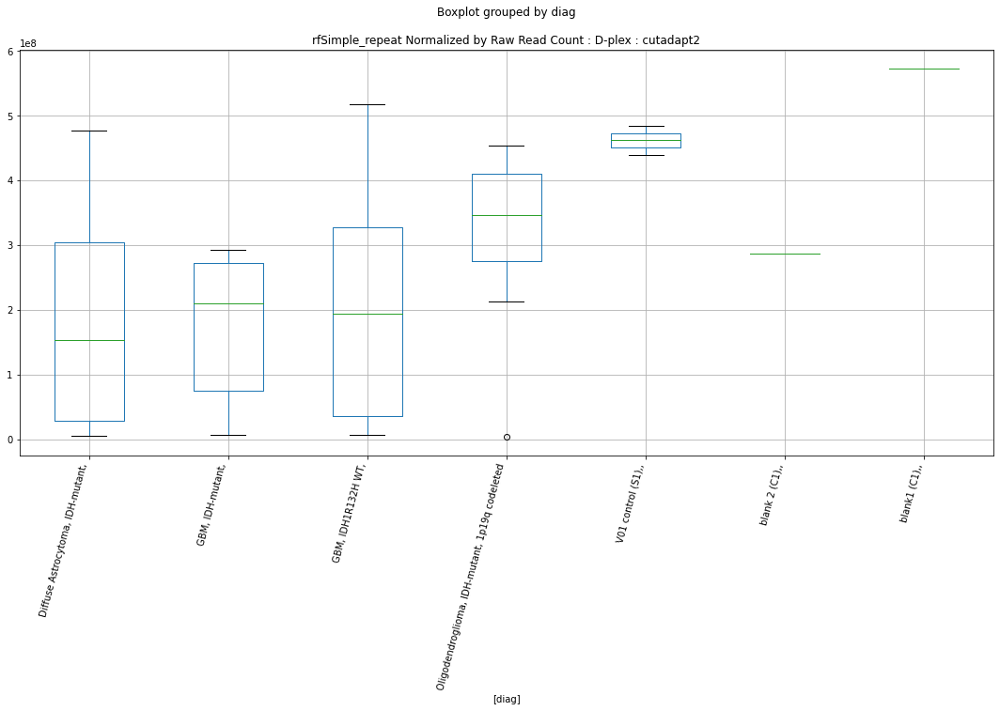

rfSimple_repeat D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.574506864984838
	p = 0.01909447293651817
rfSimple_repeat D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8313927122583495
	p = 0.08364527752594555
rfSimple_repeat D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.574506864984838
	p = 0.01909447293651817
rfSimple_repeat D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8313927122583495
	p = 0.08364527752594555


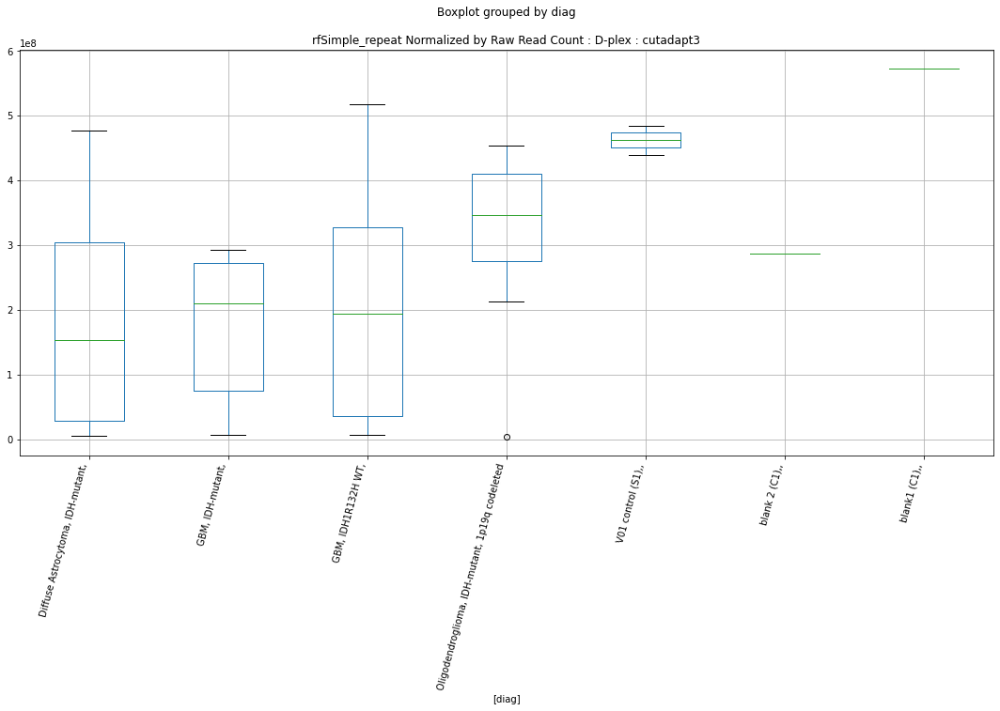

rfSimple_repeat Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8070078328324408
	p = 0.08750626534658655
rfSimple_repeat Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8070078328324408
	p = 0.08750626534658655


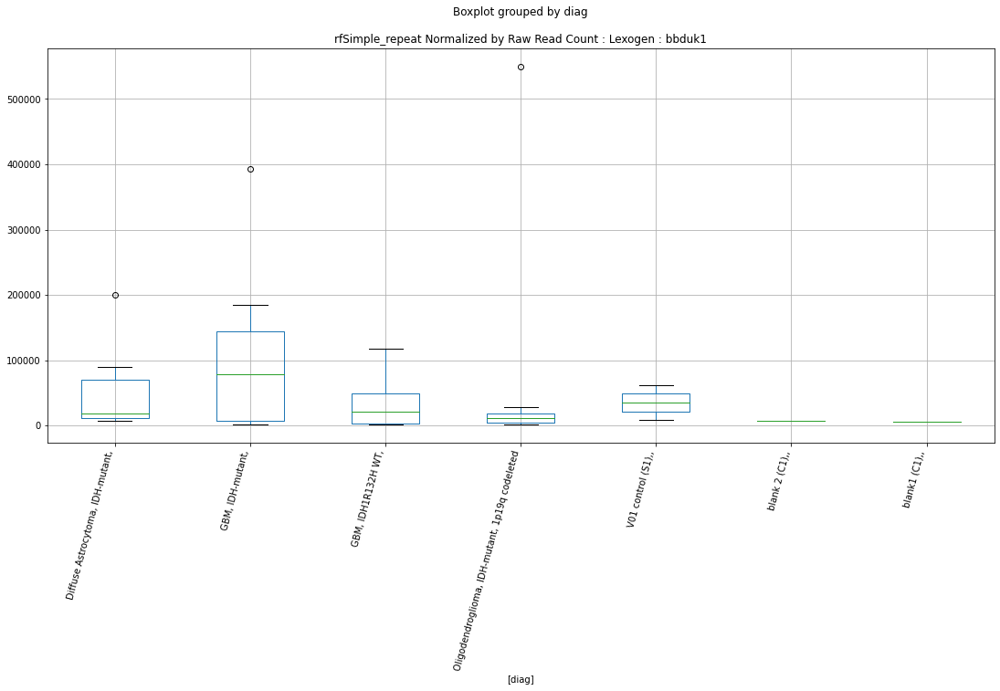

rfSimple_repeat Lexogen bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7431703998984291
	p = 0.09836012729963921
rfSimple_repeat Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7431703998984291
	p = 0.09836012729963921


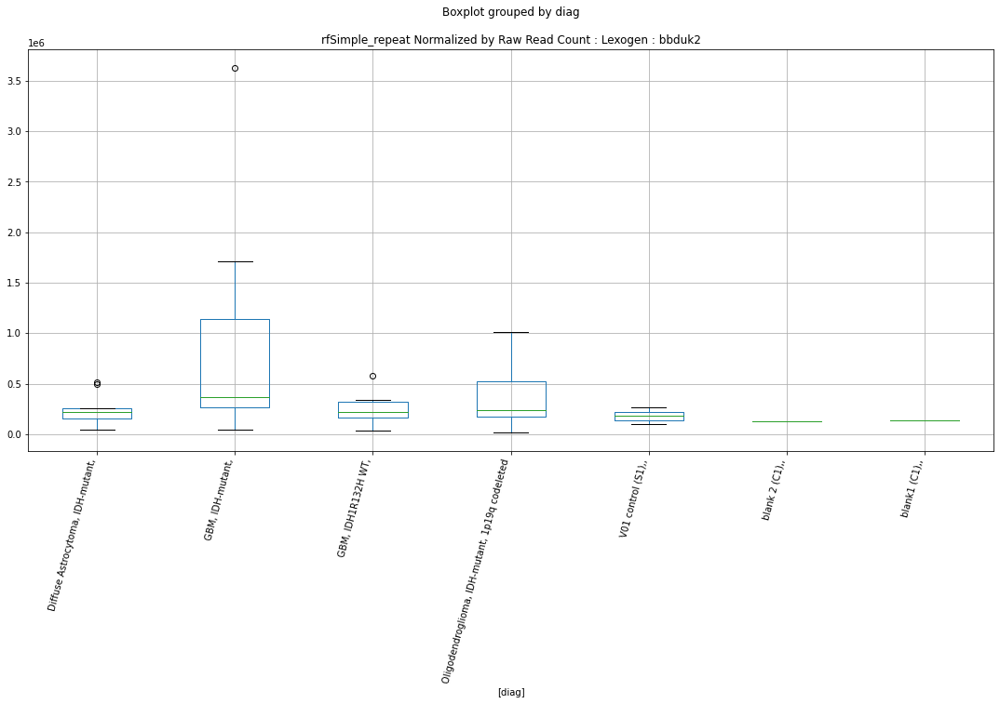

rfAlu D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1503539793621034
	p = 0.04536518255261148
rfAlu D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1503539793621034
	p = 0.04536518255261148


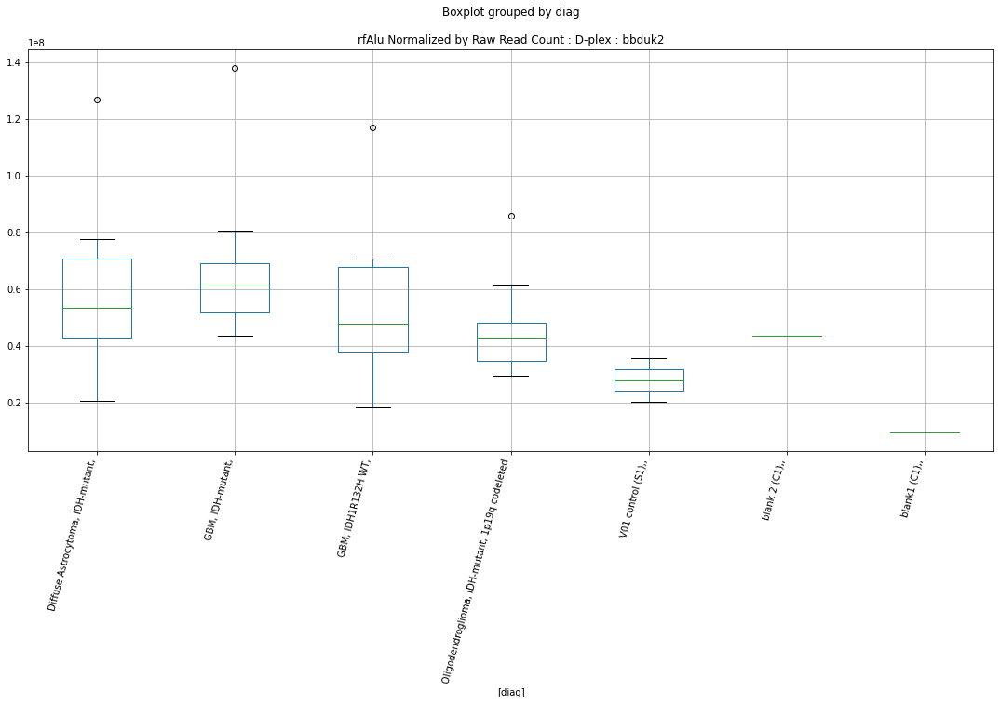

rfAlu D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.229367214704528
	p = 0.038766505416684915
rfAlu D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.229367214704528
	p = 0.038766505416684915


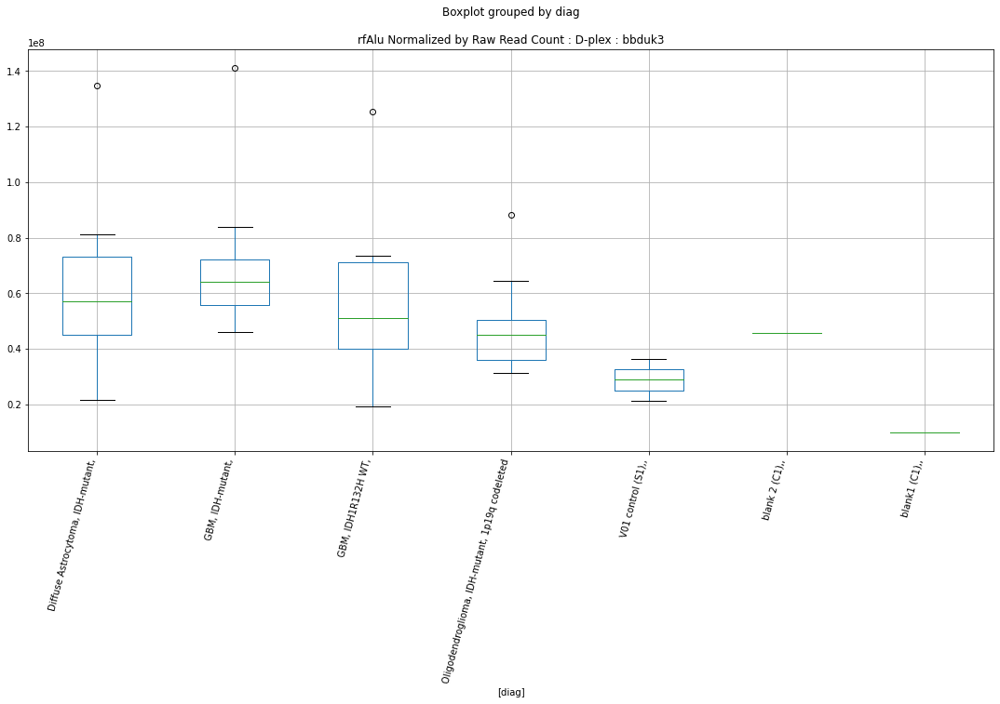

rfL1 Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9749679566571536
	p = 0.06381289177291143
rfL1 Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9749679566571536
	p = 0.06381289177291143


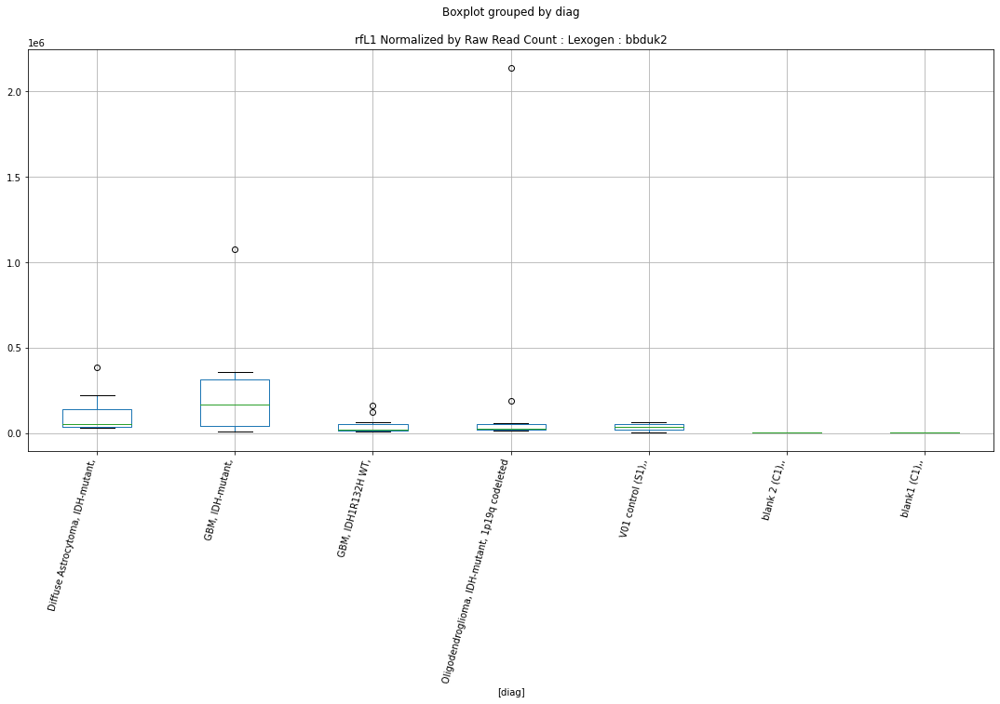

rfL1 Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9738613752778384
	p = 0.06394812461715198
rfL1 Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9738613752778384
	p = 0.06394812461715198


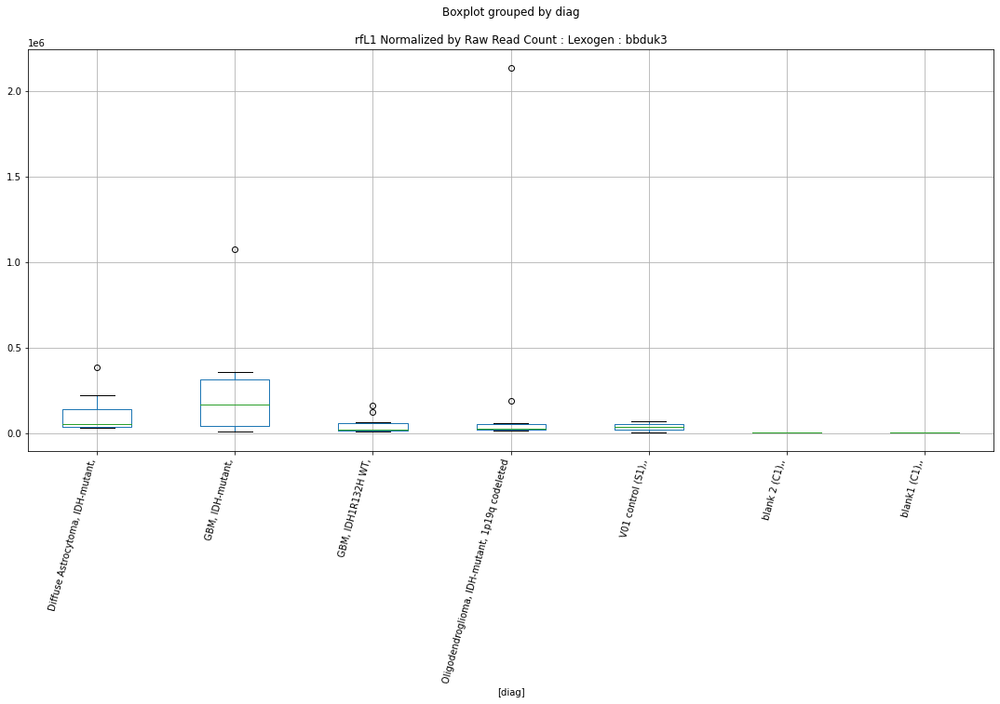

rfL1 Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.029258936150234
	p = 0.05748503829420067
rfL1 Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.029258936150234
	p = 0.05748503829420067


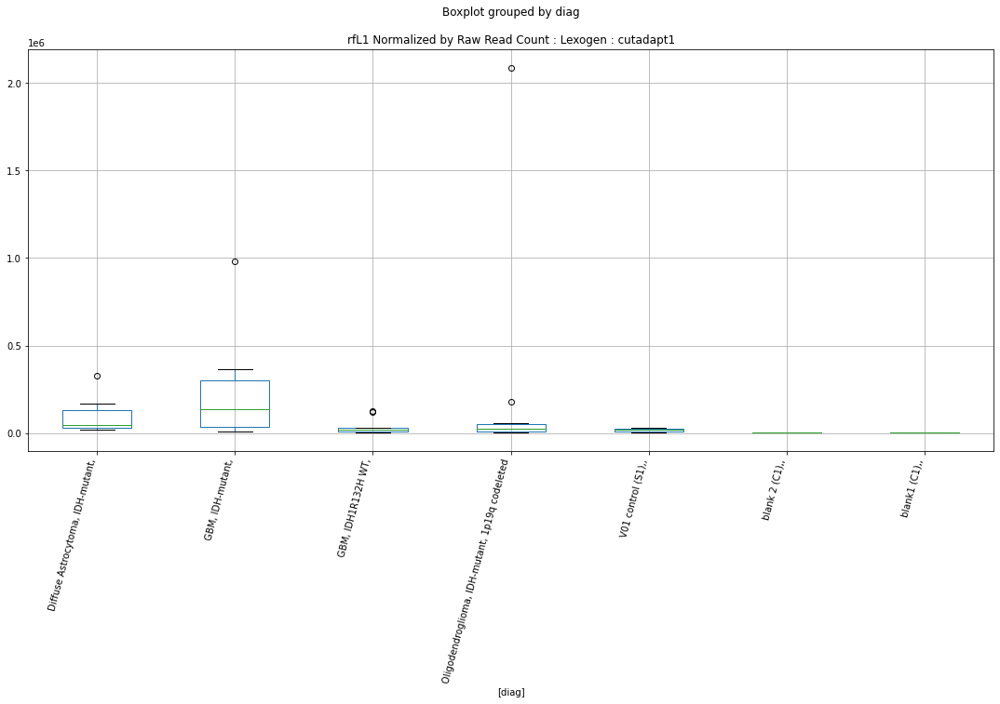

rfL1 Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0208361979763083
	p = 0.05842818084464421
rfL1 Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0208361979763083
	p = 0.05842818084464421


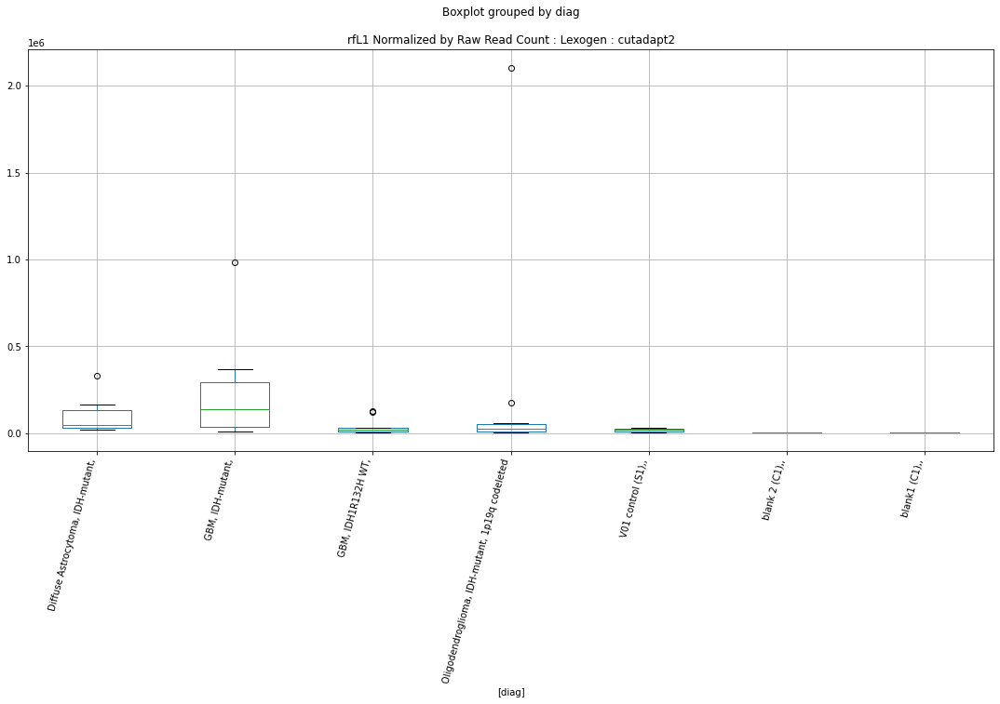

rfL1 Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0249096425806505
	p = 0.057970326813147906
rfL1 Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0249096425806505
	p = 0.057970326813147906


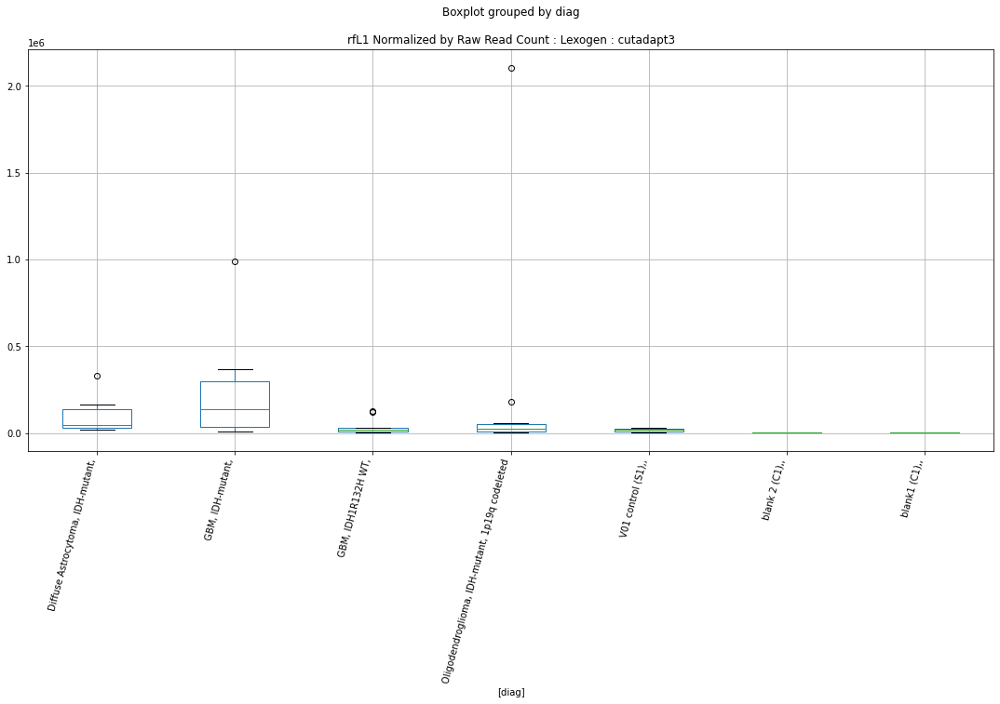

rfERV1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.851222714005571
	p = 0.08061658470447507
rfERV1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.32050609214741
	p = 0.03225905790286611
rfERV1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.851222714005571
	p = 0.08061658470447507
rfERV1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.32050609214741
	p = 0.03225905790286611


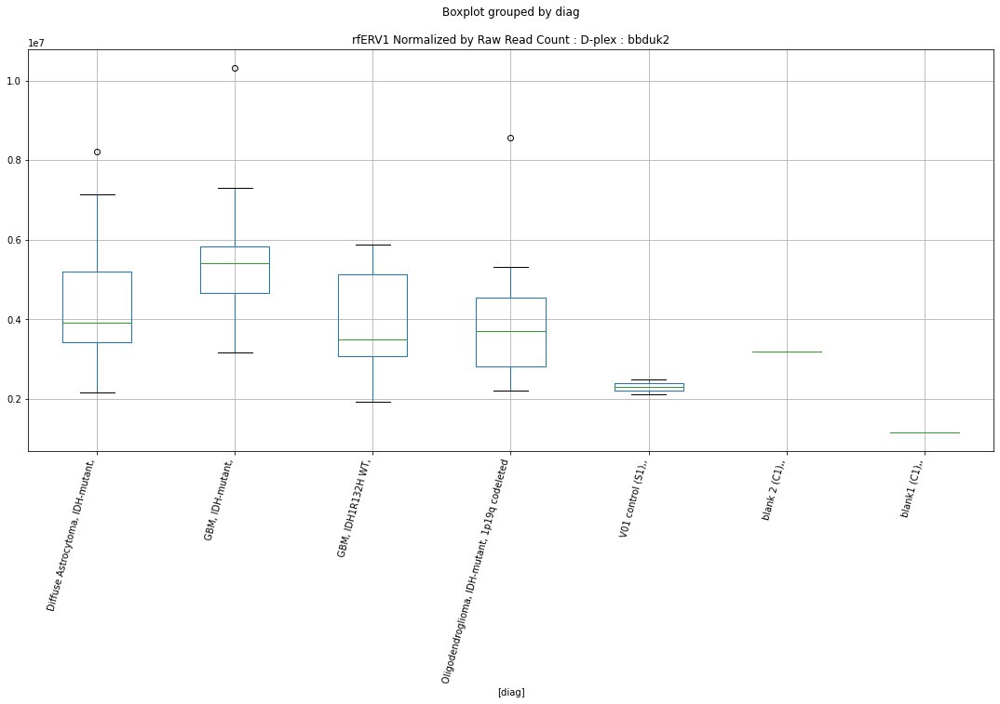

rfERV1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8861670859098314
	p = 0.07551399587071189
rfERV1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.294018839926676
	p = 0.034037513036750344
rfERV1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8861670859098314
	p = 0.07551399587071189
rfERV1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.294018839926676
	p = 0.034037513036750344


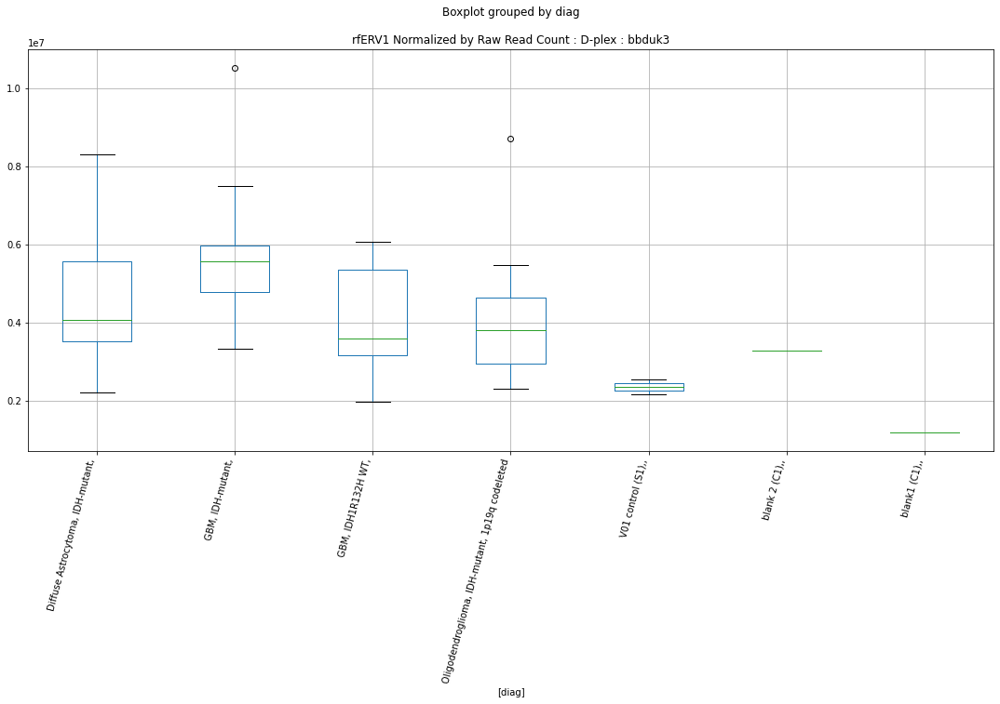

rfERV1 D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0556624715657072
	p = 0.05461680991145697
rfERV1 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0556624715657072
	p = 0.05461680991145697
rfERV1 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.225155267601922
	p = 0.03909469634676965
rfERV1 D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.225155267601922
	p = 0.03909469634676965


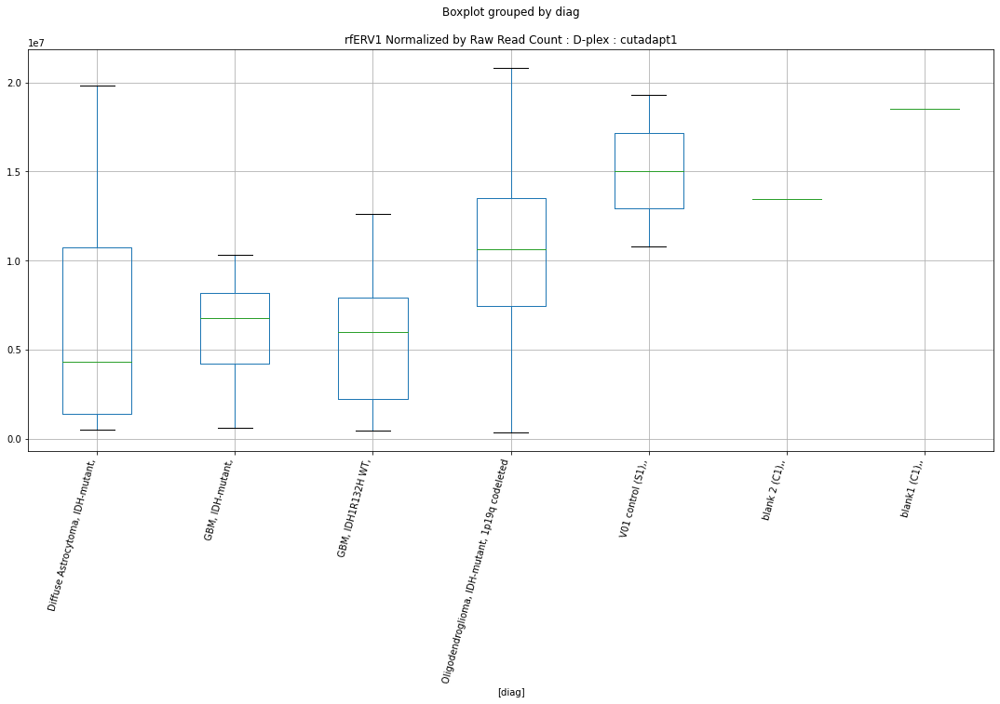

rfERV1 D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0555902944797046
	p = 0.05462447101386423
rfERV1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0555902944797046
	p = 0.05462447101386423
rfERV1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.225951306833633
	p = 0.039032474337067
rfERV1 D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.225951306833633
	p = 0.039032474337067


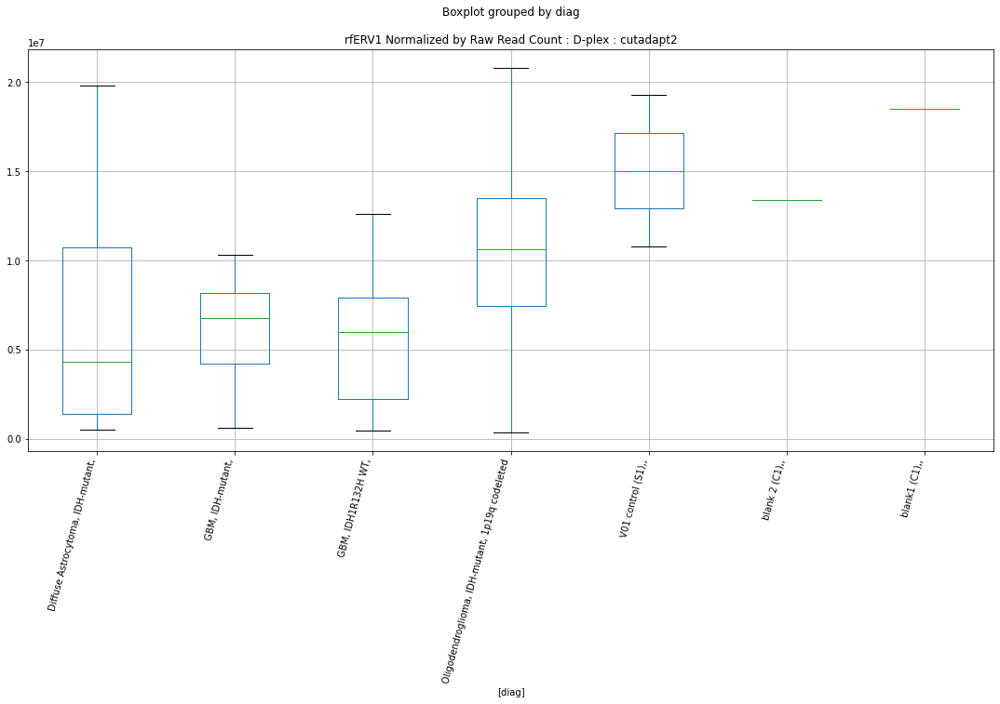

rfERV1 D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0556585536881777
	p = 0.05461722574233178
rfERV1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0556585536881777
	p = 0.05461722574233178
rfERV1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.2260006072024536
	p = 0.03902862379822849
rfERV1 D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.2260006072024536
	p = 0.03902862379822849


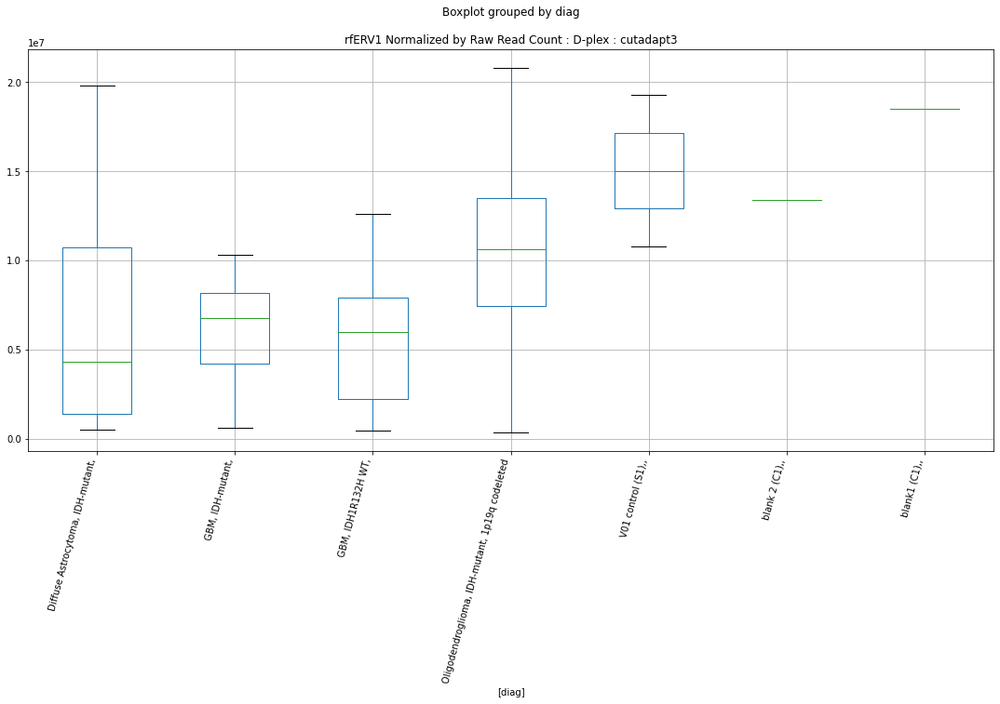

rfL2 Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9166387274566814
	p = 0.07129999427495086
rfL2 Lexogen bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9500606827206701
	p = 0.06691950952056494
rfL2 Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9166387274566814
	p = 0.07129999427495086
rfL2 Lexogen bbduk1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9500606827206701
	p = 0.06691950952056494


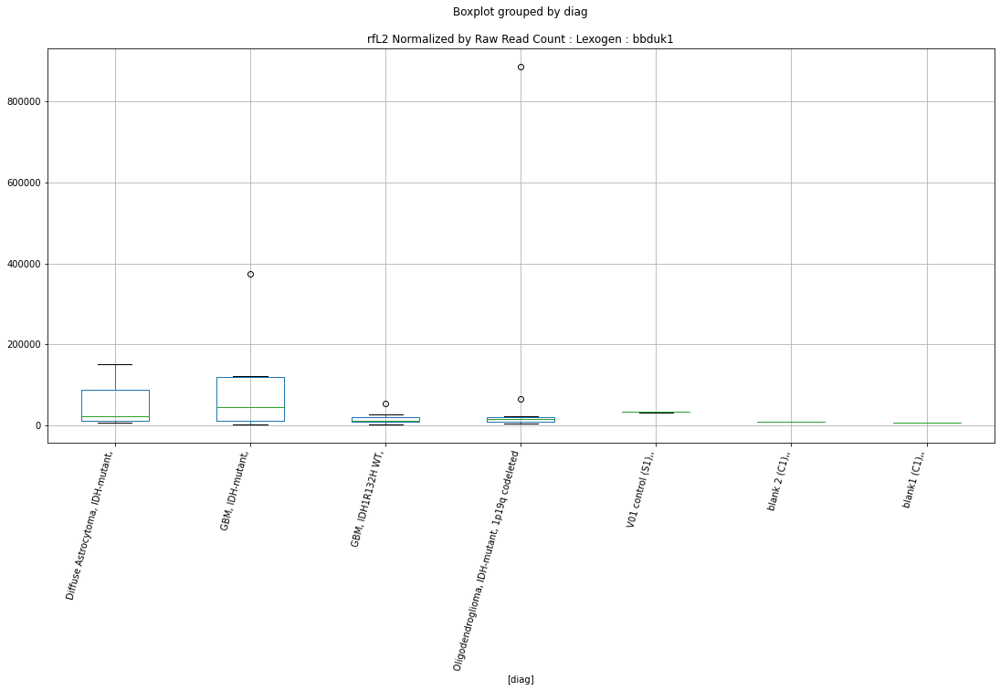

rfL2 Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0371737811660404
	p = 0.05661129860869734
rfL2 Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0729795544738394
	p = 0.05280656901074099
rfL2 Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0371737811660404
	p = 0.05661129860869734
rfL2 Lexogen bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0729795544738394
	p = 0.05280656901074099


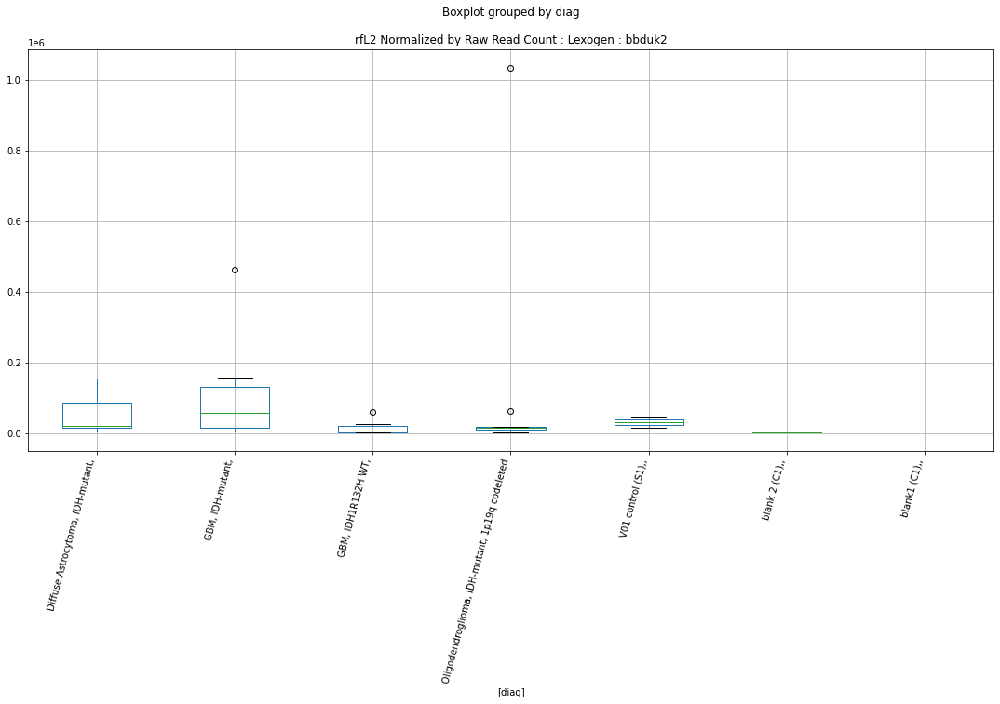

rfL2 Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.034112958104536
	p = 0.05694775991140978
rfL2 Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.06904933902126
	p = 0.05321258015217128
rfL2 Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.034112958104536
	p = 0.05694775991140978
rfL2 Lexogen bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.06904933902126
	p = 0.05321258015217128


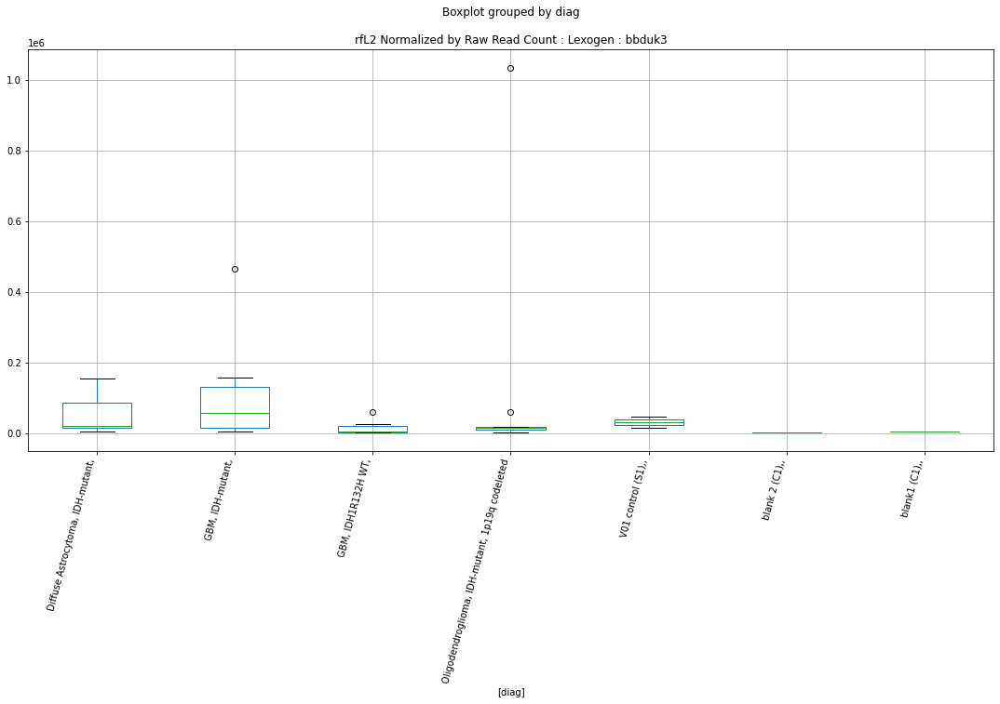

rfL2 Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1643170663278557
	p = 0.044128958371642615
rfL2 Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1408435228610445
	p = 0.046225224679094665
rfL2 Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1643170663278557
	p = 0.044128958371642615
rfL2 Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.1408435228610445
	p = 0.046225224679094665


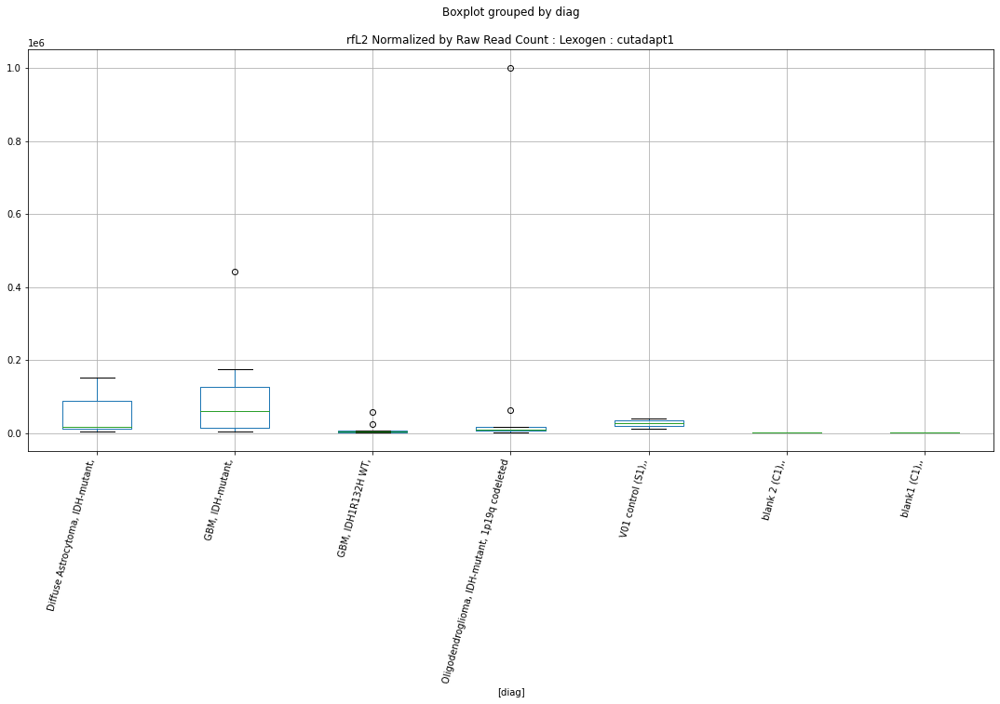

rfL2 Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1597311510932373
	p = 0.04453153304514419
rfL2 Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.127199623493532
	p = 0.04748506359372007
rfL2 Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1597311510932373
	p = 0.04453153304514419
rfL2 Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.127199623493532
	p = 0.04748506359372007


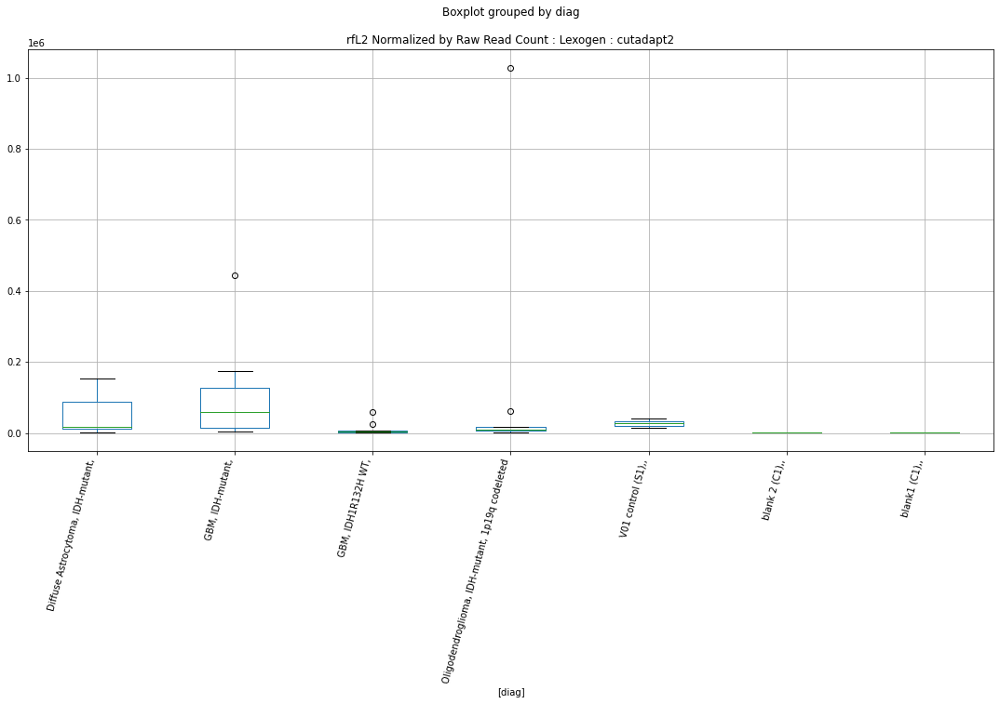

rfL2 Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.162359604627541
	p = 0.04430038513093715
rfL2 Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1303681841080655
	p = 0.047189727758057555
rfL2 Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.162359604627541
	p = 0.04430038513093715
rfL2 Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.1303681841080655
	p = 0.047189727758057555


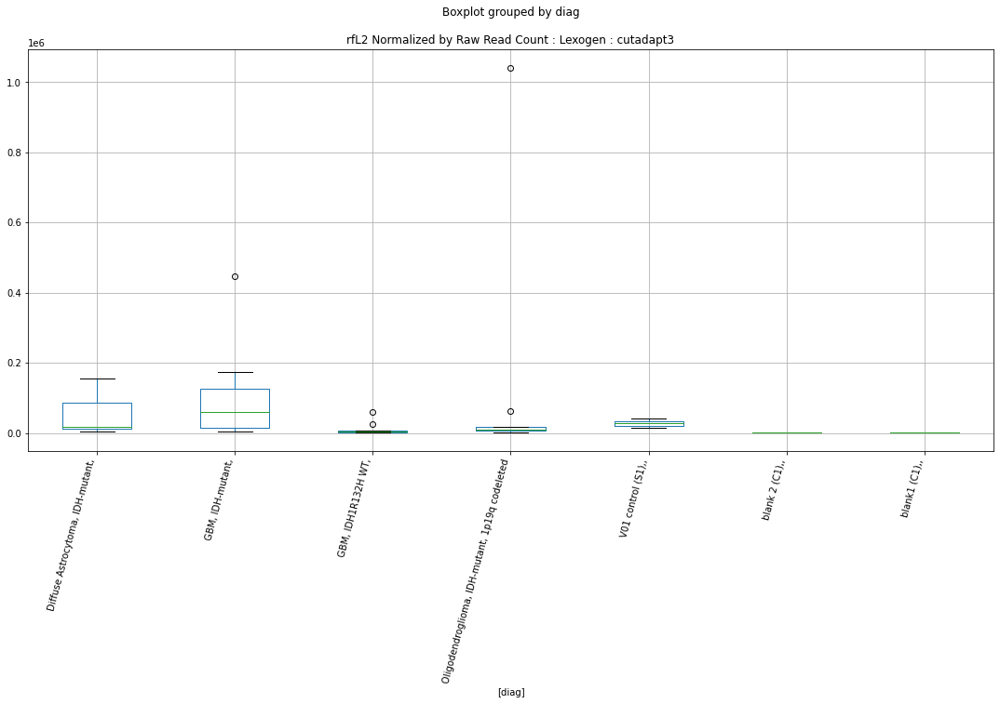

rfERVL-MaLR Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.819239957727586
	p = 0.08555039990119064
rfERVL-MaLR Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.819239957727586
	p = 0.08555039990119064


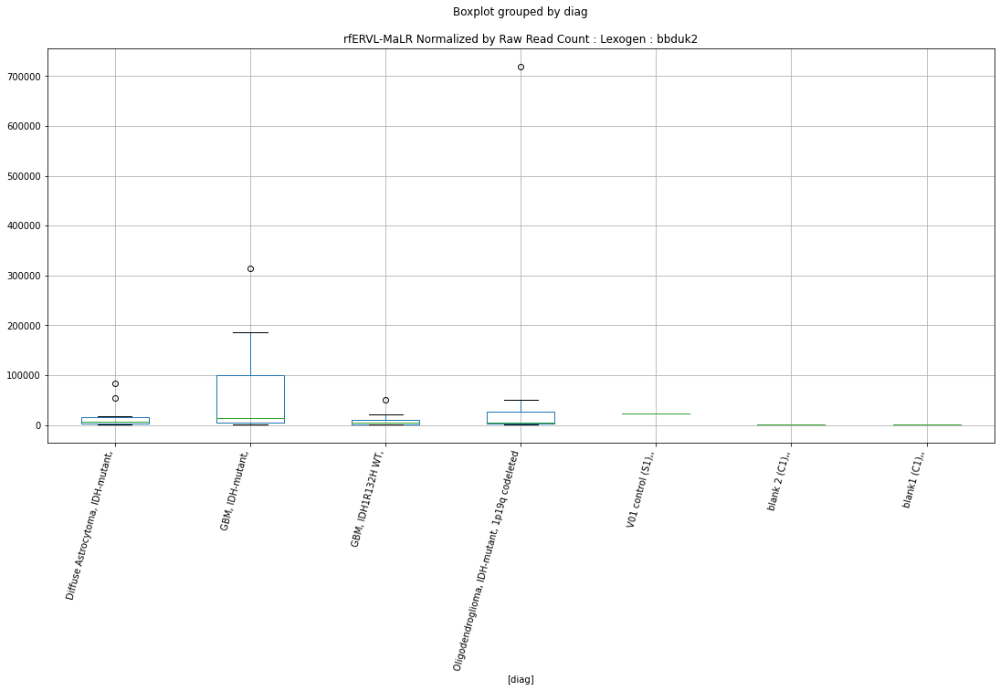

rfERVL-MaLR Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8184879735471422
	p = 0.08566952458004996
rfERVL-MaLR Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8184879735471422
	p = 0.08566952458004996


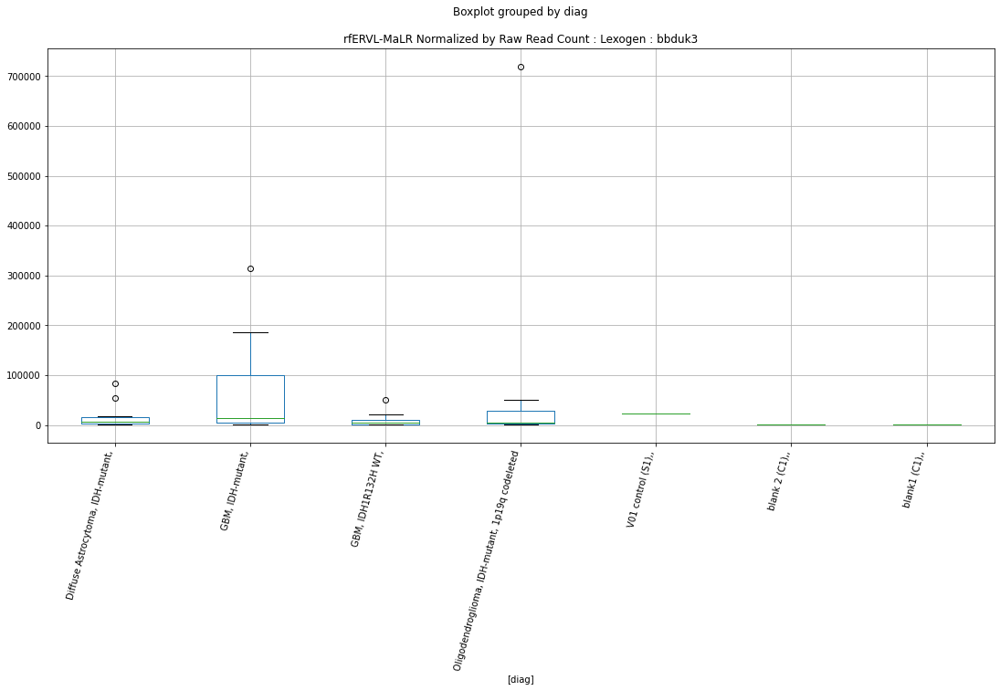

rfMIR D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.743490406424358
	p = 0.0983029292609814
rfMIR D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.743490406424358
	p = 0.0983029292609814


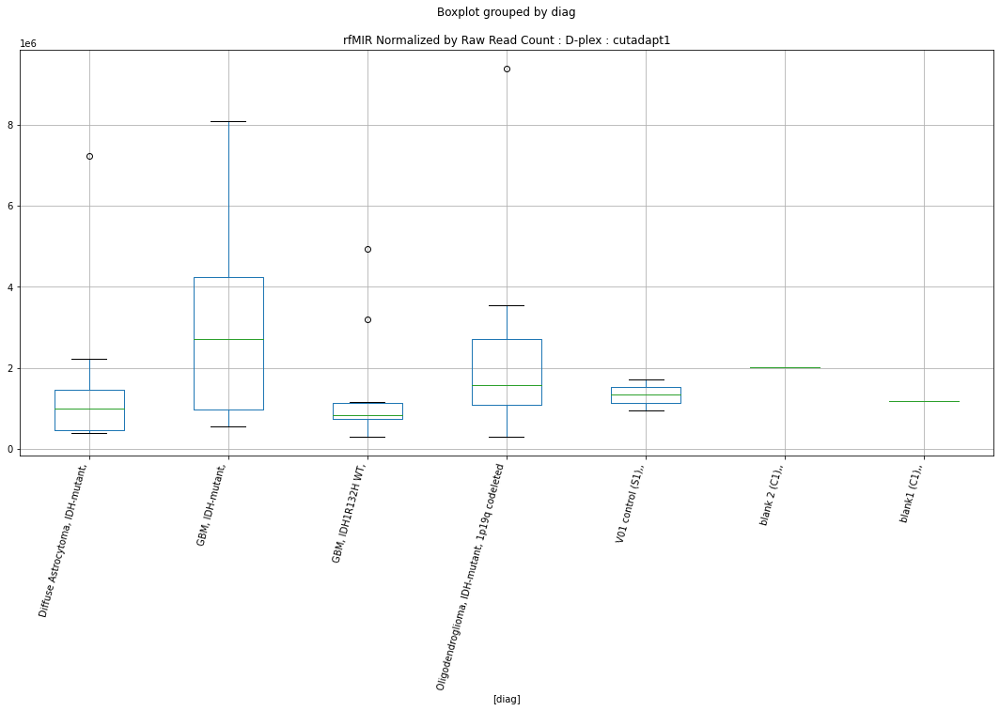

rfMIR D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7433191482165975
	p = 0.09833353640740462
rfMIR D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7433191482165975
	p = 0.09833353640740462


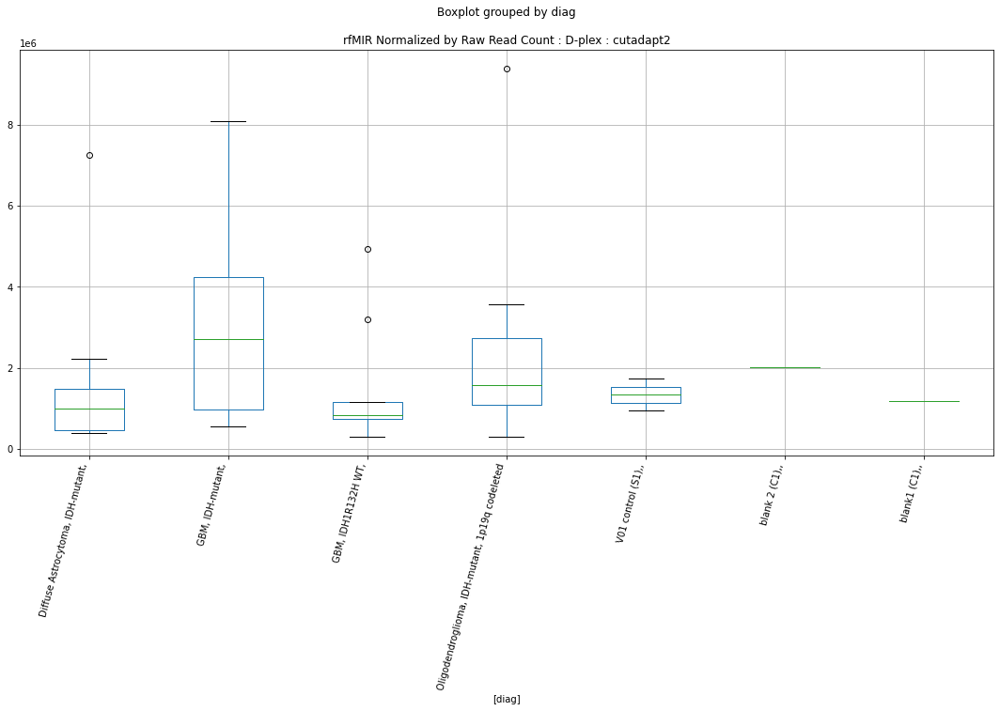

rfMIR D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7436936779643453
	p = 0.0982666114239304
rfMIR D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7436936779643453
	p = 0.0982666114239304


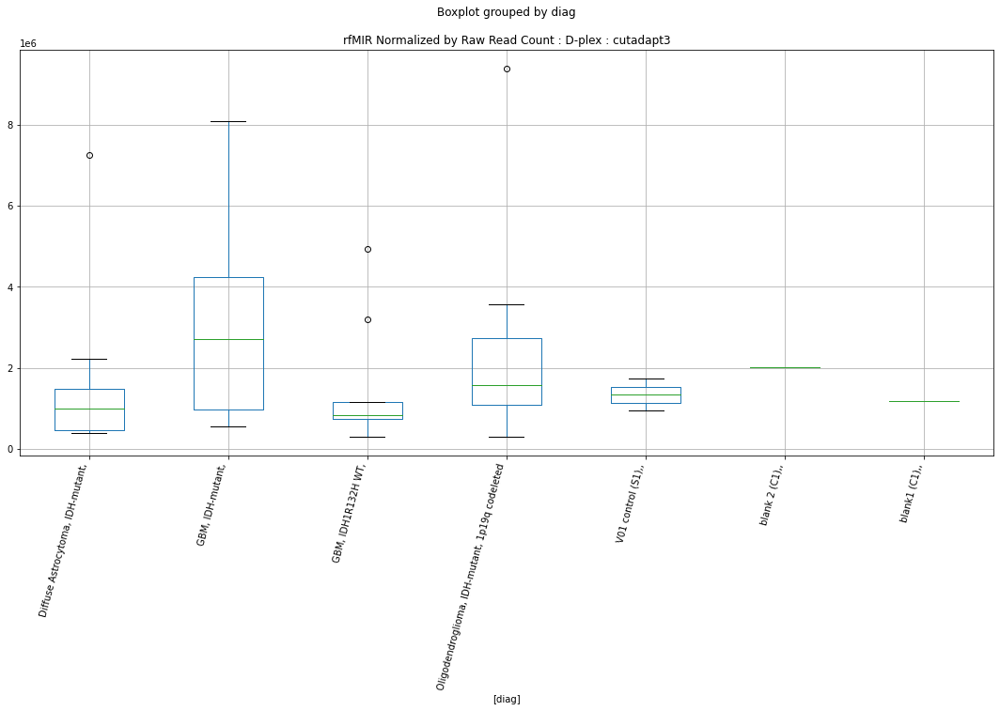

rfLow_complexity D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8671292018790007
	p = 0.07825736765779509
rfLow_complexity D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8671292018790007
	p = 0.07825736765779509


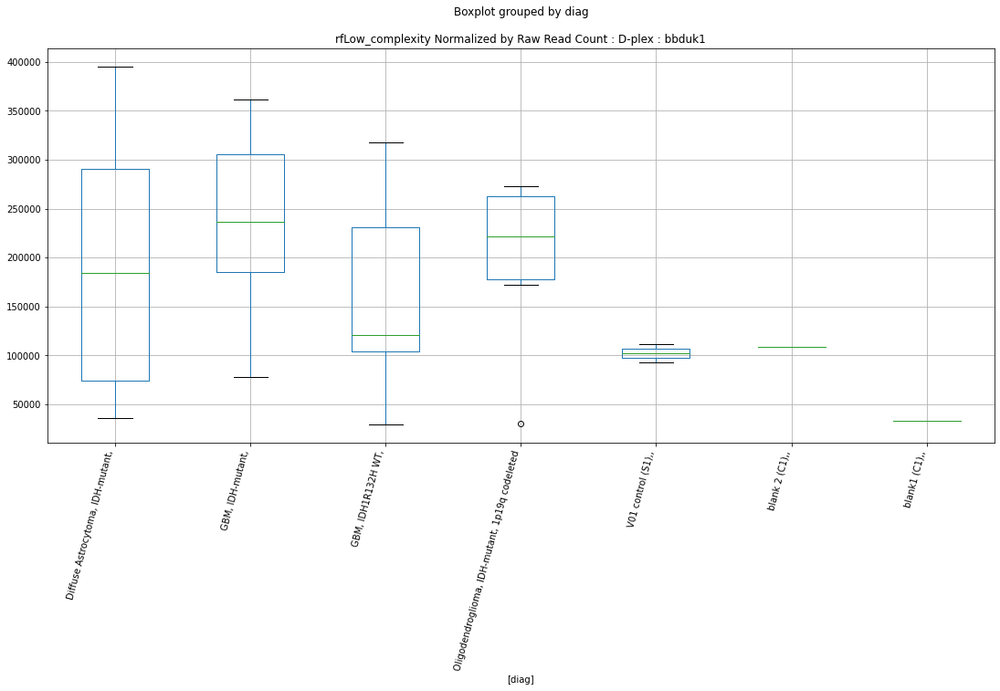

rfLow_complexity D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8513934937304686
	p = 0.0805909258307404
rfLow_complexity D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8513934937304686
	p = 0.0805909258307404


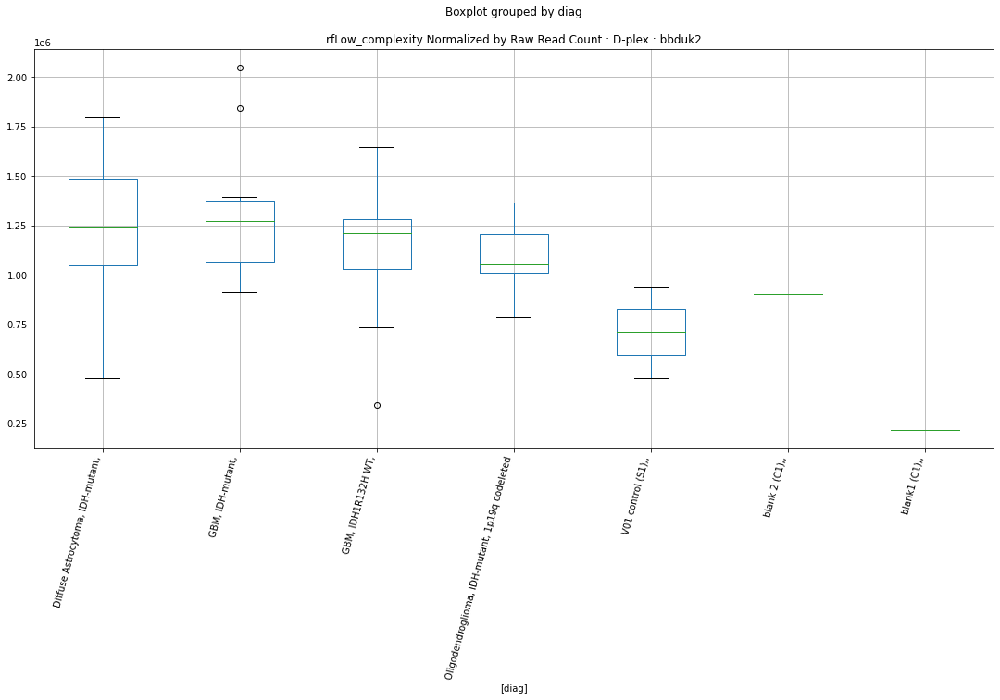

rfLow_complexity D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0338610624338975
	p = 0.05697552974617022
rfLow_complexity D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0338610624338975
	p = 0.05697552974617022


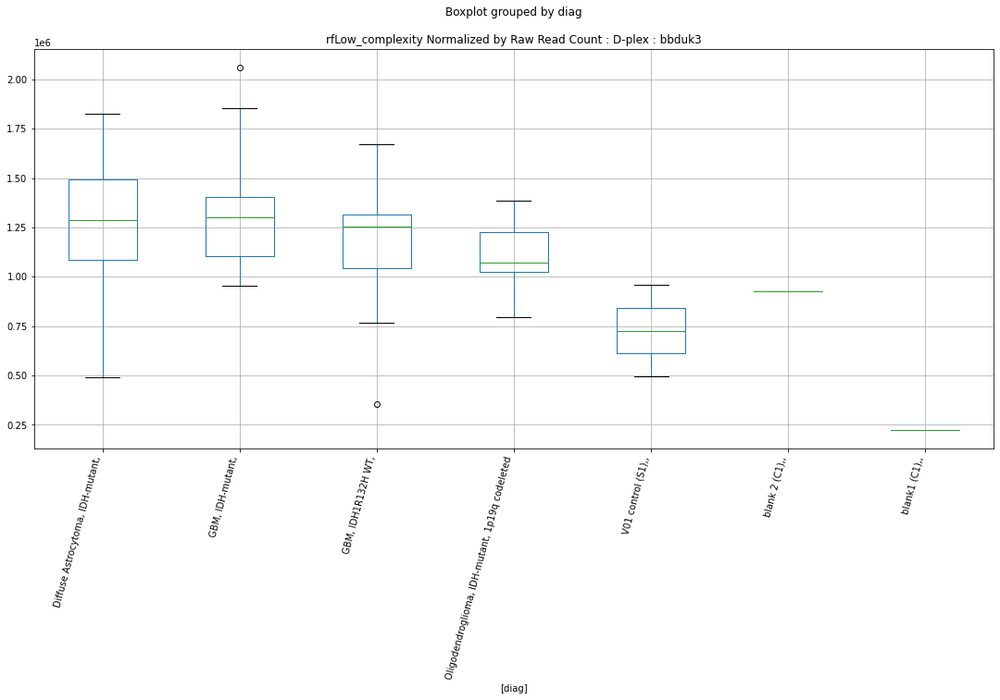

rfLow_complexity D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7858502853891867
	p = 0.090981697612597
rfLow_complexity D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7858502853891867
	p = 0.090981697612597


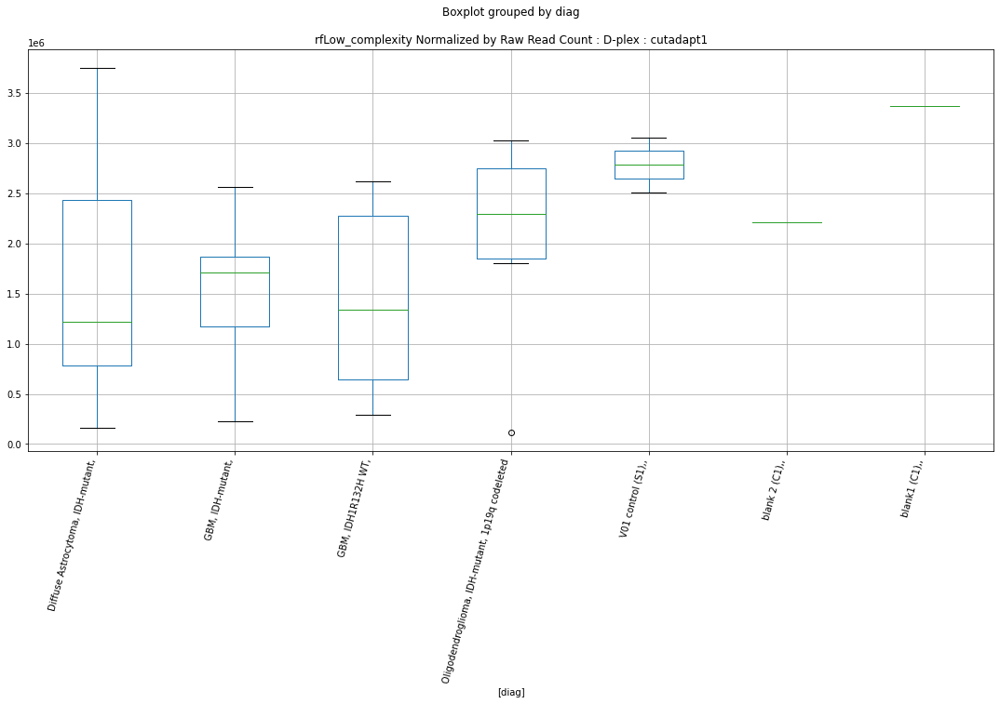

rfLow_complexity D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7856599913665343
	p = 0.09101349497921546
rfLow_complexity D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7856599913665343
	p = 0.09101349497921546


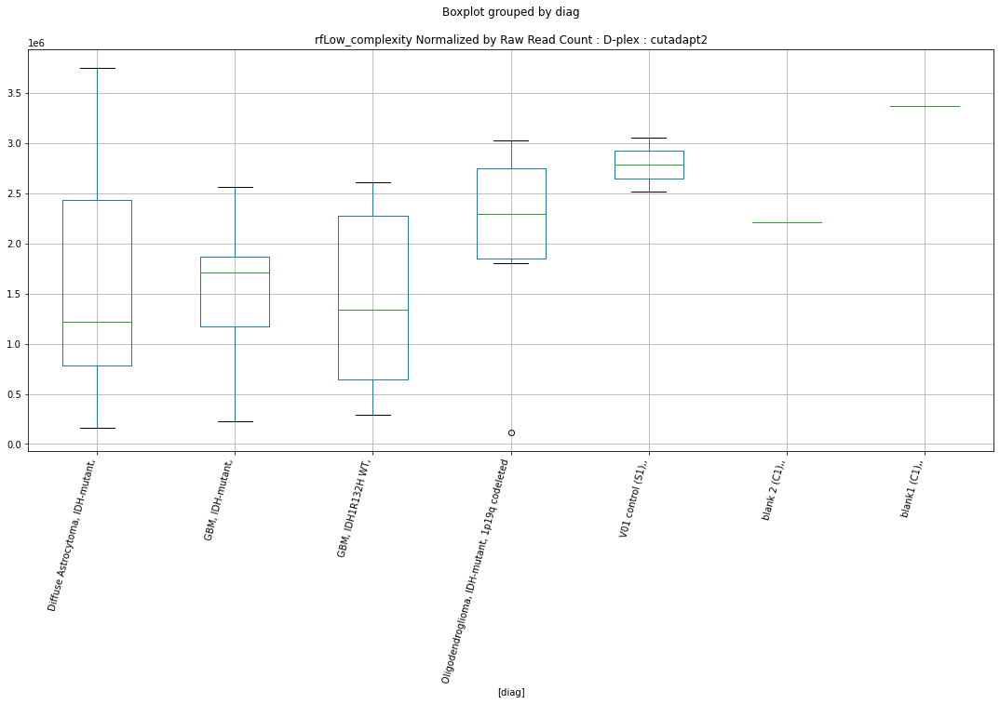

rfLow_complexity D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7852022078157772
	p = 0.09109002847090629
rfLow_complexity D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7852022078157772
	p = 0.09109002847090629


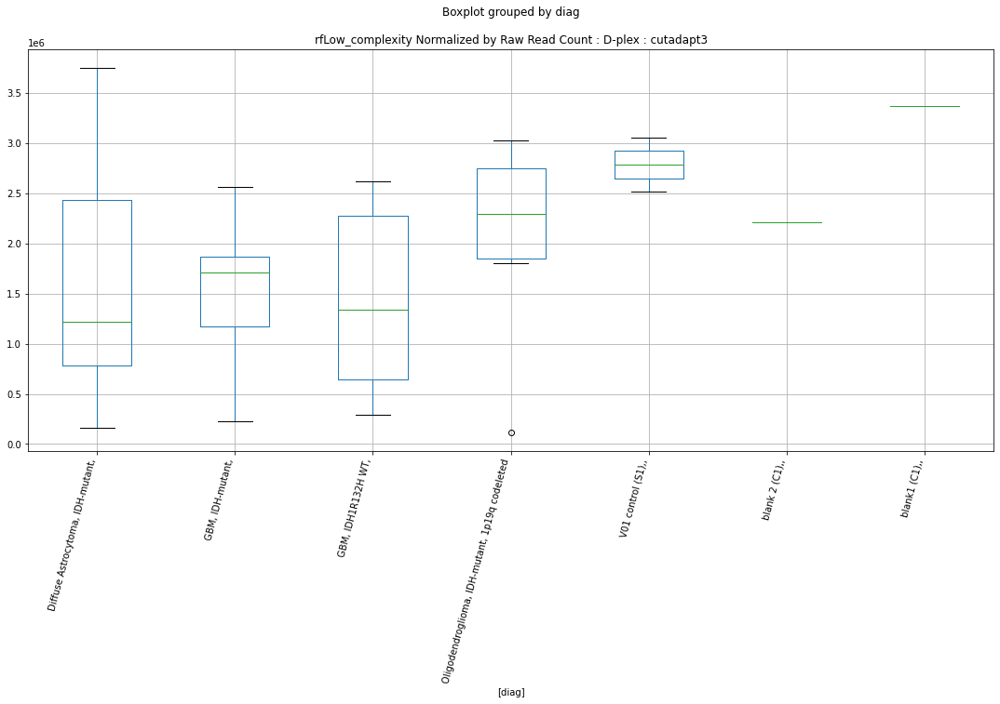

rfLow_complexity Lexogen bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.947796394200687
	p = 0.06720851952346608
rfLow_complexity Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7683753408481013
	p = 0.09394238340657254
rfLow_complexity Lexogen bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.947796394200687
	p = 0.06720851952346608
rfLow_complexity Lexogen bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7683753408481013
	p = 0.09394238340657254


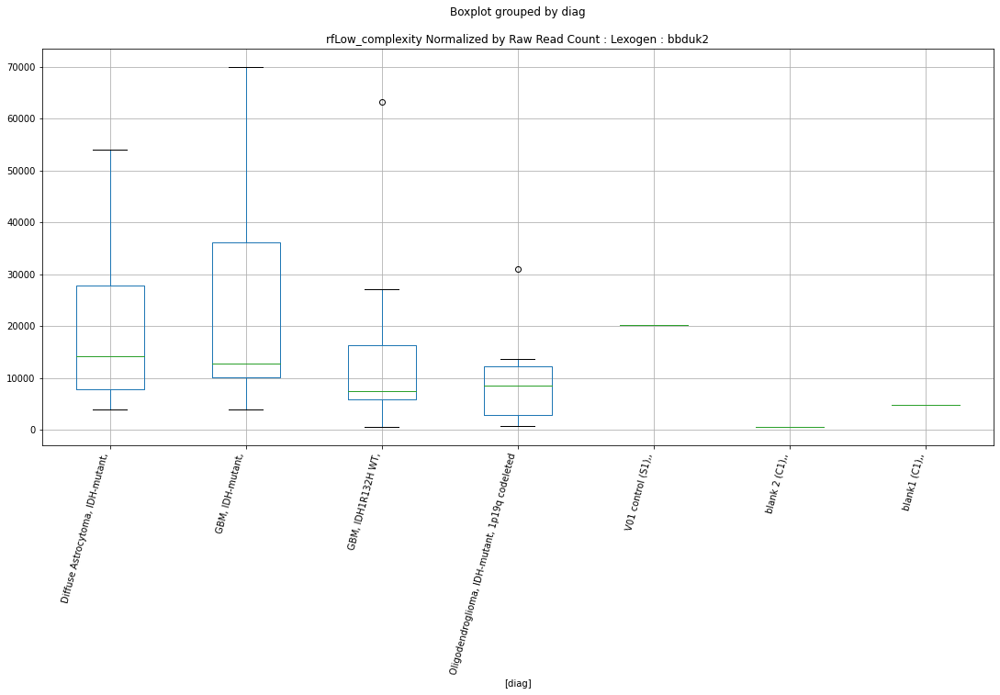

rfLow_complexity Lexogen bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9757162741301084
	p = 0.06372158677168377
rfLow_complexity Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7528099243347426
	p = 0.09664974992057747
rfLow_complexity Lexogen bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9757162741301084
	p = 0.06372158677168377
rfLow_complexity Lexogen bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7528099243347426
	p = 0.09664974992057747


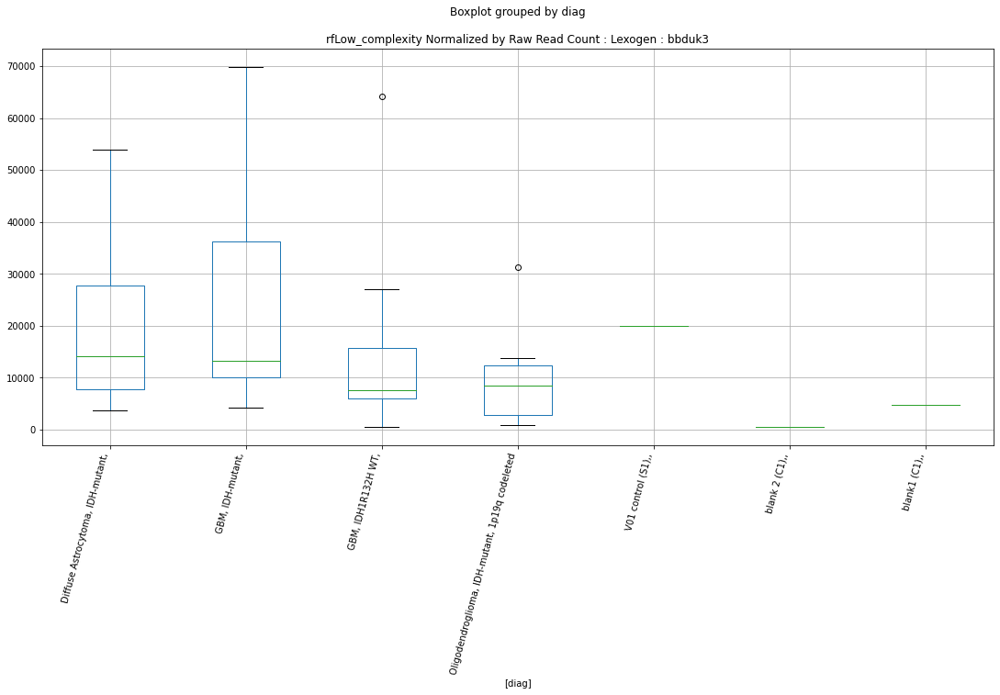

rfLow_complexity Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9426710941001613
	p = 0.06786682194323722
rfLow_complexity Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8333855004220356
	p = 0.08333645890604706
rfLow_complexity Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9426710941001613
	p = 0.06786682194323722
rfLow_complexity Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8333855004220356
	p = 0.08333645890604706


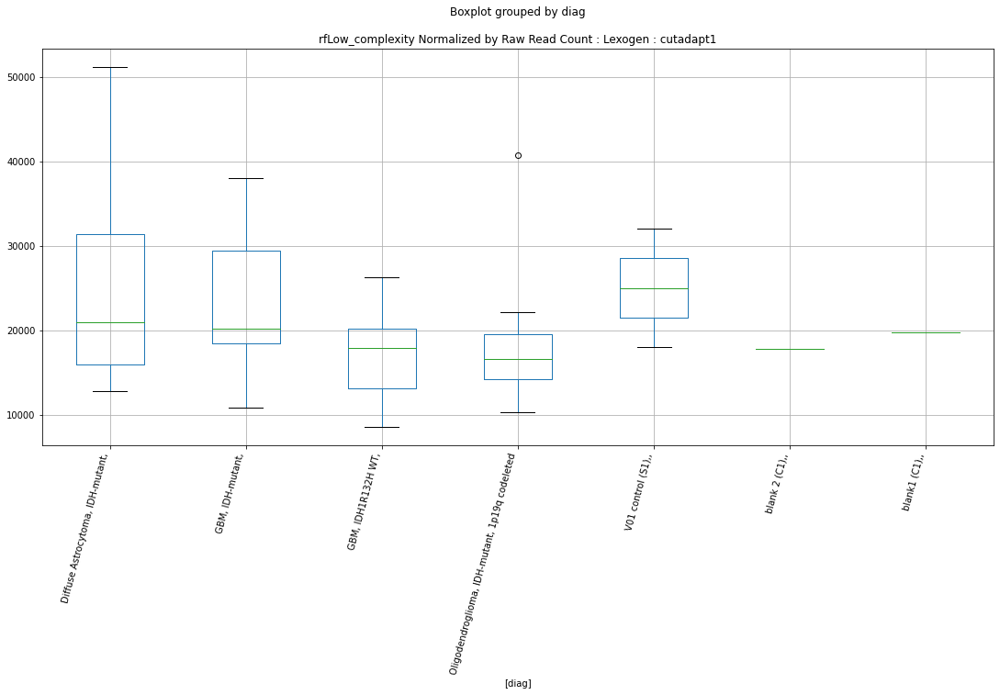

rfLow_complexity Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8848848788127768
	p = 0.07569605489445058
rfLow_complexity Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8848848788127768
	p = 0.07569605489445058


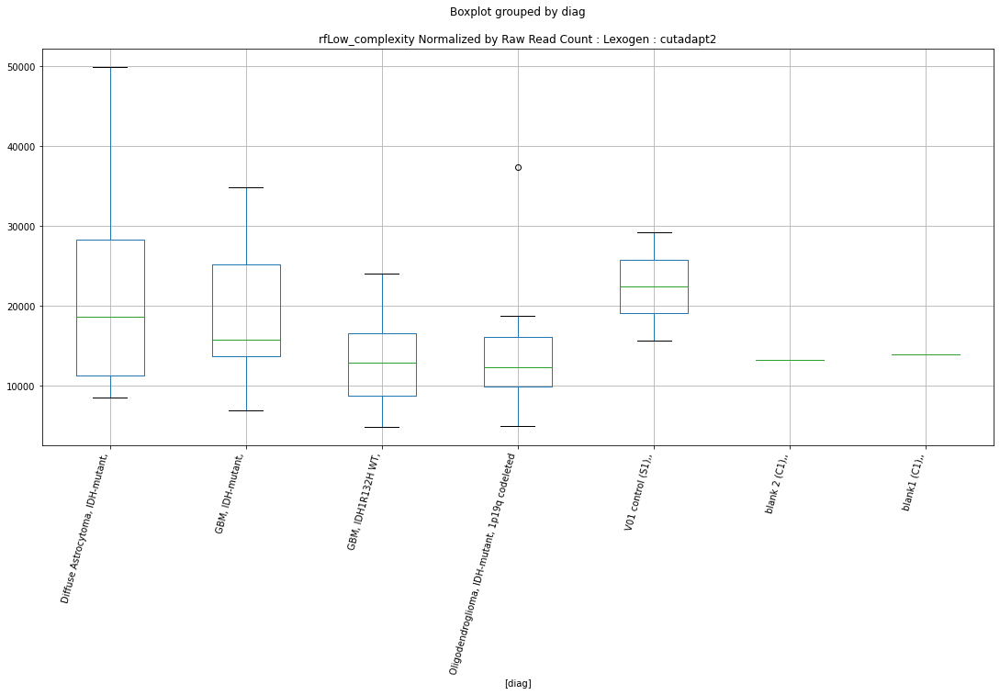

rfLow_complexity Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8164122250752952
	p = 0.08599910658764112
rfLow_complexity Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8164122250752952
	p = 0.08599910658764112


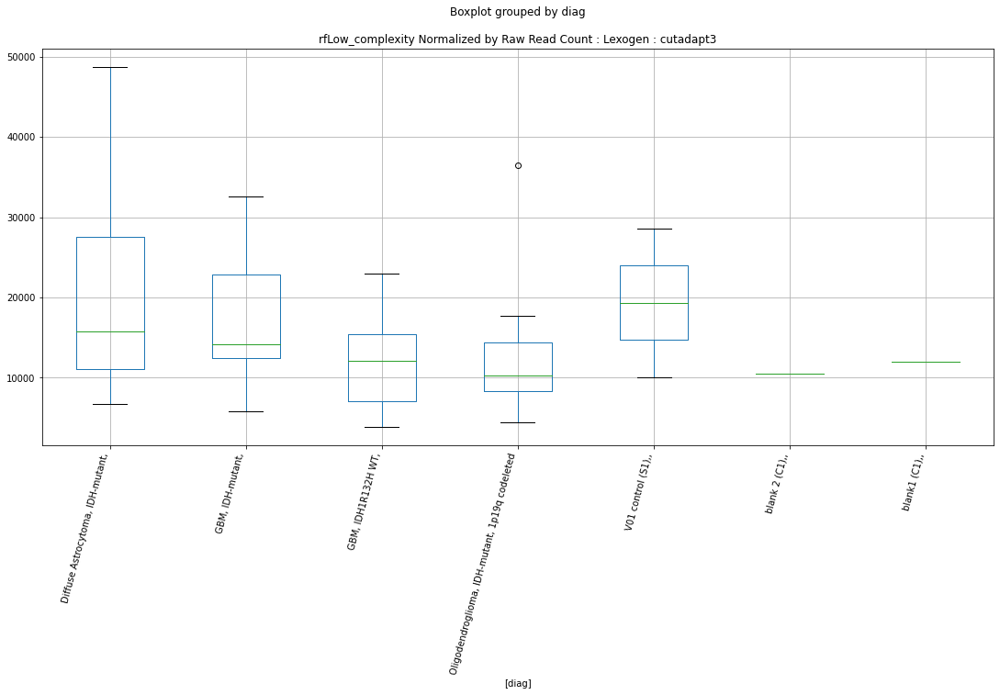

rfERVL D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7491426558039704
	p = 0.09729738379162511
rfERVL D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7491426558039704
	p = 0.09729738379162511


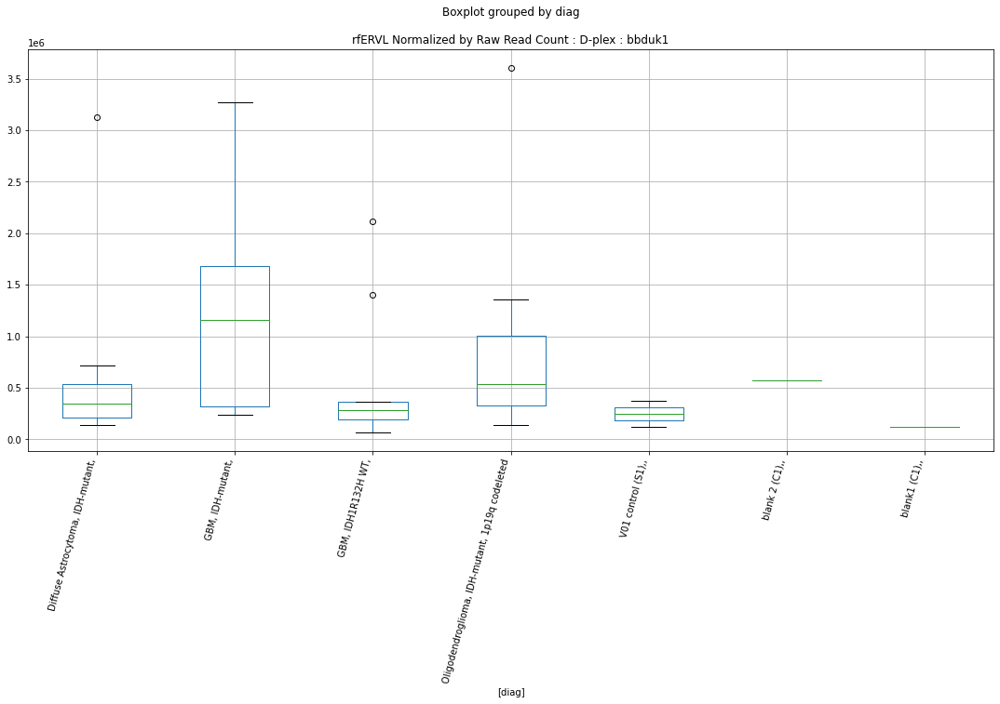

rfERVL Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.823022497682935
	p = 0.08495339289509525
rfERVL Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.823022497682935
	p = 0.08495339289509525


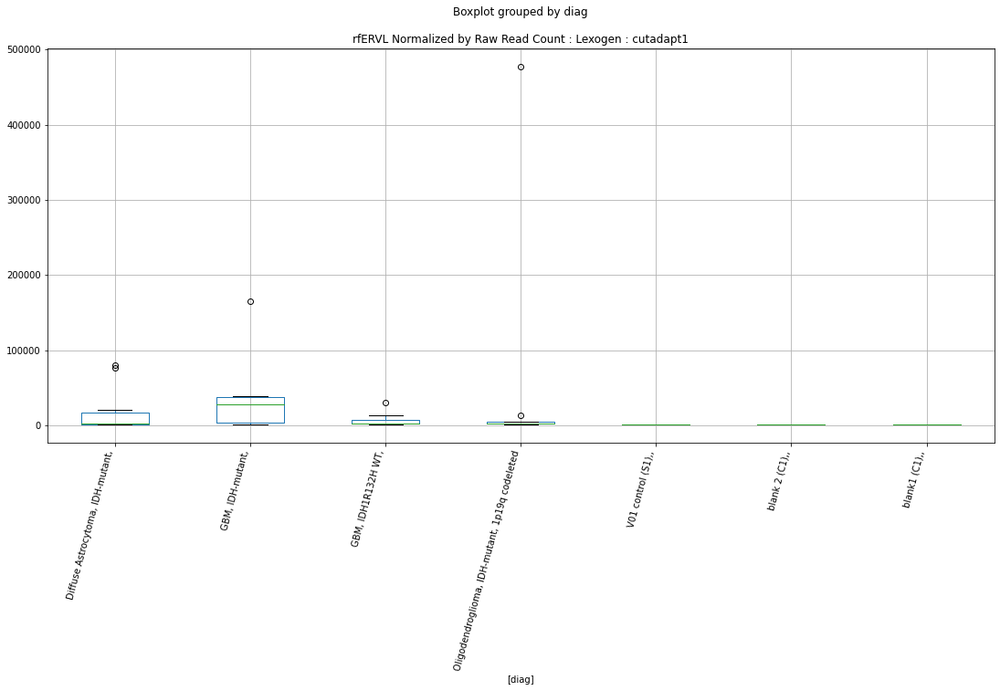

rfERVL Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8226963872530455
	p = 0.08500471936046589
rfERVL Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8226963872530455
	p = 0.08500471936046589


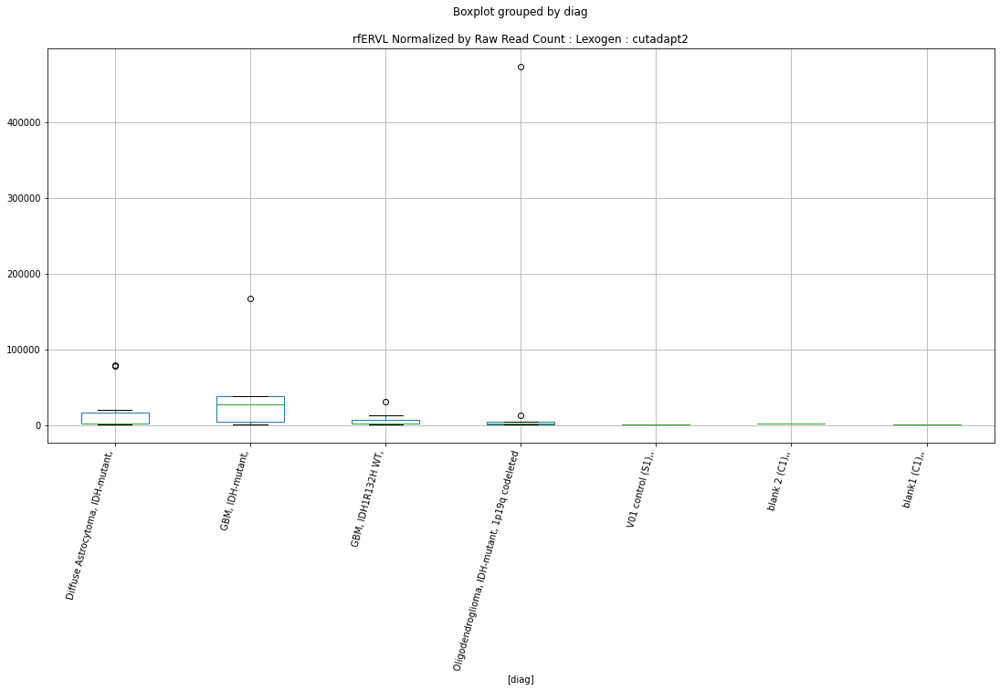

rfERVL Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.805199238979065
	p = 0.08779874808037995
rfERVL Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.805199238979065
	p = 0.08779874808037995


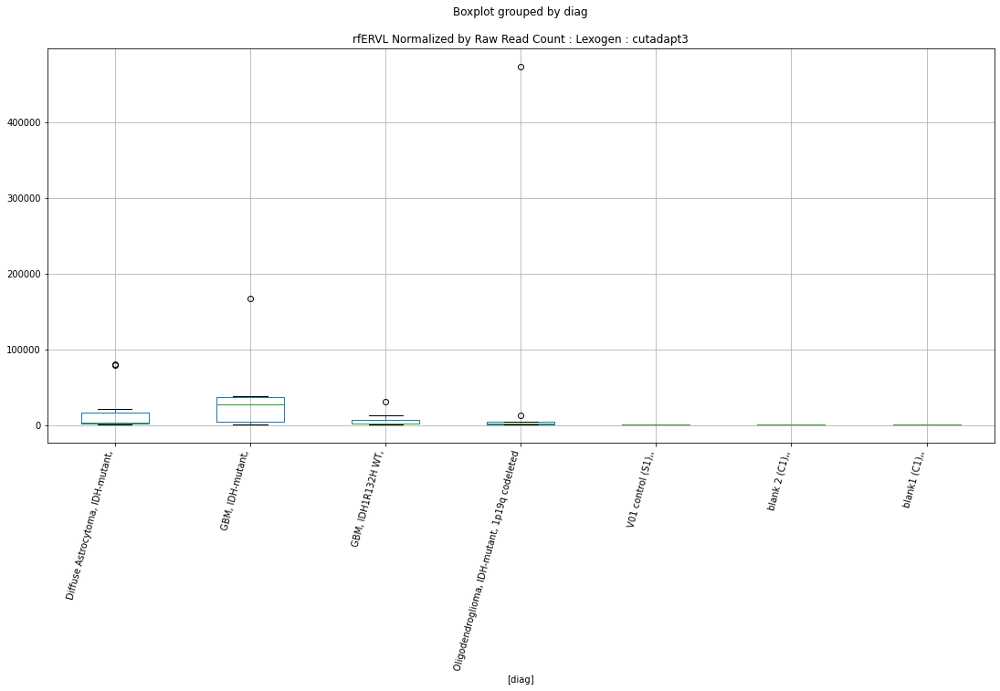

rfrRNA Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8410114082158946
	p = 0.08216391779934025
rfrRNA Lexogen bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9597150349675079
	p = 0.0656996576698904
rfrRNA Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8410114082158946
	p = 0.08216391779934025
rfrRNA Lexogen bbduk1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9597150349675079
	p = 0.0656996576698904


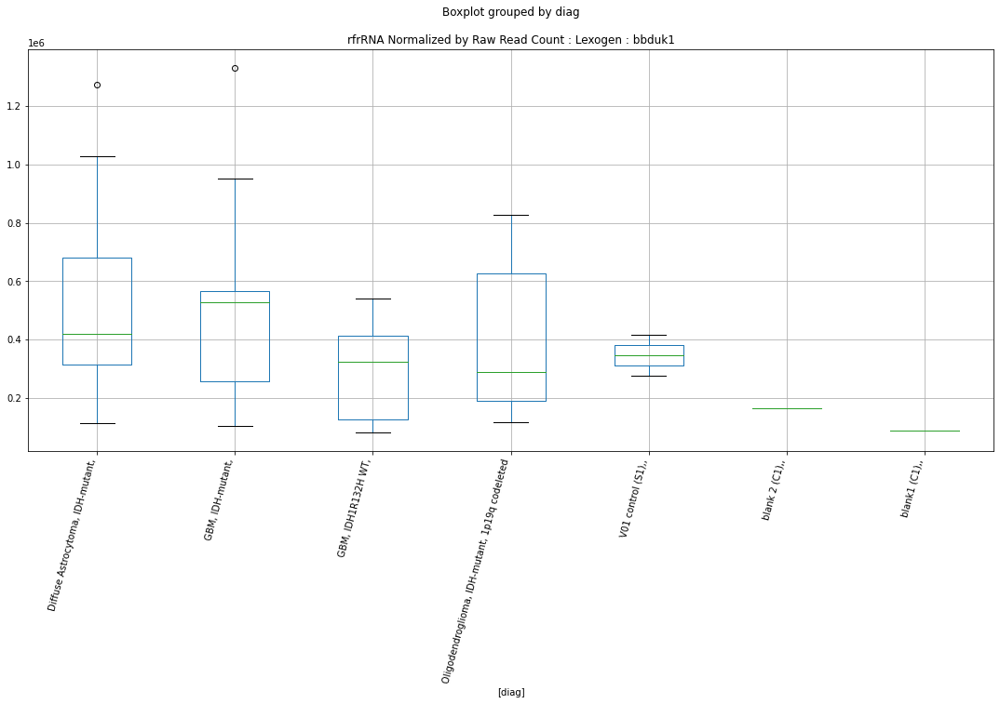

rfrRNA Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8768707633373354
	p = 0.07684279329263961
rfrRNA Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9862151326743798
	p = 0.0624528645826883
rfrRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8768707633373354
	p = 0.07684279329263961
rfrRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9862151326743798
	p = 0.0624528645826883


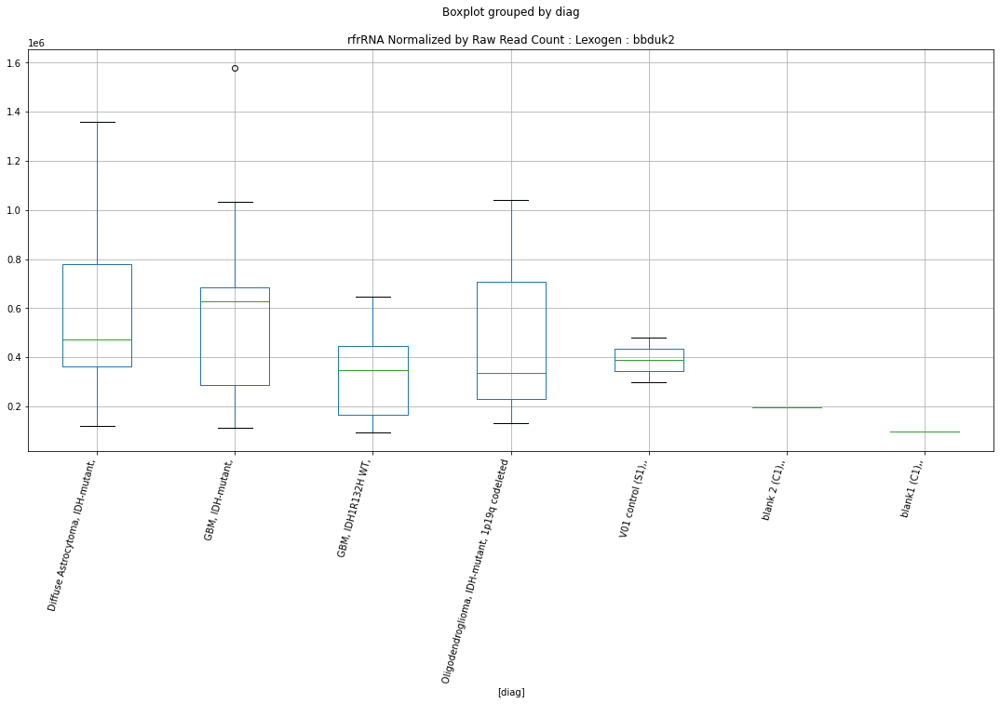

rfrRNA Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.872186300367341
	p = 0.07752018061958572
rfrRNA Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9821903646233119
	p = 0.06293653165402606
rfrRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.872186300367341
	p = 0.07752018061958572
rfrRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9821903646233119
	p = 0.06293653165402606


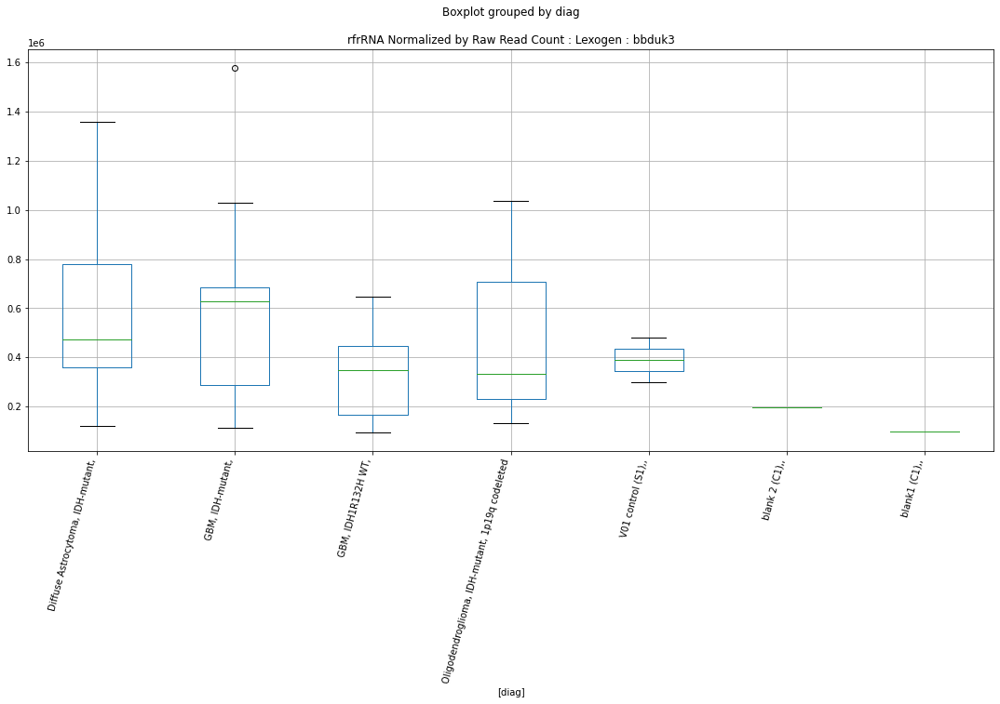

rfrRNA Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.864558184320651
	p = 0.07863451938117512
rfrRNA Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9691459463734566
	p = 0.06452726740028365
rfrRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.864558184320651
	p = 0.07863451938117512
rfrRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9691459463734566
	p = 0.06452726740028365


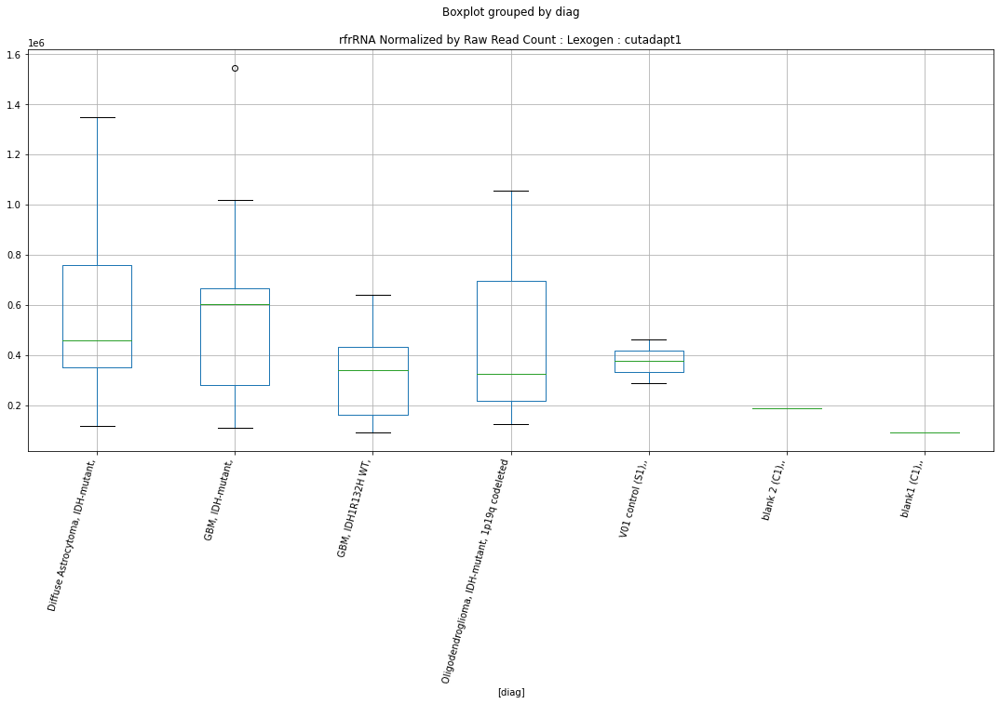

rfrRNA Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8759797431754914
	p = 0.07697123314982911
rfrRNA Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.970814732192223
	p = 0.0643217748003835
rfrRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8759797431754914
	p = 0.07697123314982911
rfrRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.970814732192223
	p = 0.0643217748003835


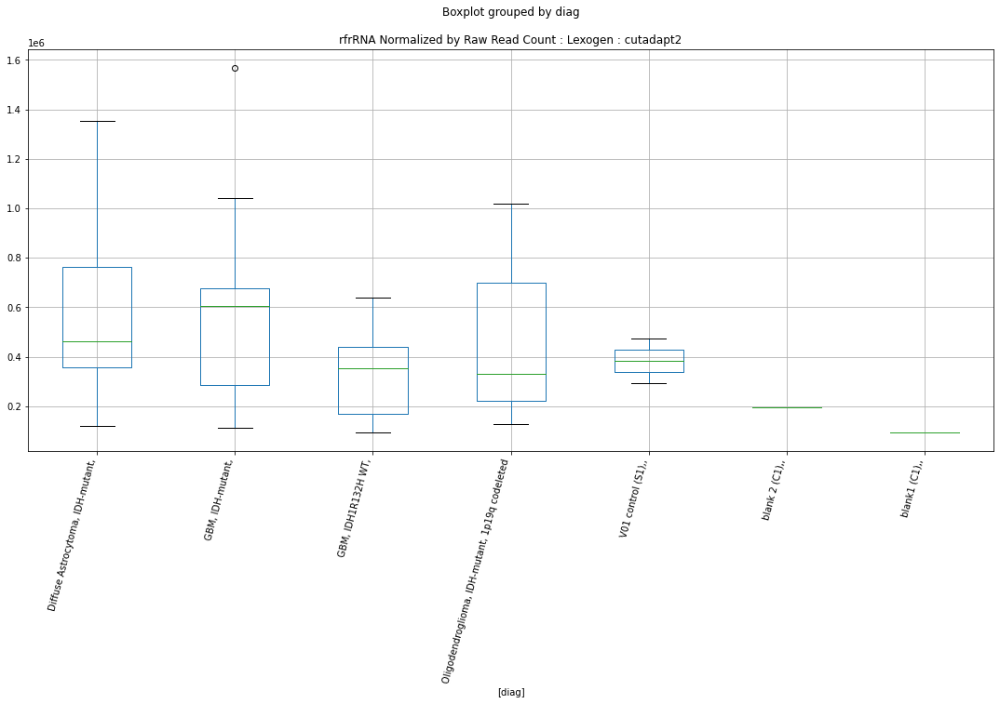

rfrRNA Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8685225955029015
	p = 0.07805363366720834
rfrRNA Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9535506944724783
	p = 0.06647622287176694
rfrRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8685225955029015
	p = 0.07805363366720834
rfrRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9535506944724783
	p = 0.06647622287176694


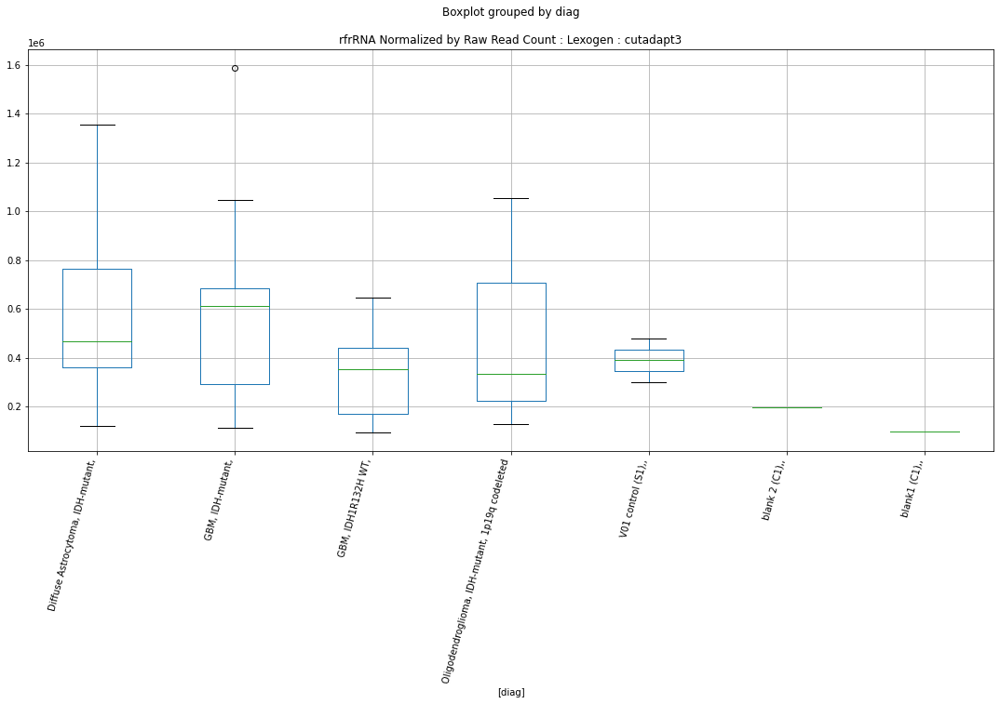

rfcentr D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7905859130663346
	p = 0.09019350799041015
rfcentr D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7905859130663346
	p = 0.09019350799041015


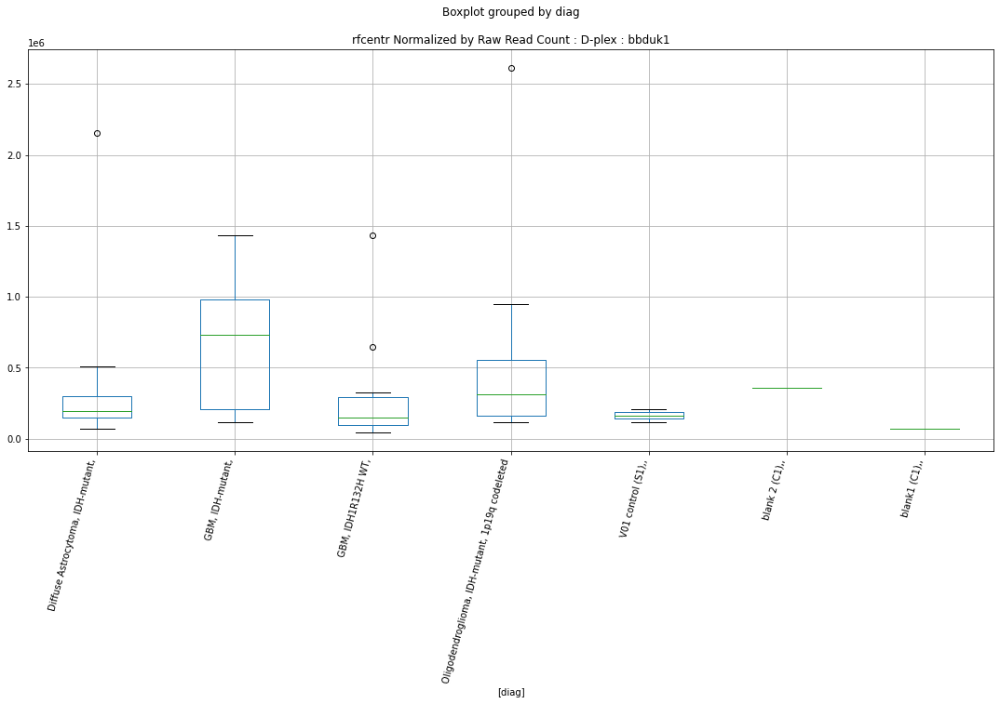

rfcentr D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7508144079742949
	p = 0.09700168975351206
rfcentr D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7508144079742949
	p = 0.09700168975351206


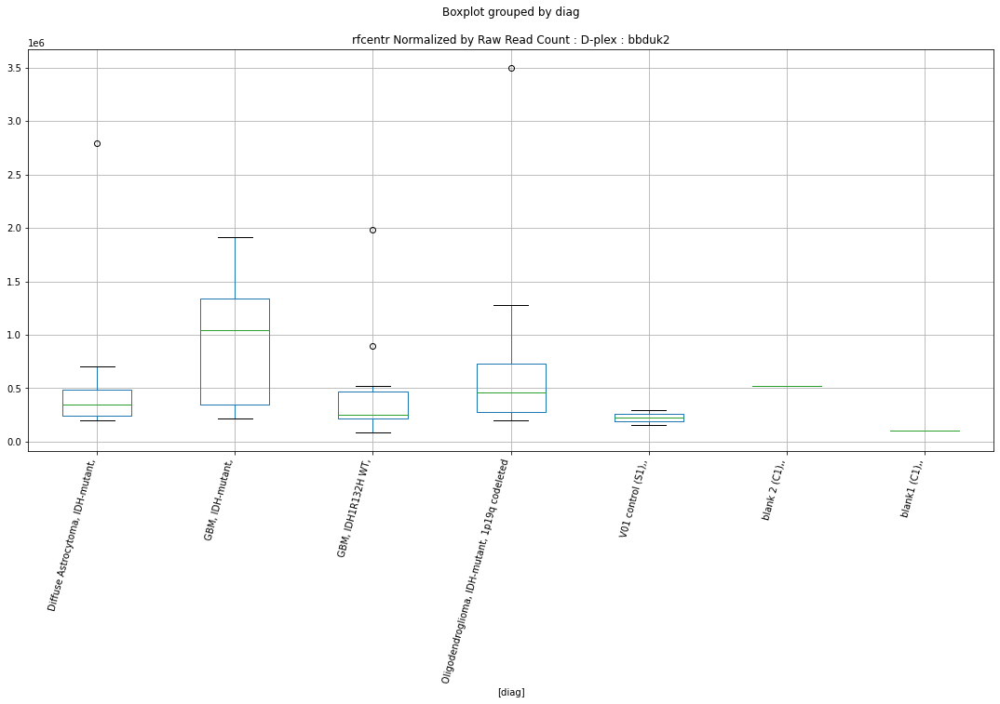

rfcentr D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7447842438079069
	p = 0.09807196209941037
rfcentr D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7447842438079069
	p = 0.09807196209941037


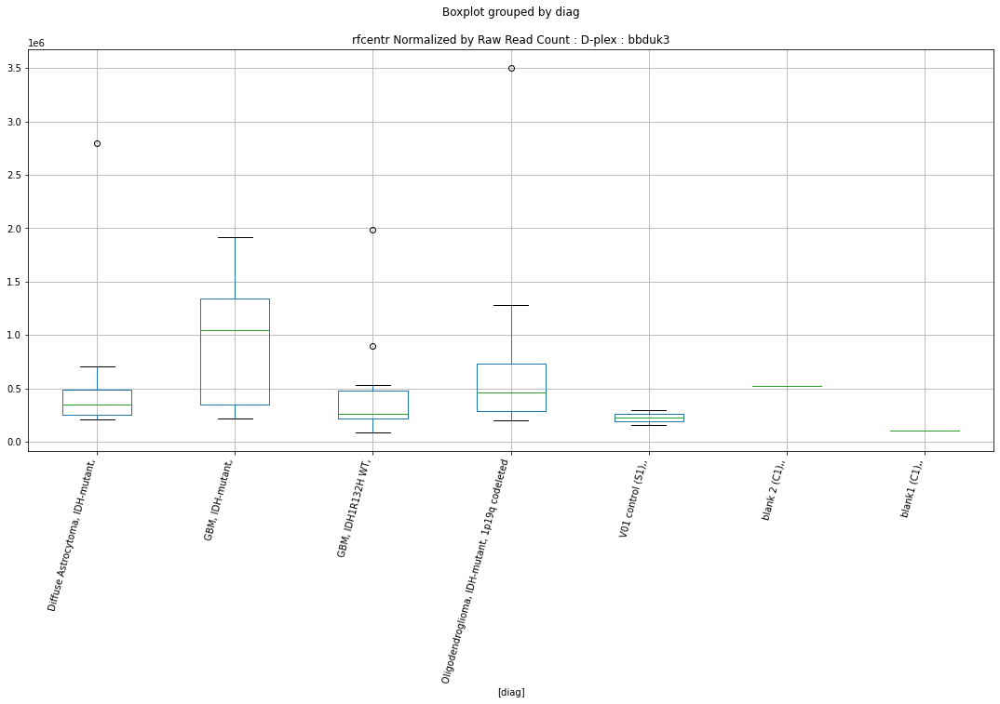

rfcentr D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7780219307309897
	p = 0.0922978085673491
rfcentr D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7780219307309897
	p = 0.0922978085673491


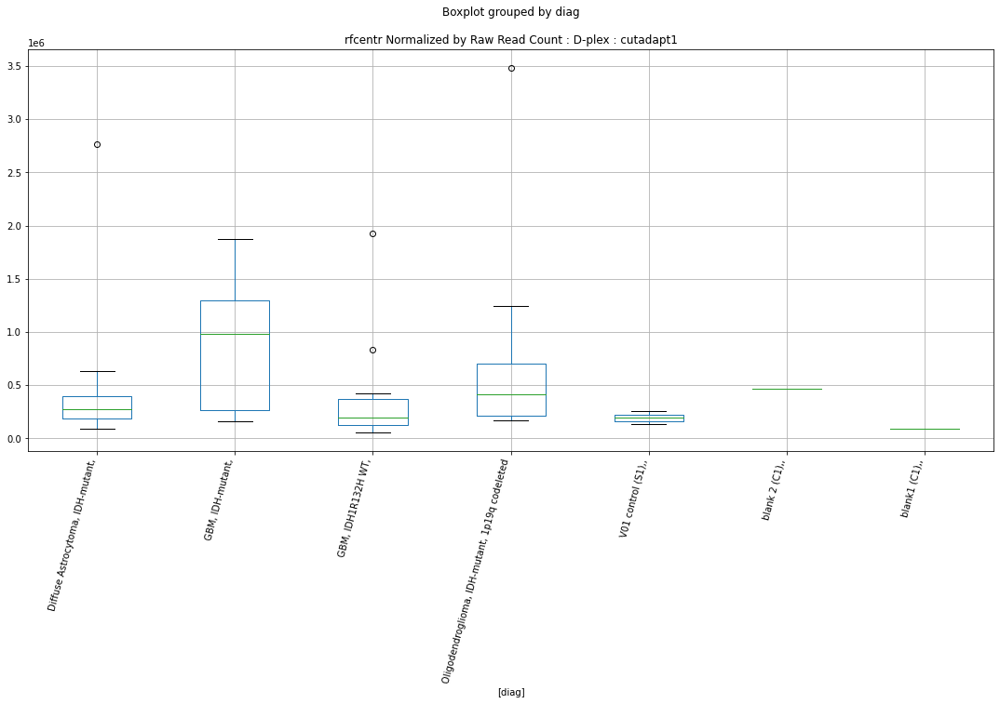

rfcentr D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7781713021002976
	p = 0.09227254170524013
rfcentr D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7781713021002976
	p = 0.09227254170524013


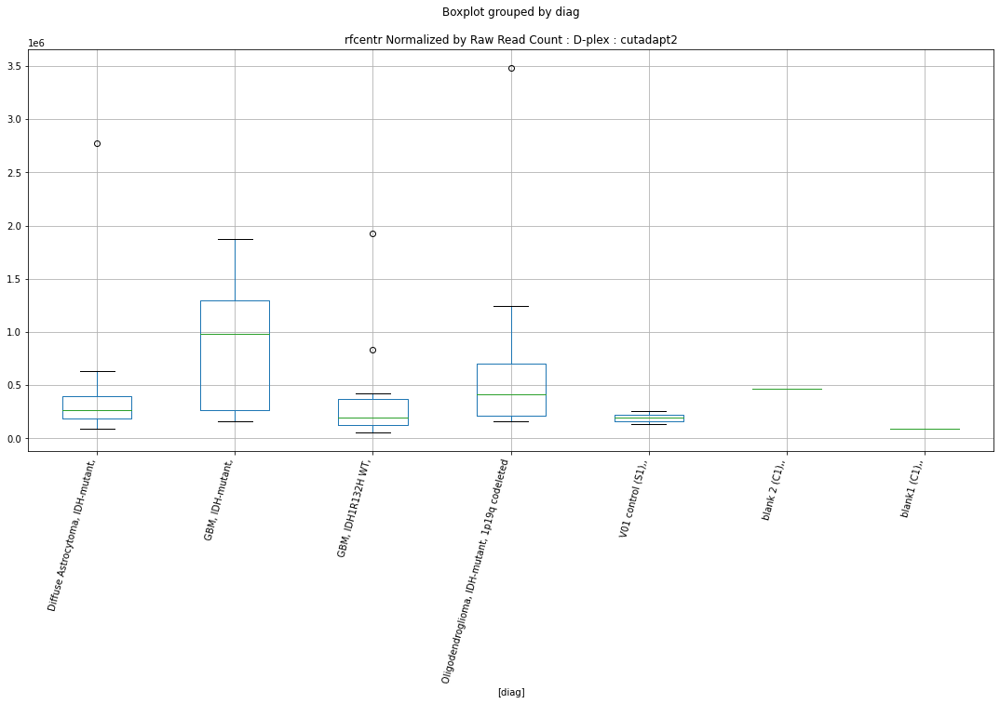

rfcentr D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.777984042465976
	p = 0.0923042185016986
rfcentr D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.777984042465976
	p = 0.0923042185016986


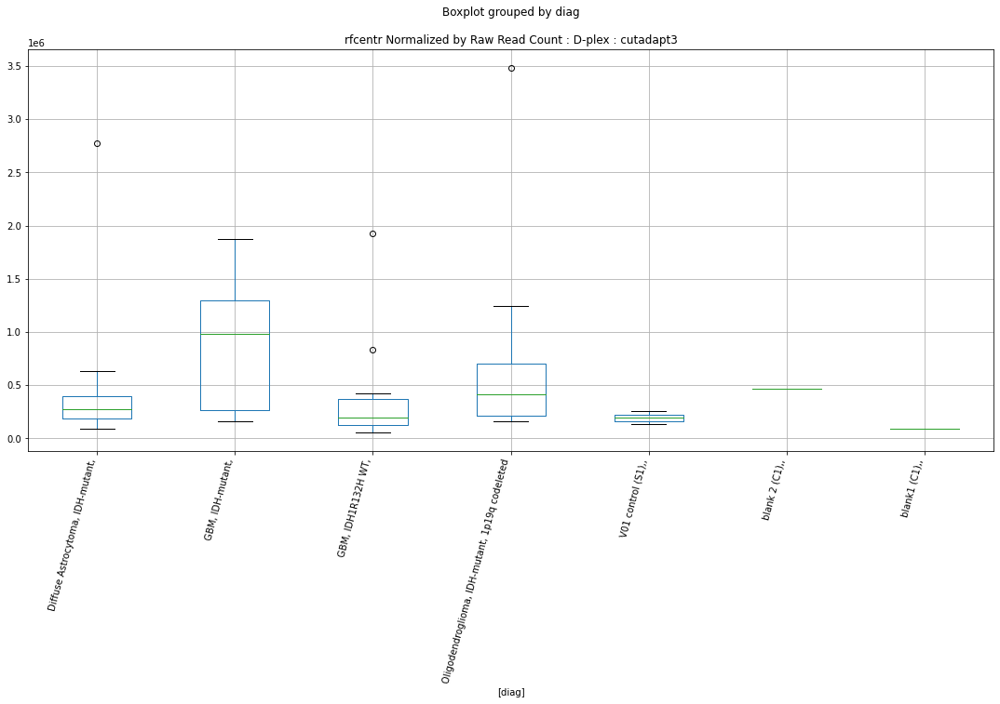

rfSatellite D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9092428321950479
	p = 0.07230313764639586
rfSatellite D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9092428321950479
	p = 0.07230313764639586


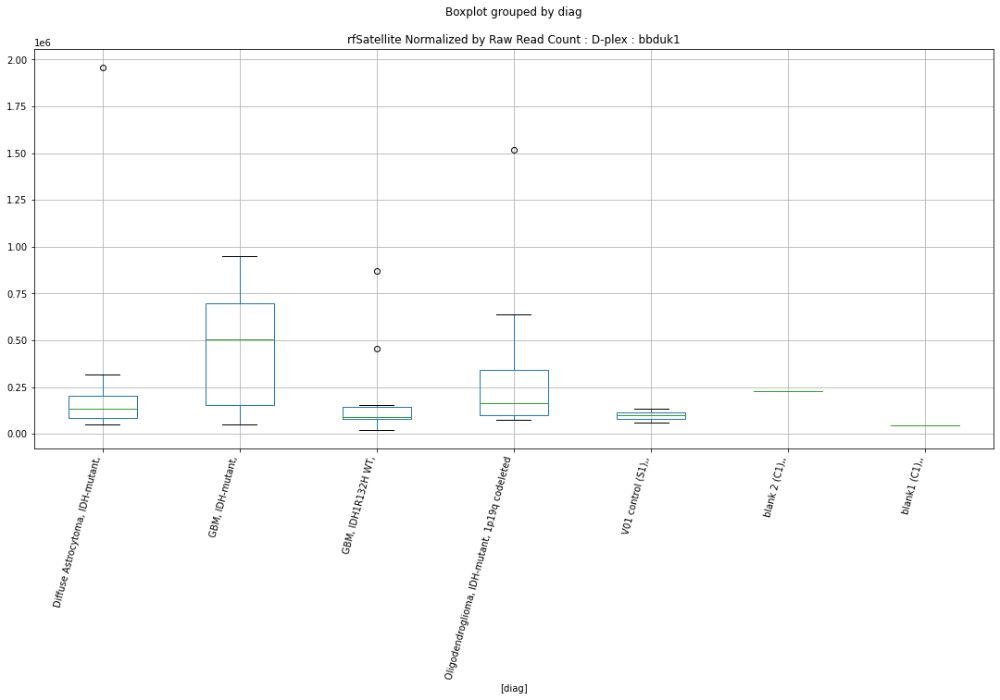

rfSatellite D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9052855743622665
	p = 0.0728450111371997
rfSatellite D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9052855743622665
	p = 0.0728450111371997


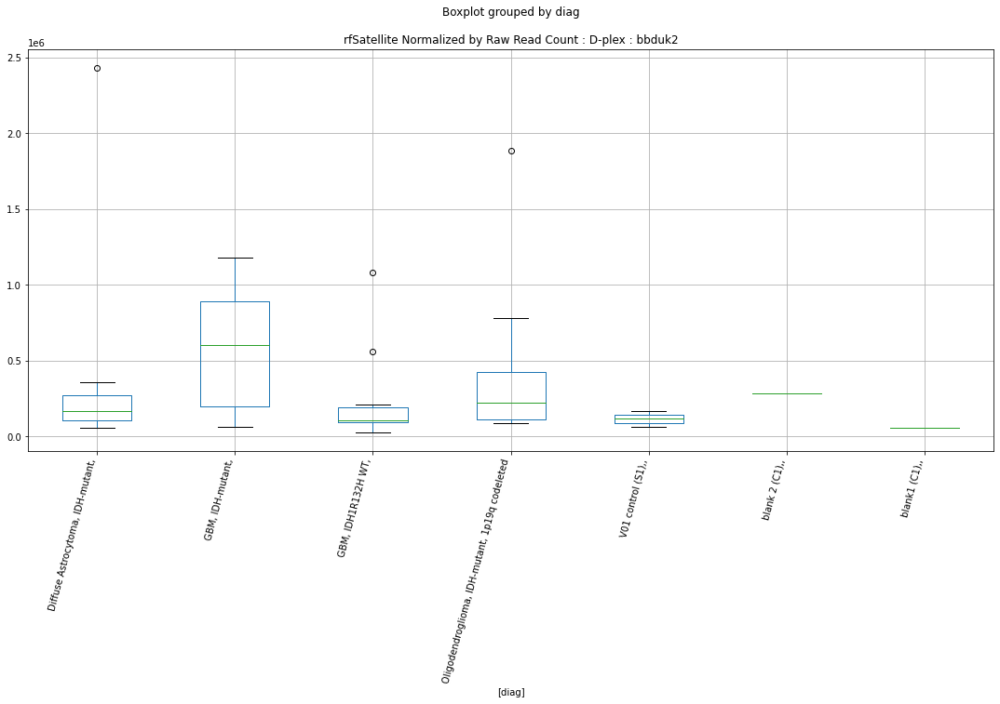

rfSatellite D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9058261763145388
	p = 0.072770773743148
rfSatellite D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9058261763145388
	p = 0.072770773743148


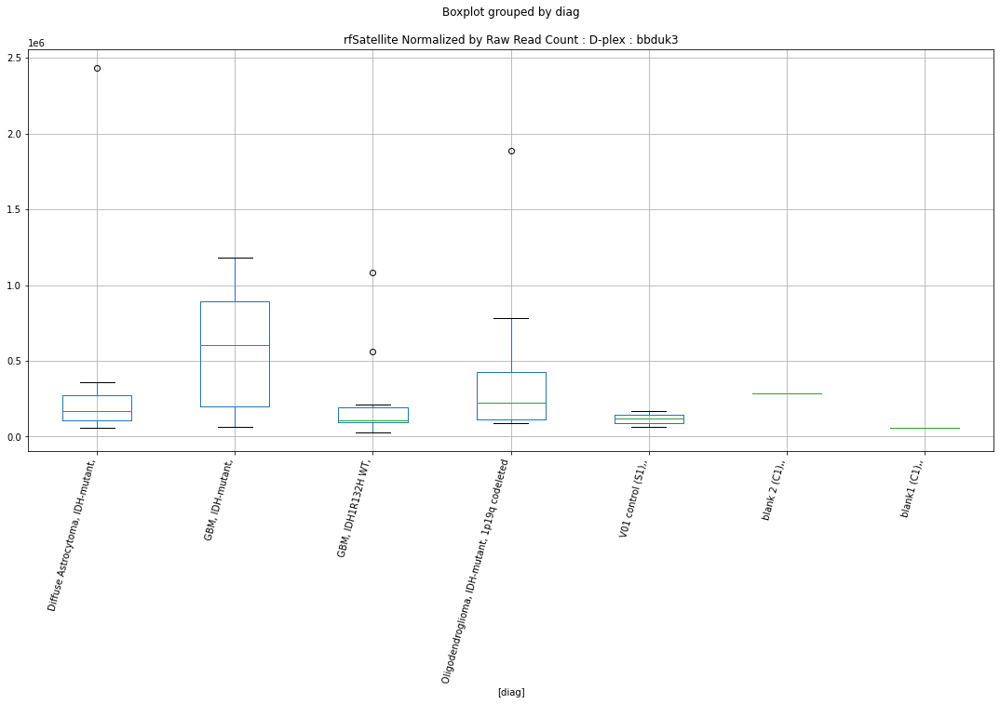

rfSatellite D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9023545783897884
	p = 0.0732486770237495
rfSatellite D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9023545783897884
	p = 0.0732486770237495


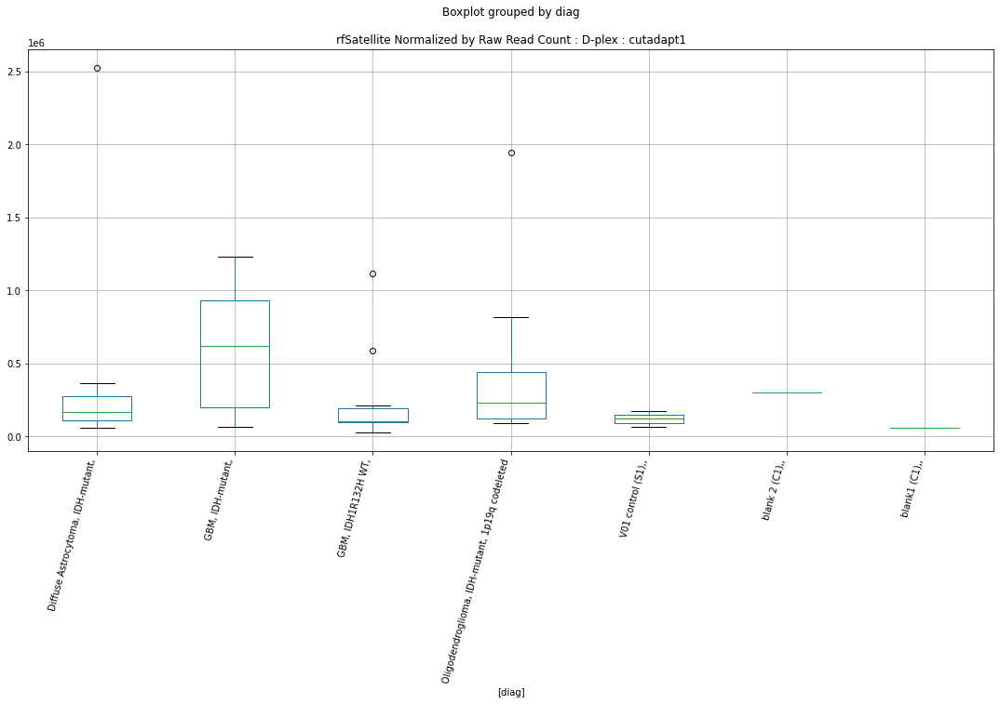

rfSatellite D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9018263182733524
	p = 0.07332164133022381
rfSatellite D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9018263182733524
	p = 0.07332164133022381


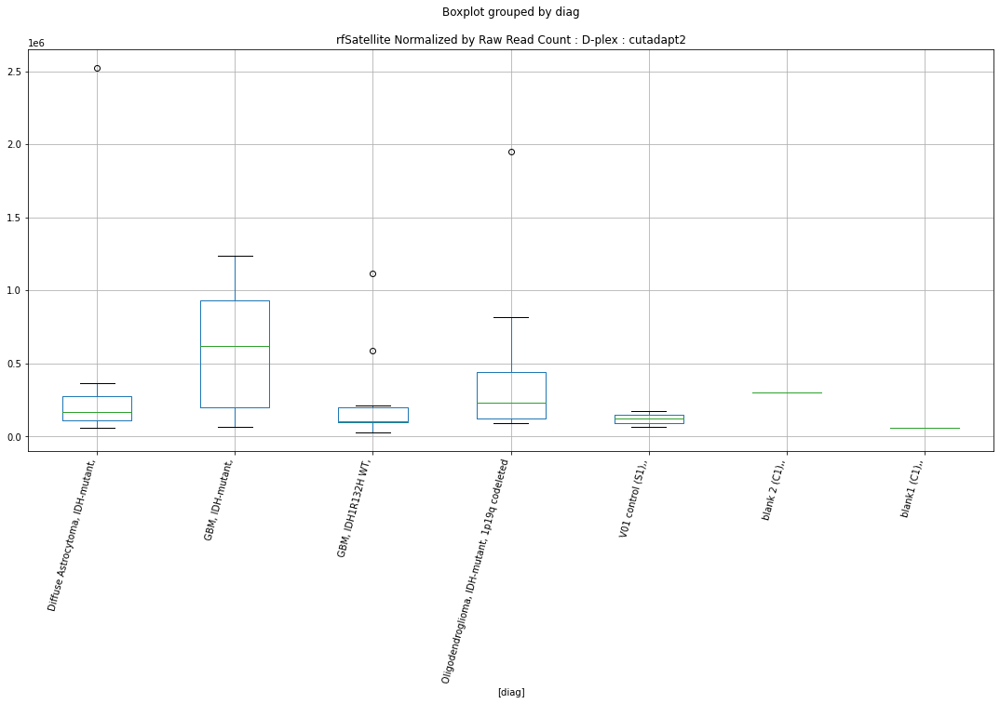

rfSatellite D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9024618054201736
	p = 0.07323387448523569
rfSatellite D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9024618054201736
	p = 0.07323387448523569


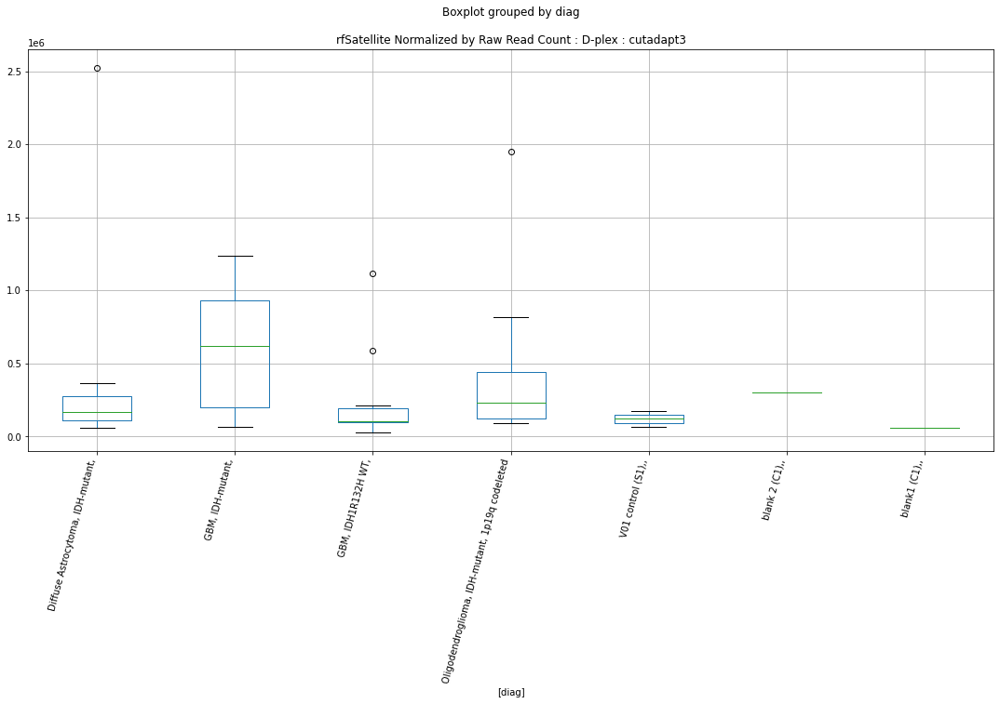

rfCR1 D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7887998458633356
	p = 0.09049007538211161
rfCR1 D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7887998458633356
	p = 0.09049007538211161


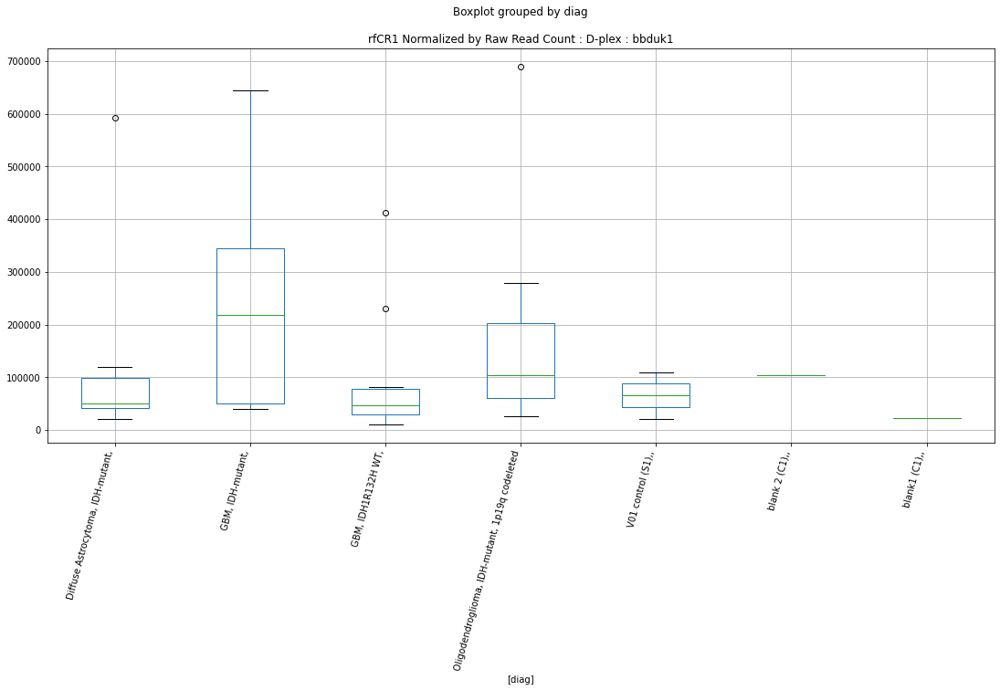

rfCR1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7766450458253853
	p = 0.09253099897253377
rfCR1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7766450458253853
	p = 0.09253099897253377


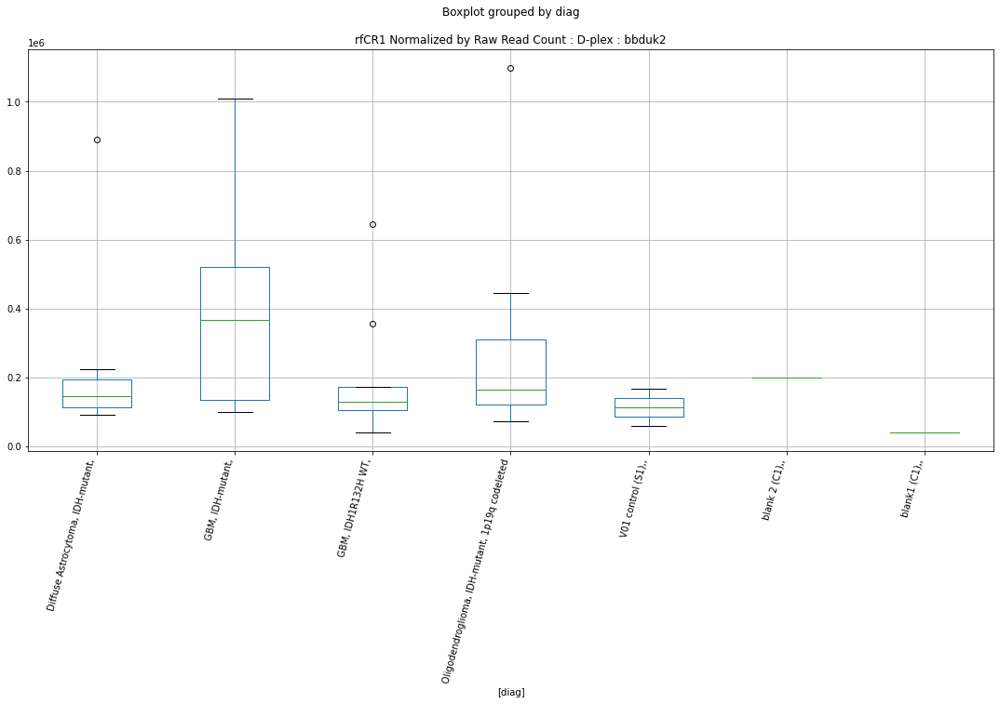

rfCR1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7694155344309905
	p = 0.09376383084904508
rfCR1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7694155344309905
	p = 0.09376383084904508


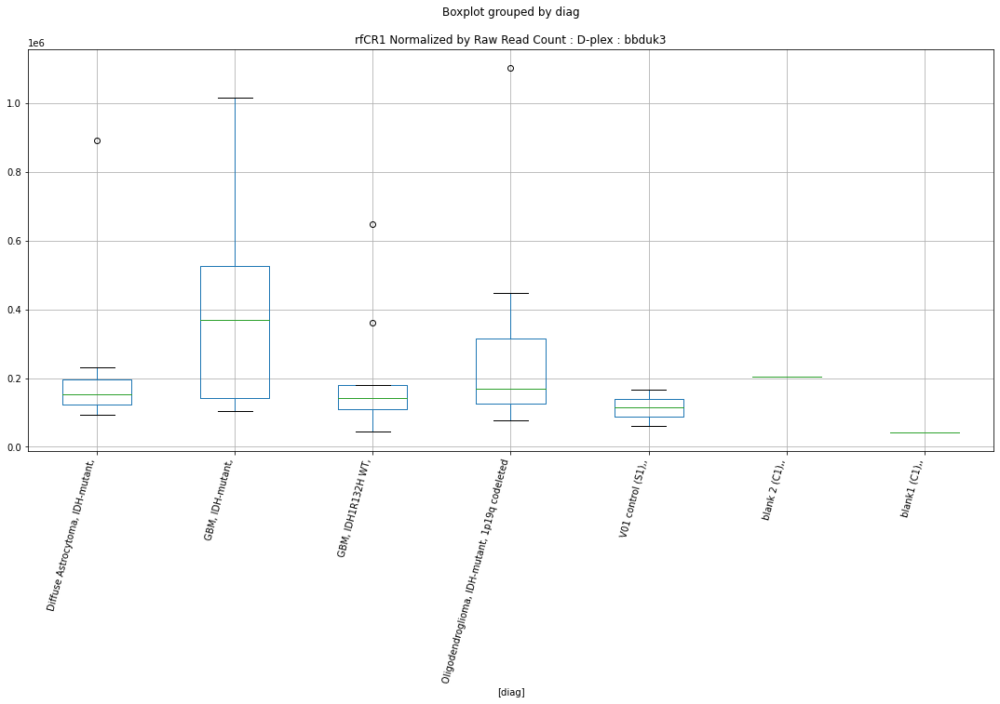

rfCR1 D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7529659729280007
	p = 0.09662227511641716
rfCR1 D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7529659729280007
	p = 0.09662227511641716


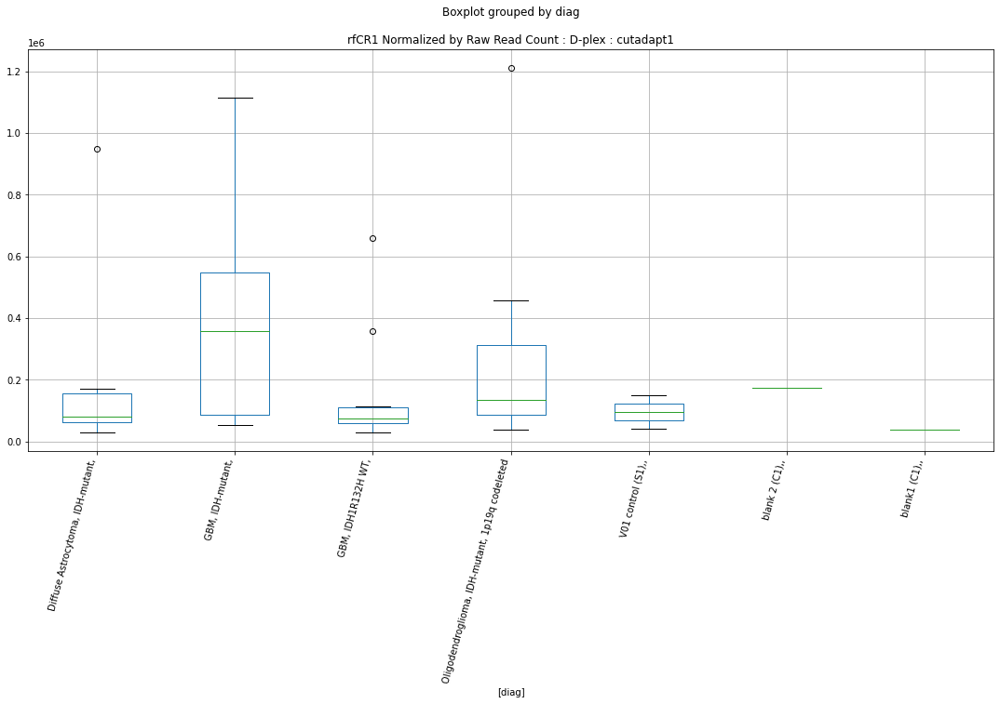

rfCR1 D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.753035828730699
	p = 0.0966099781014182
rfCR1 D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.753035828730699
	p = 0.0966099781014182


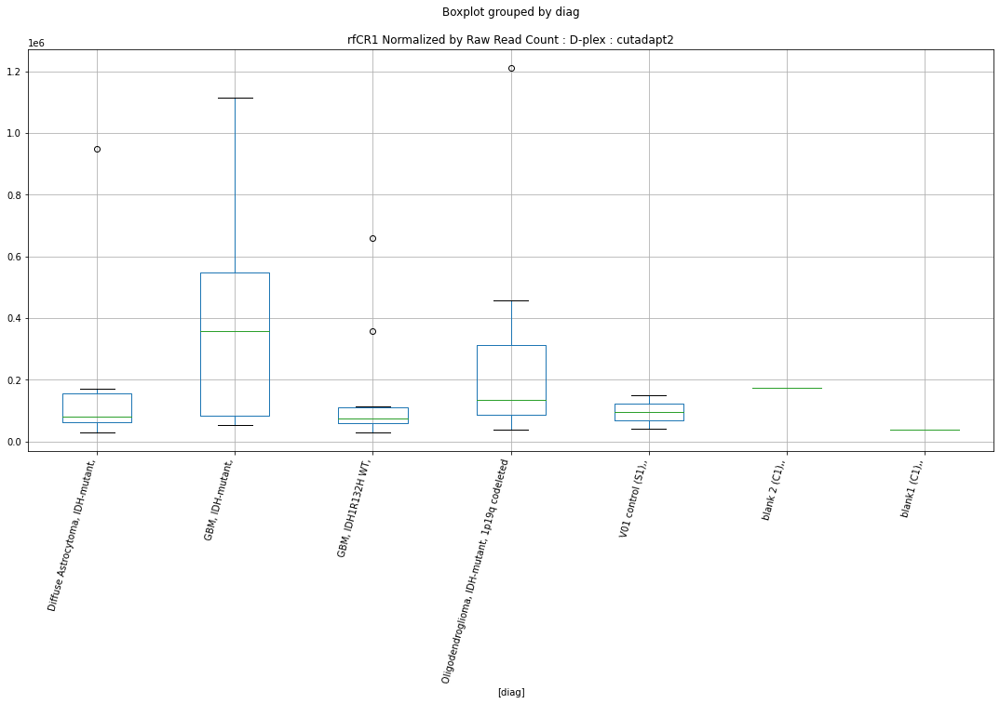

rfCR1 D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7528165866167635
	p = 0.09664857678277965
rfCR1 D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7528165866167635
	p = 0.09664857678277965


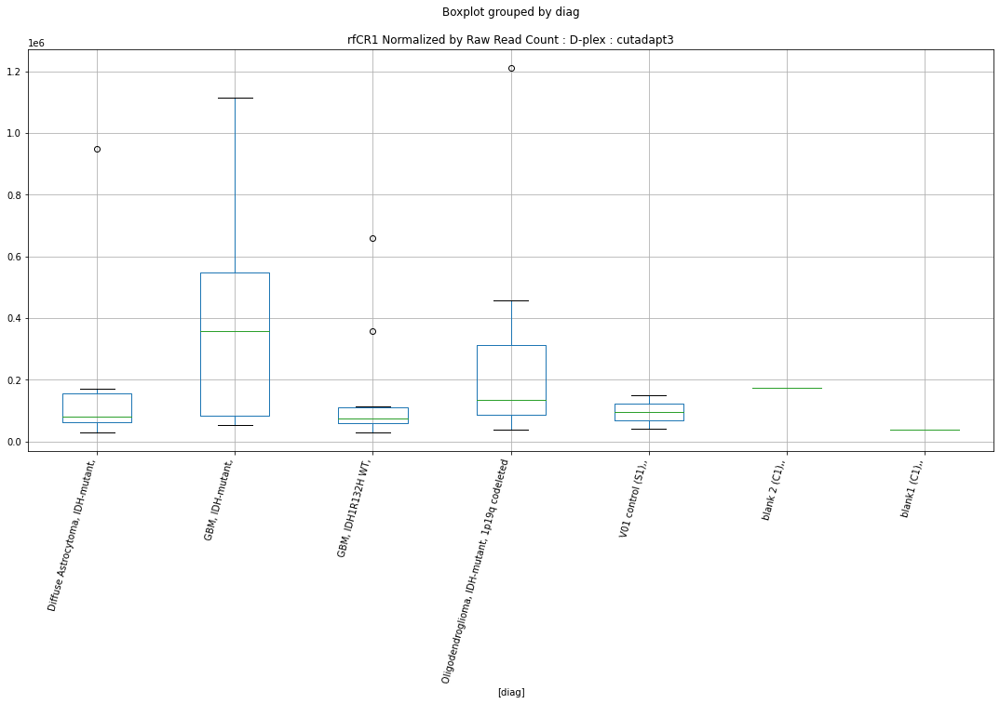

rfhAT-Tip100 D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7586992835817374
	p = 0.09561752302703028
rfhAT-Tip100 D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7586992835817374
	p = 0.09561752302703028


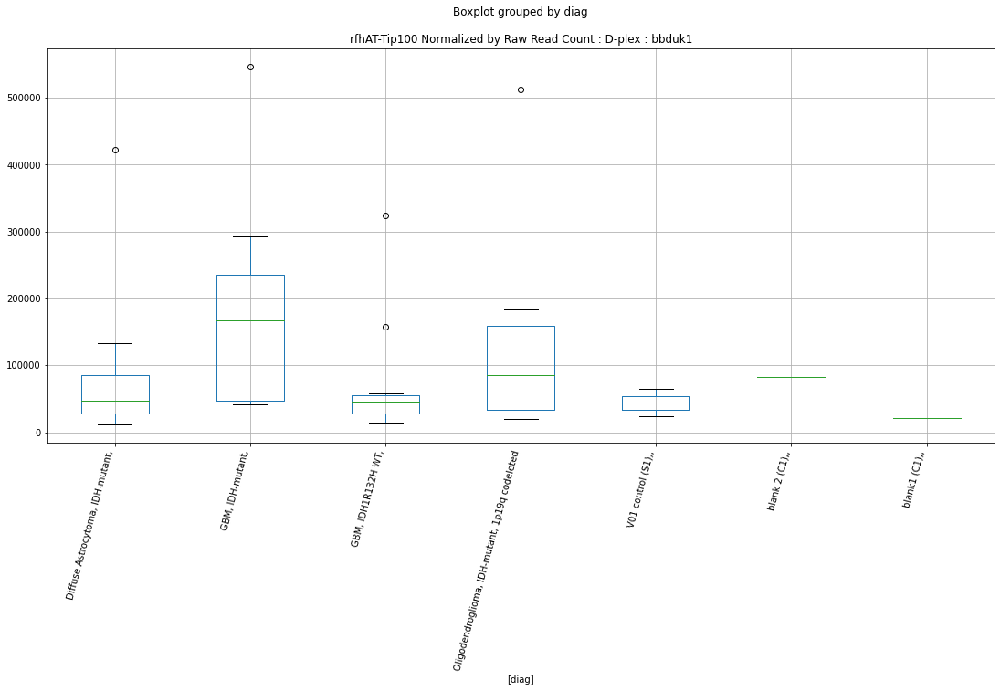

rfhAT-Tip100 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8173084533715835
	p = 0.08585666971763192
rfhAT-Tip100 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8173084533715835
	p = 0.08585666971763192


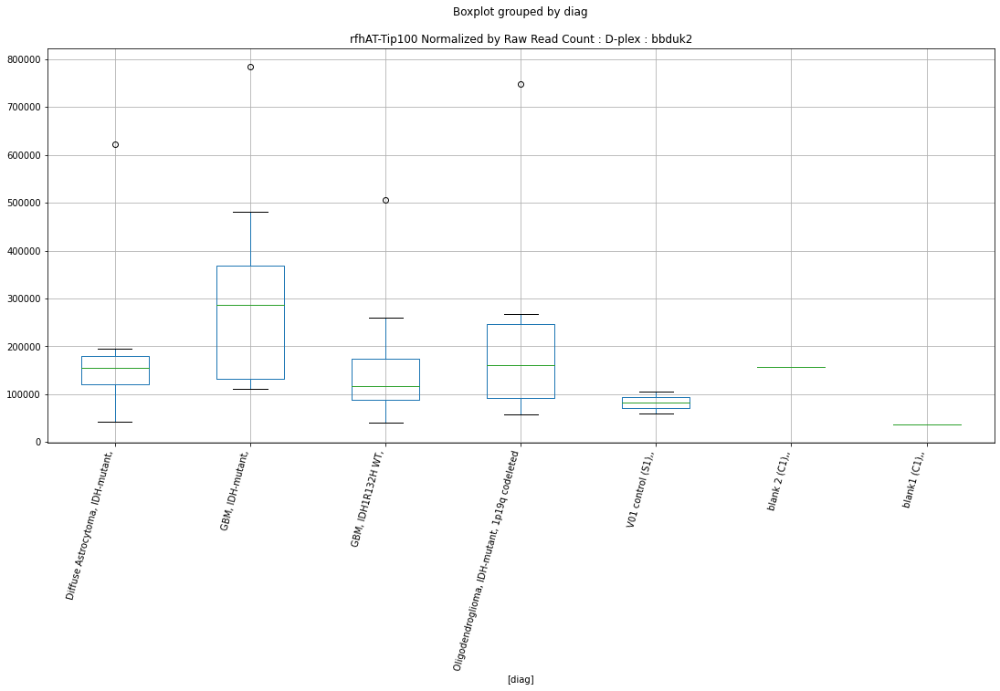

rfhAT-Tip100 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8228433268218256
	p = 0.08498158920134848
rfhAT-Tip100 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8228433268218256
	p = 0.08498158920134848


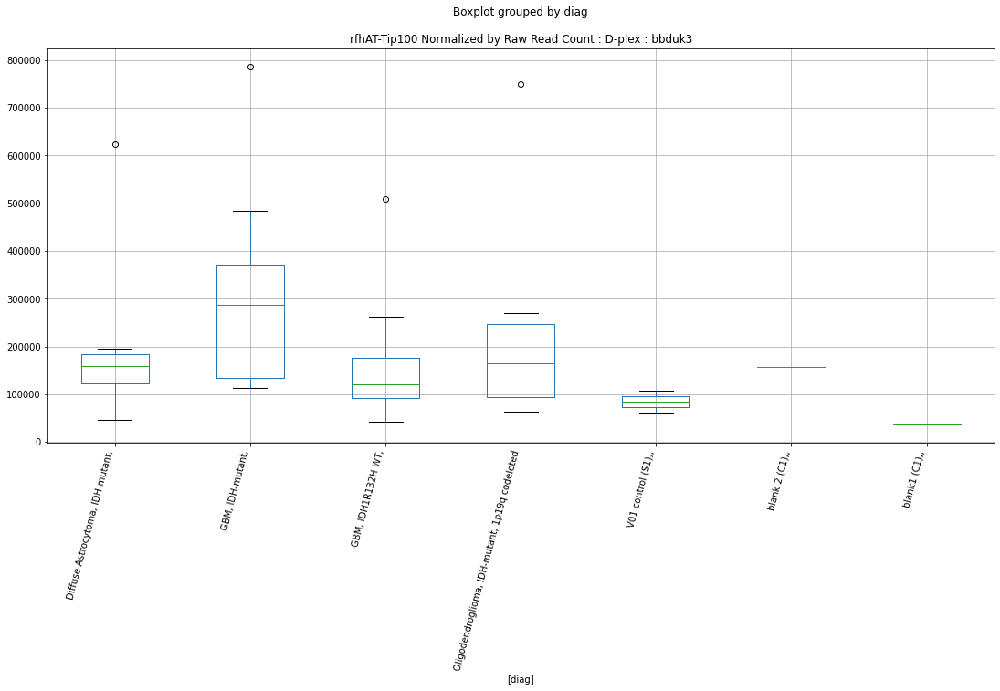

rfERVK D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8502495496038485
	p = 0.08076293555925984
rfERVK D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8502495496038485
	p = 0.08076293555925984


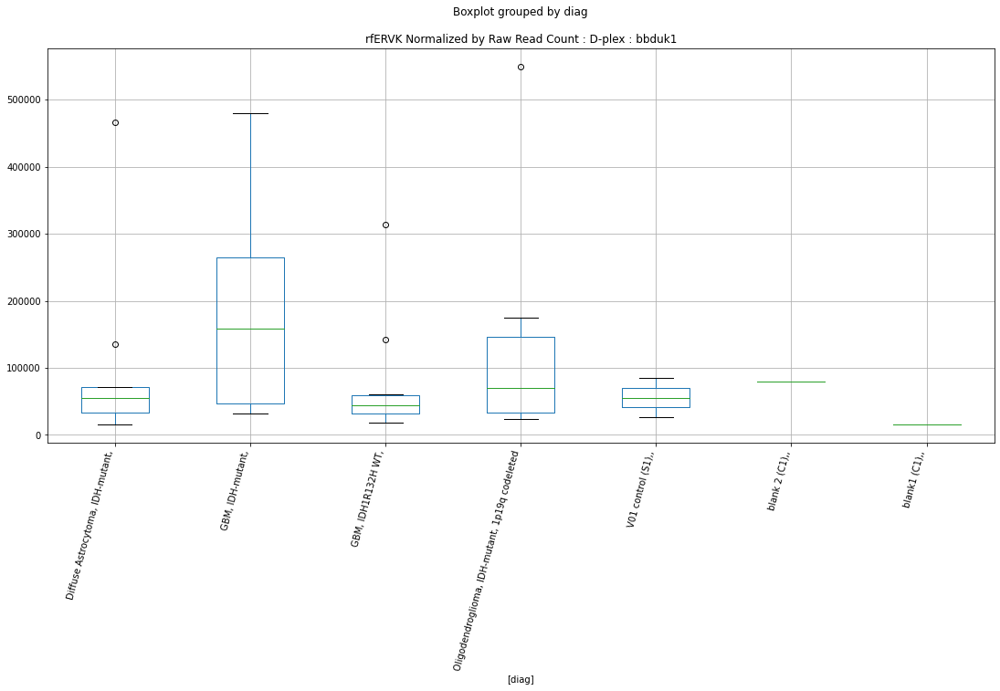

rfERVK D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8718741303540831
	p = 0.07756550824868333
rfERVK D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8718741303540831
	p = 0.07756550824868333


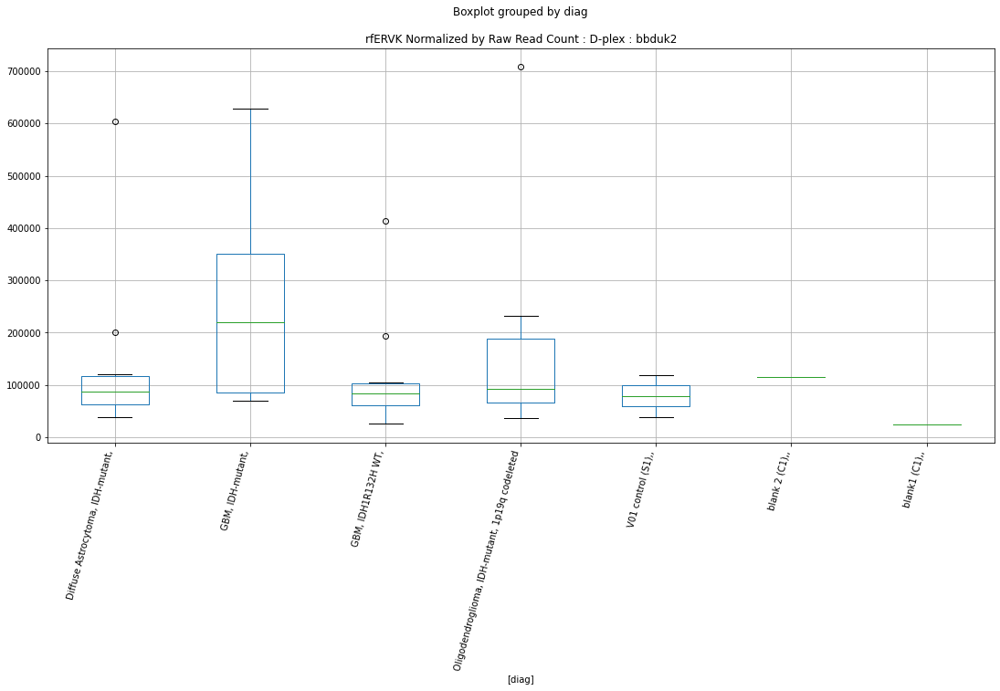

rfERVK D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8766609994791708
	p = 0.07687301352729416
rfERVK D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8766609994791708
	p = 0.07687301352729416


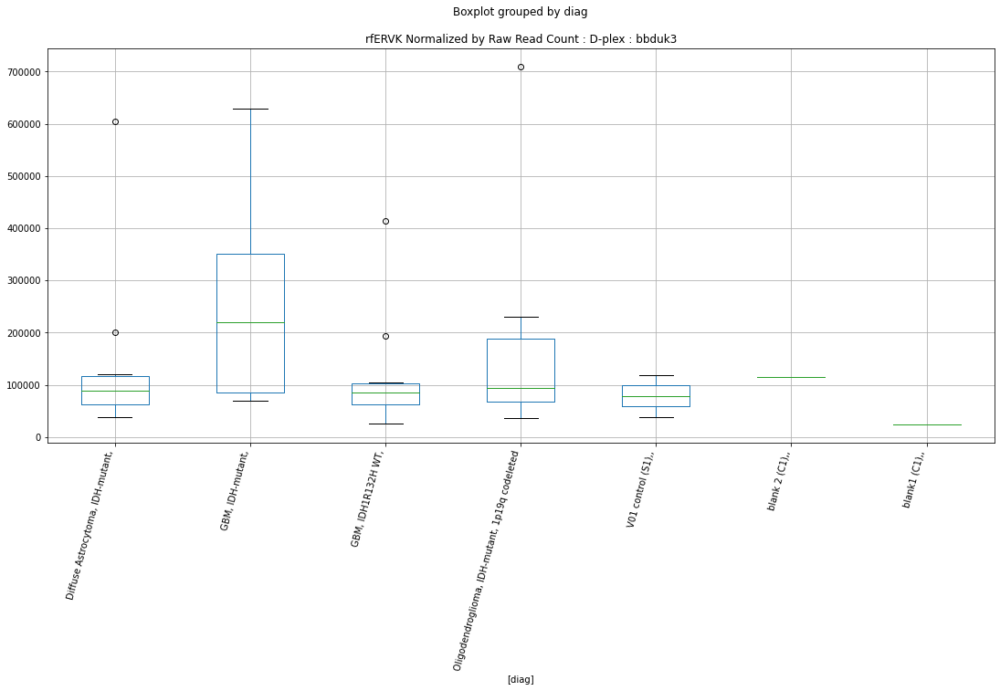

rfERVK D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8237375052678553
	p = 0.08484095308993787
rfERVK D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8237375052678553
	p = 0.08484095308993787


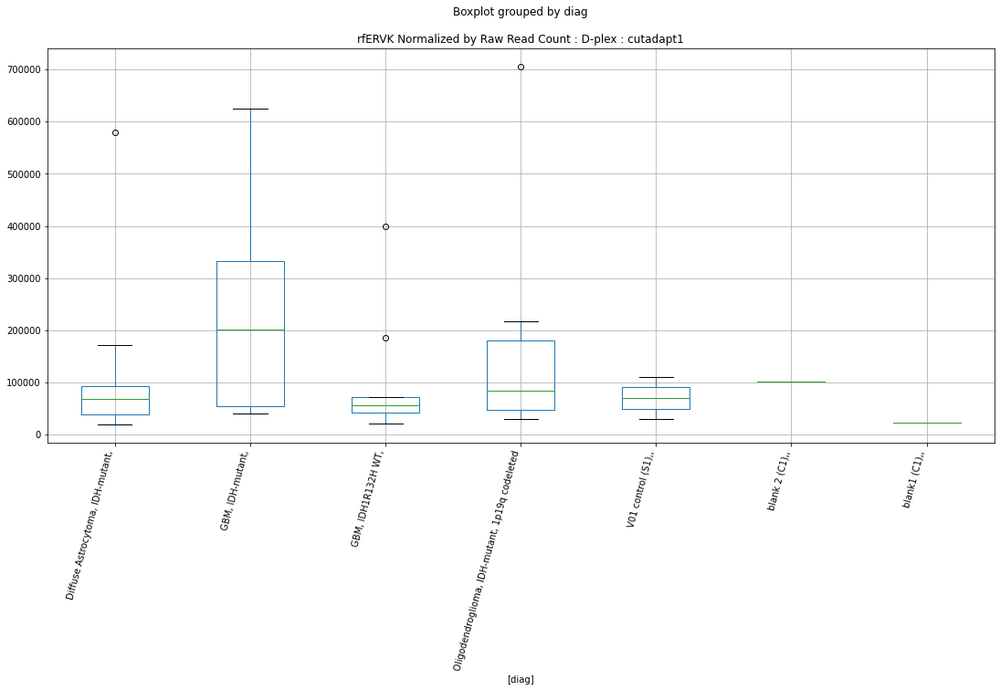

rfERVK D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.838047618207395
	p = 0.08261788885560452
rfERVK D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.838047618207395
	p = 0.08261788885560452


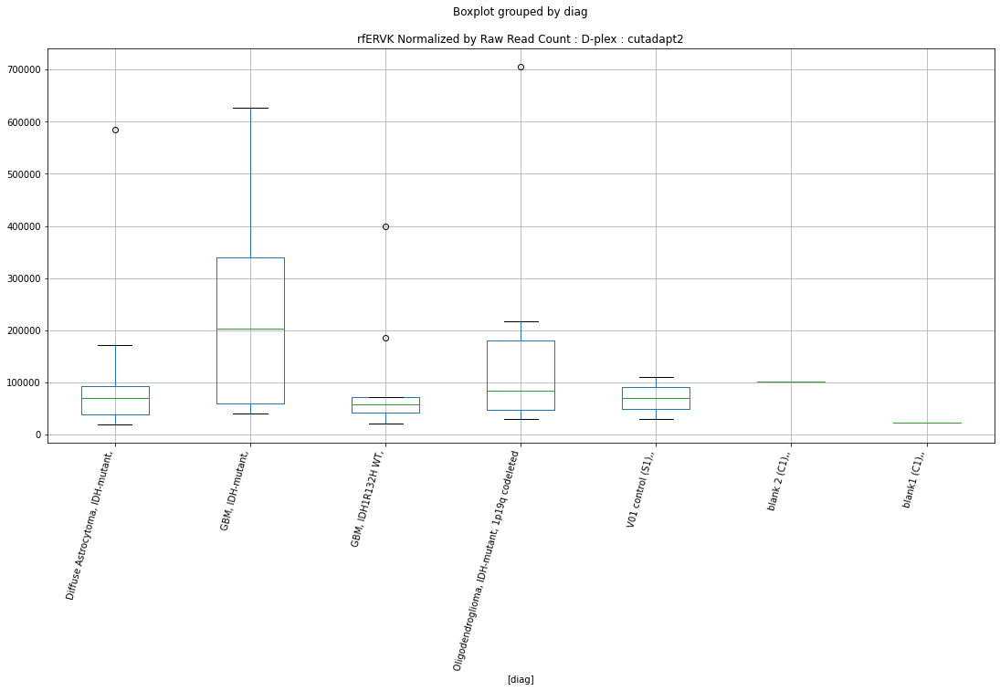

rfERVK D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8386193141996143
	p = 0.08253014951303354
rfERVK D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8386193141996143
	p = 0.08253014951303354


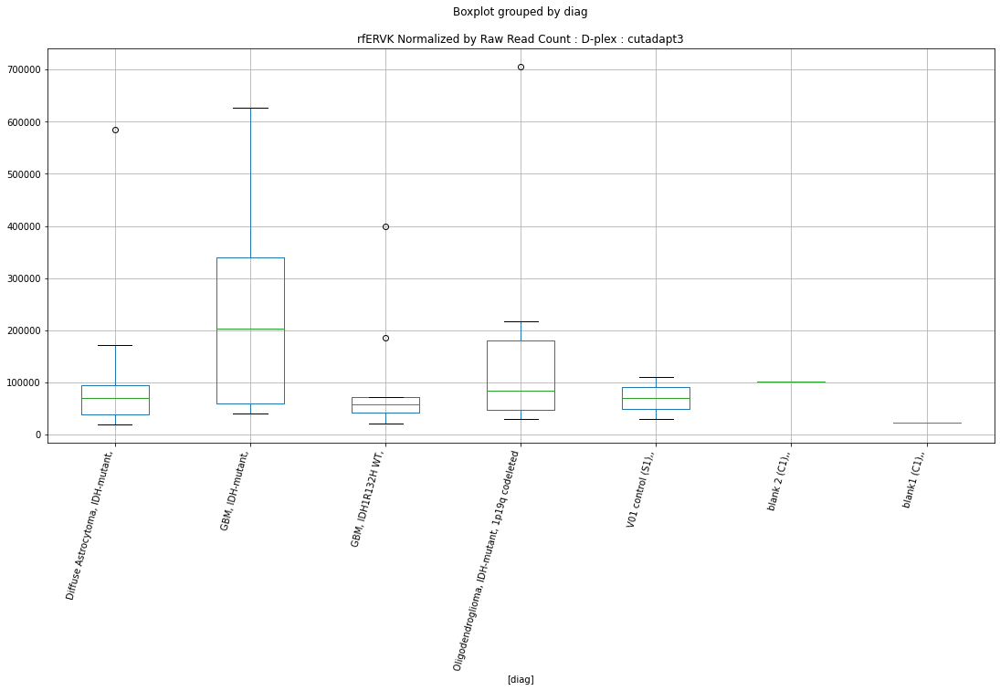

rftRNA D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7716474509173636
	p = 0.09338171117245547
rftRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7716474509173636
	p = 0.09338171117245547


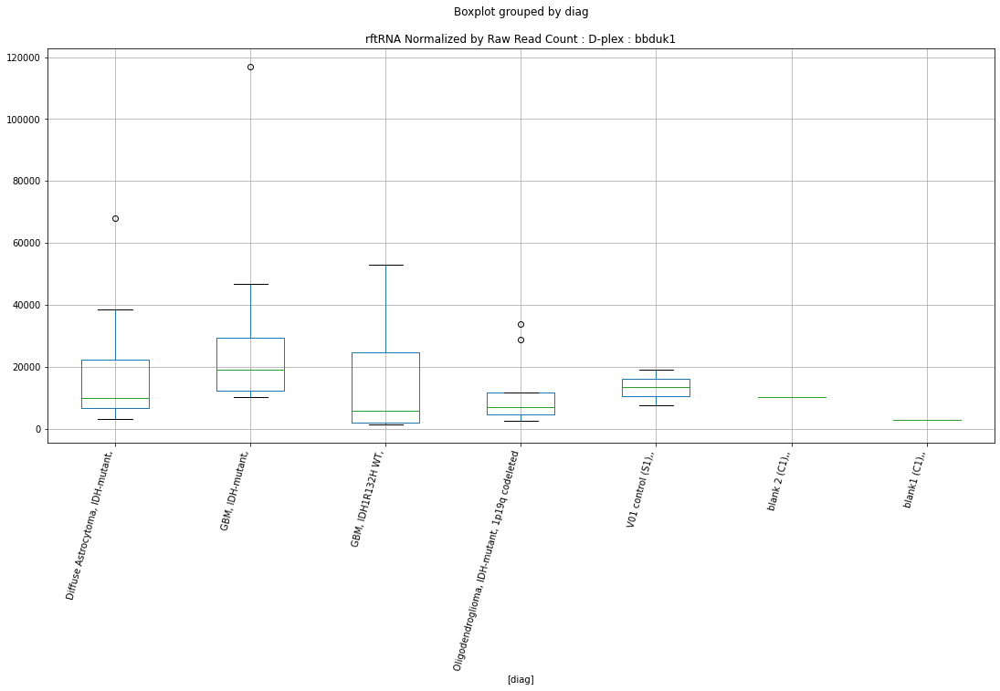

rftRNA Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9295220955053363
	p = 0.06958207094019142
rftRNA Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9443640569417786
	p = 0.06764874147158609
rftRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9295220955053363
	p = 0.06958207094019142
rftRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9443640569417786
	p = 0.06764874147158609


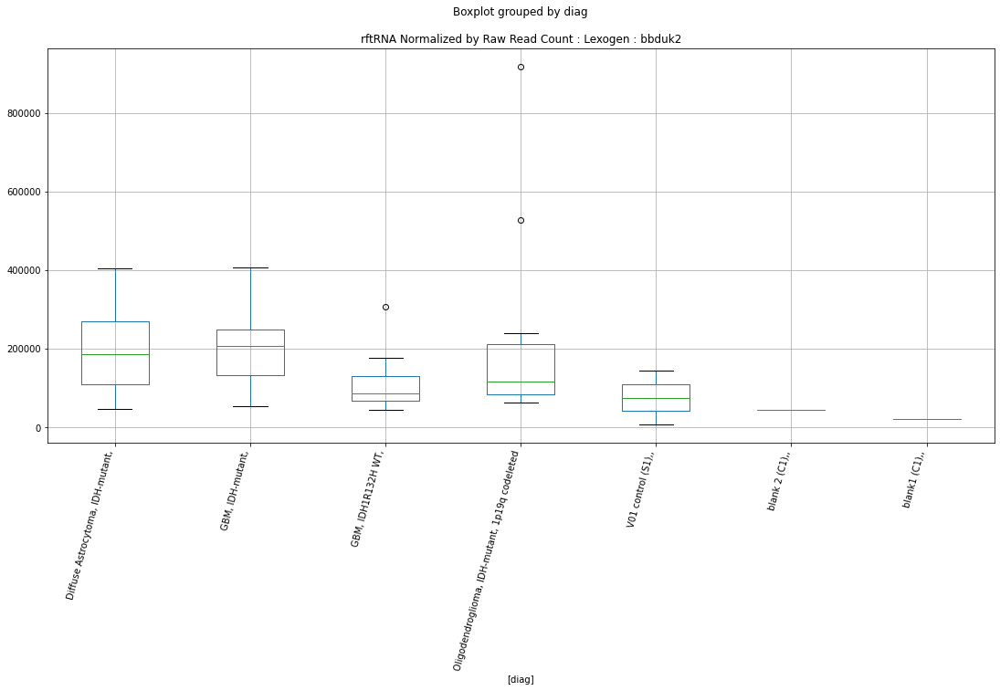

rftRNA Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9344817689390543
	p = 0.06893061179849193
rftRNA Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9452018095011658
	p = 0.06754105702083422
rftRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9344817689390543
	p = 0.06893061179849193
rftRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9452018095011658
	p = 0.06754105702083422


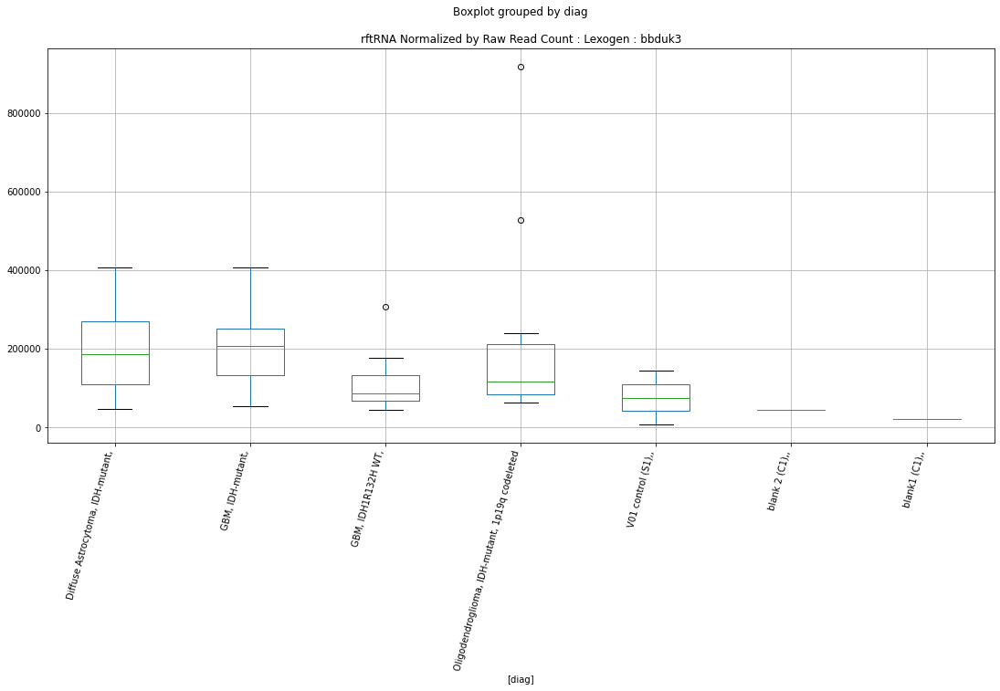

rftRNA Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9266690290811215
	p = 0.0699593033004324
rftRNA Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9482702509361676
	p = 0.0671479452364247
rftRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9266690290811215
	p = 0.0699593033004324
rftRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9482702509361676
	p = 0.0671479452364247


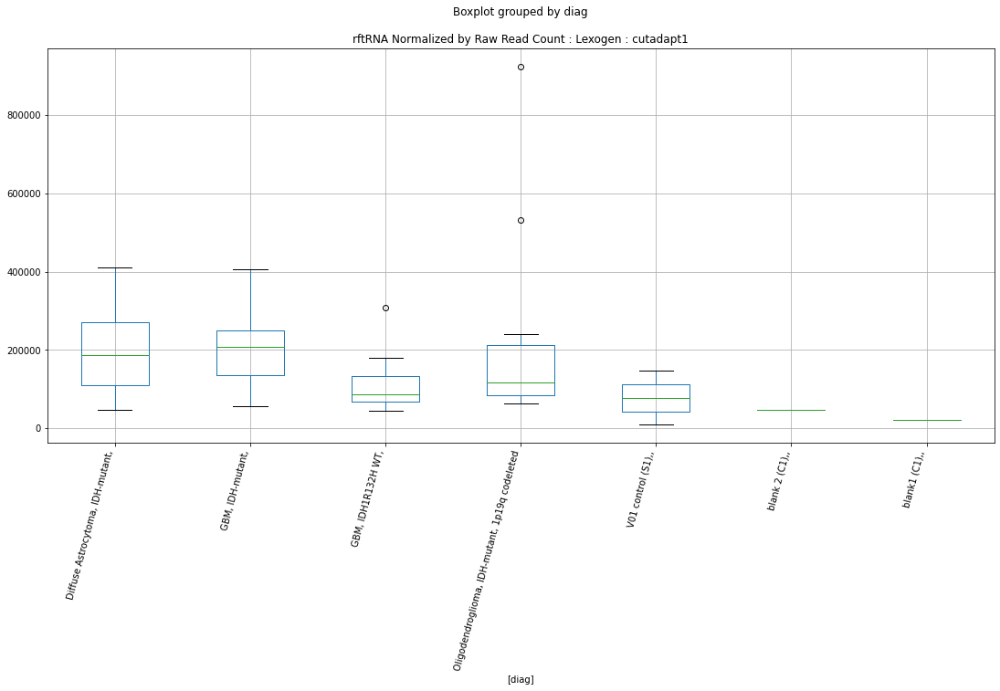

rftRNA Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9300084365939774
	p = 0.0695179478926447
rftRNA Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9288263586372556
	p = 0.06967389392520094
rftRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9300084365939774
	p = 0.0695179478926447
rftRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9288263586372556
	p = 0.06967389392520094


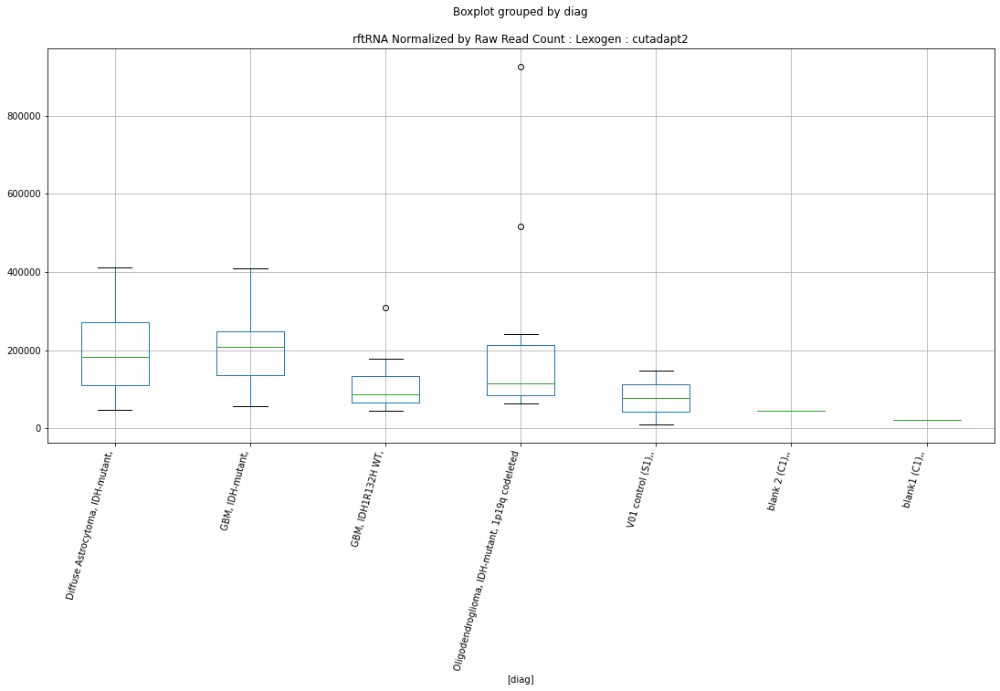

rftRNA Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.936850805372218
	p = 0.06862135776139212
rftRNA Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.931525260158939
	p = 0.06931829571046556
rftRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.936850805372218
	p = 0.06862135776139212
rftRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.931525260158939
	p = 0.06931829571046556


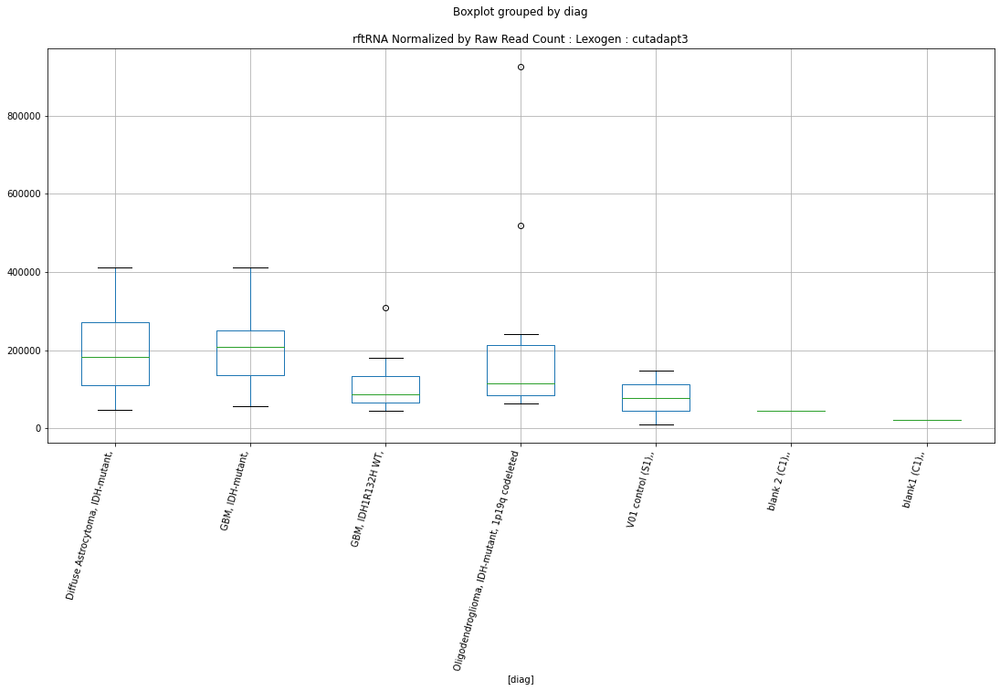

rfSVA Lexogen cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -1.7788127476388158
	p = 0.09216410668178242
rfSVA Lexogen cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7788127476388158
	p = 0.09216410668178242


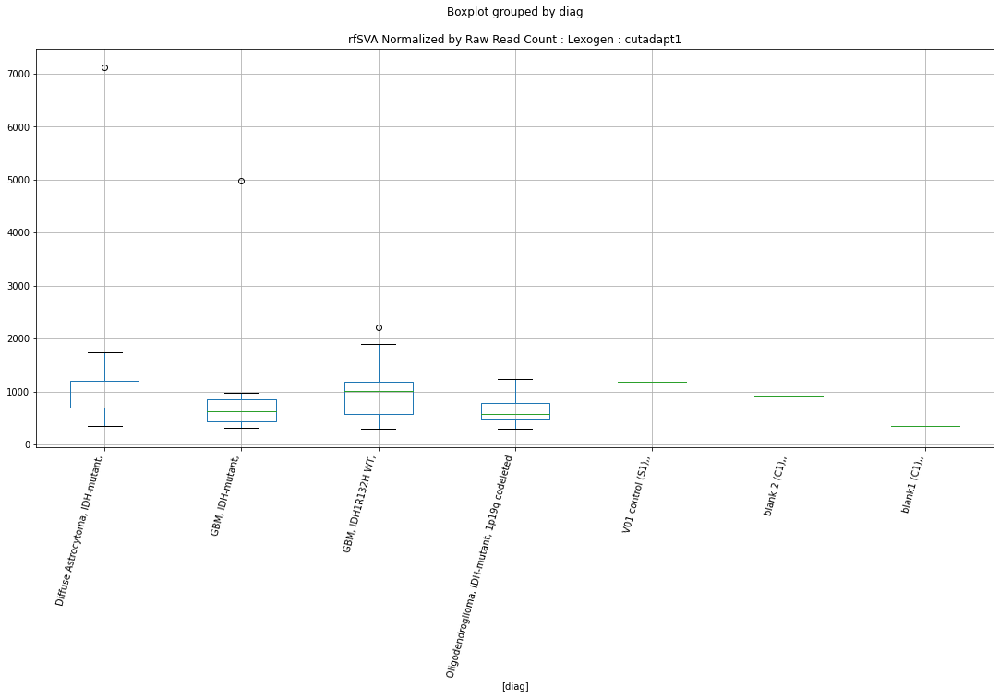

rfhAT-Blackjack D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.818582392932629
	p = 0.08565455926886154
rfhAT-Blackjack D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.818582392932629
	p = 0.08565455926886154


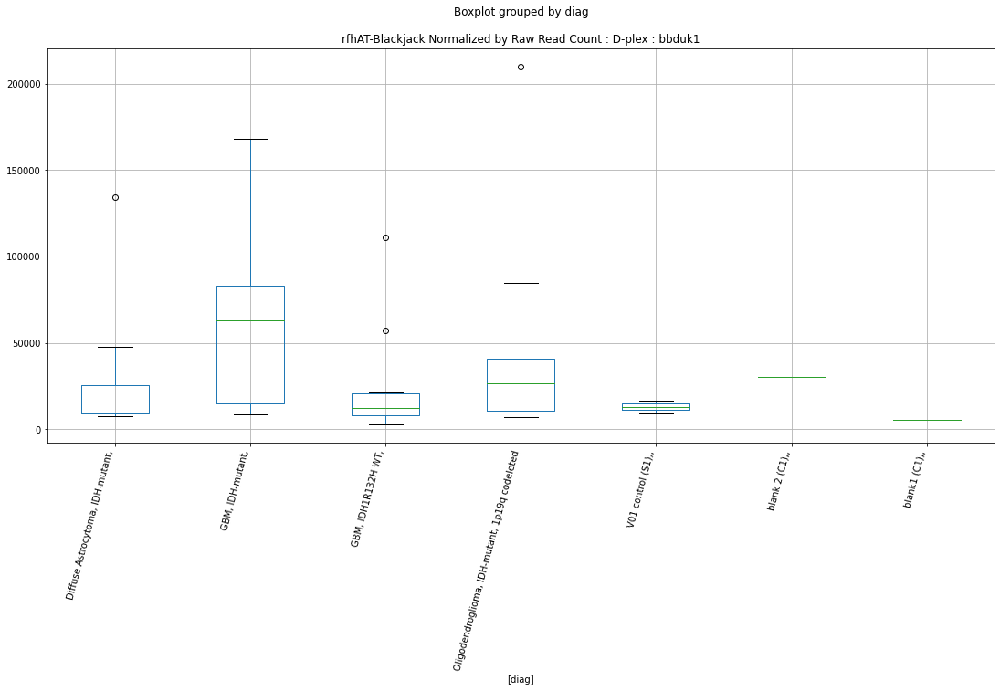

rfhAT-Blackjack D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7557285002756242
	p = 0.09613700935757807
rfhAT-Blackjack D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7557285002756242
	p = 0.09613700935757807


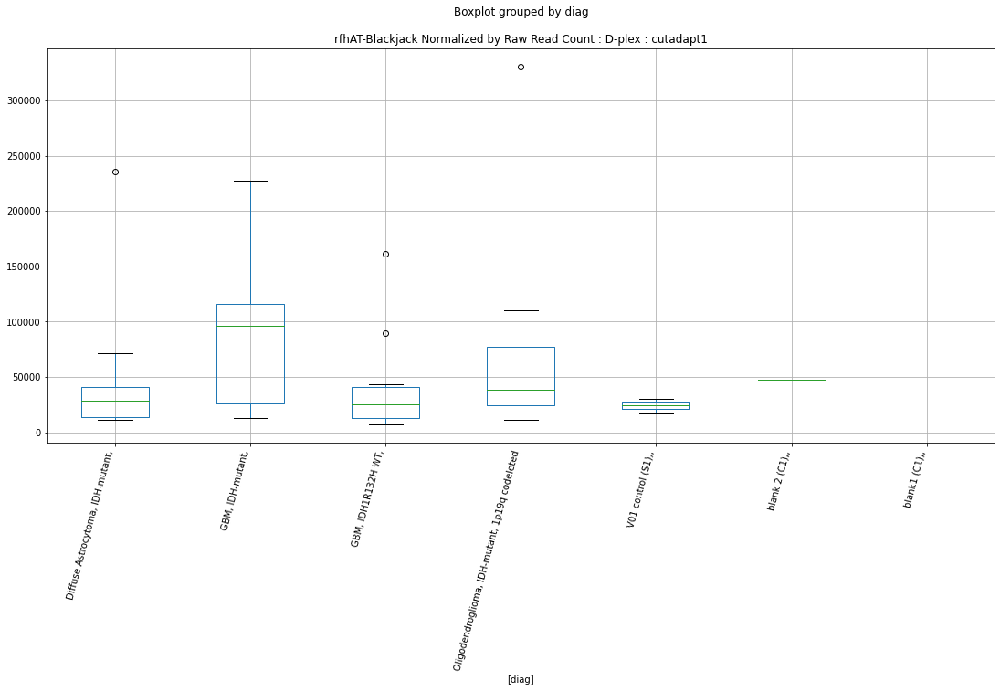

rfhAT-Blackjack D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7561292240644273
	p = 0.09606679412644217
rfhAT-Blackjack D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7561292240644273
	p = 0.09606679412644217


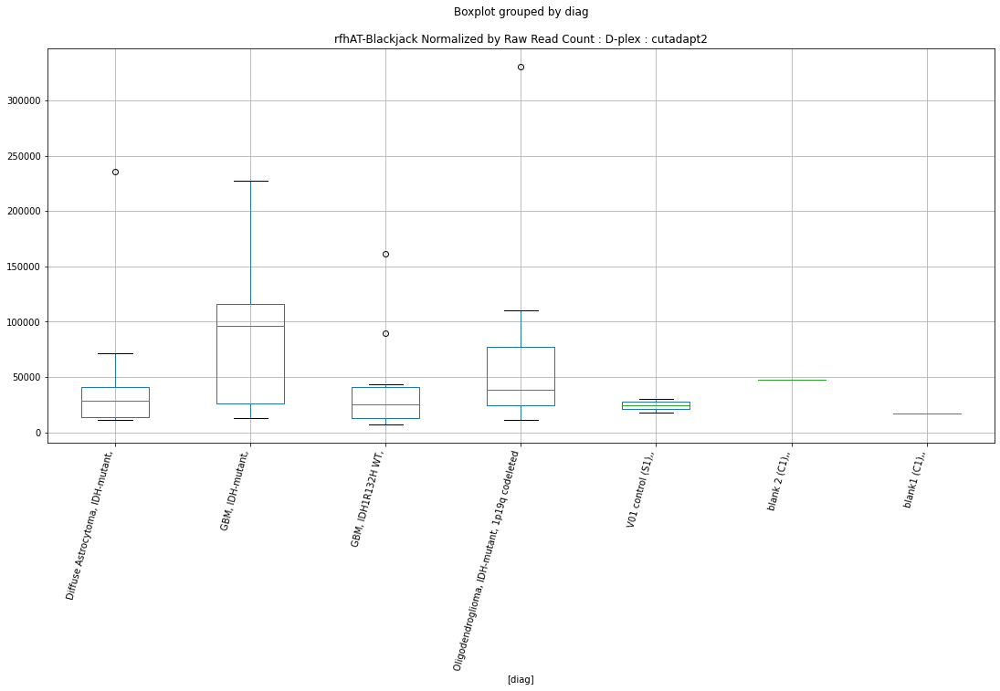

rfhAT-Blackjack D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7561292240644273
	p = 0.09606679412644217
rfhAT-Blackjack D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7561292240644273
	p = 0.09606679412644217


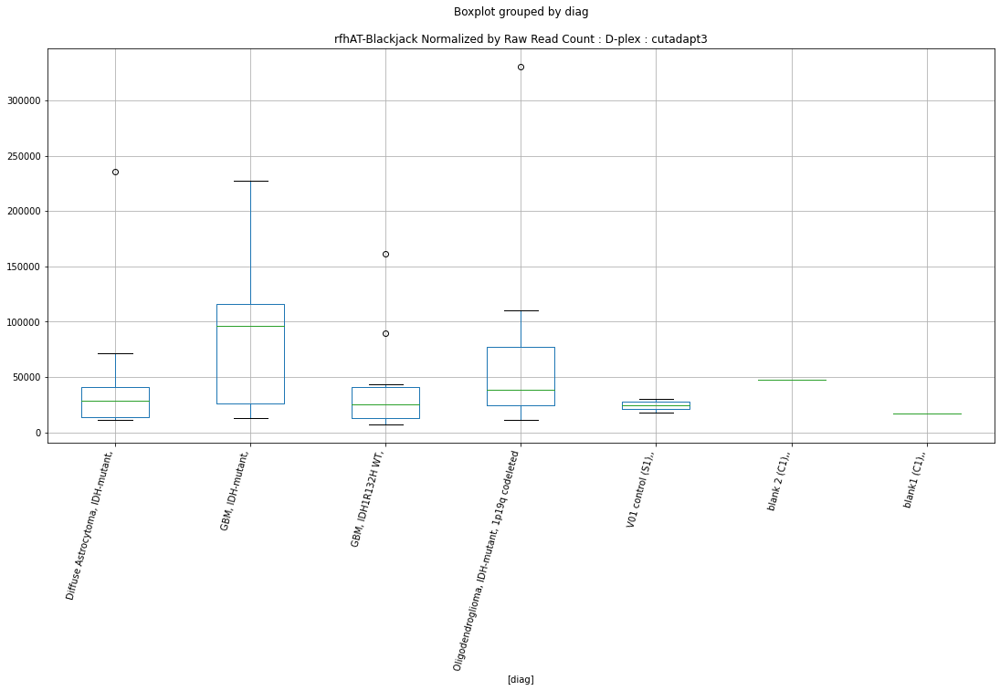

rfGypsy? D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.761700863005162
	p = 0.09509512865812433
rfGypsy? D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.761700863005162
	p = 0.09509512865812433


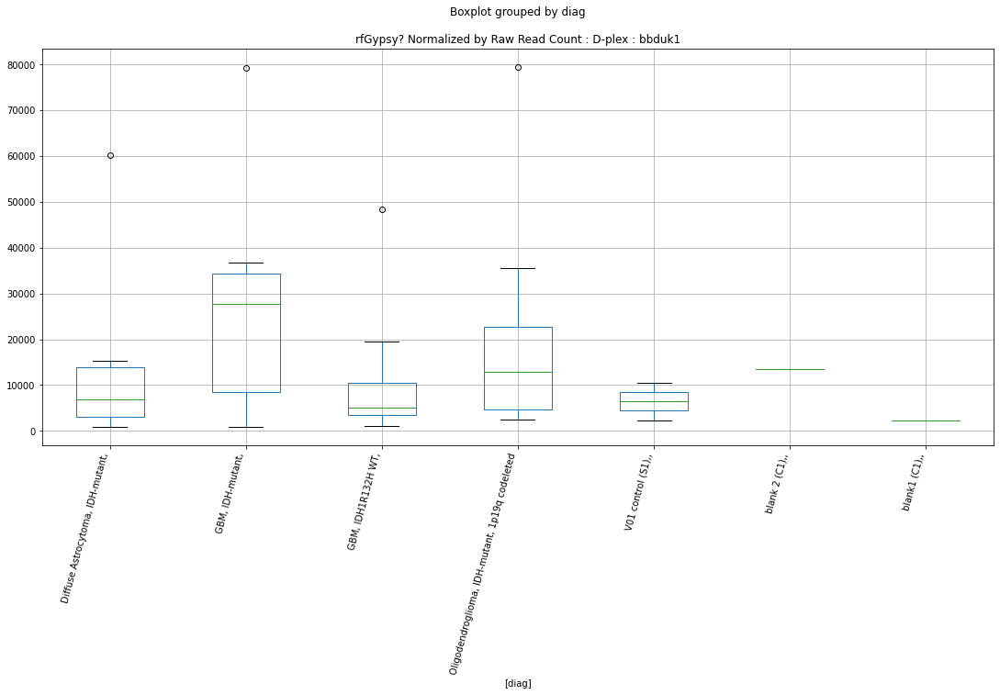

rfGypsy? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.981376315979352
	p = 0.0630347653261335
rfGypsy? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.981376315979352
	p = 0.0630347653261335


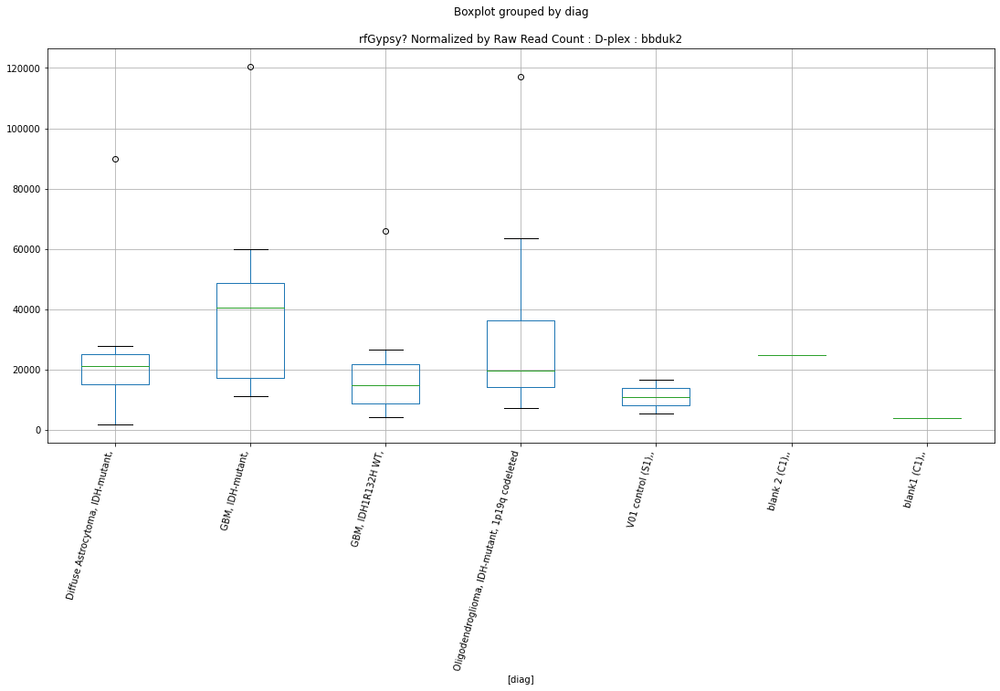

rfGypsy? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9714013188748136
	p = 0.06424968235504876
rfGypsy? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9714013188748136
	p = 0.06424968235504876


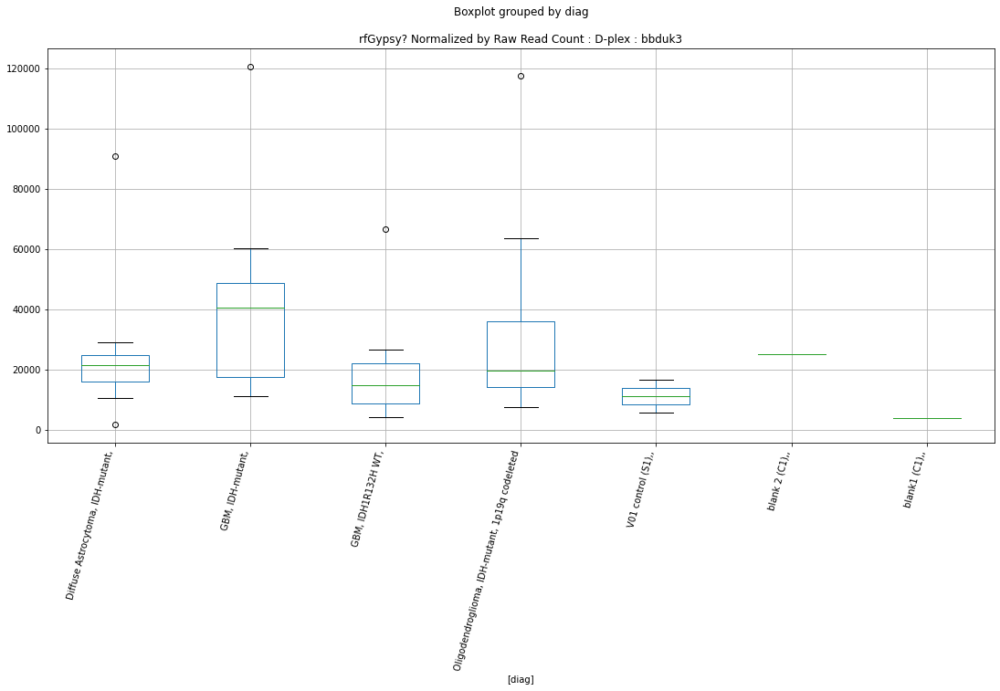

rfGypsy? D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.910746147670256
	p = 0.0720982261367392
rfGypsy? D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.910746147670256
	p = 0.0720982261367392


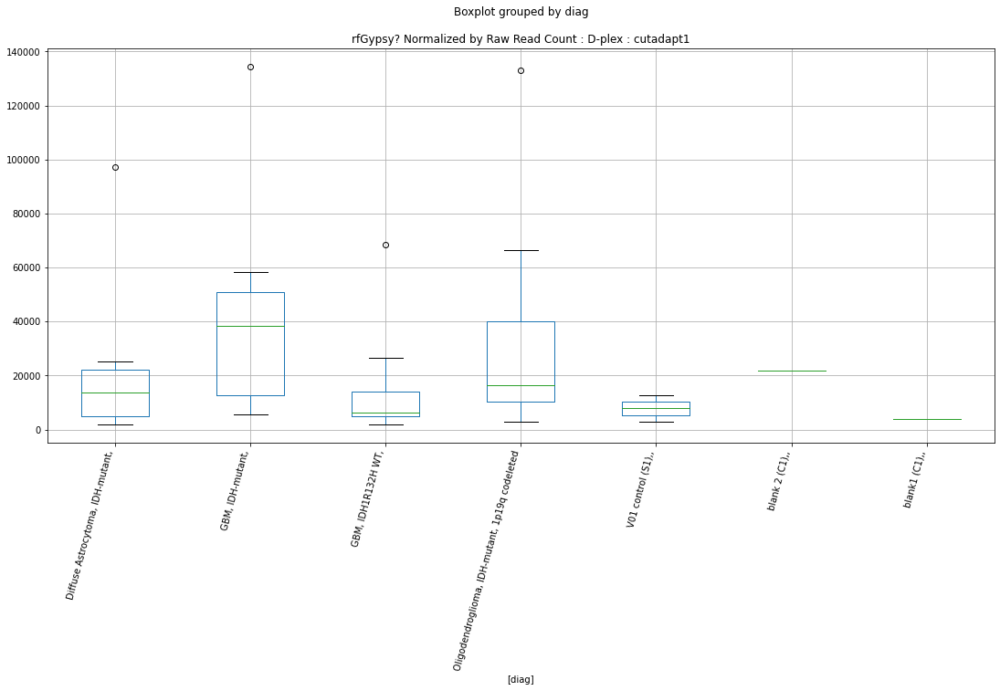

rfGypsy? D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9117172413502785
	p = 0.07196613417770888
rfGypsy? D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9117172413502785
	p = 0.07196613417770888


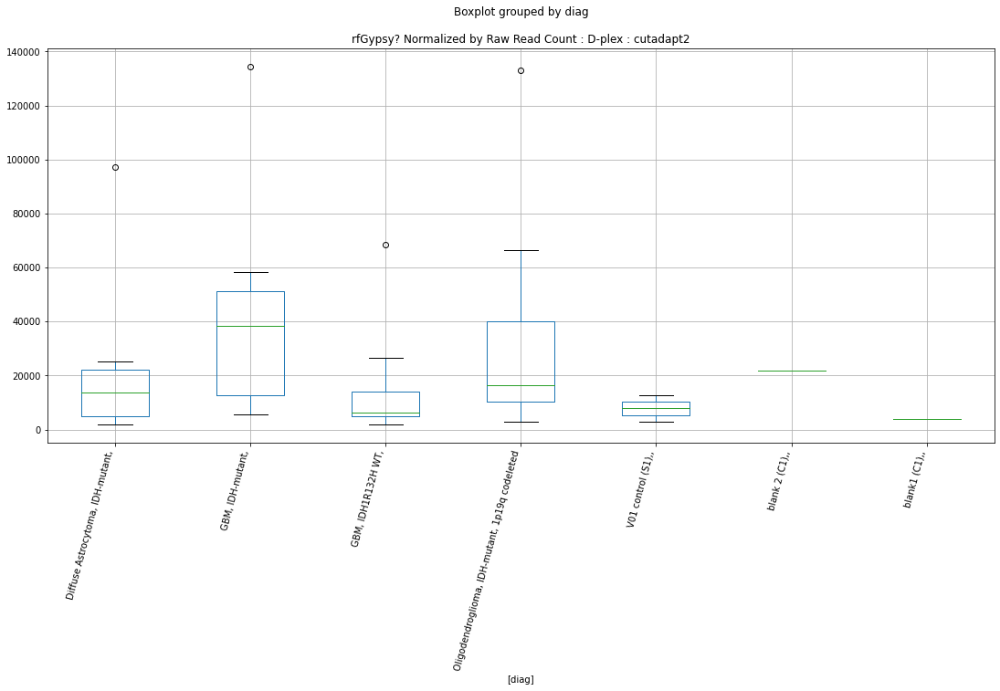

rfGypsy? D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9117172413502785
	p = 0.07196613417770888
rfGypsy? D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9117172413502785
	p = 0.07196613417770888


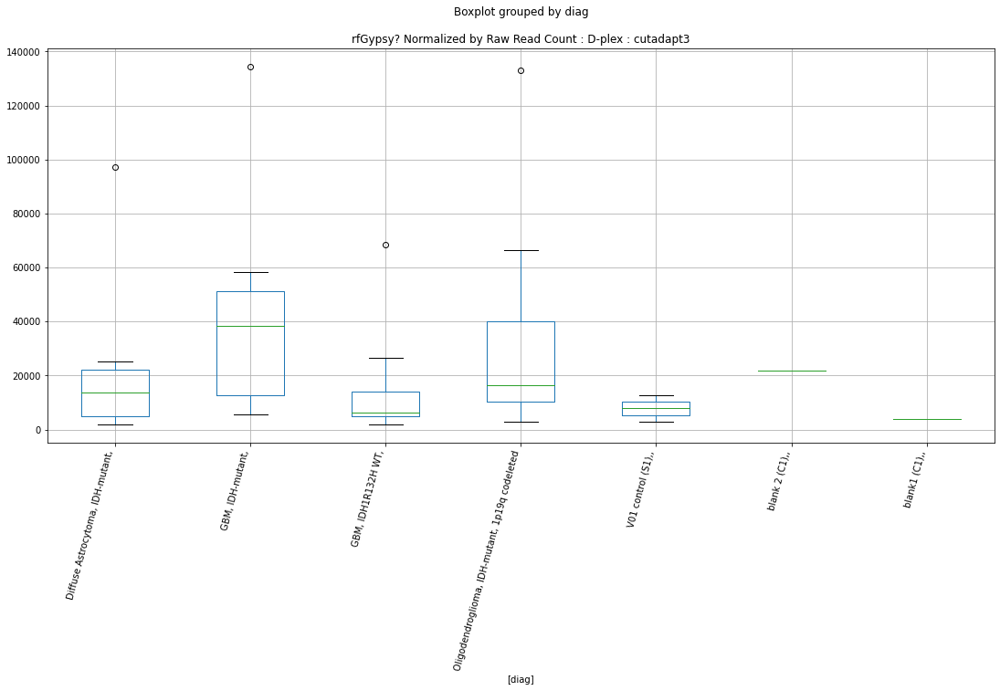

rfhAT D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.4095823215162824
	p = 0.02689237767190791
rfhAT D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.4095823215162824
	p = 0.02689237767190791


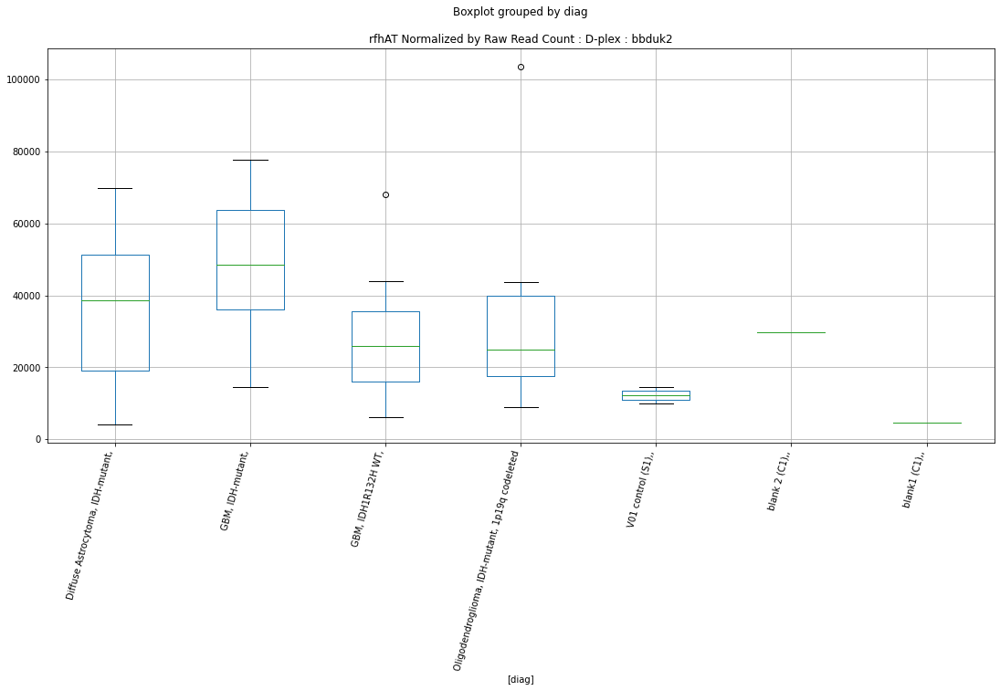

rfhAT D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.4120861551549737
	p = 0.026754331606024993
rfhAT D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.4120861551549737
	p = 0.026754331606024993


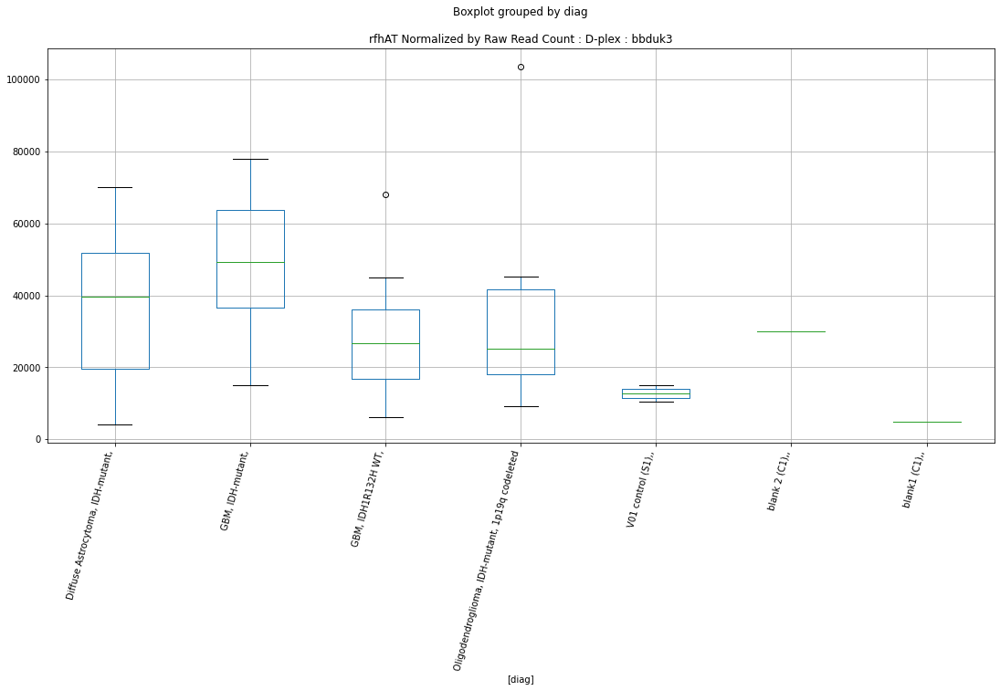

rfhAT D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0706062163631263
	p = 0.053051409840880165
rfhAT D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8868833195119346
	p = 0.07541246752419943
rfhAT D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.0706062163631263
	p = 0.053051409840880165
rfhAT D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8868833195119346
	p = 0.07541246752419943


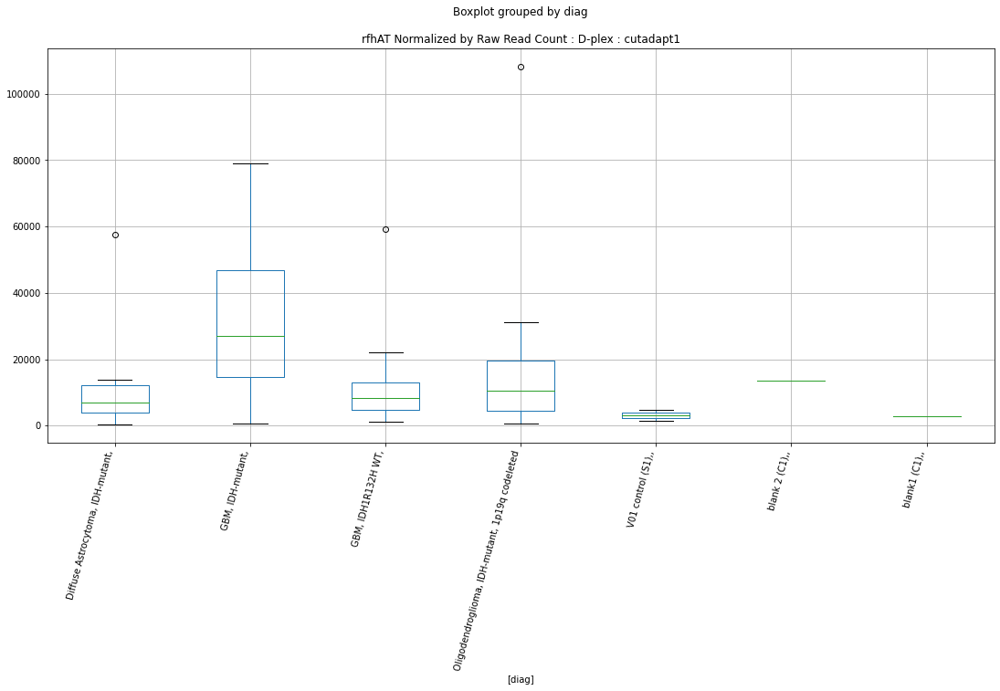

rfhAT D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.072452080693116
	p = 0.052860896167709163
rfhAT D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8882749429156371
	p = 0.07521554596722739
rfhAT D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.072452080693116
	p = 0.052860896167709163
rfhAT D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8882749429156371
	p = 0.07521554596722739


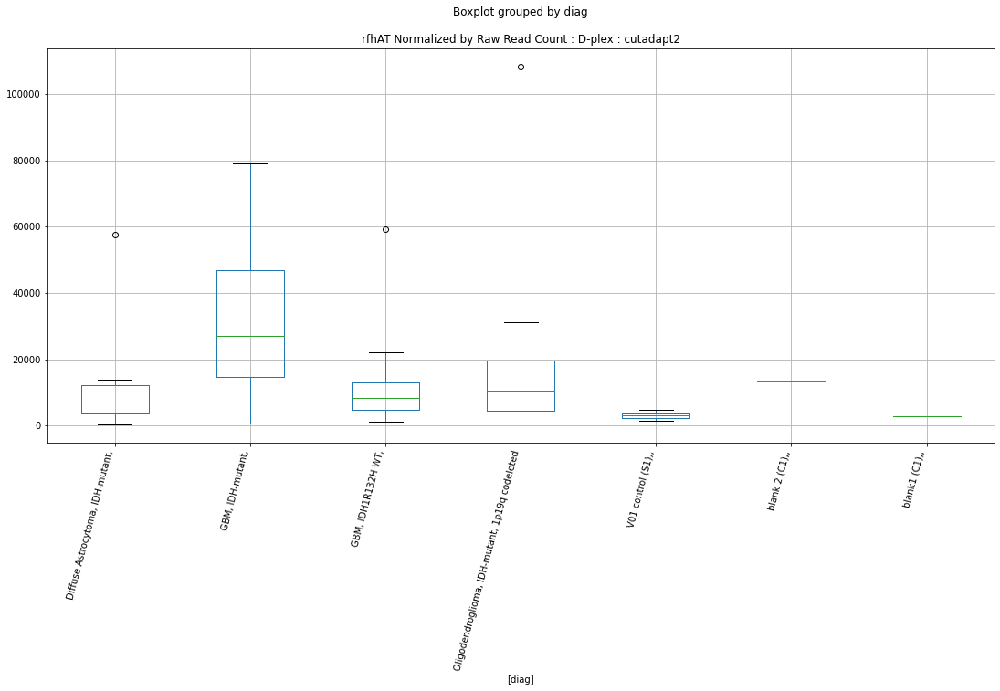

rfhAT D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.072452080693116
	p = 0.052860896167709163
rfhAT D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8882749429156371
	p = 0.07521554596722739
rfhAT D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.072452080693116
	p = 0.052860896167709163
rfhAT D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8882749429156371
	p = 0.07521554596722739


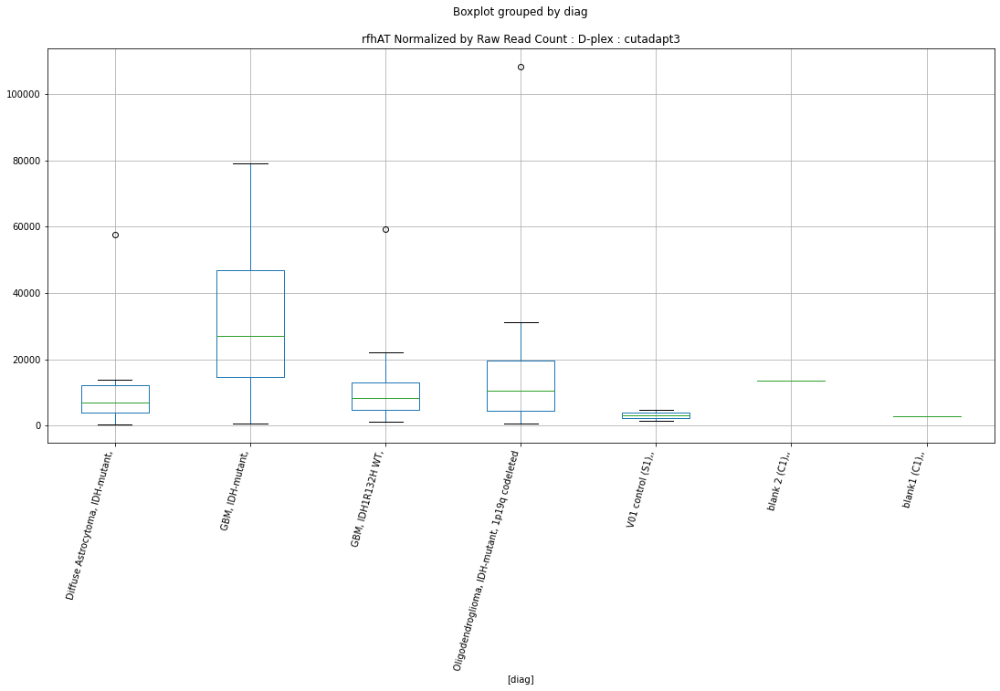

rfsrpRNA D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.750236723388134
	p = 0.09710378047882161
rfsrpRNA D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.750236723388134
	p = 0.09710378047882161


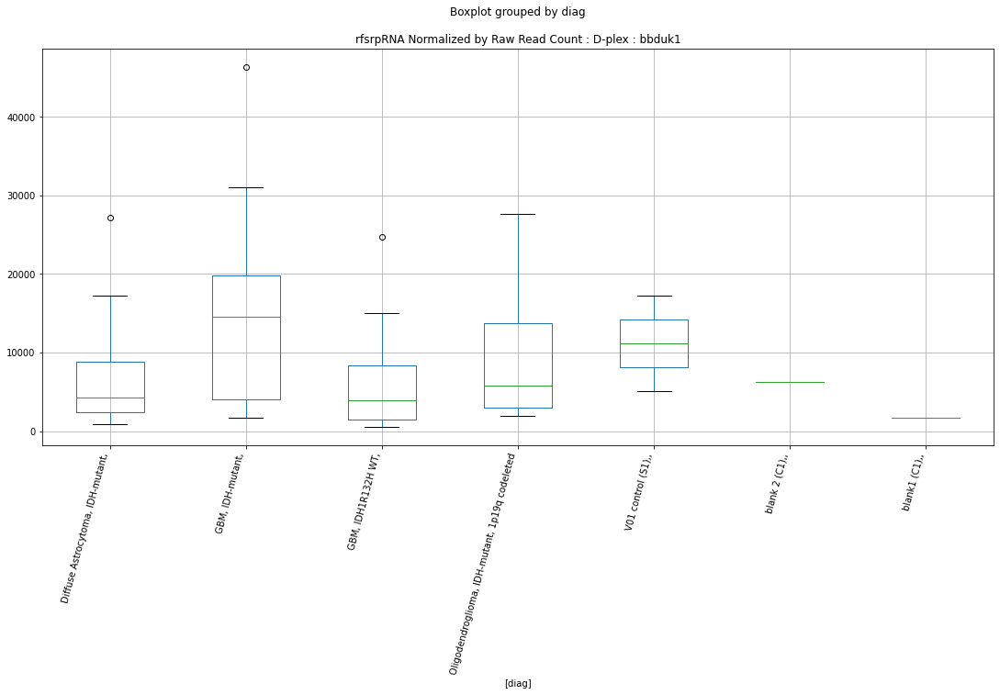

rfsrpRNA D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7644201979937828
	p = 0.09462399841516315
rfsrpRNA D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7644201979937828
	p = 0.09462399841516315


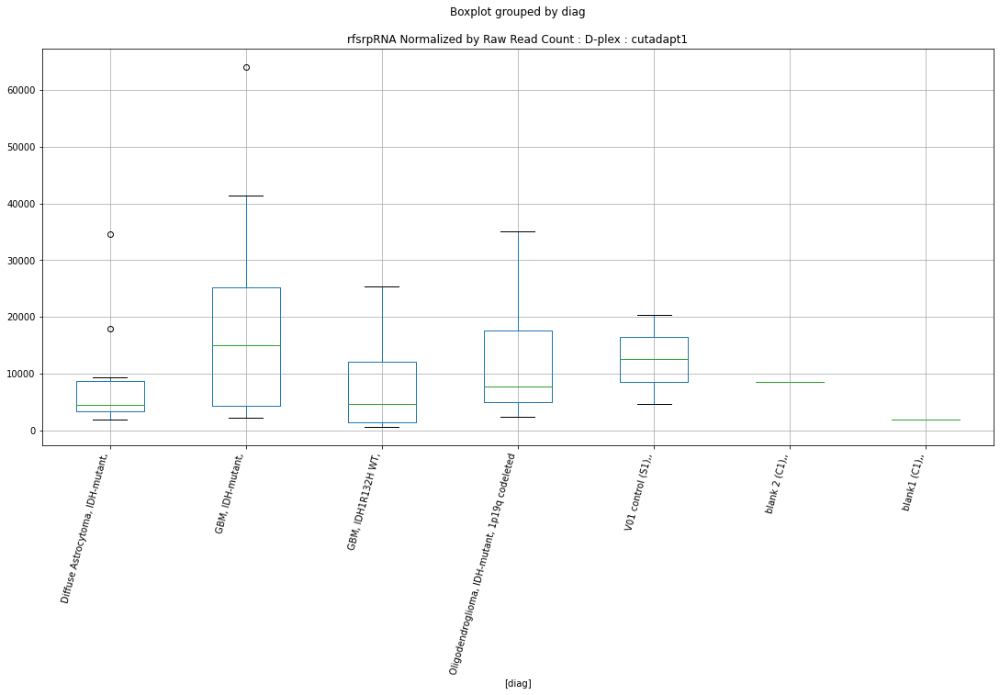

rfsrpRNA D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7644201979937828
	p = 0.09462399841516315
rfsrpRNA D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7644201979937828
	p = 0.09462399841516315


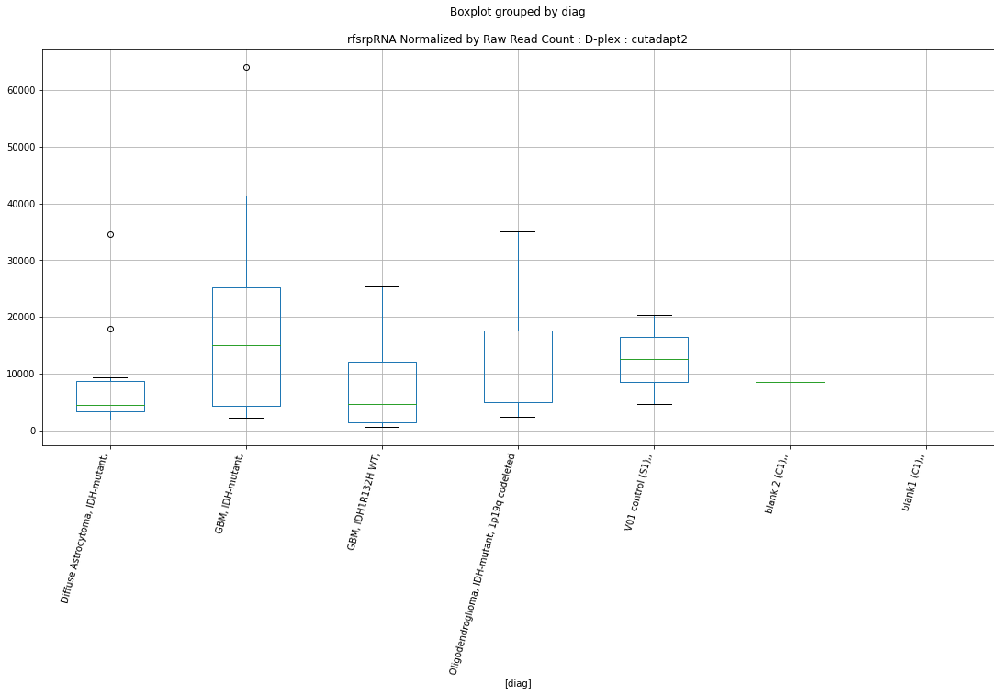

rfsrpRNA D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7644201979937828
	p = 0.09462399841516315
rfsrpRNA D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7644201979937828
	p = 0.09462399841516315


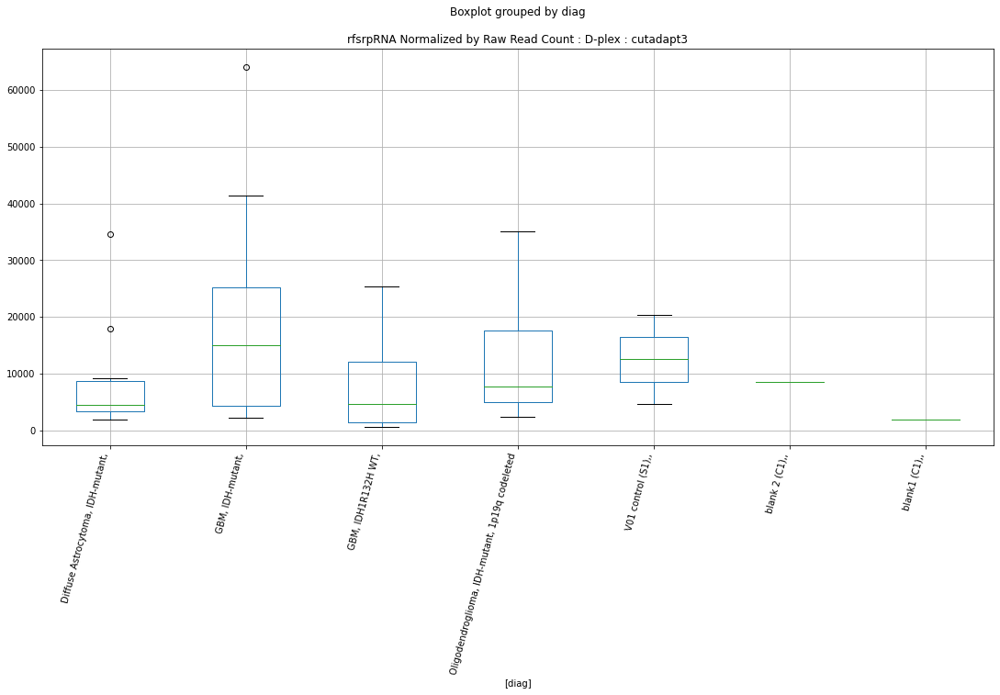

rfacro D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.801052896992249
	p = 0.08847251643824476
rfacro D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.801052896992249
	p = 0.08847251643824476


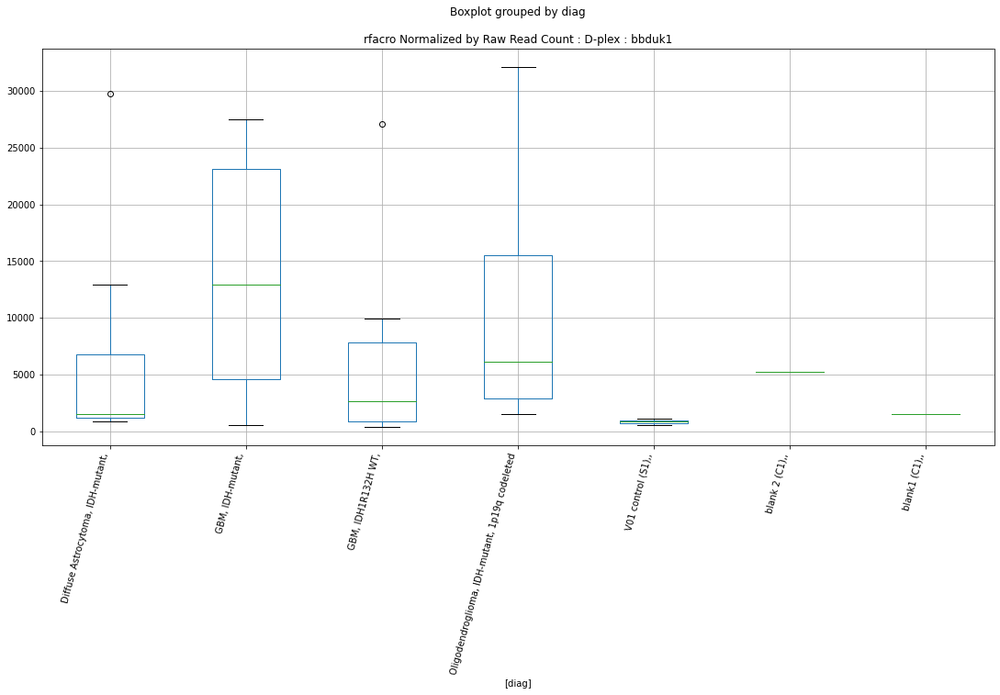

rfPiggyBac D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9480016902705817
	p = 0.06718227003076113
rfPiggyBac D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9480016902705817
	p = 0.06718227003076113


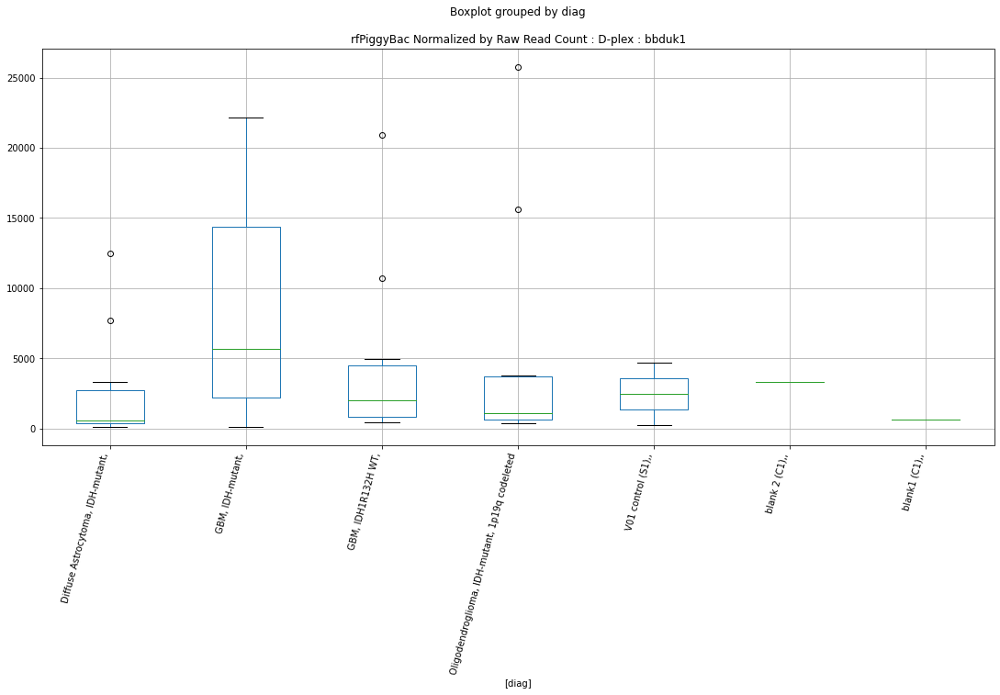

rfPiggyBac D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8466065032476895
	p = 0.08131287984095838
rfPiggyBac D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8694359086870191
	p = 0.07792034845825899
rfPiggyBac D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8466065032476895
	p = 0.08131287984095838
rfPiggyBac D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8694359086870191
	p = 0.07792034845825899


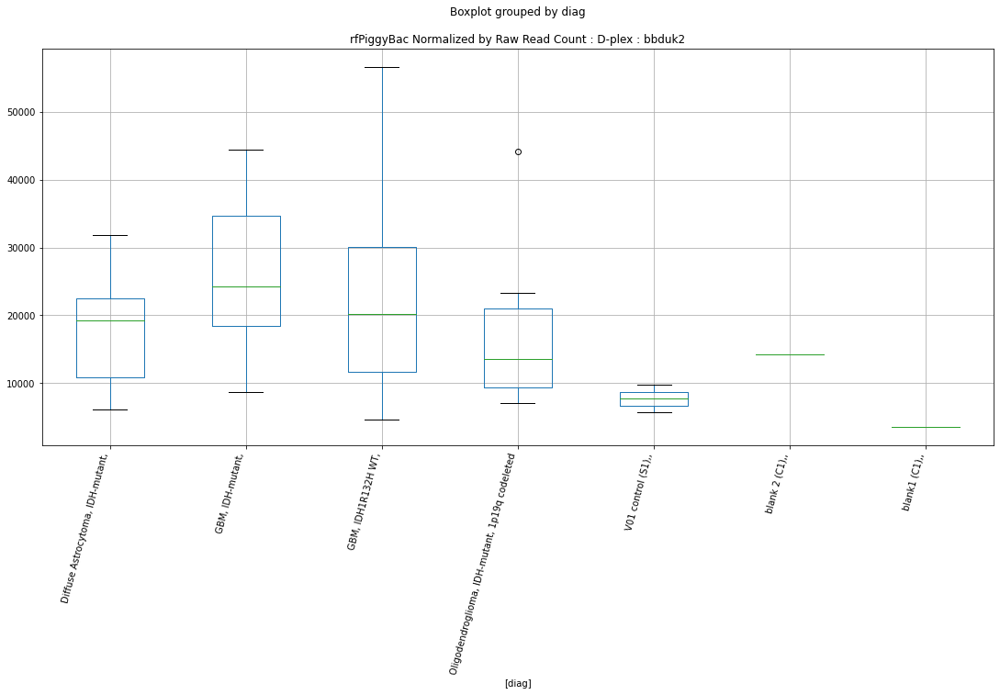

rfPiggyBac D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7635918244828646
	p = 0.09476730049421371
rfPiggyBac D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9097567176427954
	p = 0.07223303367824467
rfPiggyBac D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7635918244828646
	p = 0.09476730049421371
rfPiggyBac D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9097567176427954
	p = 0.07223303367824467


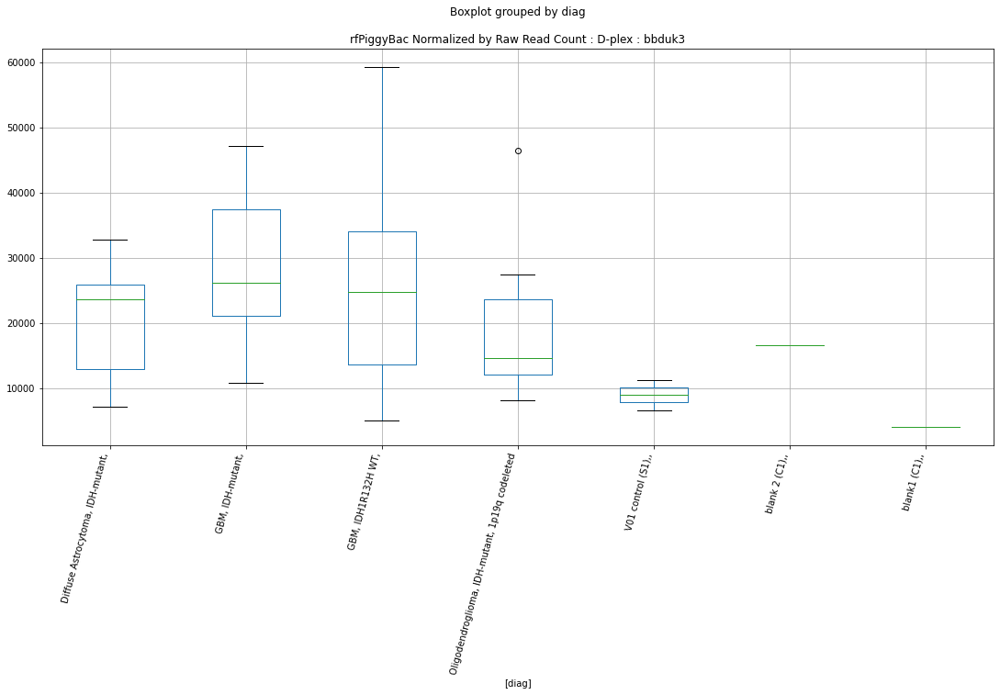

rfPiggyBac D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.259681157659422
	p = 0.036478345715979486
rfPiggyBac D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.259681157659422
	p = 0.036478345715979486


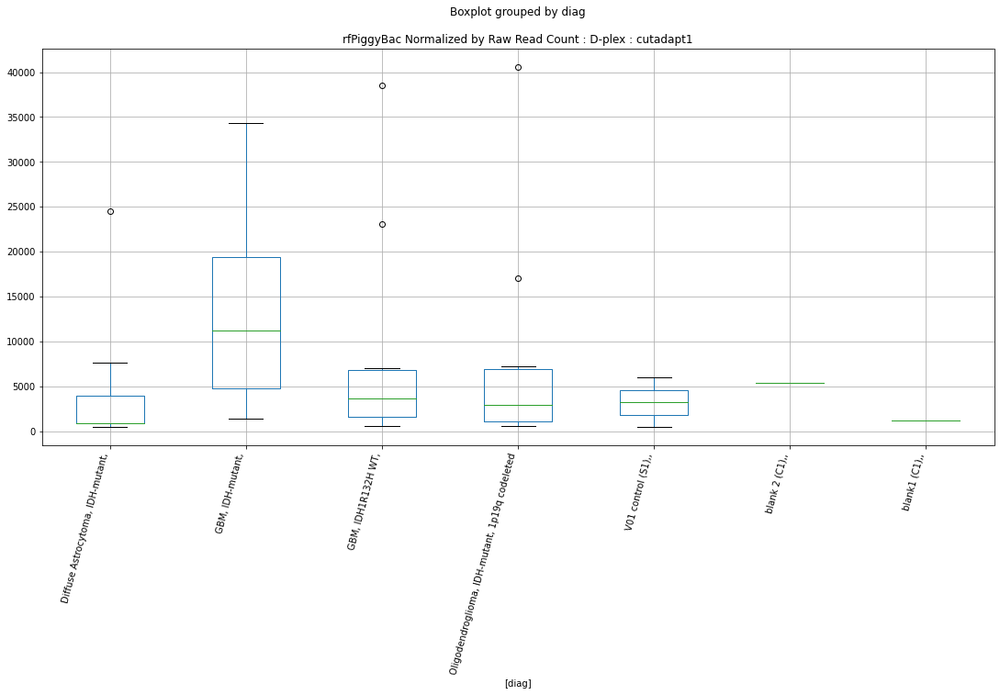

rfPiggyBac D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.259681157659422
	p = 0.036478345715979486
rfPiggyBac D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.259681157659422
	p = 0.036478345715979486


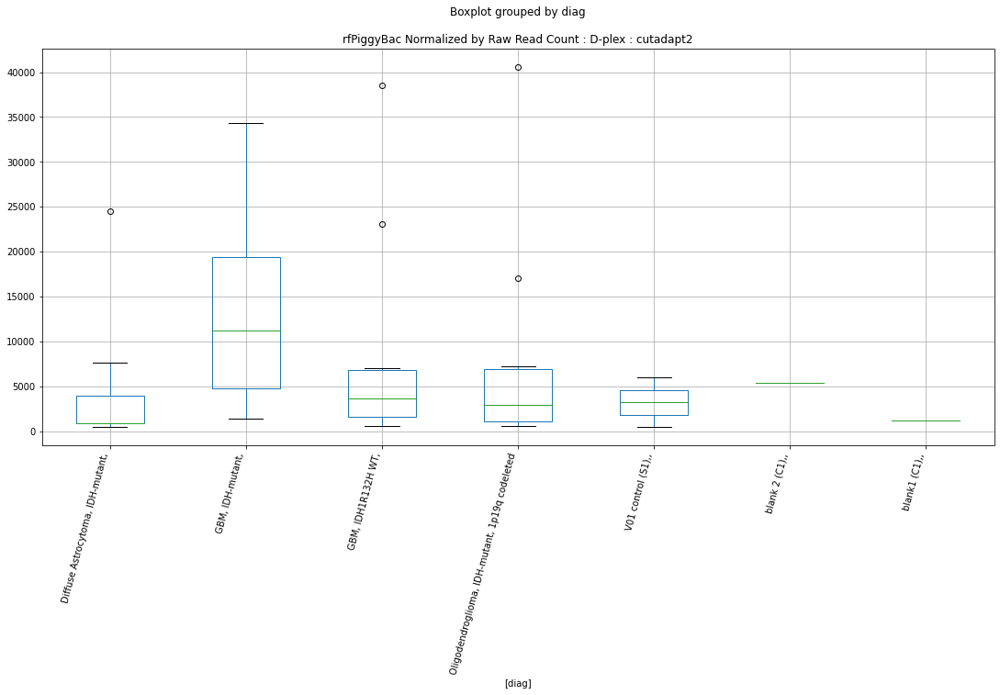

rfPiggyBac D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.259681157659422
	p = 0.036478345715979486
rfPiggyBac D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.259681157659422
	p = 0.036478345715979486


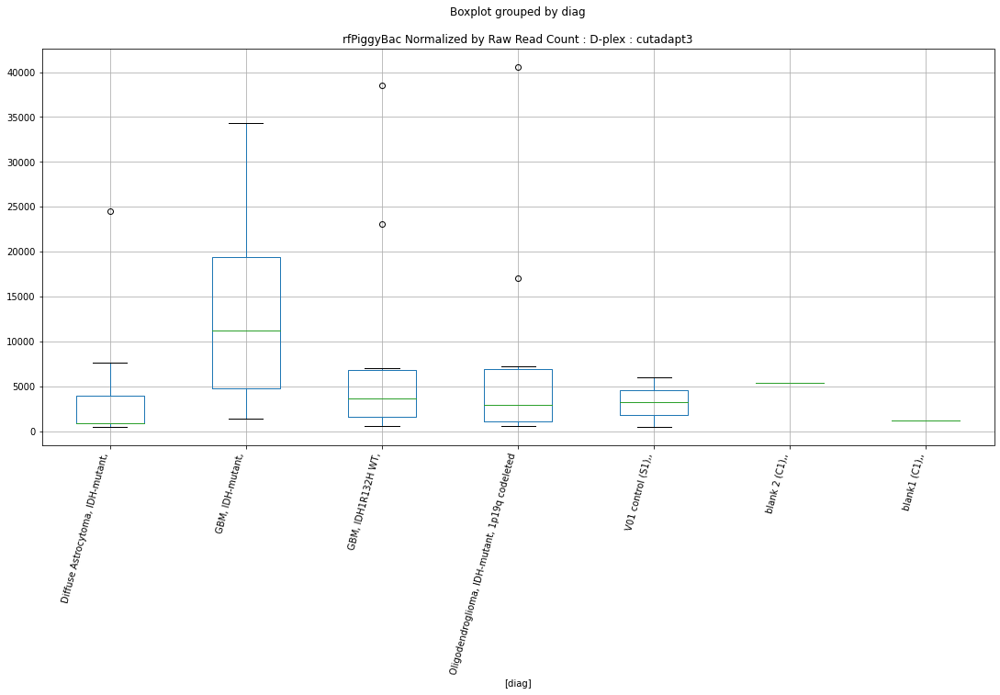

rfhAT-Ac D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7833646900858962
	p = 0.0913977945975764
rfhAT-Ac D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7833646900858962
	p = 0.0913977945975764


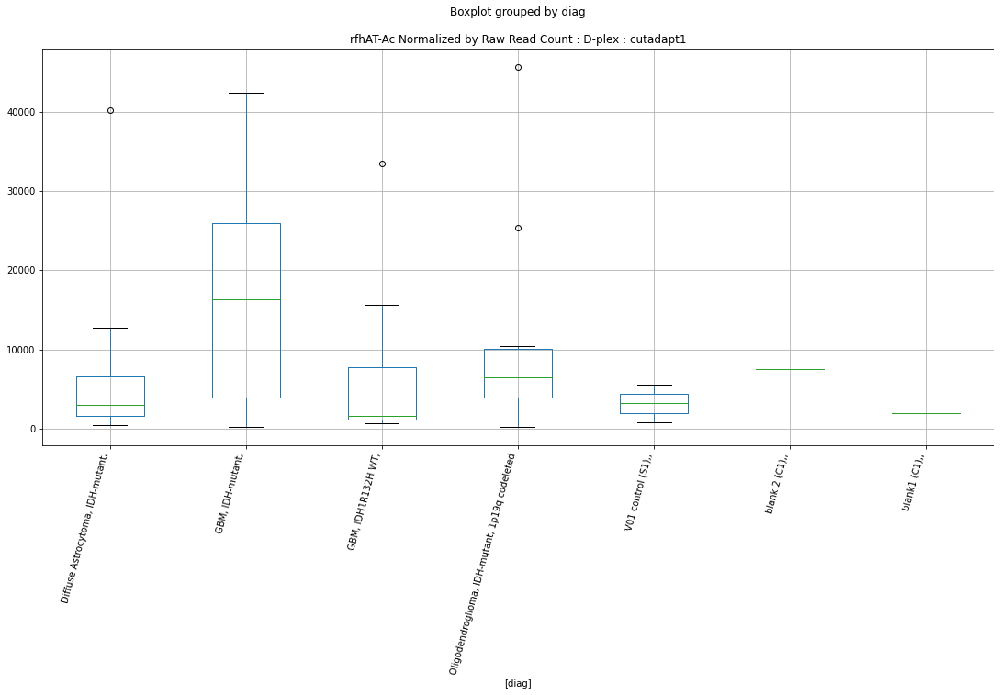

rfhAT-Ac D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7833646900858962
	p = 0.0913977945975764
rfhAT-Ac D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7833646900858962
	p = 0.0913977945975764


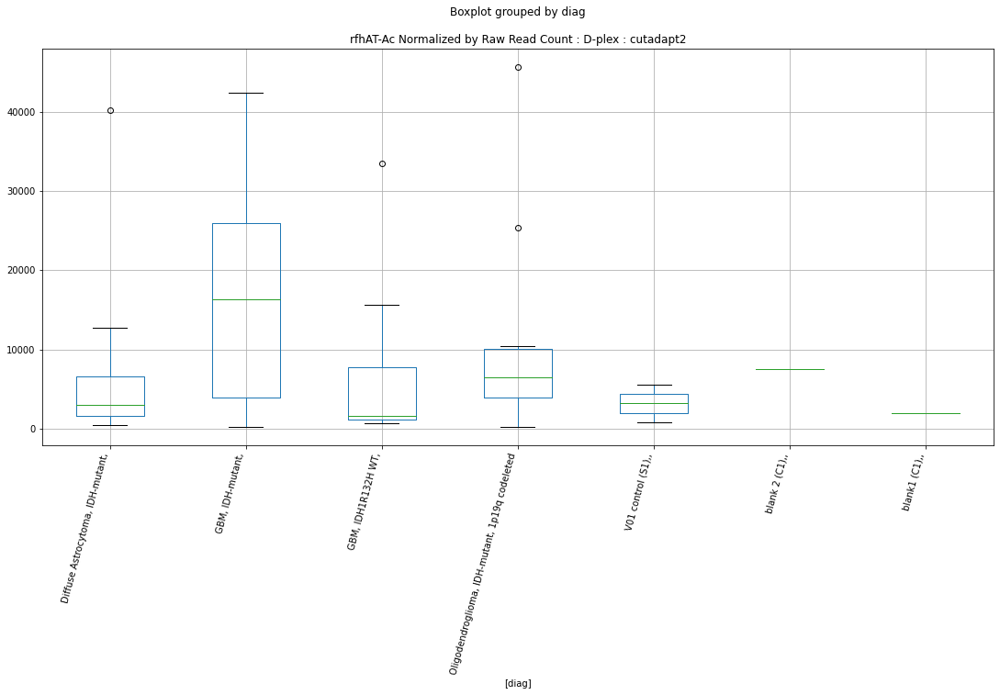

rfhAT-Ac D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7833646900858962
	p = 0.0913977945975764
rfhAT-Ac D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7833646900858962
	p = 0.0913977945975764


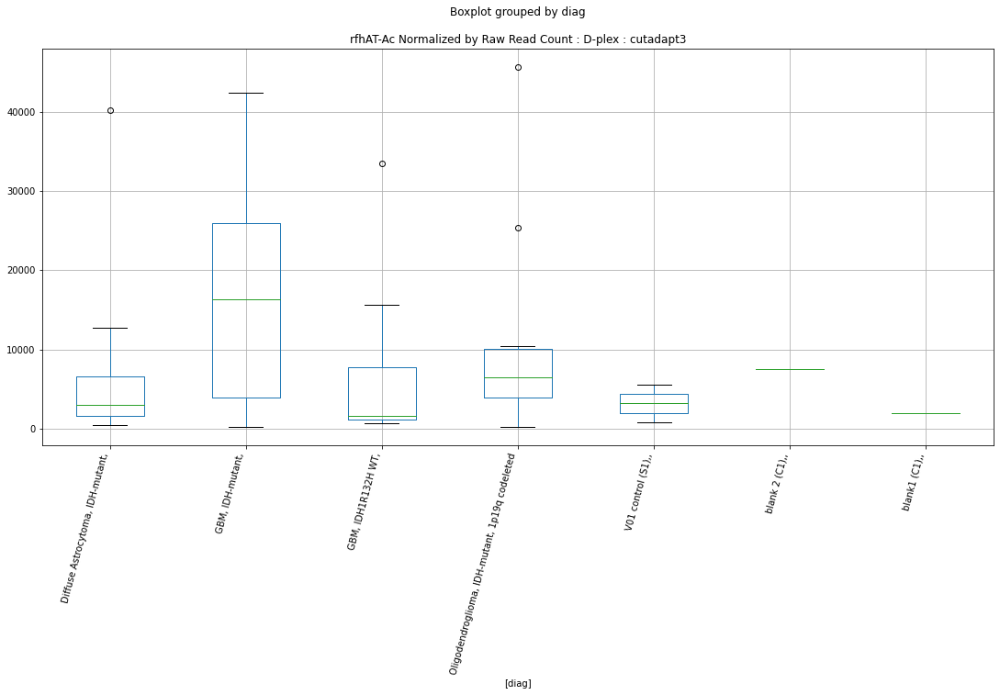

rfERVL? D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.398998444007886
	p = 0.027483303178658224
rfERVL? D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2035681984473885
	p = 0.040817235100445735
rfERVL? D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.398998444007886
	p = 0.027483303178658224
rfERVL? D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2035681984473885
	p = 0.040817235100445735


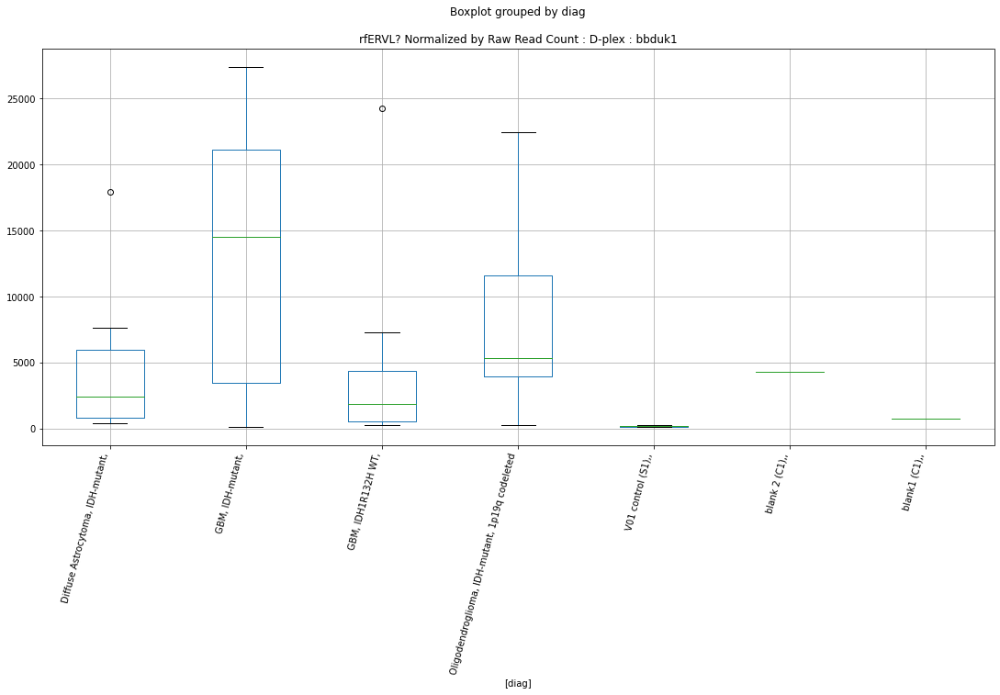

rfERVL? D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9000162355568364
	p = 0.07357214255717086
rfERVL? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0367142923057795
	p = 0.05666169328314584
rfERVL? D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9000162355568364
	p = 0.07357214255717086
rfERVL? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0367142923057795
	p = 0.05666169328314584


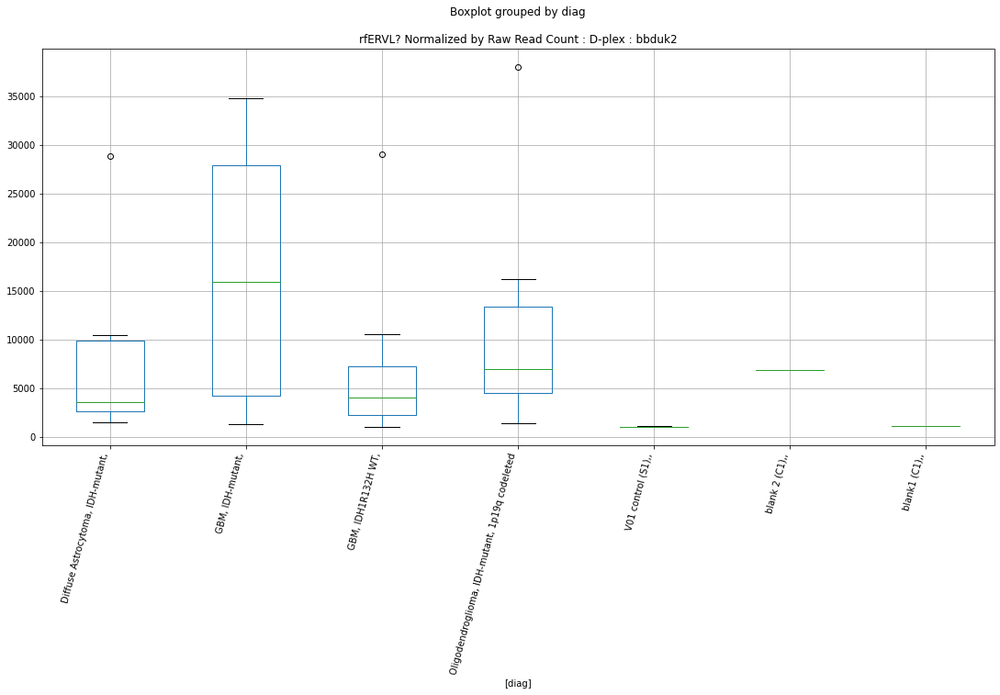

rfERVL? D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8495336555856279
	p = 0.0808707457063615
rfERVL? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.009963805270885
	p = 0.05966622057923111
rfERVL? D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8495336555856279
	p = 0.0808707457063615
rfERVL? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.009963805270885
	p = 0.05966622057923111


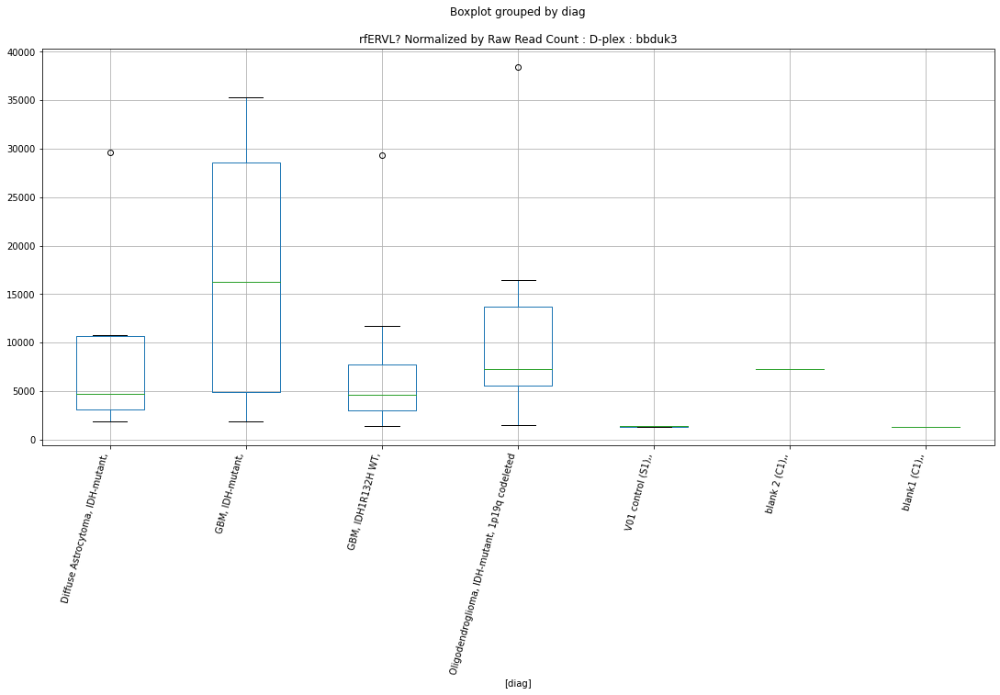

rfERVL? D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.080859053745361
	p = 0.05200102149251931
rfERVL? D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.080859053745361
	p = 0.05200102149251931


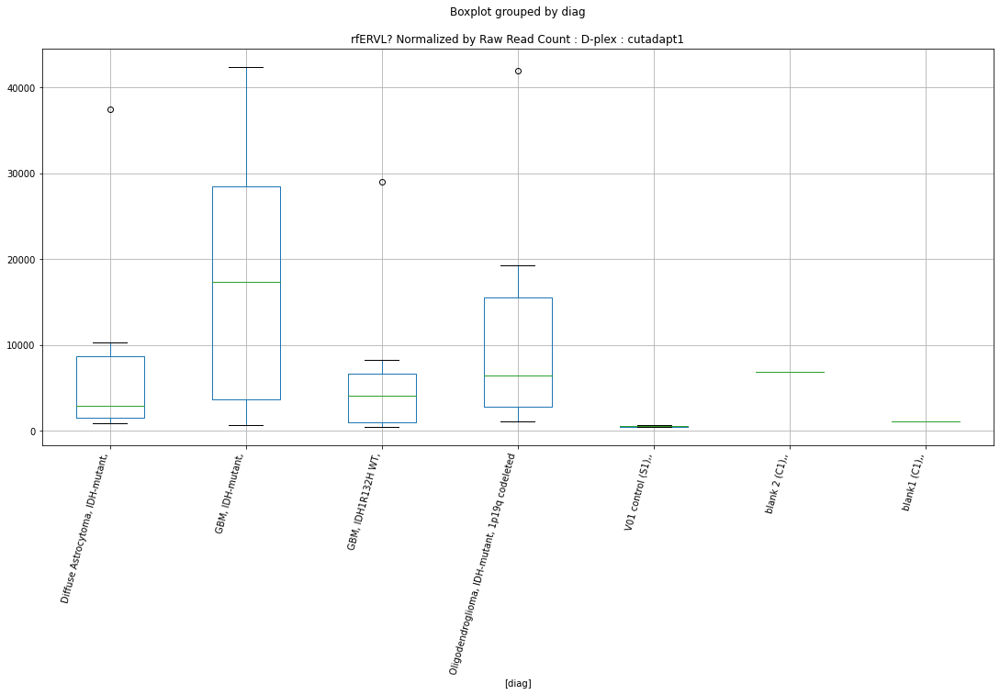

rfERVL? D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.080859053745361
	p = 0.05200102149251931
rfERVL? D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.080859053745361
	p = 0.05200102149251931


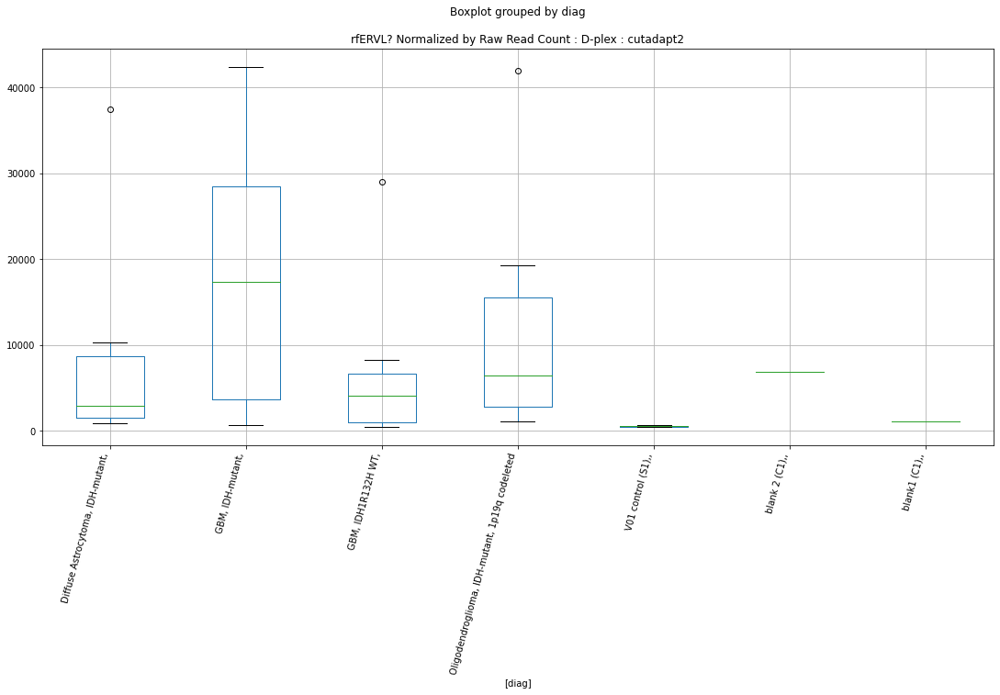

rfERVL? D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.080859053745361
	p = 0.05200102149251931
rfERVL? D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.080859053745361
	p = 0.05200102149251931


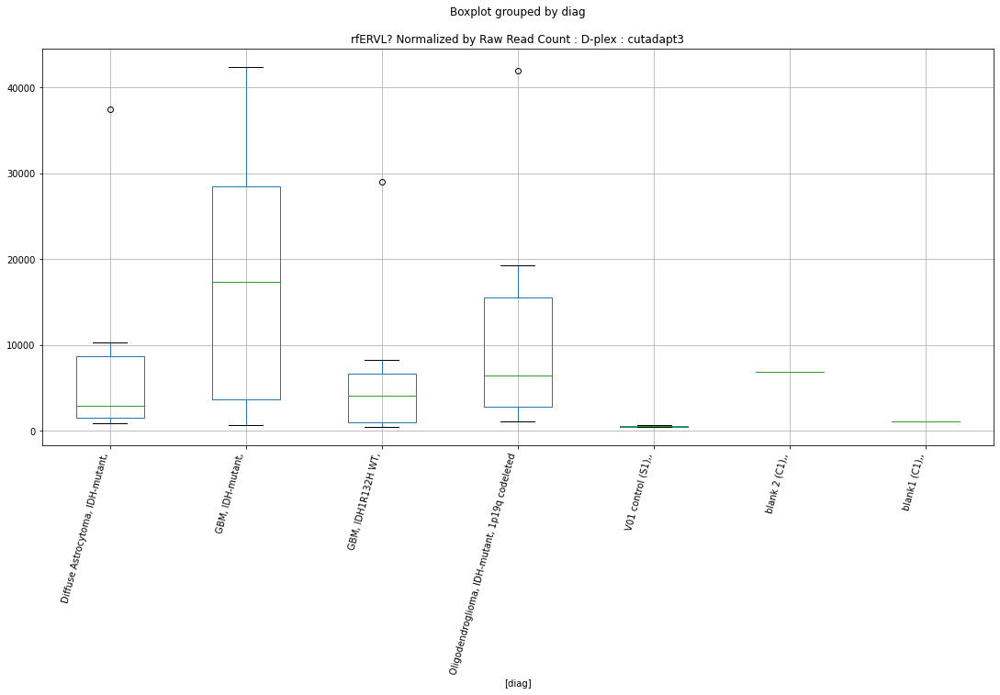

rfhAT-Tip100? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.8084031108291767
	p = 0.011625419402765985
rfhAT-Tip100? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.8084031108291767
	p = 0.011625419402765985


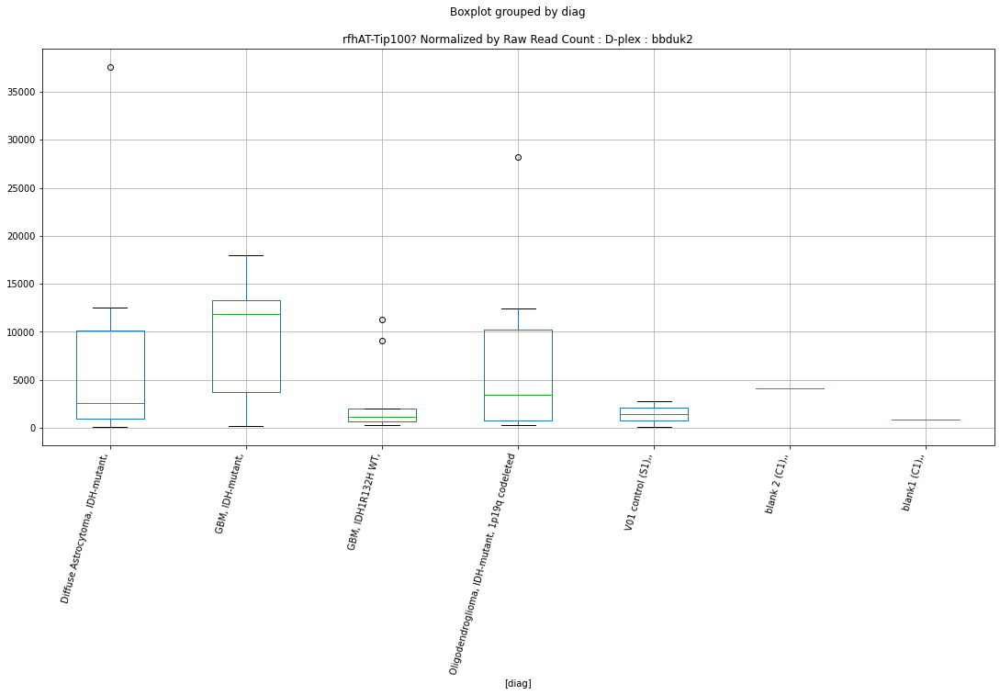

rfhAT-Tip100? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.8042826900015876
	p = 0.011728574359409251
rfhAT-Tip100? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.8042826900015876
	p = 0.011728574359409251


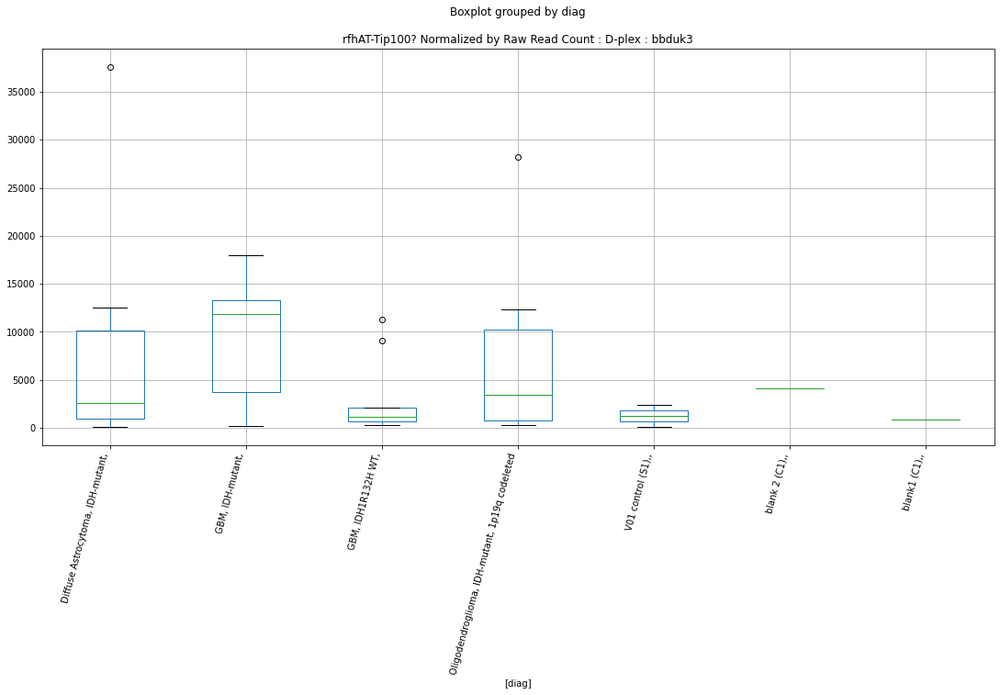

rfhAT-Tip100? D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.458424261132664
	p = 0.02431634265360245
rfhAT-Tip100? D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.458424261132664
	p = 0.02431634265360245


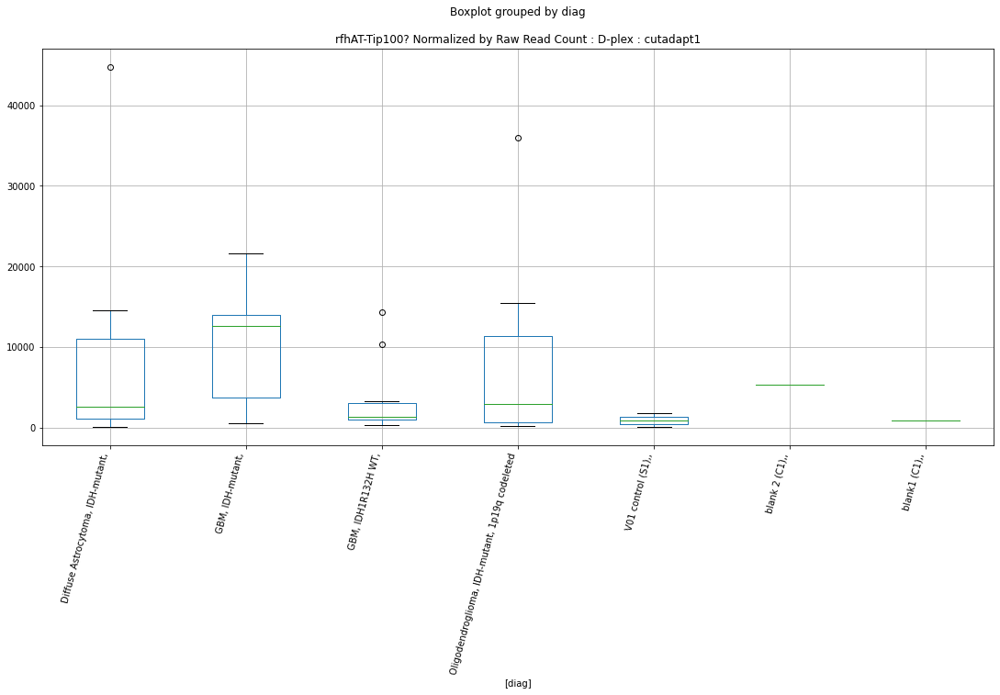

rfhAT-Tip100? D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.458424261132664
	p = 0.02431634265360245
rfhAT-Tip100? D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.458424261132664
	p = 0.02431634265360245


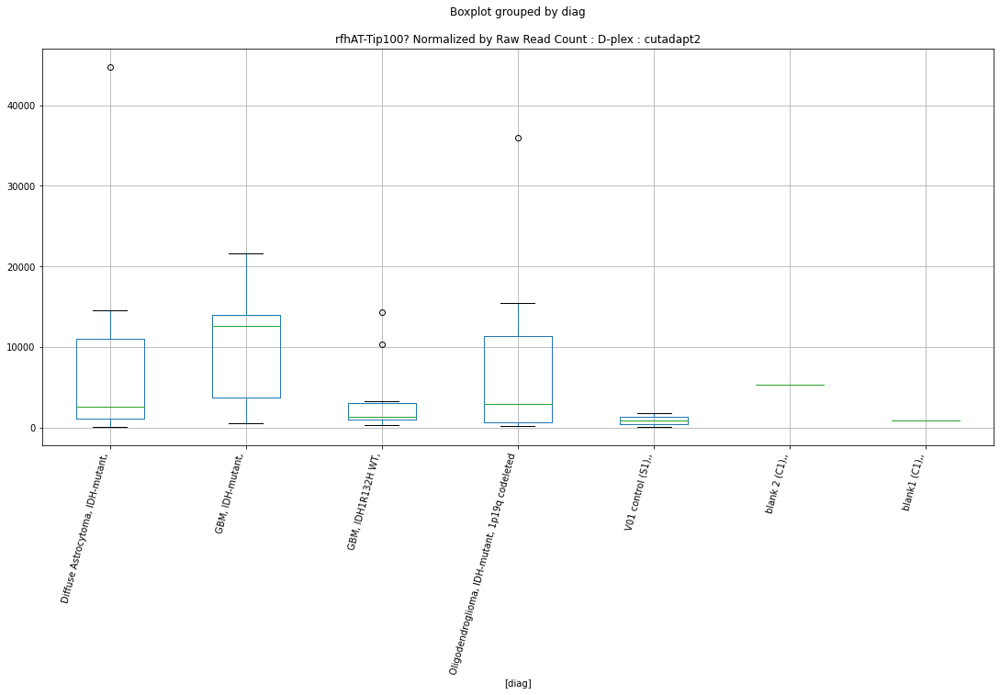

rfhAT-Tip100? D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.458424261132664
	p = 0.02431634265360245
rfhAT-Tip100? D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.458424261132664
	p = 0.02431634265360245


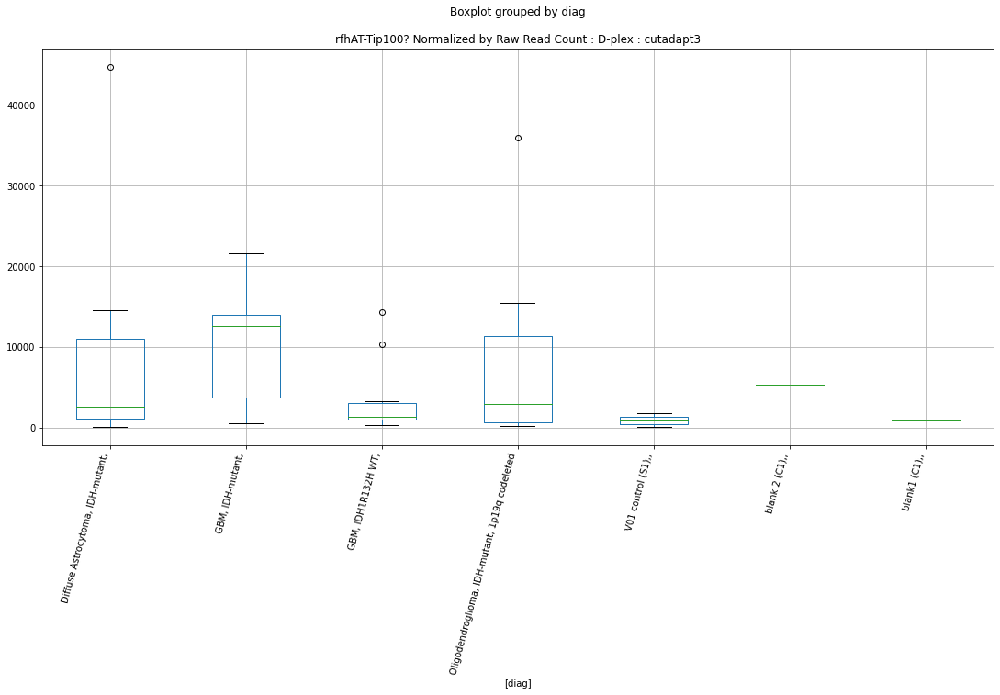

rfERV1? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.745758117259068
	p = 0.09789842299470924
rfERV1? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.745758117259068
	p = 0.09789842299470924


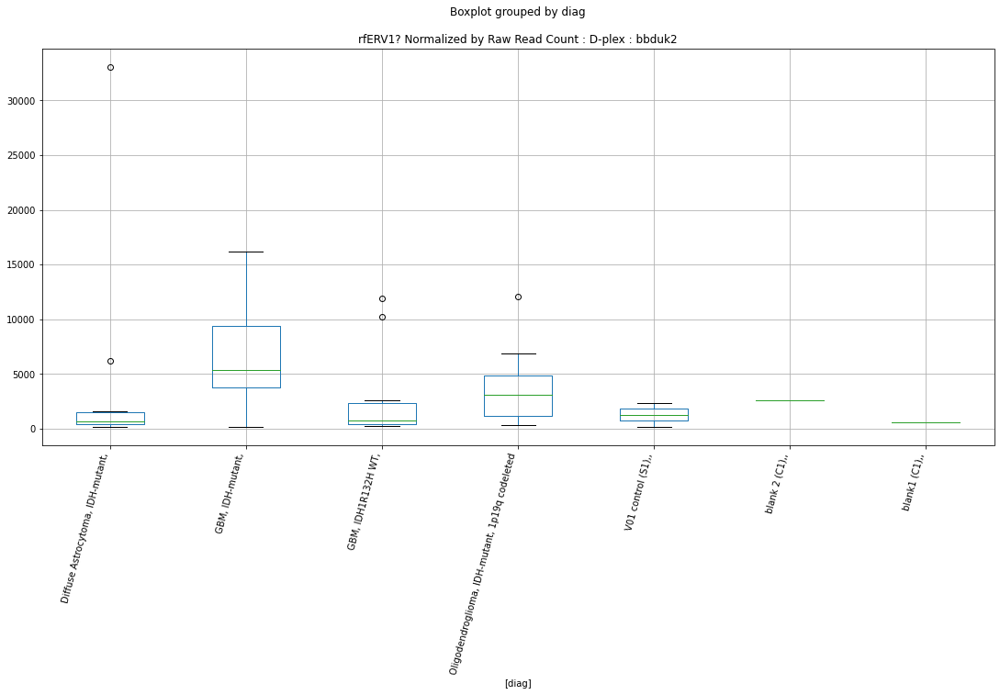

In [63]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmskfamilies:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count : "+labkit+" : "+trimmer)
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


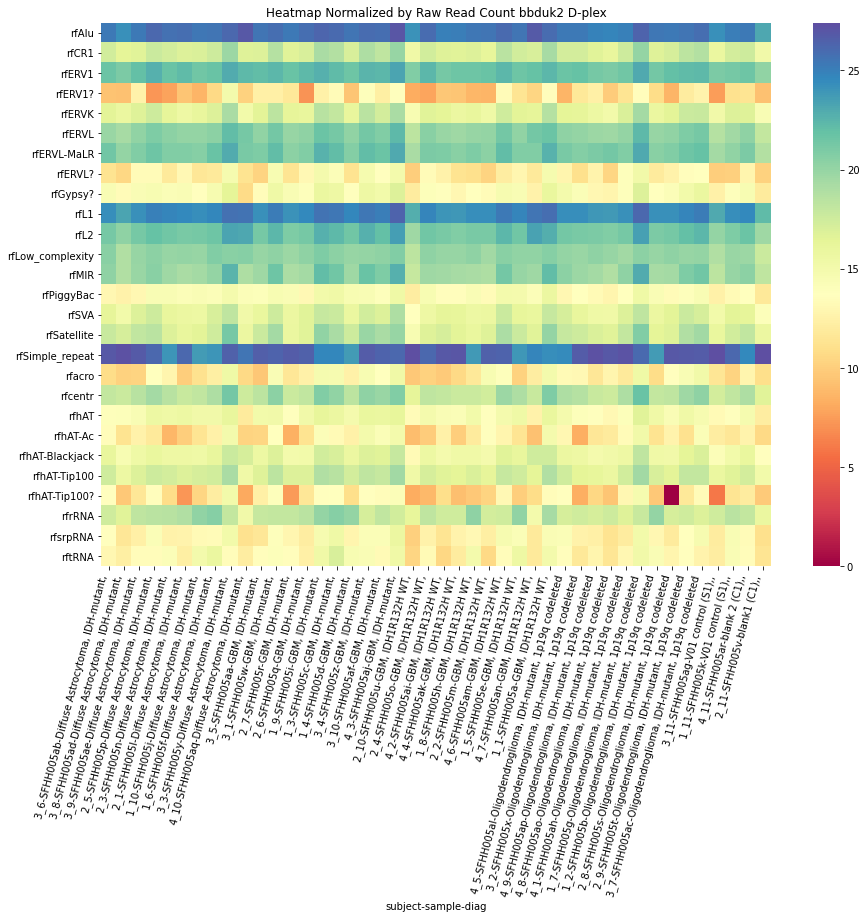

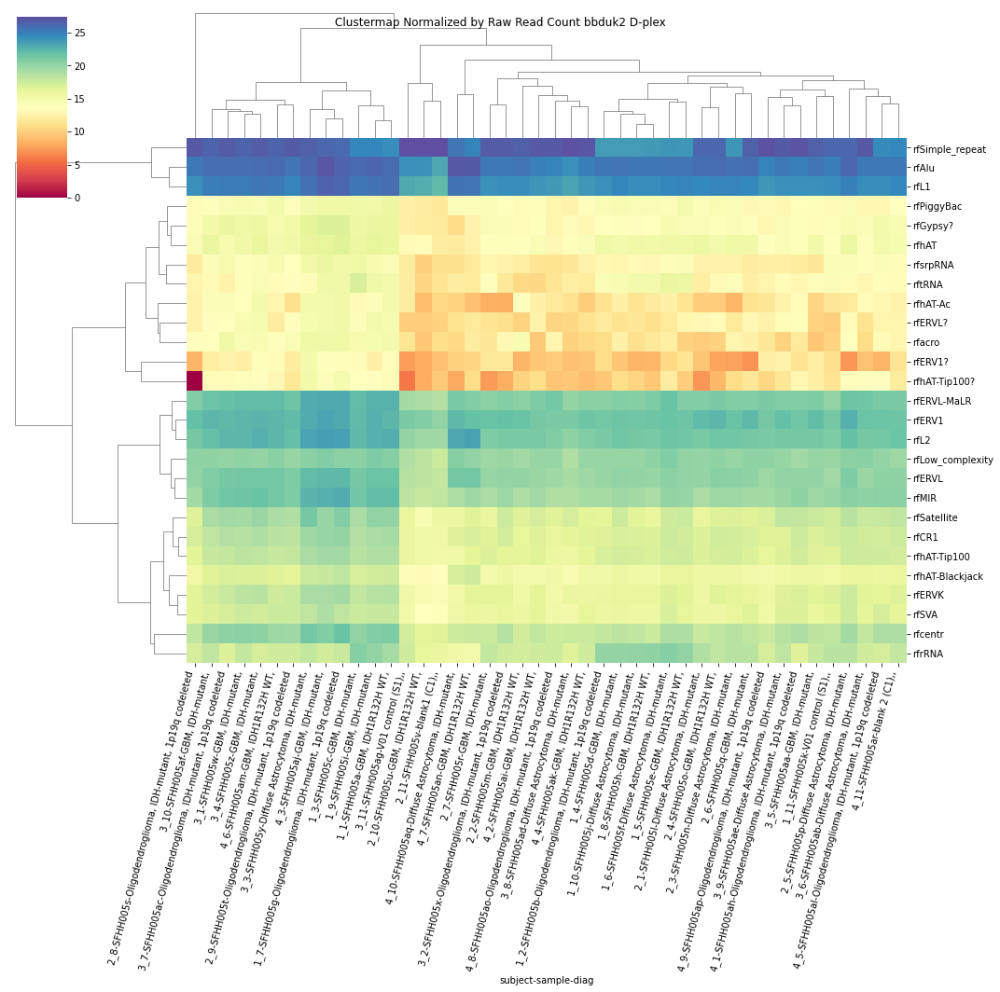

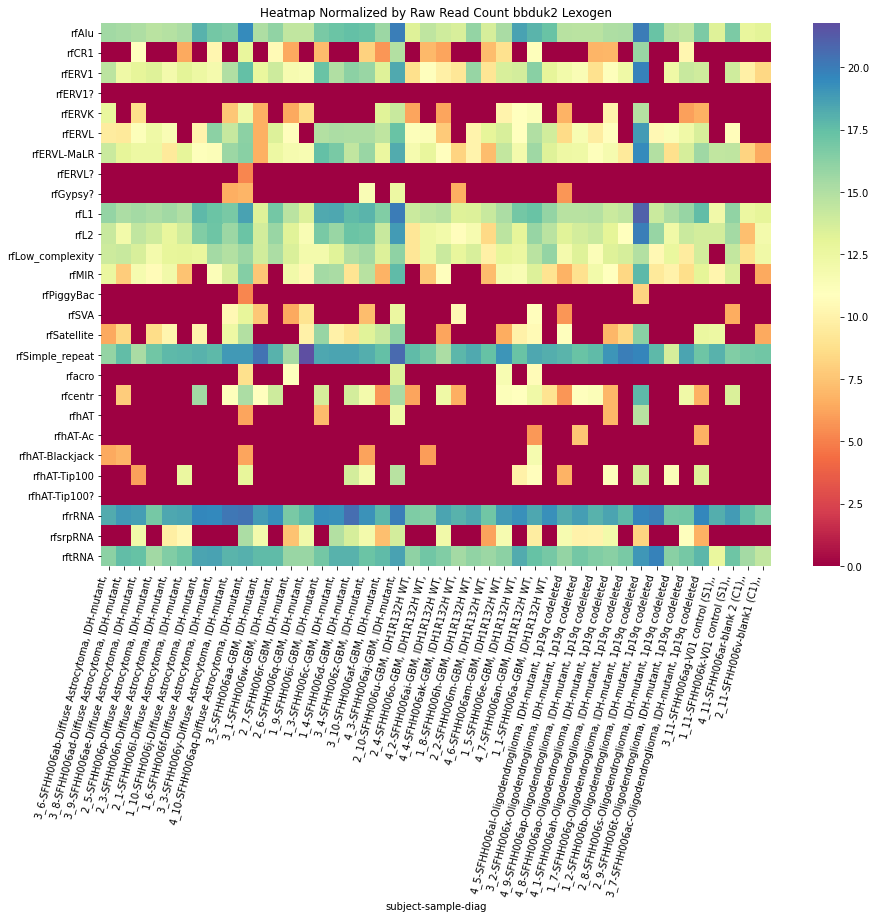

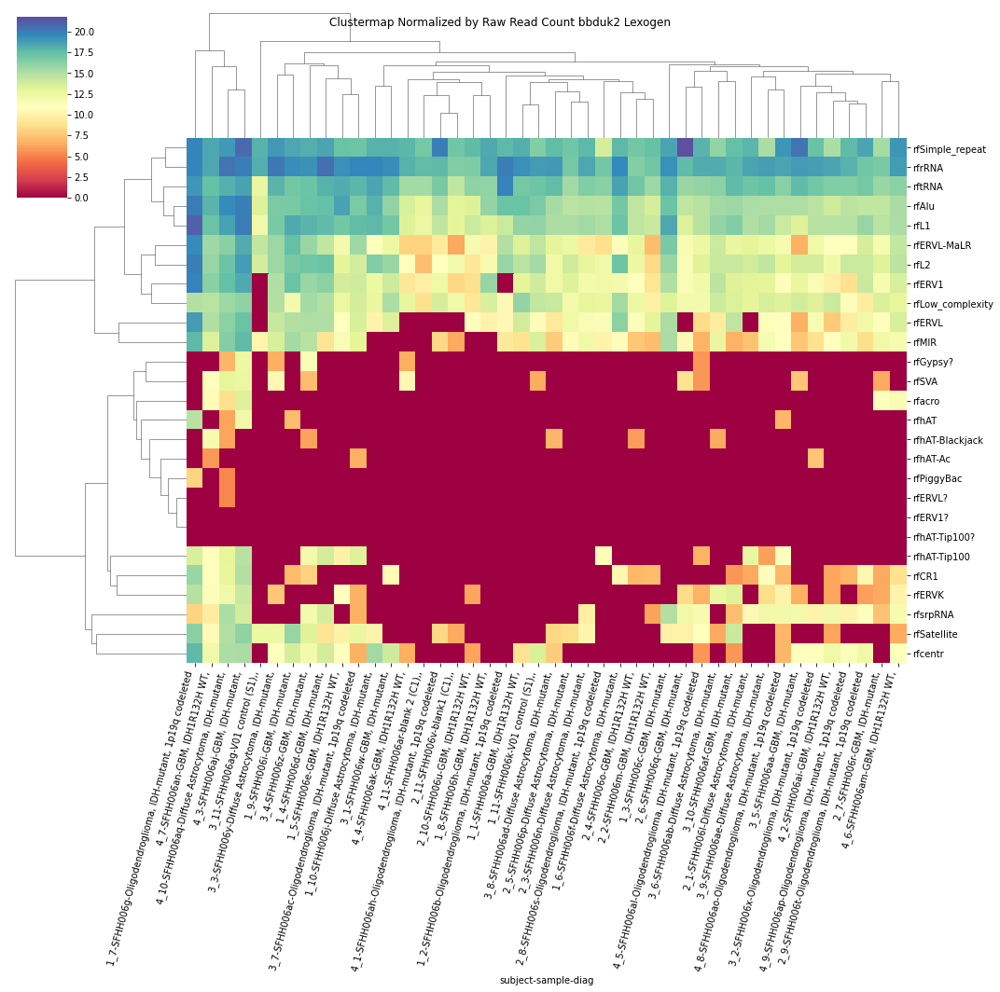

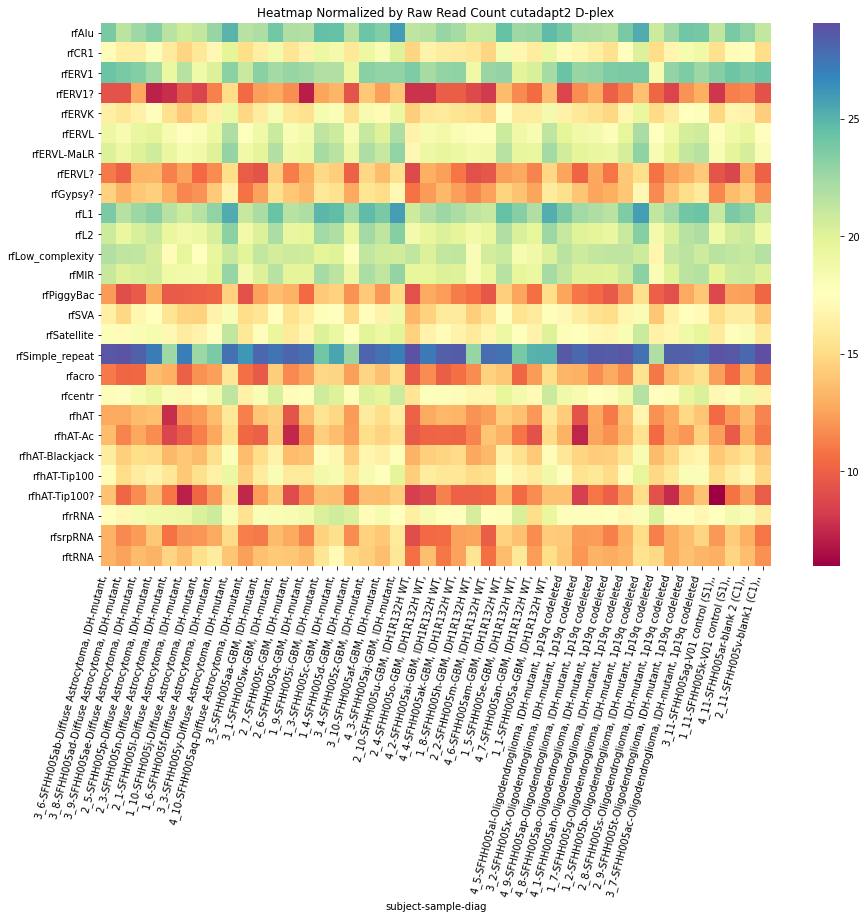

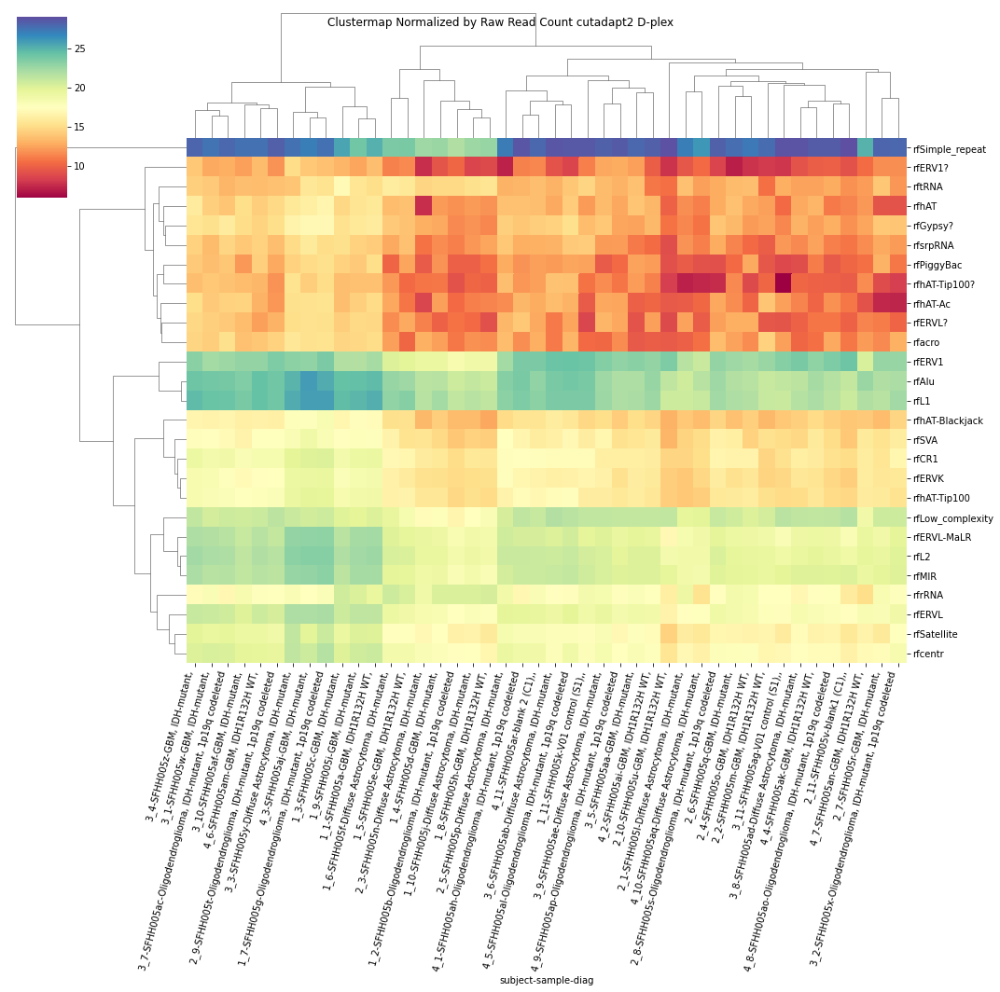

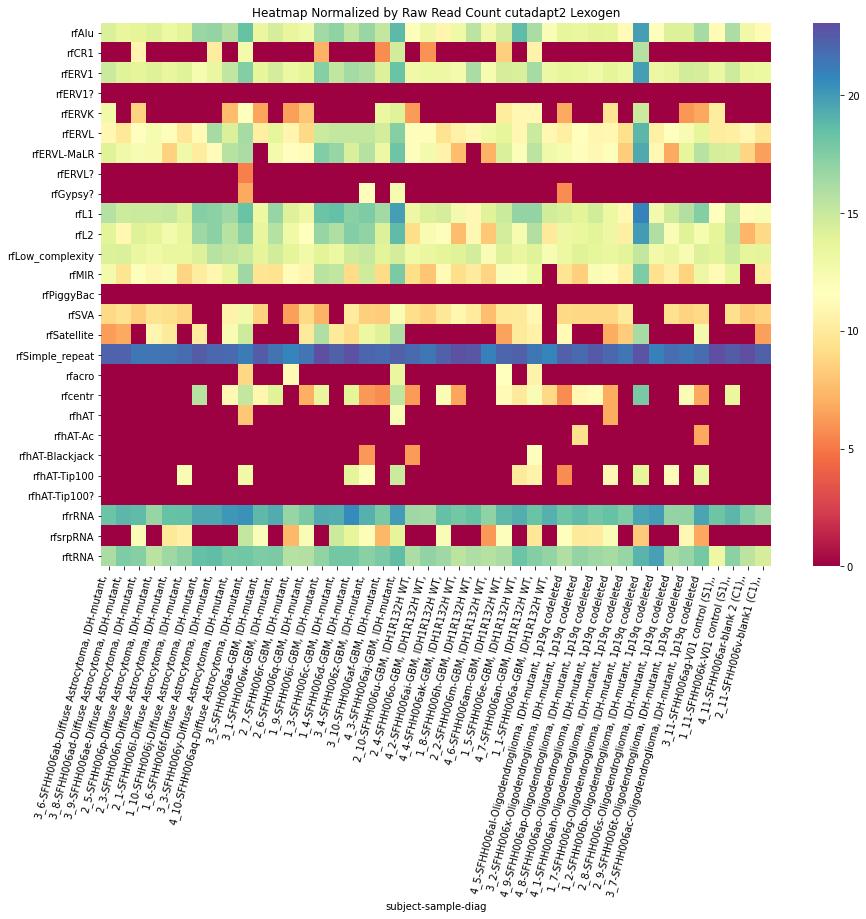

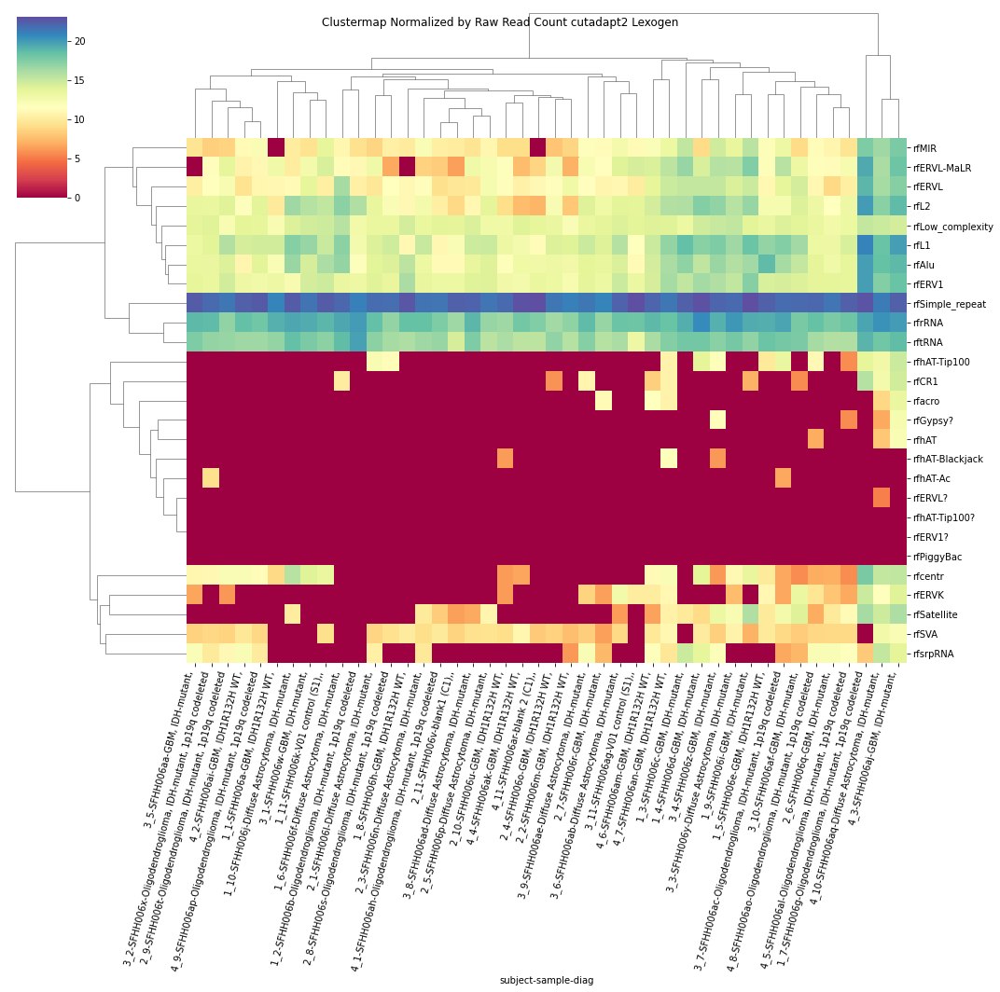

In [64]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap Normalized by Raw Read Count "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap Normalized by Raw Read Count "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rcSimple_repeat D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.572218965727758
	p = 0.01918627083843878
rcSimple_repeat D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8301663533213575
	p = 0.08383582316110644
rcSimple_repeat D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.572218965727758
	p = 0.01918627083843878
rcSimple_repeat D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8301663533213575
	p = 0.08383582316110644


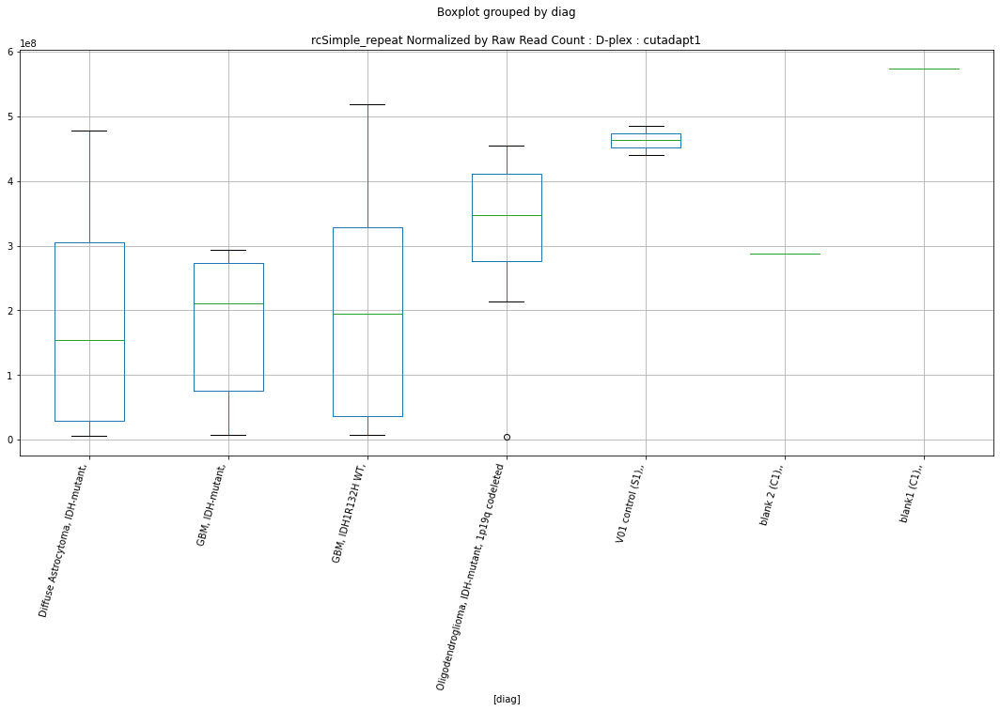

rcSimple_repeat D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.574614935577638
	p = 0.019090147103099513
rcSimple_repeat D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8314915217413985
	p = 0.08362994156037709
rcSimple_repeat D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.574614935577638
	p = 0.019090147103099513
rcSimple_repeat D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8314915217413985
	p = 0.08362994156037709


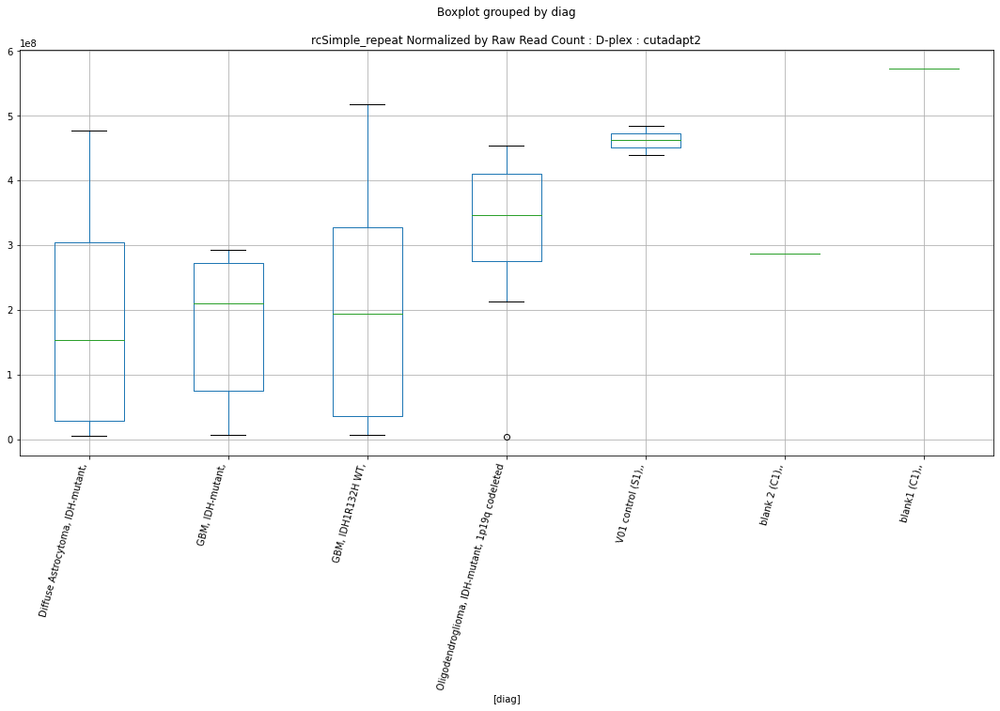

rcSimple_repeat D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.574506864984838
	p = 0.01909447293651817
rcSimple_repeat D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8313927122583495
	p = 0.08364527752594555
rcSimple_repeat D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.574506864984838
	p = 0.01909447293651817
rcSimple_repeat D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8313927122583495
	p = 0.08364527752594555


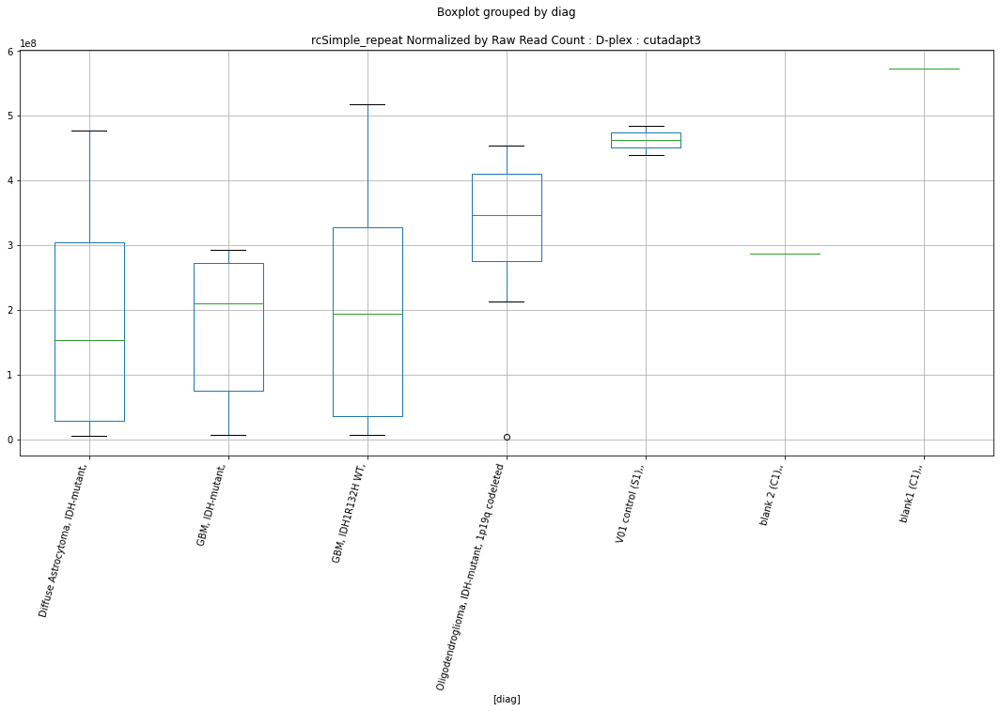

rcSimple_repeat Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8070078328324408
	p = 0.08750626534658655
rcSimple_repeat Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8070078328324408
	p = 0.08750626534658655


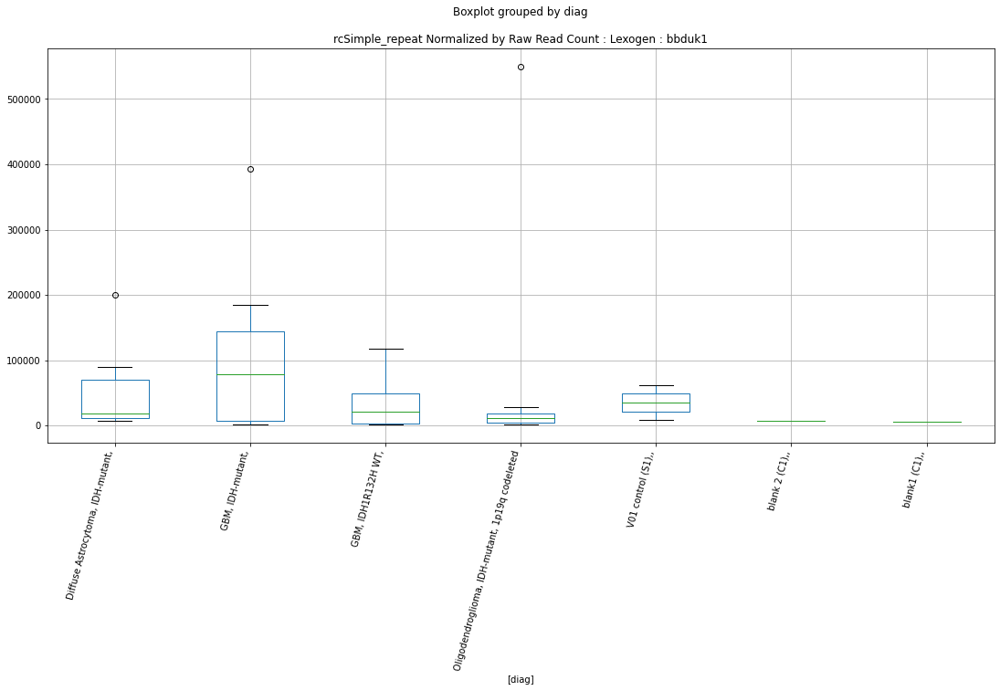

rcSimple_repeat Lexogen bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7431703998984291
	p = 0.09836012729963921
rcSimple_repeat Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7431703998984291
	p = 0.09836012729963921


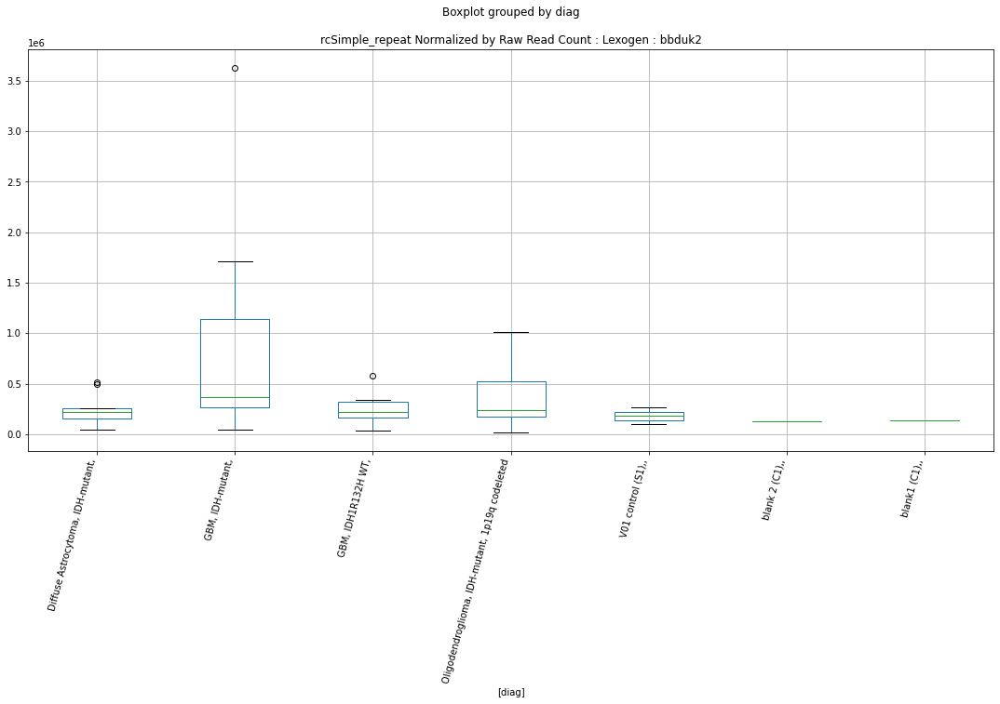

rcSINE D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0409393441881347
	p = 0.05619983011226797
rcSINE D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0409393441881347
	p = 0.05619983011226797


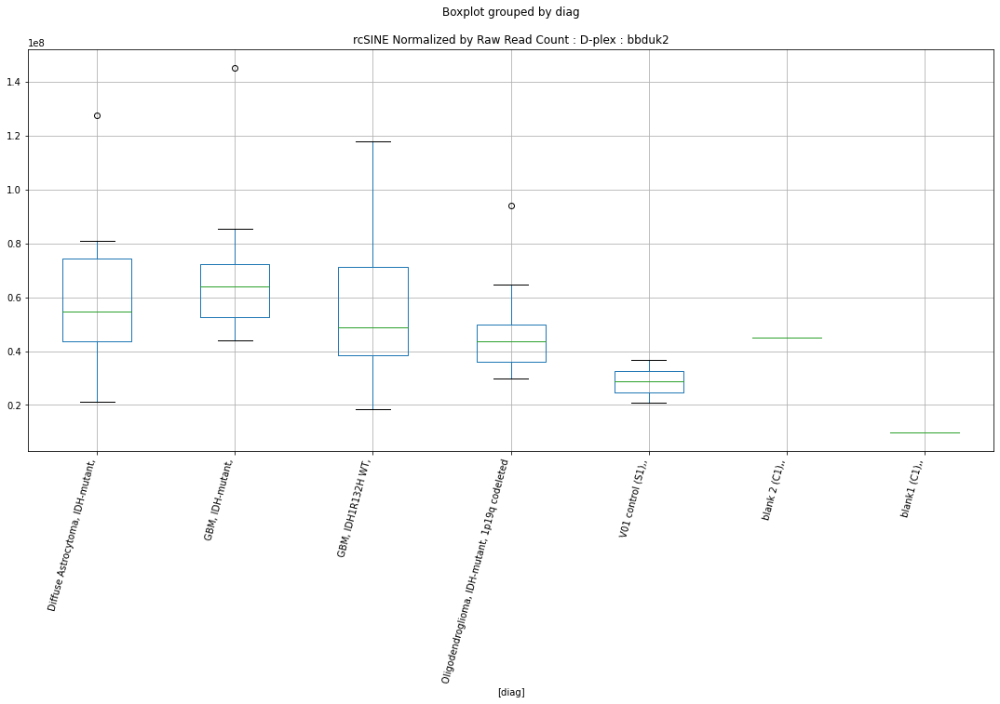

rcSINE D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1153008263276356
	p = 0.04860923023814011
rcSINE D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1153008263276356
	p = 0.04860923023814011


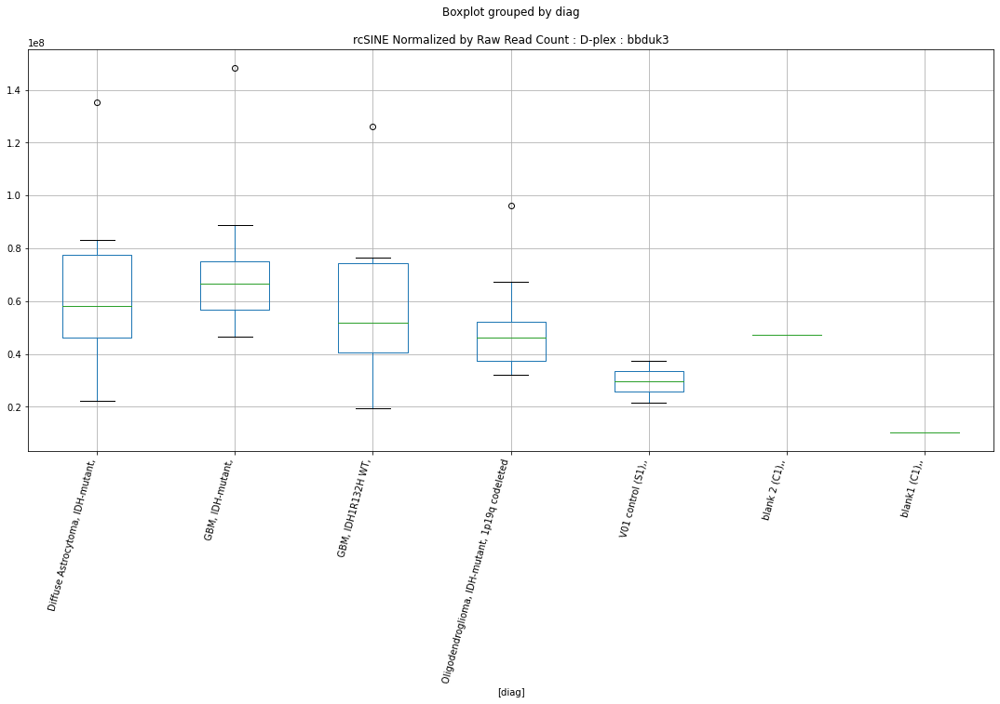

rcLINE Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9335185586729597
	p = 0.0690567039095977
rcLINE Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9335185586729597
	p = 0.0690567039095977


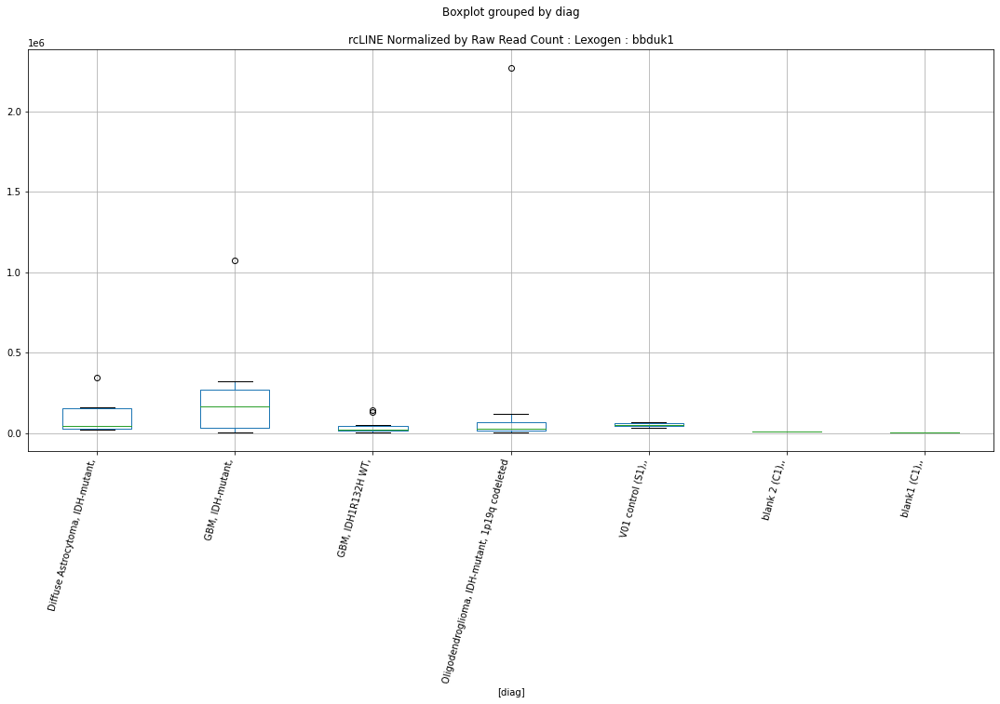

rcLINE Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9890122478645662
	p = 0.062118693798259045
rcLINE Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7977816956692
	p = 0.08900726213943895
rcLINE Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9890122478645662
	p = 0.062118693798259045
rcLINE Lexogen bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7977816956692
	p = 0.08900726213943895


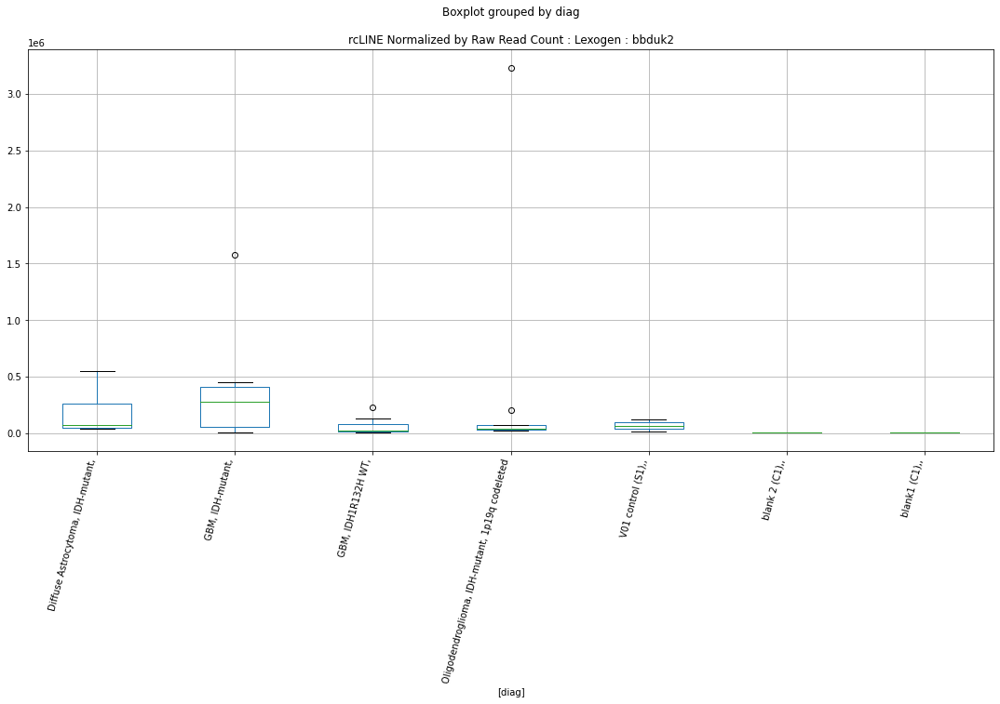

rcLINE Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9872009934702703
	p = 0.06233490044712986
rcLINE Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7939262944474084
	p = 0.08964113075905936
rcLINE Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9872009934702703
	p = 0.06233490044712986
rcLINE Lexogen bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7939262944474084
	p = 0.08964113075905936


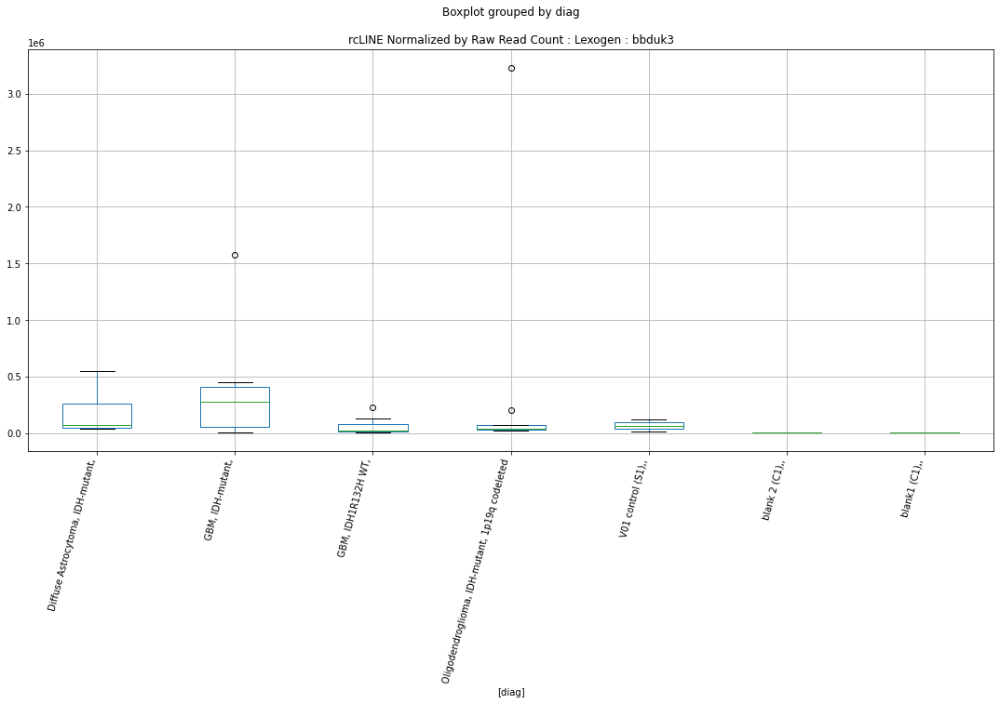

rcLINE Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0836250627316013
	p = 0.05172089626025977
rcLINE Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8844263381119468
	p = 0.07576125675789304
rcLINE Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0836250627316013
	p = 0.05172089626025977
rcLINE Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8844263381119468
	p = 0.07576125675789304


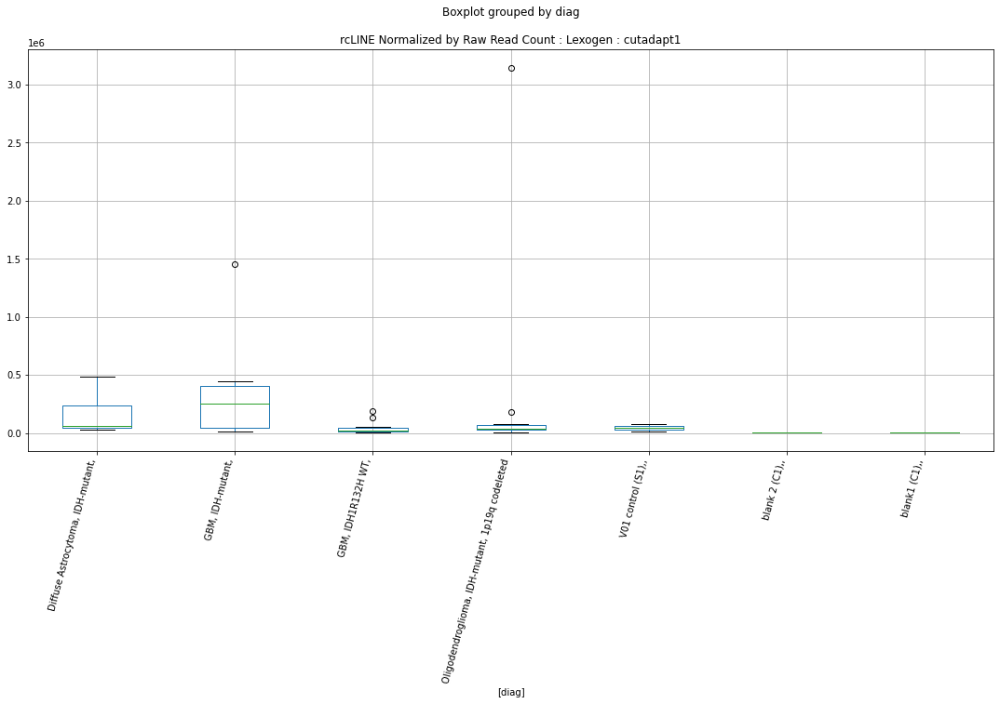

rcLINE Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0750176746905775
	p = 0.05259712793040834
rcLINE Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8521277554114388
	p = 0.08048068828900073
rcLINE Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0750176746905775
	p = 0.05259712793040834
rcLINE Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8521277554114388
	p = 0.08048068828900073


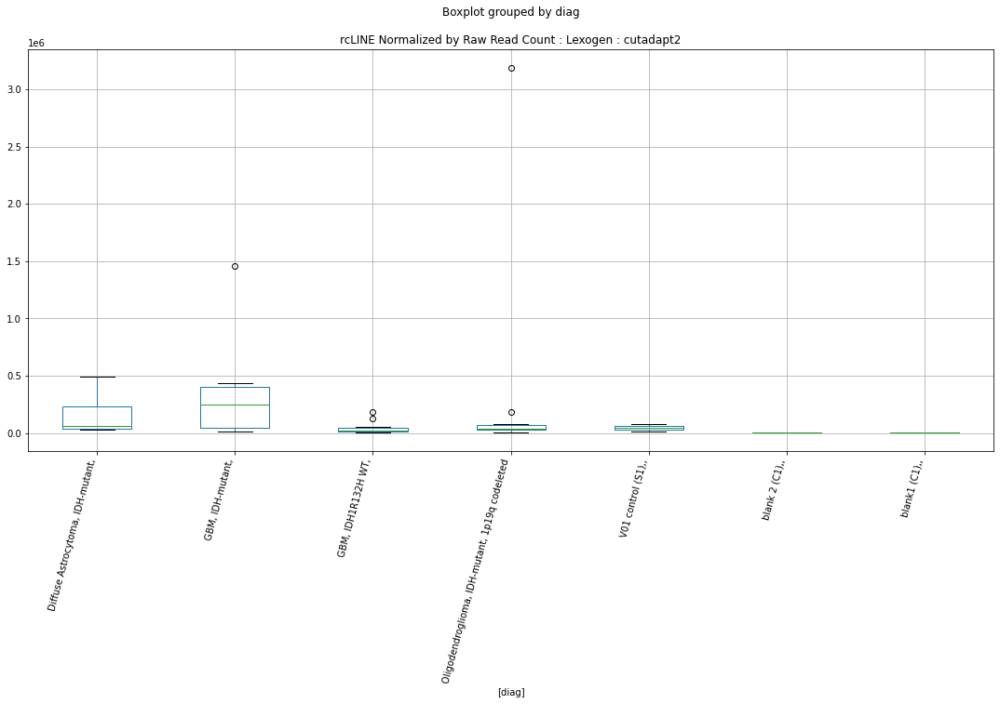

rcLINE Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0753564367952126
	p = 0.052562389151118924
rcLINE Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8737527666907938
	p = 0.07729308010195397
rcLINE Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0753564367952126
	p = 0.052562389151118924
rcLINE Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8737527666907938
	p = 0.07729308010195397


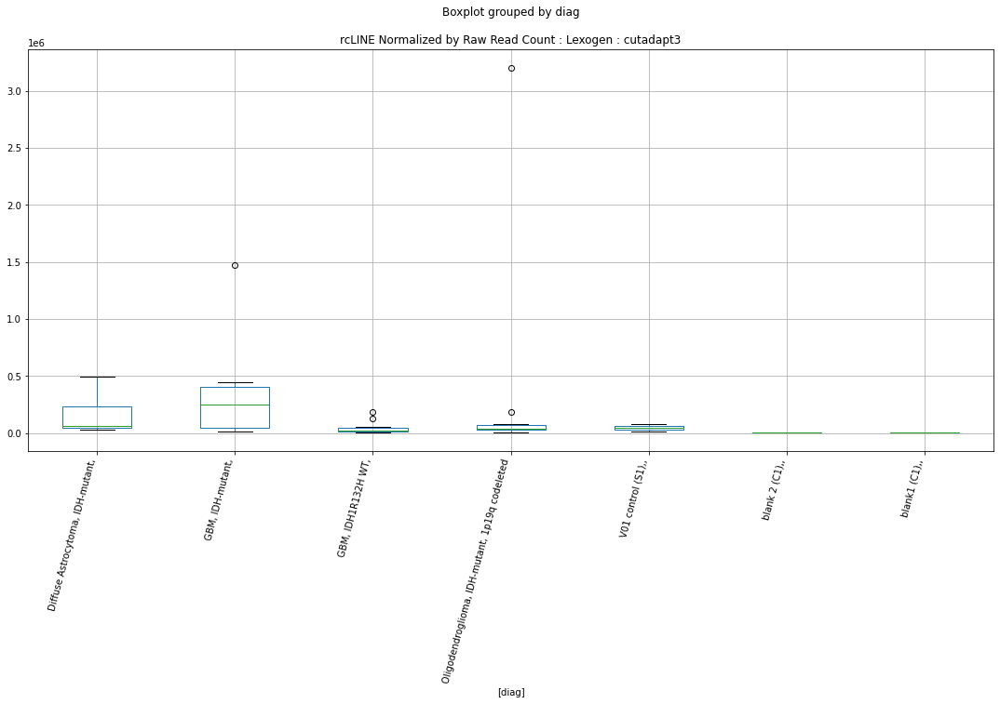

rcLTR D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8416574036845006
	p = 0.08206526071289945
rcLTR D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8416574036845006
	p = 0.08206526071289945


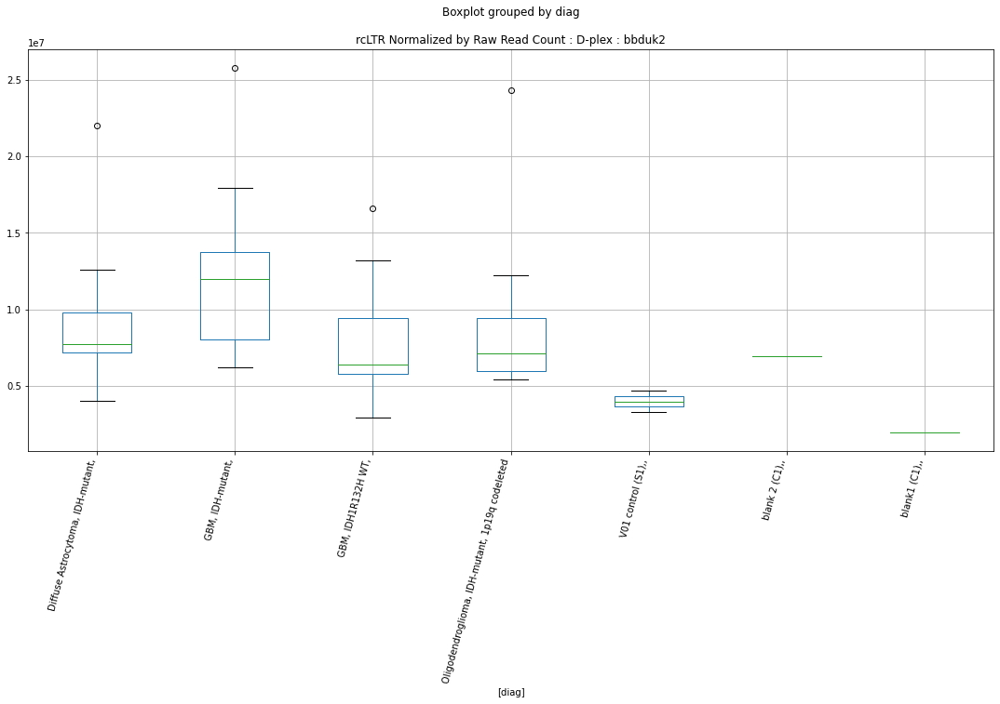

rcLTR D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8387085708231041
	p = 0.08251645851286404
rcLTR D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8387085708231041
	p = 0.08251645851286404


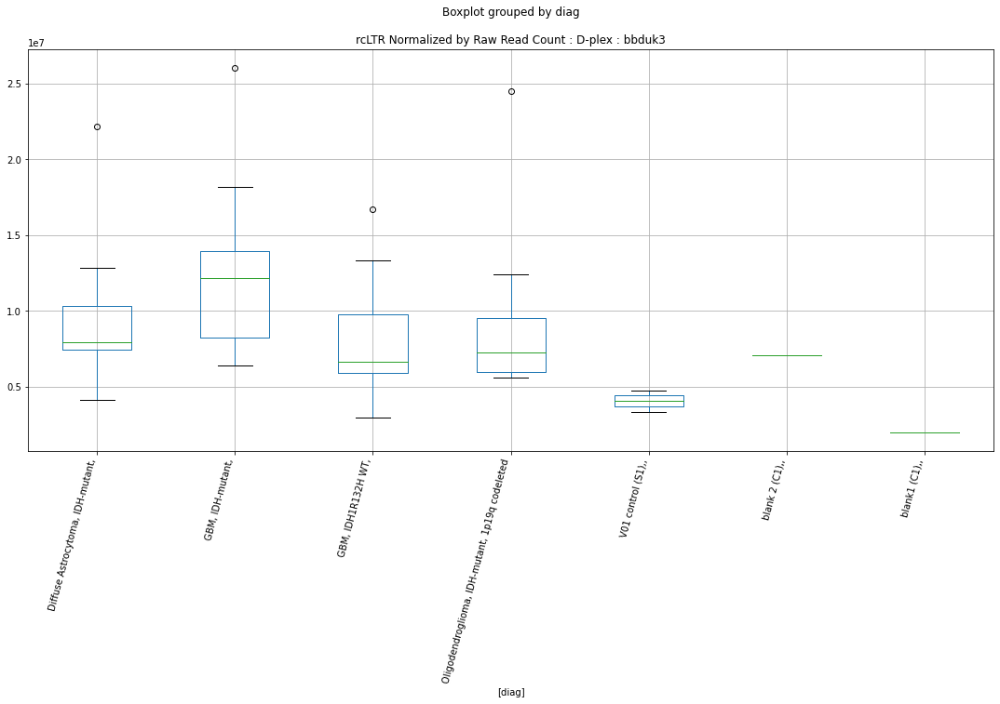

rcLTR D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.1085753294915373
	p = 0.04925530403075422
rcLTR D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1085753294915373
	p = 0.04925530403075422


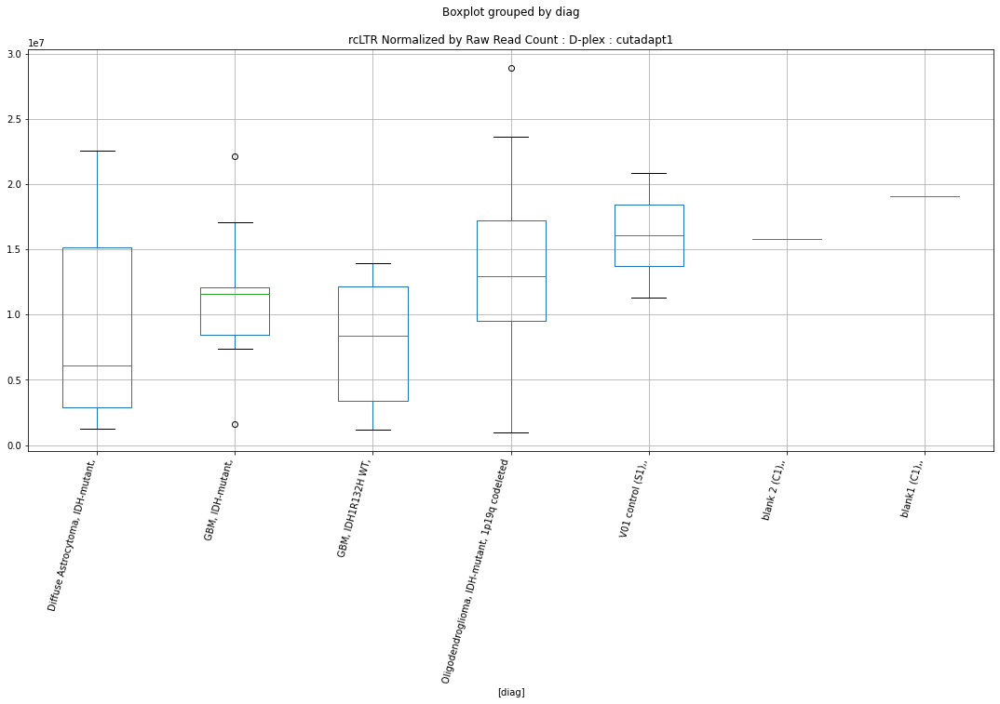

rcLTR D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.1087127209738643
	p = 0.04924202794622569
rcLTR D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1087127209738643
	p = 0.04924202794622569


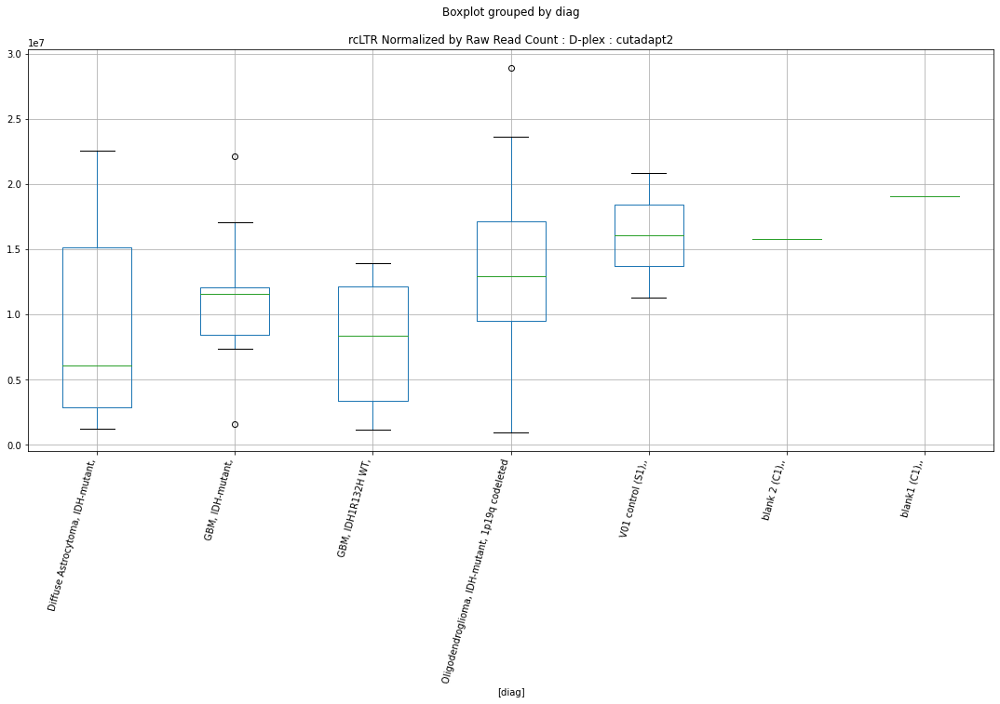

rcLTR D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.1087746798783327
	p = 0.04923604194690586
rcLTR D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1087746798783327
	p = 0.04923604194690586


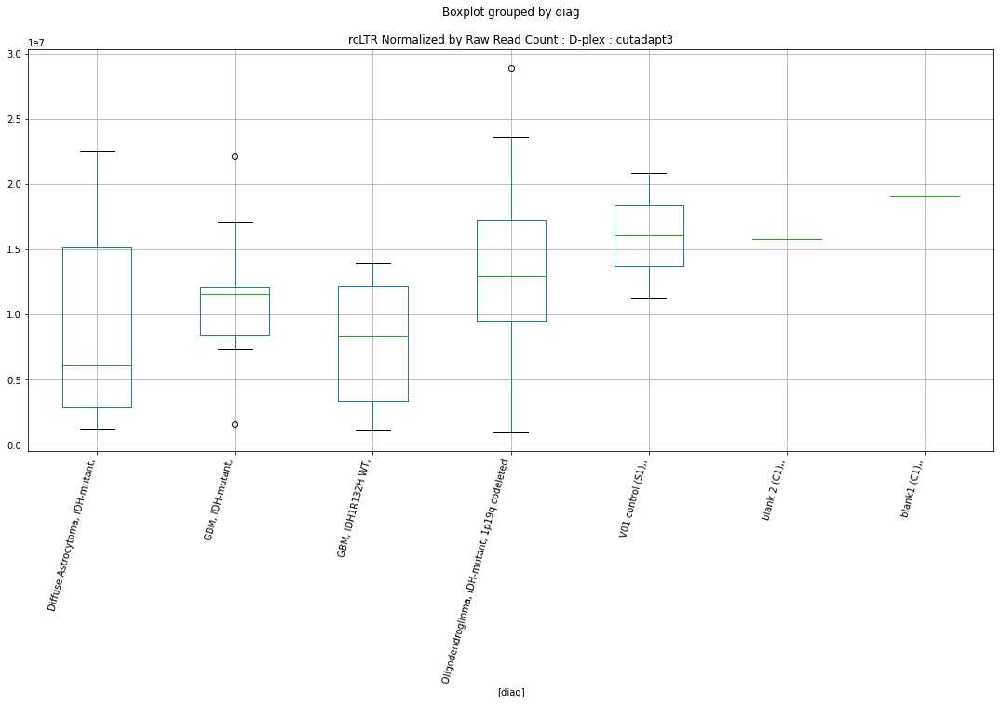

rcLTR Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8163796138201425
	p = 0.08600429337081167
rcLTR Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8163796138201425
	p = 0.08600429337081167


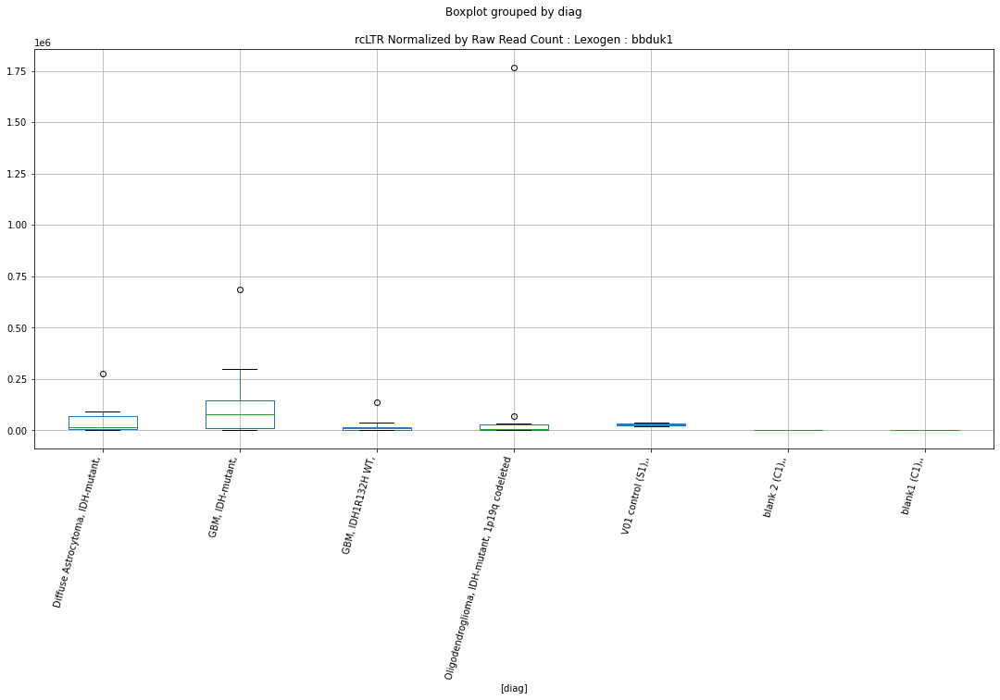

rcLTR Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.779030688860269
	p = 0.0921272894473403
rcLTR Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.779030688860269
	p = 0.0921272894473403


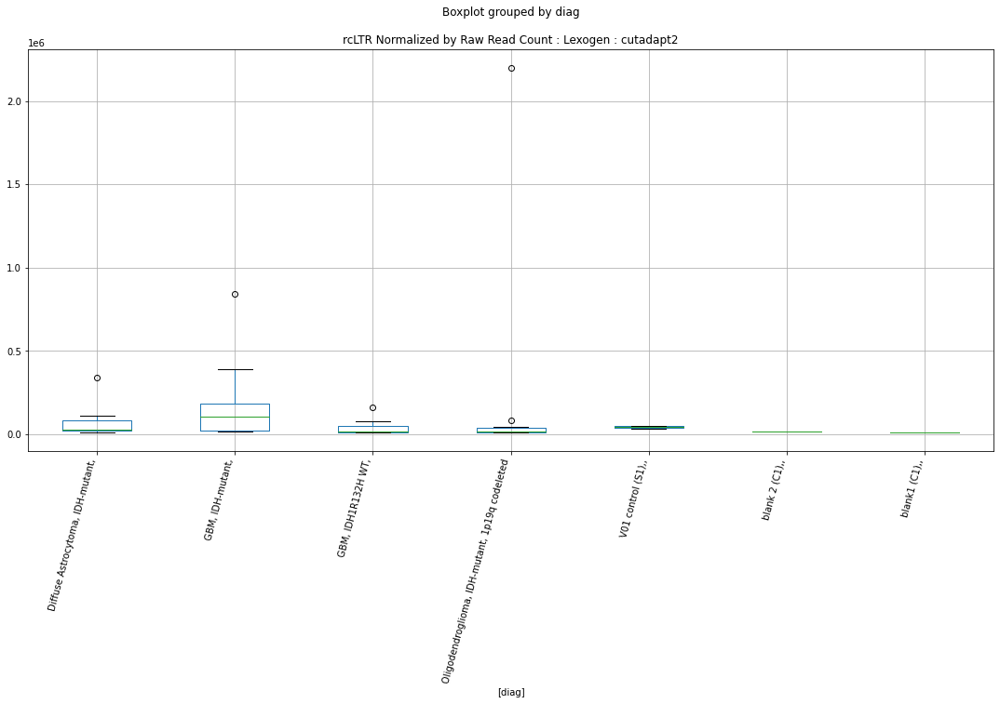

rcLTR Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7670179729965525
	p = 0.0941758245637308
rcLTR Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7670179729965525
	p = 0.0941758245637308


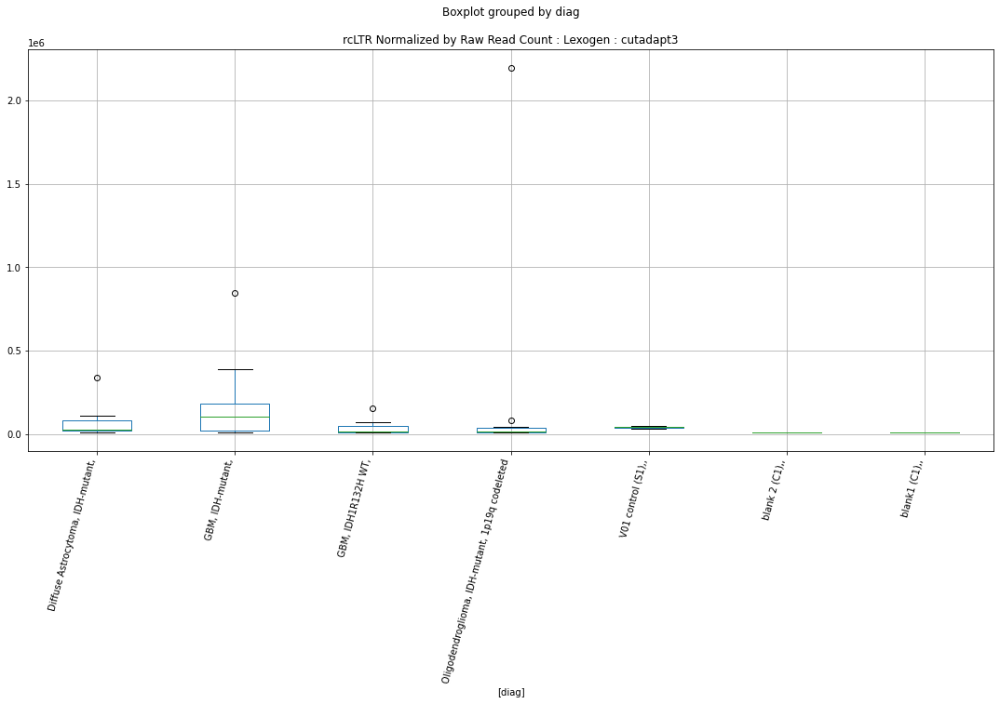

rcLow_complexity D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8671292018790007
	p = 0.07825736765779509
rcLow_complexity D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8671292018790007
	p = 0.07825736765779509


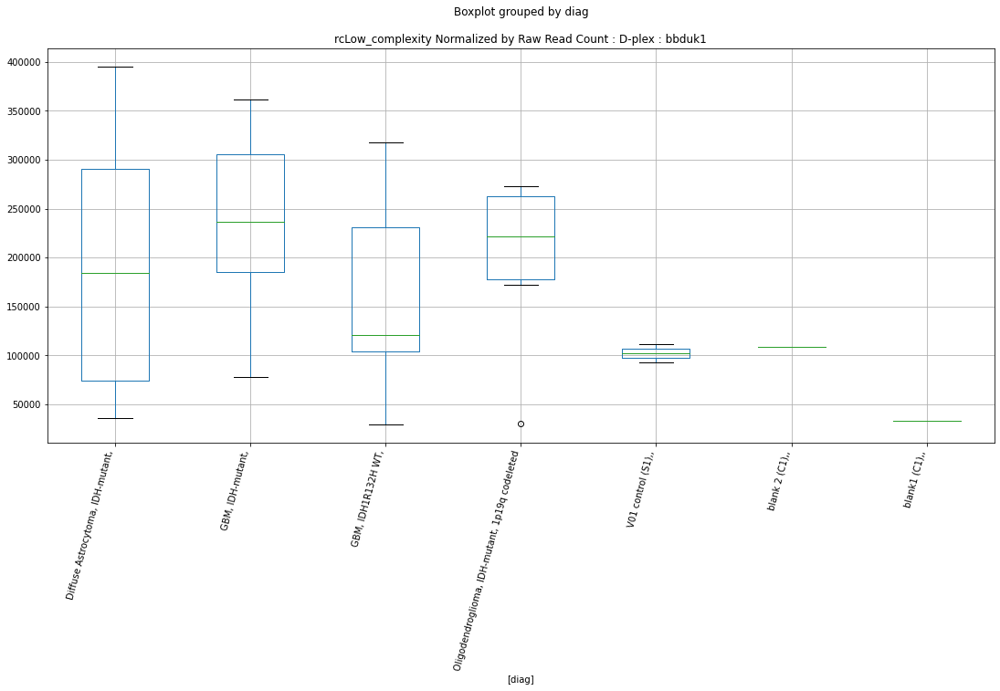

rcLow_complexity D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8513934937304686
	p = 0.0805909258307404
rcLow_complexity D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8513934937304686
	p = 0.0805909258307404


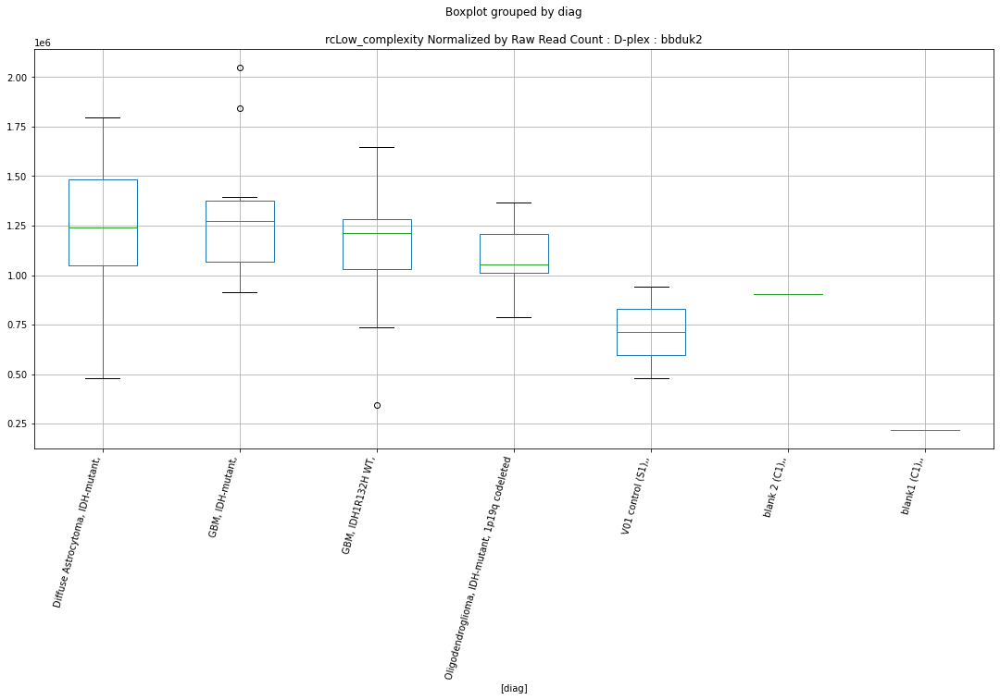

rcLow_complexity D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0338610624338975
	p = 0.05697552974617022
rcLow_complexity D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0338610624338975
	p = 0.05697552974617022


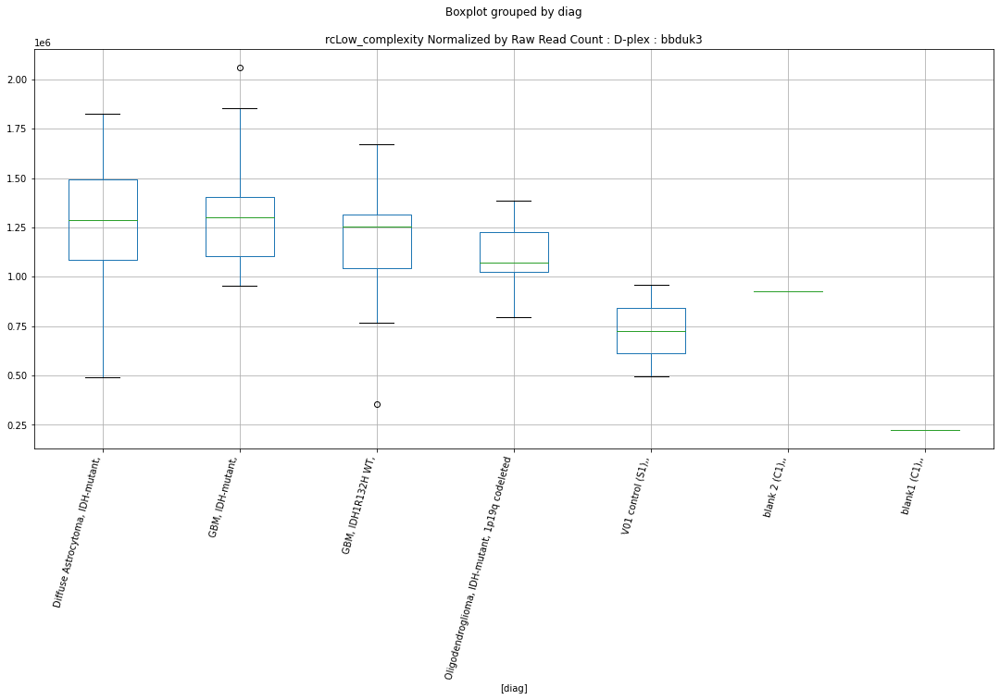

rcLow_complexity D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7858502853891867
	p = 0.090981697612597
rcLow_complexity D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7858502853891867
	p = 0.090981697612597


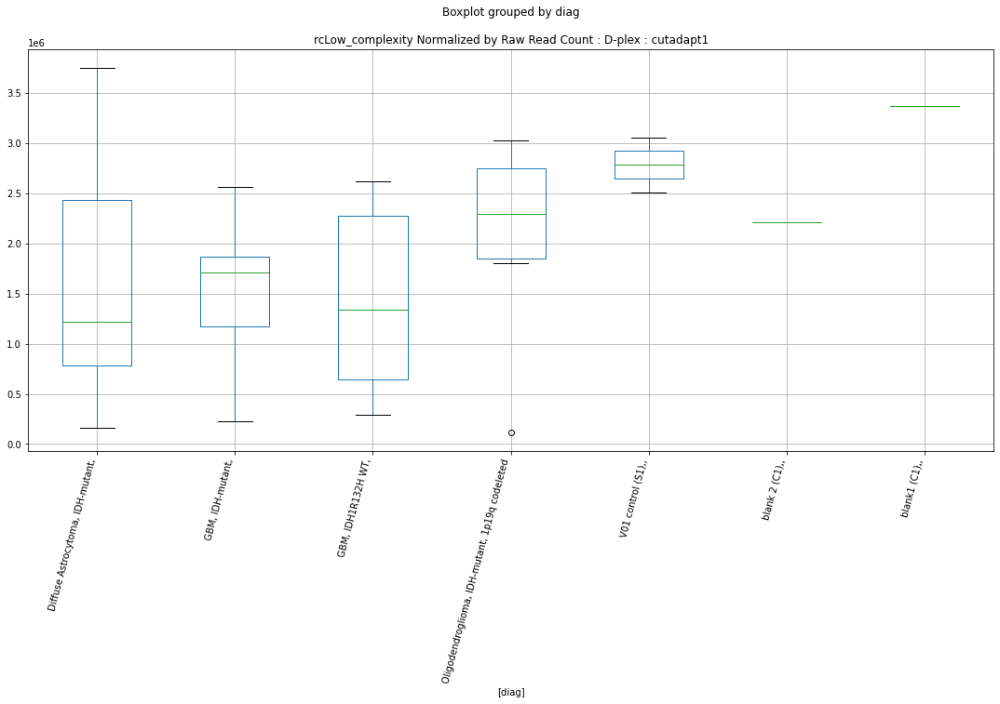

rcLow_complexity D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7856599913665343
	p = 0.09101349497921546
rcLow_complexity D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7856599913665343
	p = 0.09101349497921546


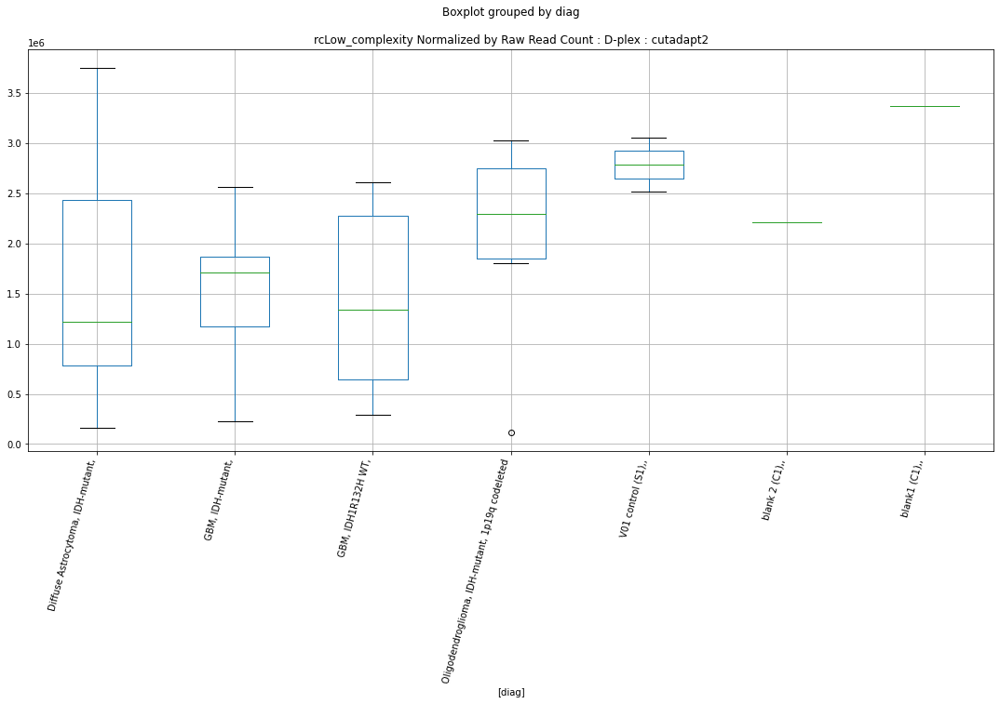

rcLow_complexity D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7852022078157772
	p = 0.09109002847090629
rcLow_complexity D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7852022078157772
	p = 0.09109002847090629


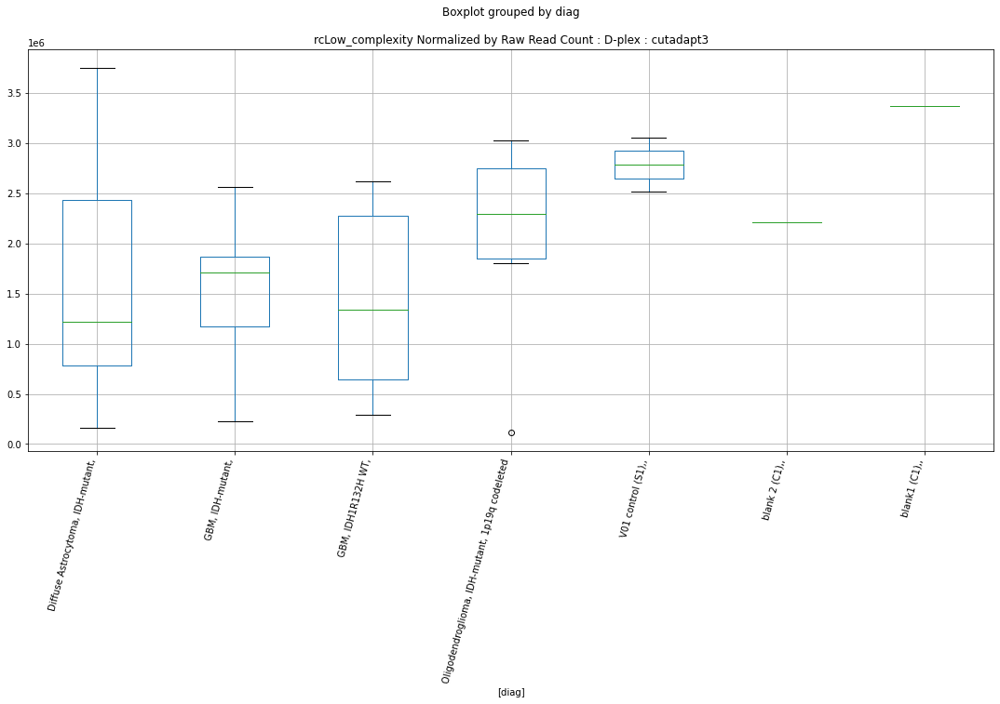

rcLow_complexity Lexogen bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.947796394200687
	p = 0.06720851952346608
rcLow_complexity Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7683753408481013
	p = 0.09394238340657254
rcLow_complexity Lexogen bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.947796394200687
	p = 0.06720851952346608
rcLow_complexity Lexogen bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7683753408481013
	p = 0.09394238340657254


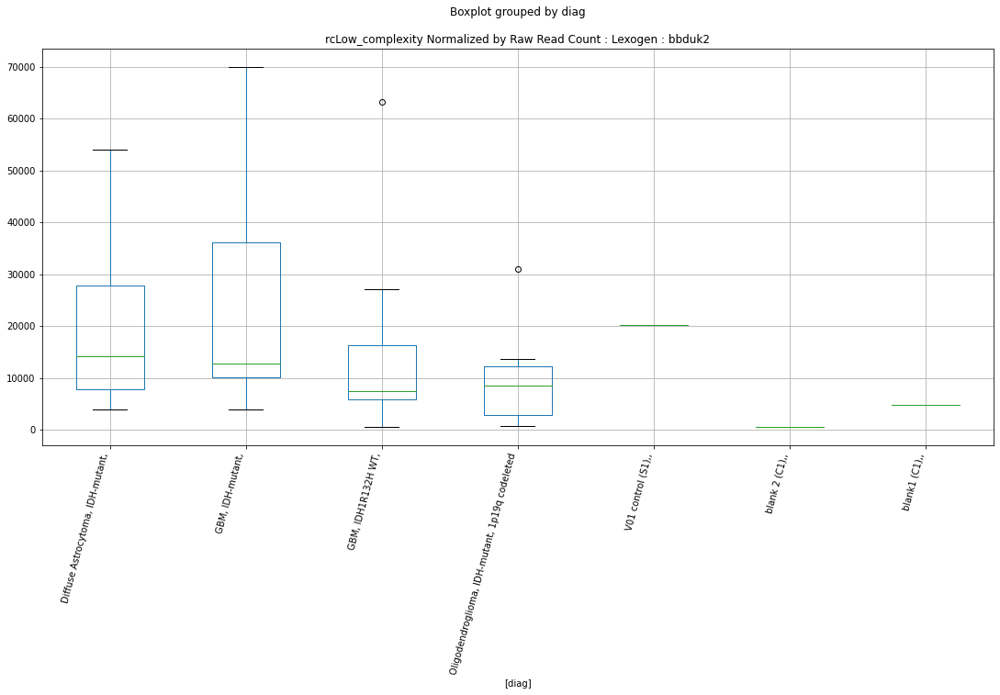

rcLow_complexity Lexogen bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9757162741301084
	p = 0.06372158677168377
rcLow_complexity Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7528099243347426
	p = 0.09664974992057747
rcLow_complexity Lexogen bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9757162741301084
	p = 0.06372158677168377
rcLow_complexity Lexogen bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7528099243347426
	p = 0.09664974992057747


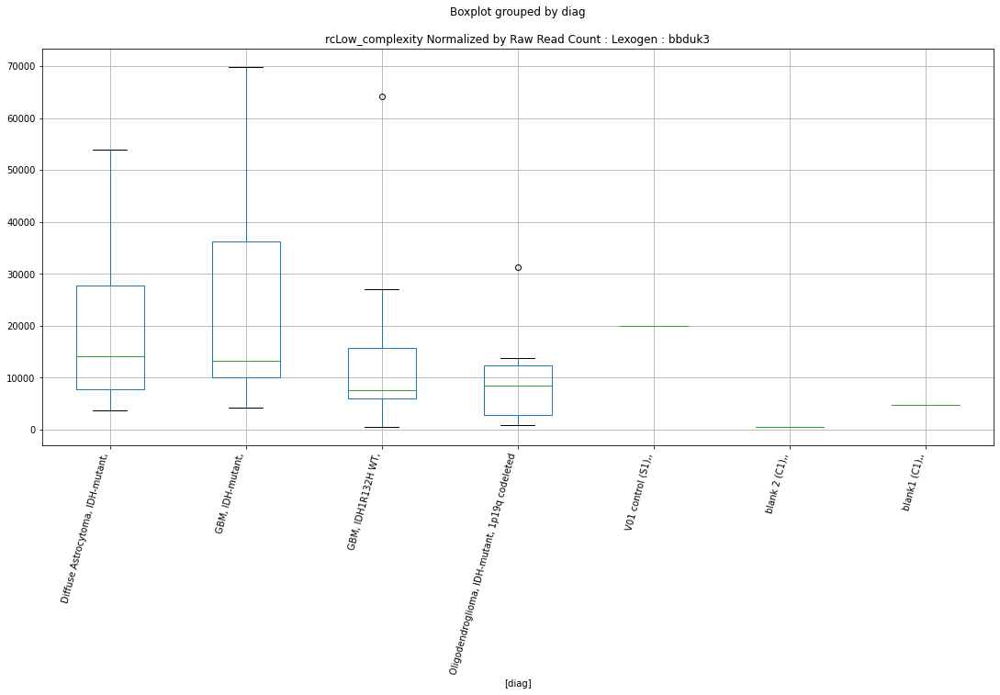

rcLow_complexity Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9426710941001613
	p = 0.06786682194323722
rcLow_complexity Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8333855004220356
	p = 0.08333645890604706
rcLow_complexity Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9426710941001613
	p = 0.06786682194323722
rcLow_complexity Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8333855004220356
	p = 0.08333645890604706


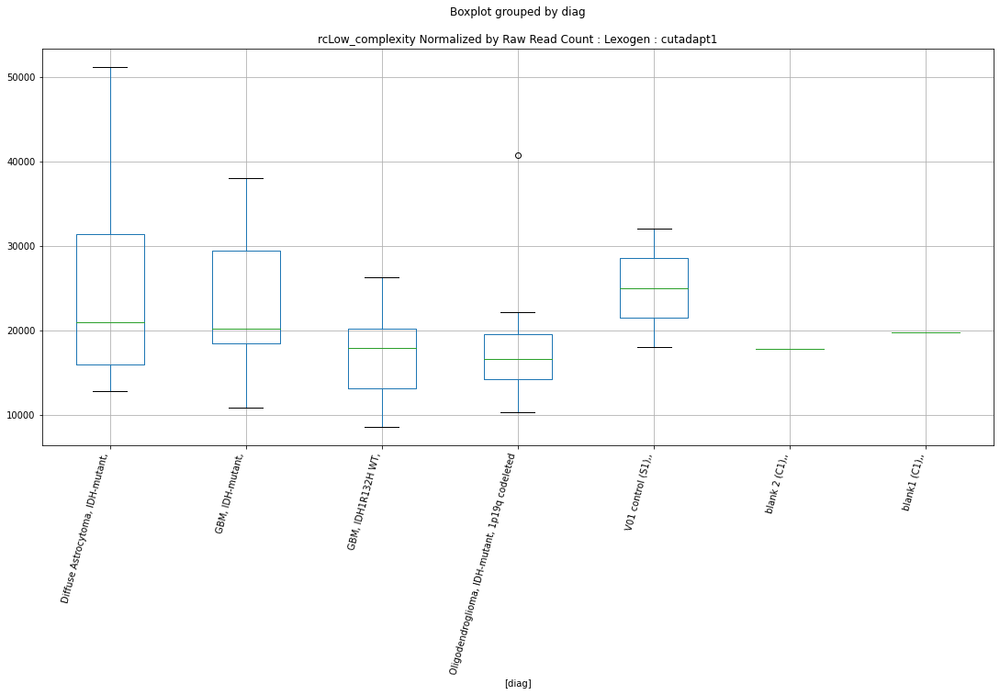

rcLow_complexity Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8848848788127768
	p = 0.07569605489445058
rcLow_complexity Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8848848788127768
	p = 0.07569605489445058


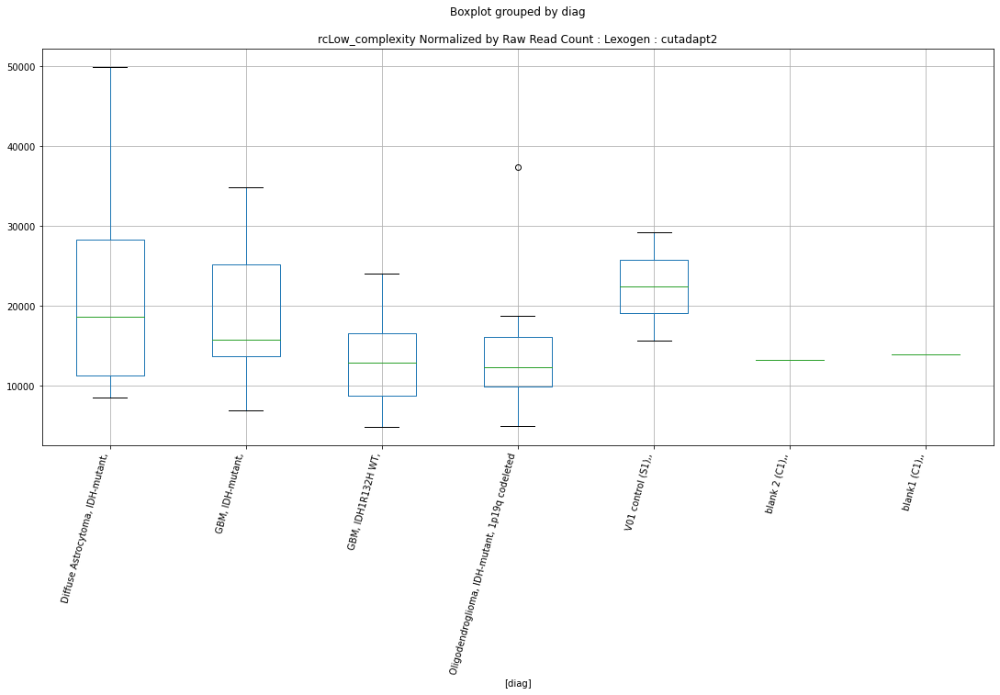

rcLow_complexity Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8164122250752952
	p = 0.08599910658764112
rcLow_complexity Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8164122250752952
	p = 0.08599910658764112


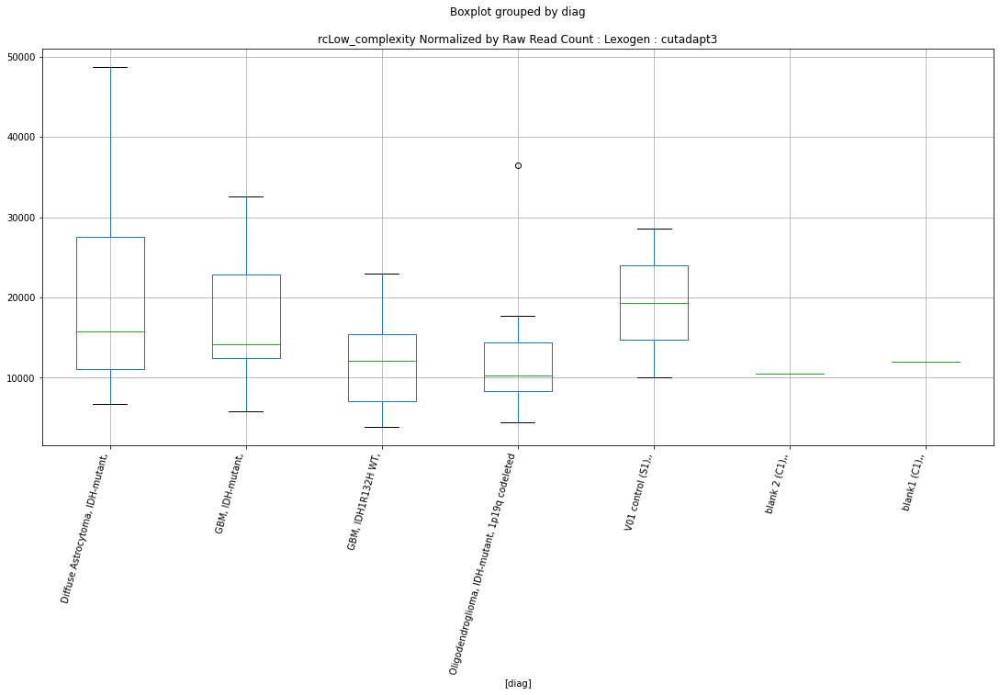

rcSatellite D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8469951515257648
	p = 0.08125405391758318
rcSatellite D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8469951515257648
	p = 0.08125405391758318


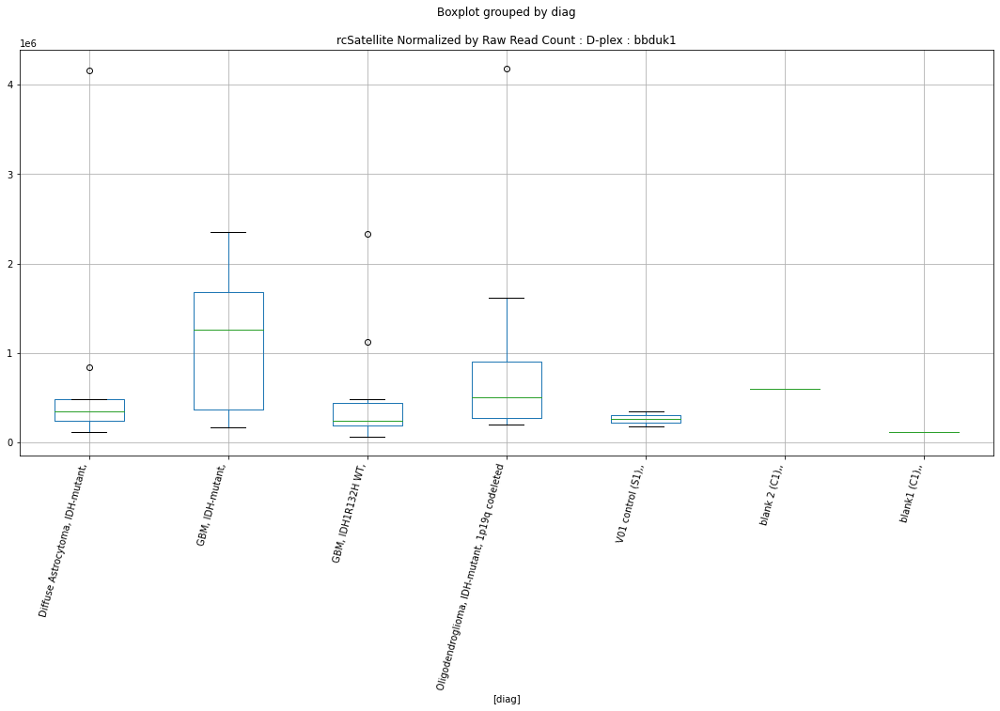

rcSatellite D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.818788590116916
	p = 0.08562188533284038
rcSatellite D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.818788590116916
	p = 0.08562188533284038


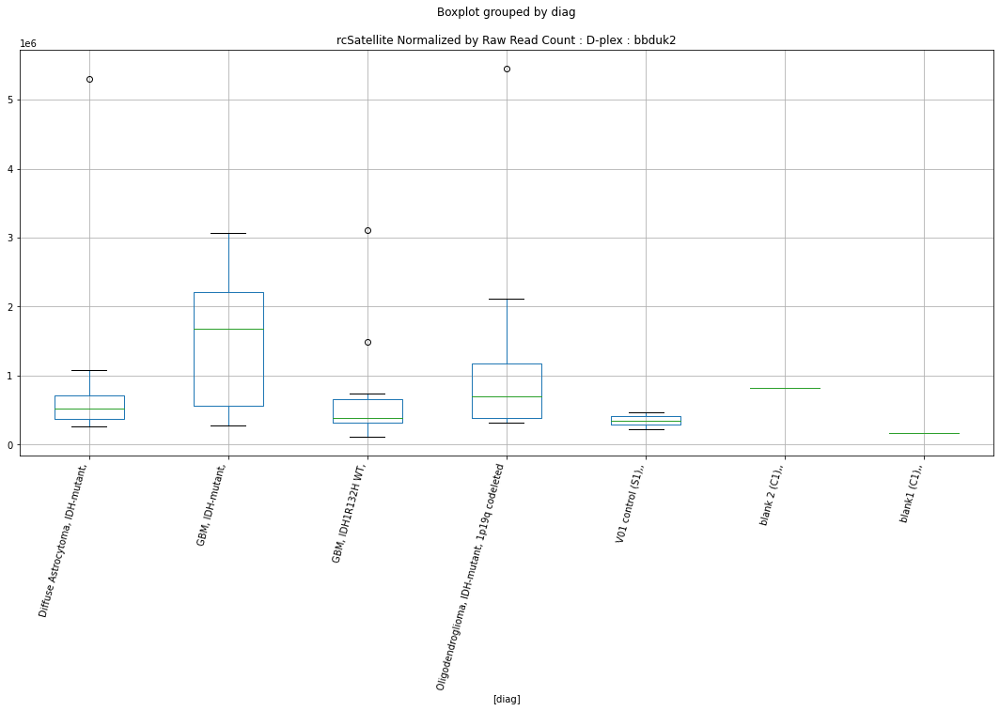

rcSatellite D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8153445101293921
	p = 0.08616906791095964
rcSatellite D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8153445101293921
	p = 0.08616906791095964


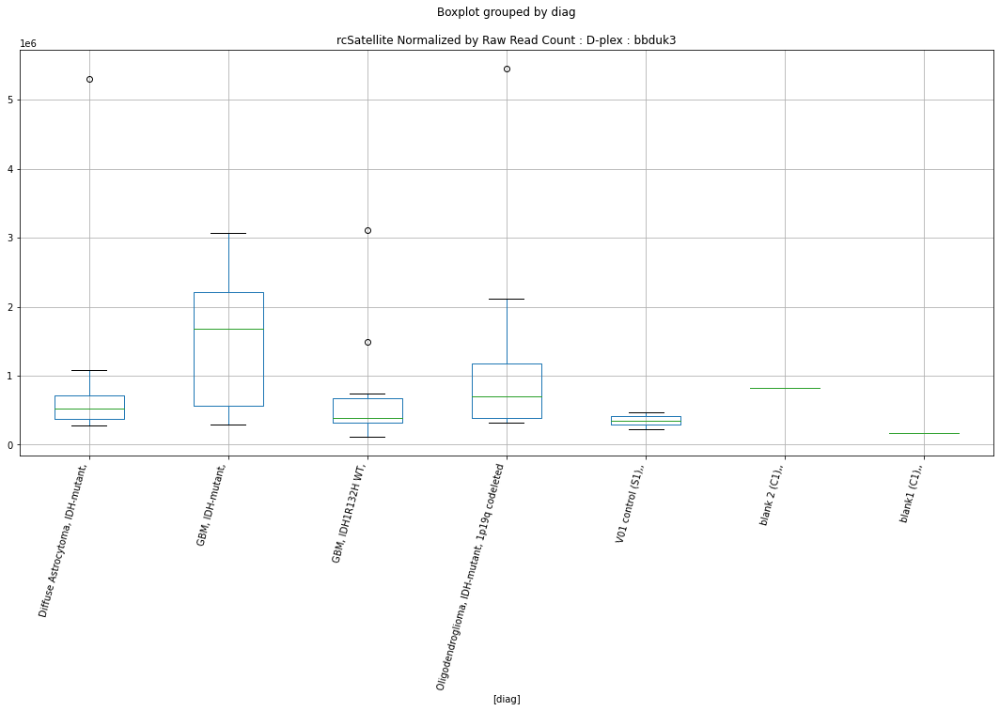

rcSatellite D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8417914984188366
	p = 0.08204479469029834
rcSatellite D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8417914984188366
	p = 0.08204479469029834


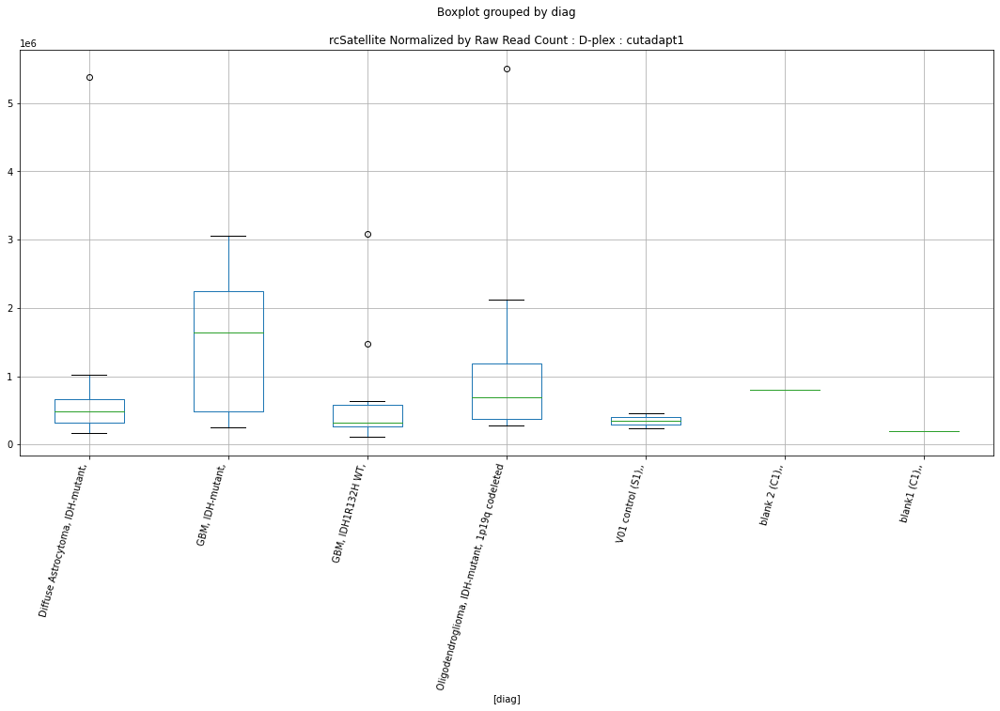

rcSatellite D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8417009945399054
	p = 0.08205860722665341
rcSatellite D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8417009945399054
	p = 0.08205860722665341


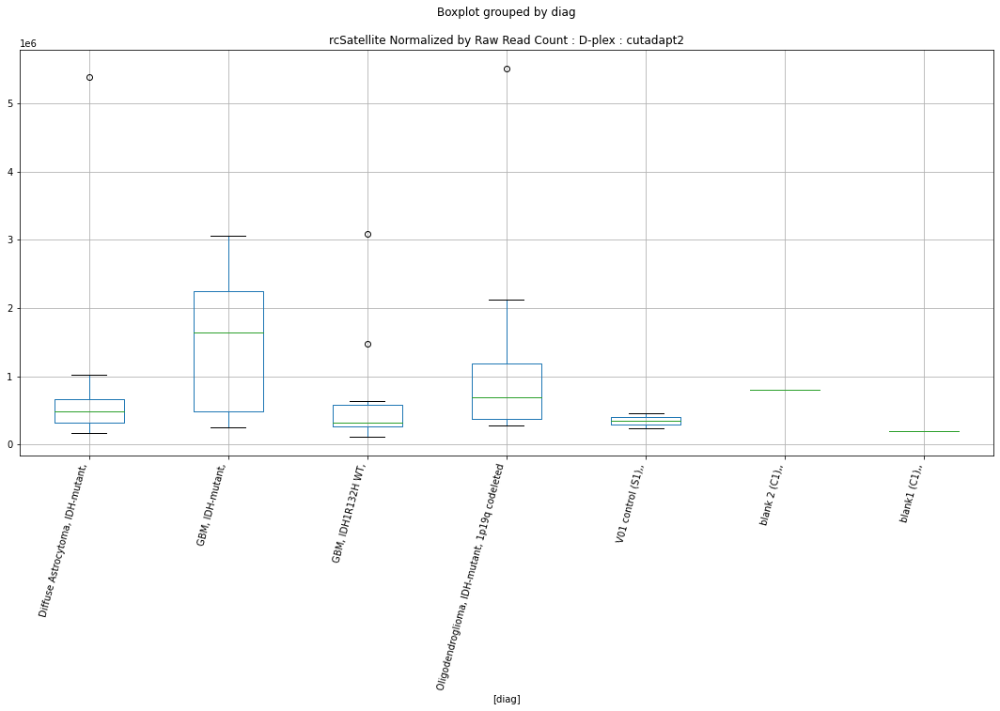

rcSatellite D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8418251078509
	p = 0.08203966580097362
rcSatellite D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8418251078509
	p = 0.08203966580097362


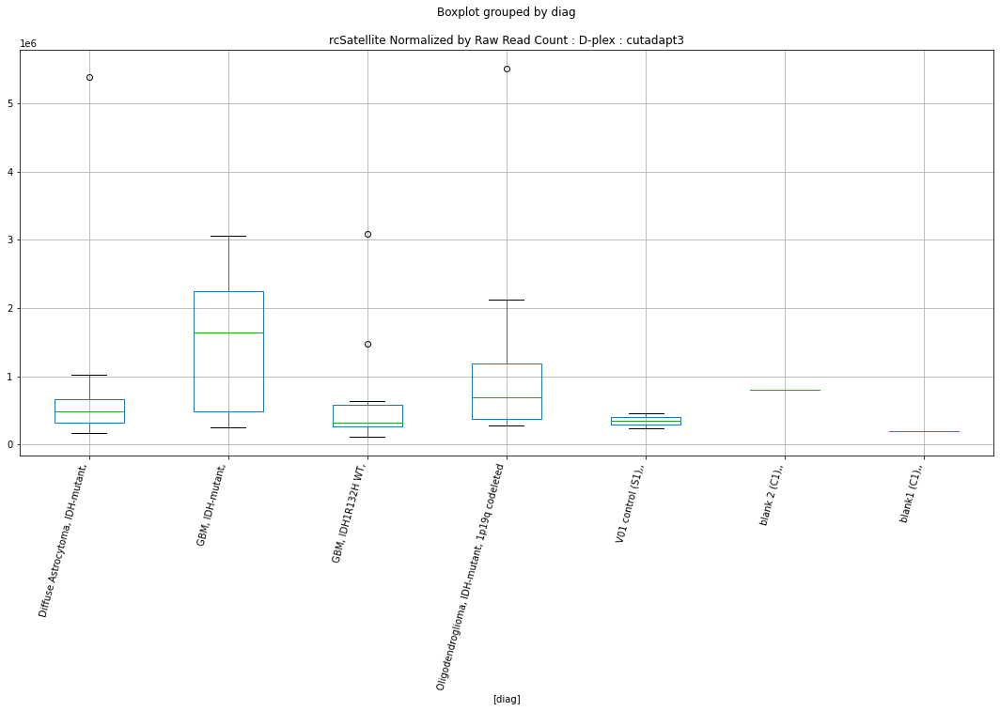

rcrRNA Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8410114082158946
	p = 0.08216391779934025
rcrRNA Lexogen bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9597150349675079
	p = 0.0656996576698904
rcrRNA Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8410114082158946
	p = 0.08216391779934025
rcrRNA Lexogen bbduk1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9597150349675079
	p = 0.0656996576698904


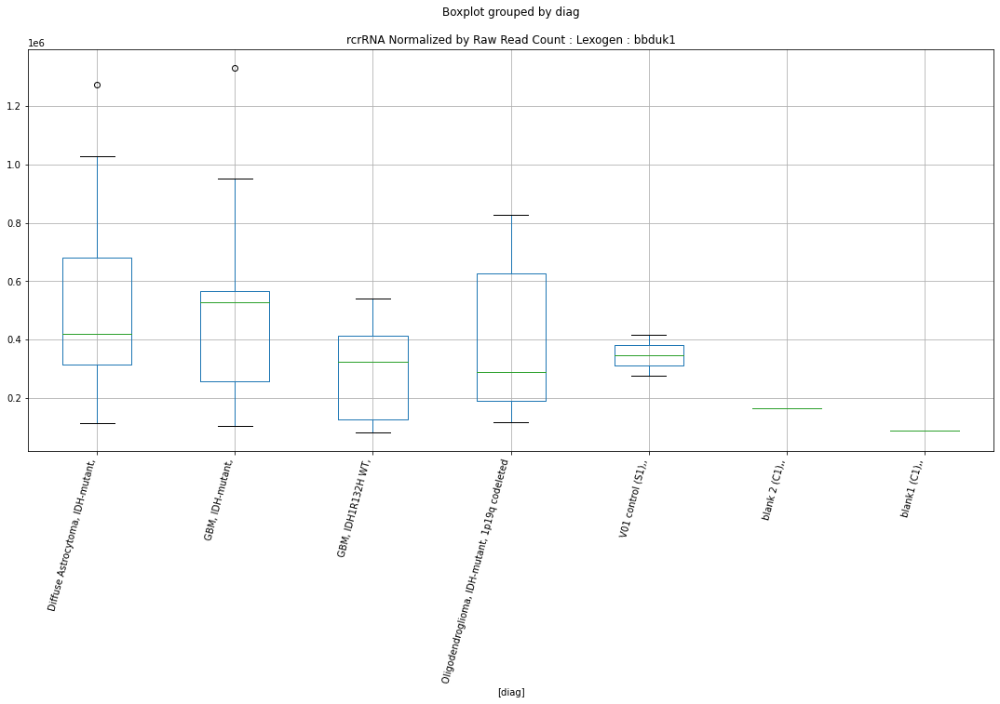

rcrRNA Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8768707633373354
	p = 0.07684279329263961
rcrRNA Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9862151326743798
	p = 0.0624528645826883
rcrRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8768707633373354
	p = 0.07684279329263961
rcrRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9862151326743798
	p = 0.0624528645826883


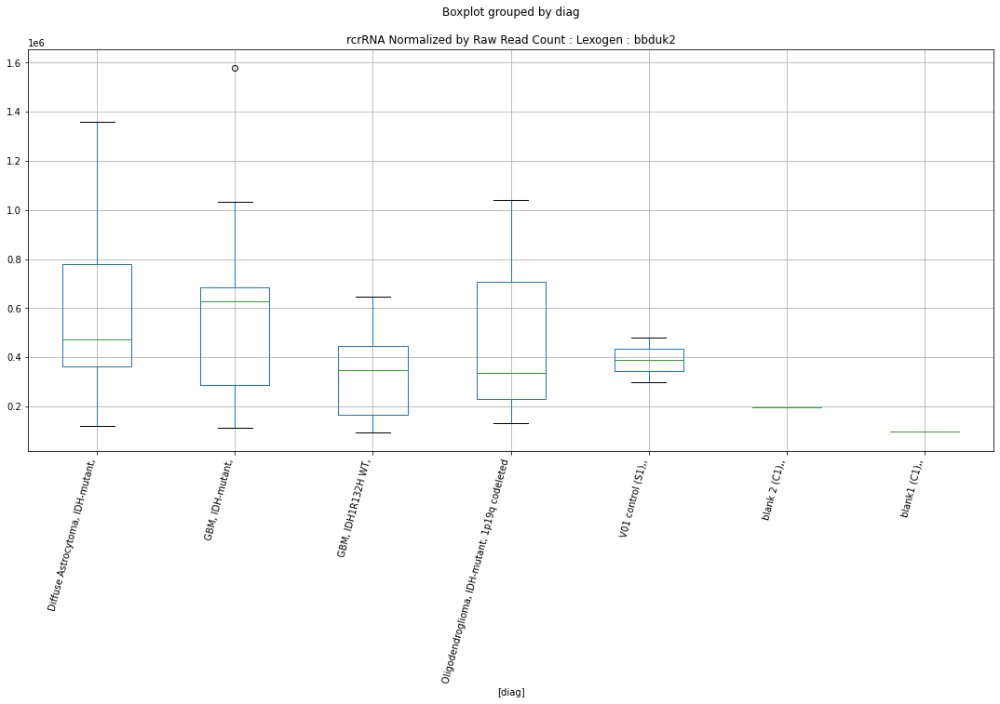

rcrRNA Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.872186300367341
	p = 0.07752018061958572
rcrRNA Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9821903646233119
	p = 0.06293653165402606
rcrRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.872186300367341
	p = 0.07752018061958572
rcrRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9821903646233119
	p = 0.06293653165402606


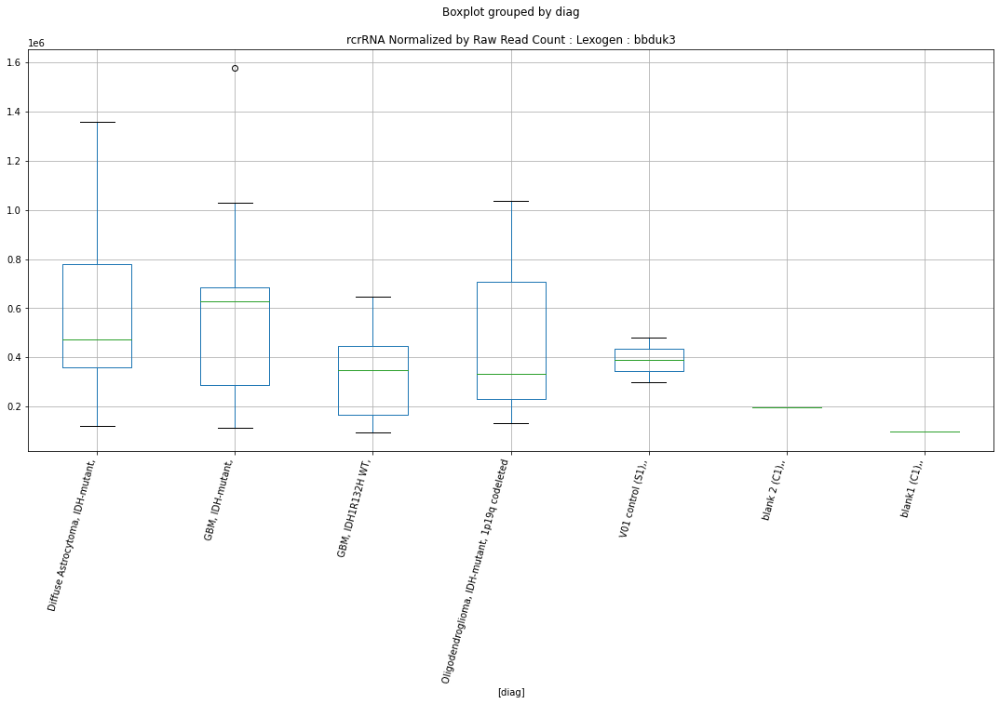

rcrRNA Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.864558184320651
	p = 0.07863451938117512
rcrRNA Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9691459463734566
	p = 0.06452726740028365
rcrRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.864558184320651
	p = 0.07863451938117512
rcrRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9691459463734566
	p = 0.06452726740028365


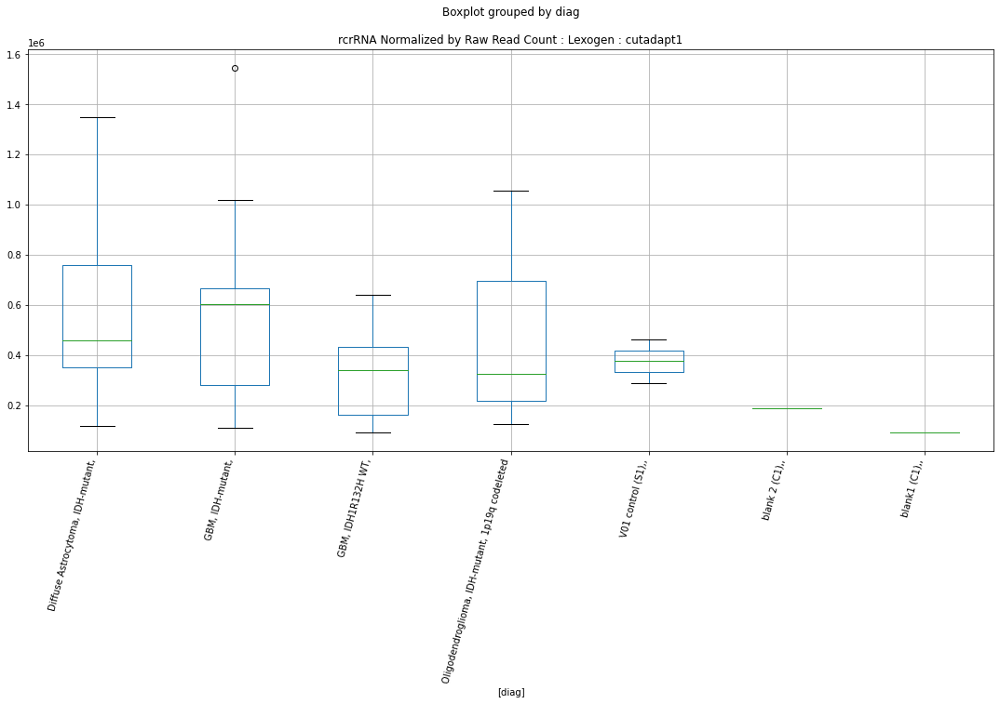

rcrRNA Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8759797431754914
	p = 0.07697123314982911
rcrRNA Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.970814732192223
	p = 0.0643217748003835
rcrRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8759797431754914
	p = 0.07697123314982911
rcrRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.970814732192223
	p = 0.0643217748003835


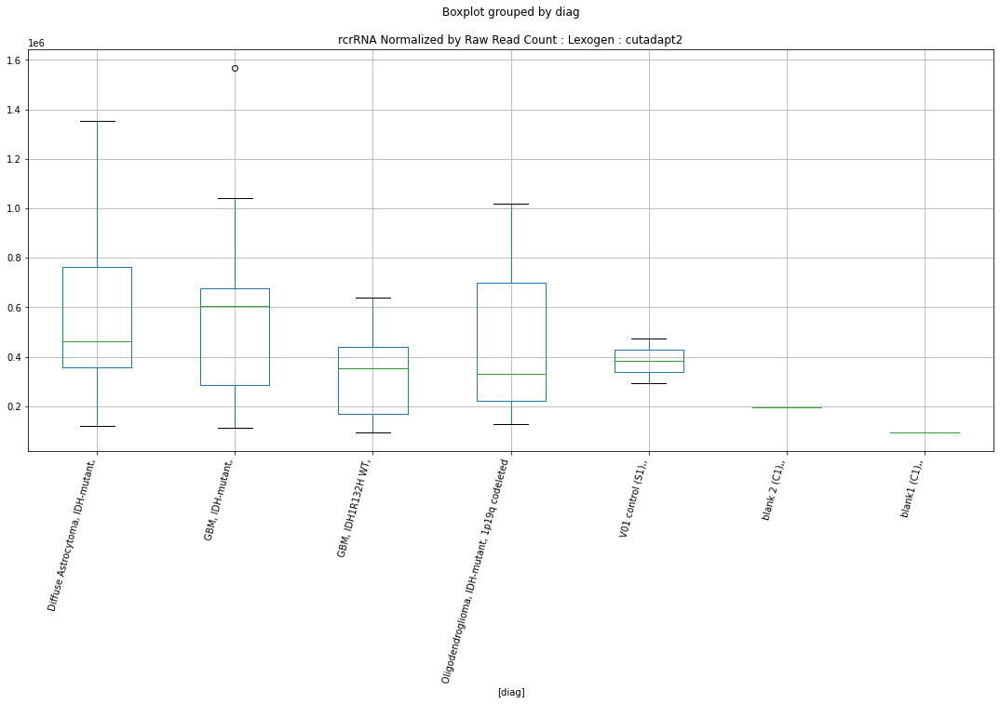

rcrRNA Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8685225955029015
	p = 0.07805363366720834
rcrRNA Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9535506944724783
	p = 0.06647622287176694
rcrRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8685225955029015
	p = 0.07805363366720834
rcrRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9535506944724783
	p = 0.06647622287176694


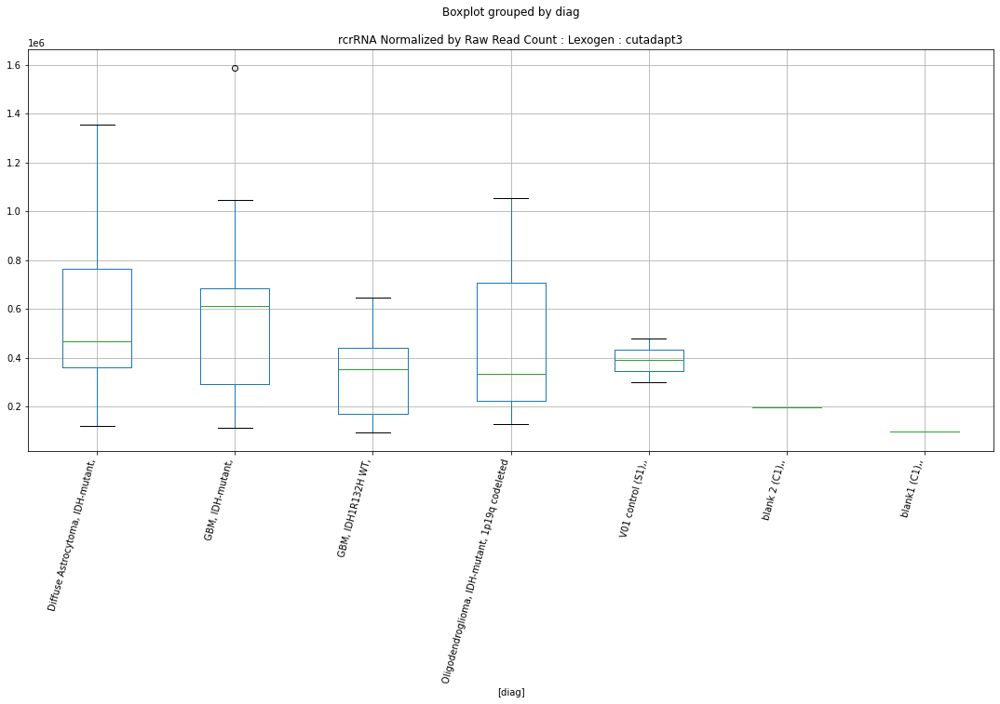

rctRNA Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9295220955053363
	p = 0.06958207094019142
rctRNA Lexogen bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9443640569417786
	p = 0.06764874147158609
rctRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9295220955053363
	p = 0.06958207094019142
rctRNA Lexogen bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9443640569417786
	p = 0.06764874147158609


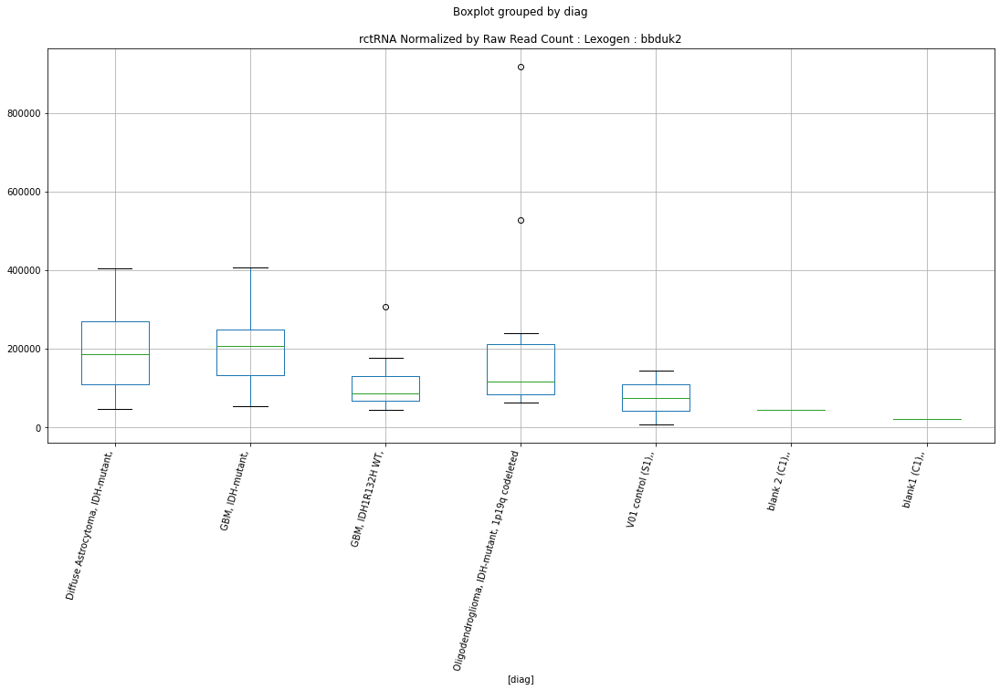

rctRNA Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9344817689390543
	p = 0.06893061179849193
rctRNA Lexogen bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9452018095011658
	p = 0.06754105702083422
rctRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9344817689390543
	p = 0.06893061179849193
rctRNA Lexogen bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9452018095011658
	p = 0.06754105702083422


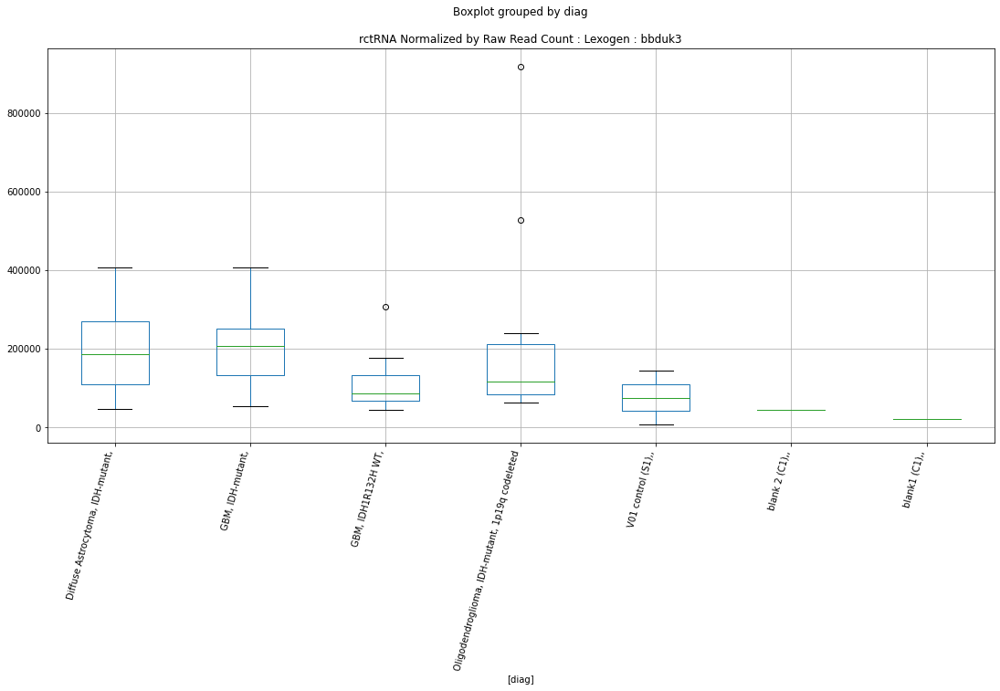

rctRNA Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9266690290811215
	p = 0.0699593033004324
rctRNA Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9482702509361676
	p = 0.0671479452364247
rctRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9266690290811215
	p = 0.0699593033004324
rctRNA Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9482702509361676
	p = 0.0671479452364247


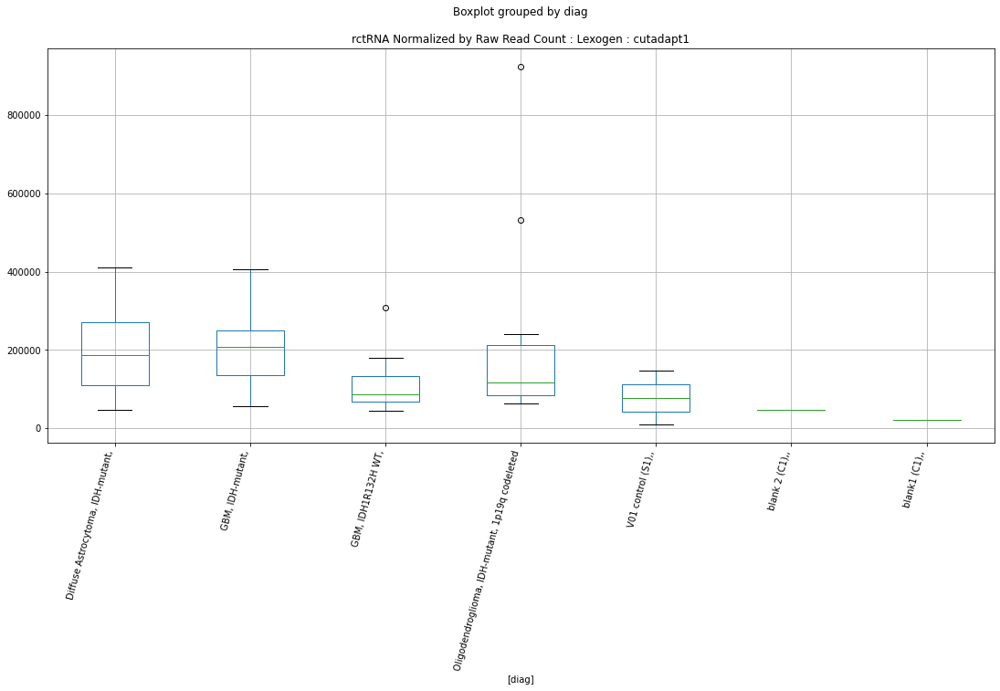

rctRNA Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9300084365939774
	p = 0.0695179478926447
rctRNA Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9288263586372556
	p = 0.06967389392520094
rctRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9300084365939774
	p = 0.0695179478926447
rctRNA Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9288263586372556
	p = 0.06967389392520094


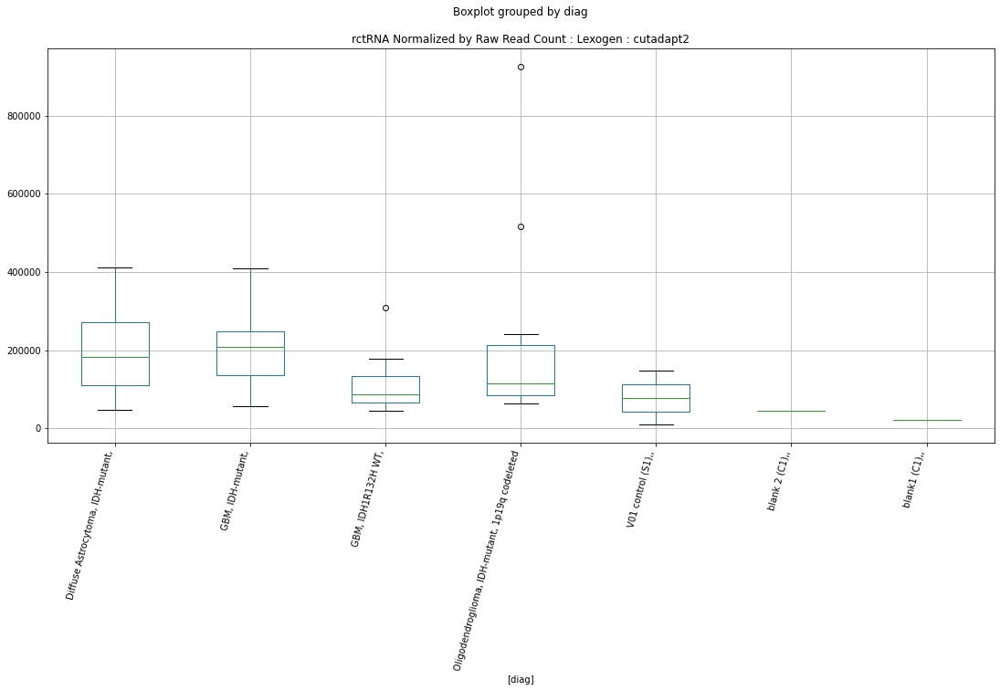

rctRNA Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.936850805372218
	p = 0.06862135776139212
rctRNA Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.931525260158939
	p = 0.06931829571046556
rctRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.936850805372218
	p = 0.06862135776139212
rctRNA Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.931525260158939
	p = 0.06931829571046556


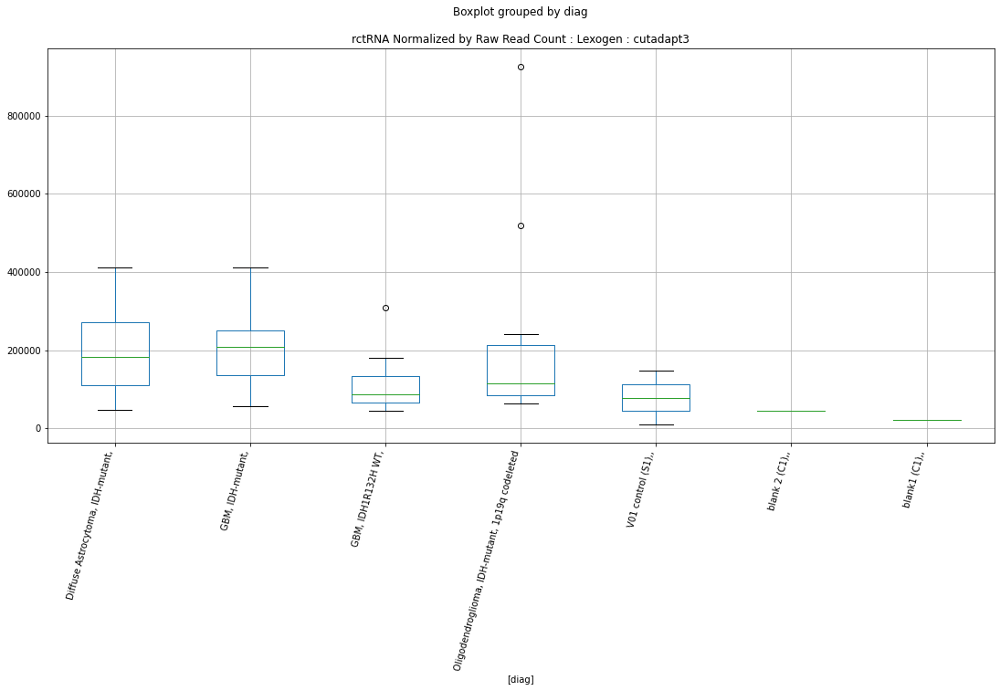

rcRetroposon Lexogen cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -1.7788127476388158
	p = 0.09216410668178242
rcRetroposon Lexogen cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7788127476388158
	p = 0.09216410668178242


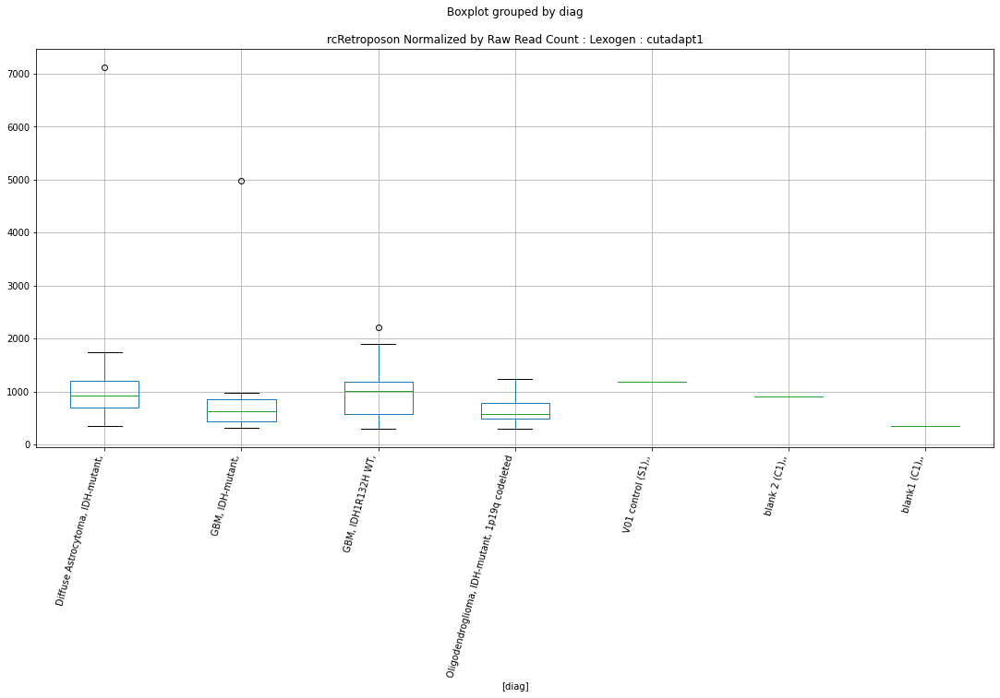

rcsrpRNA D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.750236723388134
	p = 0.09710378047882161
rcsrpRNA D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.750236723388134
	p = 0.09710378047882161


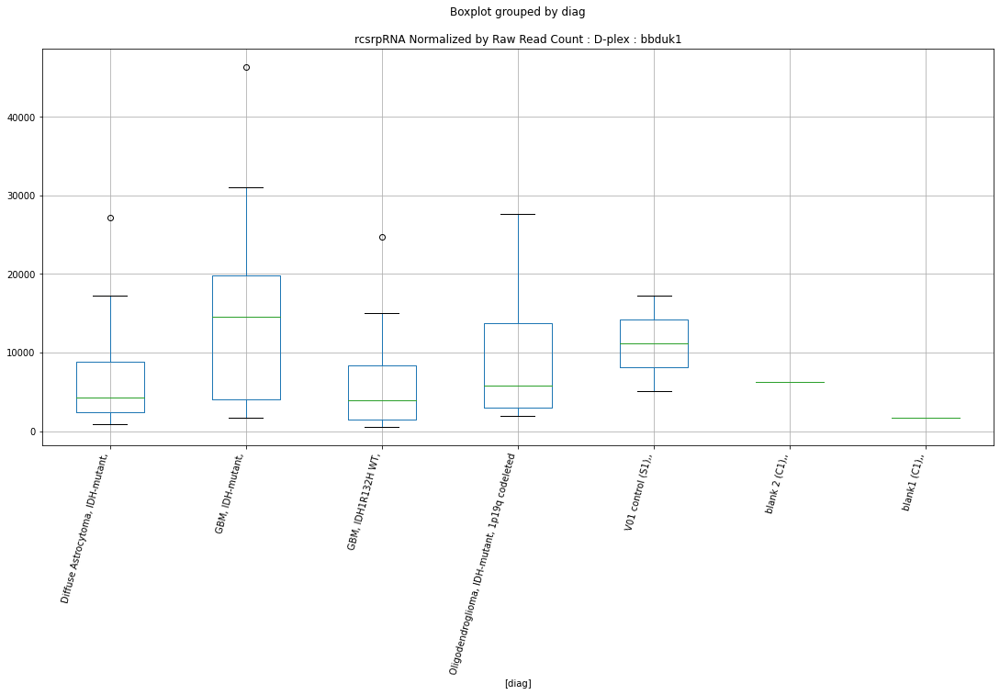

rcsrpRNA D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7644201979937828
	p = 0.09462399841516315
rcsrpRNA D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7644201979937828
	p = 0.09462399841516315


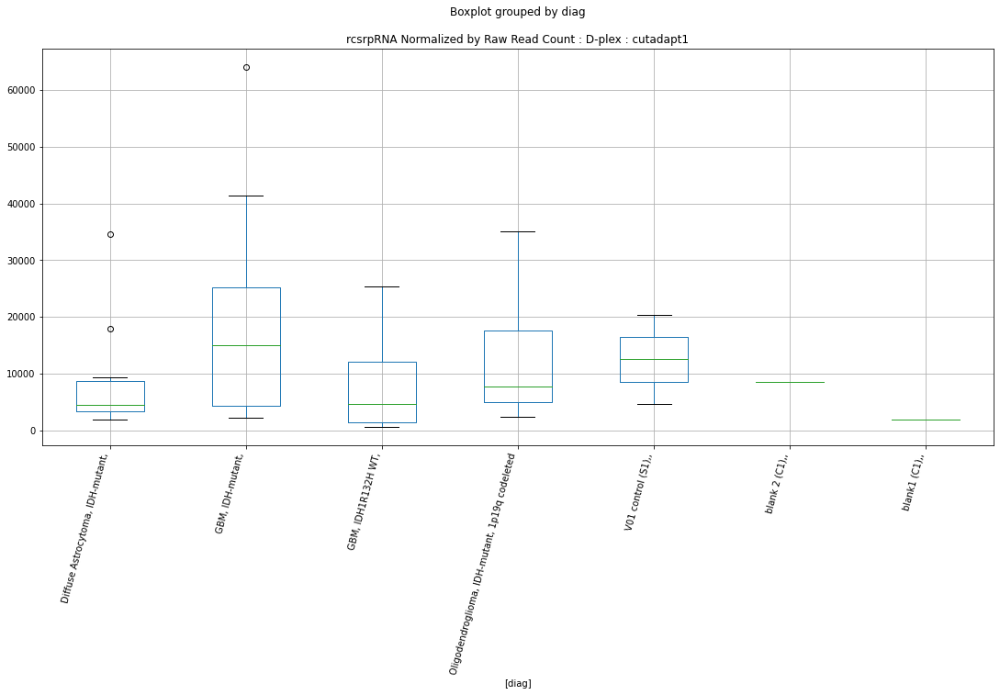

rcsrpRNA D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7644201979937828
	p = 0.09462399841516315
rcsrpRNA D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7644201979937828
	p = 0.09462399841516315


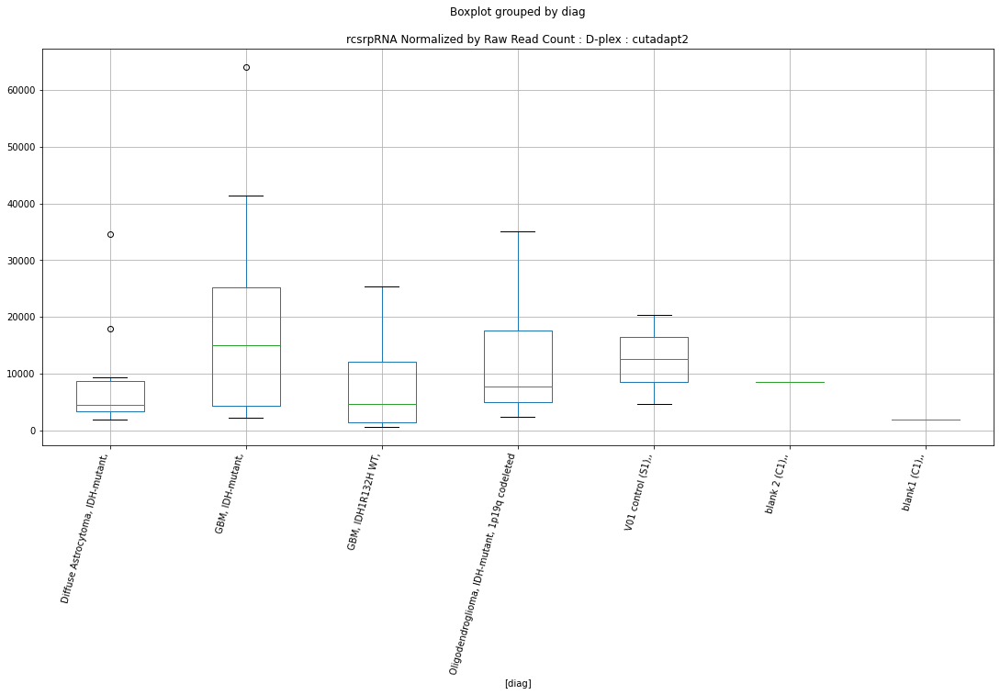

rcsrpRNA D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7644201979937828
	p = 0.09462399841516315
rcsrpRNA D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7644201979937828
	p = 0.09462399841516315


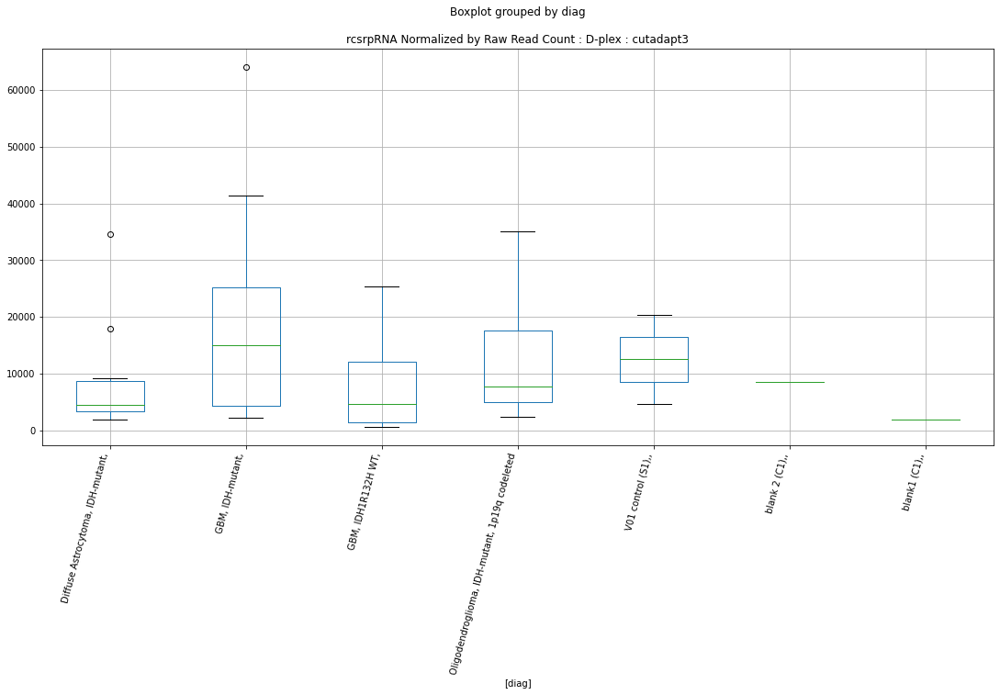

In [65]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmskclasses:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count : "+labkit+" : "+trimmer)
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


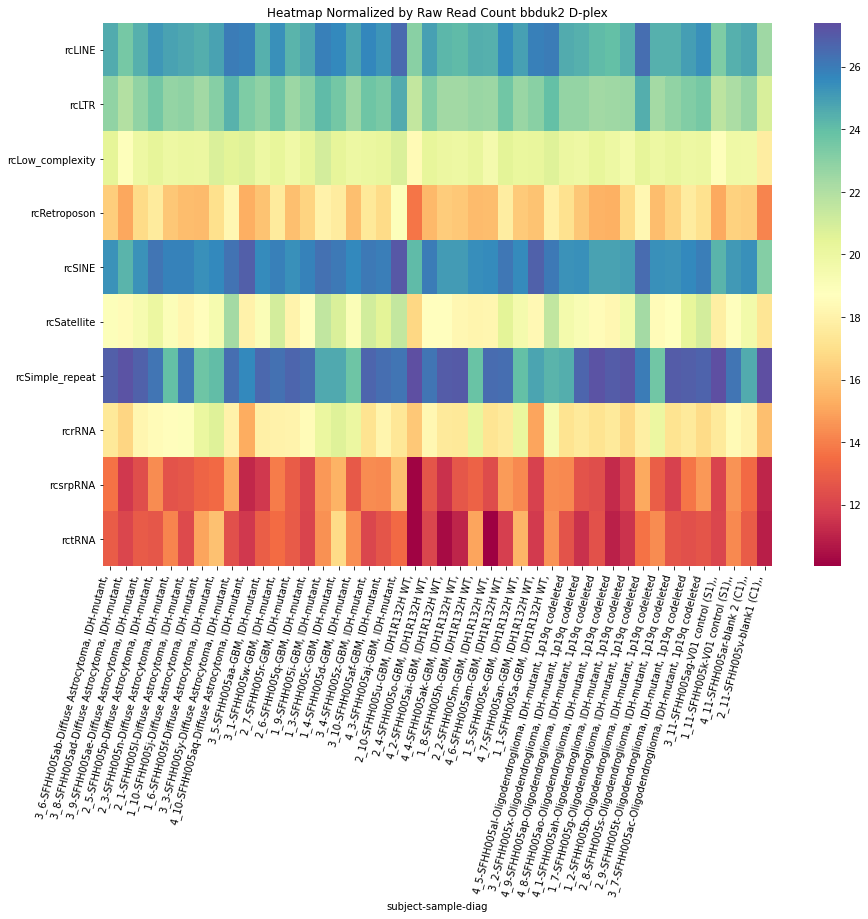

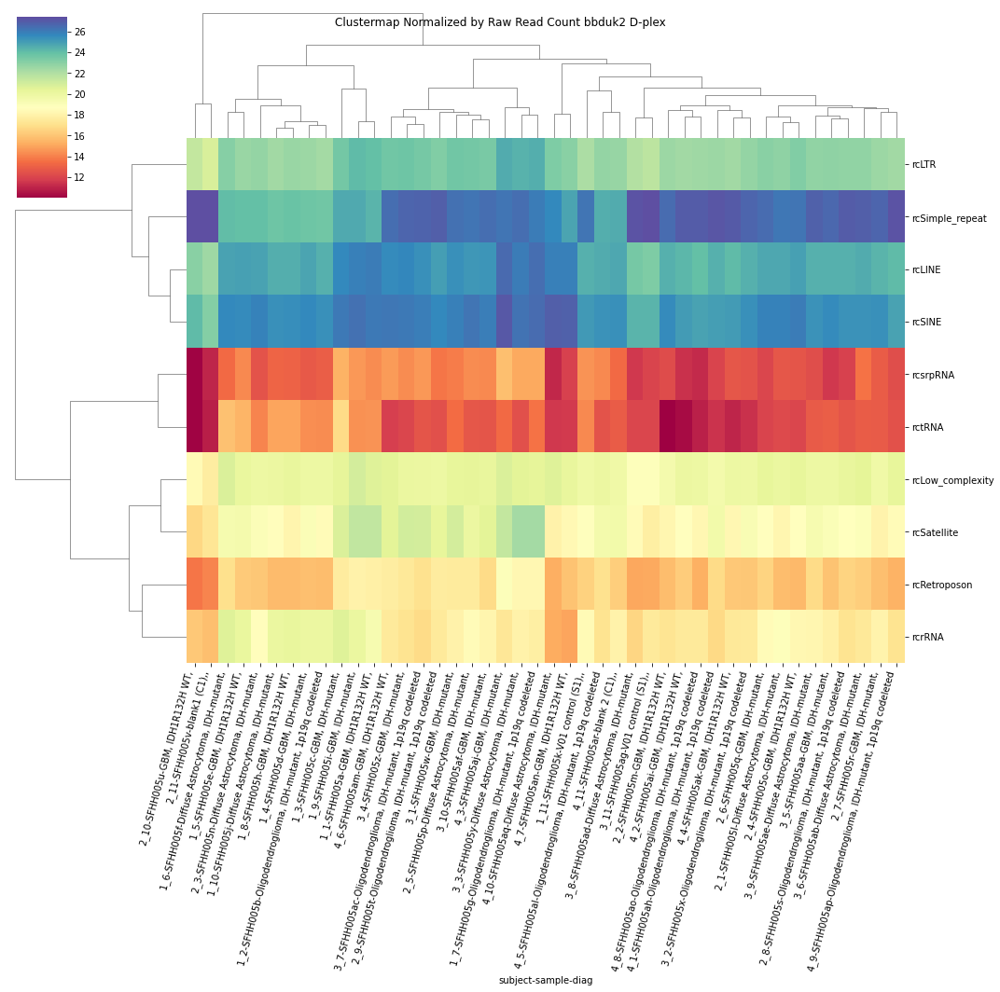

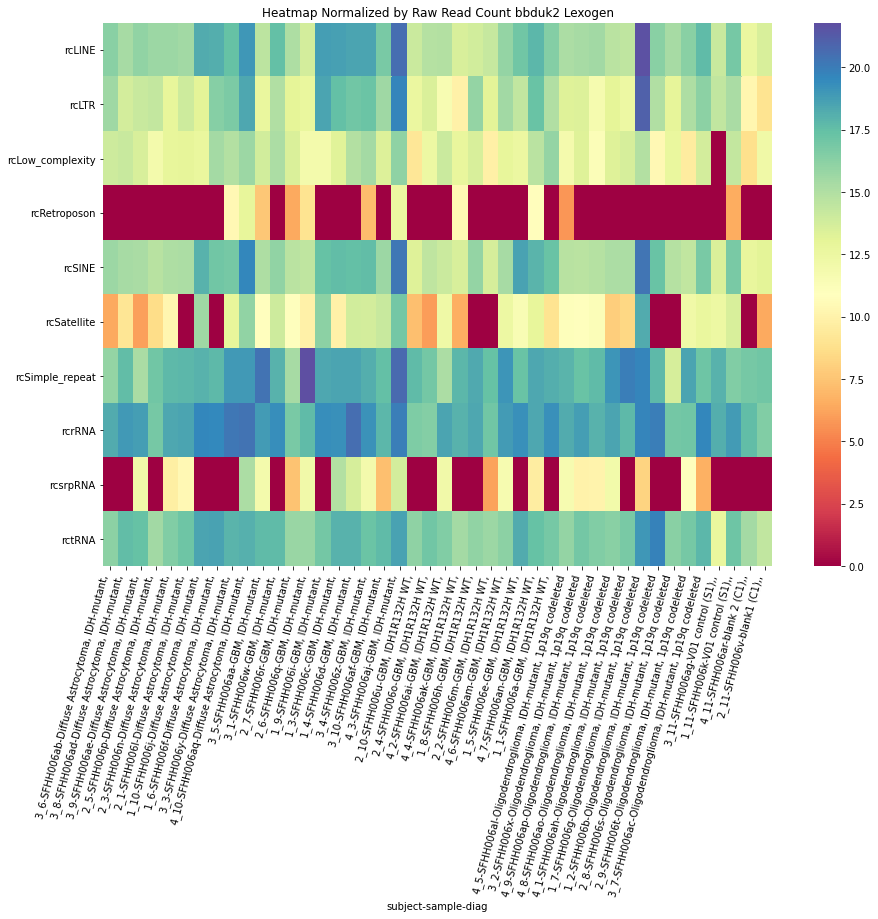

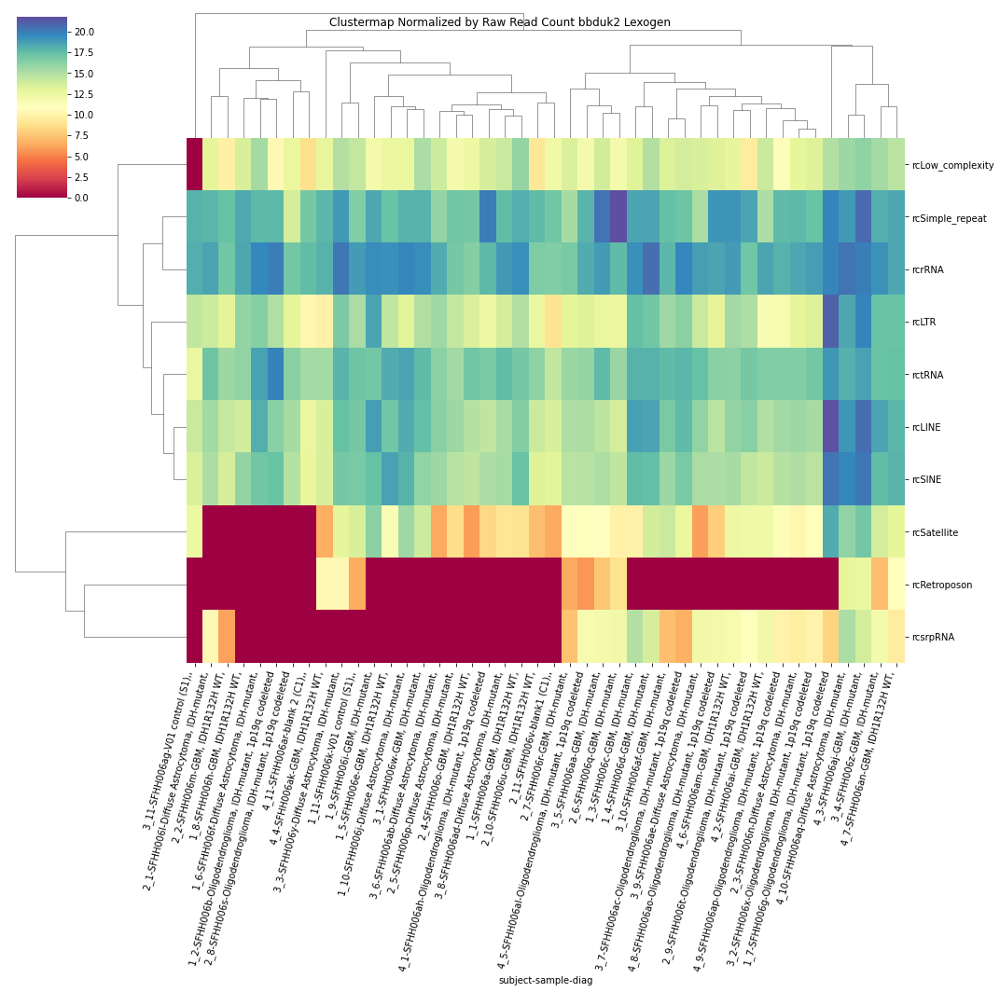

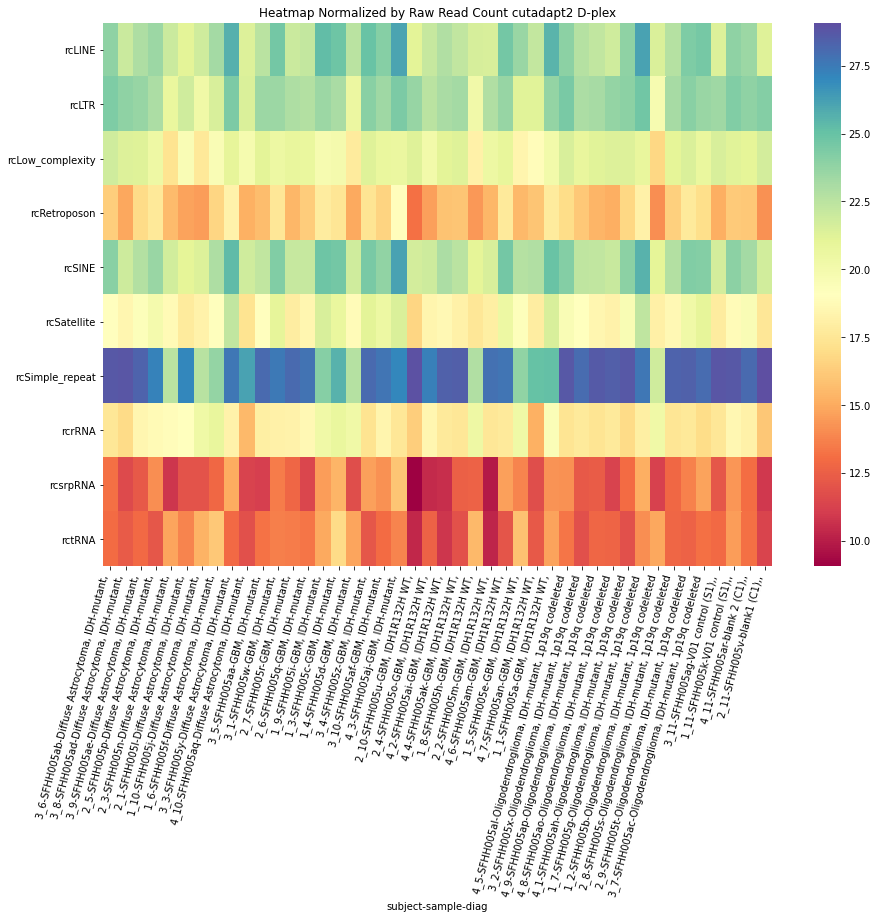

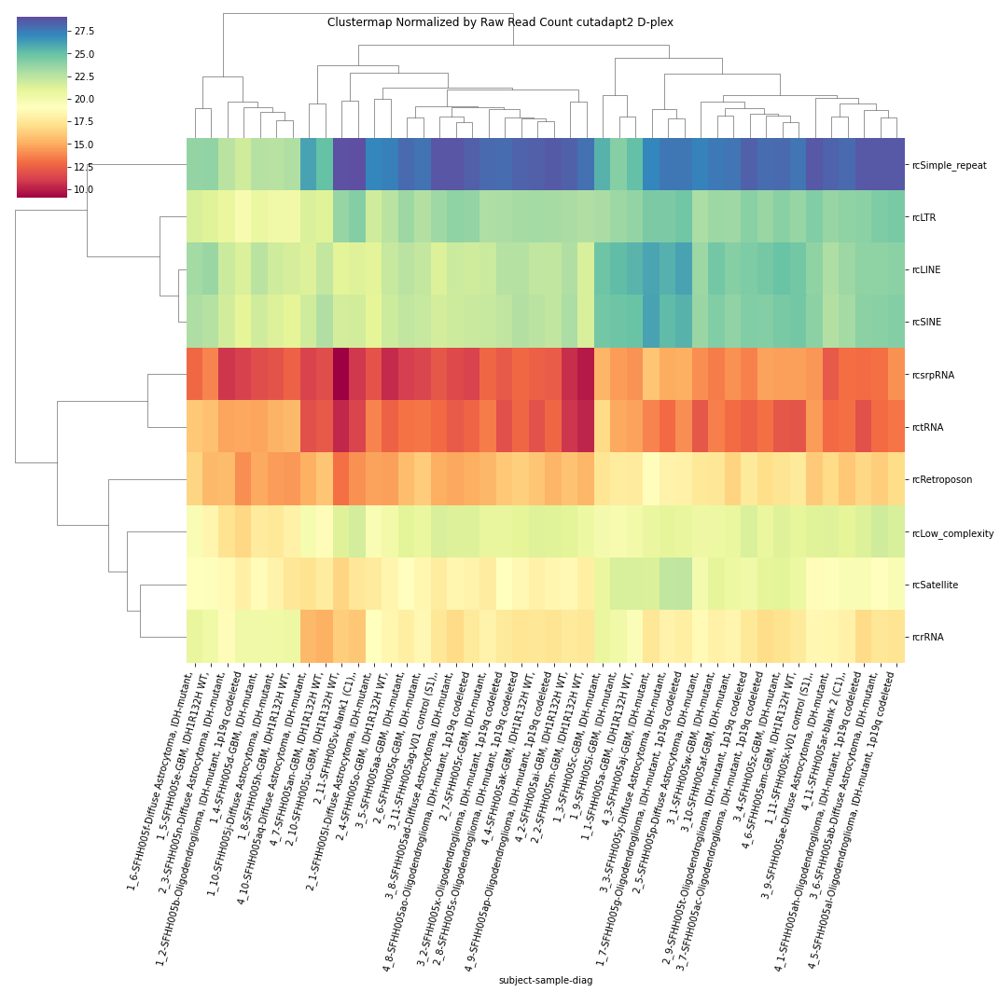

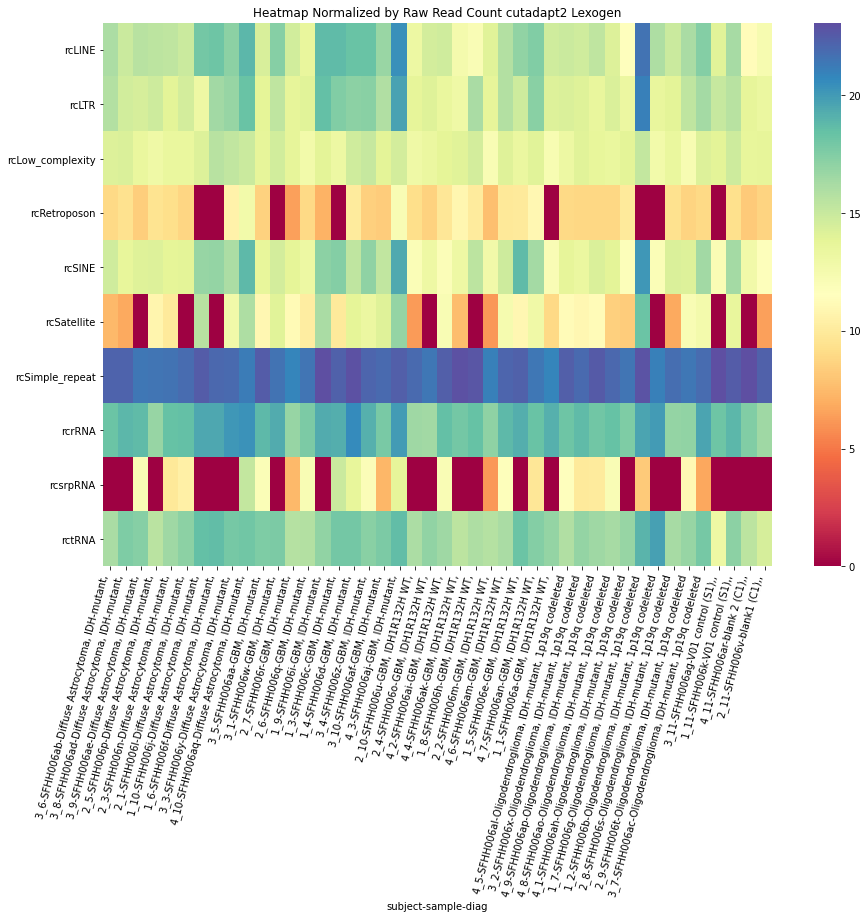

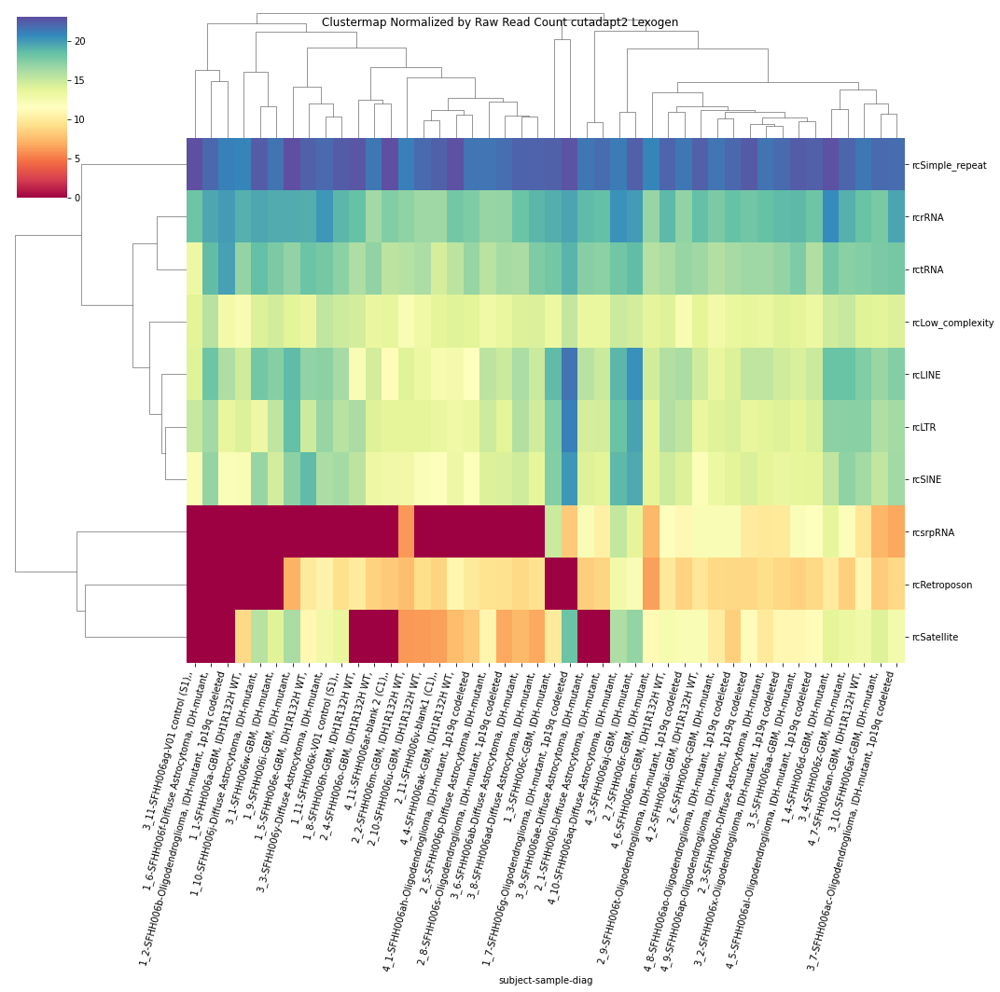

In [66]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap Normalized by Raw Read Count "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap Normalized by Raw Read Count "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rn(G)n D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.5788420197402324
	p = 0.018921672588079988
rn(G)n D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8302945337982837
	p = 0.08381588928816253
rn(G)n D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.5788420197402324
	p = 0.018921672588079988
rn(G)n D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8302945337982837
	p = 0.08381588928816253


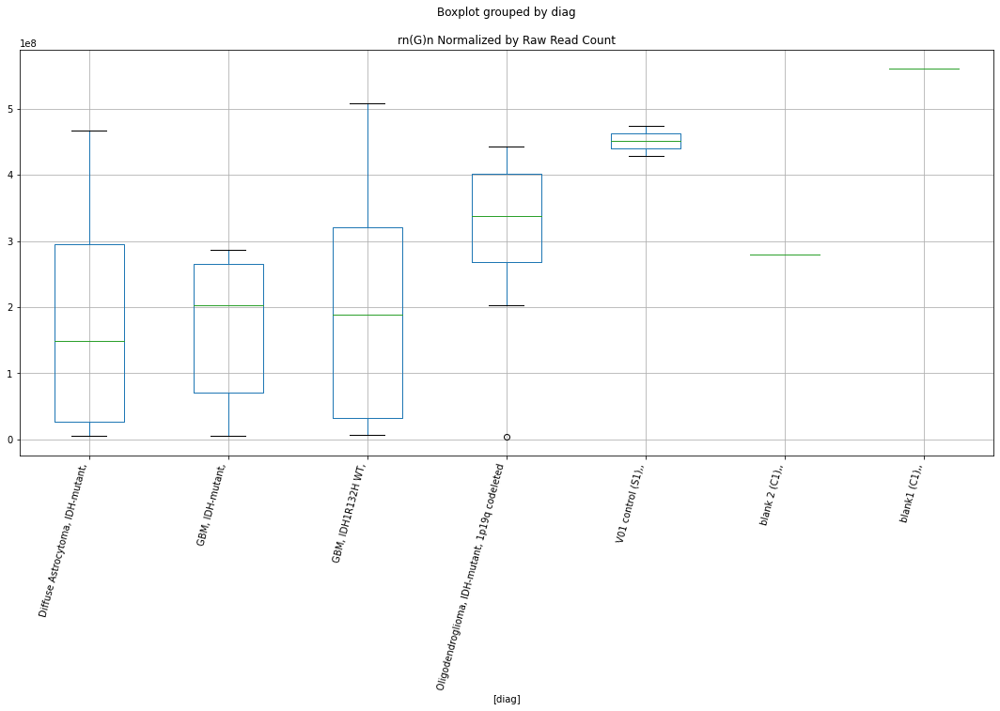

rn(G)n D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.581243223230848
	p = 0.01882659880224181
rn(G)n D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8315811264766786
	p = 0.08361603637486273
rn(G)n D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.581243223230848
	p = 0.01882659880224181
rn(G)n D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8315811264766786
	p = 0.08361603637486273


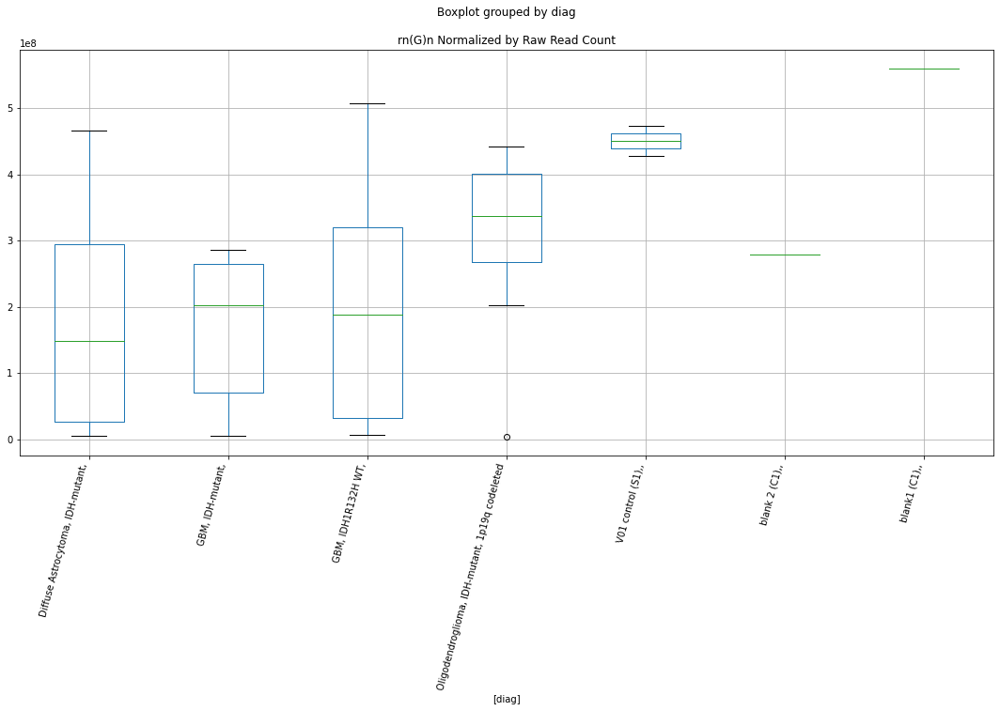

rn(G)n D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.5811371674588526
	p = 0.018830788423806925
rn(G)n D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8314837113757985
	p = 0.08363115369724447
rn(G)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.5811371674588526
	p = 0.018830788423806925
rn(G)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8314837113757985
	p = 0.08363115369724447


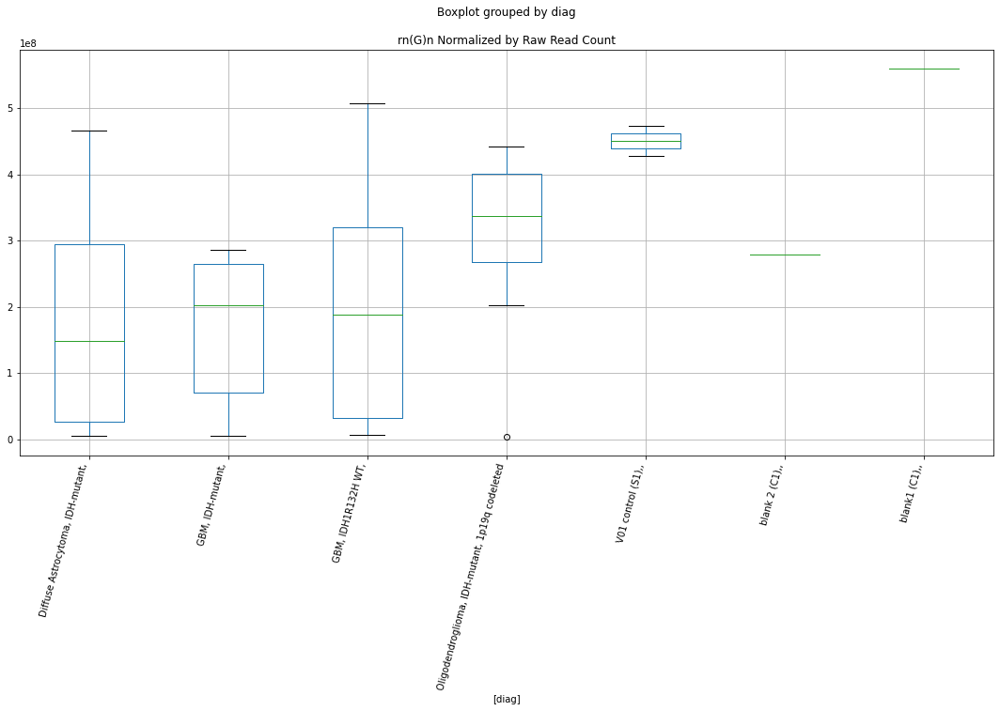

rnMER52A D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.35234429024126
	p = 0.030235634666897947
rnMER52A D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.35234429024126
	p = 0.030235634666897947
rnMER52A D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9963846350938286
	p = 0.061245589780408415
rnMER52A D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9963846350938286
	p = 0.061245589780408415


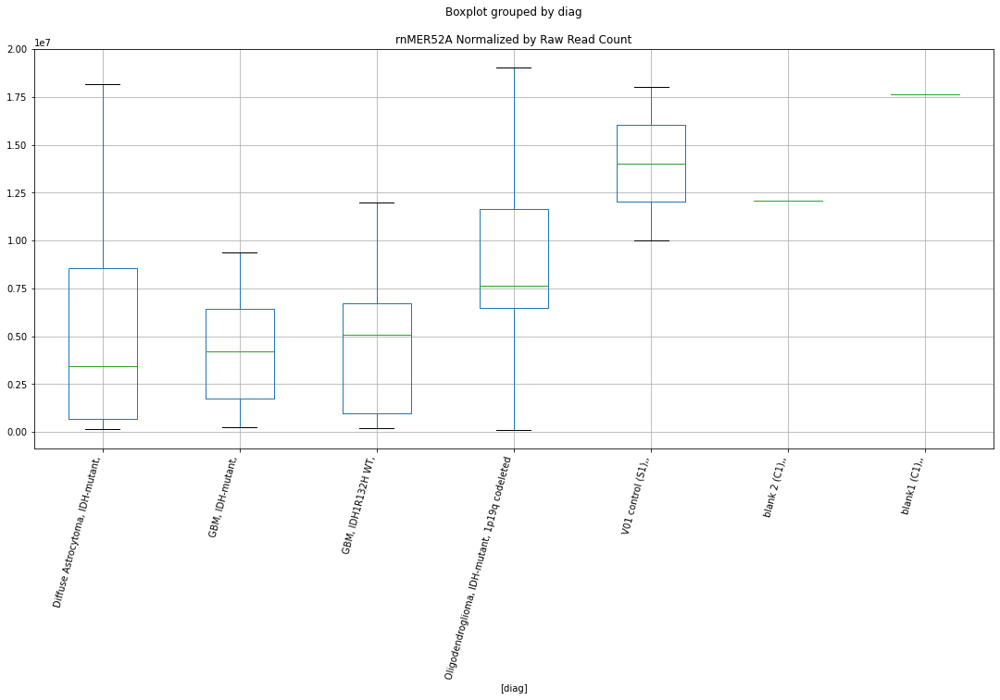

rnMER52A D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.3526210852957496
	p = 0.030218573129836446
rnMER52A D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.3526210852957496
	p = 0.030218573129836446
rnMER52A D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9969476259135959
	p = 0.06117937034080793
rnMER52A D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9969476259135959
	p = 0.06117937034080793


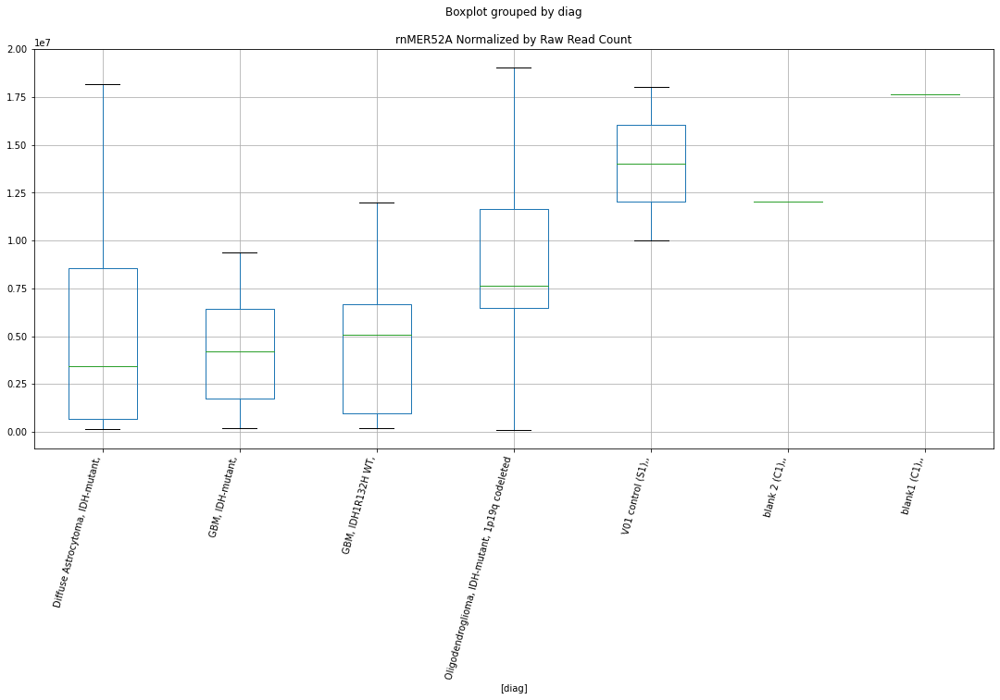

rnMER52A D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.3527785406447292
	p = 0.030208871646383546
rnMER52A D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.3527785406447292
	p = 0.030208871646383546
rnMER52A D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9970068231913292
	p = 0.06117241124556603
rnMER52A D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9970068231913292
	p = 0.06117241124556603


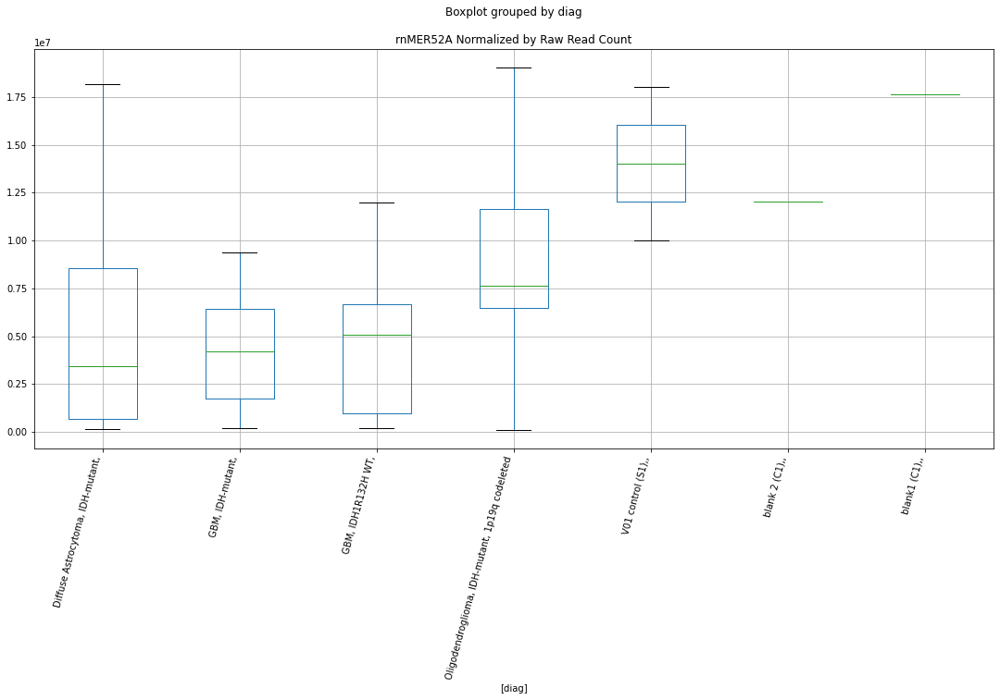

rn(C)n D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.453473838075114
	p = 0.02456648870595418
rn(C)n D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.453473838075114
	p = 0.02456648870595418
rn(C)n D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7613239752536445
	p = 0.09516058574736225
rn(C)n D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7613239752536445
	p = 0.09516058574736225


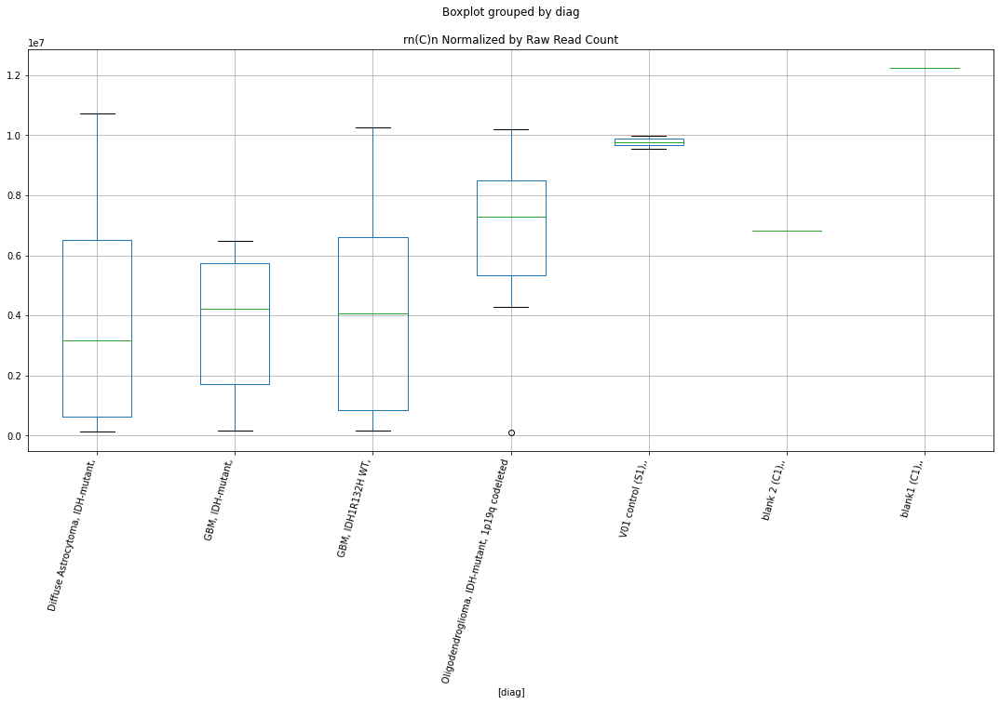

rn(C)n D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.4566412487561062
	p = 0.024406161747246788
rn(C)n D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.4566412487561062
	p = 0.024406161747246788
rn(C)n D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7652044935334632
	p = 0.09448849507544836
rn(C)n D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7652044935334632
	p = 0.09448849507544836


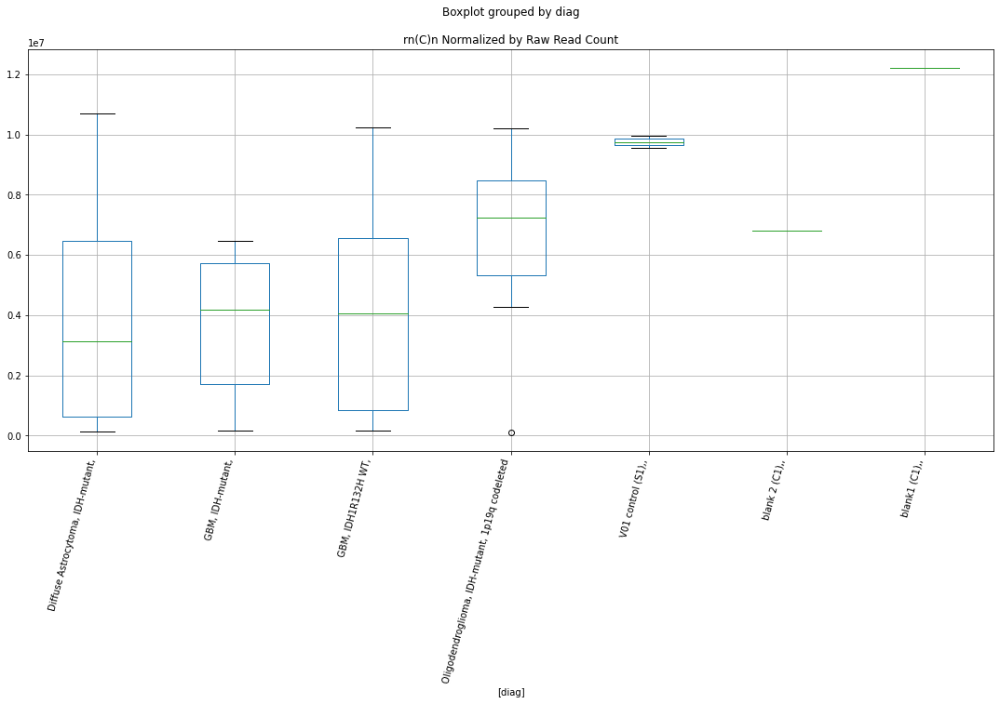

rn(C)n D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.4564850097509527
	p = 0.024414047105566113
rn(C)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.4564850097509527
	p = 0.024414047105566113
rn(C)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.765446750725617
	p = 0.09444667422345786
rn(C)n D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.765446750725617
	p = 0.09444667422345786


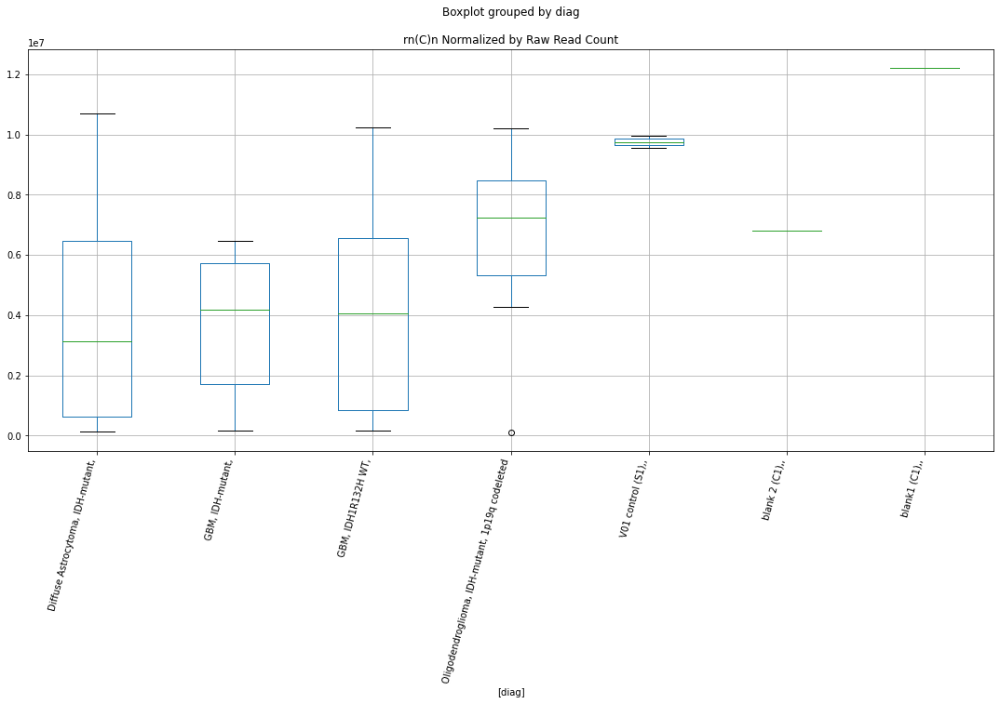

rn(C)n Lexogen cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7824516848183944
	p = 0.091551050799551
rn(C)n Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7824516848183944
	p = 0.091551050799551


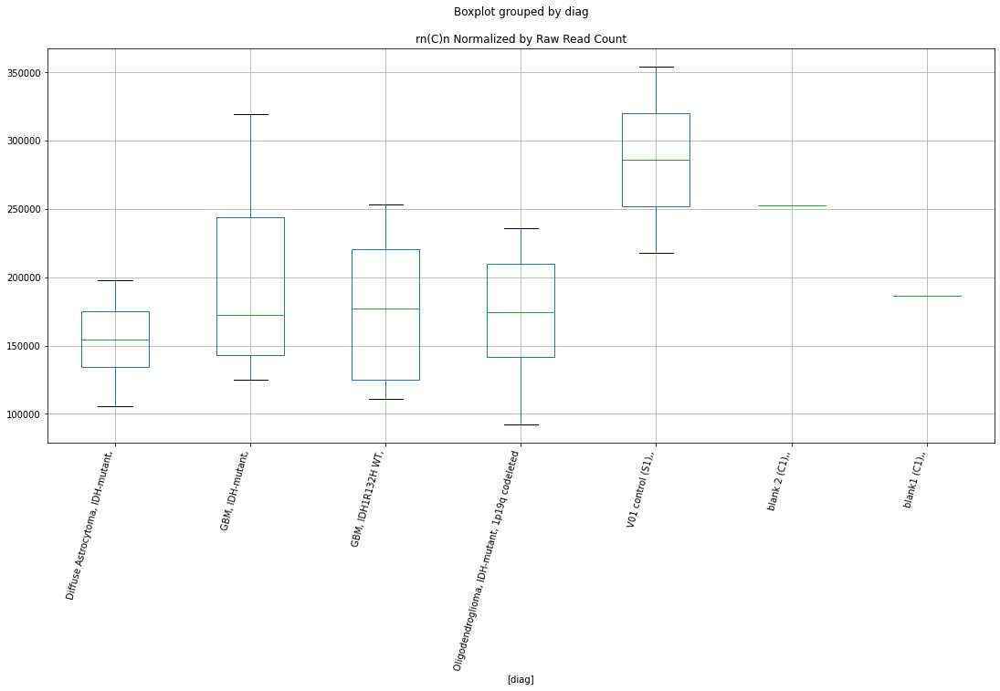

rnAluY D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0948251081536307
	p = 0.05060056403913559
rnAluY D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0948251081536307
	p = 0.05060056403913559


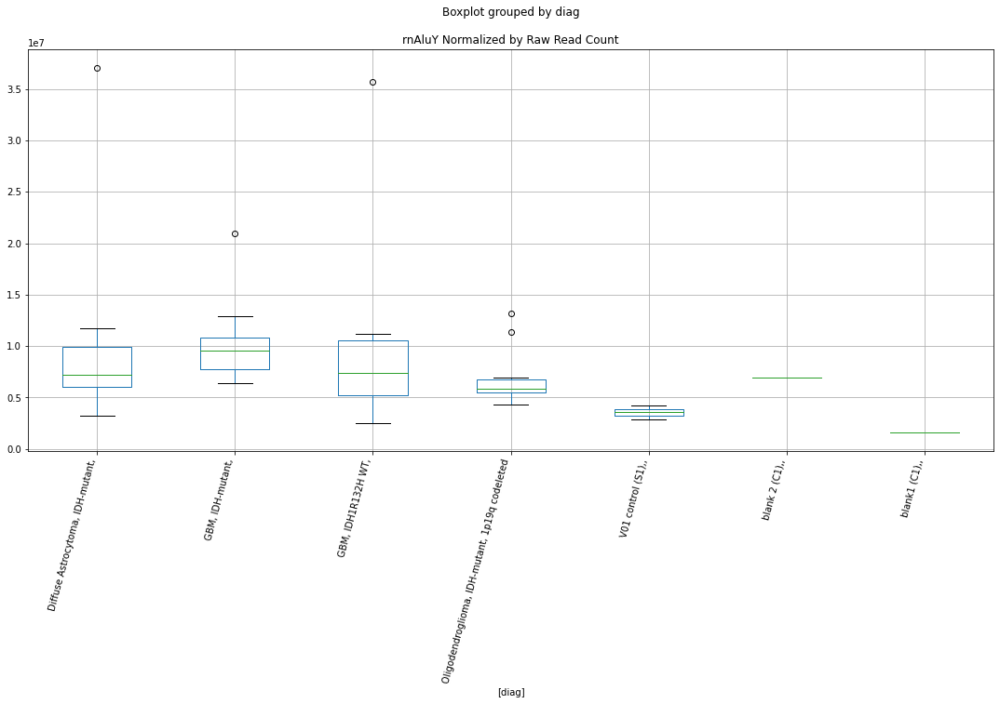

rnAluY D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1229563728194205
	p = 0.04788320820935914
rnAluY D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1229563728194205
	p = 0.04788320820935914


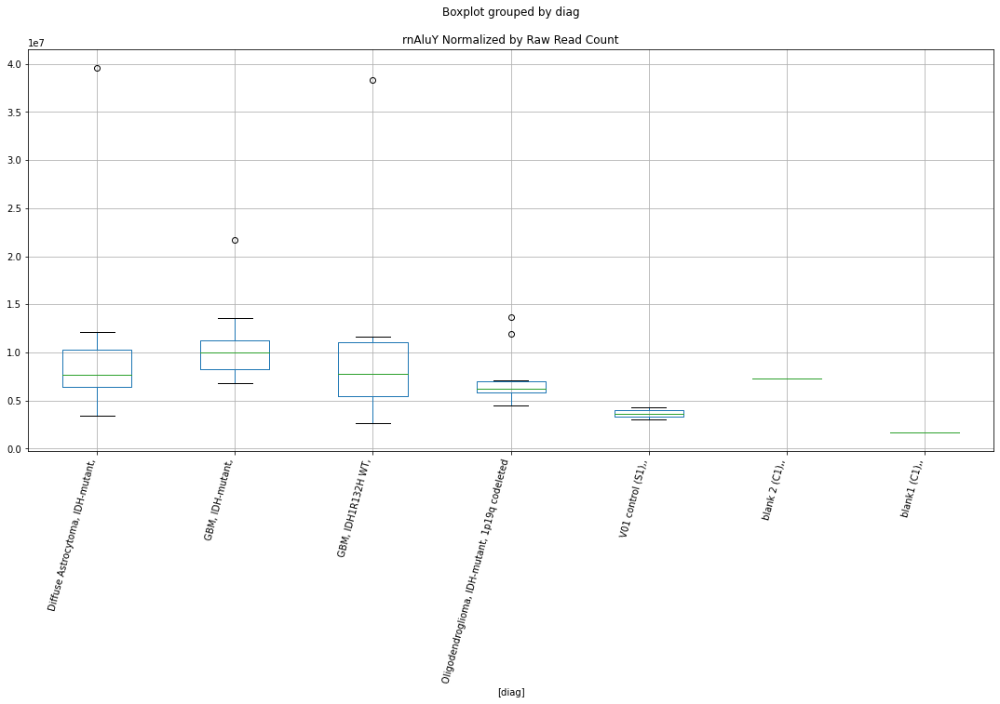

rnAluSz D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.919050603599993
	p = 0.07097554379830183
rnAluSz D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.919050603599993
	p = 0.07097554379830183


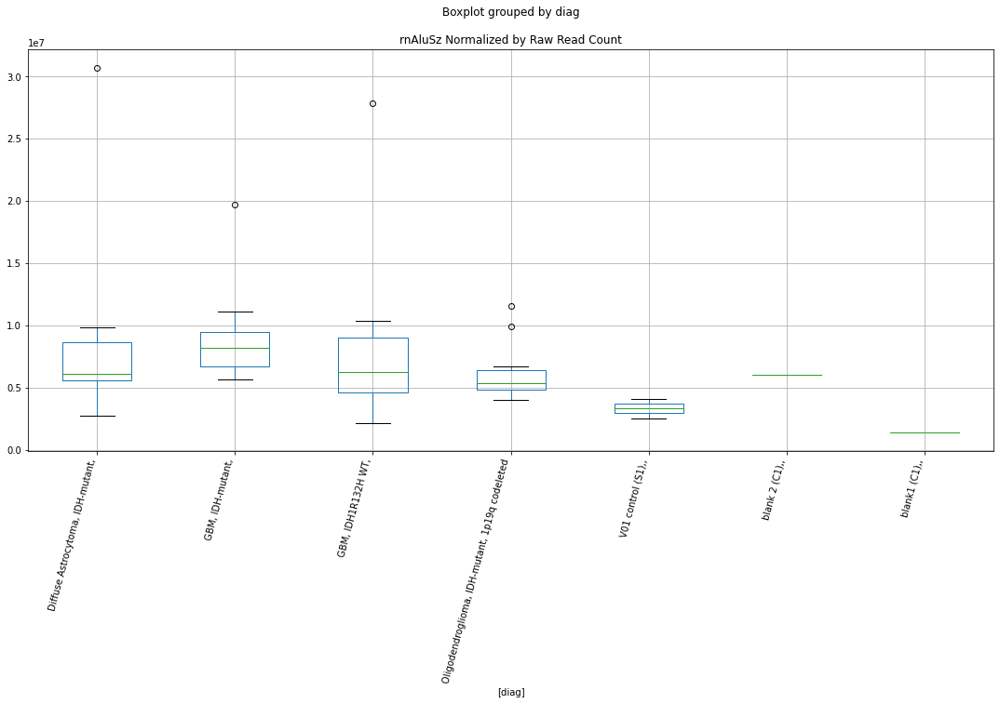

rnAluSz D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9635038126127282
	p = 0.06522639146843275
rnAluSz D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9635038126127282
	p = 0.06522639146843275


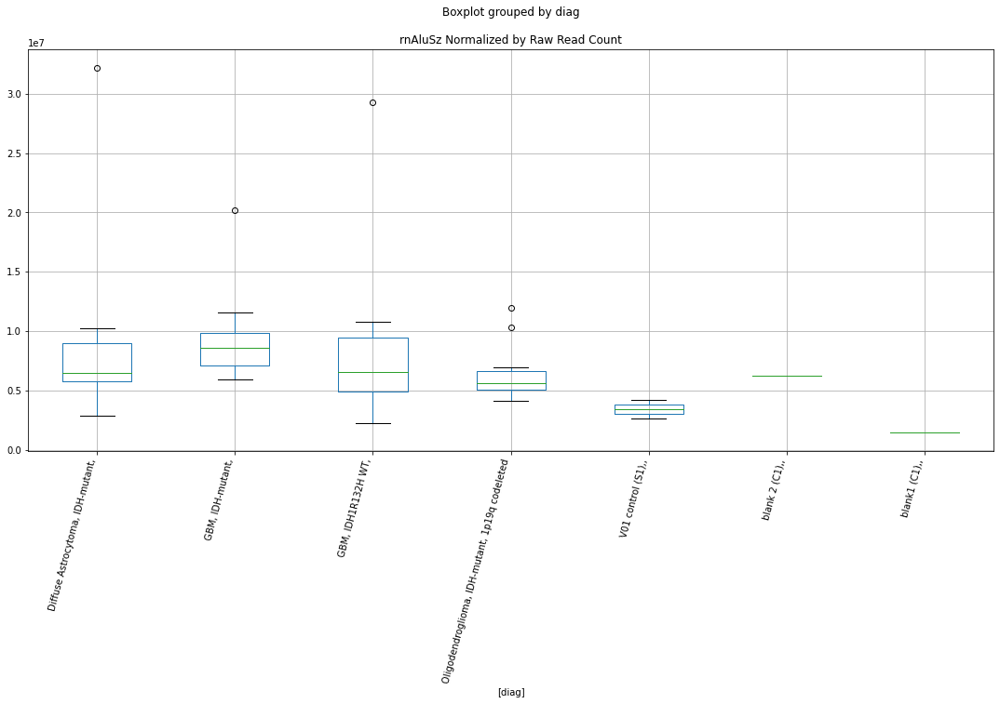

rn(T)n D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.313851105805985
	p = 0.003861393130089928
rn(T)n D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0186442052917357
	p = 0.058675905716285746
rn(T)n D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.060310941811547
	p = 0.05412544857342482
rn(T)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.313851105805985
	p = 0.003861393130089928
rn(T)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.060310941811547
	p = 0.05412544857342482
rn(T)n D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0186442052917357
	p = 0.058675905716285746


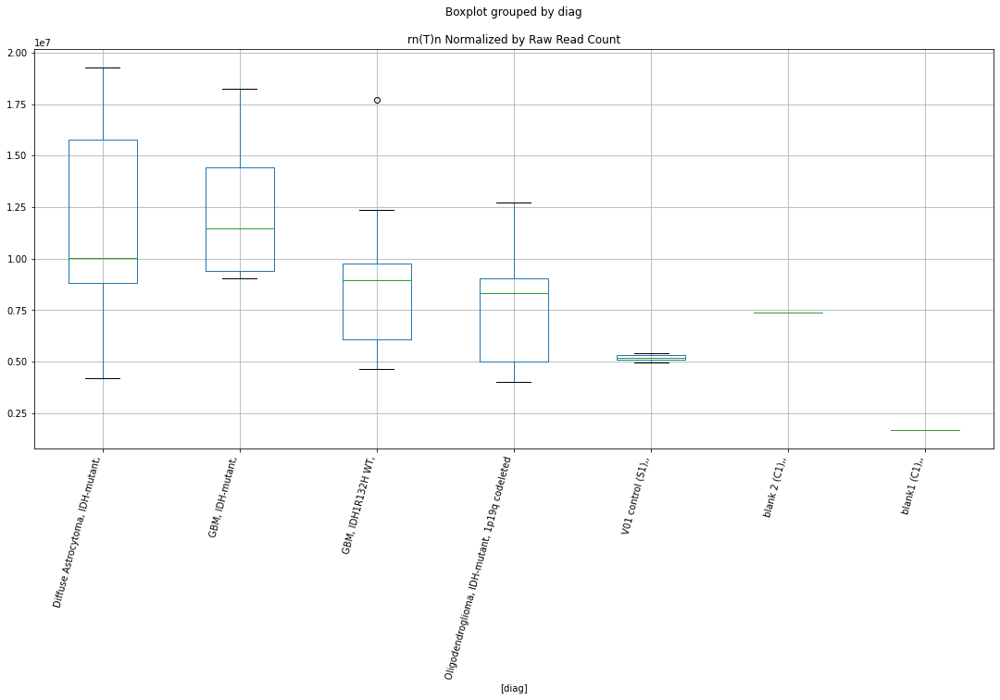

rn(T)n D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.33498217718597
	p = 0.003685267619581355
rn(T)n D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9998119560641578
	p = 0.06084346018884823
rn(T)n D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0666475988343223
	p = 0.05346208178529026
rn(T)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.33498217718597
	p = 0.003685267619581355
rn(T)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0666475988343223
	p = 0.05346208178529026
rn(T)n D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9998119560641578
	p = 0.06084346018884823


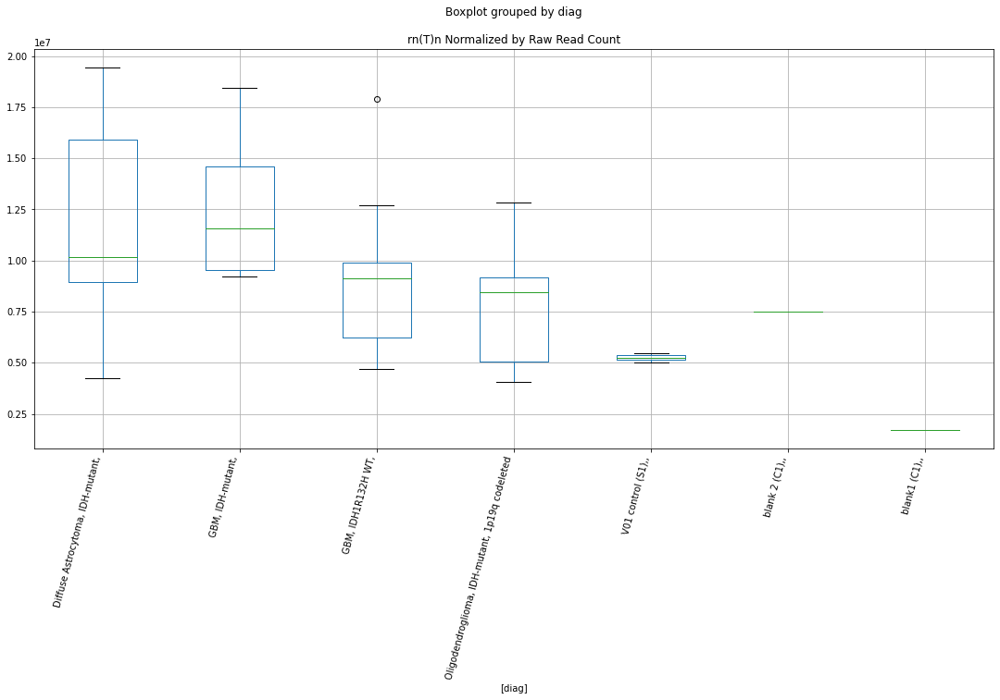

rnAluJb D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3817064599847093
	p = 0.028474943540815673
rnAluJb D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9546120968607301
	p = 0.06634192899900562
rnAluJb D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3817064599847093
	p = 0.028474943540815673
rnAluJb D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9546120968607301
	p = 0.06634192899900562


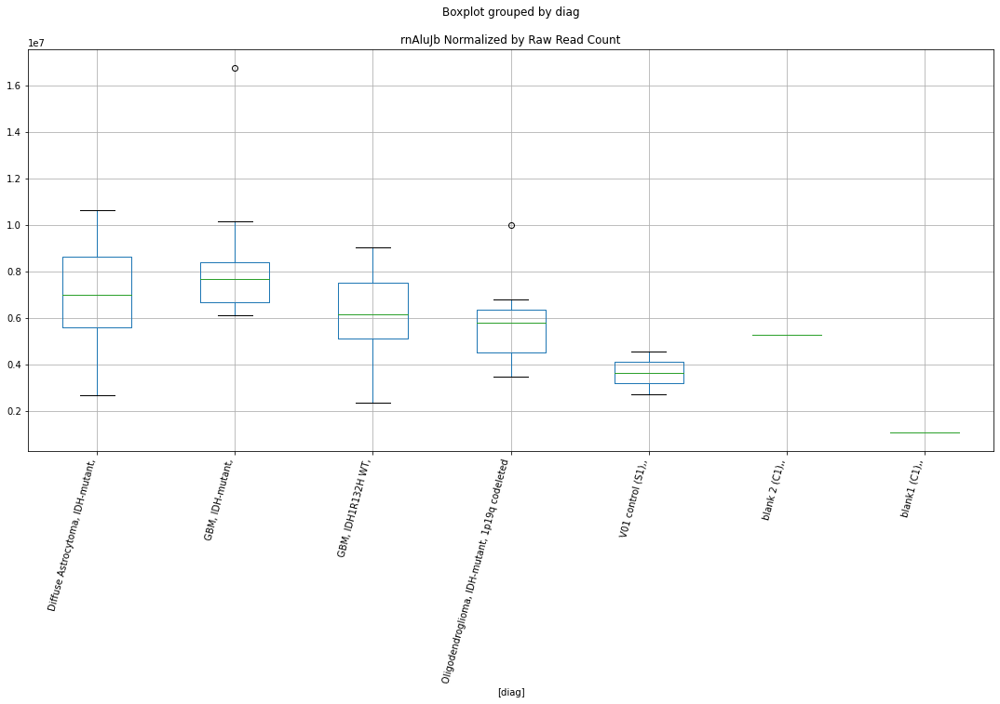

rnAluJb D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.466066652405812
	p = 0.023934864512267534
rnAluJb D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.944012500476041
	p = 0.06769397602999709
rnAluJb D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.466066652405812
	p = 0.023934864512267534
rnAluJb D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.944012500476041
	p = 0.06769397602999709


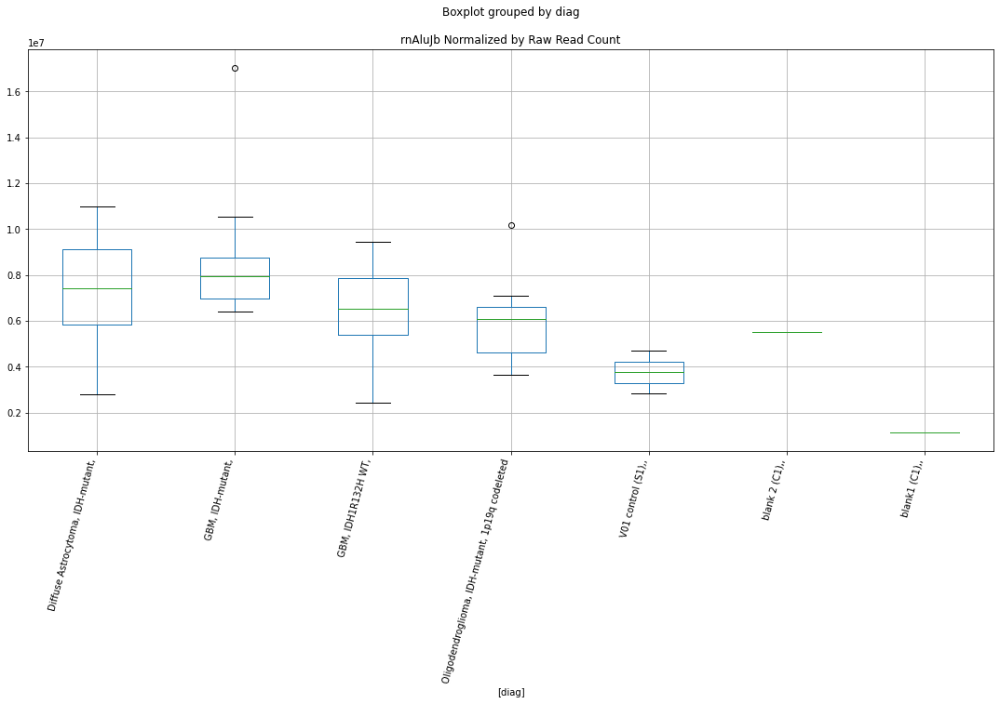

rnAluSx D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7610804234151387
	p = 0.09520290614456269
rnAluSx D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7610804234151387
	p = 0.09520290614456269


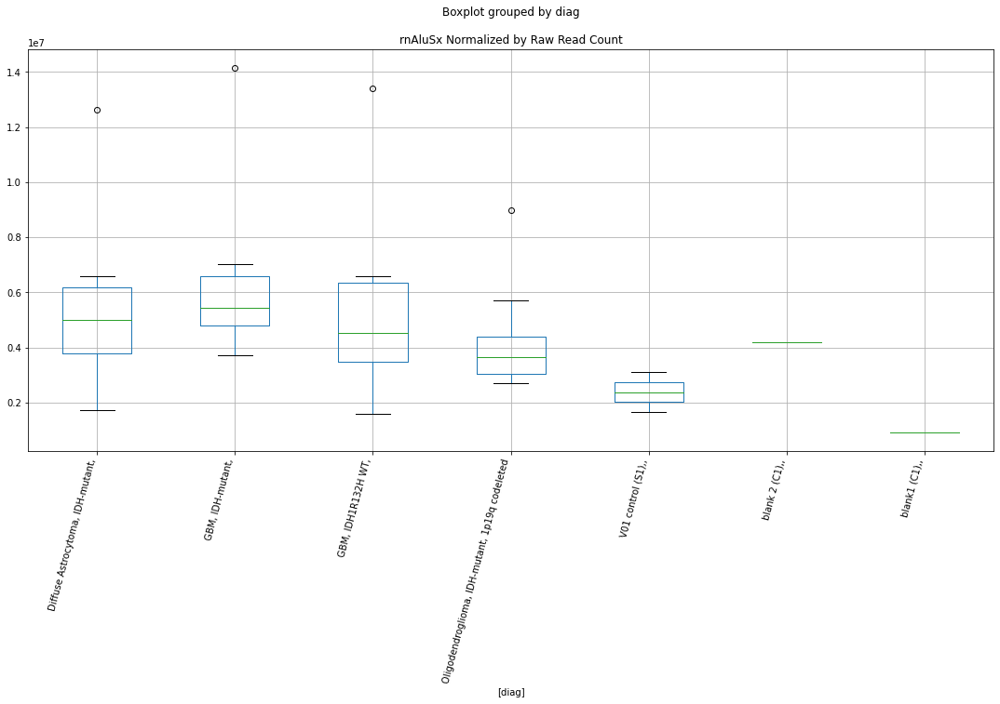

rnAluSx1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0099772155116384
	p = 0.0596646791271669
rnAluSx1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0099772155116384
	p = 0.0596646791271669


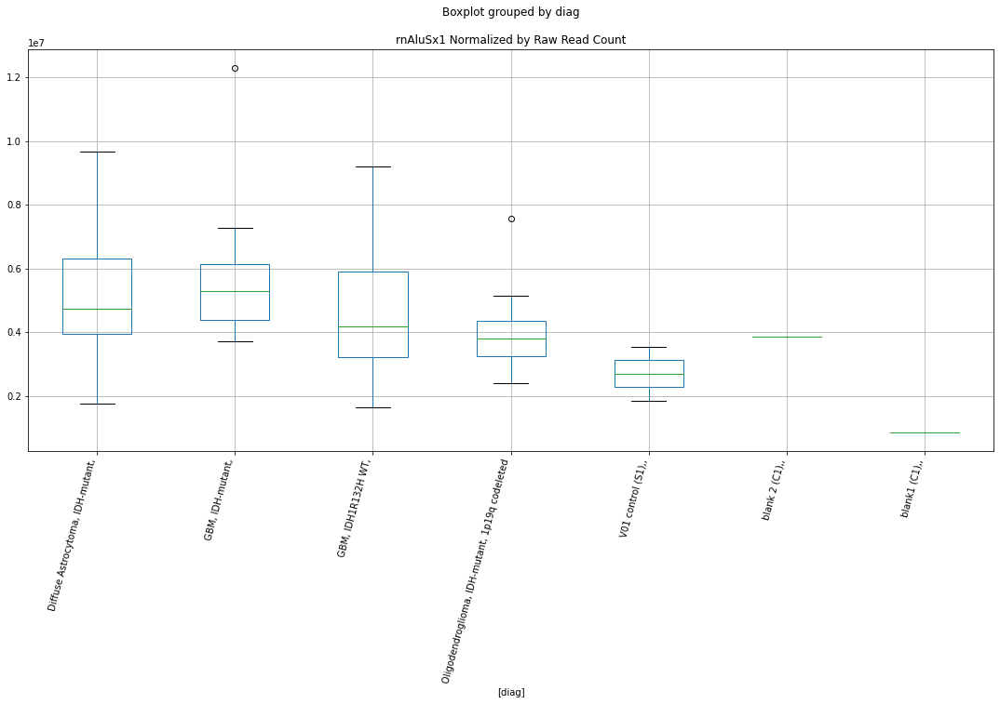

rnAluSx1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0809314698382004
	p = 0.05199367010711927
rnAluSx1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0809314698382004
	p = 0.05199367010711927


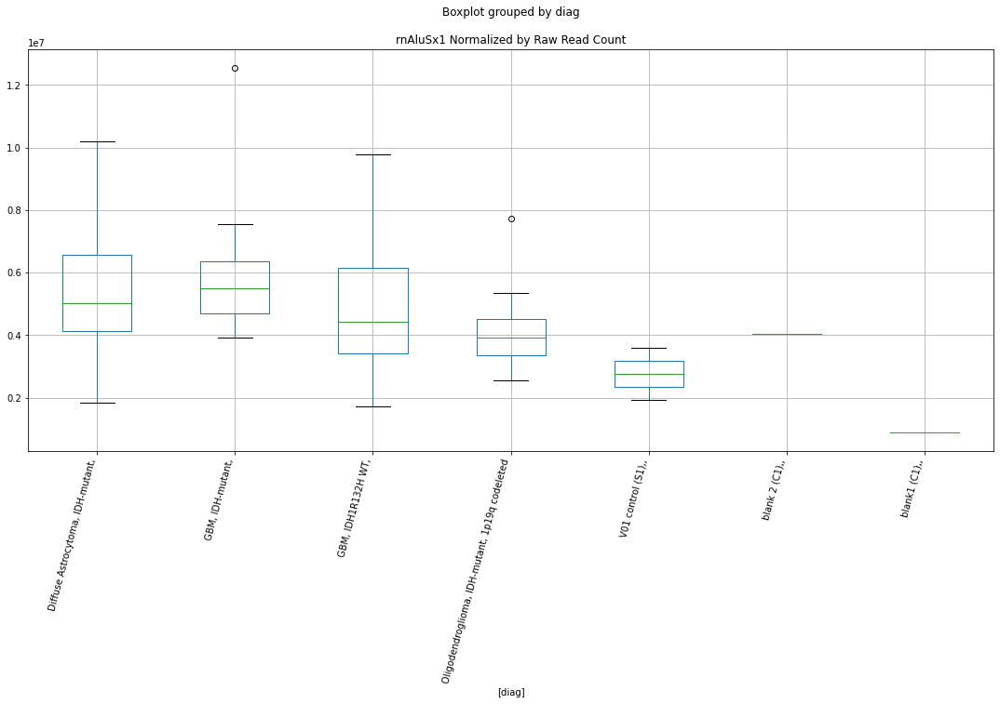

rnL1P4 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1073779415945233
	p = 0.04937114506351402
rnL1P4 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1073779415945233
	p = 0.04937114506351402


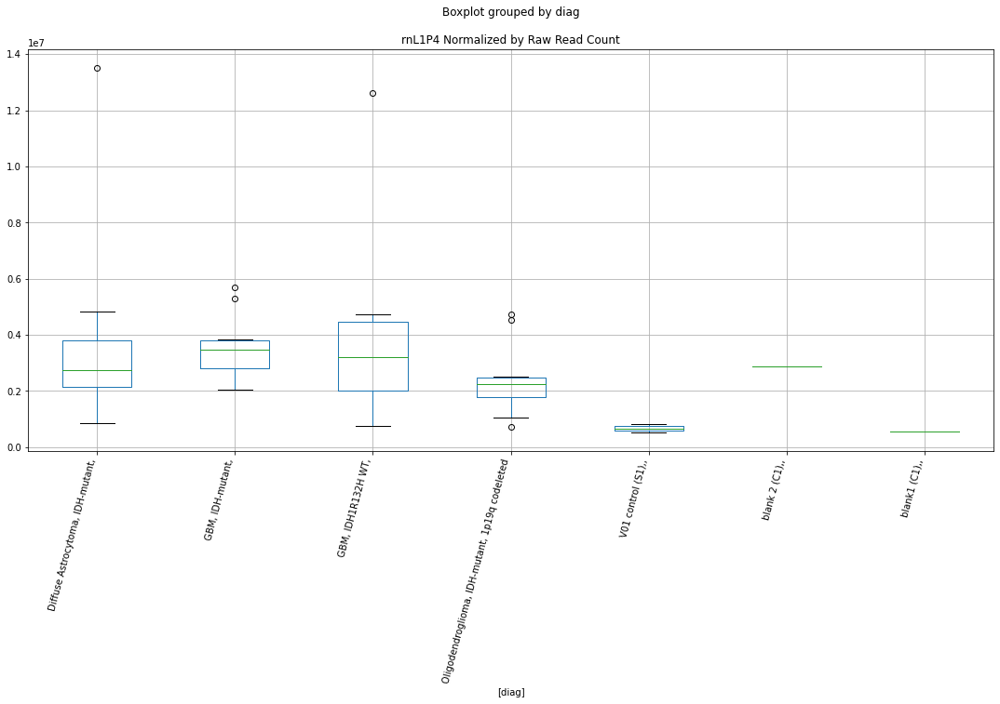

rnL1P4 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1921363223163173
	p = 0.04175743022203969
rnL1P4 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1921363223163173
	p = 0.04175743022203969


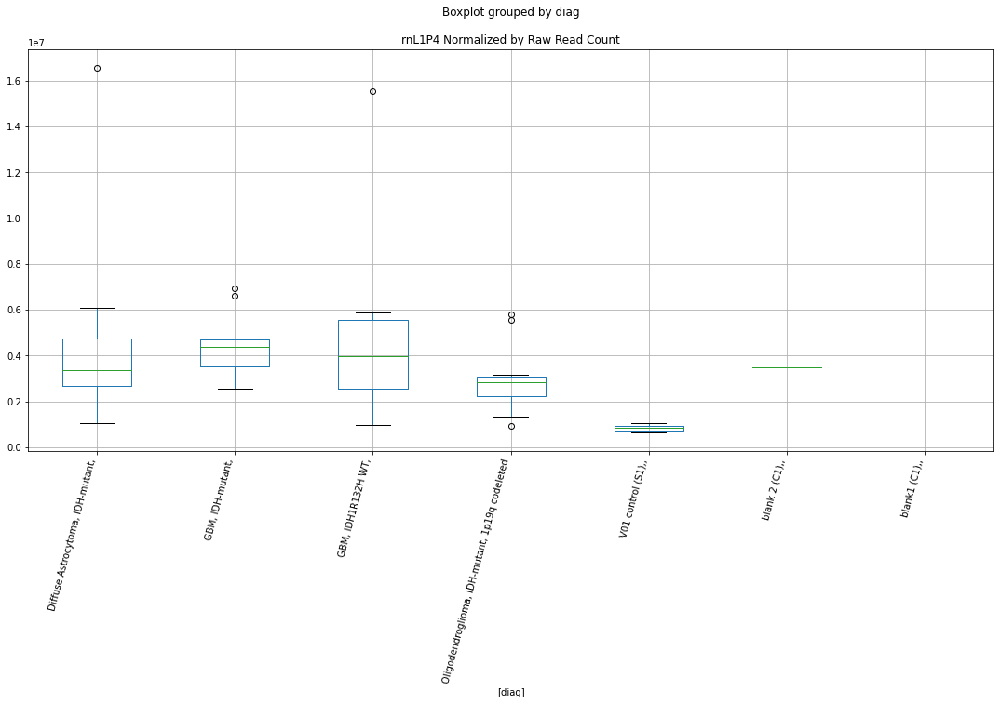

rnAluSq2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3039261222114313
	p = 0.03336191691751847
rnAluSq2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3039261222114313
	p = 0.03336191691751847


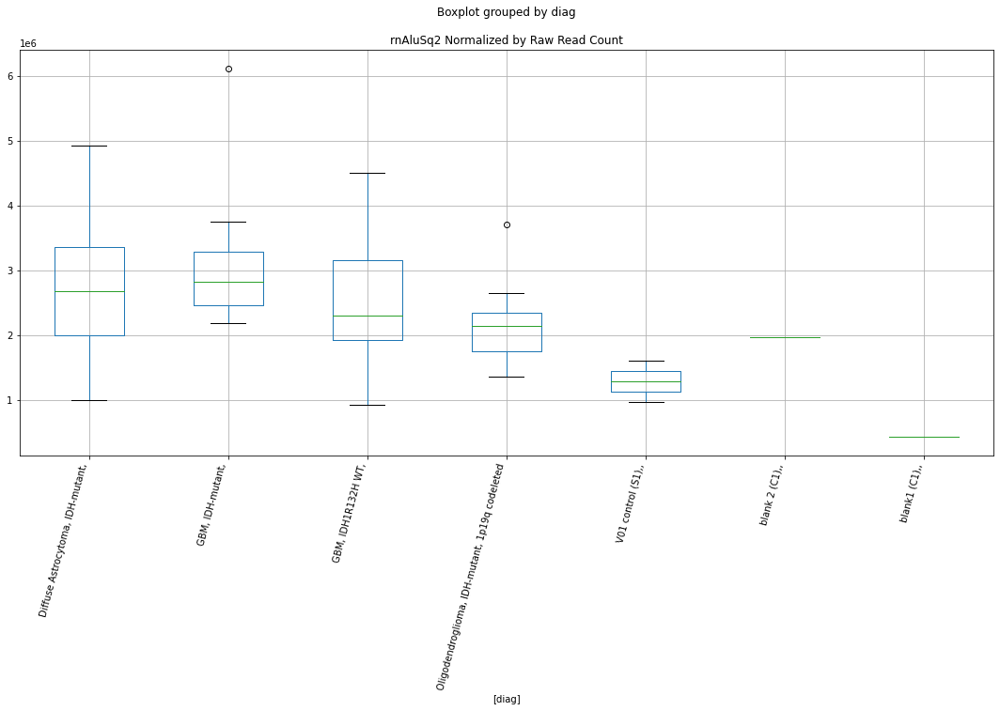

rnAluSq2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3713064273938325
	p = 0.02908733908273442
rnAluSq2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3713064273938325
	p = 0.02908733908273442


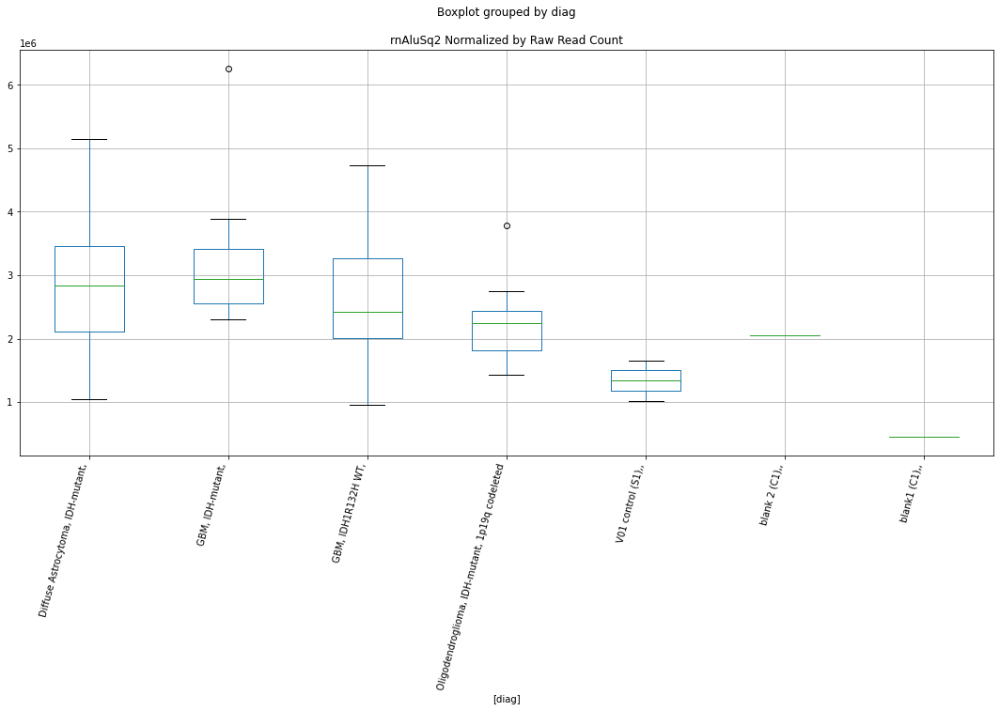

rnL2a D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7385992344933745
	p = 0.09918033006170697
rnL2a D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7385992344933745
	p = 0.09918033006170697


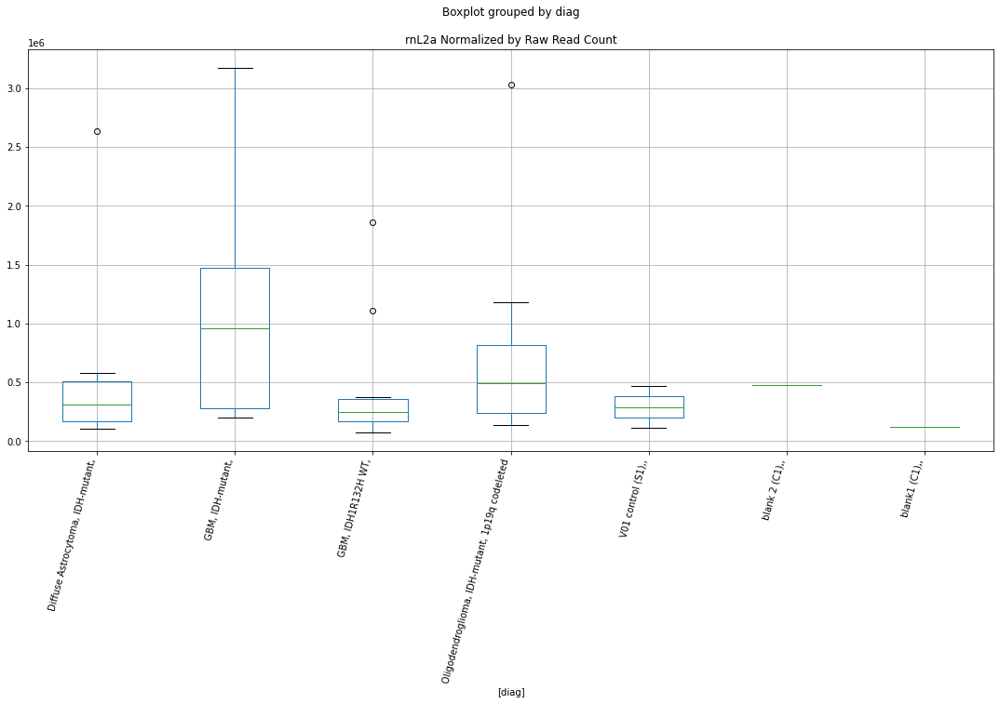

rnAluSp D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.003433936978054
	p = 0.060421070223269535
rnAluSp D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1936928938983224
	p = 0.04162825396939898
rnAluSp D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.003433936978054
	p = 0.060421070223269535
rnAluSp D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1936928938983224
	p = 0.04162825396939898


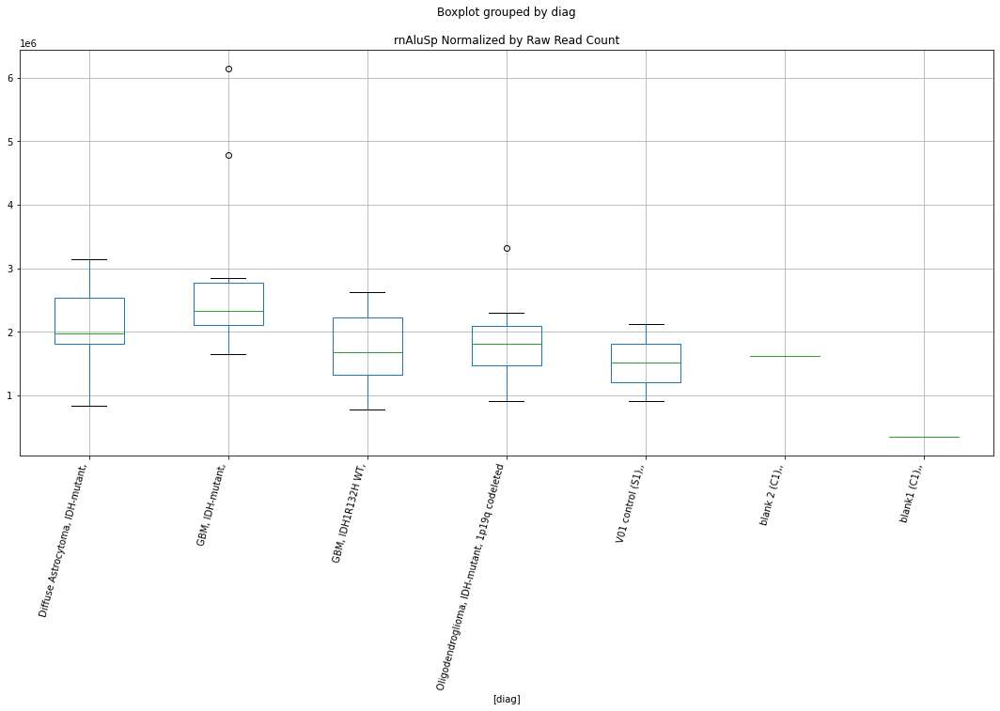

rnAluSp D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.026916113973686
	p = 0.05774599045398568
rnAluSp D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1915130000317857
	p = 0.04180926135475164
rnAluSp D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.026916113973686
	p = 0.05774599045398568
rnAluSp D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1915130000317857
	p = 0.04180926135475164


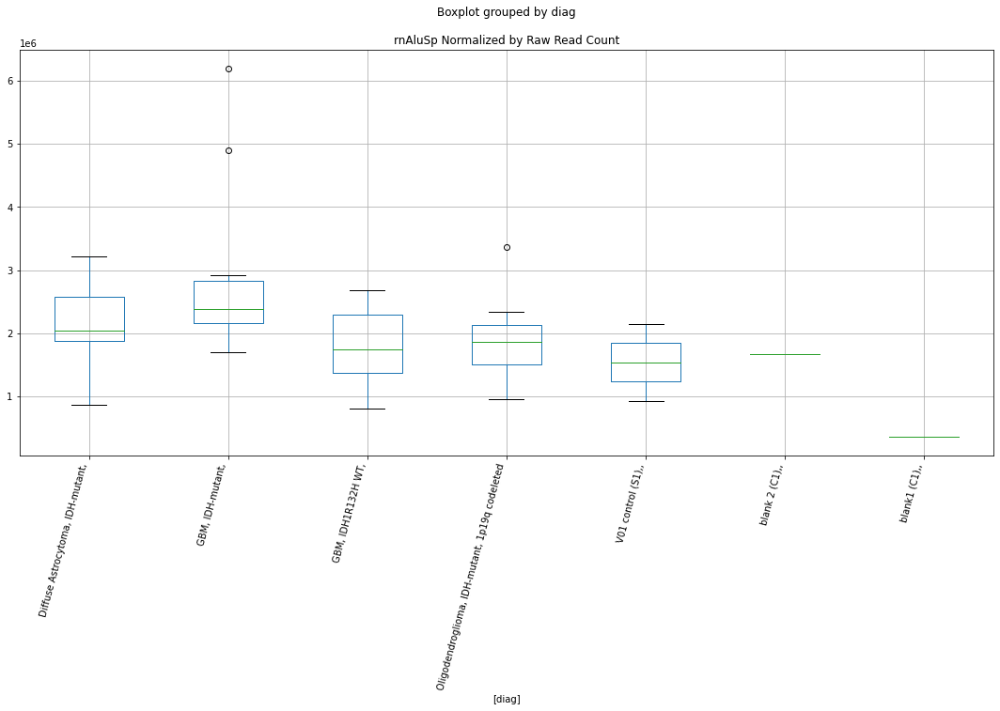

rnG-rich D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.014897648174219
	p = 0.0591015075885918
rnG-rich D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.014897648174219
	p = 0.0591015075885918


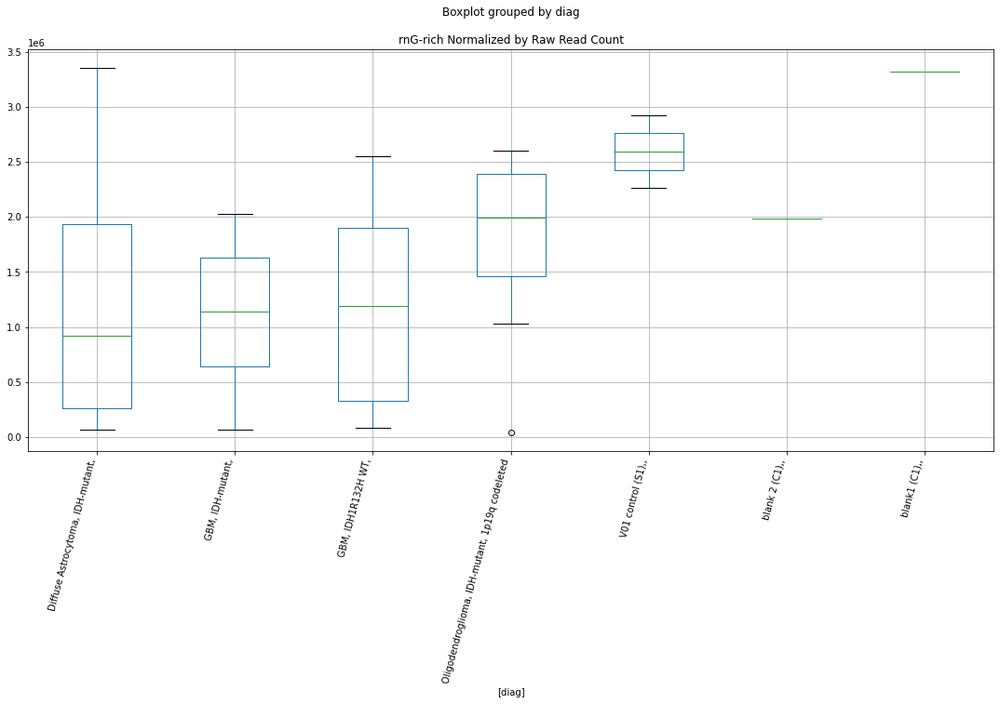

rnG-rich D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.015154346662725
	p = 0.0590722586981471
rnG-rich D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.015154346662725
	p = 0.0590722586981471


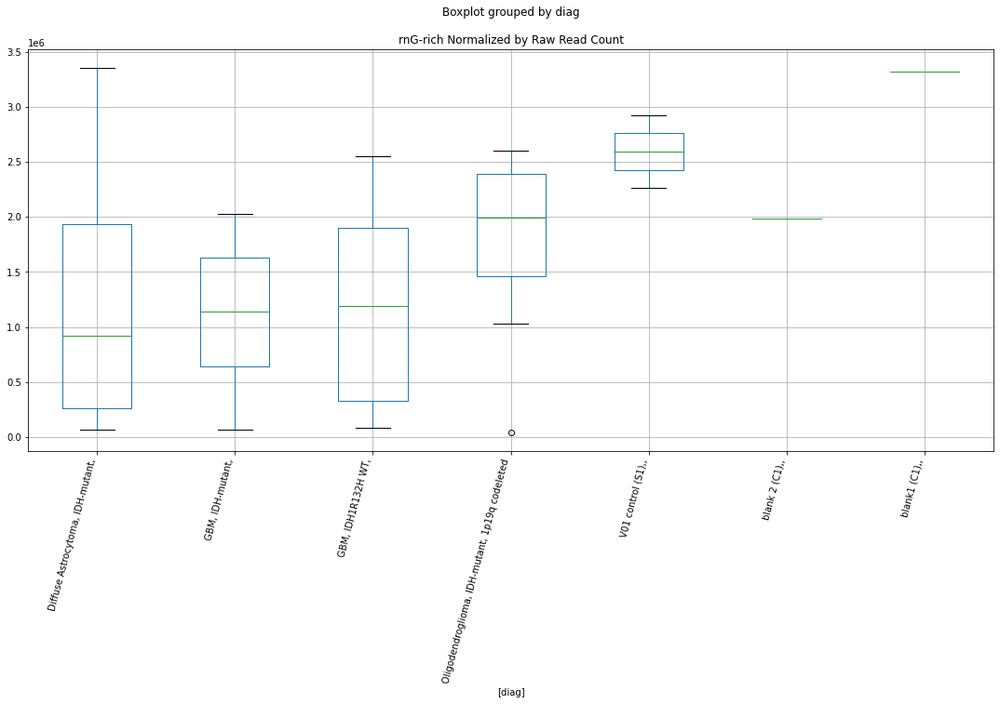

rnG-rich D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0151427229420364
	p = 0.05907358285333698
rnG-rich D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0151427229420364
	p = 0.05907358285333698


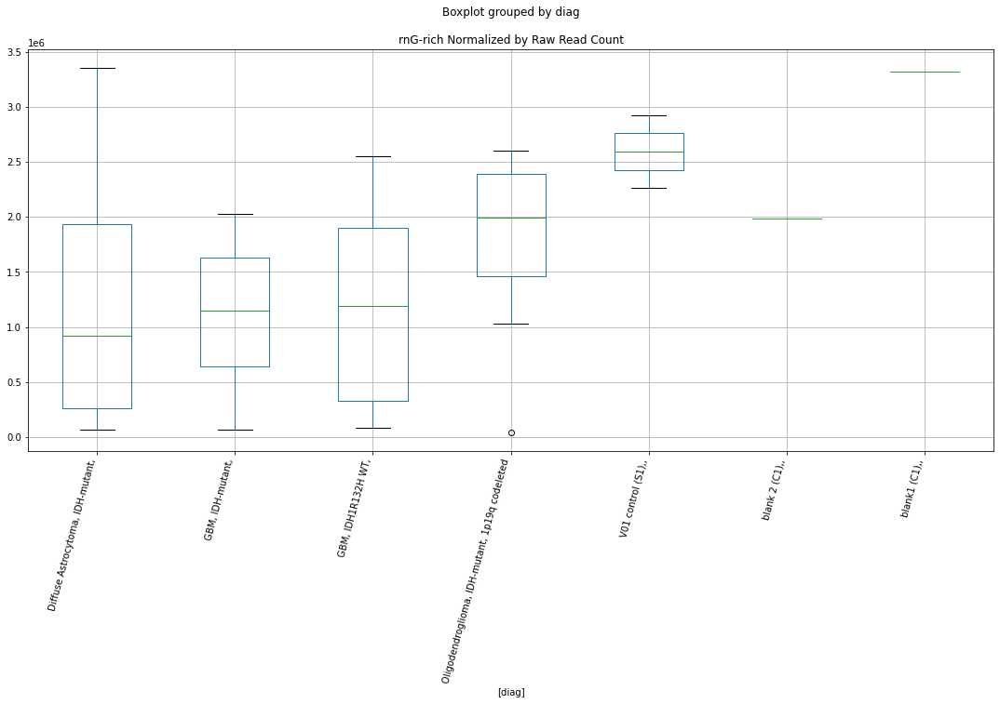

rnG-rich Lexogen cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9057611426663845
	p = 0.07277970084232381
rnG-rich Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9057611426663845
	p = 0.07277970084232381


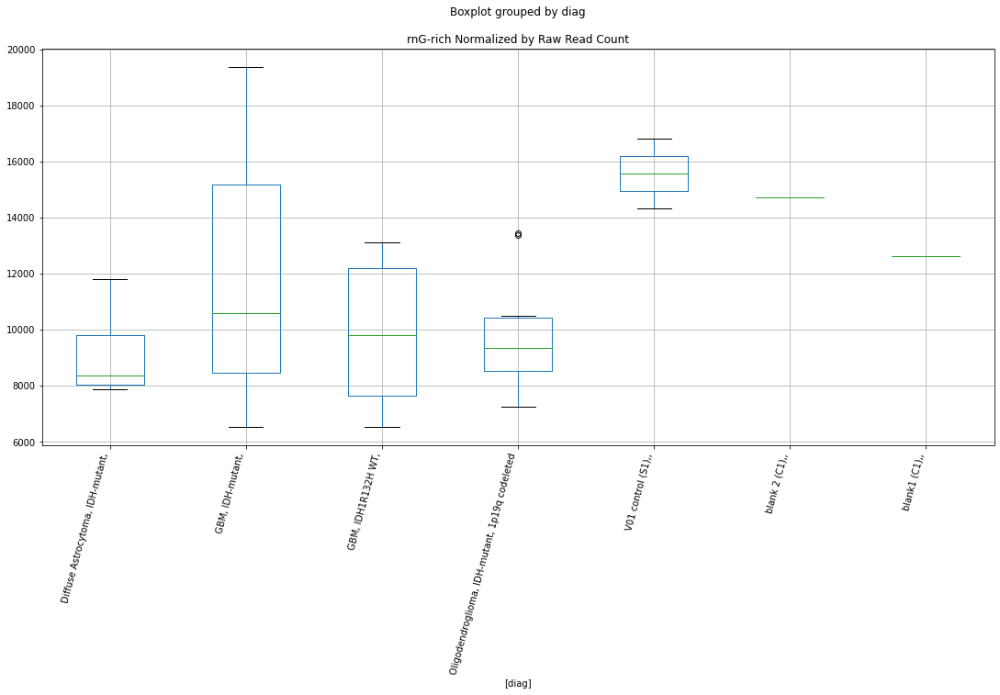

rn(A)n D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.839375786953253
	p = 0.0012012202306568634
rn(A)n D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3151114355738356
	p = 0.032614126911744756
rn(A)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.839375786953253
	p = 0.0012012202306568634
rn(A)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.3151114355738356
	p = 0.032614126911744756


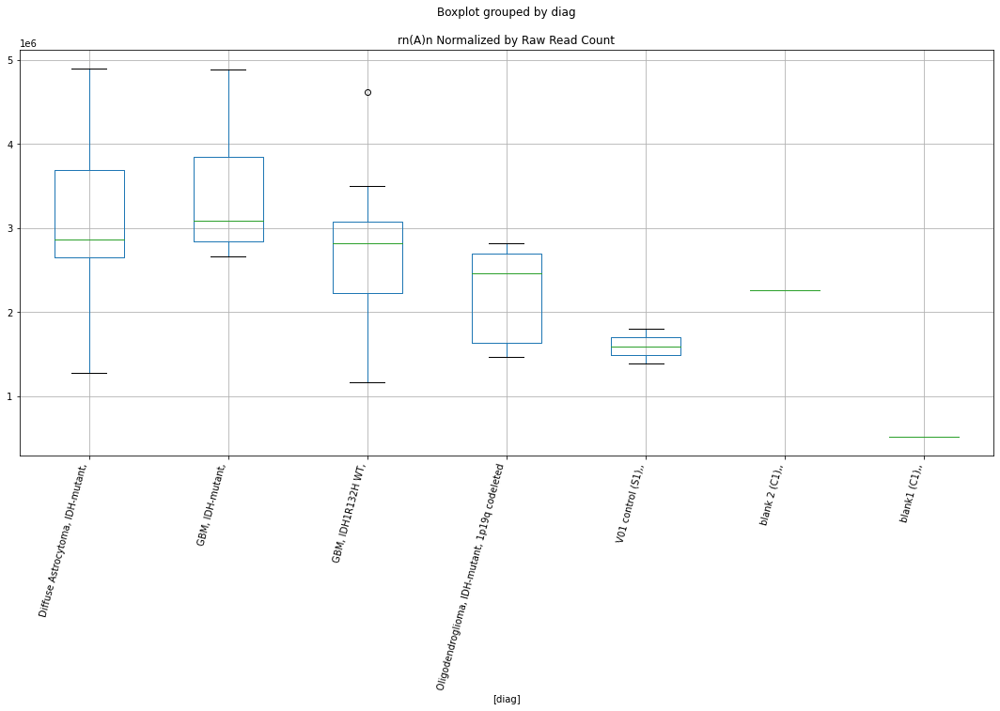

rn(A)n D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.9599270868368546
	p = 0.0009182432609490705
rn(A)n D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3067734613572055
	p = 0.03317006446000151
rn(A)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.9599270868368546
	p = 0.0009182432609490705
rn(A)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.3067734613572055
	p = 0.03317006446000151


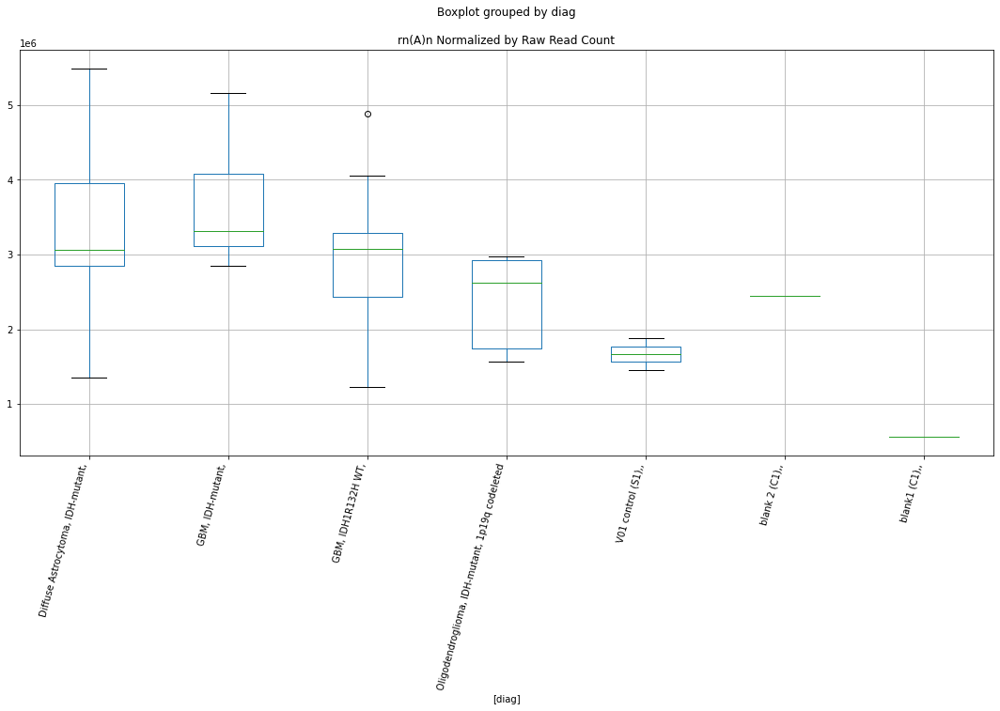

rnAluSg D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.0236039165764086
	p = 0.007300604671655271
rnAluSg D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7626902588590347
	p = 0.0949234785106549
rnAluSg D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8127414930510672
	p = 0.08658465575229347
rnAluSg D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.0236039165764086
	p = 0.007300604671655271
rnAluSg D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8127414930510672
	p = 0.08658465575229347
rnAluSg D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7626902588590347
	p = 0.0949234785106549


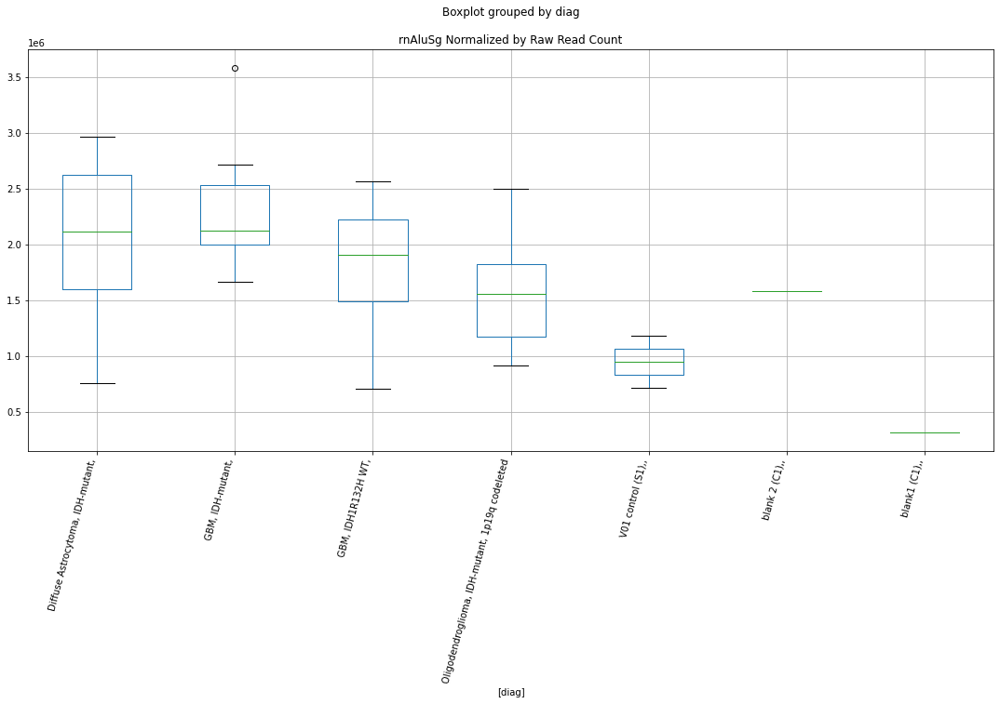

rnAluSg D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.180729583933331
	p = 0.00517713058589096
rnAluSg D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8441120611759576
	p = 0.08169133236263014
rnAluSg D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.180729583933331
	p = 0.00517713058589096
rnAluSg D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8441120611759576
	p = 0.08169133236263014


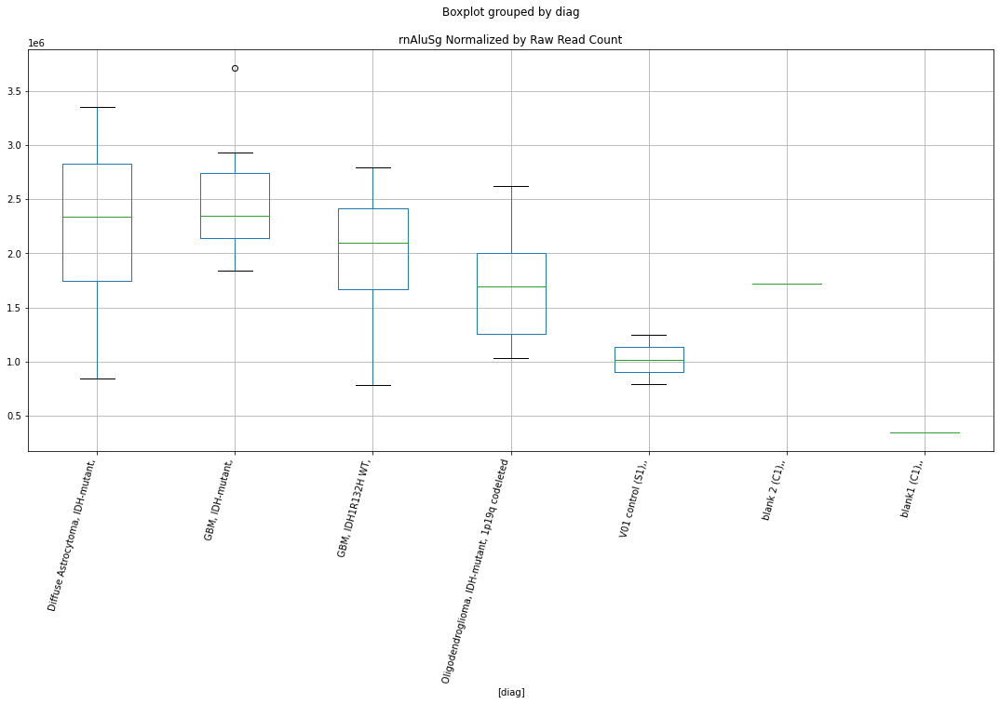

rnAluSx3 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.746734278588891
	p = 0.013264428007484964
rnAluSx3 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0519792016458878
	p = 0.05500900638400938
rnAluSx3 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.746734278588891
	p = 0.013264428007484964
rnAluSx3 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0519792016458878
	p = 0.05500900638400938


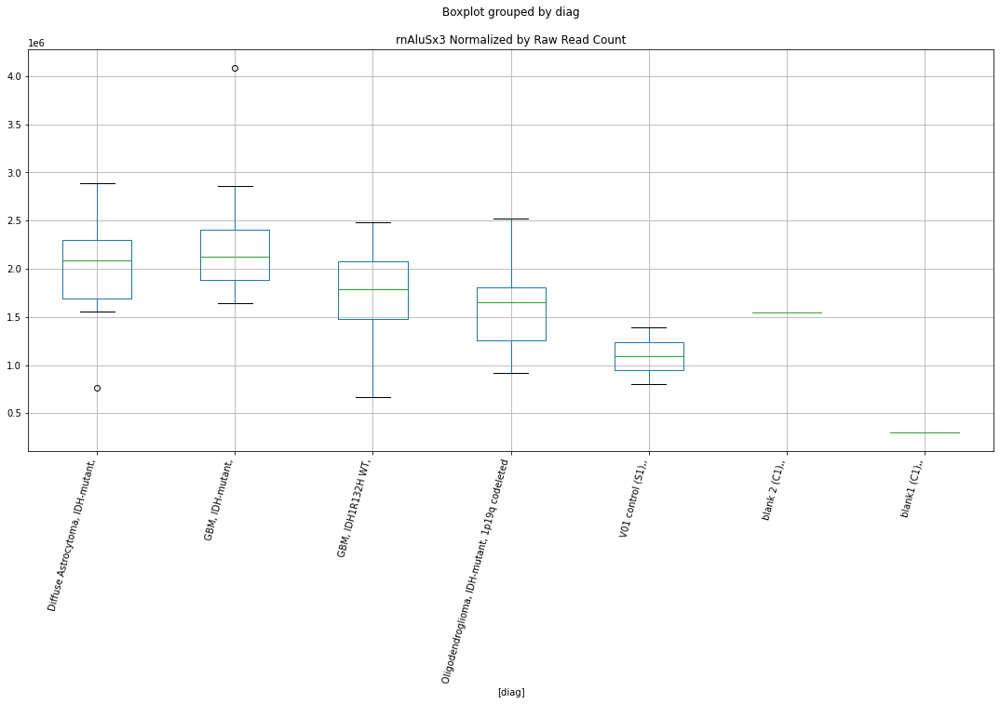

rnAluSx3 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.9286580181988455
	p = 0.008971922065053598
rnAluSx3 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0413987201951516
	p = 0.05614981863081837
rnAluSx3 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.812655828281687
	p = 0.08659836244685343
rnAluSx3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.9286580181988455
	p = 0.008971922065053598
rnAluSx3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.812655828281687
	p = 0.08659836244685343
rnAluSx3 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0413987201951516
	p = 0.05614981863081837


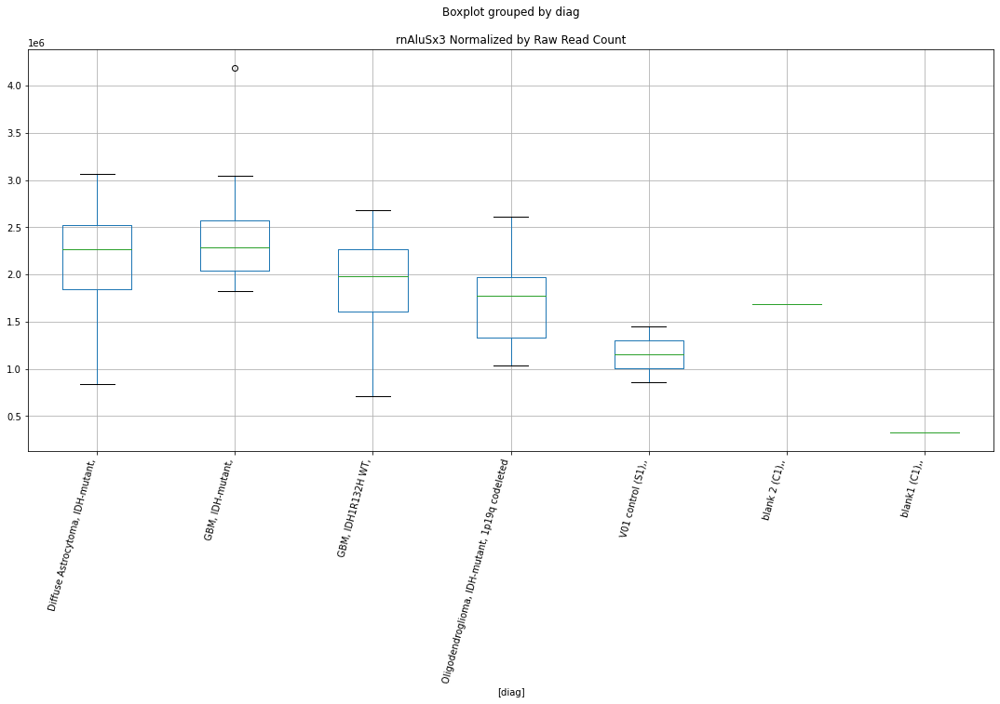

rnAluSz6 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.91722021091028
	p = 0.0712216515719757
rnAluSz6 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8488551057507476
	p = 0.08097304894953494
rnAluSz6 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.91722021091028
	p = 0.0712216515719757
rnAluSz6 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8488551057507476
	p = 0.08097304894953494


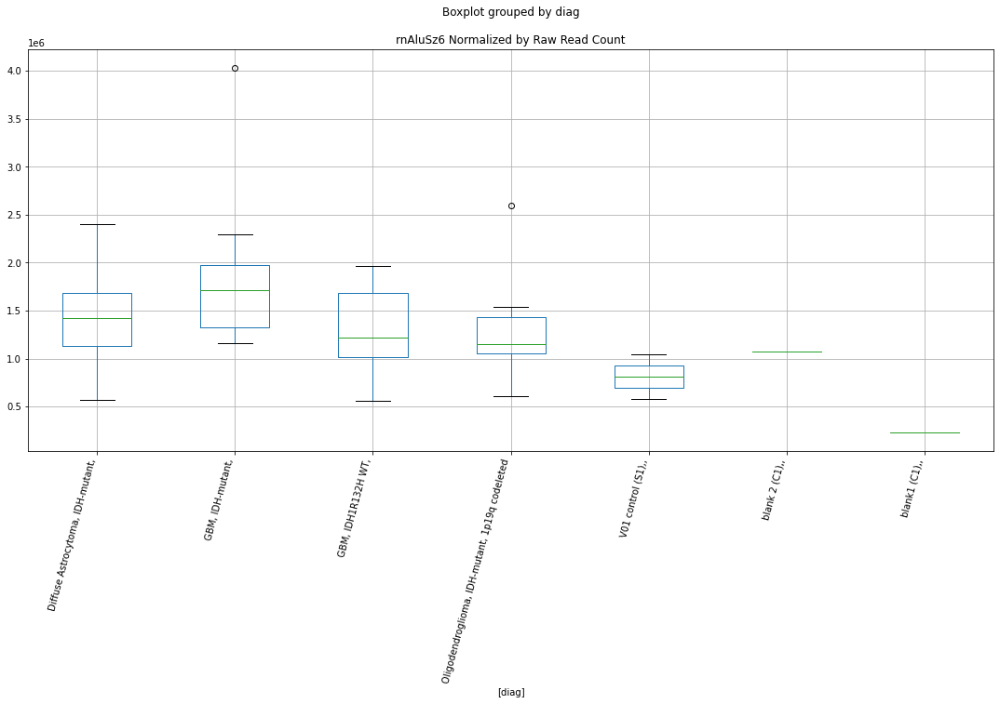

rnAluSz6 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9492089823181793
	p = 0.06702808872263272
rnAluSz6 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8566242417675891
	p = 0.07980850626566126
rnAluSz6 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9492089823181793
	p = 0.06702808872263272
rnAluSz6 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8566242417675891
	p = 0.07980850626566126


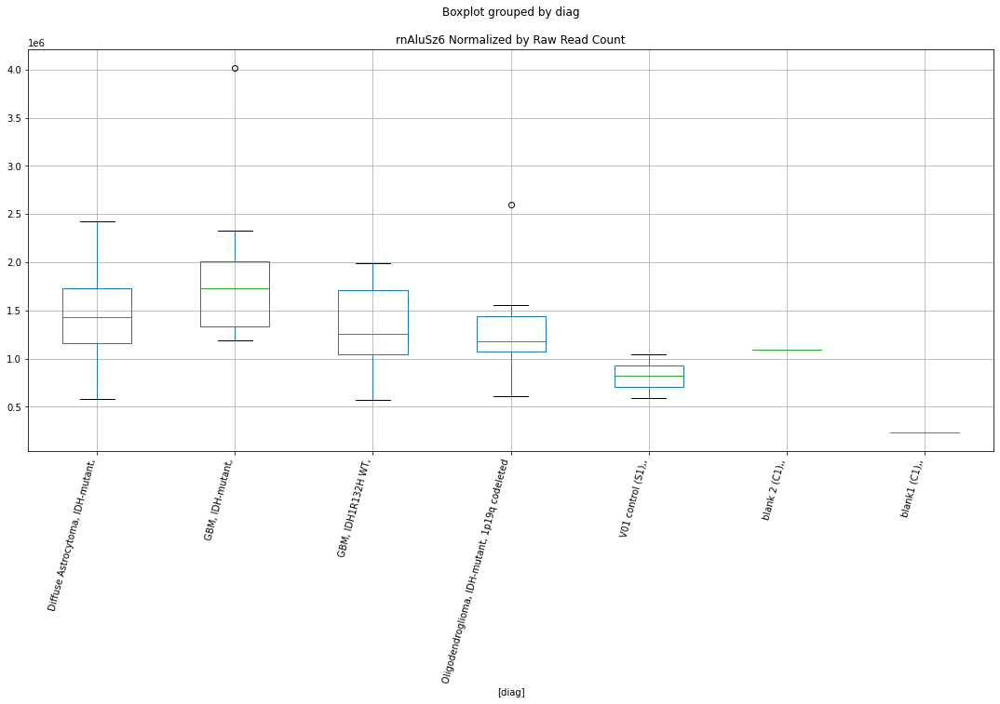

rnAluSc D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3913618869813873
	p = 0.02791718874685694
rnAluSc D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3913618869813873
	p = 0.02791718874685694


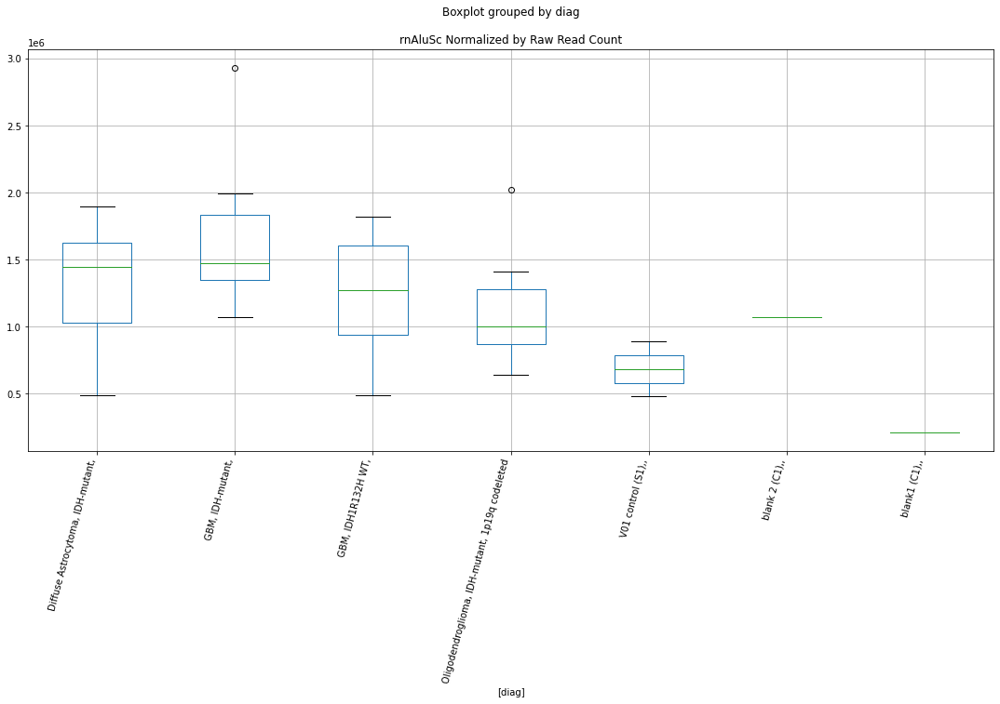

rnAluSc D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.497721230219136
	p = 0.022413923276842322
rnAluSc D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.497721230219136
	p = 0.022413923276842322


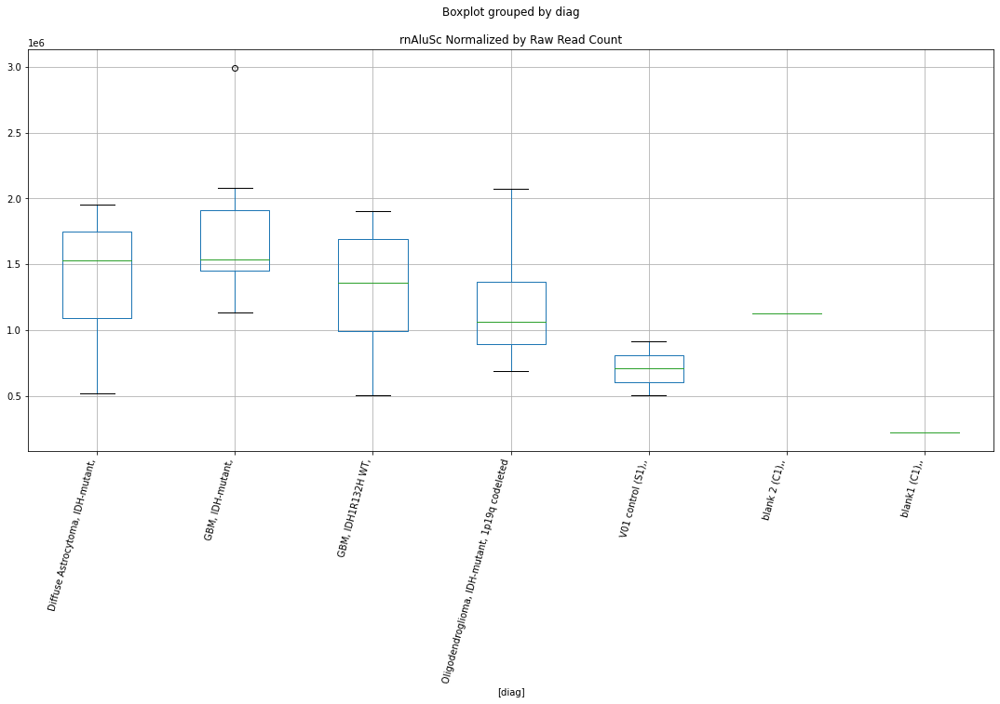

rnALR/Alpha D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7738354257813613
	p = 0.09300843053954265
rnALR/Alpha D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7738354257813613
	p = 0.09300843053954265


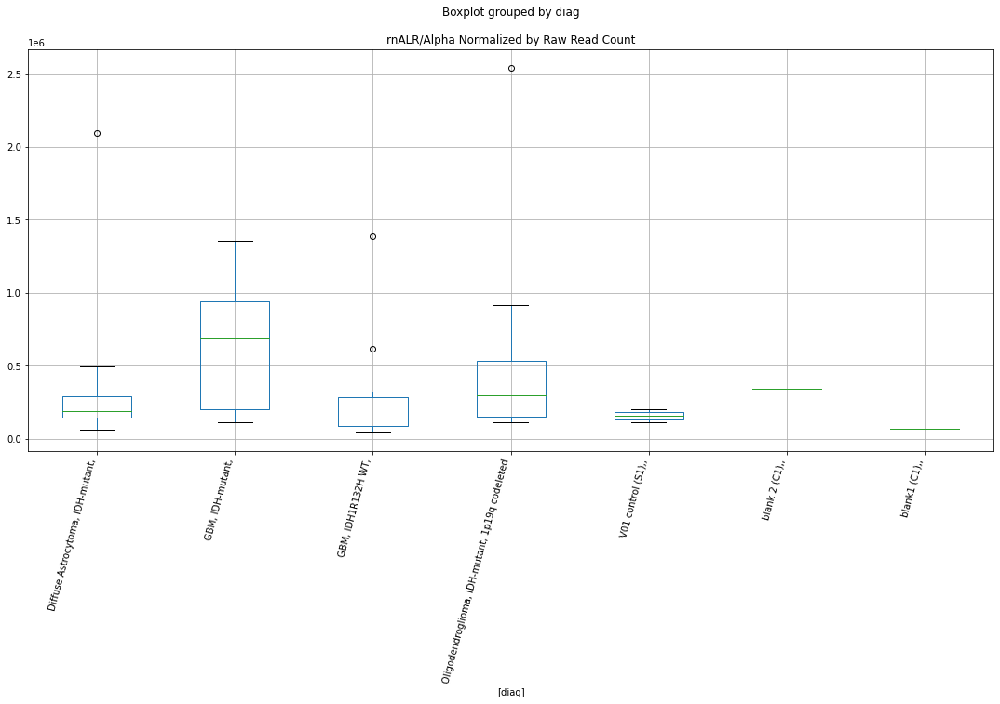

rnALR/Alpha D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7672832138784969
	p = 0.09413016862482745
rnALR/Alpha D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7672832138784969
	p = 0.09413016862482745


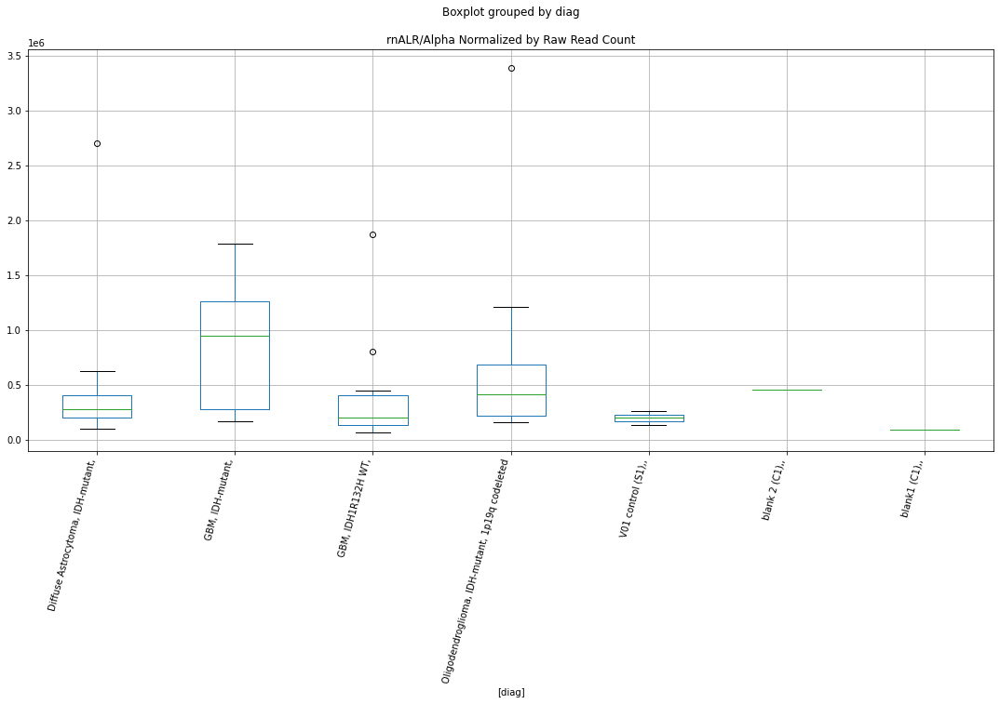

rnALR/Alpha D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7651932494426805
	p = 0.09449043653332725
rnALR/Alpha D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7651932494426805
	p = 0.09449043653332725


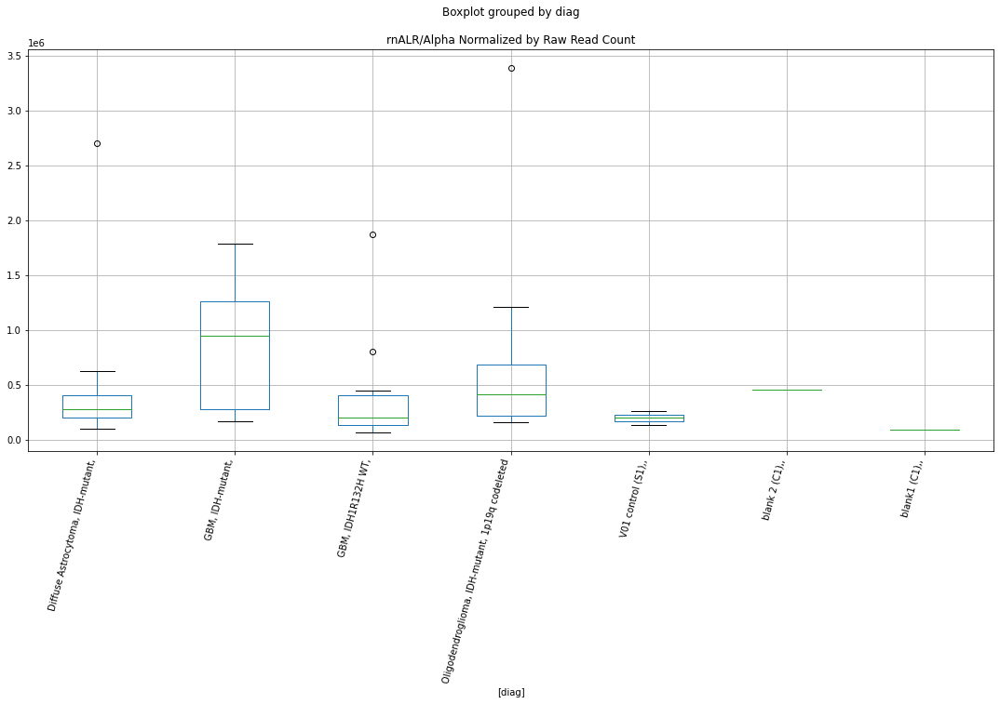

rnALR/Alpha D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7691662866467184
	p = 0.09380658811788656
rnALR/Alpha D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7691662866467184
	p = 0.09380658811788656


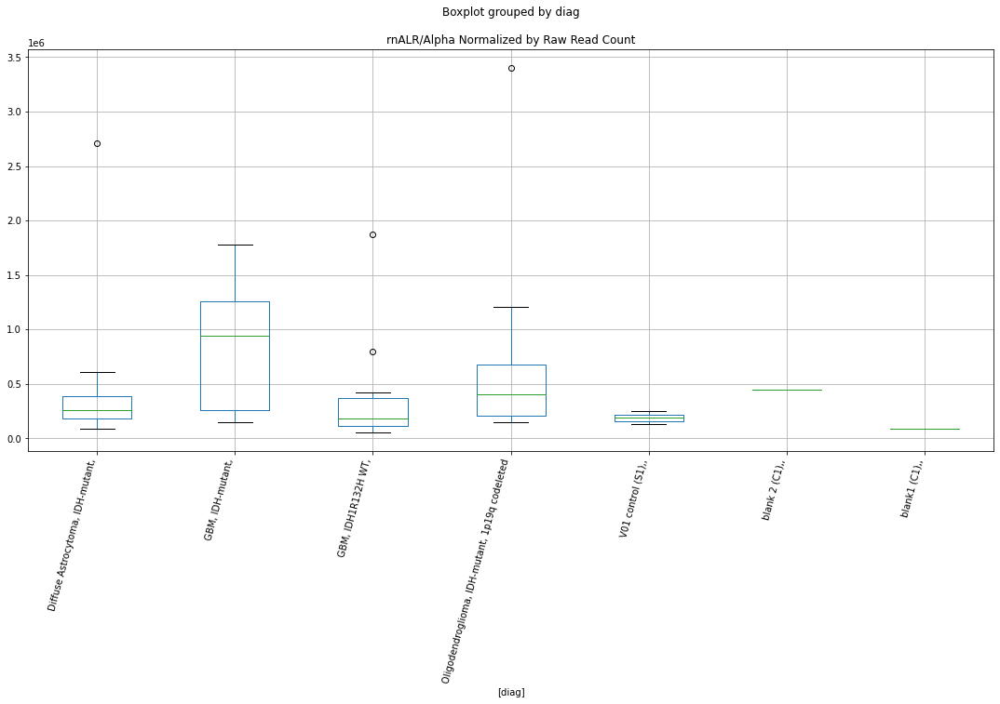

rnALR/Alpha D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.769323733905368
	p = 0.09377957681918023
rnALR/Alpha D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.769323733905368
	p = 0.09377957681918023


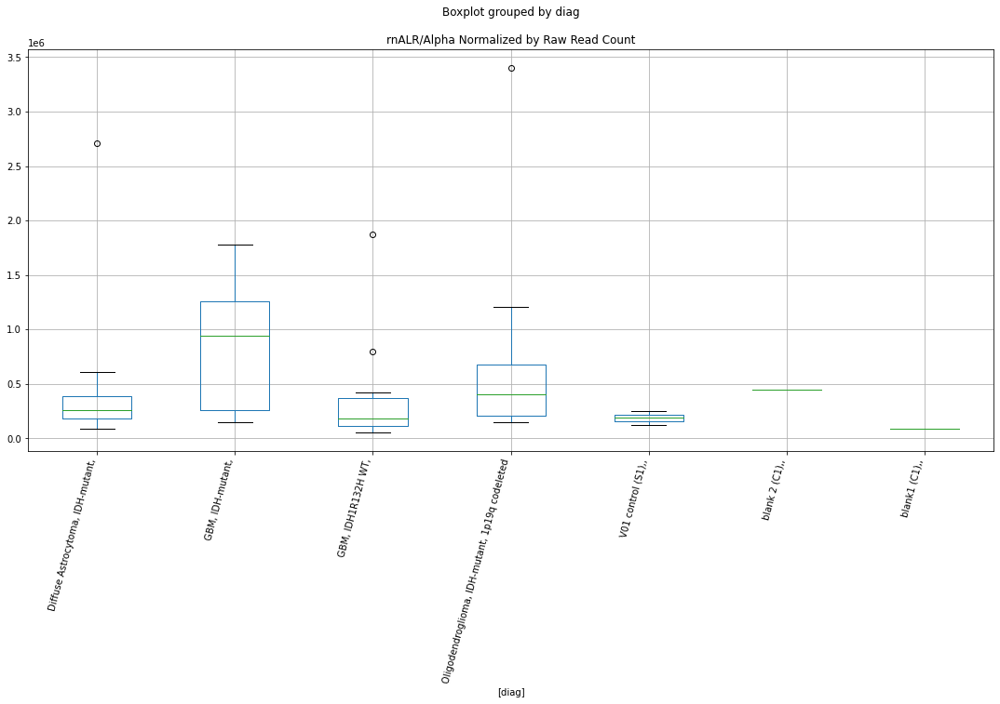

rnALR/Alpha D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7691289429222208
	p = 0.09381299571625315
rnALR/Alpha D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7691289429222208
	p = 0.09381299571625315


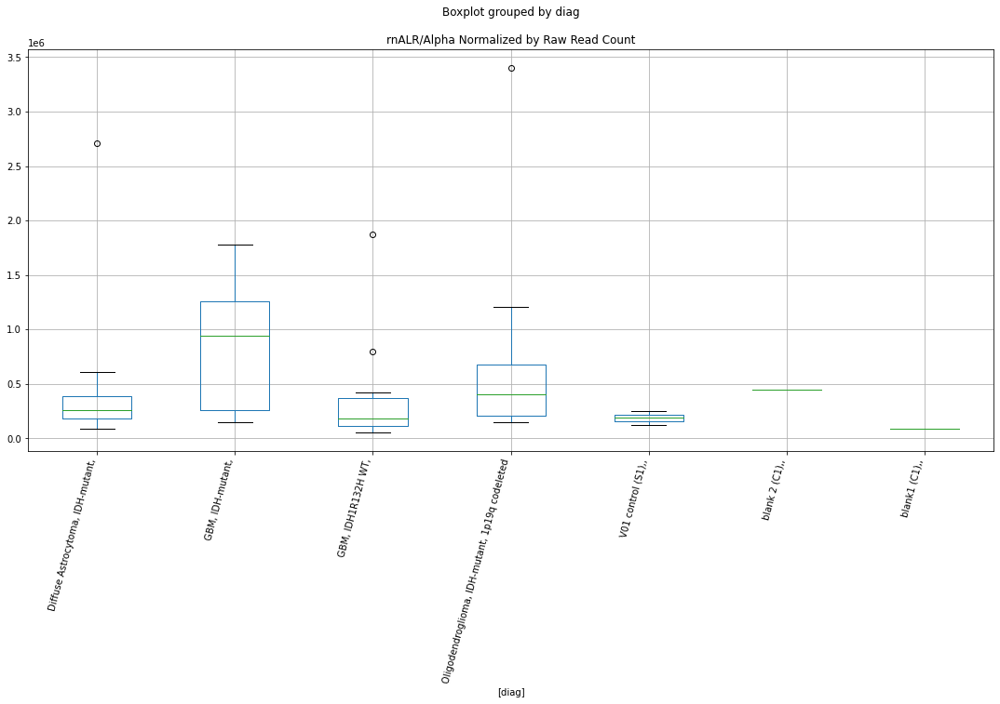

rnMER61-int D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.0231403778992956
	p = 0.007307978179098794
rnMER61-int D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9667557722379614
	p = 0.06482261433866782
rnMER61-int D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.0231403778992956
	p = 0.007307978179098794
rnMER61-int D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9667557722379614
	p = 0.06482261433866782


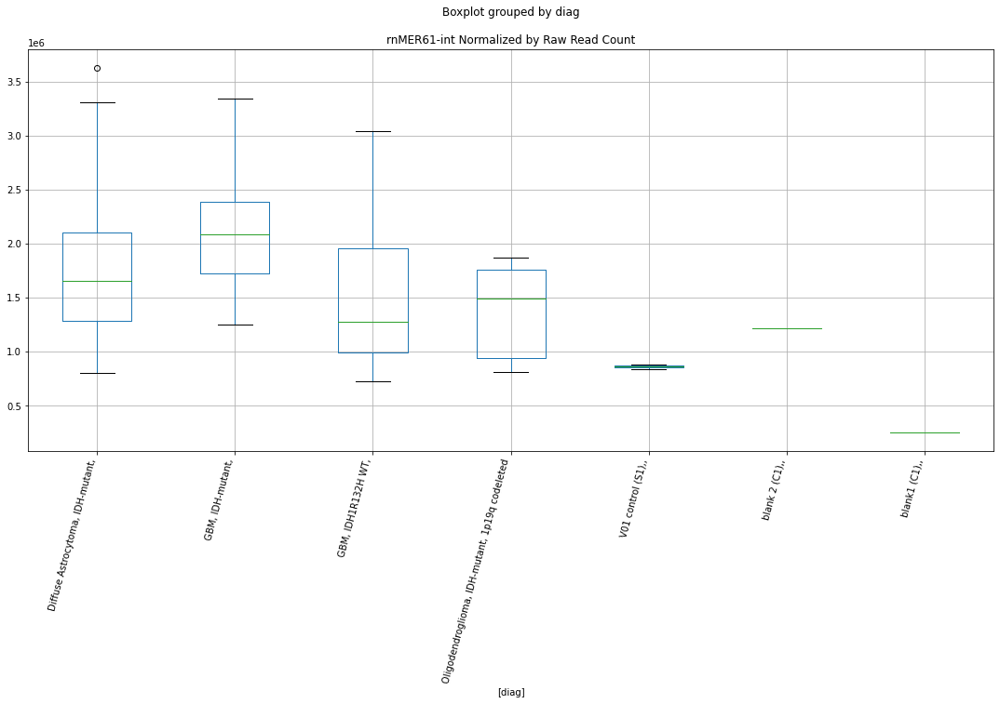

rnMER61-int D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.01187598109855
	p = 0.007489401966393473
rnMER61-int D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8738159997052073
	p = 0.07728392516746388
rnMER61-int D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.01187598109855
	p = 0.007489401966393473
rnMER61-int D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8738159997052073
	p = 0.07728392516746388


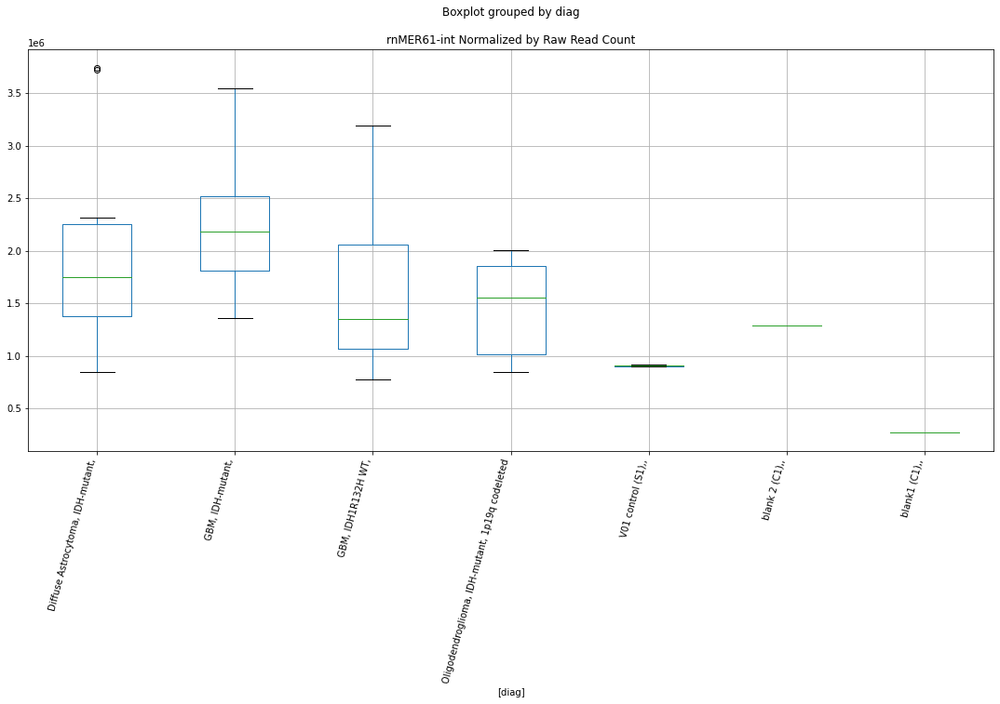

rnMER61-int D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0233952443550525
	p = 0.058140165930112675
rnMER61-int D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.0233952443550525
	p = 0.058140165930112675


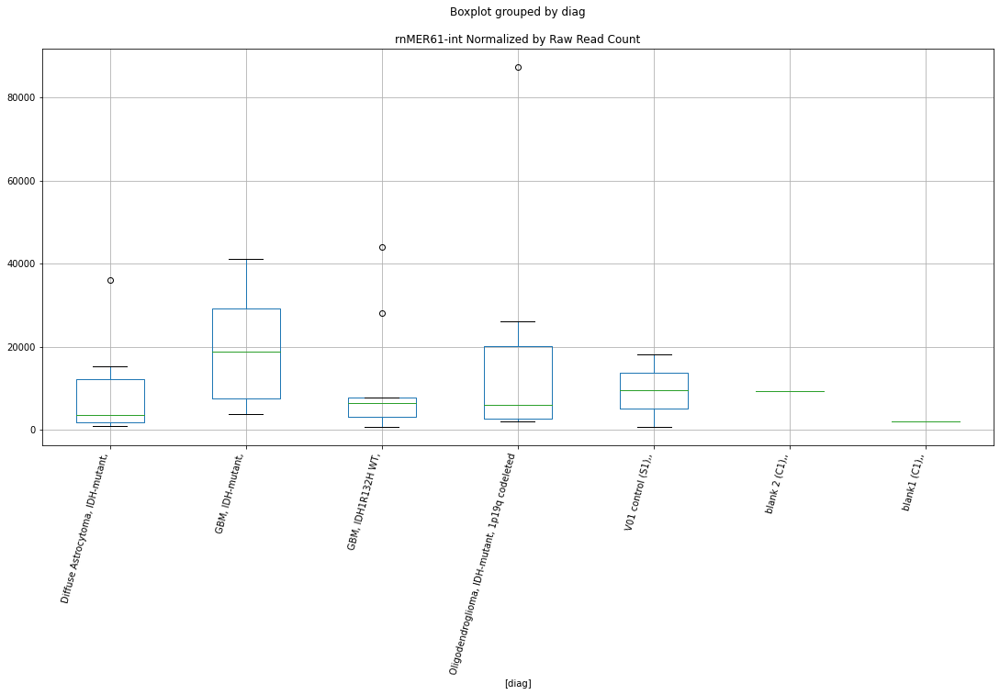

rnMER61-int D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0233952443550525
	p = 0.058140165930112675
rnMER61-int D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.0233952443550525
	p = 0.058140165930112675


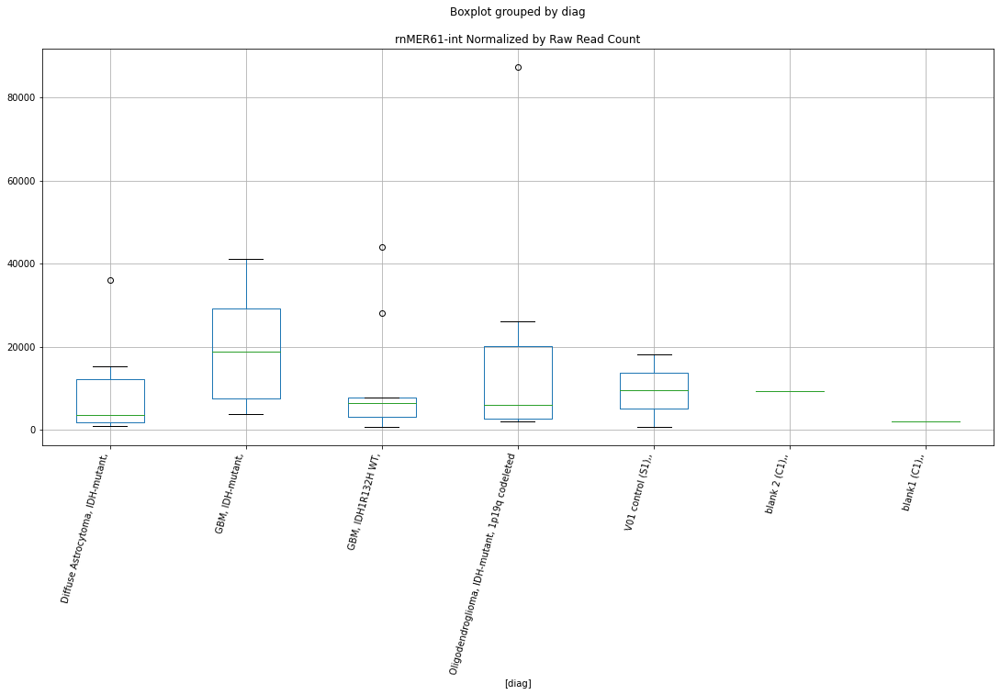

rnMER61-int D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0233952443550525
	p = 0.058140165930112675
rnMER61-int D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.0233952443550525
	p = 0.058140165930112675


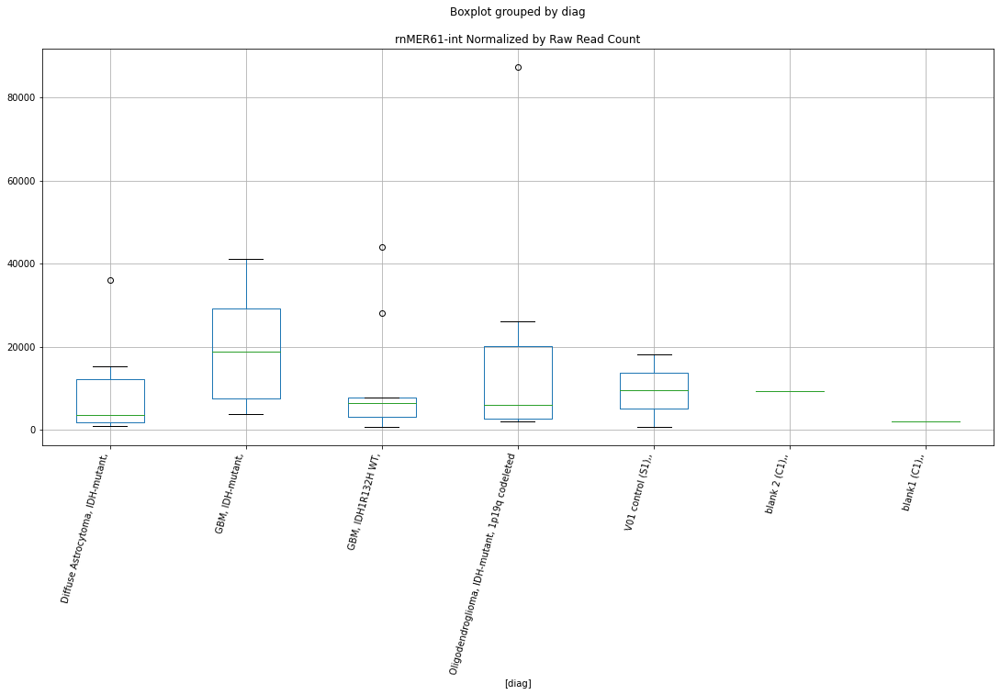

rnAluSc8 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2352092225395648
	p = 0.03831550146204259
rnAluSc8 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2352092225395648
	p = 0.03831550146204259


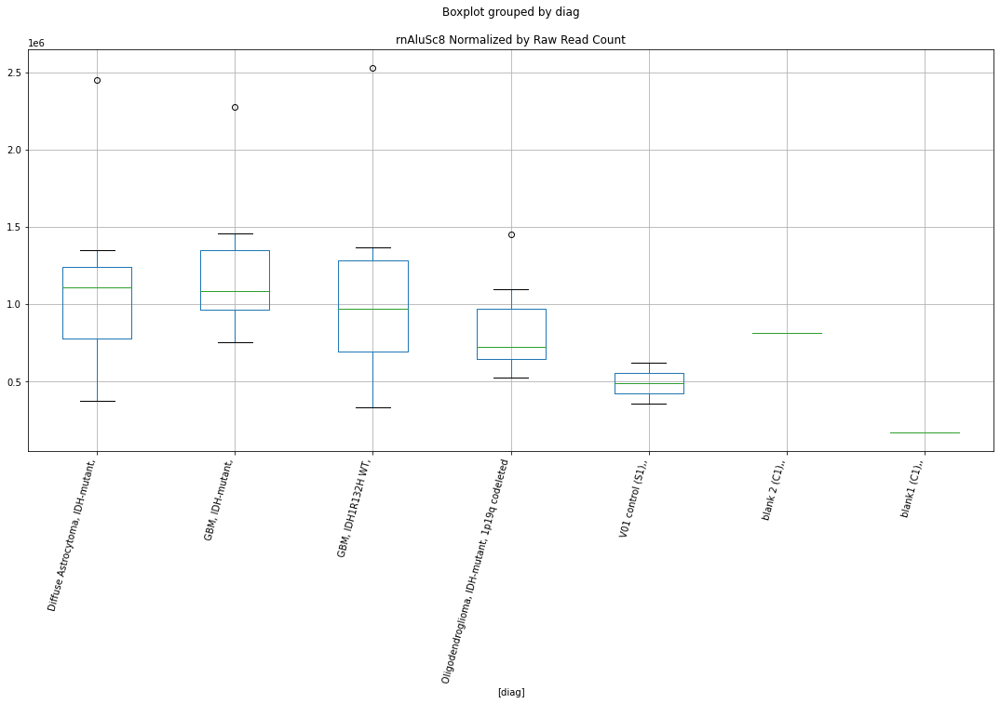

rnAluSc8 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.36830653446665
	p = 0.029266255067006815
rnAluSc8 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.36830653446665
	p = 0.029266255067006815


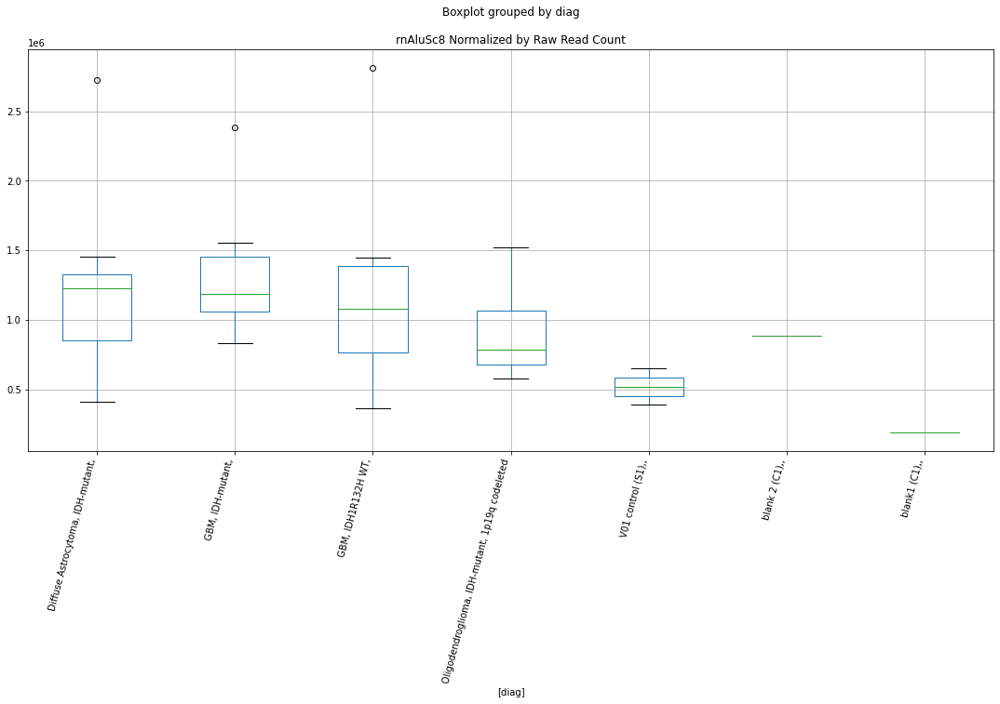

rnAluJr4 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1015675918275143
	p = 0.049936792195939265
rnAluJr4 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1015675918275143
	p = 0.049936792195939265


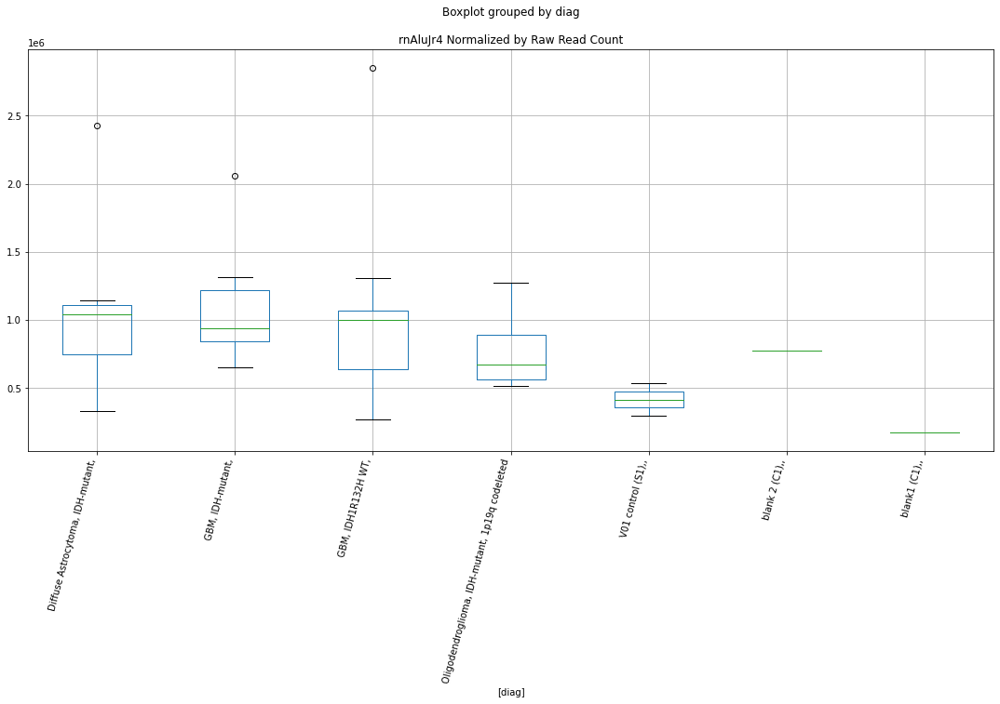

rnAluJr4 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.364532264090631
	p = 0.029492813506392955
rnAluJr4 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.364532264090631
	p = 0.029492813506392955


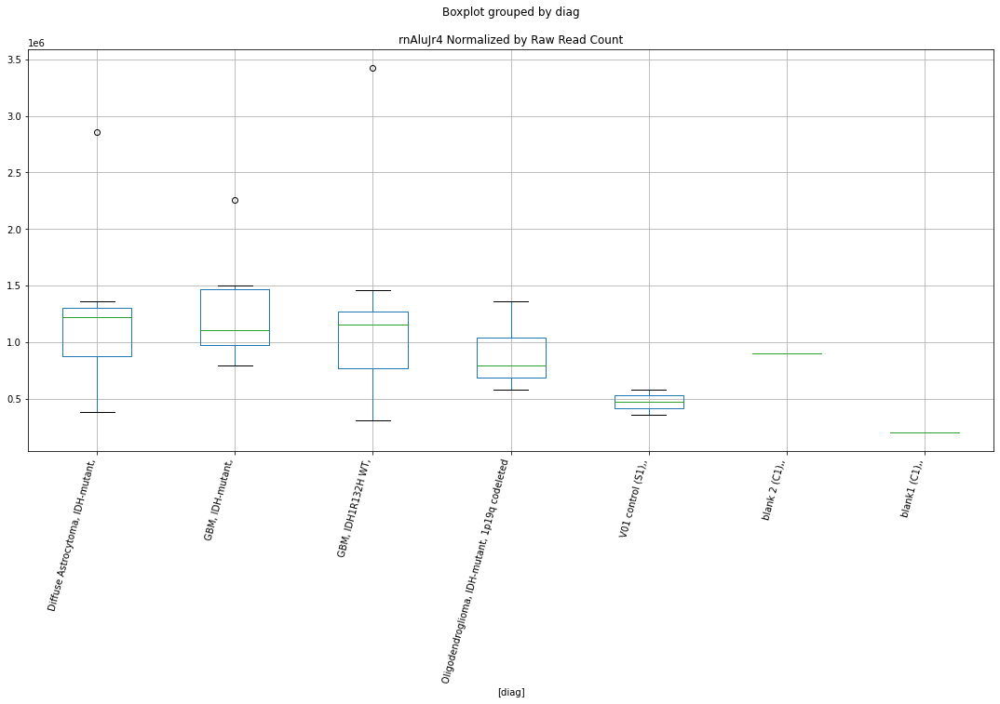

rnSSU-rRNA_Hsa D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8080349084864473
	p = 0.08734054819450708
rnSSU-rRNA_Hsa D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8080349084864473
	p = 0.08734054819450708


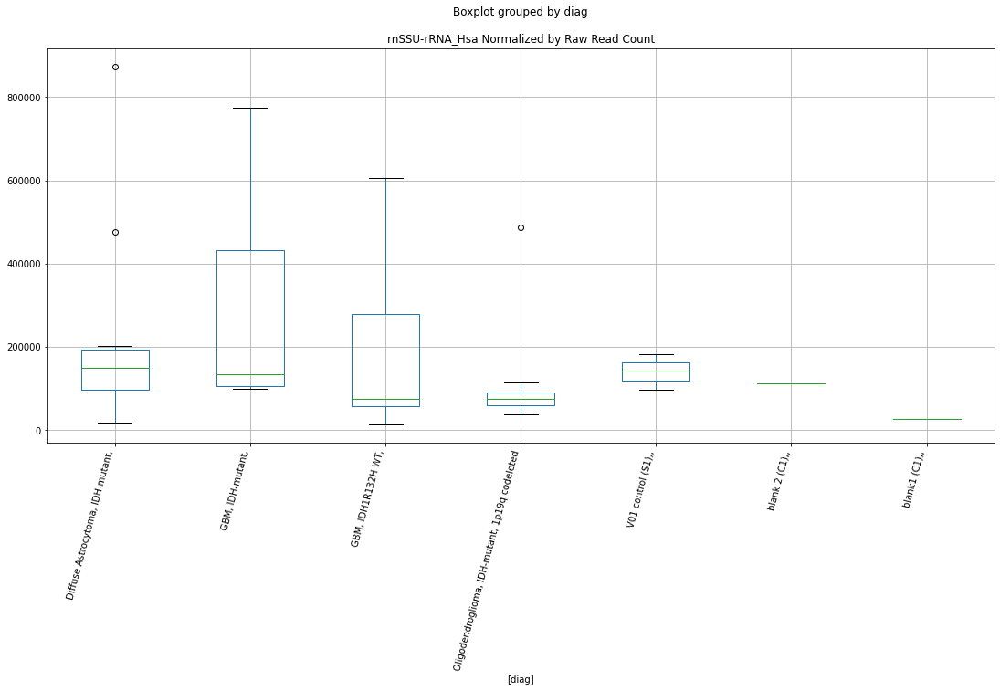

rnSSU-rRNA_Hsa D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.815118600869169
	p = 0.08620506635977591
rnSSU-rRNA_Hsa D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.815118600869169
	p = 0.08620506635977591


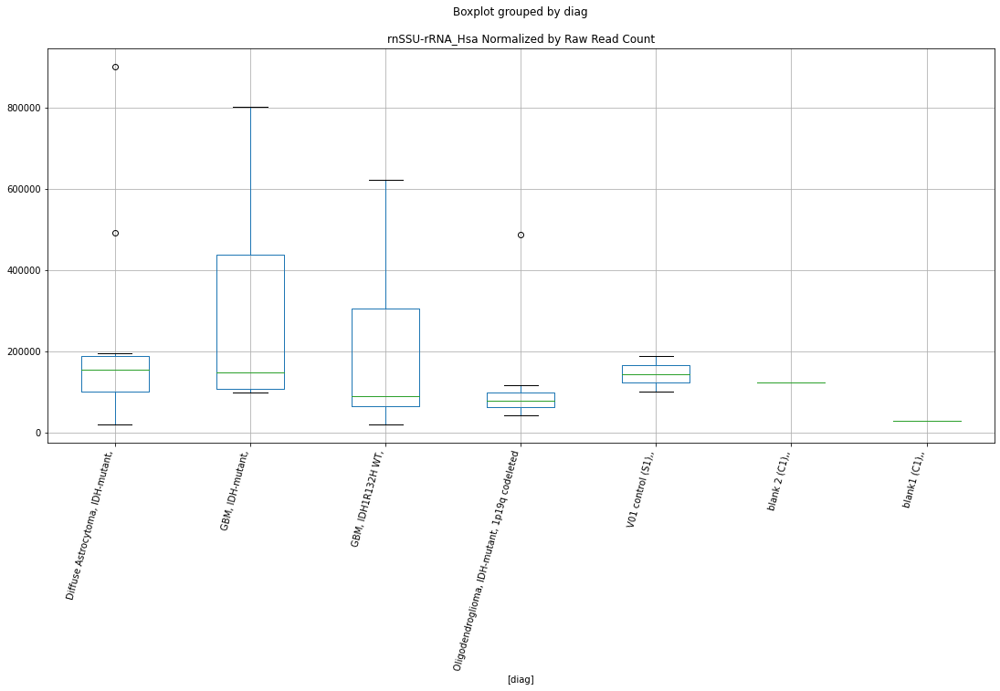

rnSSU-rRNA_Hsa D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.818710834987396
	p = 0.0856342051011356
rnSSU-rRNA_Hsa D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.818710834987396
	p = 0.0856342051011356


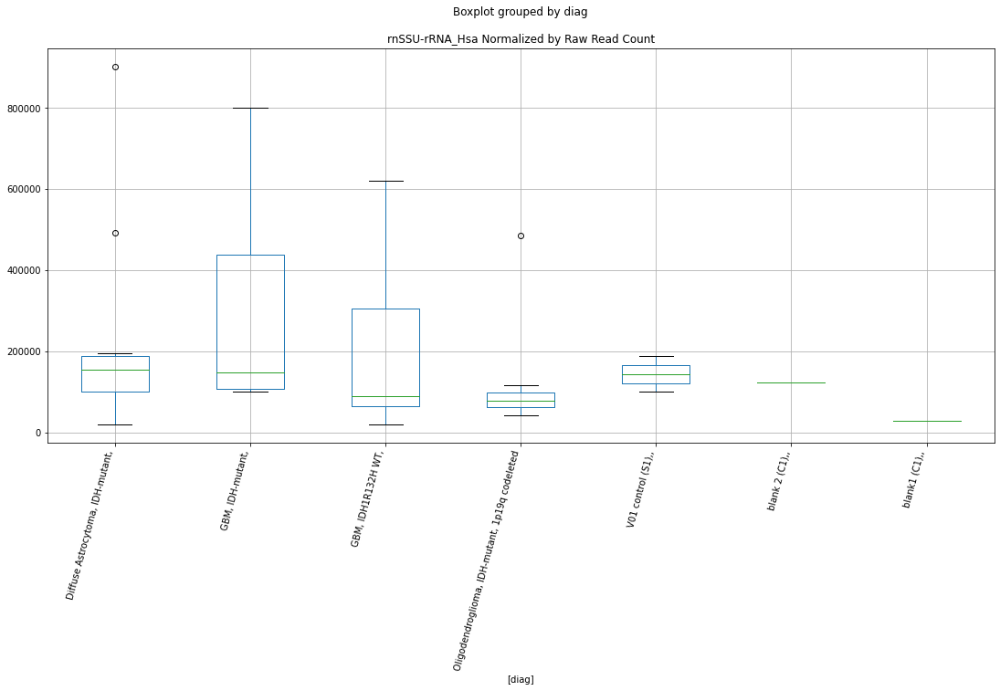

rnSSU-rRNA_Hsa D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7687206431574152
	p = 0.09388307839996324
rnSSU-rRNA_Hsa D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7687206431574152
	p = 0.09388307839996324


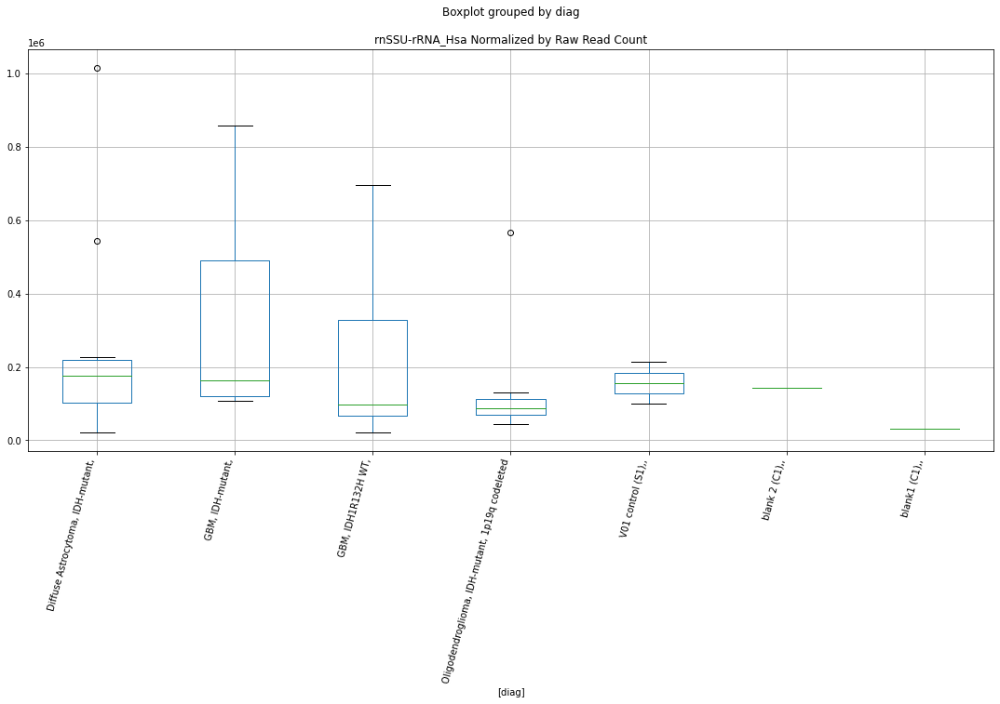

rnSSU-rRNA_Hsa D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7686244728308782
	p = 0.09389959219615966
rnSSU-rRNA_Hsa D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7686244728308782
	p = 0.09389959219615966


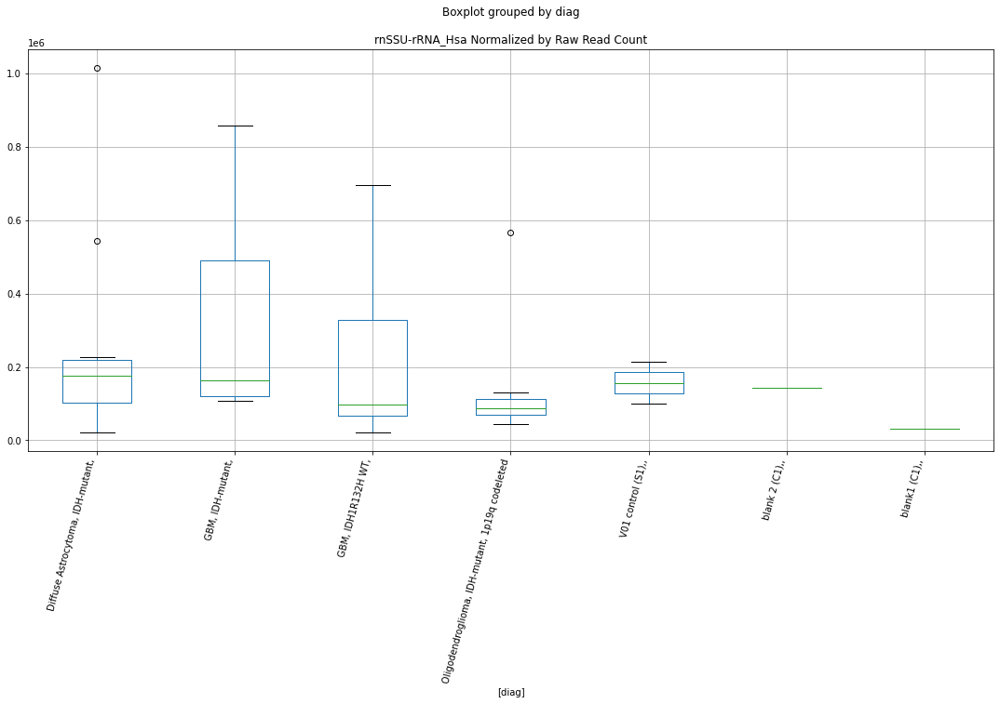

rnSSU-rRNA_Hsa D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7684457809196814
	p = 0.09393028281551319
rnSSU-rRNA_Hsa D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7684457809196814
	p = 0.09393028281551319


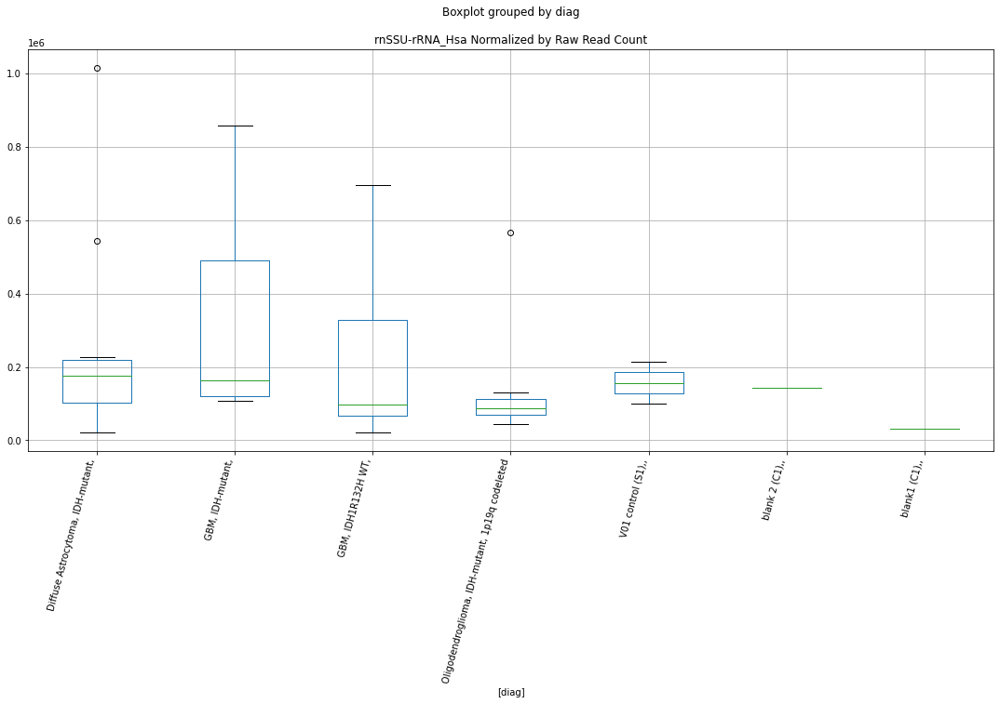

rnSSU-rRNA_Hsa Lexogen bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9565852508093198
	p = 0.06609291965644884
rnSSU-rRNA_Hsa Lexogen bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9565852508093198
	p = 0.06609291965644884


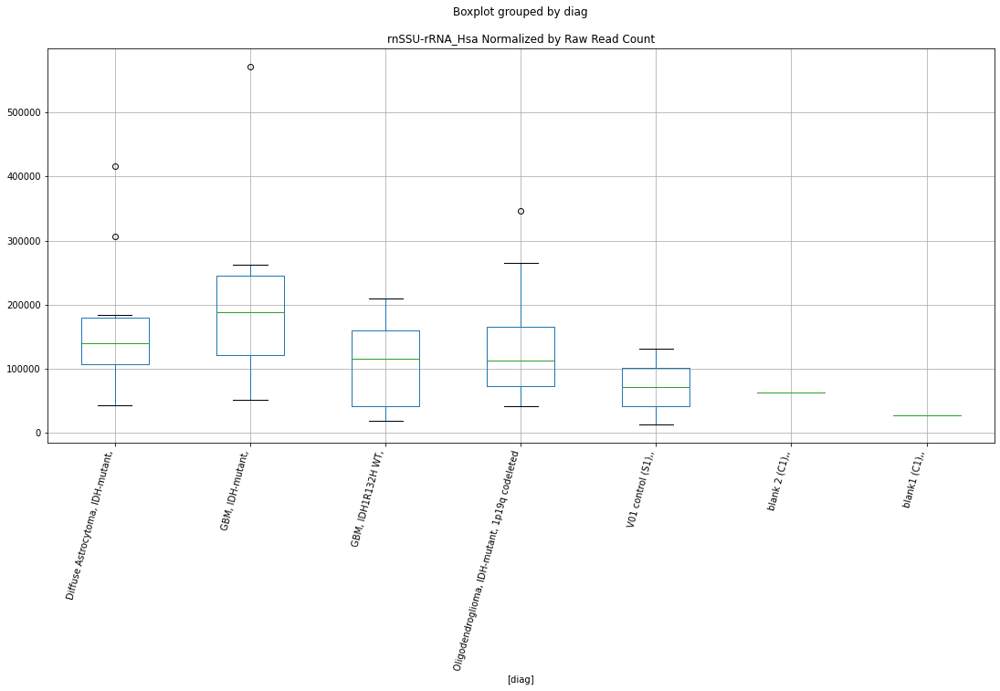

rnSSU-rRNA_Hsa Lexogen bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0052954118185986
	p = 0.06020501462214415
rnSSU-rRNA_Hsa Lexogen bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0052954118185986
	p = 0.06020501462214415


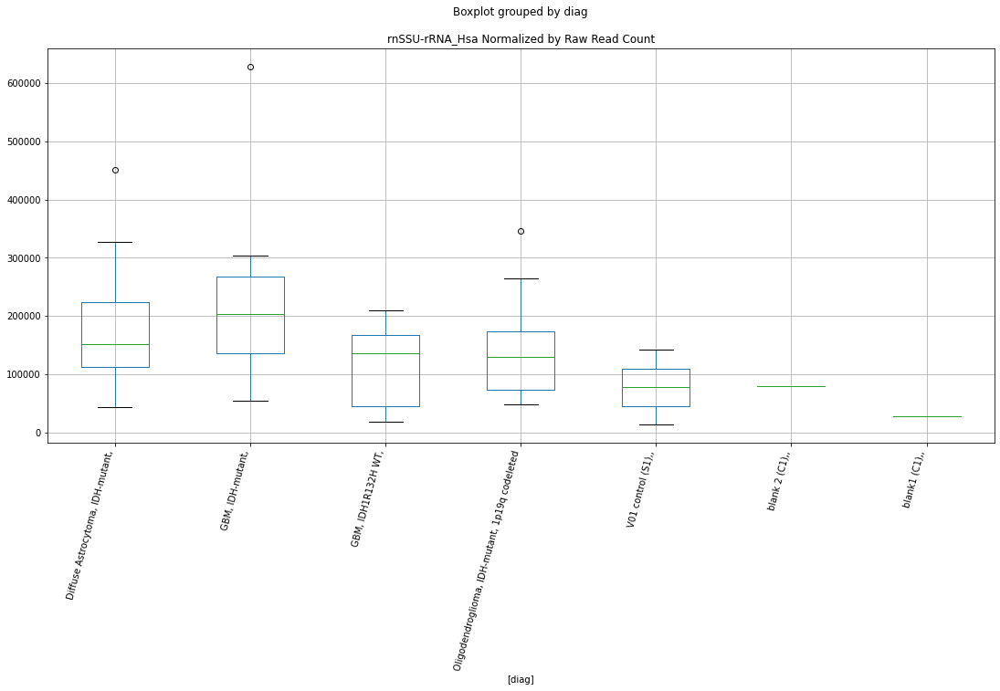

rnSSU-rRNA_Hsa Lexogen bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9997386525599148
	p = 0.06085203605315582
rnSSU-rRNA_Hsa Lexogen bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9997386525599148
	p = 0.06085203605315582


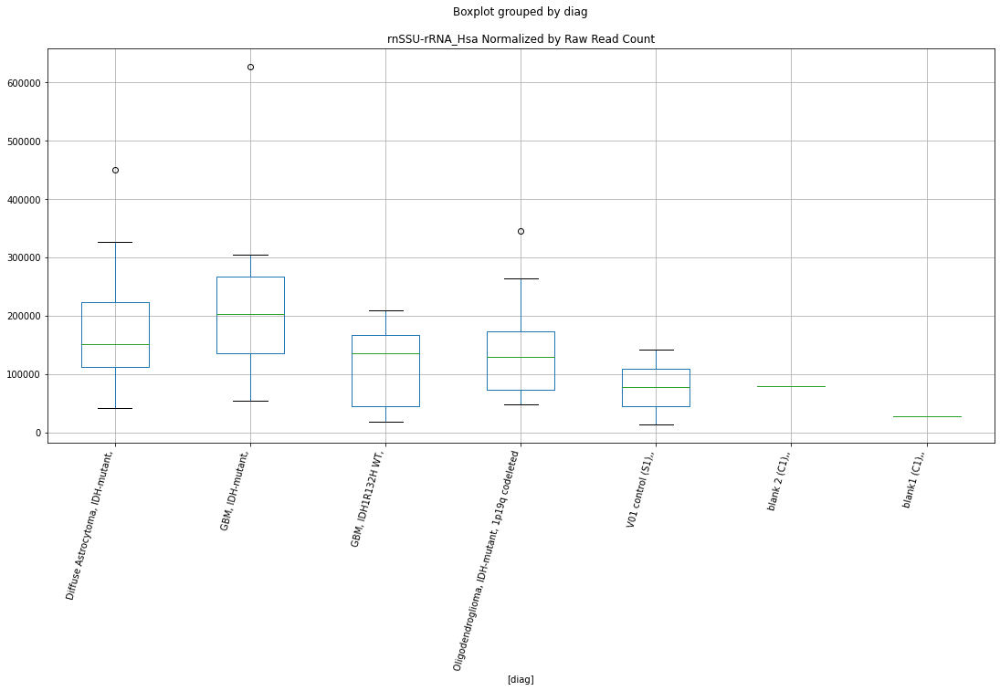

rnSSU-rRNA_Hsa Lexogen cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0244576046684237
	p = 0.058020975811844025
rnSSU-rRNA_Hsa Lexogen cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0244576046684237
	p = 0.058020975811844025


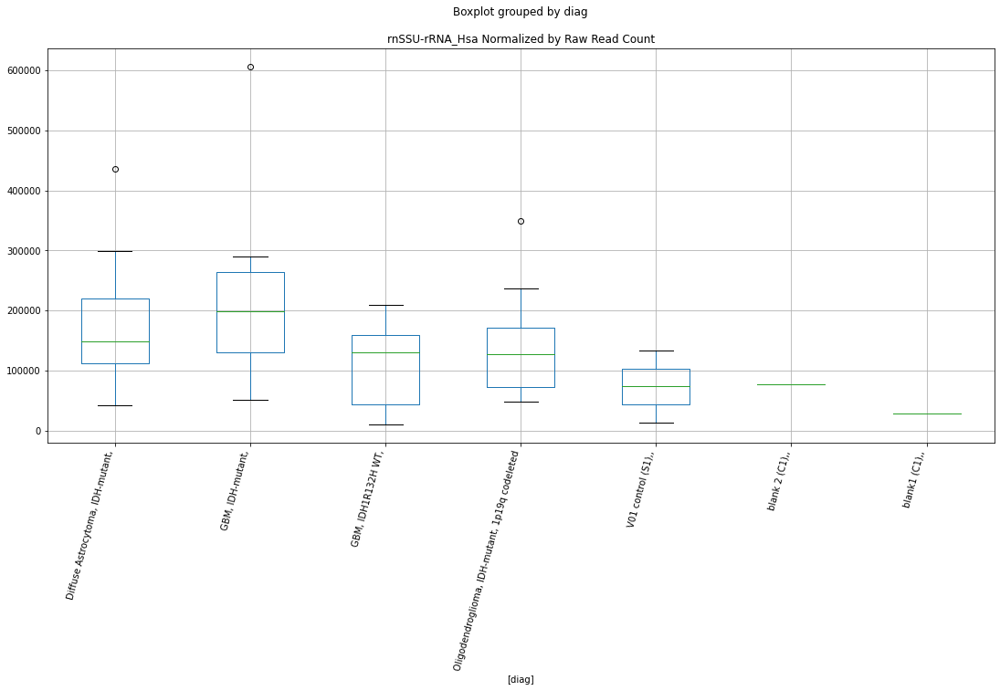

rnSSU-rRNA_Hsa Lexogen cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0146189969165262
	p = 0.0591332725867332
rnSSU-rRNA_Hsa Lexogen cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0146189969165262
	p = 0.0591332725867332


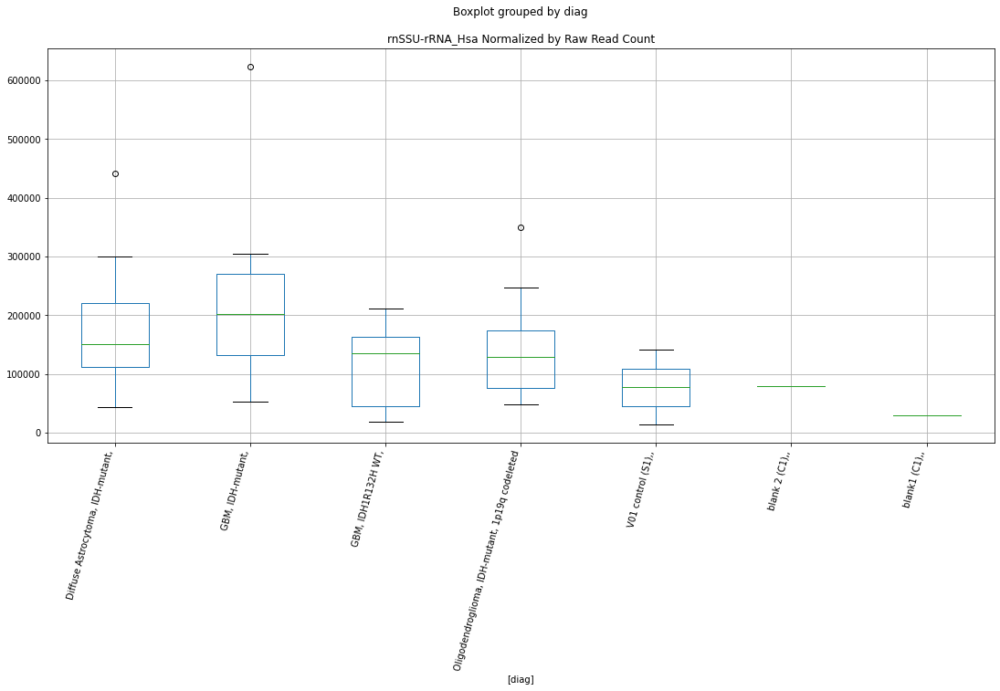

rnSSU-rRNA_Hsa Lexogen cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0159708404600054
	p = 0.0589793118800332
rnSSU-rRNA_Hsa Lexogen cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0159708404600054
	p = 0.0589793118800332


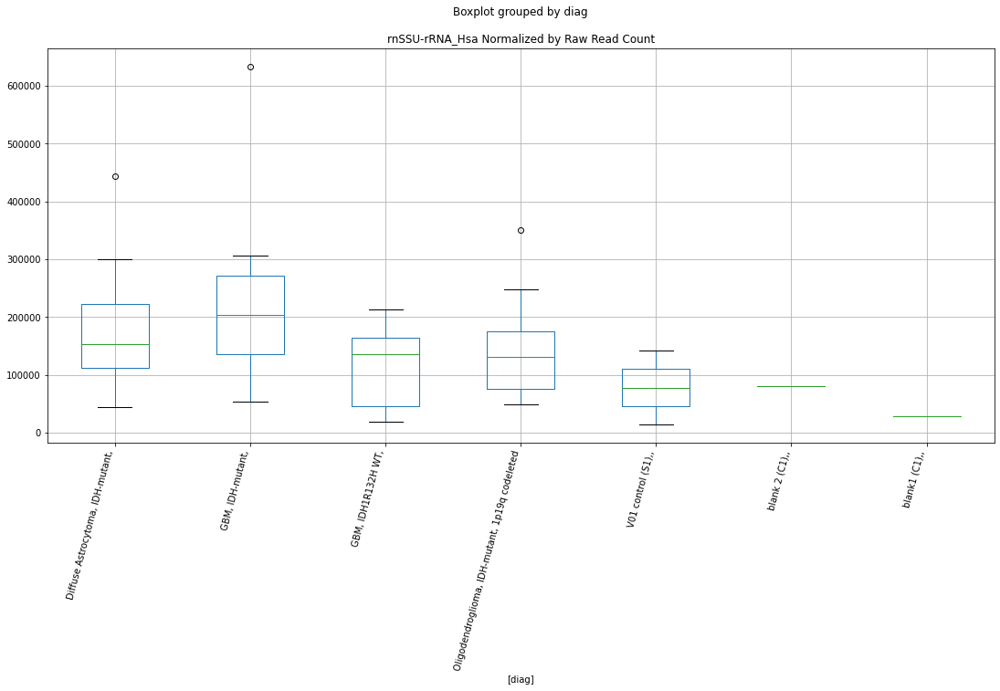

rnA-rich D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2387759107772913
	p = 0.038042534770419176
rnA-rich D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9276837674833474
	p = 0.0698249265549268
rnA-rich D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.2387759107772913
	p = 0.038042534770419176
rnA-rich D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9276837674833474
	p = 0.0698249265549268


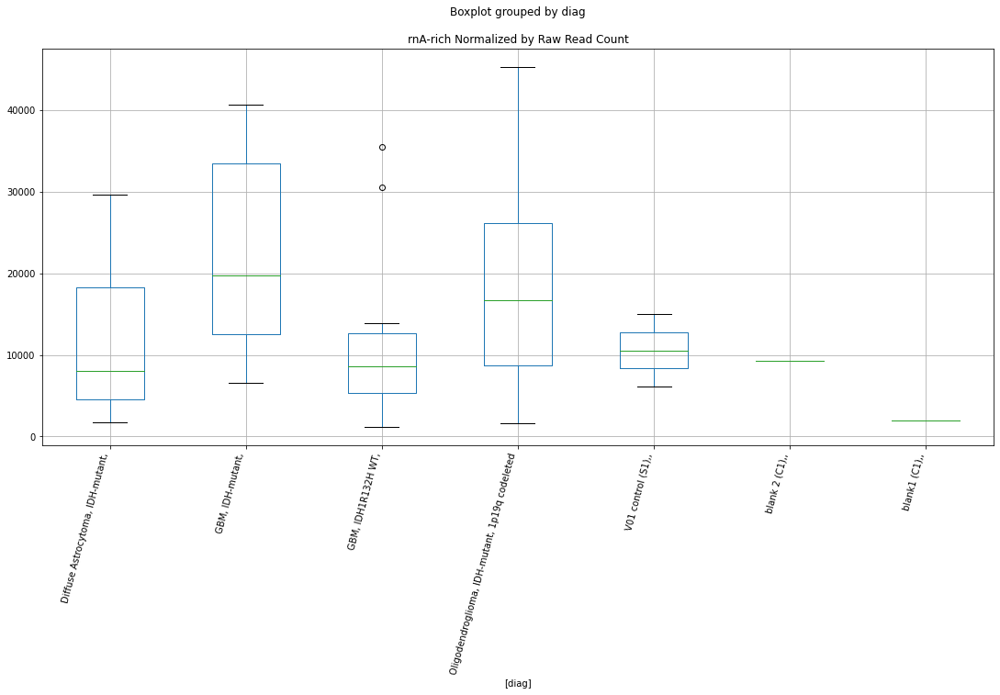

rnA-rich D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.876283064931137
	p = 0.010046624657295616
rnA-rich D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0476927510896545
	p = 0.05546863373537898
rnA-rich D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.876283064931137
	p = 0.010046624657295616
rnA-rich D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0476927510896545
	p = 0.05546863373537898


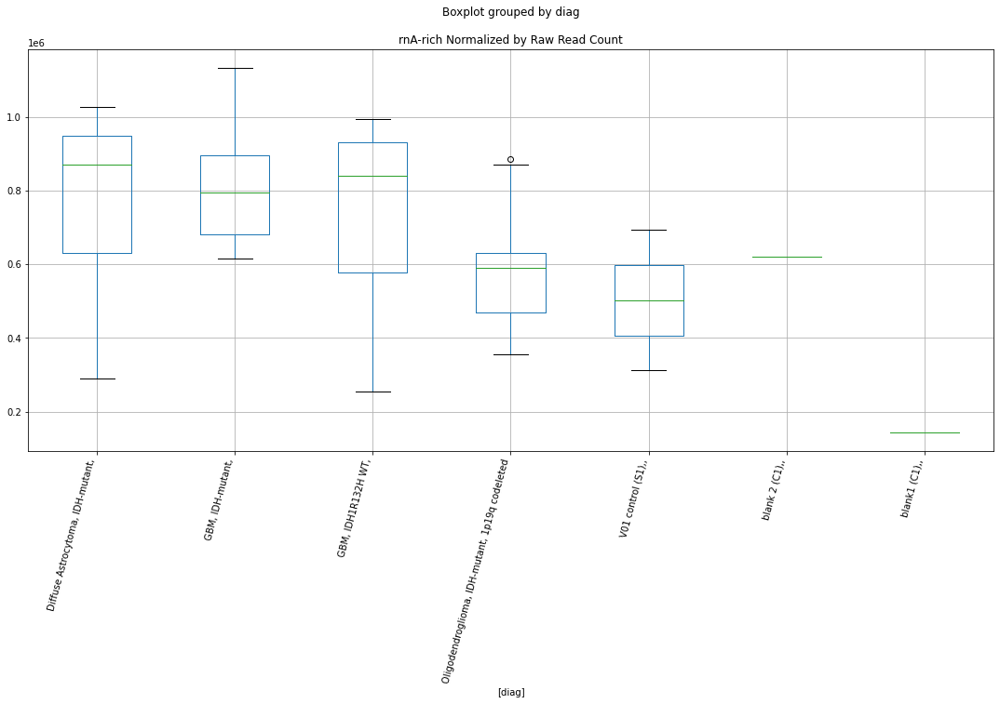

rnA-rich D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.9531230342145878
	p = 0.008508851679944604
rnA-rich D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0575057341544234
	p = 0.05442148921316402
rnA-rich D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.9531230342145878
	p = 0.008508851679944604
rnA-rich D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0575057341544234
	p = 0.05442148921316402


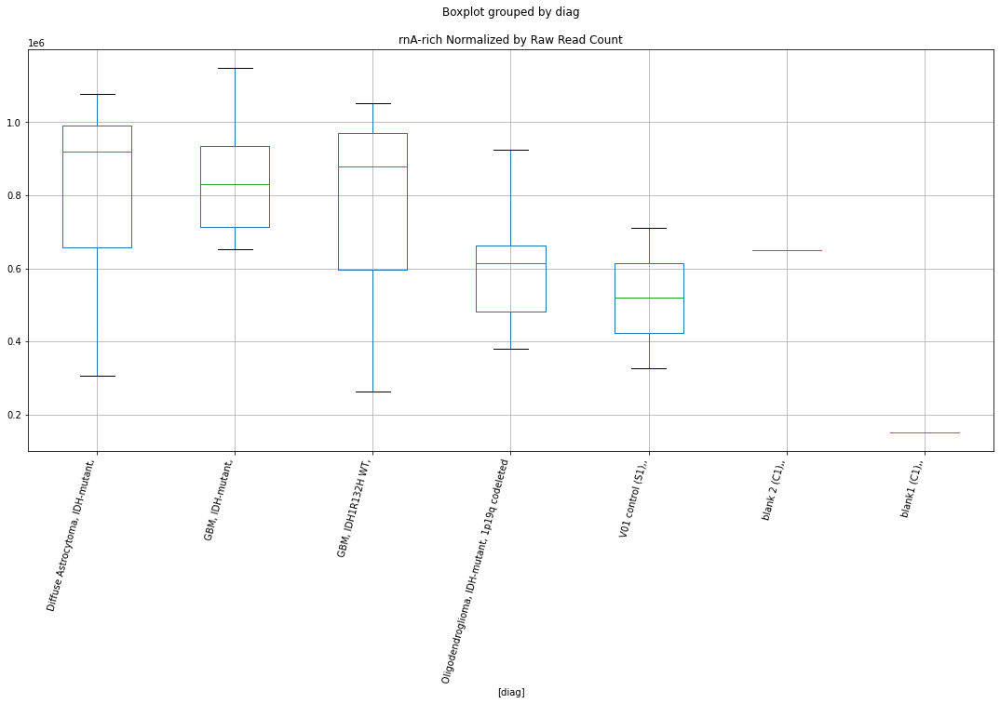

rnA-rich D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8208657081490895
	p = 0.08529335474791311
rnA-rich D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8208657081490895
	p = 0.08529335474791311


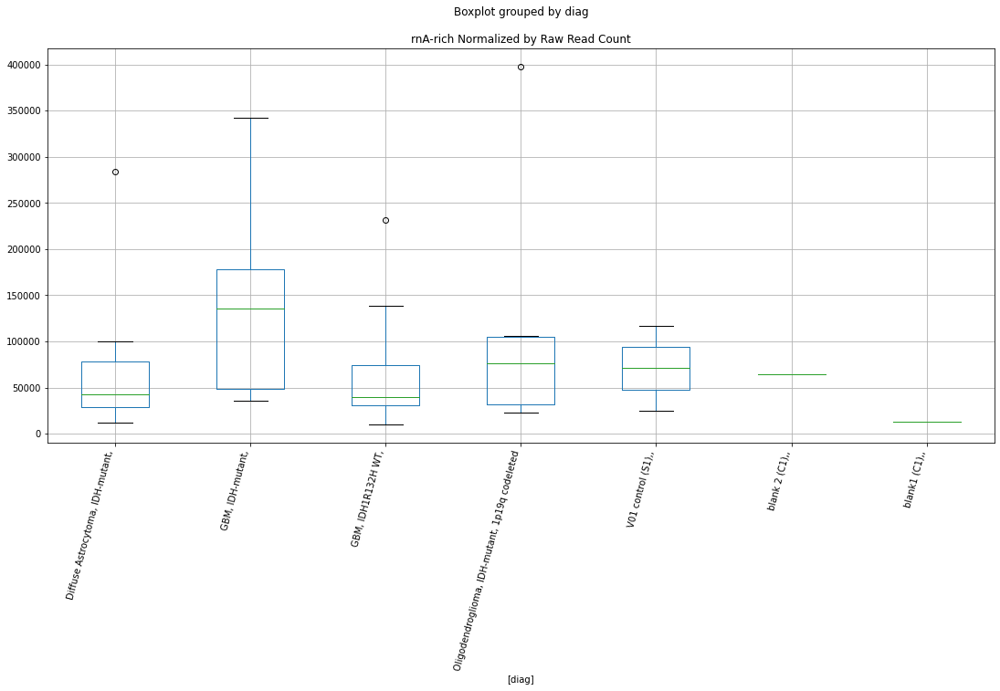

rnA-rich D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8205034196422432
	p = 0.08535057697997506
rnA-rich D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8205034196422432
	p = 0.08535057697997506


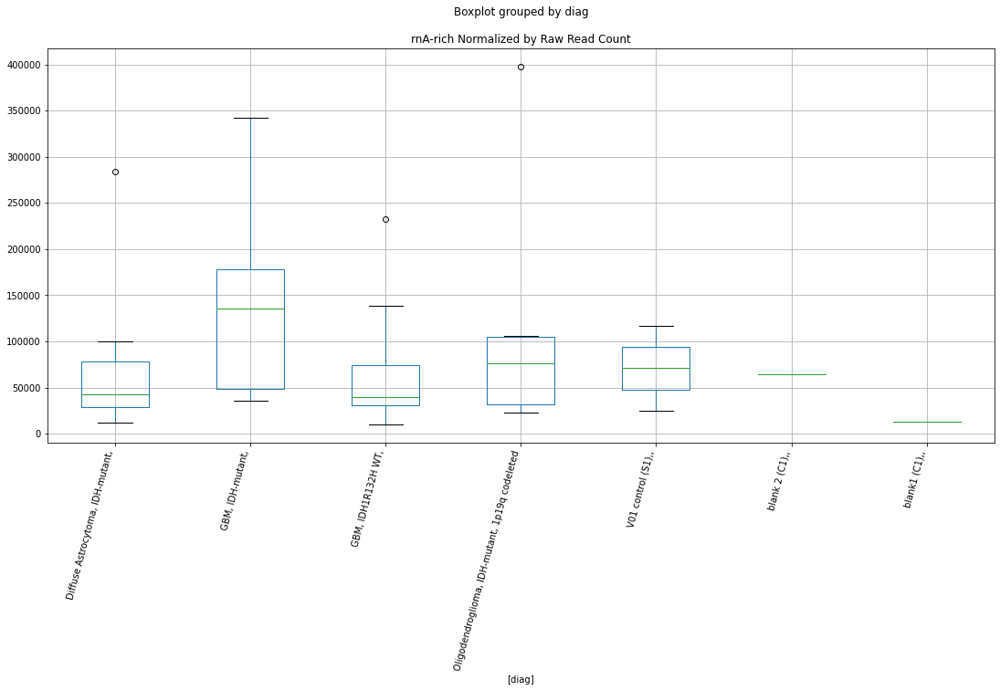

rnA-rich D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8193069873117633
	p = 0.08553978854033402
rnA-rich D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8193069873117633
	p = 0.08553978854033402


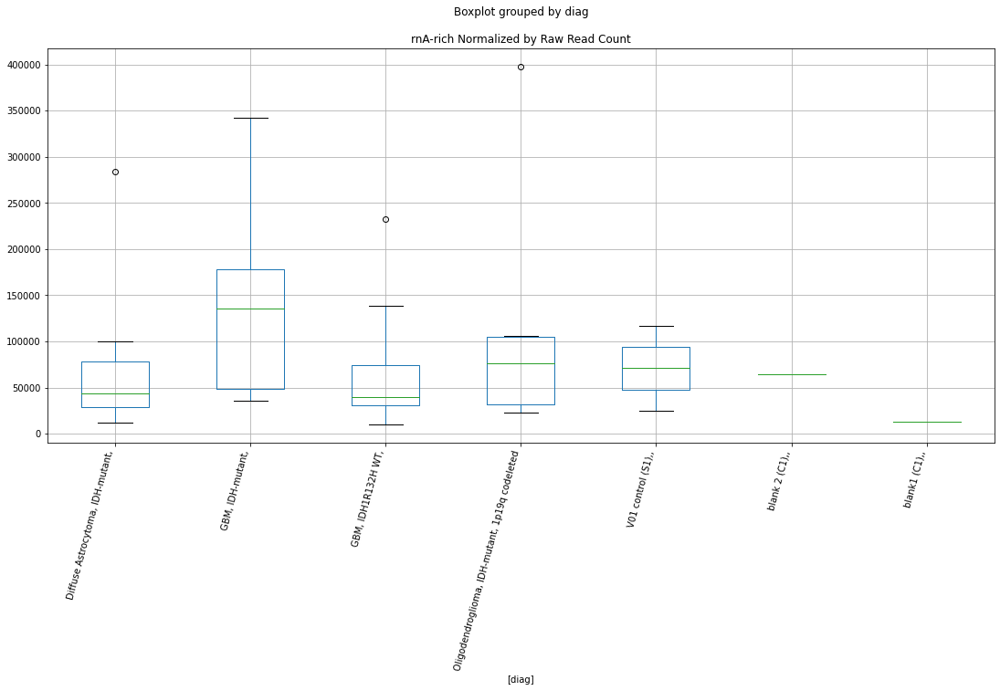

In [67]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsknames:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


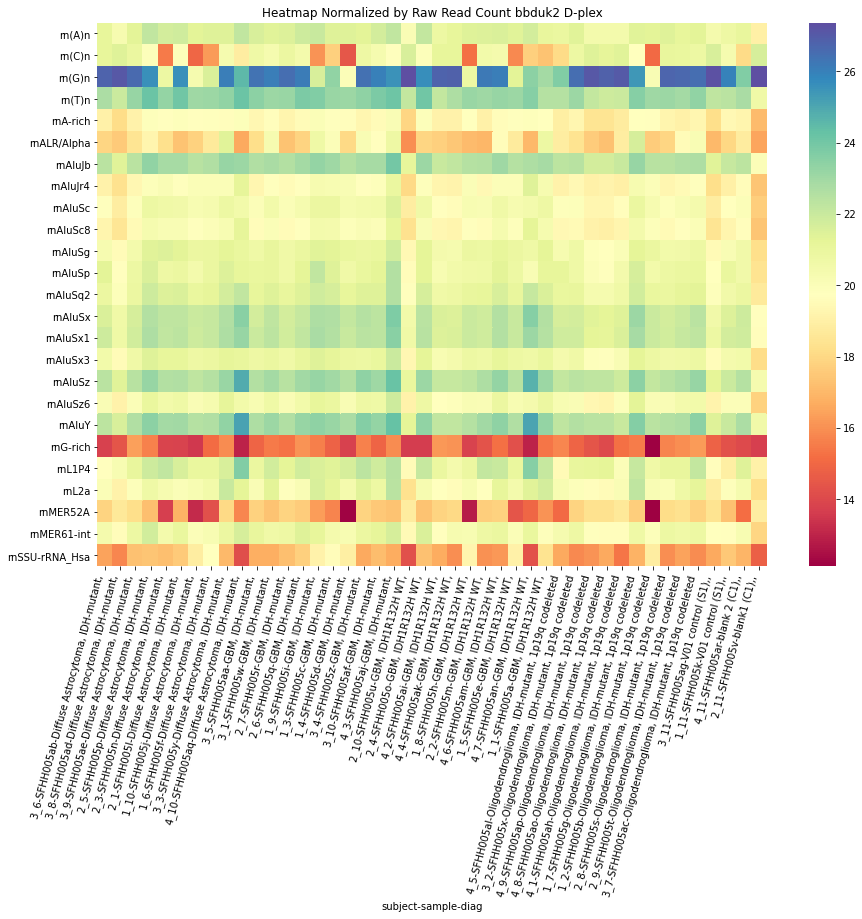

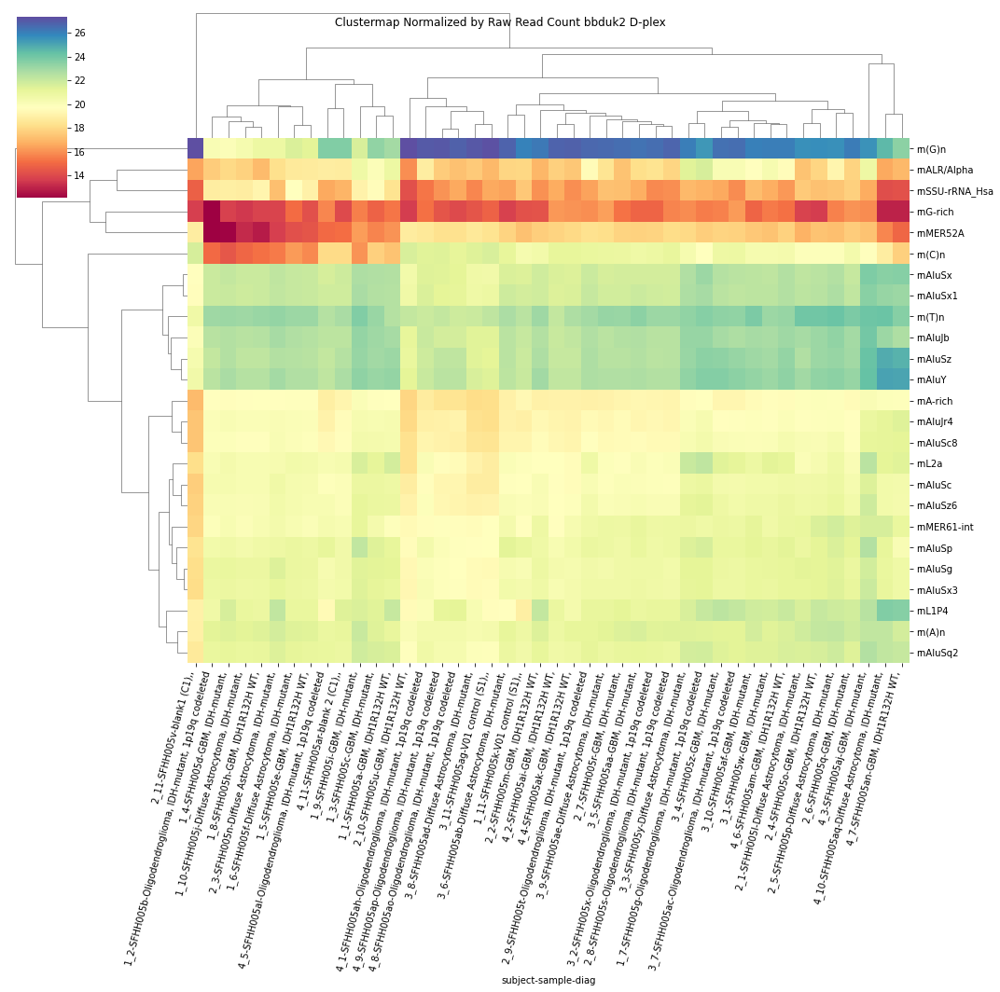

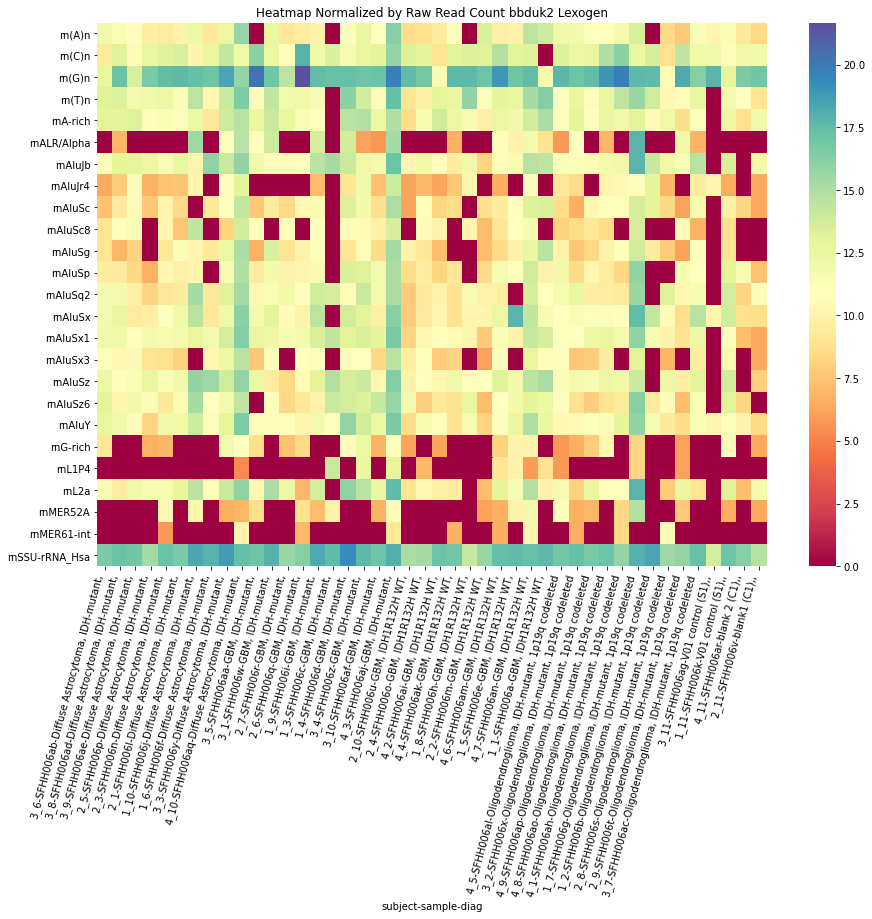

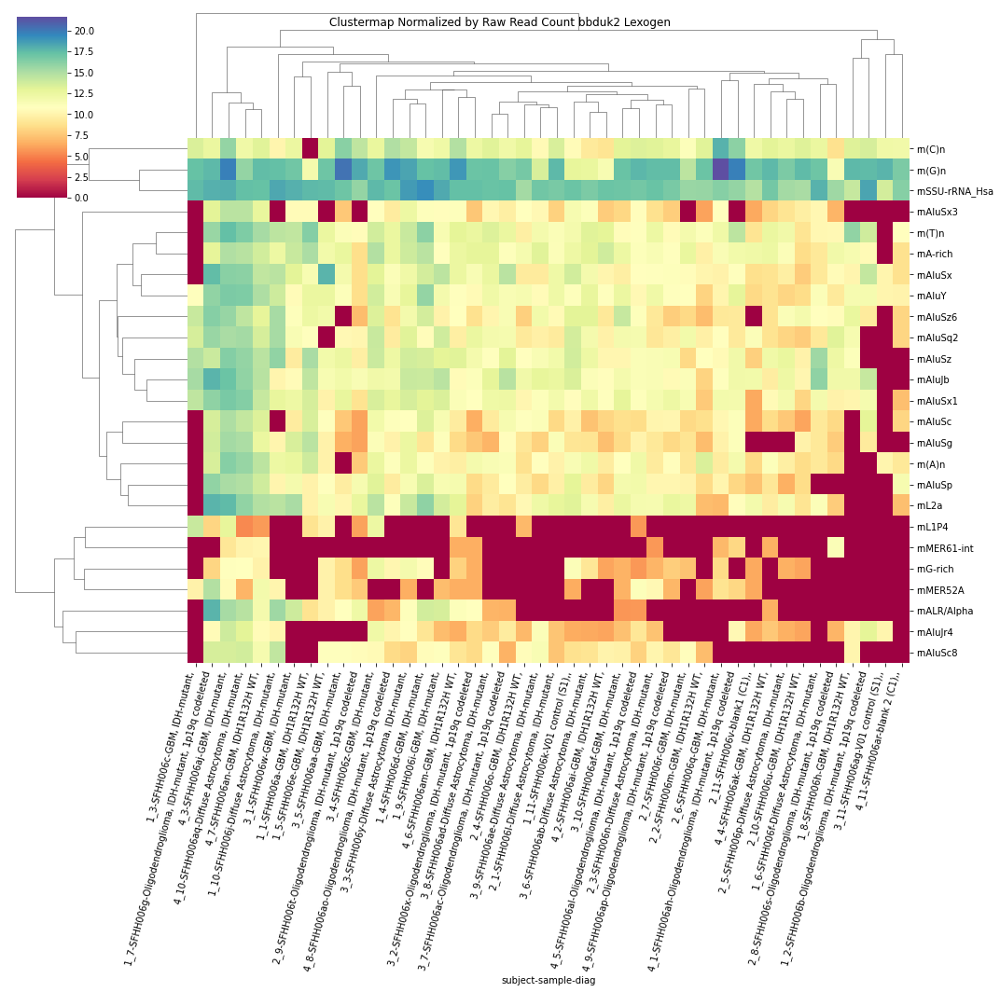

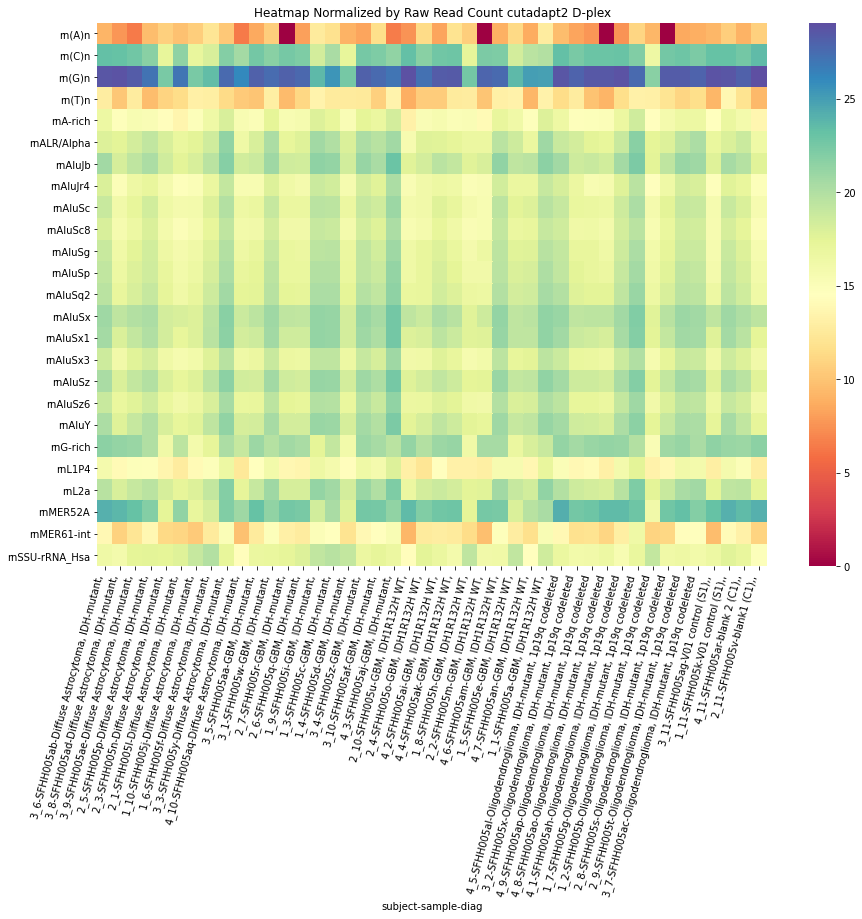

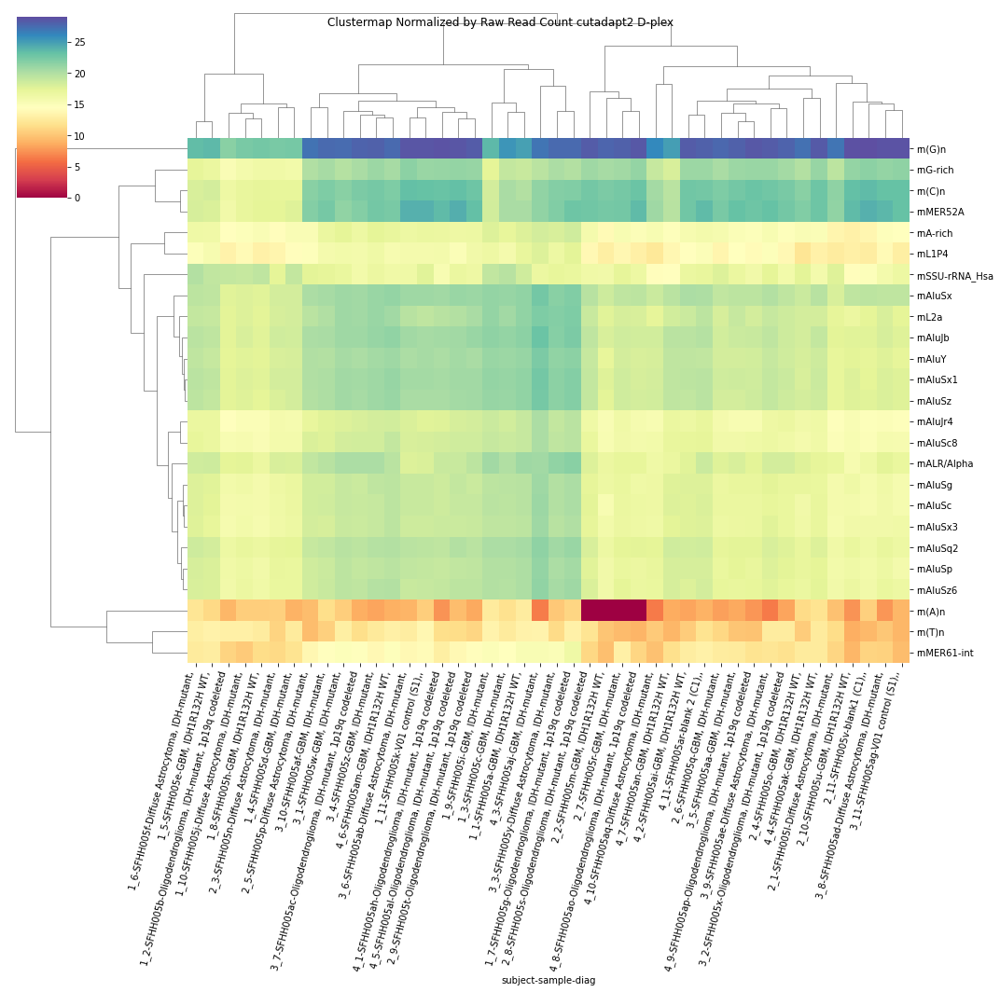

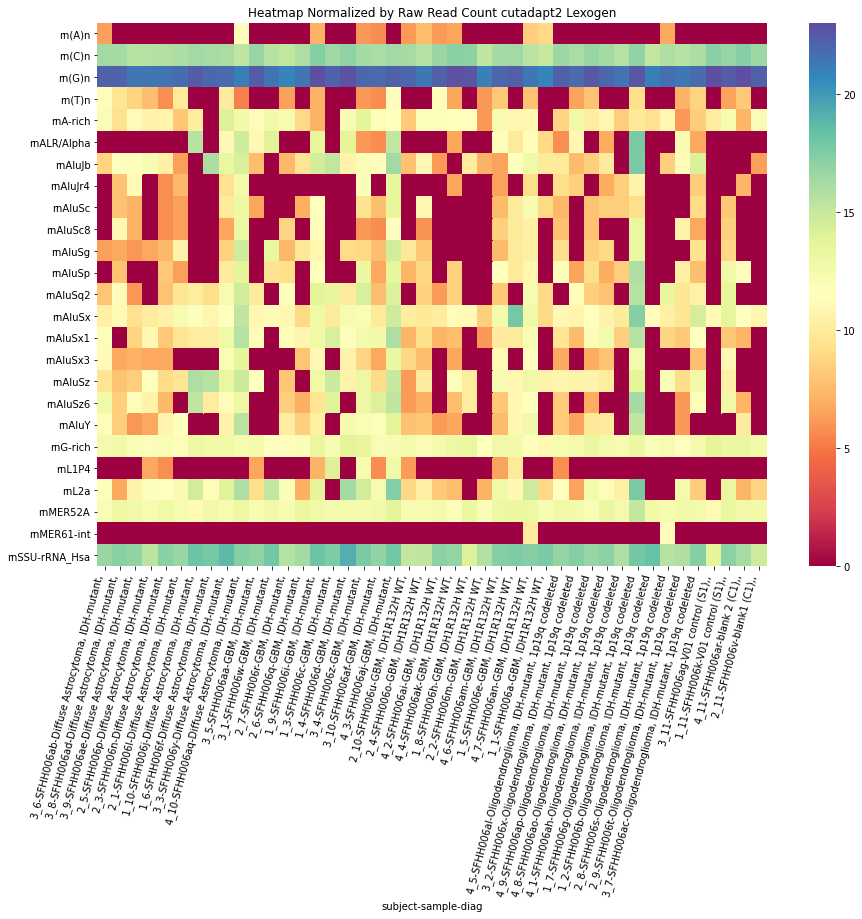

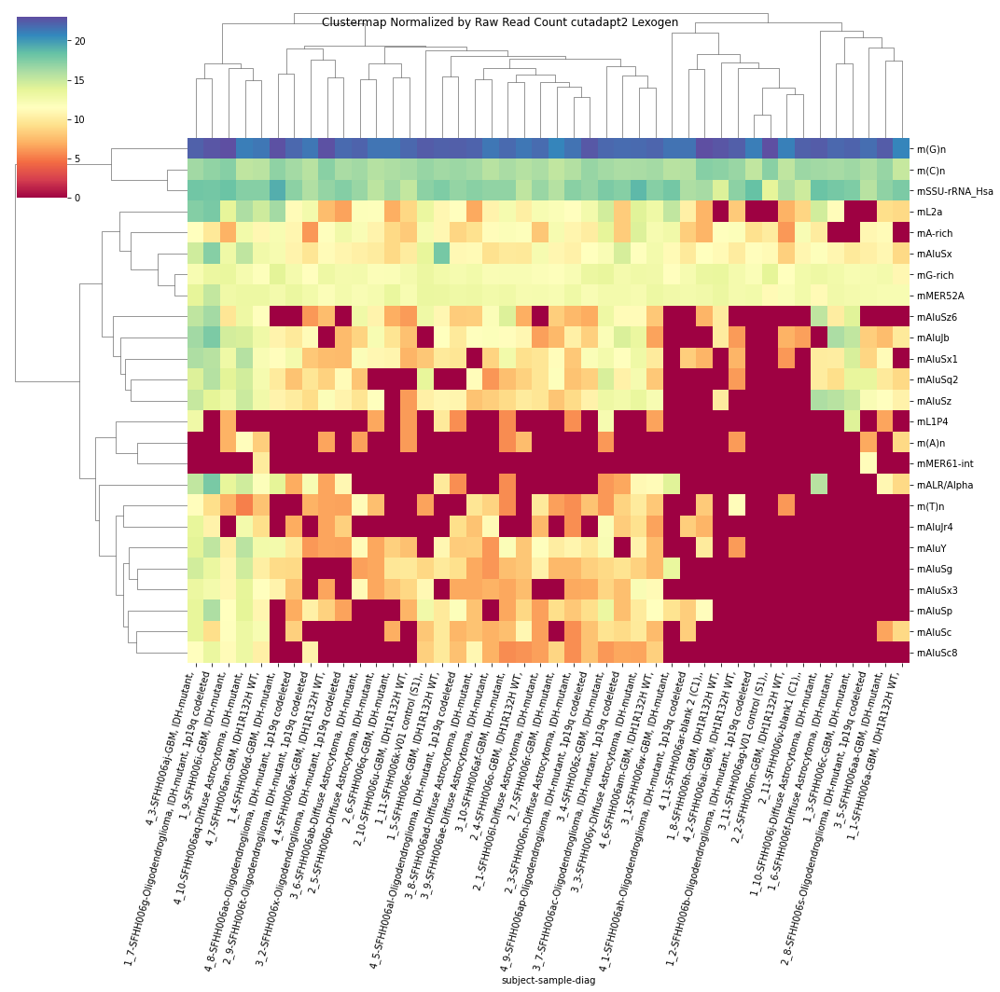

In [68]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap Normalized by Raw Read Count "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap Normalized by Raw Read Count "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

# Normalize by Trimmed Read Count

In [69]:
dfn=df.copy()

In [70]:
dfn.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rnL1M2,rnL1MB7,rnA-rich,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,4578177,57.8849,99328,2.16,...,297,306,87,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,7054912,60.3426,140222,1.98,...,3056,1883,5067,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,7067406,60.5684,138584,1.96,...,3268,2038,5298,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,4879448,132.375,105508,2.16,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,4877655,131.86,119834,2.45,...,524,594,273,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [71]:
dfn[rmskfamilies].head()

,rfSimple_repeat,rfAlu,rfL1,rfERV1,rfL2,rfERVL-MaLR,rfMIR,rfLow_complexity,rfERVL,rfhAT-Charlie,...,rfHelitron,rfhAT-Tip100?,rf5S-Deu-L2,rfDNA,rfERV1?,rfPenelope,rfRNA,rfDong-R4,rfTcMar?,rftRNA-Deu
0,496246,23725,25395,5066,7323,4905,3707,1791,2847,1807,...,2,38,35,10,2,1,NaN,NaN,NaN,9
1,809608,364708,158691,34998,18956,15716,6480,8057,9000,6203,...,12,40,36,12,42,3,NaN,NaN,2,10
2,812104,382295,169092,35749,19853,15872,6578,8245,9223,6539,...,11,40,36,12,42,3,NaN,NaN,2,10
3,2205852,31688,36882,79672,8776,6960,9422,18111,3843,2479,...,3,40,37,14,43,3,NaN,NaN,3,12
4,2200064,31740,36887,79644,9146,6971,9471,18108,3843,2479,...,3,40,37,14,43,3,NaN,NaN,3,12


In [72]:
dfn[rmskfamilies]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmskfamilies])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmskclasses]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmskclasses])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsknames]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsknames])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )


In [73]:
dfn[rmskfamilies].head()

,rfSimple_repeat,rfAlu,rfL1,rfERV1,rfL2,rfERVL-MaLR,rfMIR,rfLow_complexity,rfERVL,rfhAT-Charlie,...,rfHelitron,rfhAT-Tip100?,rf5S-Deu-L2,rfDNA,rfERV1?,rfPenelope,rfRNA,rfDong-R4,rfTcMar?,rftRNA-Deu
0,1.08e+08,5.18e+06,5.55e+06,1.11e+06,1.60e+06,1.07e+06,8.10e+05,3.91e+05,6.22e+05,394698.59,...,436.86,8300.25,7644.96,2184.28,436.86,218.43,NaN,NaN,NaN,1965.85
1,1.15e+08,5.17e+07,2.25e+07,4.96e+06,2.69e+06,2.23e+06,9.19e+05,1.14e+06,1.28e+06,879245.55,...,1700.94,5669.81,5102.83,1700.94,5953.30,425.24,NaN,NaN,283.49,1417.45
2,1.15e+08,5.41e+07,2.39e+07,5.06e+06,2.81e+06,2.25e+06,9.31e+05,1.17e+06,1.31e+06,925233.39,...,1556.44,5659.79,5093.81,1697.94,5942.77,424.48,NaN,NaN,282.99,1414.95
3,4.52e+08,6.49e+06,7.56e+06,1.63e+07,1.80e+06,1.43e+06,1.93e+06,3.71e+06,7.88e+05,508049.27,...,614.82,8197.65,7582.82,2869.18,8812.47,614.82,NaN,NaN,614.82,2459.29
4,4.51e+08,6.51e+06,7.56e+06,1.63e+07,1.88e+06,1.43e+06,1.94e+06,3.71e+06,7.88e+05,508236.03,...,615.05,8200.66,7585.61,2870.23,8815.71,615.05,NaN,NaN,615.05,2460.20


rfSimple_repeat D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8404642351433276
	p = 0.08224756419670354
rfSimple_repeat D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8404642351433276
	p = 0.08224756419670354


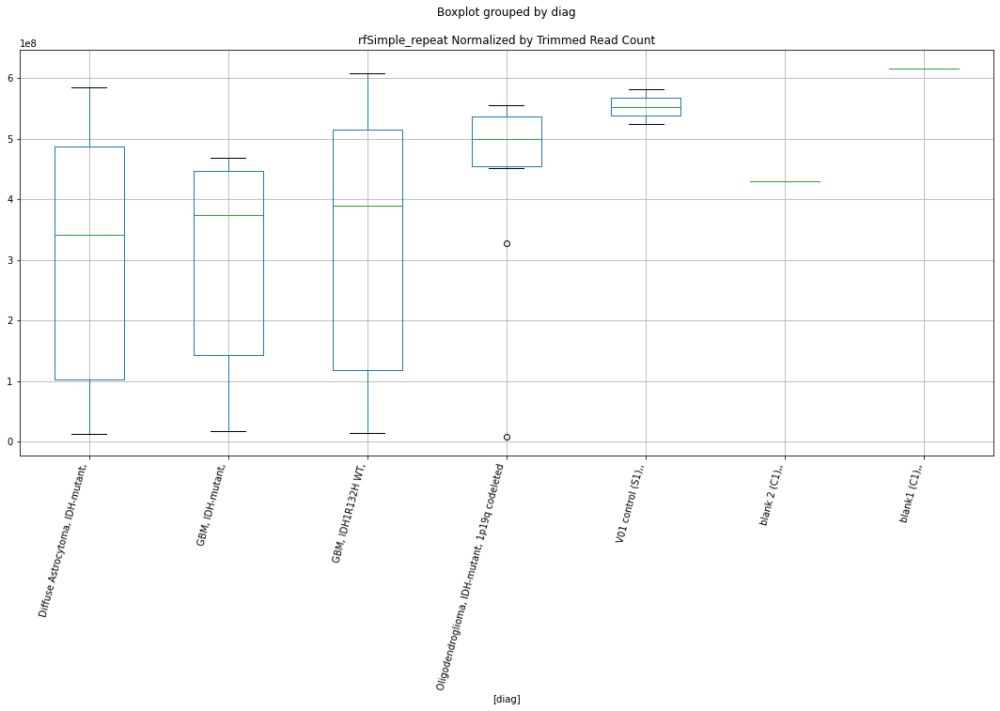

rfSimple_repeat D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8433339110051457
	p = 0.08180970868648885
rfSimple_repeat D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8433339110051457
	p = 0.08180970868648885


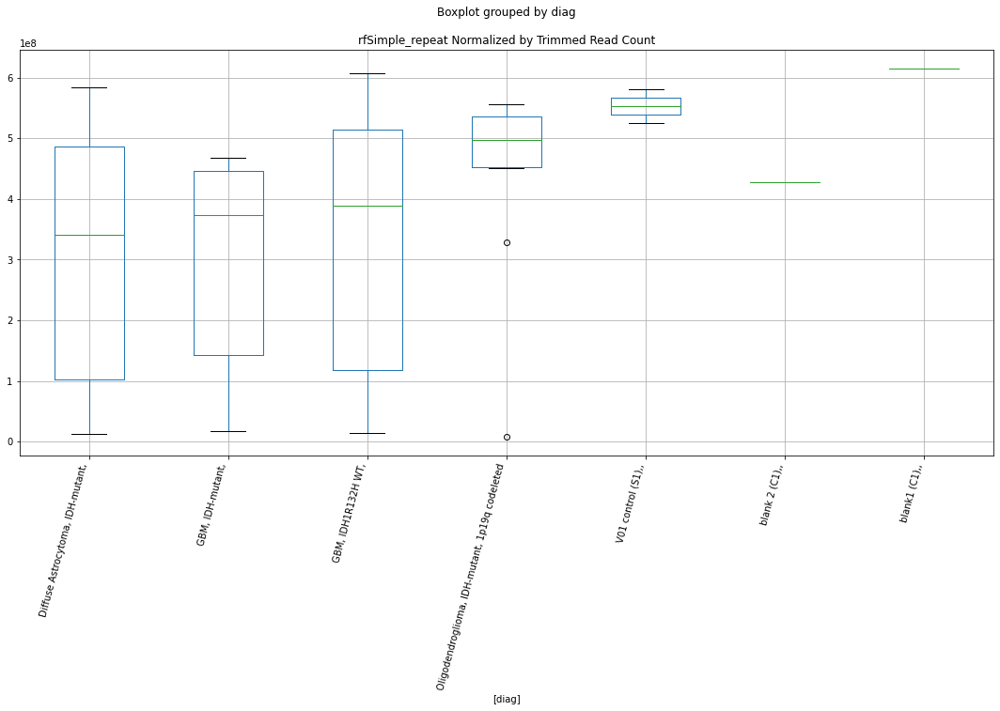

rfSimple_repeat D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8432501441887092
	p = 0.08182246072987008
rfSimple_repeat D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8432501441887092
	p = 0.08182246072987008


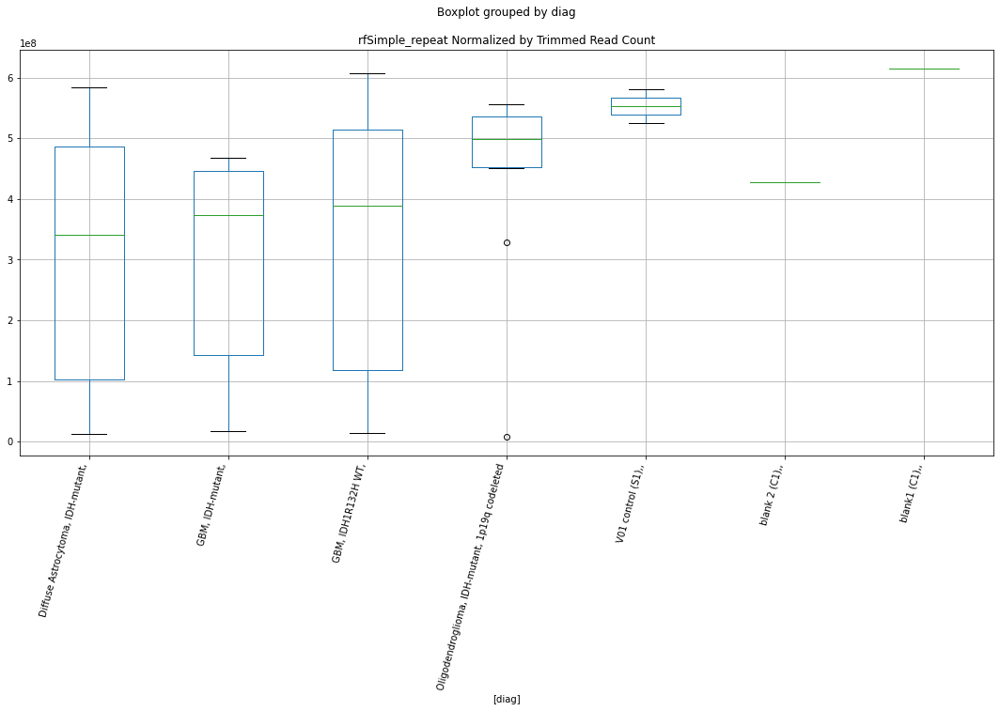

rfAlu D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2939007334217747
	p = 0.034045642882525776
rfAlu D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2939007334217747
	p = 0.034045642882525776


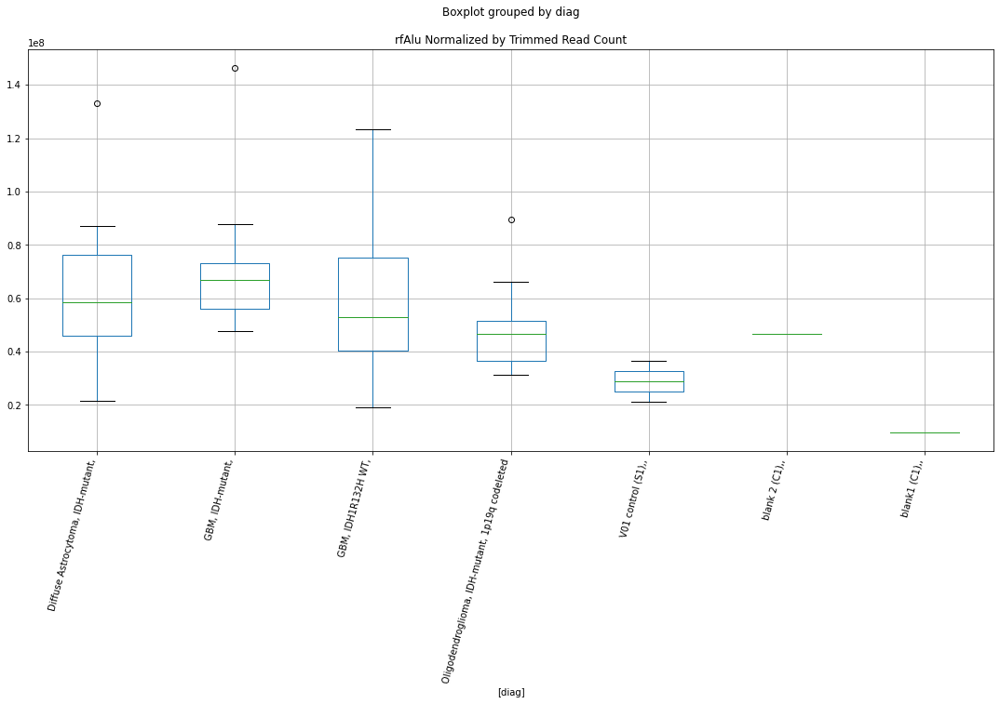

rfAlu D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3770499357439916
	p = 0.028747635280979664
rfAlu D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3770499357439916
	p = 0.028747635280979664


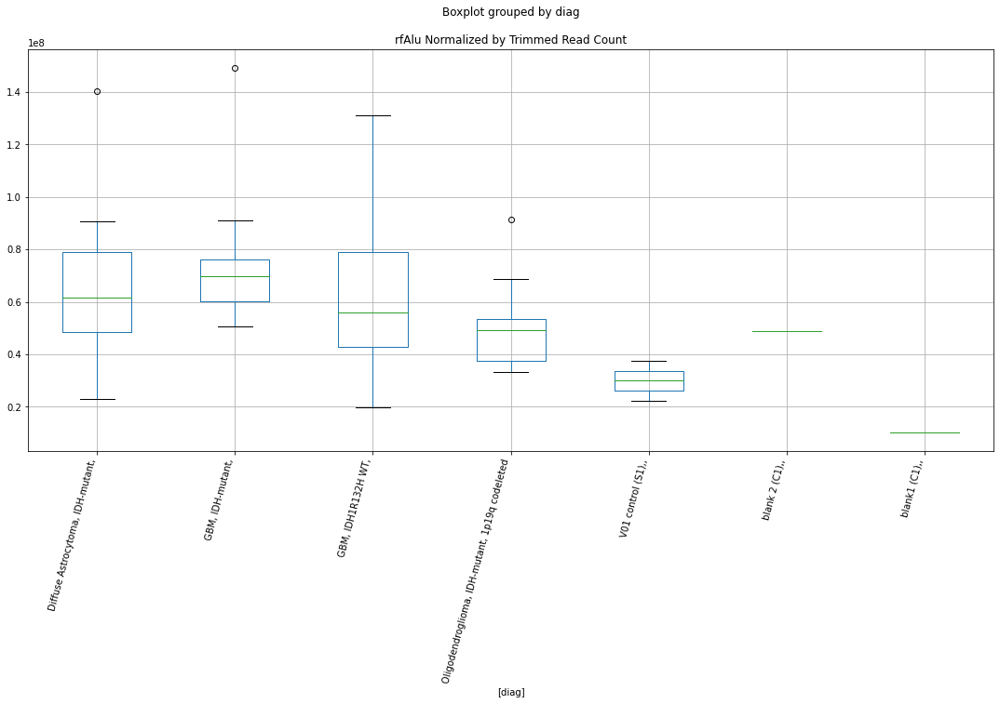

rfERV1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9838688323978066
	p = 0.06273441899697474
rfERV1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2985399259022445
	p = 0.033727653848881343
rfERV1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9838688323978066
	p = 0.06273441899697474
rfERV1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2985399259022445
	p = 0.033727653848881343


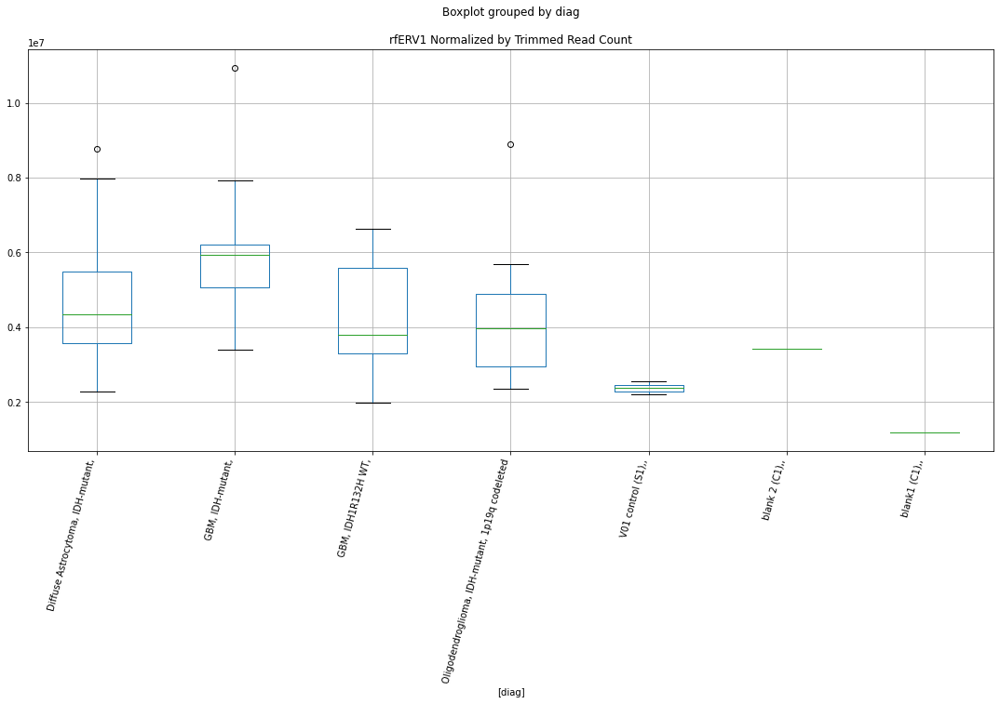

rfERV1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0178194635884963
	p = 0.05876935727925097
rfERV1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2769437421266865
	p = 0.03523172065379932
rfERV1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0178194635884963
	p = 0.05876935727925097
rfERV1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2769437421266865
	p = 0.03523172065379932


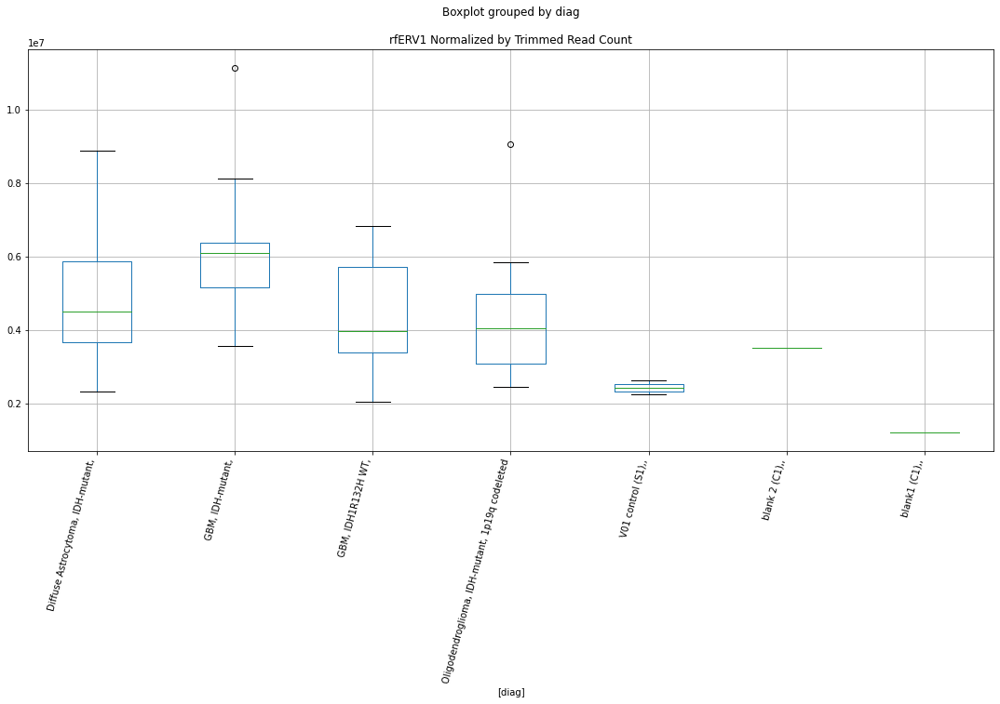

rfLow_complexity D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.19085313117115
	p = 0.04186419576833017
rfLow_complexity D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.19085313117115
	p = 0.04186419576833017


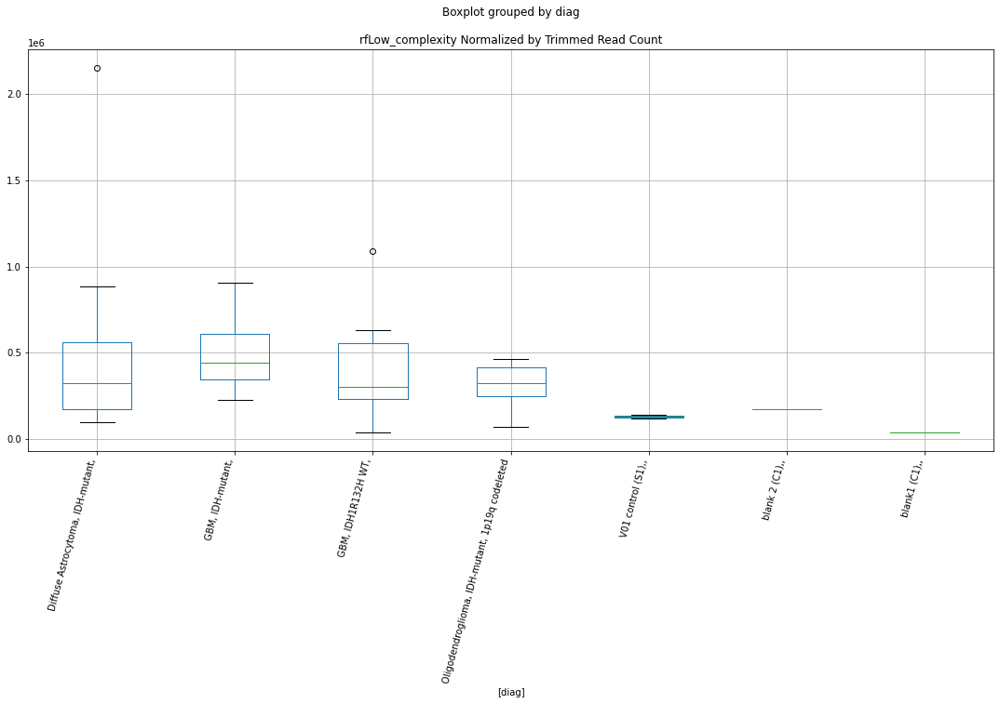

rfLow_complexity D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0293617378671405
	p = 0.057473612244592805
rfLow_complexity D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0293617378671405
	p = 0.057473612244592805


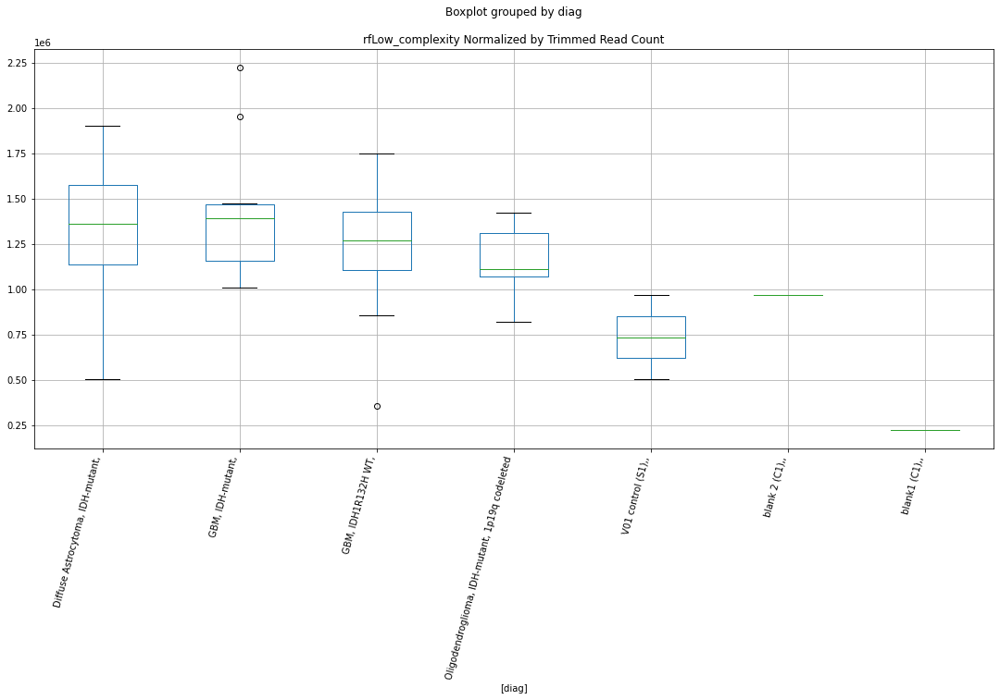

rfLow_complexity D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2153225016157365
	p = 0.03987083515395443
rfLow_complexity D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2153225016157365
	p = 0.03987083515395443


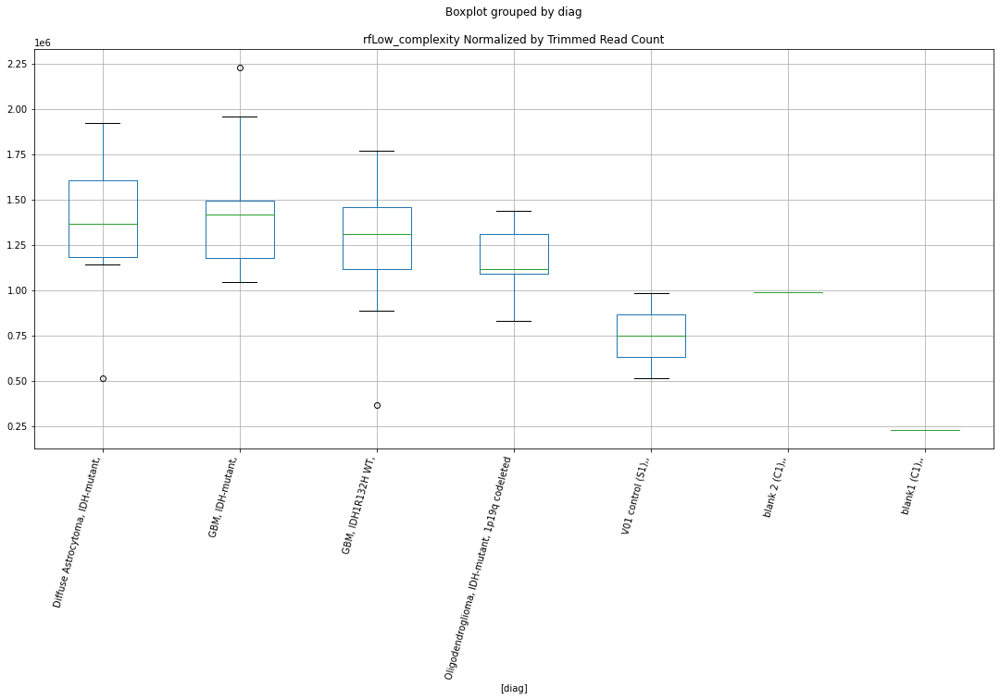

rfLow_complexity Lexogen bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9135752593886837
	p = 0.07171399824434362
rfLow_complexity Lexogen bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9135752593886837
	p = 0.07171399824434362


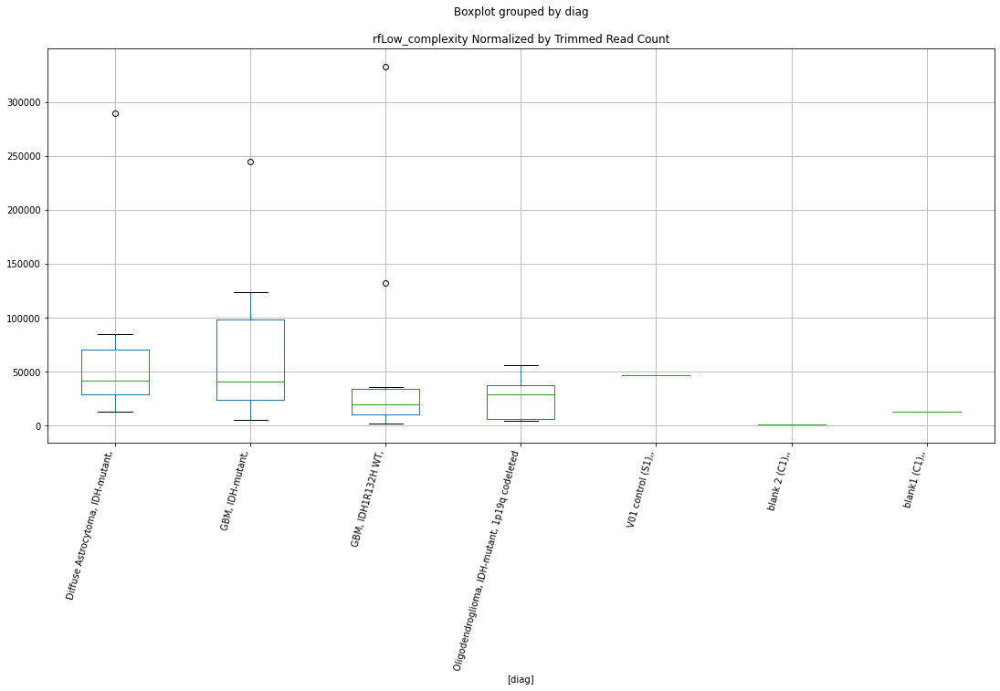

rfLow_complexity Lexogen bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9200741698770447
	p = 0.0708382487534843
rfLow_complexity Lexogen bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9200741698770447
	p = 0.0708382487534843


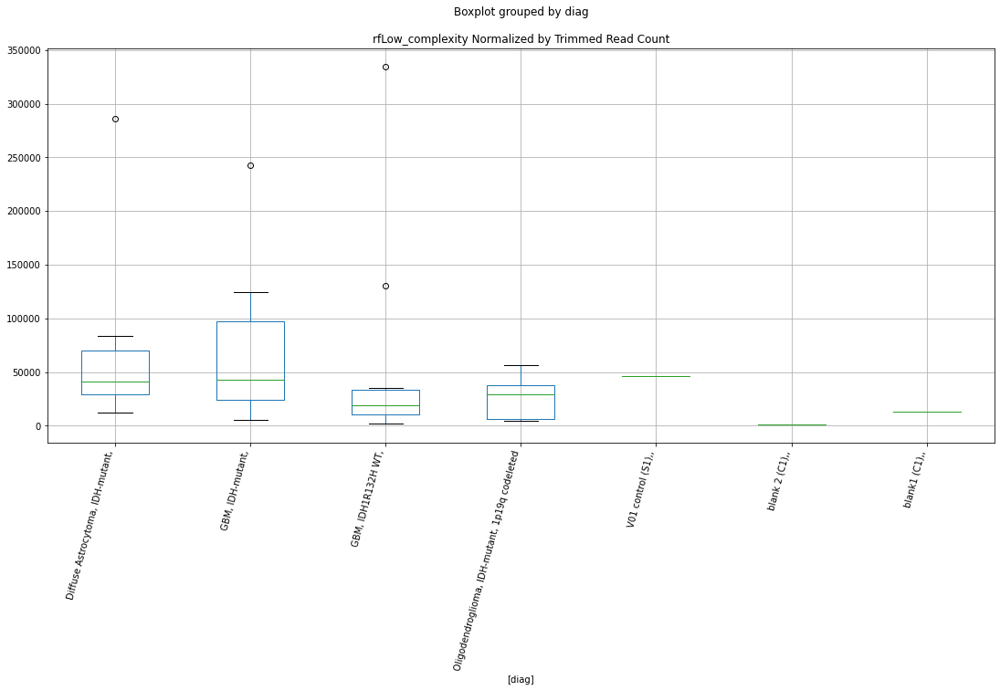

rfLow_complexity Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7347327058786157
	p = 0.09987871446258775
rfLow_complexity Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7347327058786157
	p = 0.09987871446258775


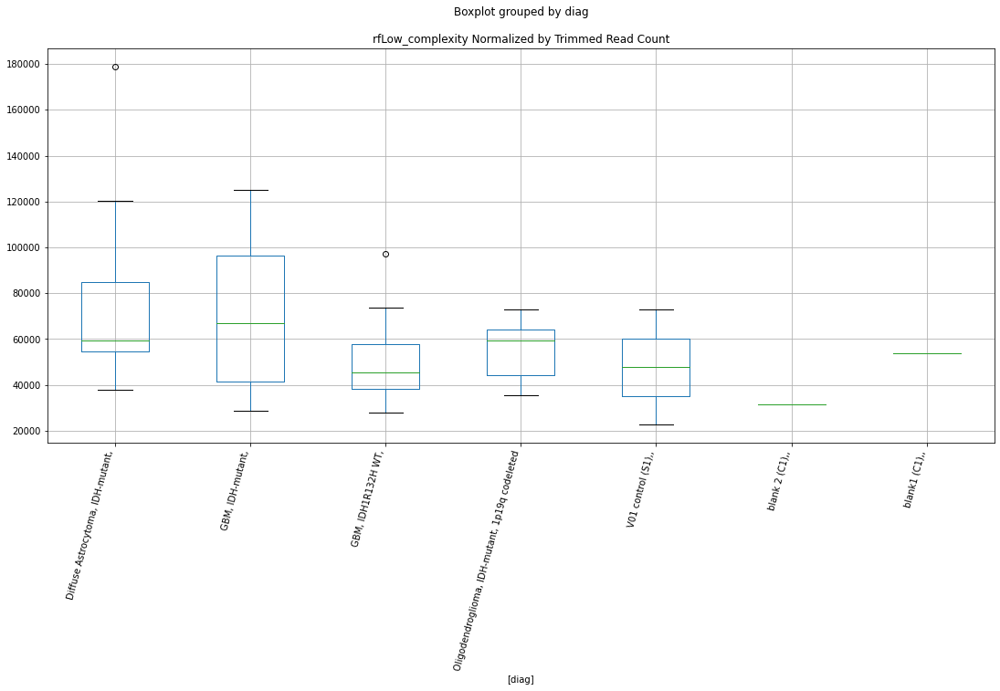

rfLow_complexity Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9191977163372607
	p = 0.07095579643099292
rfLow_complexity Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9191977163372607
	p = 0.07095579643099292


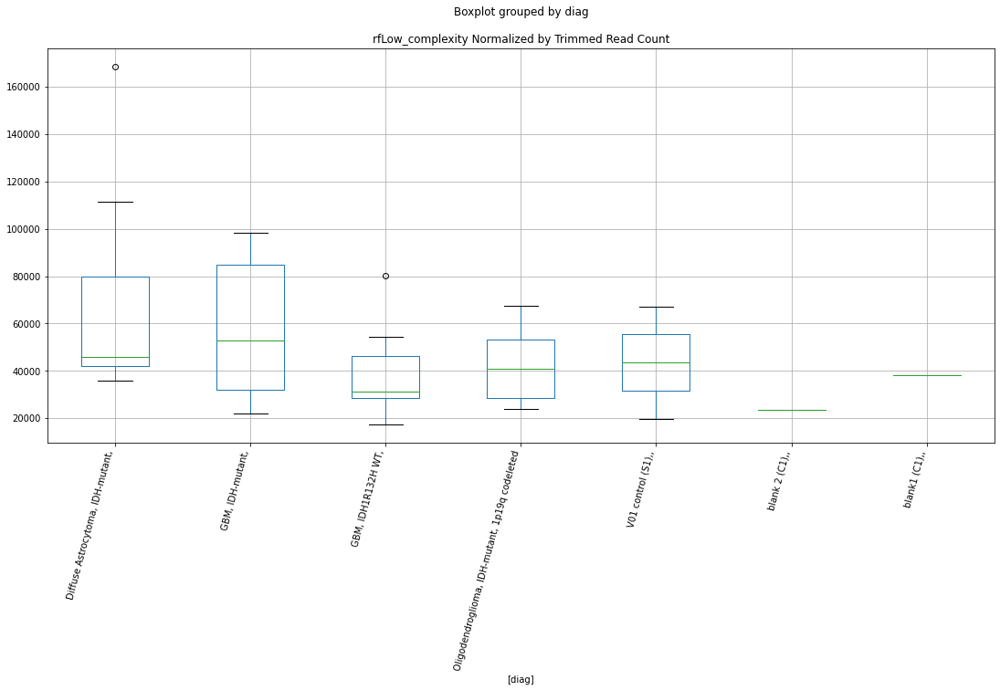

rfLow_complexity Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.853235831208527
	p = 0.08031458004017972
rfLow_complexity Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.853235831208527
	p = 0.08031458004017972


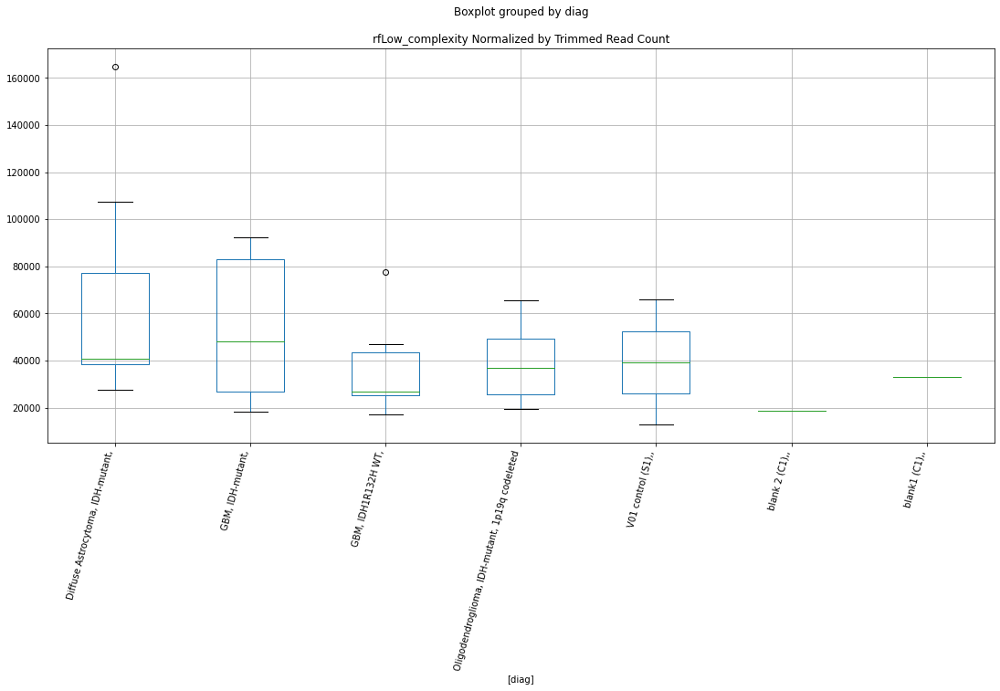

rfrRNA D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7509709469889445
	p = 0.09697404158718215
rfrRNA D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7509709469889445
	p = 0.09697404158718215


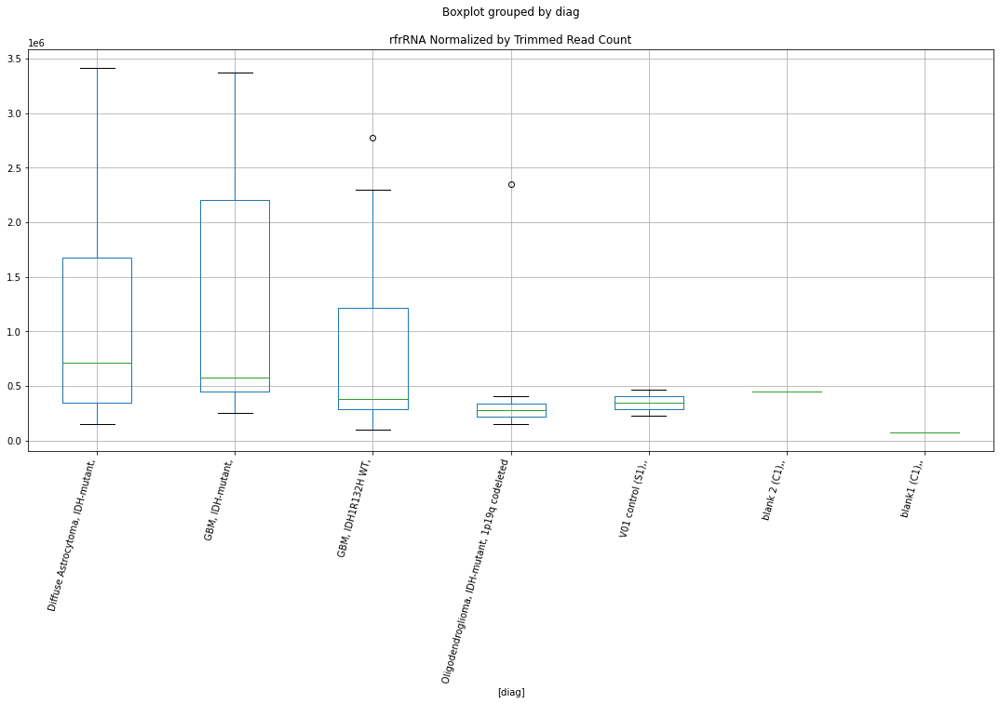

rfrRNA D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7502581067681915
	p = 0.09709999986270744
rfrRNA D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7502581067681915
	p = 0.09709999986270744


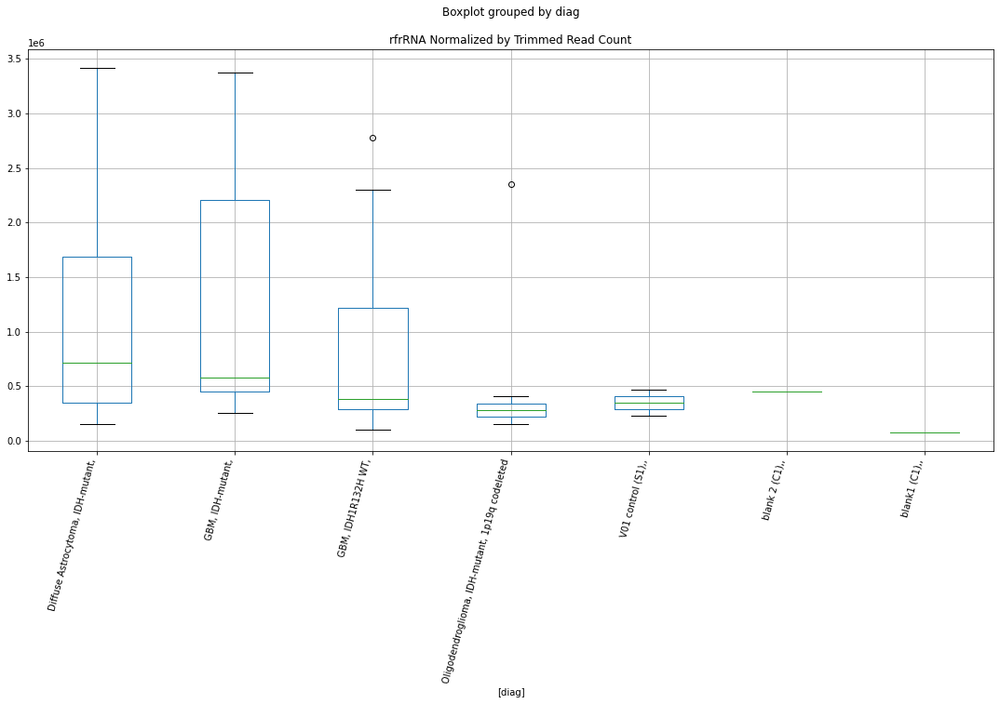

rfrRNA D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7502669534652913
	p = 0.09709843578970356
rfrRNA D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7502669534652913
	p = 0.09709843578970356


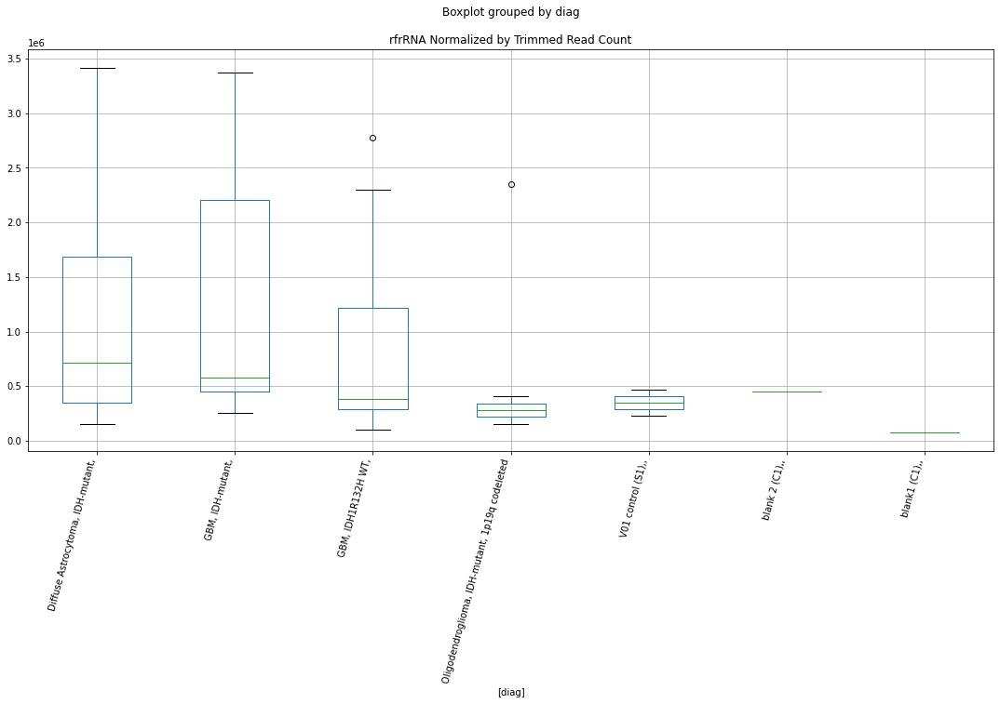

rfcentr D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7669775305495035
	p = 0.09418278761746916
rfcentr D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7669775305495035
	p = 0.09418278761746916


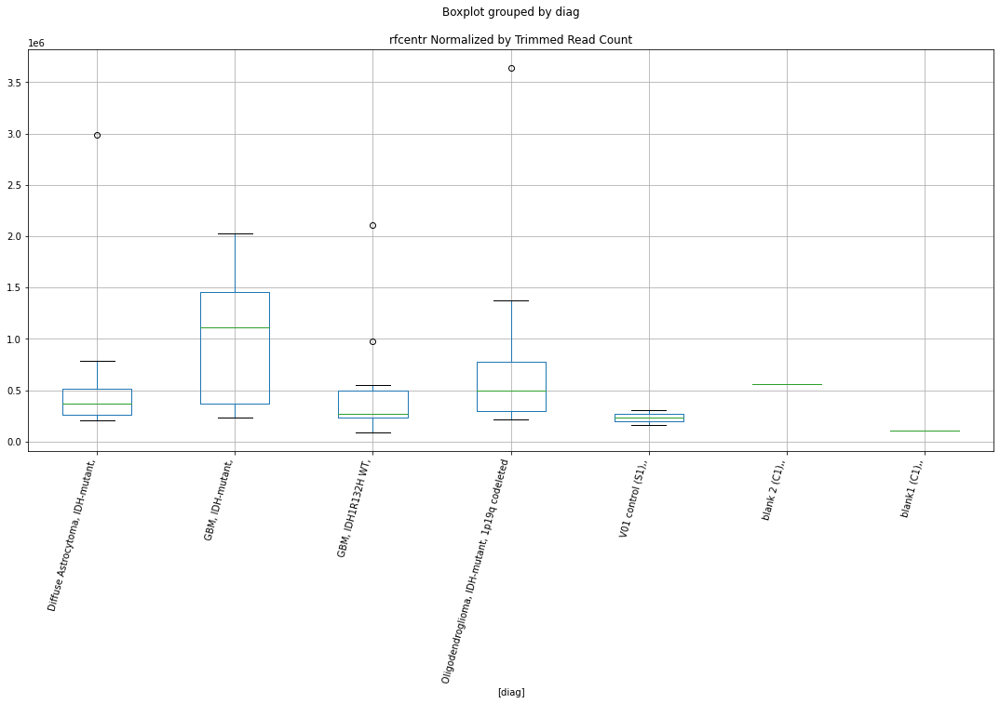

rfcentr D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.761088091204464
	p = 0.09520157351416017
rfcentr D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.761088091204464
	p = 0.09520157351416017


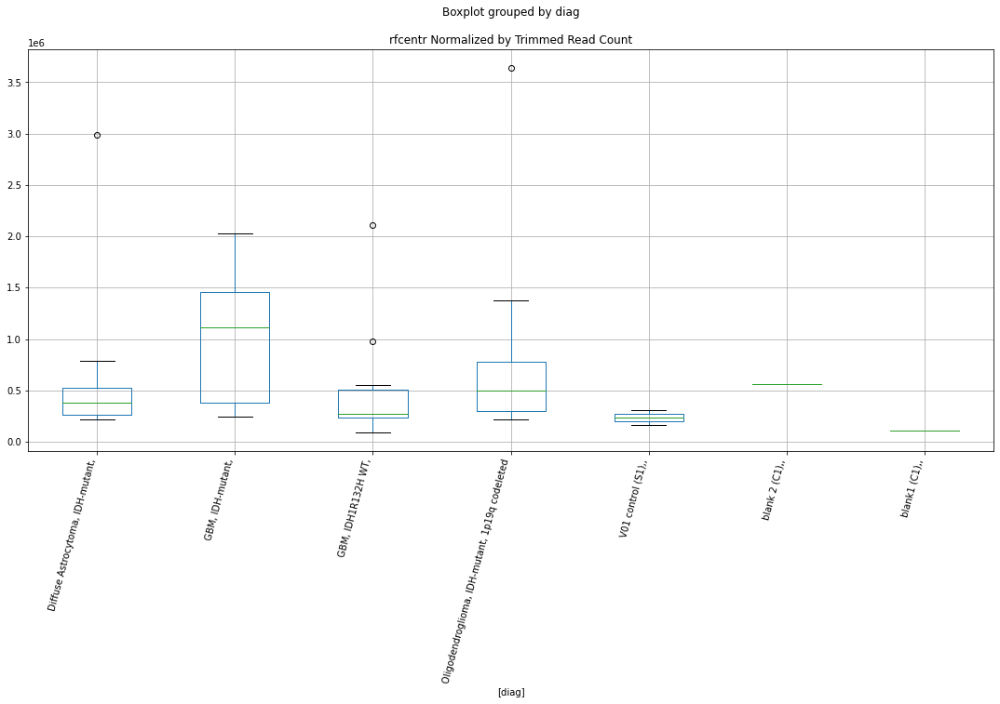

rfSatellite D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9134336248178272
	p = 0.07173319060920728
rfSatellite D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9134336248178272
	p = 0.07173319060920728


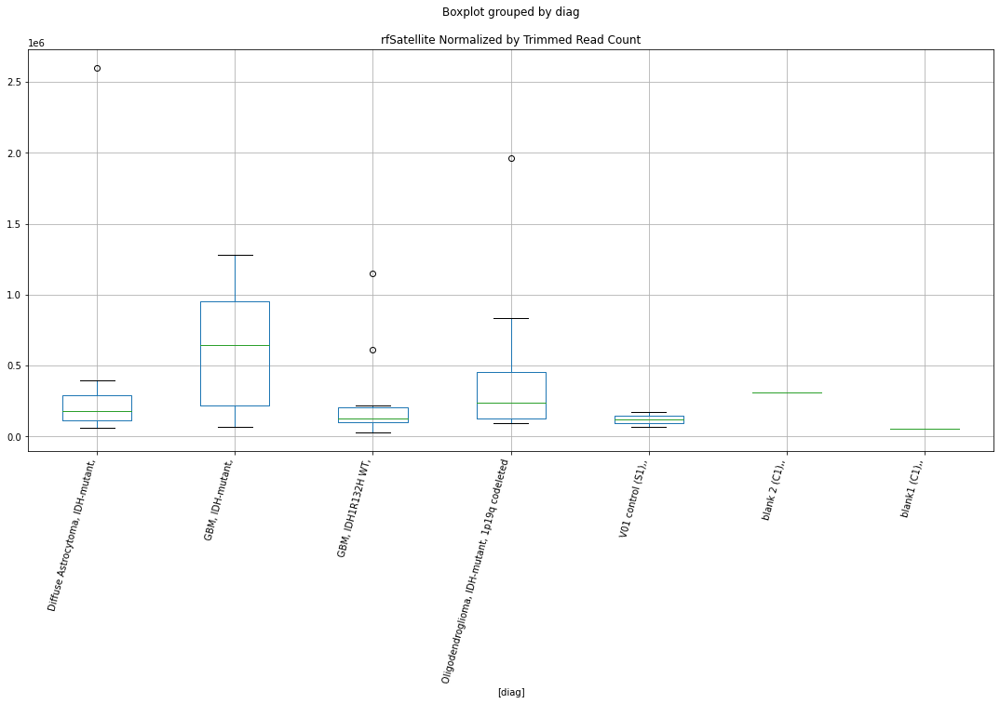

rfSatellite D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.914015502704818
	p = 0.07165437166202614
rfSatellite D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.914015502704818
	p = 0.07165437166202614


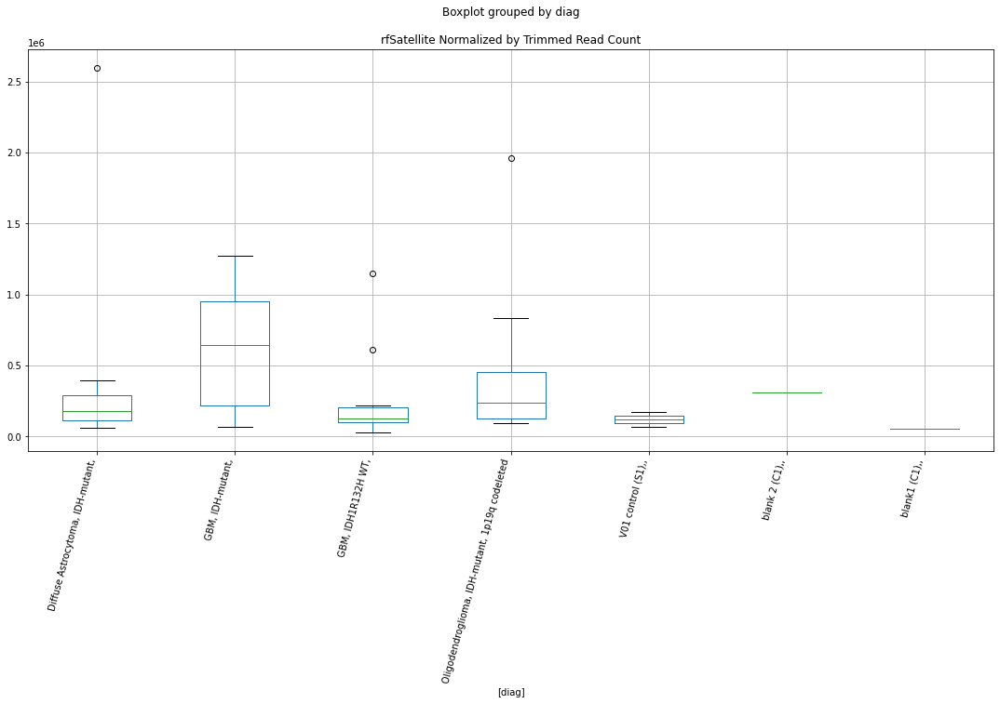

rfCR1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7921331679976948
	p = 0.08993728018998672
rfCR1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7921331679976948
	p = 0.08993728018998672


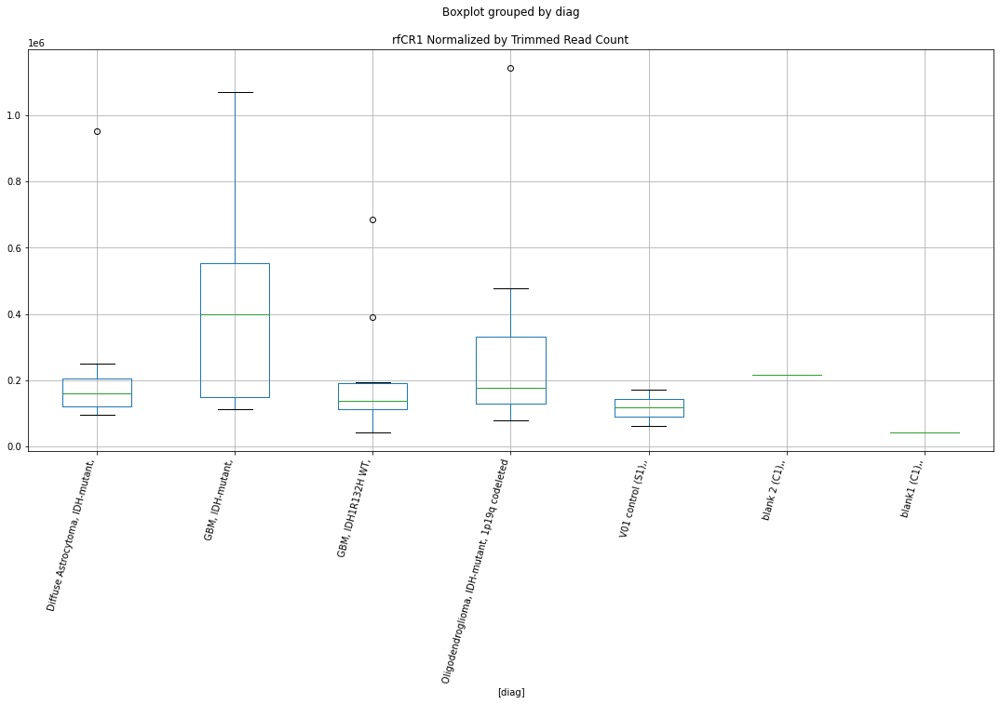

rfCR1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7857977820445625
	p = 0.09099046974269827
rfCR1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7857977820445625
	p = 0.09099046974269827


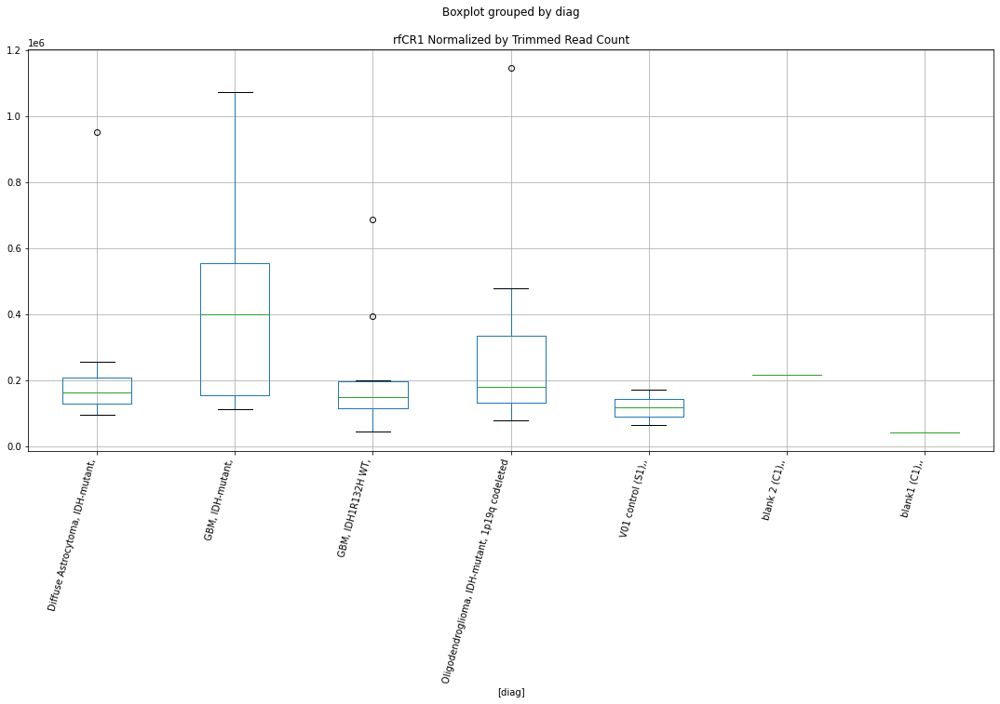

rfhAT-Tip100 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8386339873281177
	p = 0.0825278986767618
rfhAT-Tip100 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8386339873281177
	p = 0.0825278986767618


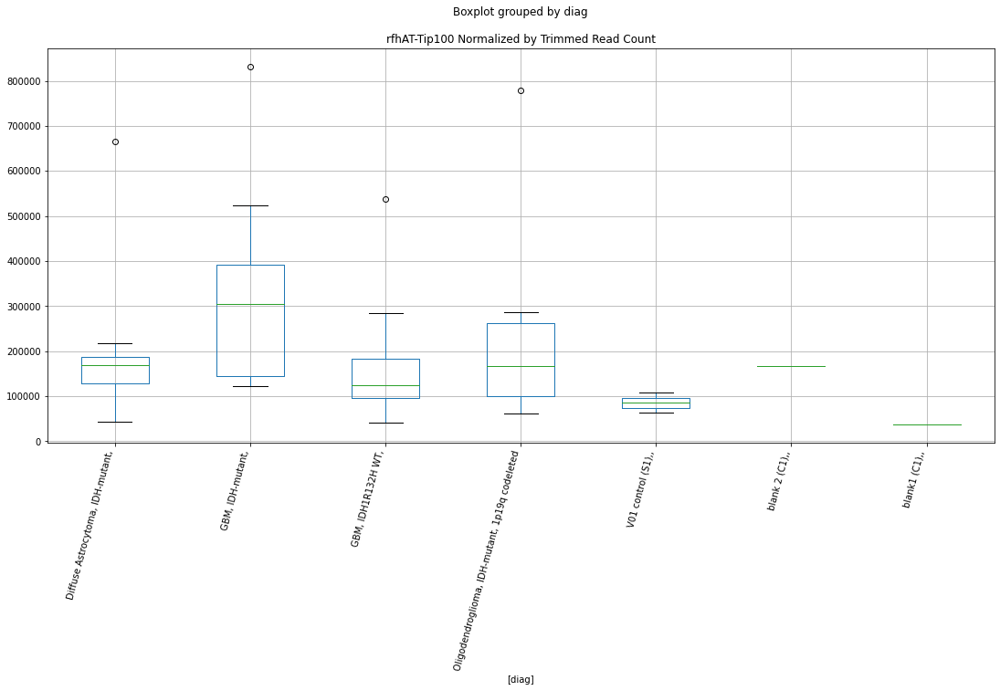

rfhAT-Tip100 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8448131639330048
	p = 0.08158480597512097
rfhAT-Tip100 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8448131639330048
	p = 0.08158480597512097


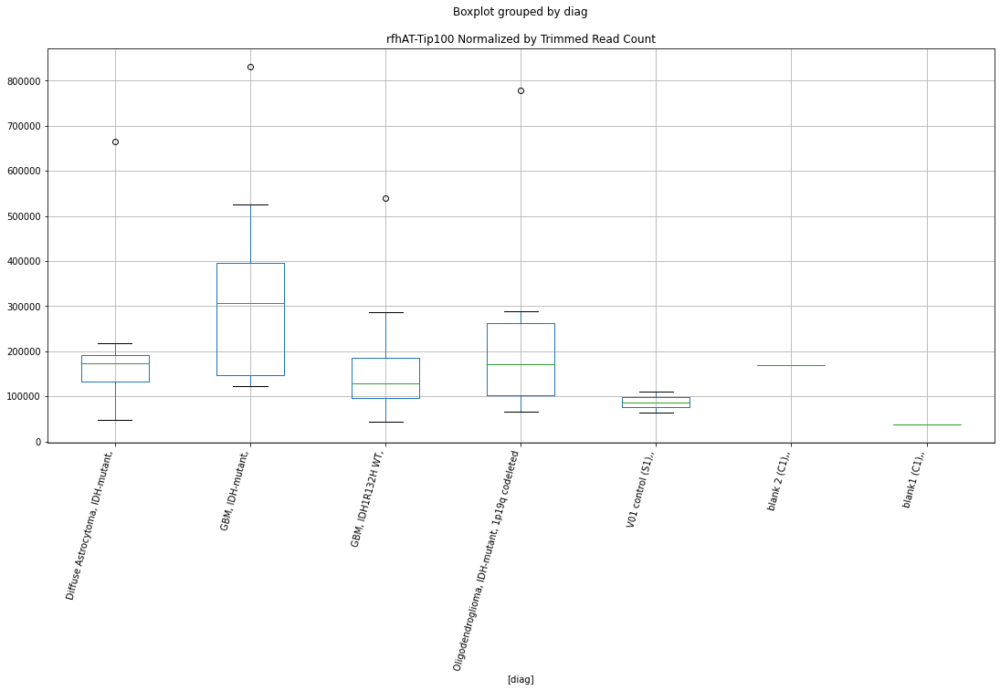

rfERVK D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8895259206463084
	p = 0.07503891515569196
rfERVK D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8895259206463084
	p = 0.07503891515569196


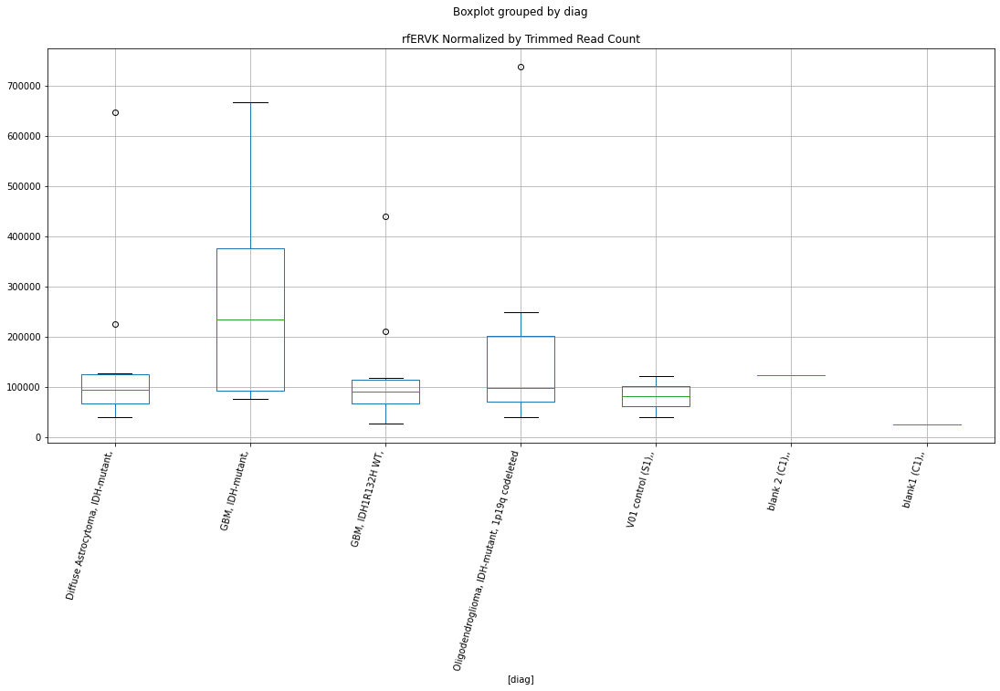

rfERVK D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8946855402190892
	p = 0.0743142825340901
rfERVK D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8946855402190892
	p = 0.0743142825340901


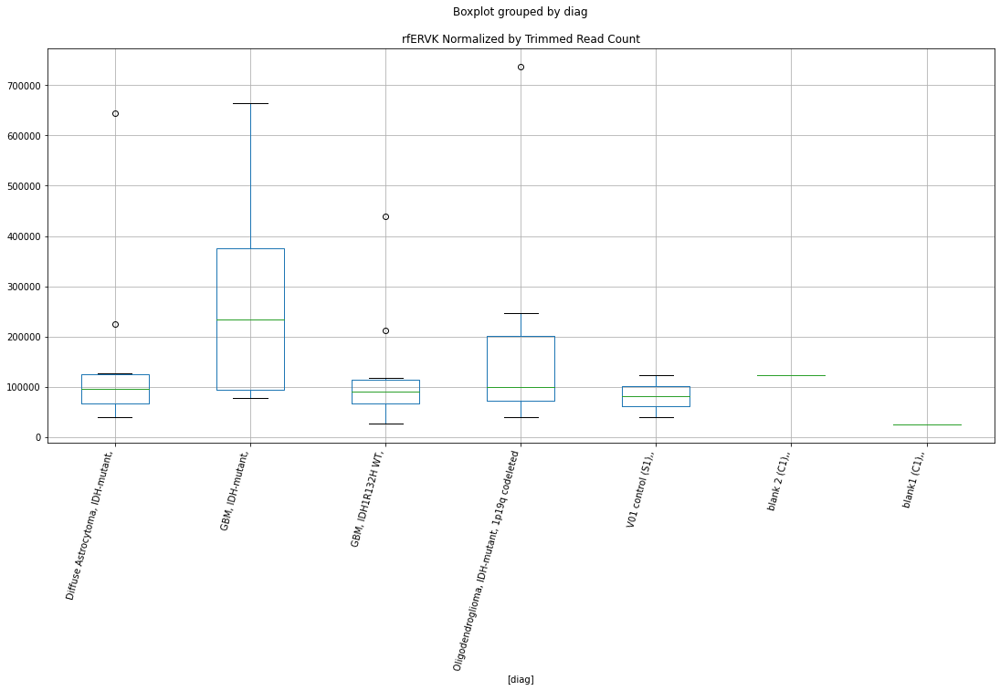

rftRNA D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9625171635746494
	p = 0.06534934195663838
rftRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9625171635746494
	p = 0.06534934195663838


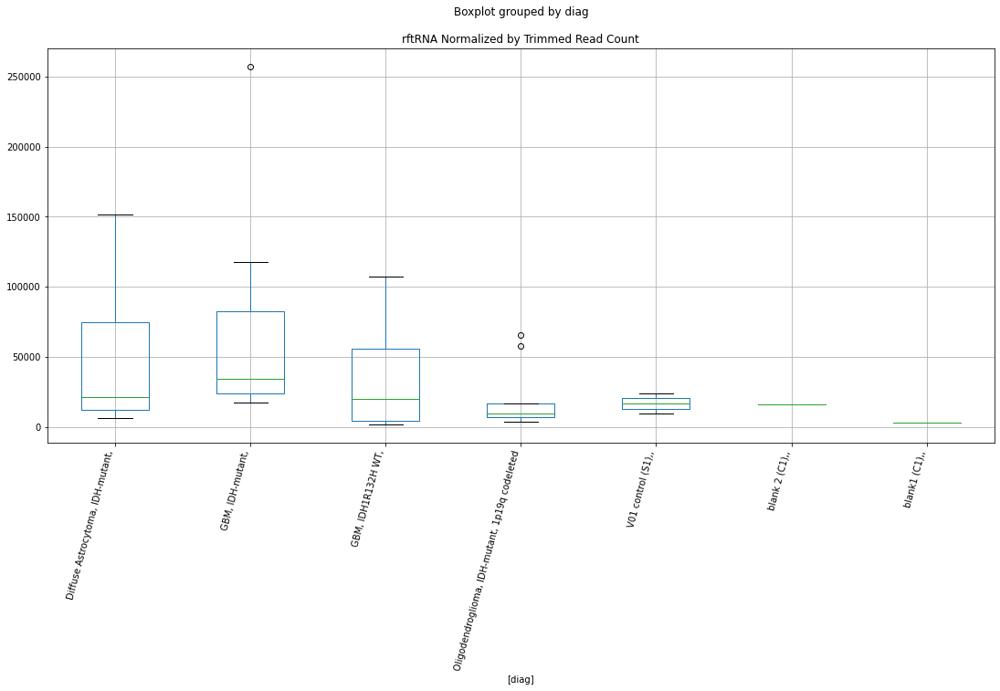

rftRNA D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9679550872875466
	p = 0.064674267585798
rftRNA D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9679550872875466
	p = 0.064674267585798


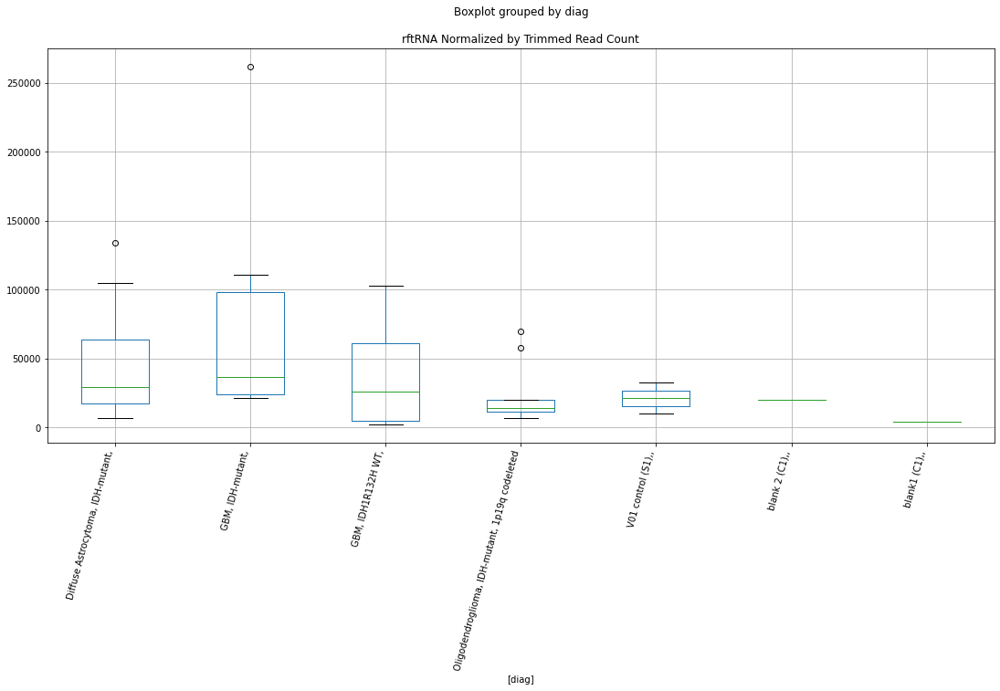

rftRNA D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9670883111715727
	p = 0.06478145116299441
rftRNA D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9670883111715727
	p = 0.06478145116299441


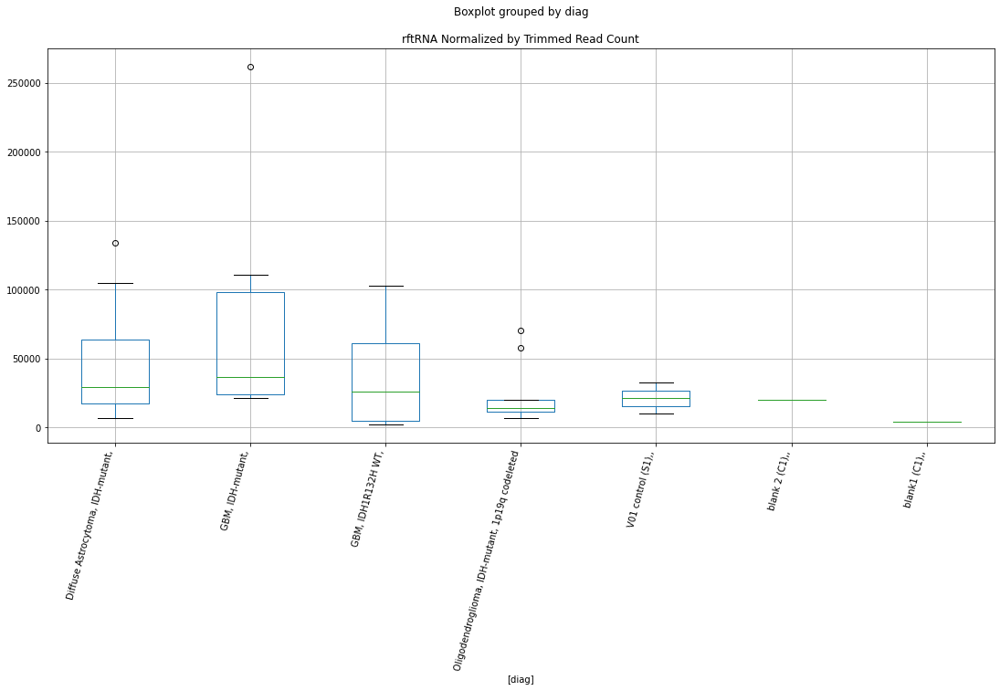

rftRNA D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.967044976307778
	p = 0.0647868140232813
rftRNA D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.967044976307778
	p = 0.0647868140232813


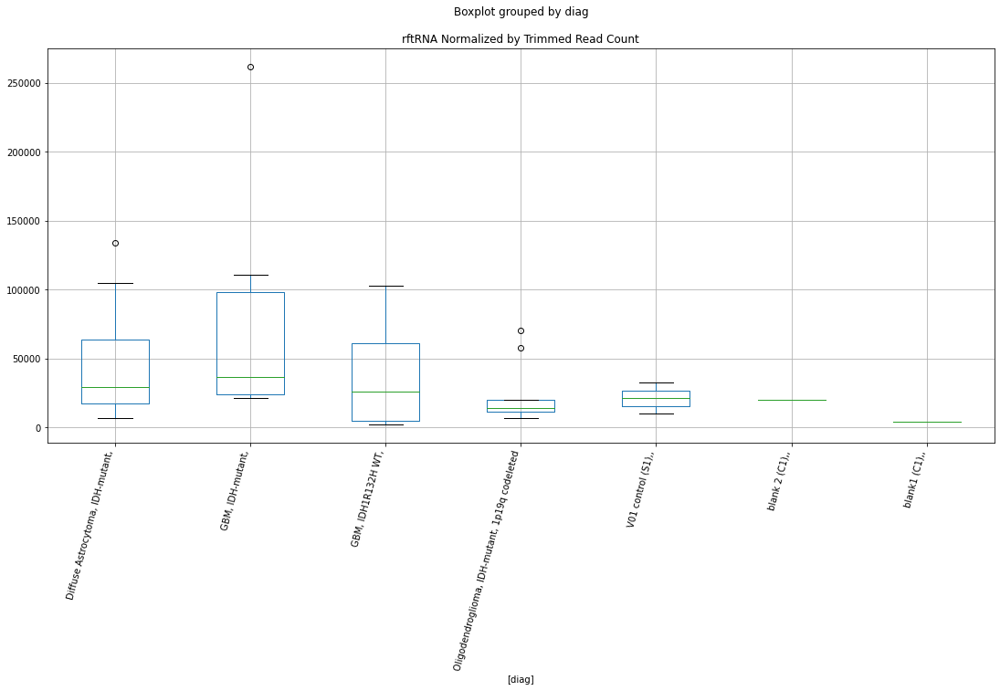

rfRTE-X D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7416460669846263
	p = 0.09863298273198713
rfRTE-X D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7416460669846263
	p = 0.09863298273198713


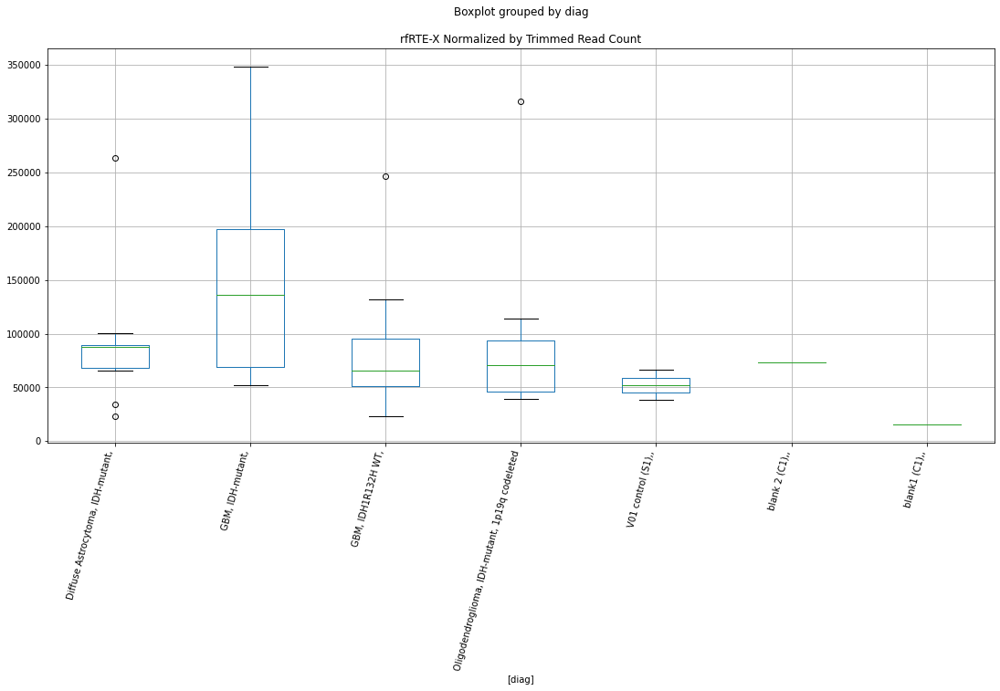

rfRTE-X D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7503437021647215
	p = 0.09708486773636932
rfRTE-X D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7503437021647215
	p = 0.09708486773636932


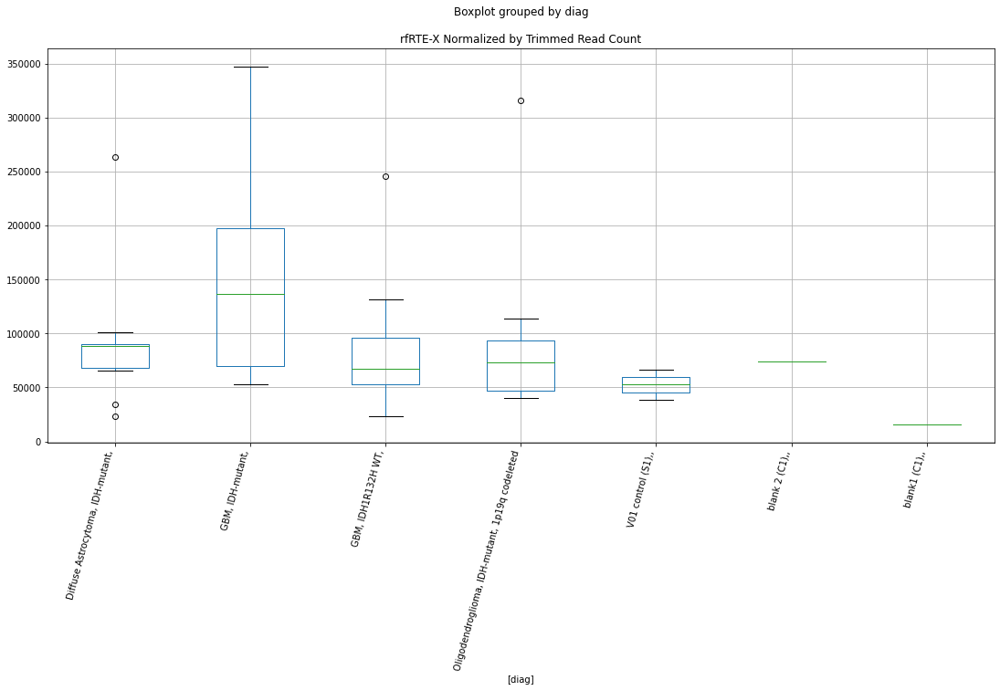

rfGypsy? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.007651641362397
	p = 0.05993253038685344
rfGypsy? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.007651641362397
	p = 0.05993253038685344


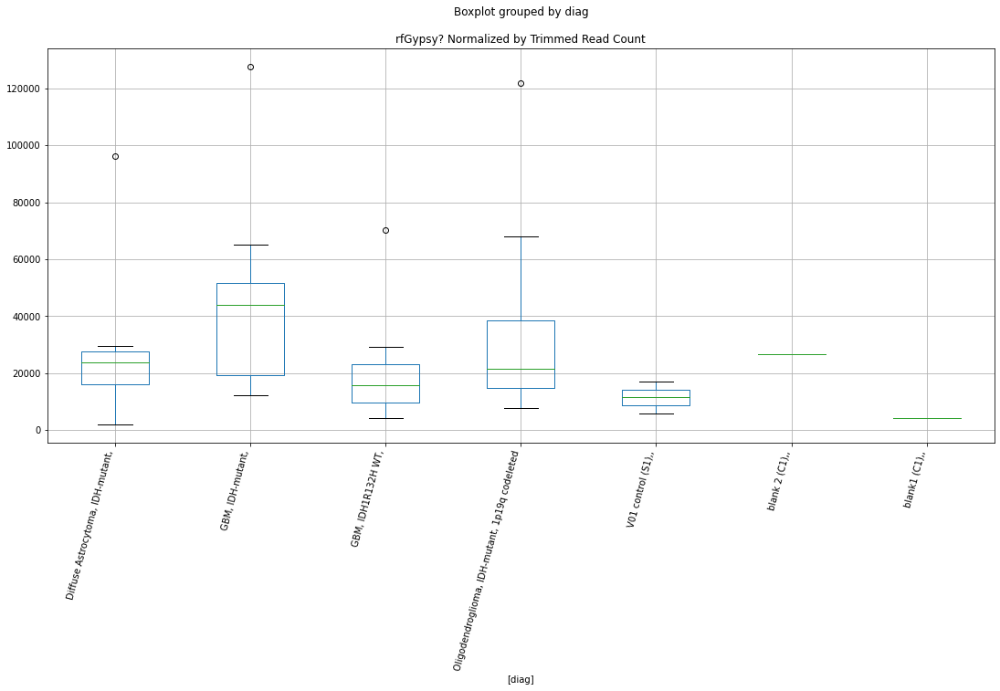

rfGypsy? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9978755343035814
	p = 0.06107036929986241
rfGypsy? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9978755343035814
	p = 0.06107036929986241


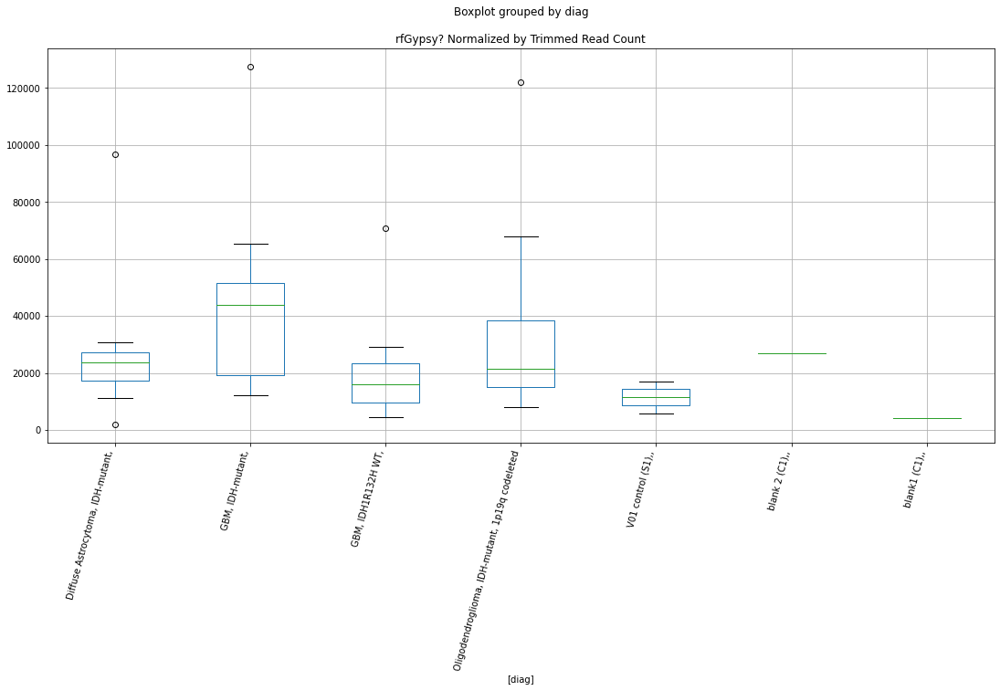

rfGypsy? D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7601998014810352
	p = 0.09535606245954666
rfGypsy? D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7601998014810352
	p = 0.09535606245954666


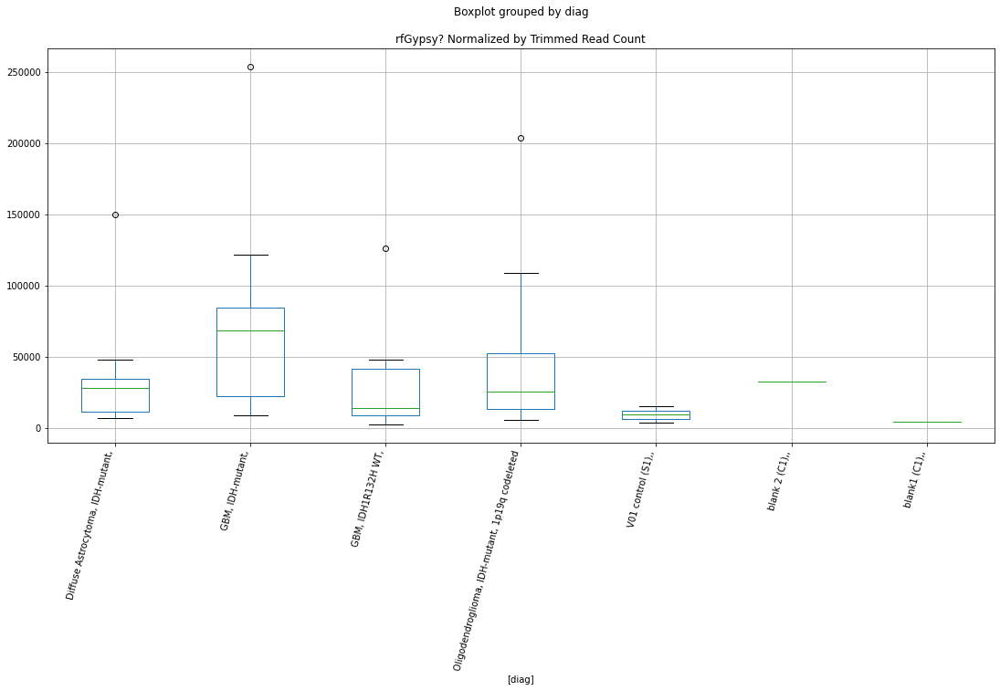

rfGypsy? D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.761392234829038
	p = 0.095148727663195
rfGypsy? D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.761392234829038
	p = 0.095148727663195


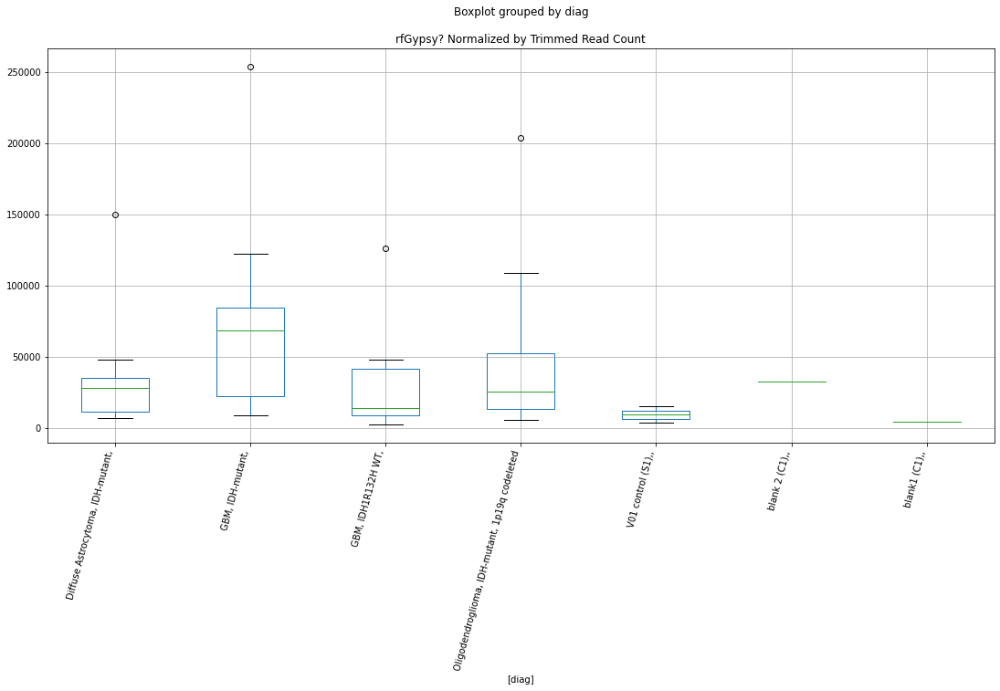

rfGypsy? D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7613505301751706
	p = 0.09515597246188669
rfGypsy? D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7613505301751706
	p = 0.09515597246188669


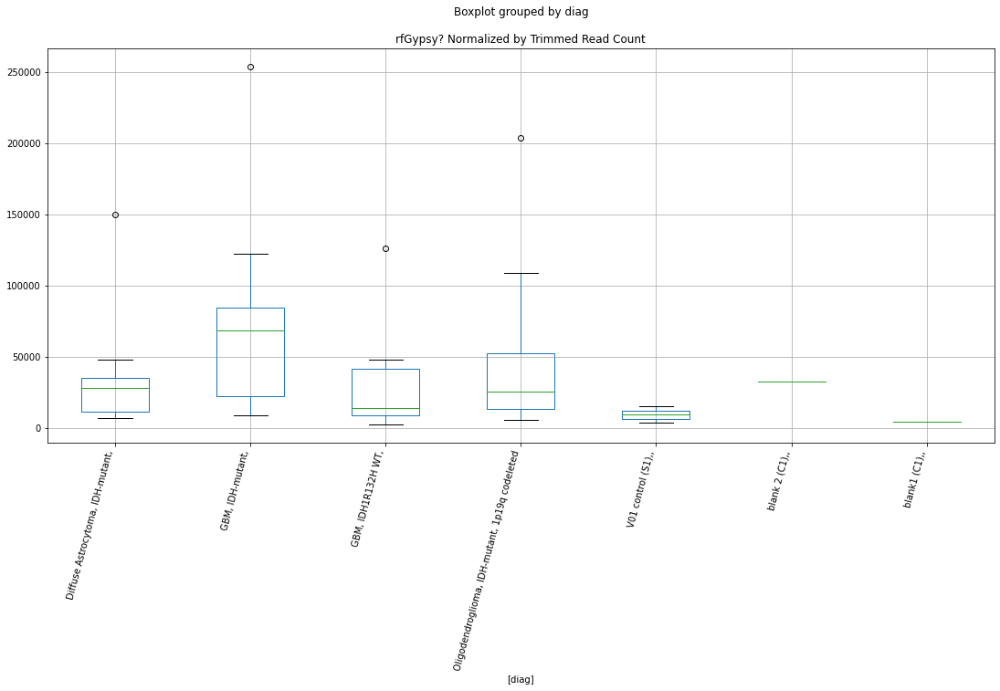

rfhAT D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.460615723915925
	p = 0.024206373259450714
rfhAT D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.460615723915925
	p = 0.024206373259450714


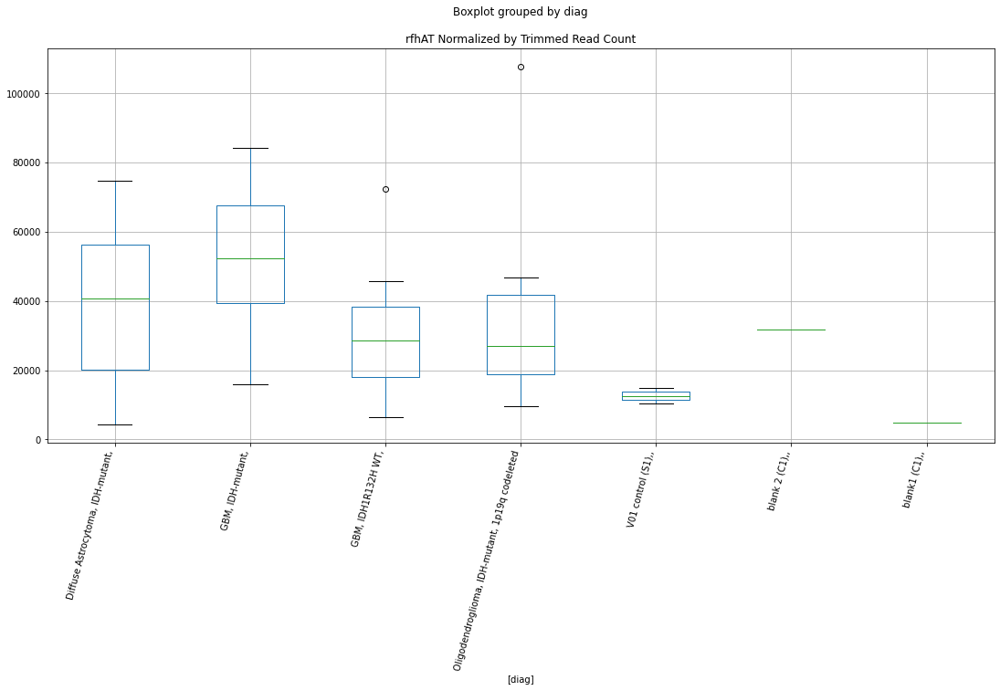

rfhAT D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.4626153190758684
	p = 0.024106439785203722
rfhAT D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.4626153190758684
	p = 0.024106439785203722


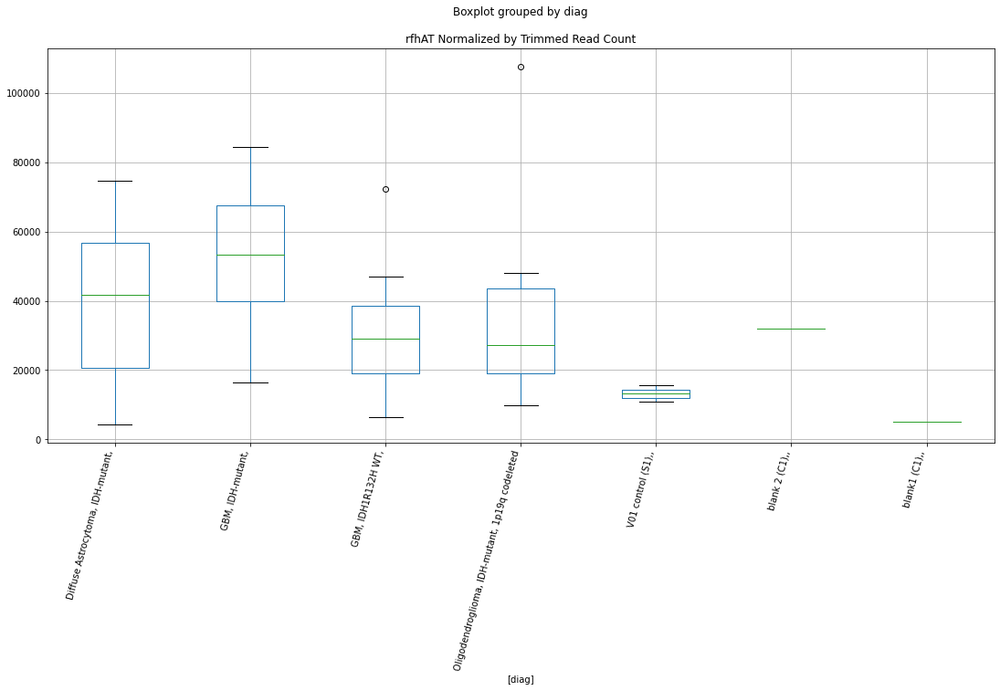

rfhAT D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2320964989924104
	p = 0.038555199002796026
rfhAT D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7736134783149253
	p = 0.09304623672908738
rfhAT D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.2320964989924104
	p = 0.038555199002796026
rfhAT D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7736134783149253
	p = 0.09304623672908738


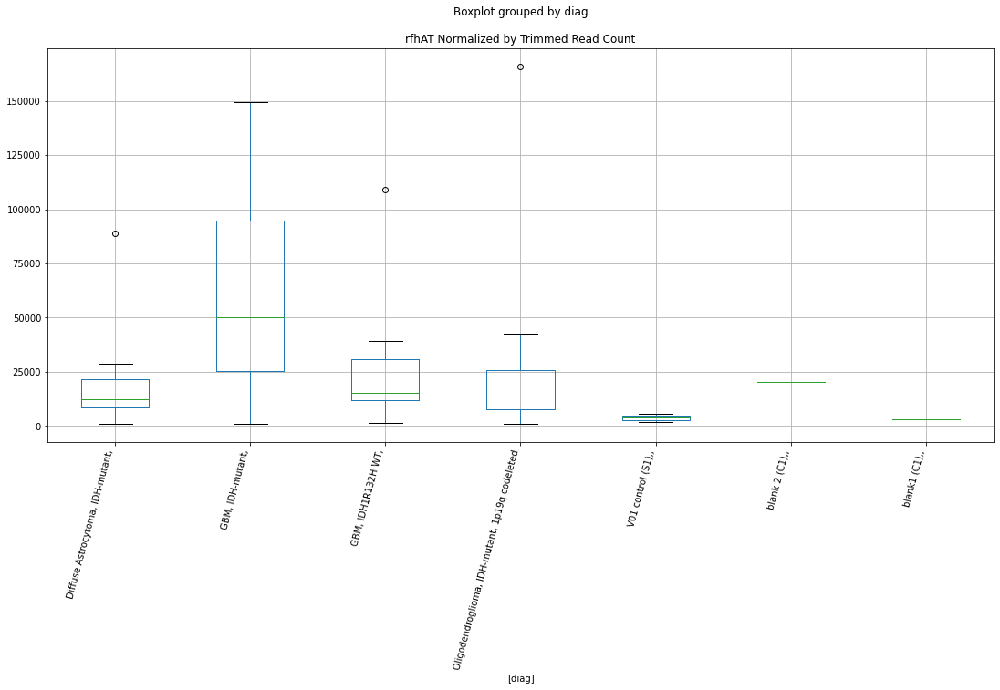

rfhAT D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2339611261478938
	p = 0.038411446643305806
rfhAT D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7749687293262923
	p = 0.0928155937329195
rfhAT D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.2339611261478938
	p = 0.038411446643305806
rfhAT D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7749687293262923
	p = 0.0928155937329195


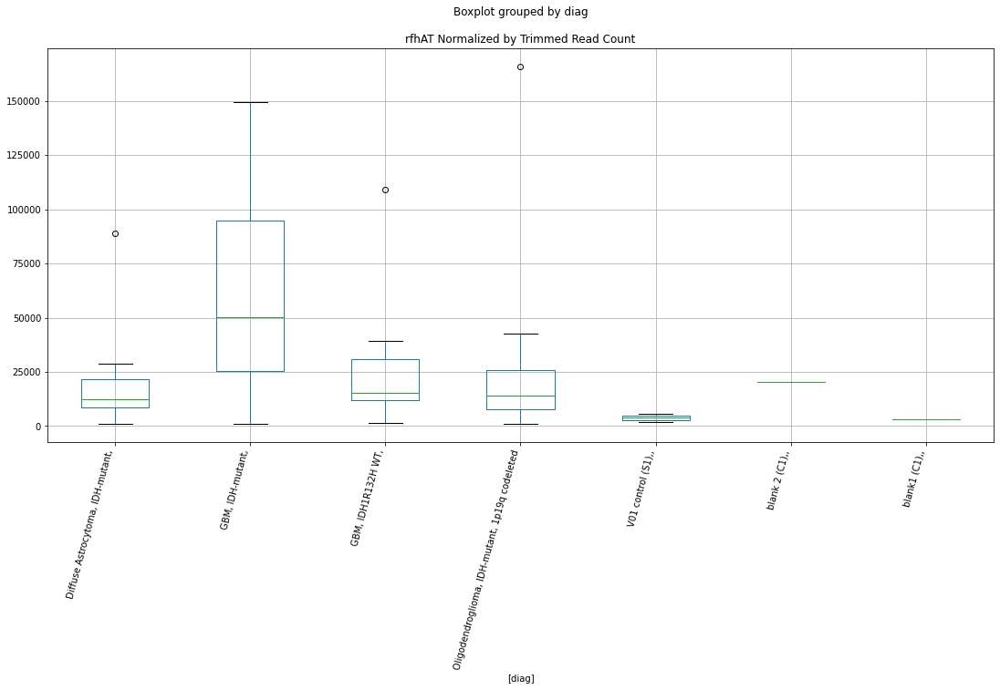

rfhAT D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.233915749458698
	p = 0.03841493906238821
rfhAT D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7749365547357943
	p = 0.09282106358341495
rfhAT D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.233915749458698
	p = 0.03841493906238821
rfhAT D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7749365547357943
	p = 0.09282106358341495


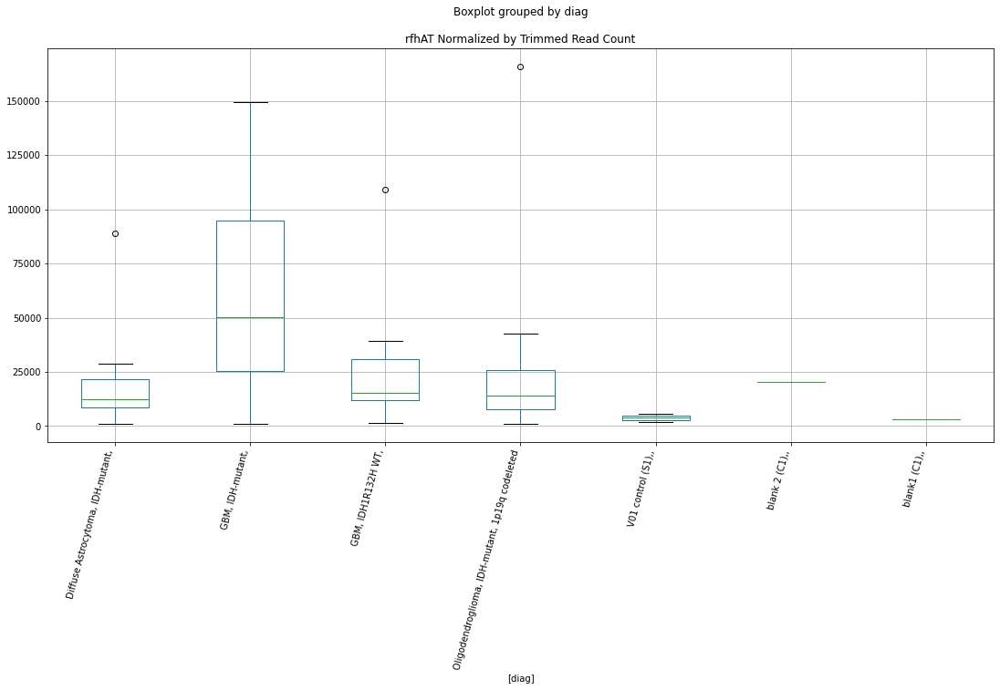

rfsrpRNA D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7747503139494307
	p = 0.09285273101551164
rfsrpRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7747503139494307
	p = 0.09285273101551164


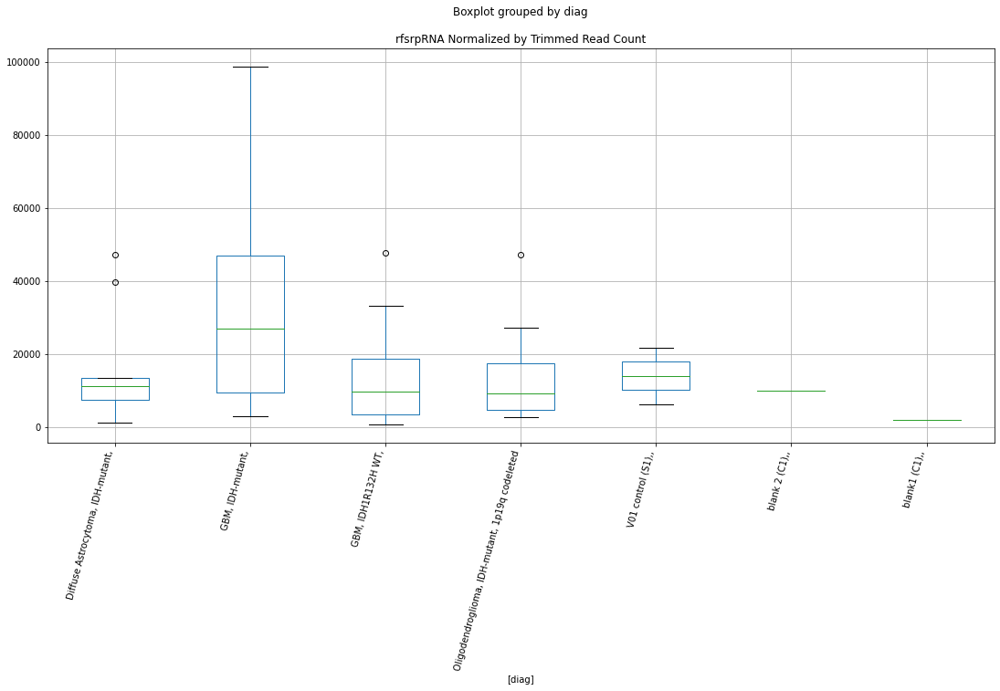

rfPiggyBac D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0075147730251452
	p = 0.059948328028254734
rfPiggyBac D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.0075147730251452
	p = 0.059948328028254734


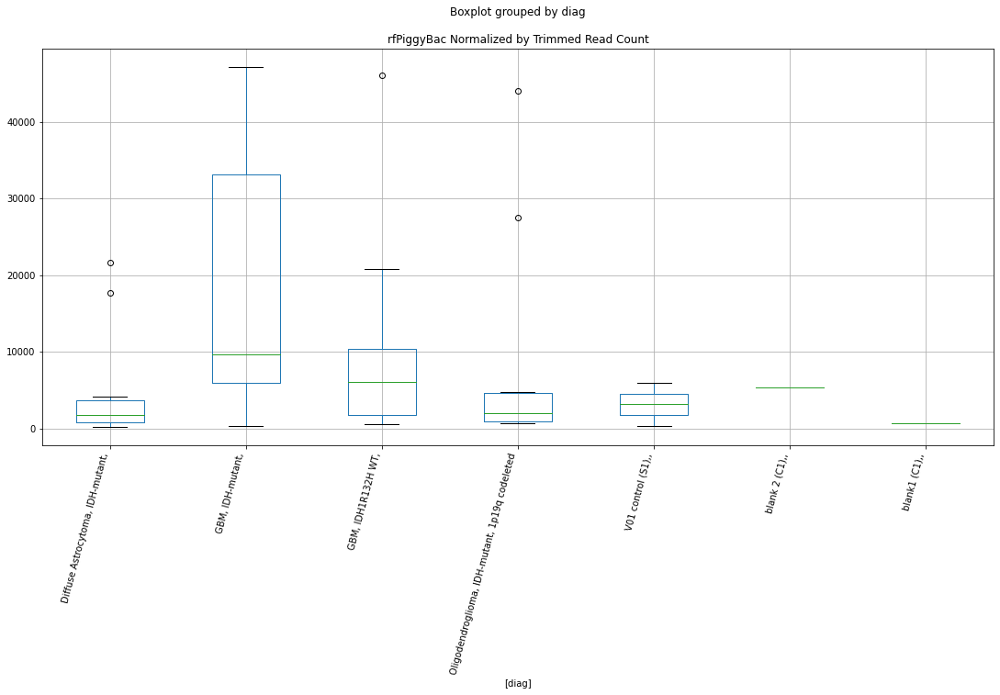

rfPiggyBac D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8474457212293136
	p = 0.08118590243416768
rfPiggyBac D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.981050423432131
	p = 0.06307413025353391
rfPiggyBac D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8474457212293136
	p = 0.08118590243416768
rfPiggyBac D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.981050423432131
	p = 0.06307413025353391


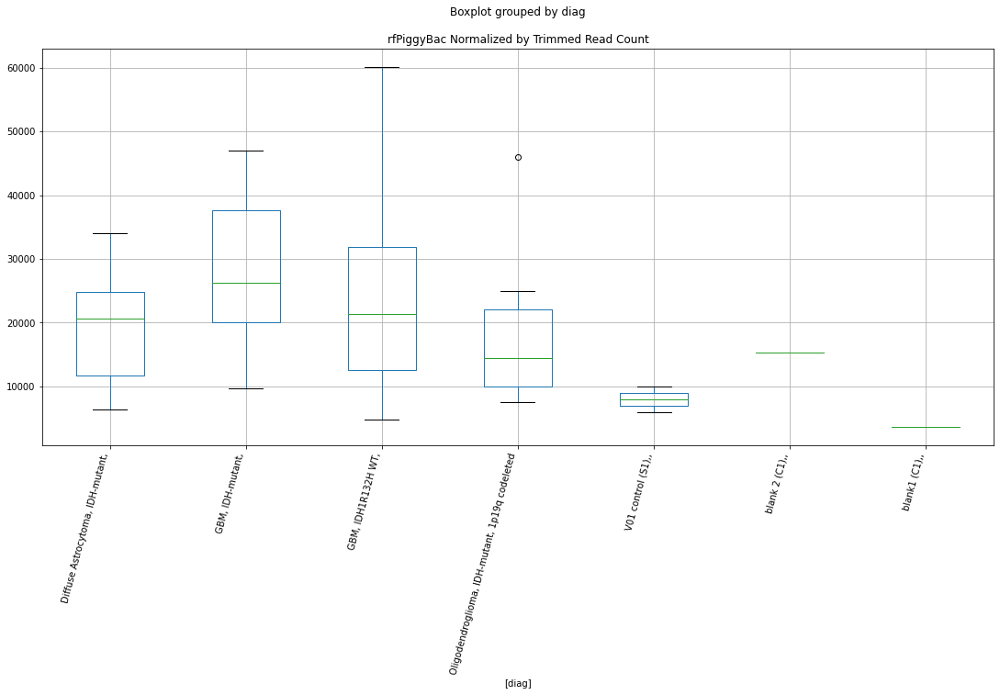

rfPiggyBac D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7677446613065246
	p = 0.09405078549779106
rfPiggyBac D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0293453022210306
	p = 0.057475438871393454
rfPiggyBac D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7677446613065246
	p = 0.09405078549779106
rfPiggyBac D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0293453022210306
	p = 0.057475438871393454


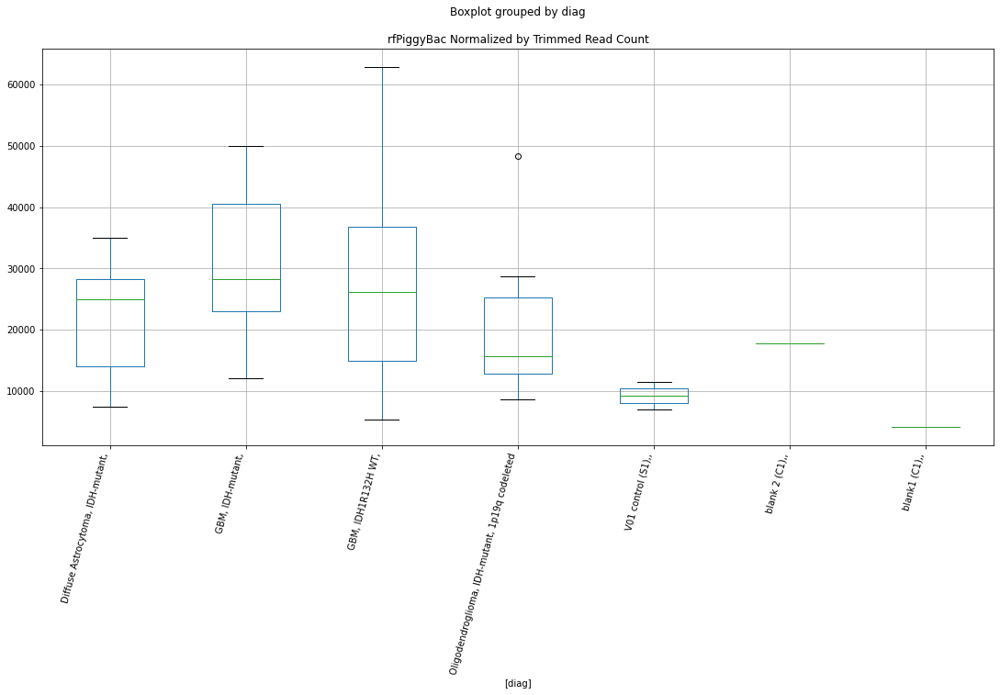

rfPiggyBac D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.3822489510681617
	p = 0.0284433321321693
rfPiggyBac D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.3822489510681617
	p = 0.0284433321321693


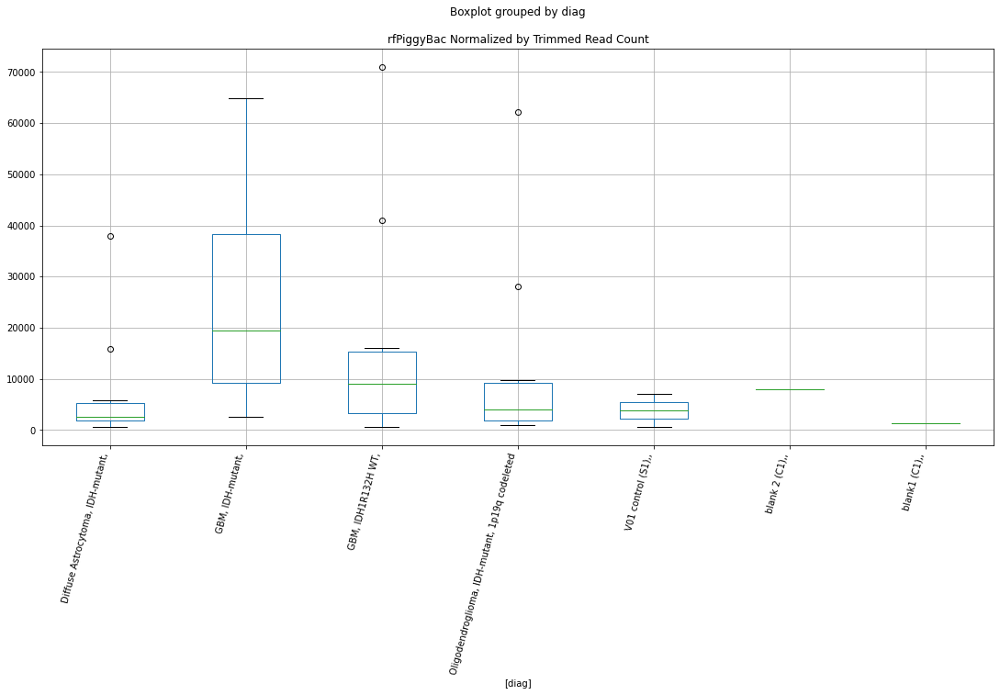

rfPiggyBac D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.382250536512127
	p = 0.028443239795063247
rfPiggyBac D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.382250536512127
	p = 0.028443239795063247


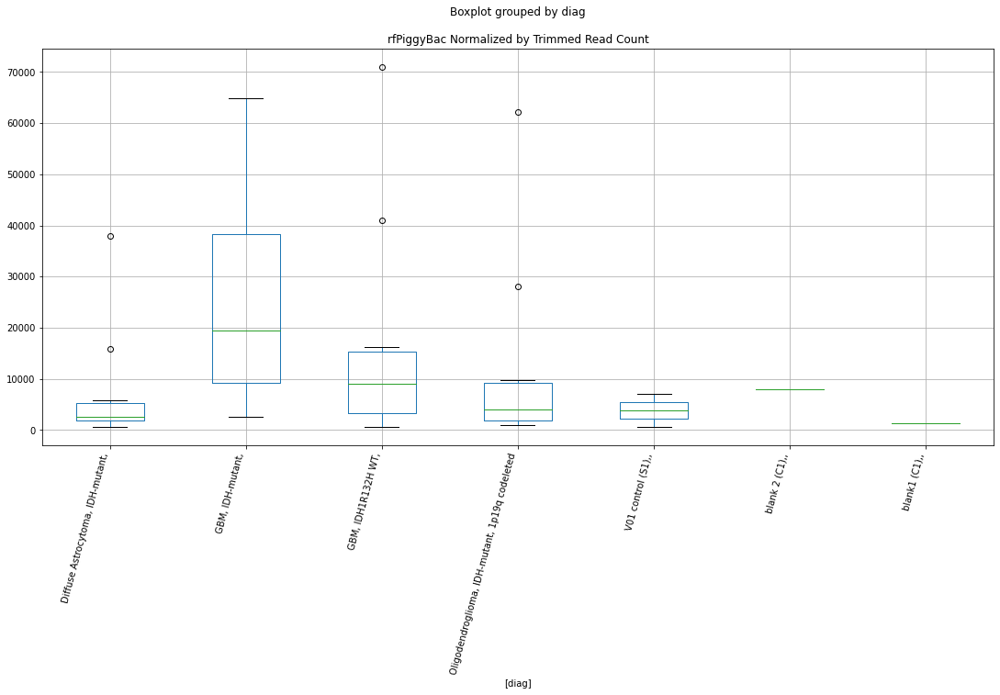

rfPiggyBac D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.38220945055408
	p = 0.028445632753628335
rfPiggyBac D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.38220945055408
	p = 0.028445632753628335


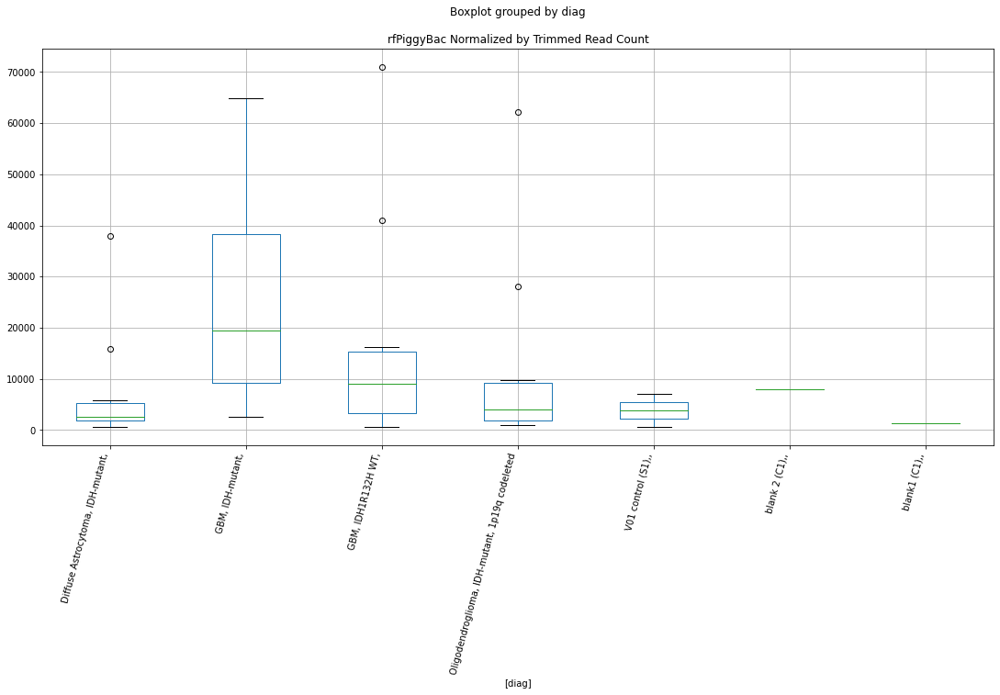

rfhAT-Ac D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8532219998906643
	p = 0.08031665158793388
rfhAT-Ac D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7684488964484784
	p = 0.09392974764378428
rfhAT-Ac D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8532219998906643
	p = 0.08031665158793388
rfhAT-Ac D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7684488964484784
	p = 0.09392974764378428


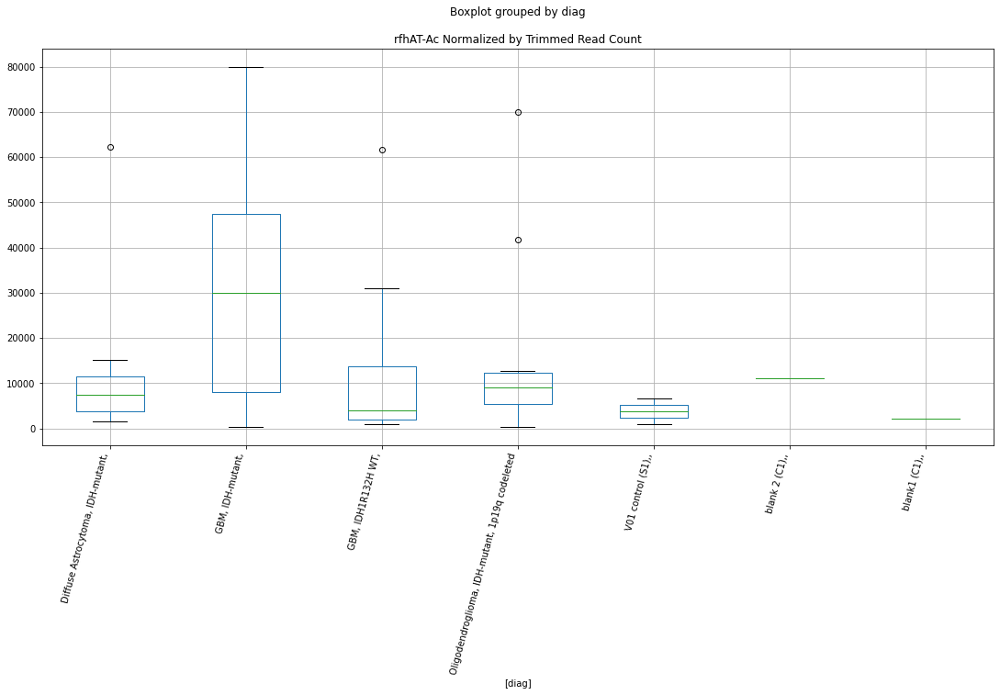

rfhAT-Ac D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8532436216448904
	p = 0.08031341326962997
rfhAT-Ac D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7683199569552355
	p = 0.09395189851464922
rfhAT-Ac D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8532436216448904
	p = 0.08031341326962997
rfhAT-Ac D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7683199569552355
	p = 0.09395189851464922


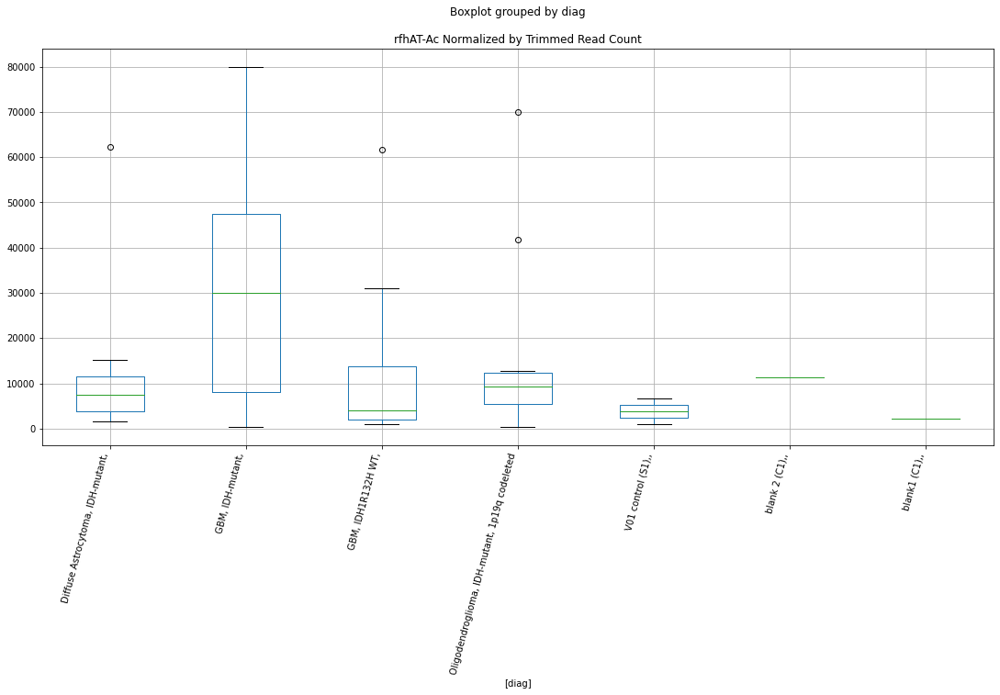

rfhAT-Ac D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.853175624851125
	p = 0.08032359762596236
rfhAT-Ac D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.768308922496428
	p = 0.09395379436573201
rfhAT-Ac D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.853175624851125
	p = 0.08032359762596236
rfhAT-Ac D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.768308922496428
	p = 0.09395379436573201


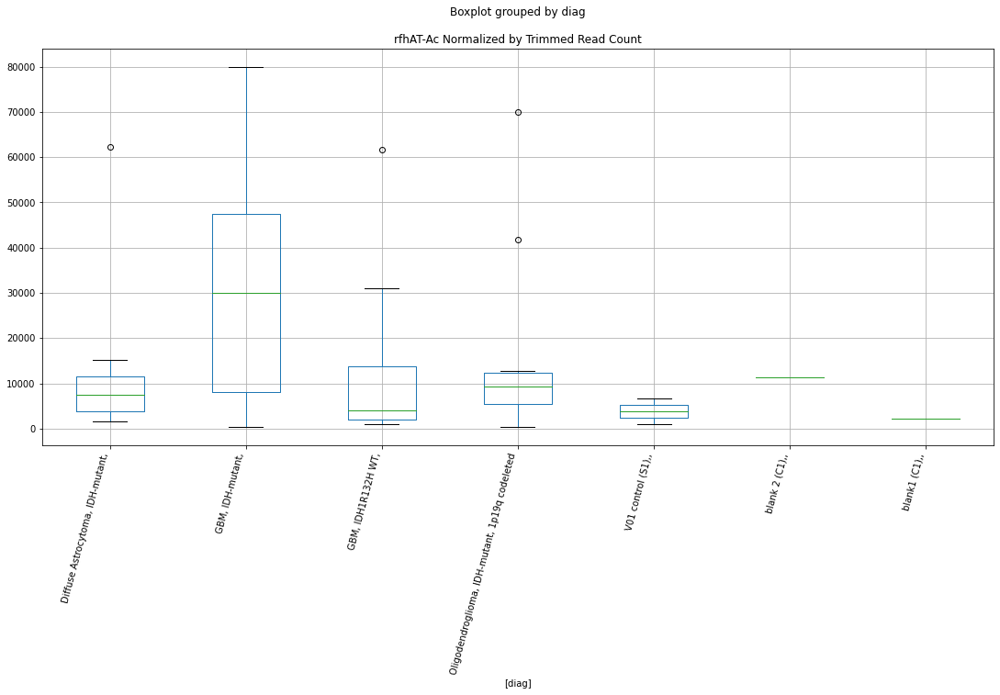

rfERVL? D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.3742766815149614
	p = 0.028911196464742505
rfERVL? D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8152058755610339
	p = 0.08619115765040851
rfERVL? D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.3742766815149614
	p = 0.028911196464742505
rfERVL? D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8152058755610339
	p = 0.08619115765040851


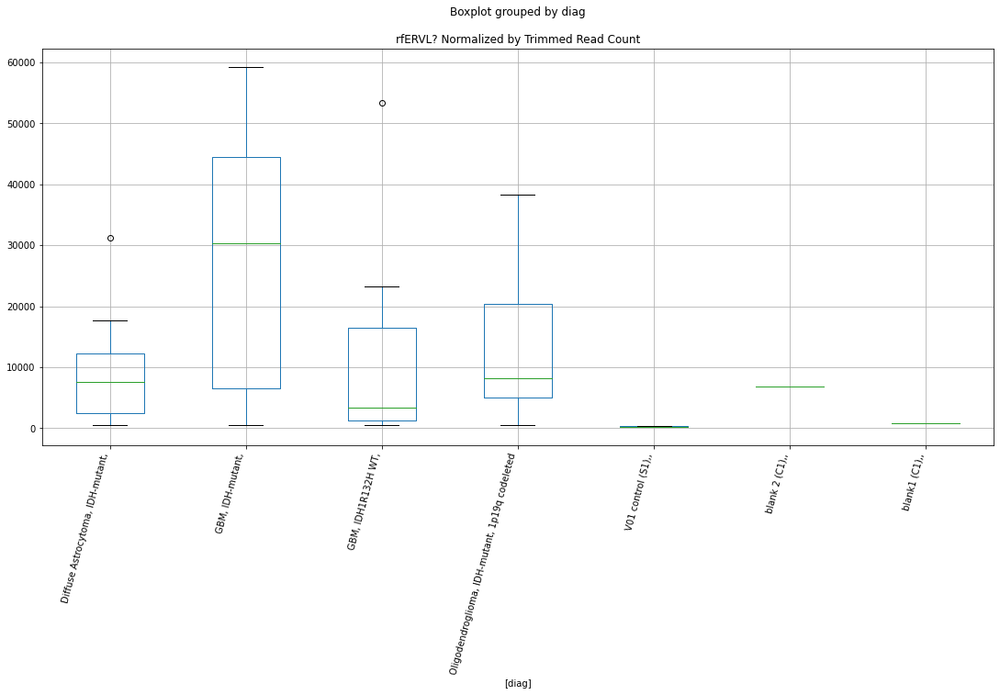

rfERVL? D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9036575202613868
	p = 0.07306898745205608
rfERVL? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.052056369065998
	p = 0.05500076351449673
rfERVL? D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9036575202613868
	p = 0.07306898745205608
rfERVL? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.052056369065998
	p = 0.05500076351449673


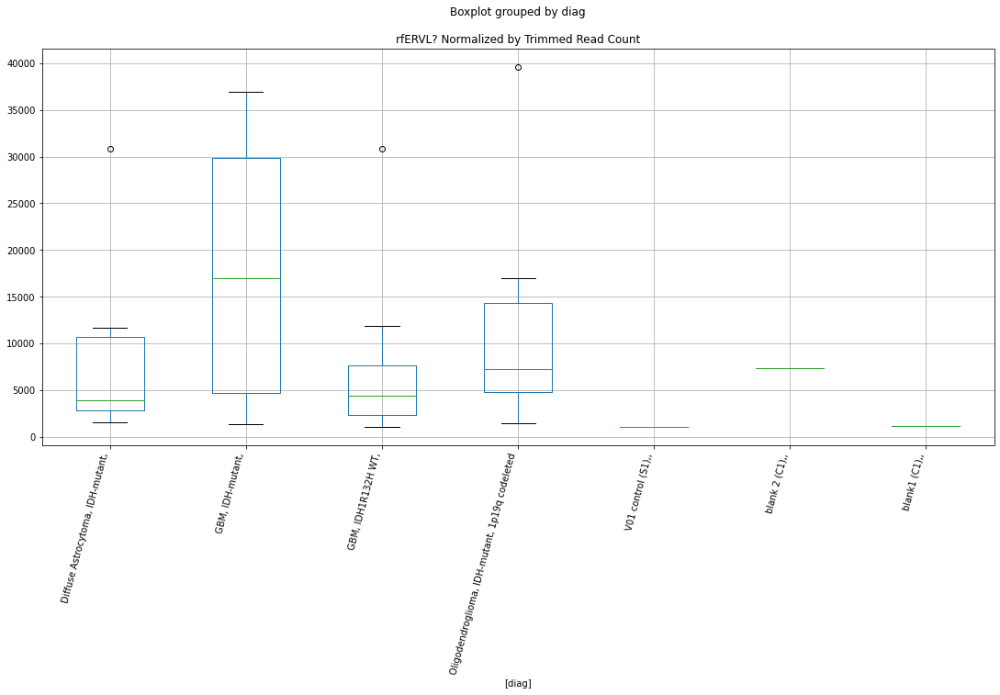

rfERVL? D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8518241007768679
	p = 0.08052626101680099
rfERVL? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0232289556905942
	p = 0.05815884242087032
rfERVL? D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8518241007768679
	p = 0.08052626101680099
rfERVL? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0232289556905942
	p = 0.05815884242087032


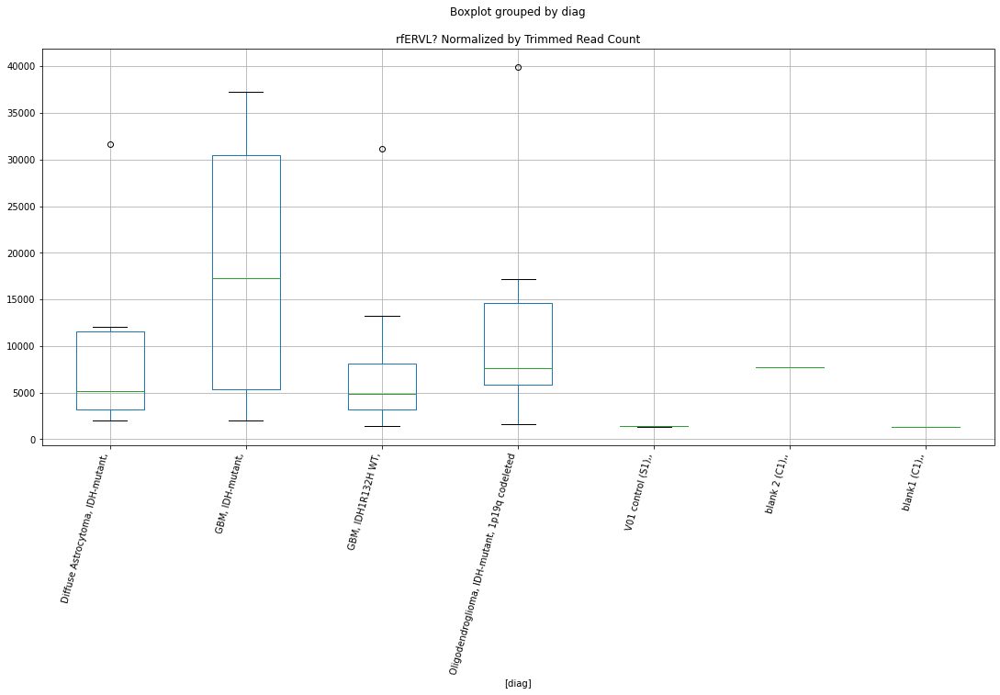

rfERVL? D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8080871844610598
	p = 0.08733212089157288
rfERVL? D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8844306710011474
	p = 0.07576064041334388
rfERVL? D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8080871844610598
	p = 0.08733212089157288
rfERVL? D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8844306710011474
	p = 0.07576064041334388


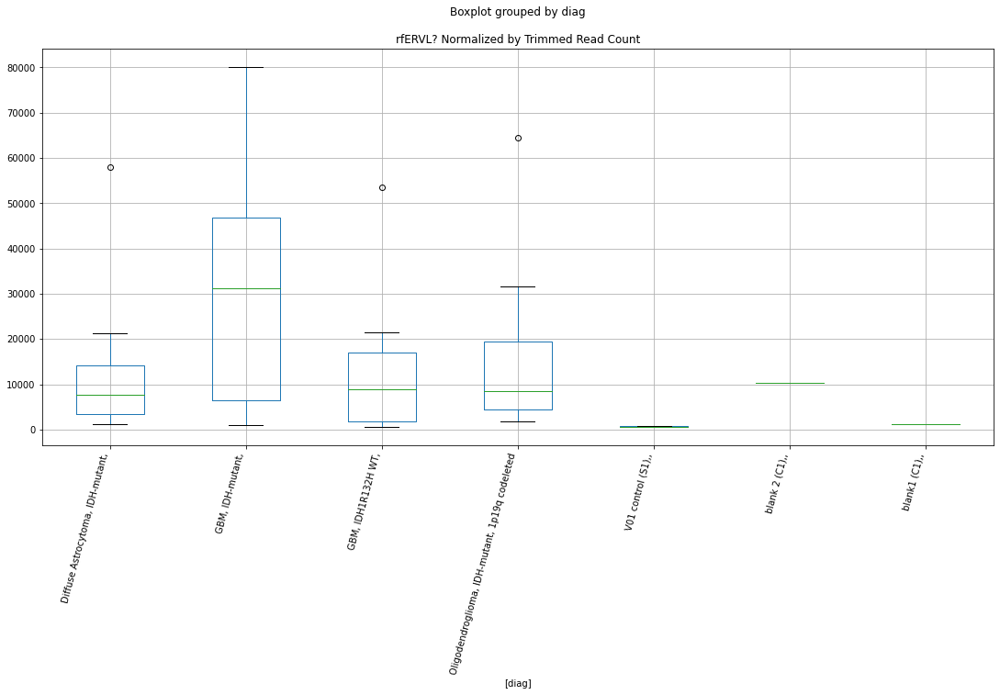

rfERVL? D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8078481149853267
	p = 0.08737066660703811
rfERVL? D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8845892460309484
	p = 0.07573808649482697
rfERVL? D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8078481149853267
	p = 0.08737066660703811
rfERVL? D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8845892460309484
	p = 0.07573808649482697


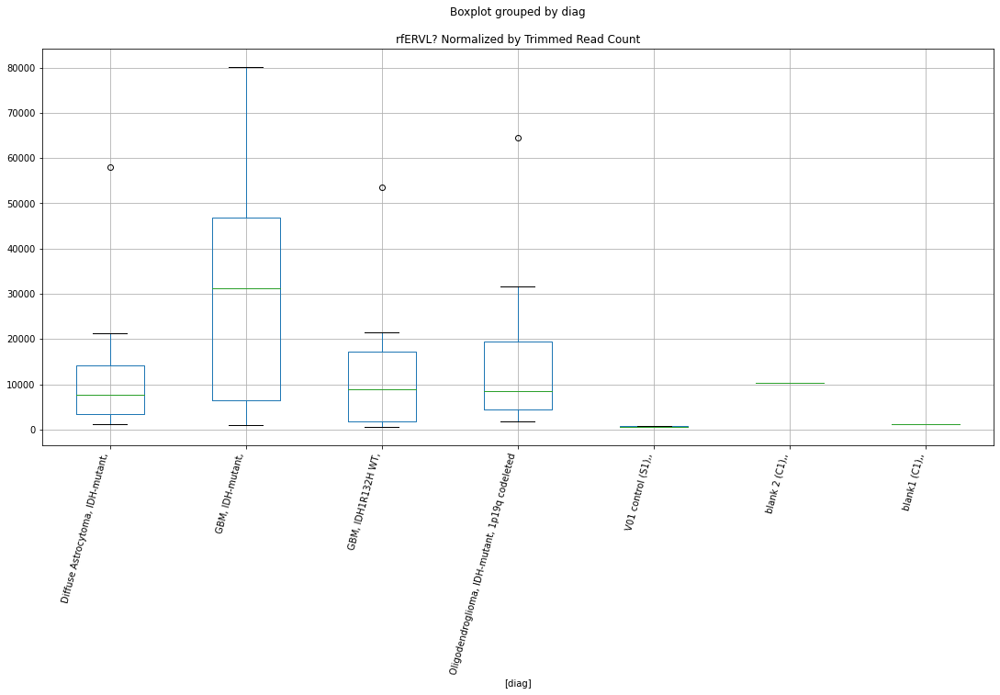

rfERVL? D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8078331691367684
	p = 0.0873730768545471
rfERVL? D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8845607771988517
	p = 0.0757421351418641
rfERVL? D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8078331691367684
	p = 0.0873730768545471
rfERVL? D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8845607771988517
	p = 0.0757421351418641


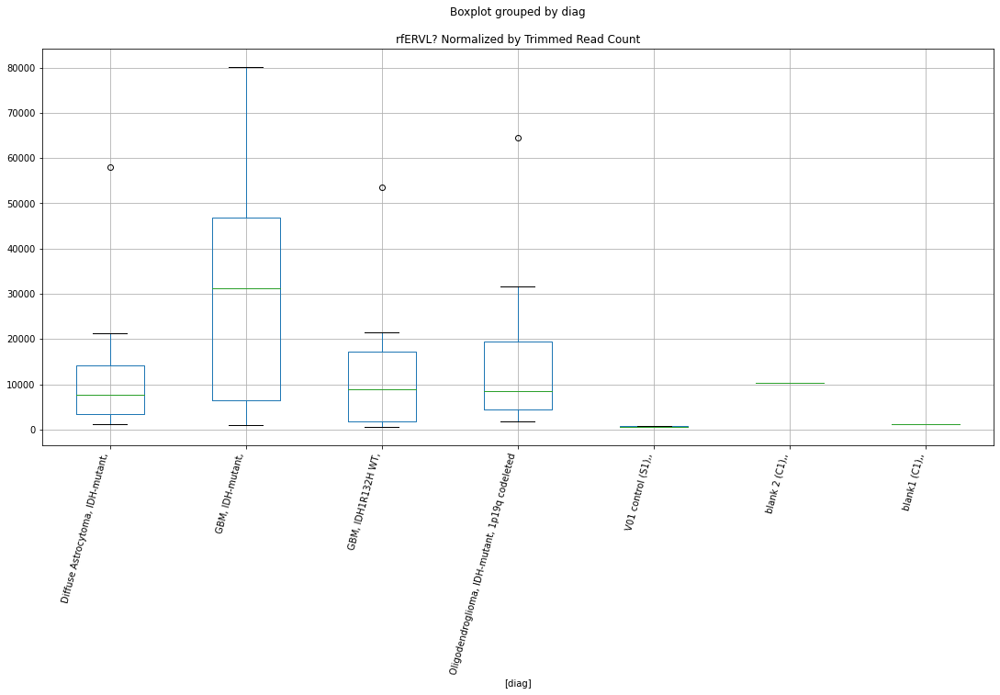

rfHelitron D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7520686720338206
	p = 0.09678035159433576
rfHelitron D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7520686720338206
	p = 0.09678035159433576


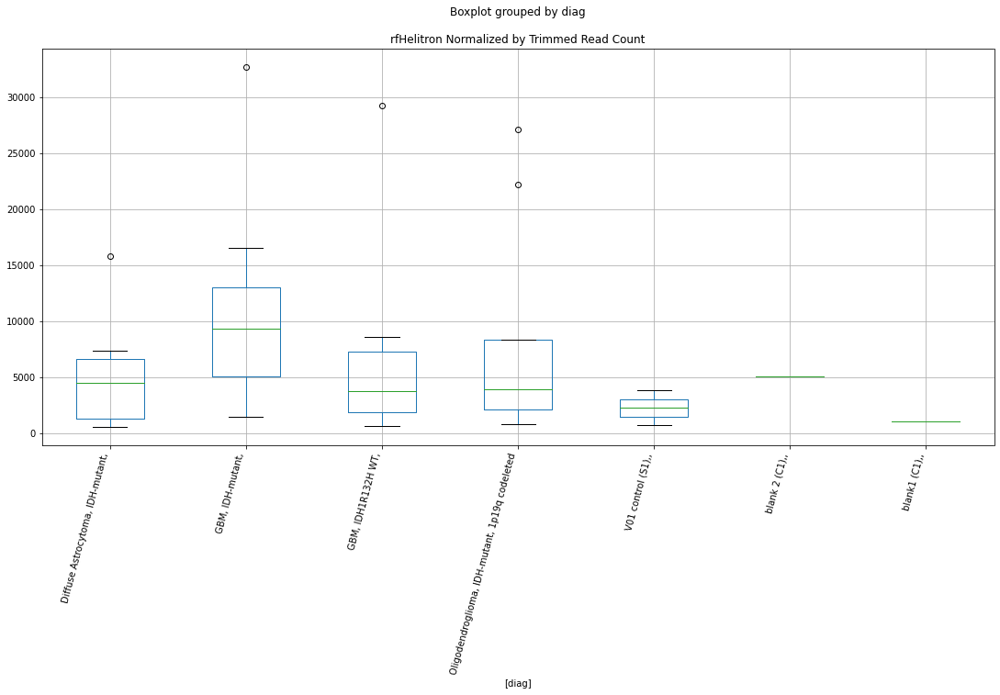

rfhAT-Tip100? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.8184350957066218
	p = 0.011377902086092987
rfhAT-Tip100? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.8184350957066218
	p = 0.011377902086092987


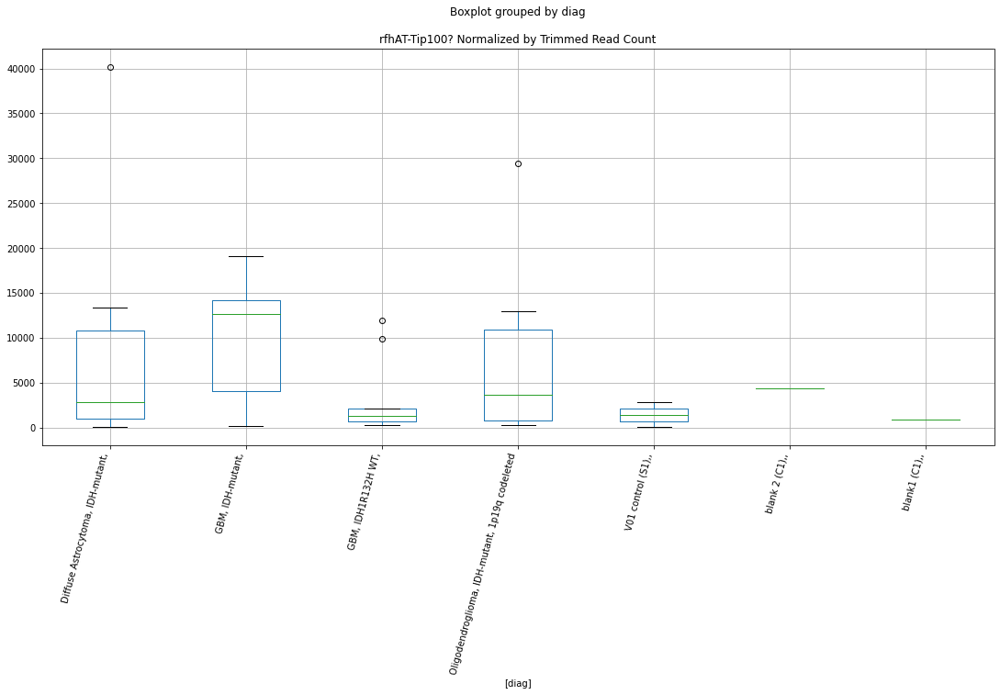

rfhAT-Tip100? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.8145981006747123
	p = 0.011471967165649103
rfhAT-Tip100? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.8145981006747123
	p = 0.011471967165649103


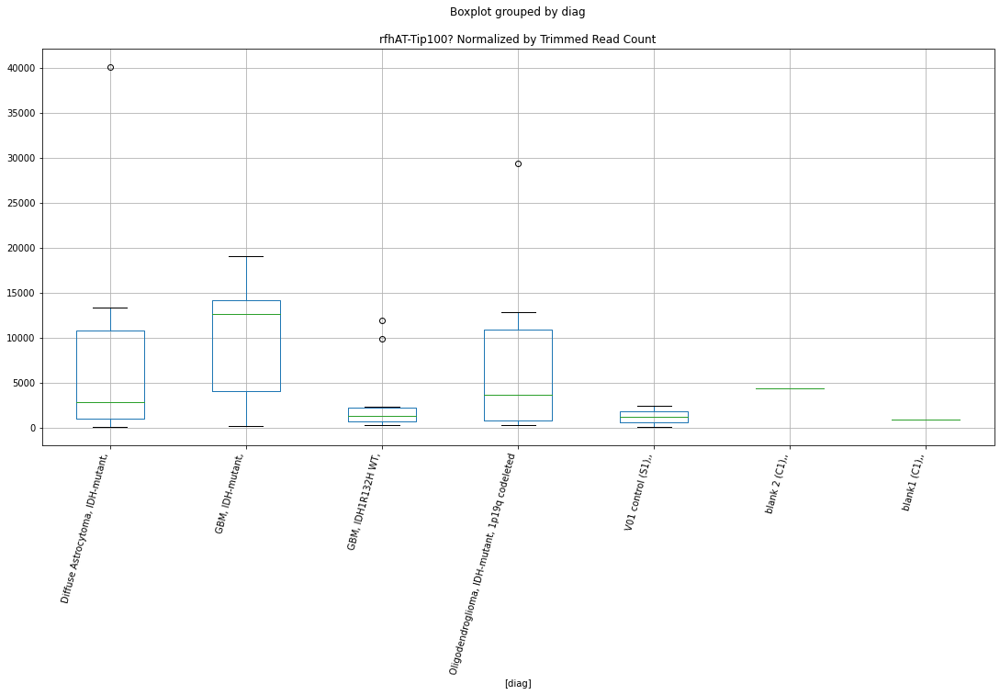

rfhAT-Tip100? D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9708878247228612
	p = 0.06431278766375387
rfhAT-Tip100? D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9708878247228612
	p = 0.06431278766375387


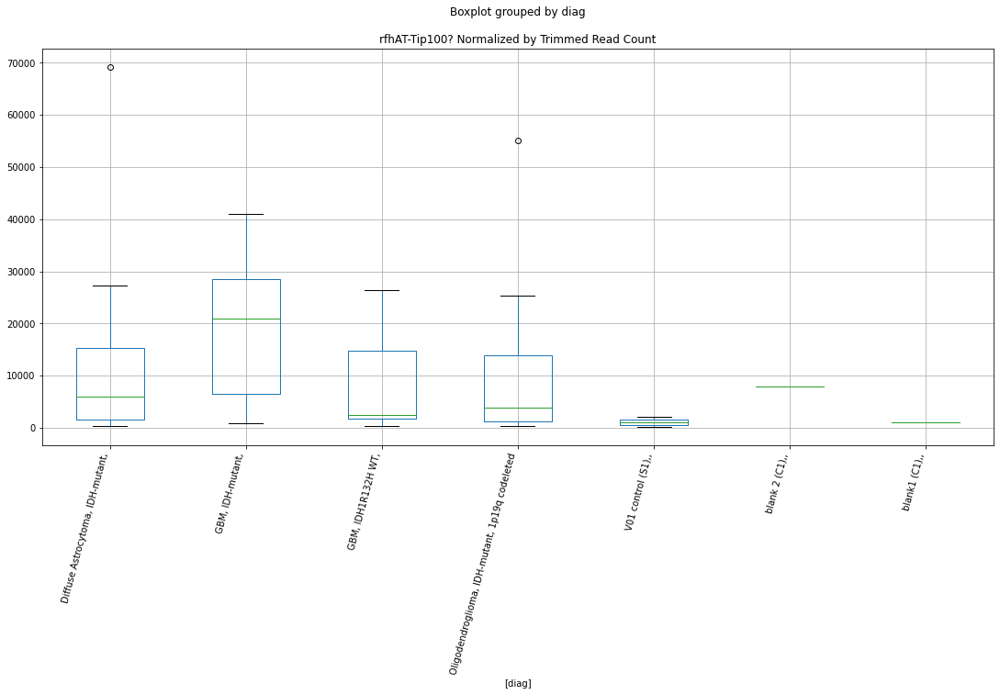

rfhAT-Tip100? D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9711278070740592
	p = 0.06428328839010543
rfhAT-Tip100? D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9711278070740592
	p = 0.06428328839010543


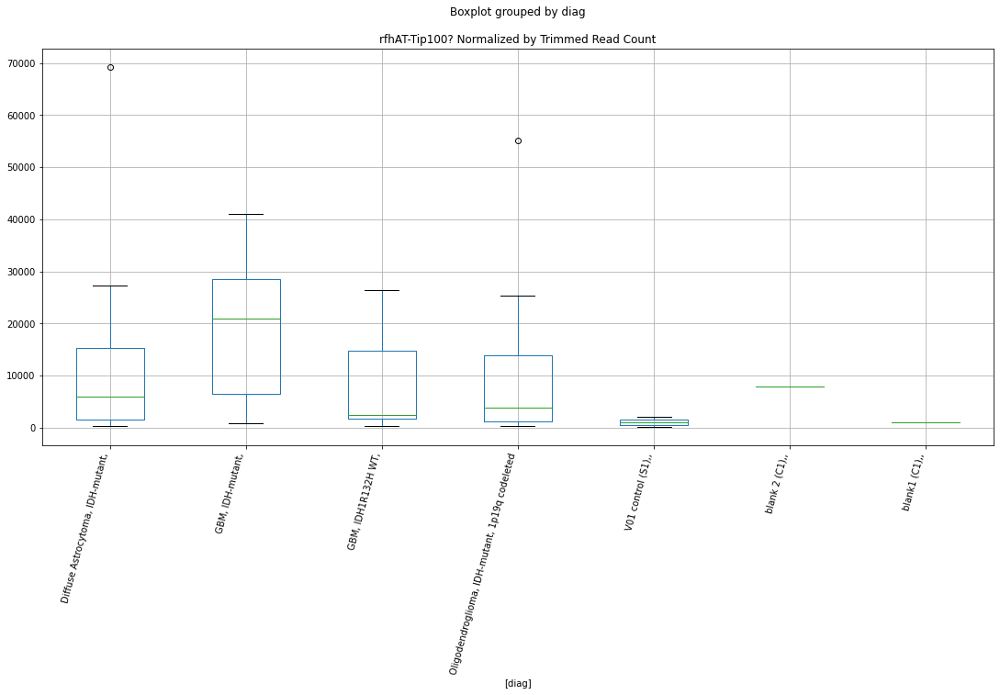

rfhAT-Tip100? D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9710602850587067
	p = 0.06429158715247557
rfhAT-Tip100? D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9710602850587067
	p = 0.06429158715247557


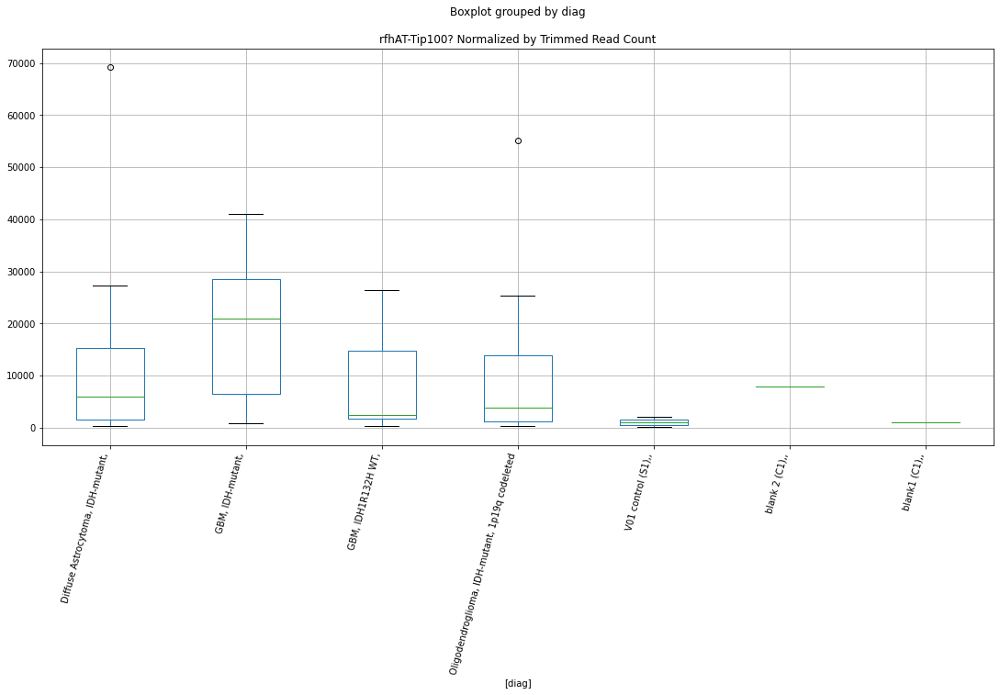

rfERV1? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7544096275200145
	p = 0.09636841819364612
rfERV1? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7544096275200145
	p = 0.09636841819364612


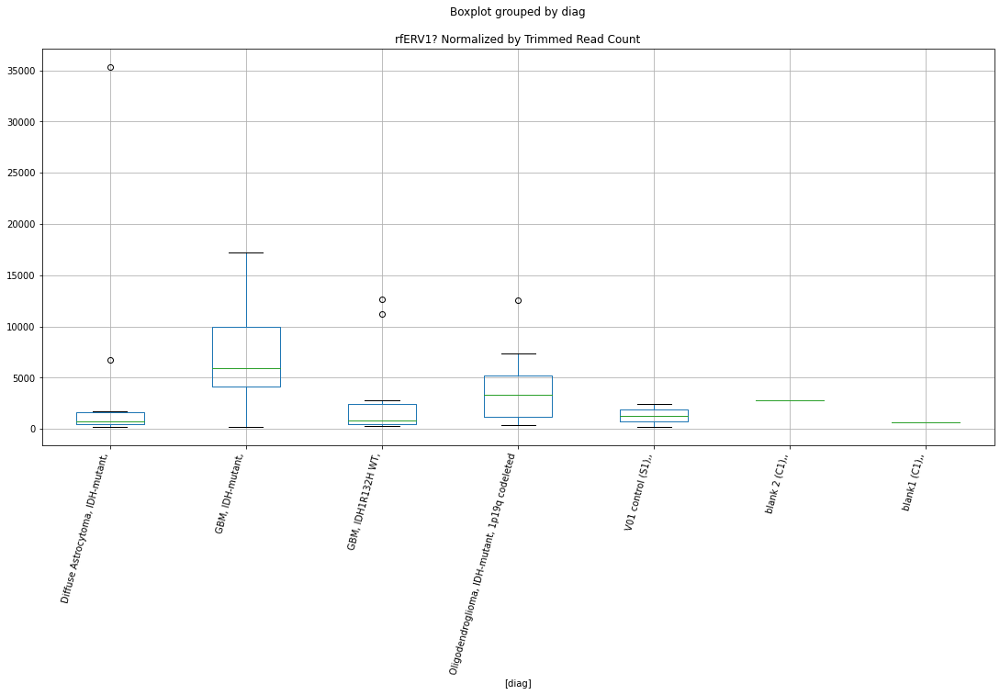

rfERV1? D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.742267589133653
	p = 0.09852165129341814
rfERV1? D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.742267589133653
	p = 0.09852165129341814


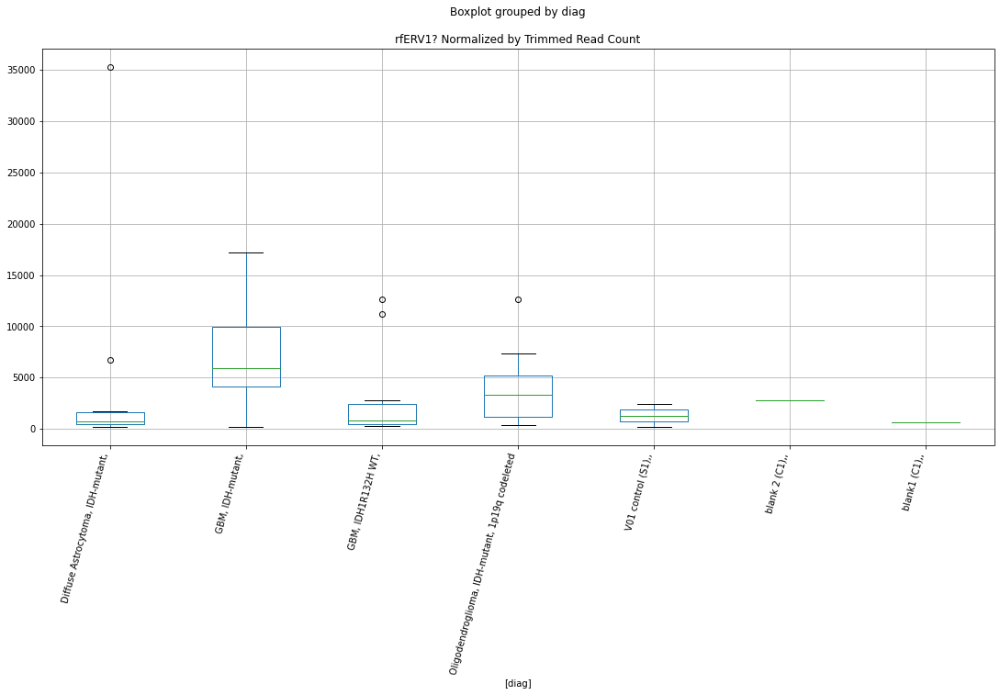

In [74]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmskfamilies:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


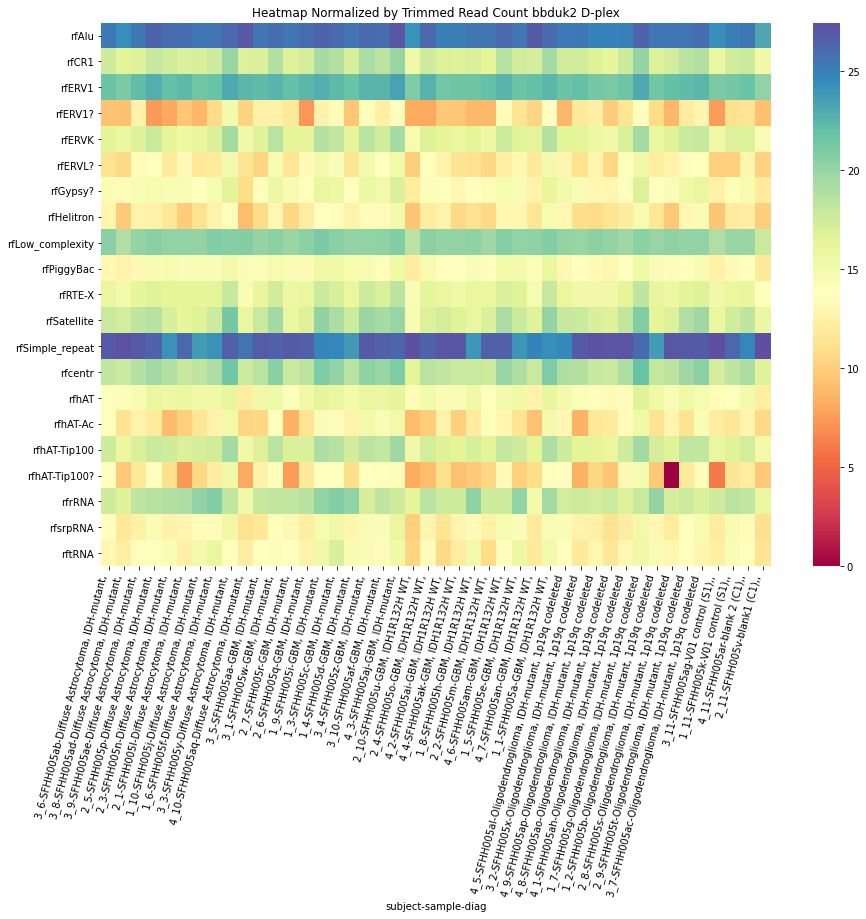

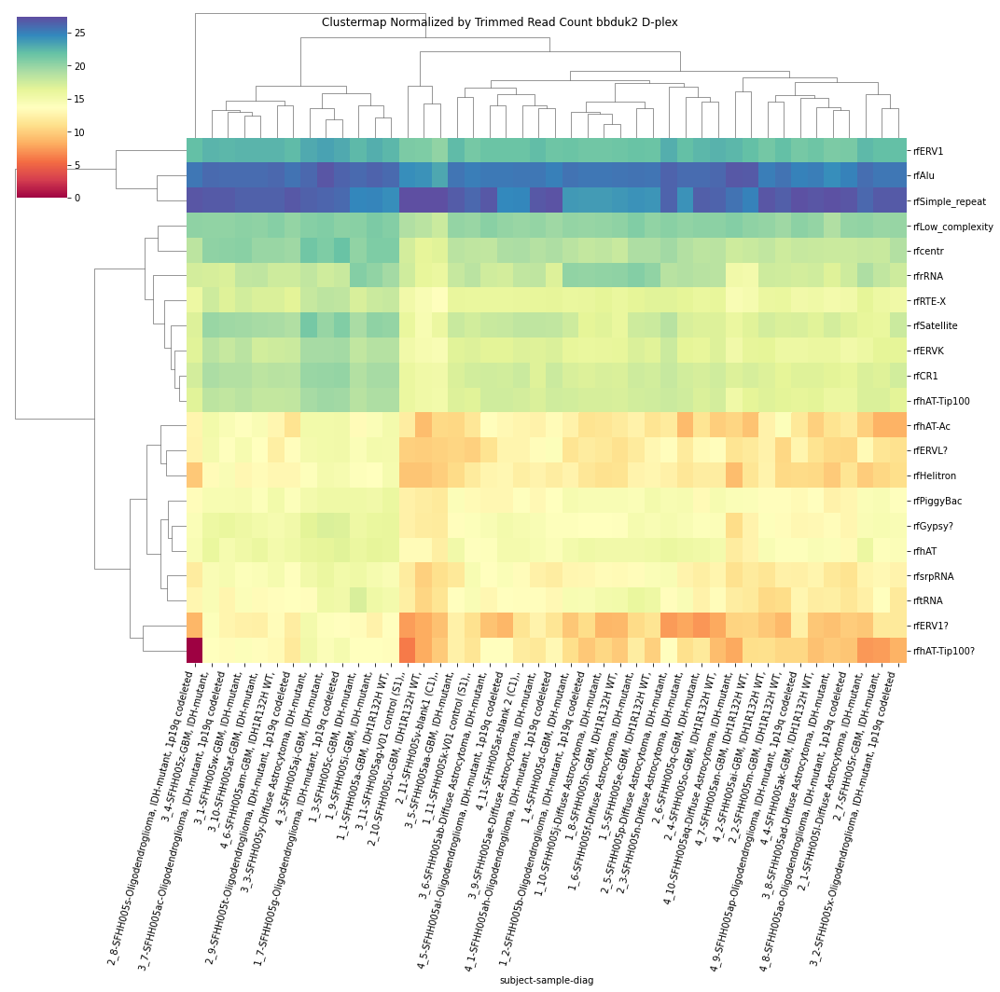

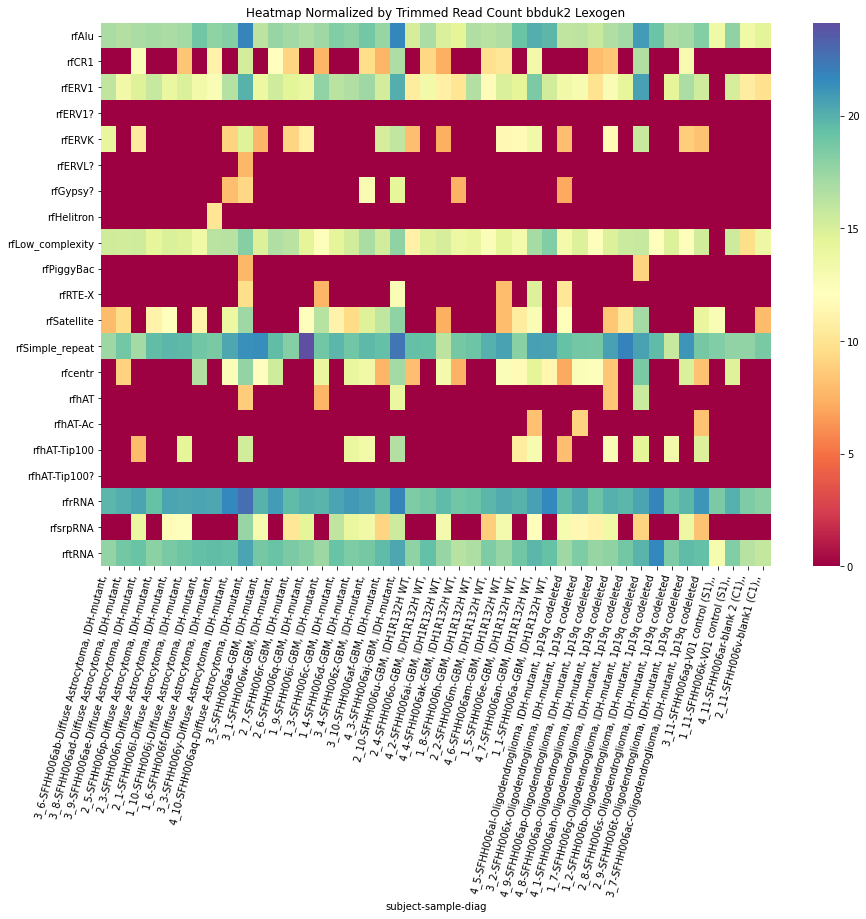

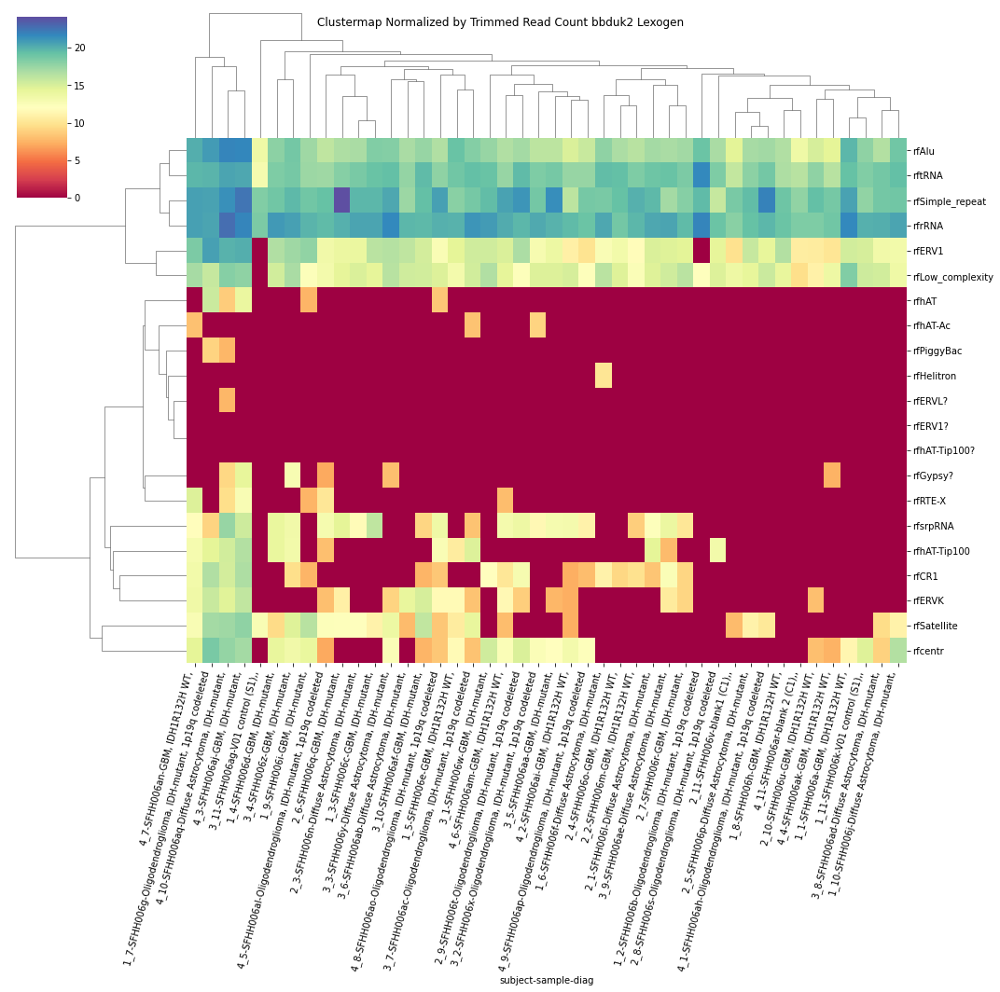

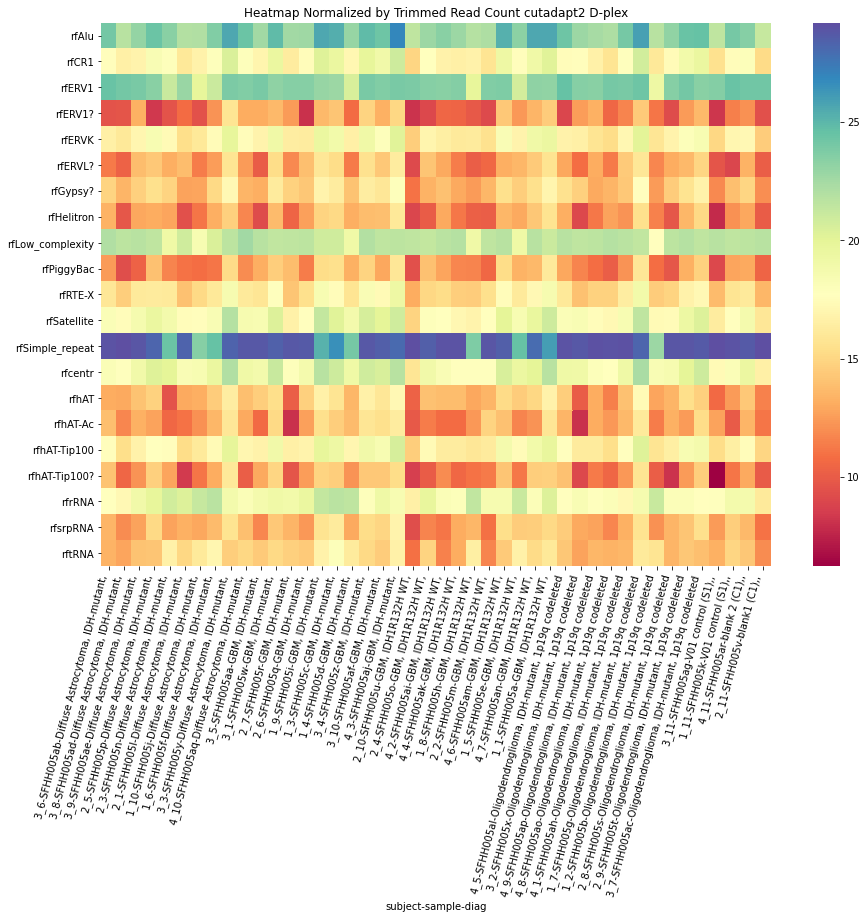

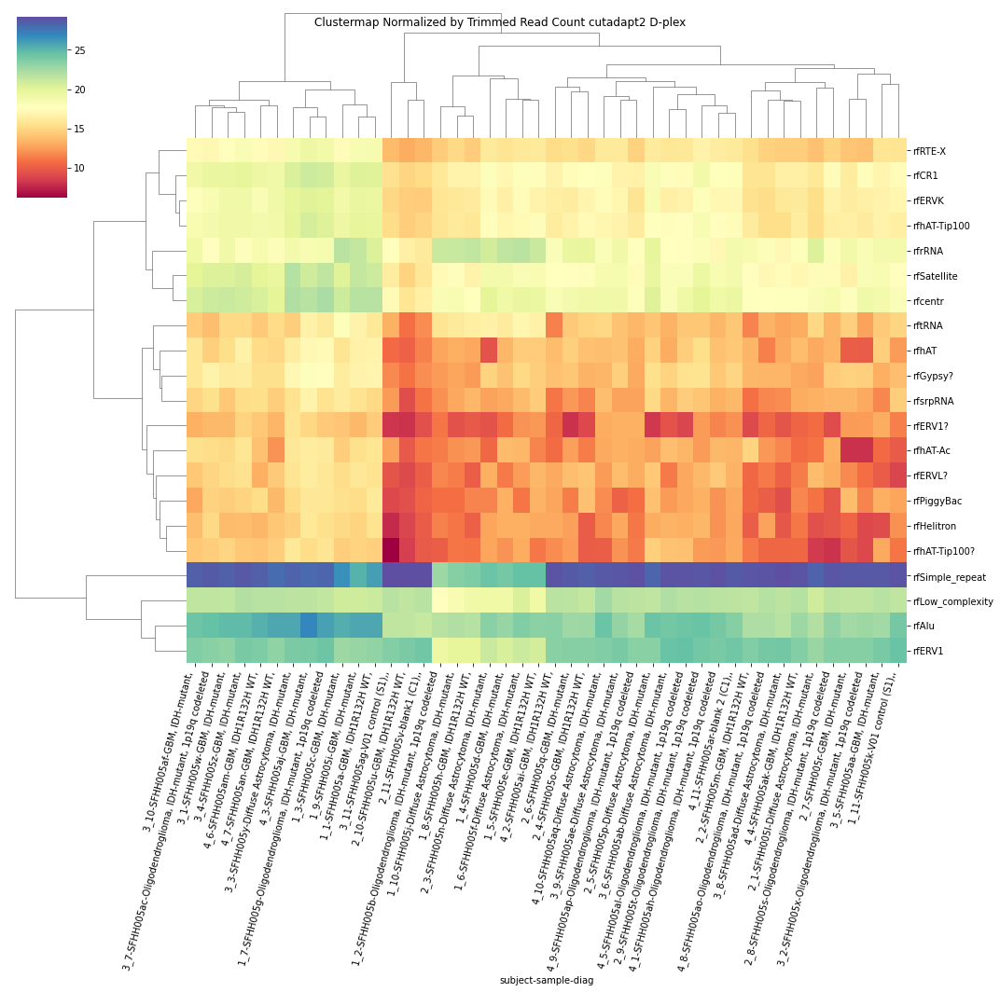

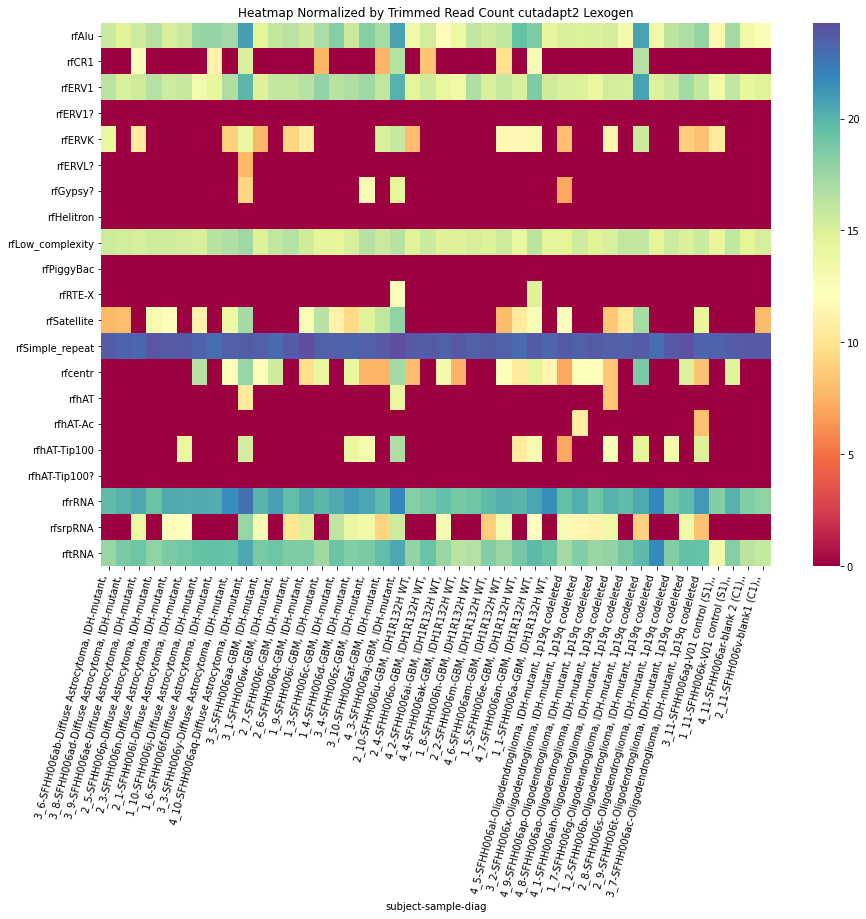

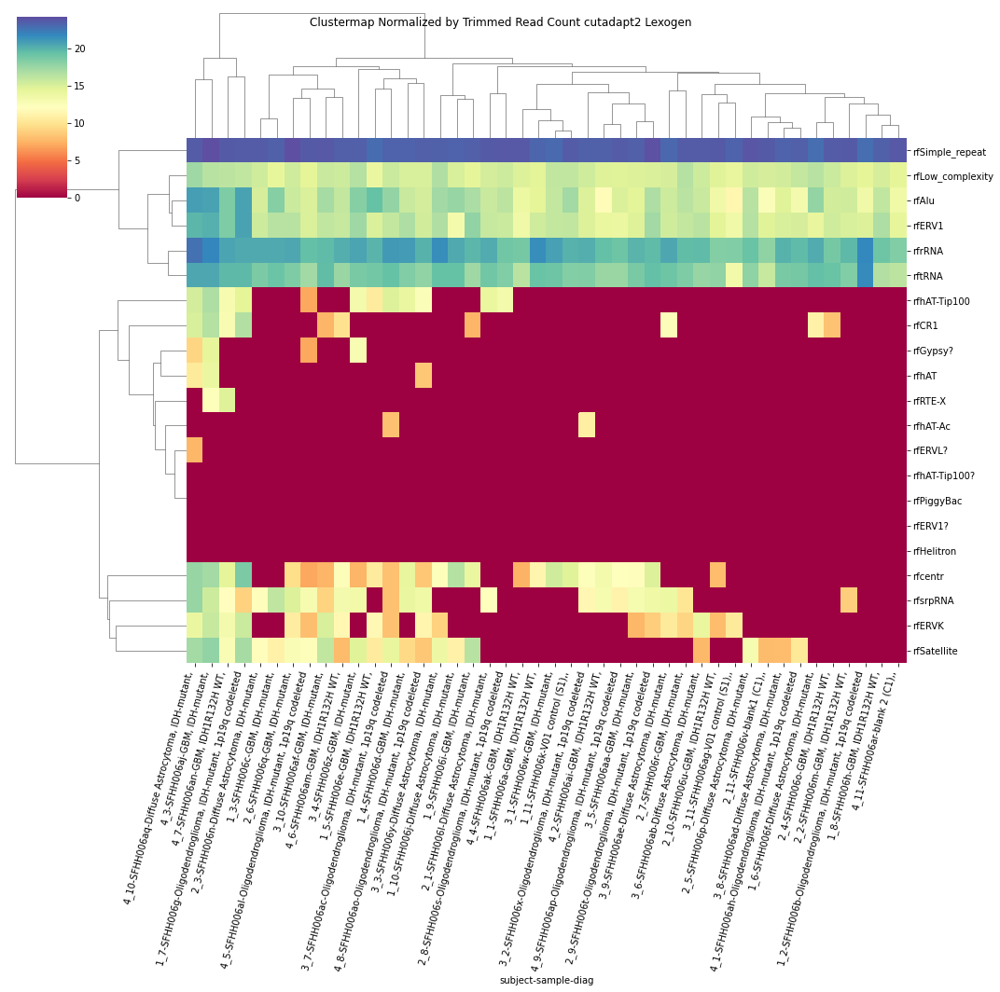

In [75]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap Normalized by Trimmed Read Count "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap Normalized by Trimmed Read Count "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rcSimple_repeat D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8404642351433276
	p = 0.08224756419670354
rcSimple_repeat D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8404642351433276
	p = 0.08224756419670354


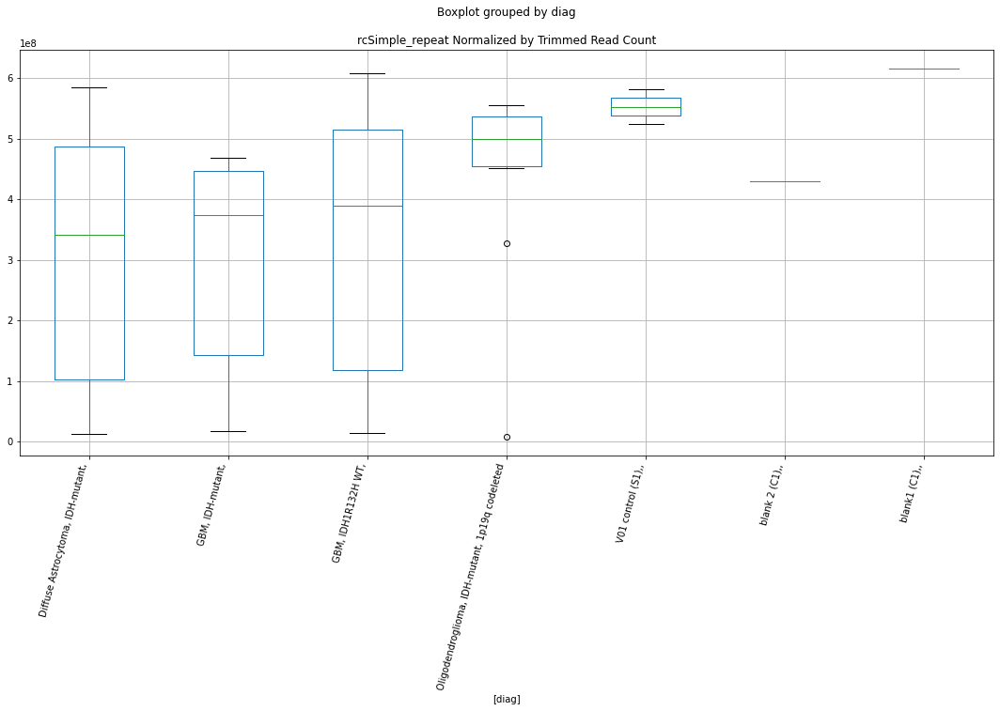

rcSimple_repeat D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8433339110051457
	p = 0.08180970868648885
rcSimple_repeat D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8433339110051457
	p = 0.08180970868648885


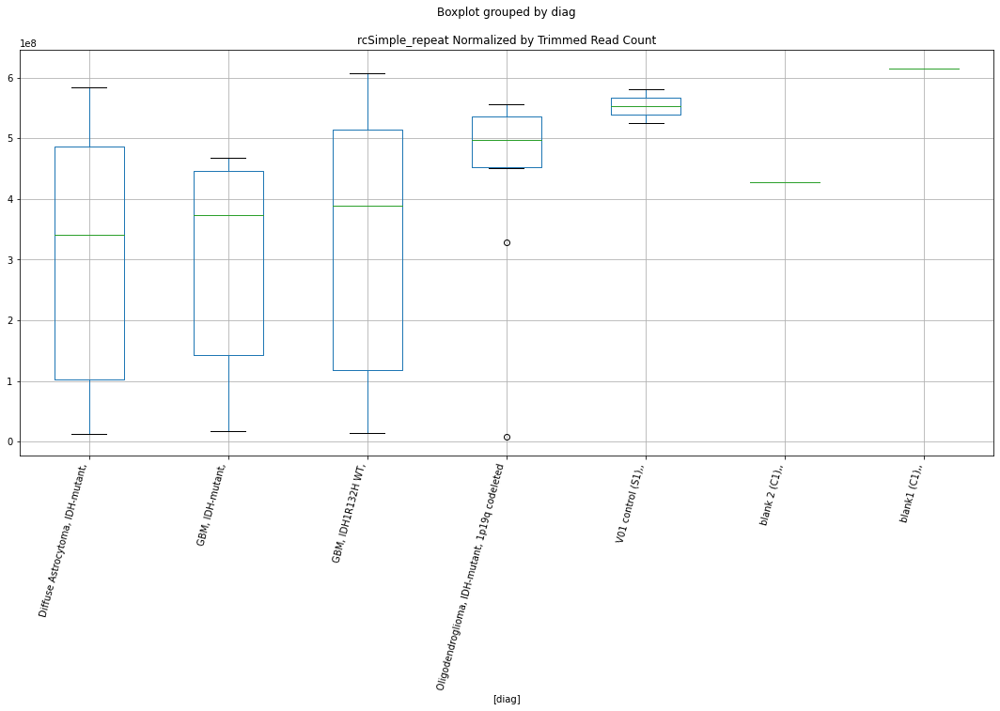

rcSimple_repeat D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8432501441887092
	p = 0.08182246072987008
rcSimple_repeat D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8432501441887092
	p = 0.08182246072987008


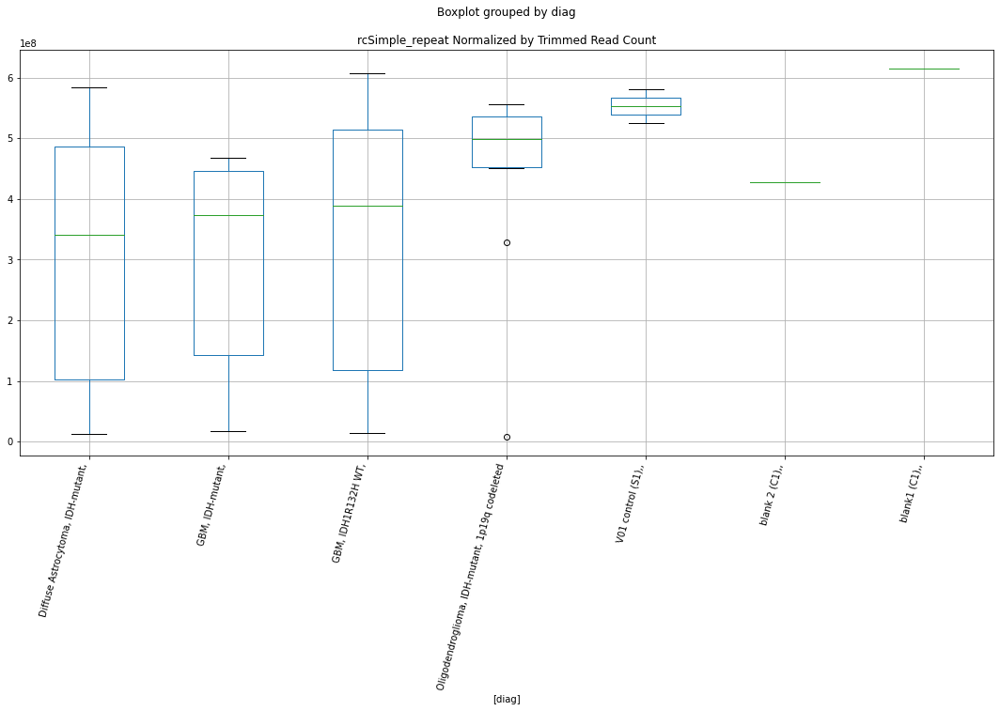

rcSINE D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.177725395856543
	p = 0.04297093955796587
rcSINE D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.177725395856543
	p = 0.04297093955796587


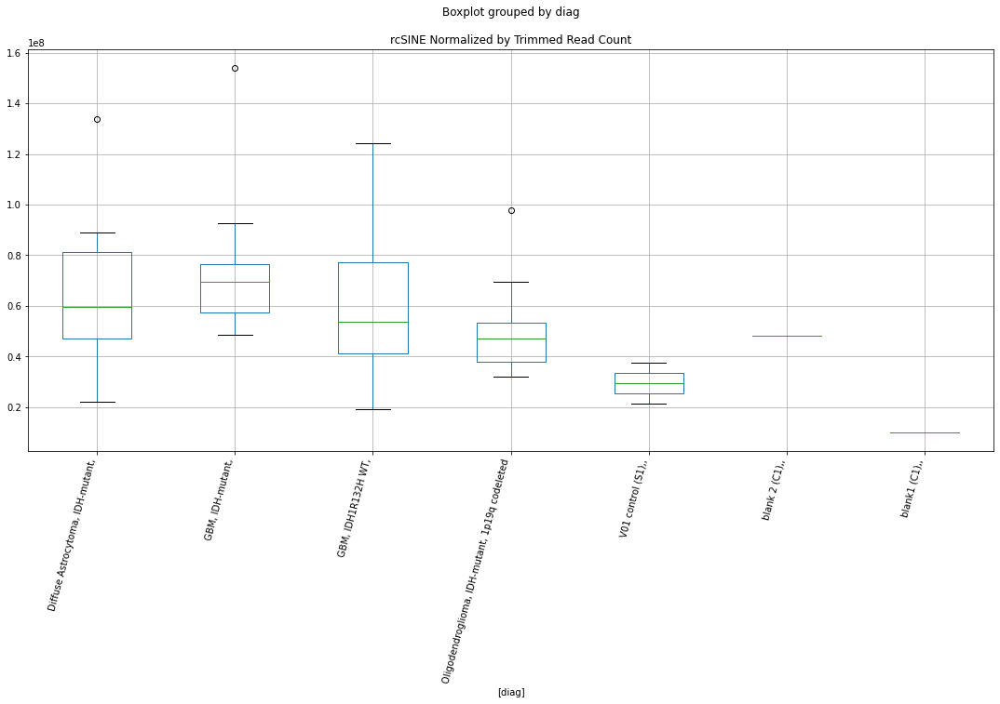

rcSINE D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2558421876712655
	p = 0.036761061797255204
rcSINE D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2558421876712655
	p = 0.036761061797255204


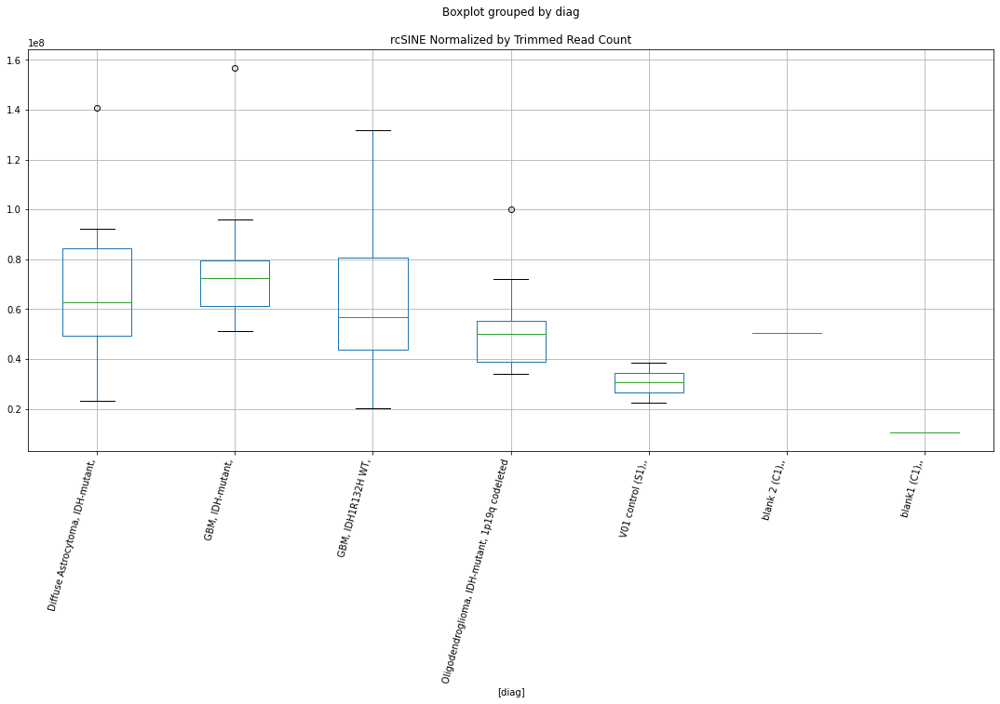

rcLTR D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8541019418908489
	p = 0.08018495440585988
rcLTR D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8541019418908489
	p = 0.08018495440585988


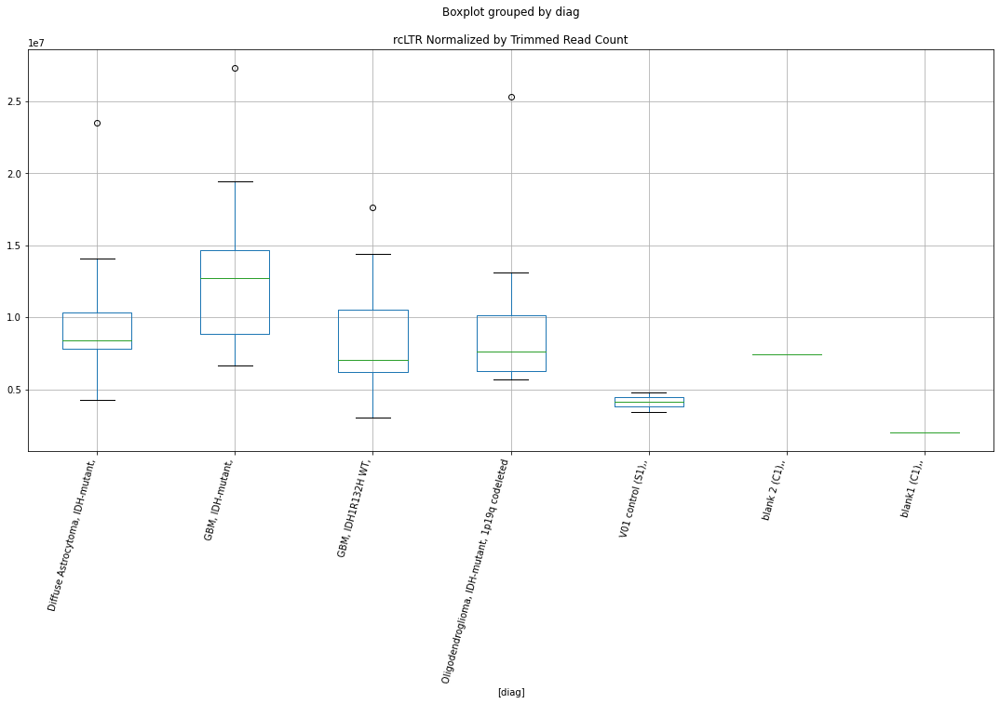

rcLTR D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8536270264745207
	p = 0.08025600932890484
rcLTR D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8536270264745207
	p = 0.08025600932890484


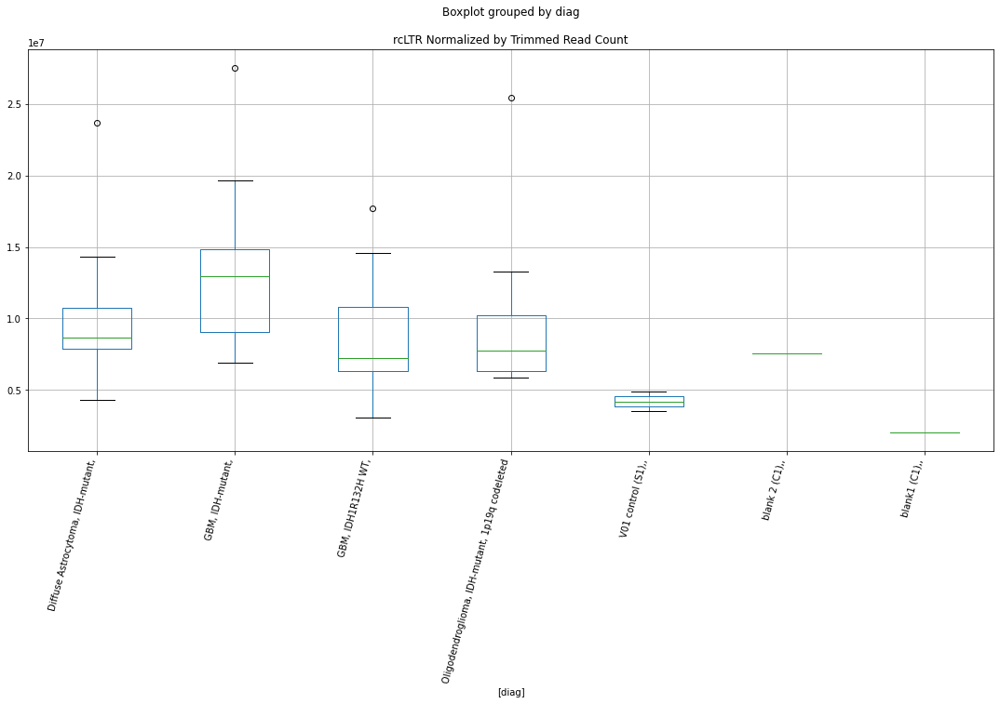

rcLow_complexity D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.19085313117115
	p = 0.04186419576833017
rcLow_complexity D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.19085313117115
	p = 0.04186419576833017


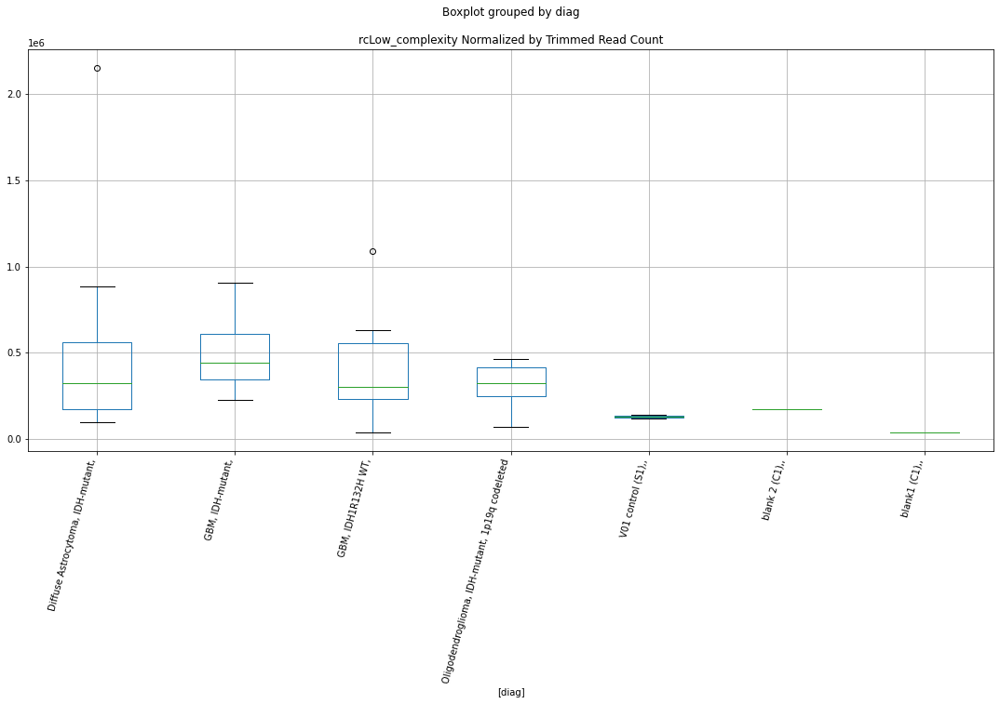

rcLow_complexity D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0293617378671405
	p = 0.057473612244592805
rcLow_complexity D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0293617378671405
	p = 0.057473612244592805


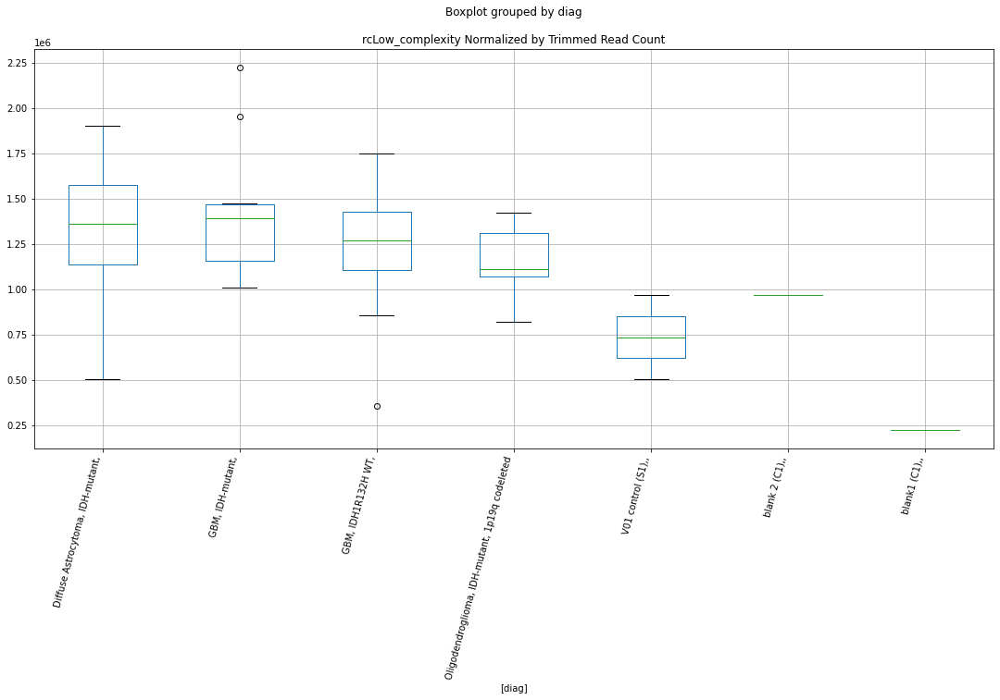

rcLow_complexity D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2153225016157365
	p = 0.03987083515395443
rcLow_complexity D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2153225016157365
	p = 0.03987083515395443


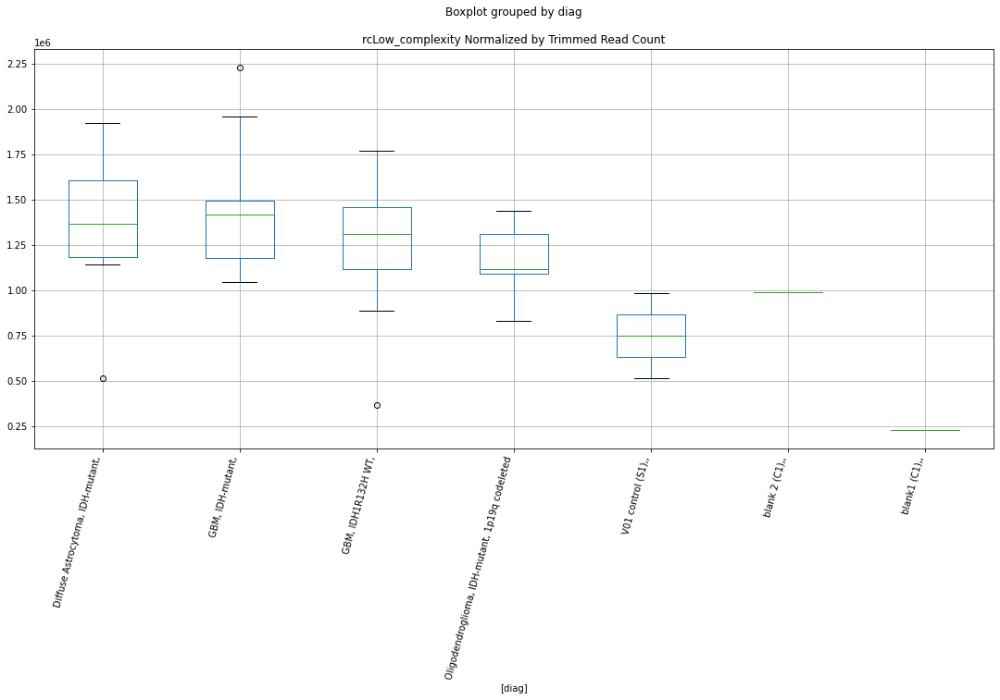

rcLow_complexity Lexogen bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9135752593886837
	p = 0.07171399824434362
rcLow_complexity Lexogen bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9135752593886837
	p = 0.07171399824434362


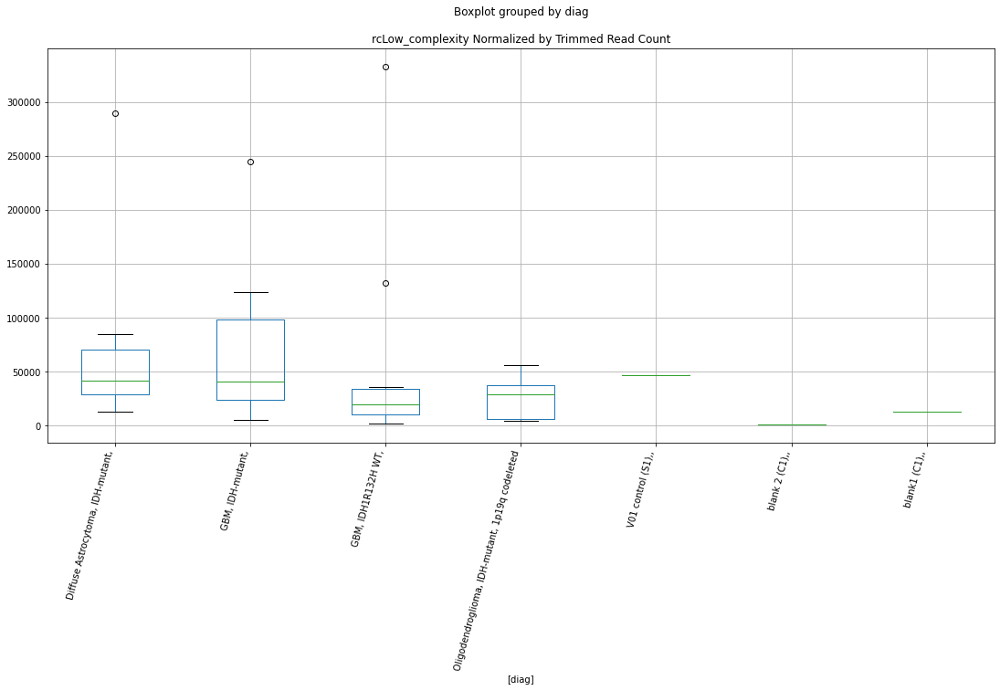

rcLow_complexity Lexogen bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9200741698770447
	p = 0.0708382487534843
rcLow_complexity Lexogen bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9200741698770447
	p = 0.0708382487534843


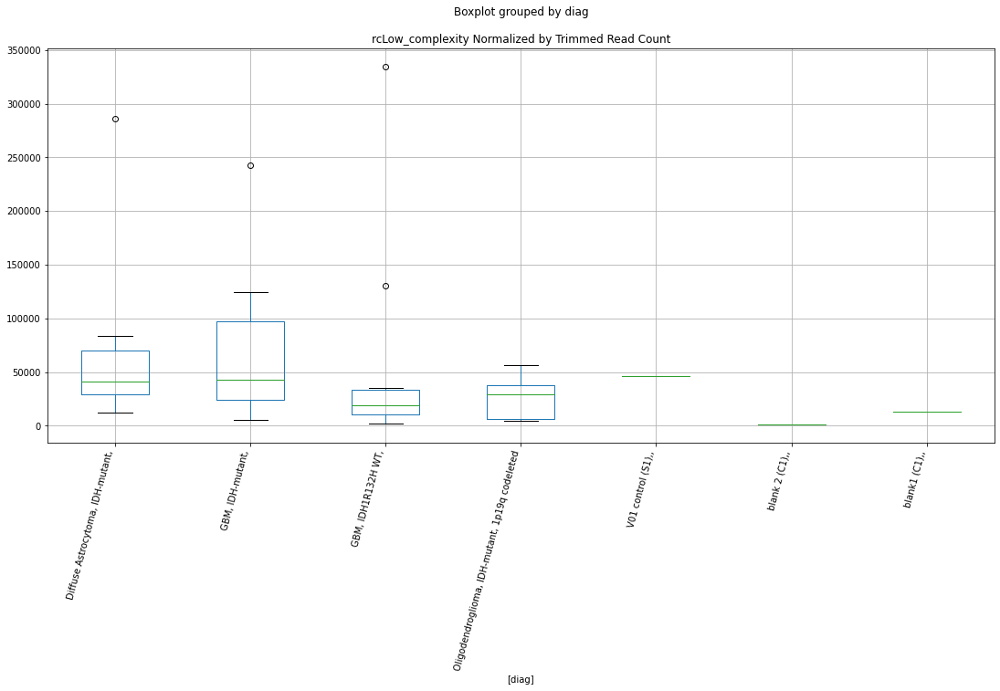

rcLow_complexity Lexogen cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7347327058786157
	p = 0.09987871446258775
rcLow_complexity Lexogen cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7347327058786157
	p = 0.09987871446258775


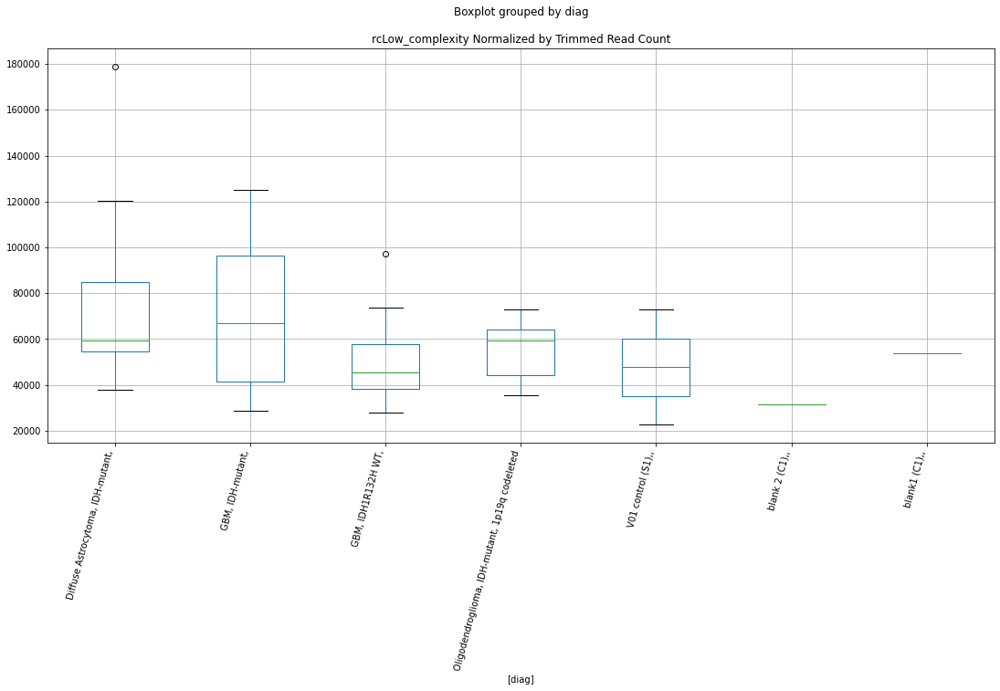

rcLow_complexity Lexogen cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9191977163372607
	p = 0.07095579643099292
rcLow_complexity Lexogen cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9191977163372607
	p = 0.07095579643099292


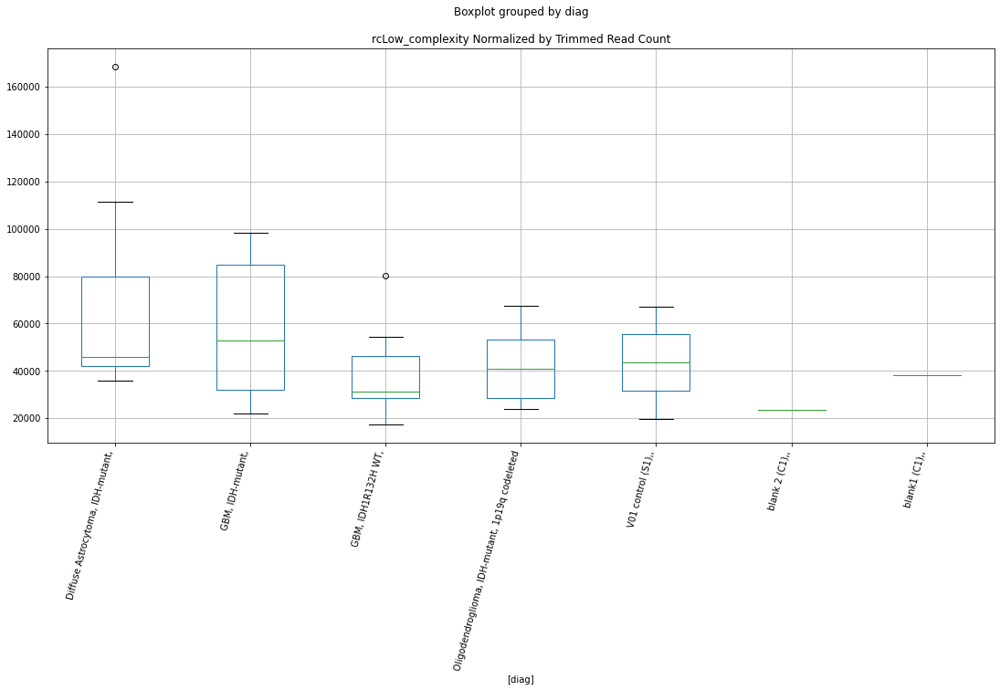

rcLow_complexity Lexogen cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.853235831208527
	p = 0.08031458004017972
rcLow_complexity Lexogen cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.853235831208527
	p = 0.08031458004017972


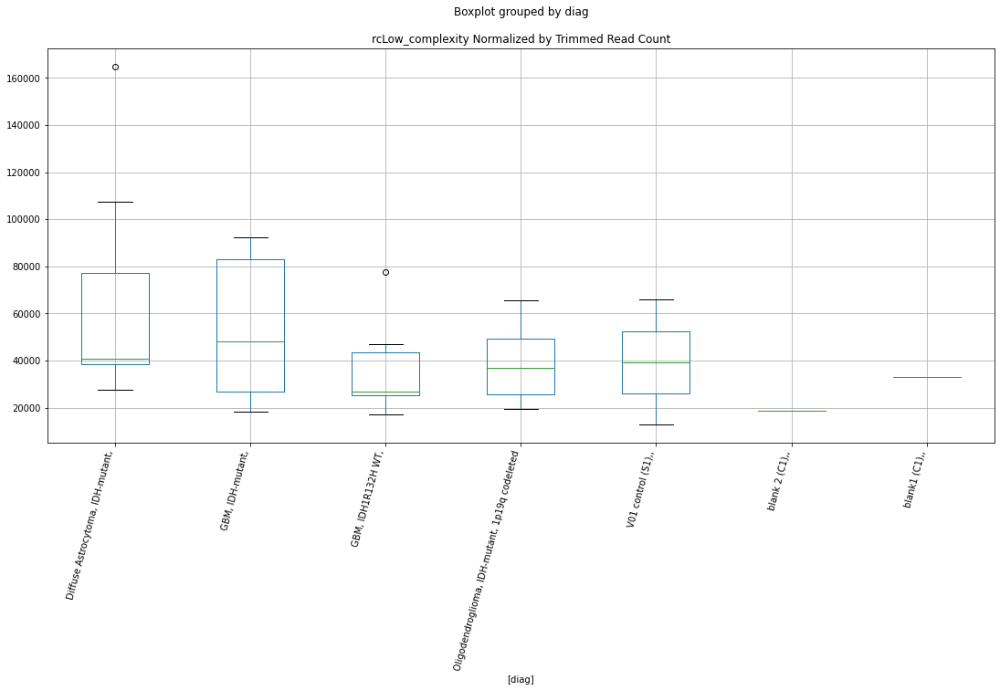

rcSatellite D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8315778753466951
	p = 0.08361654086142403
rcSatellite D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8315778753466951
	p = 0.08361654086142403


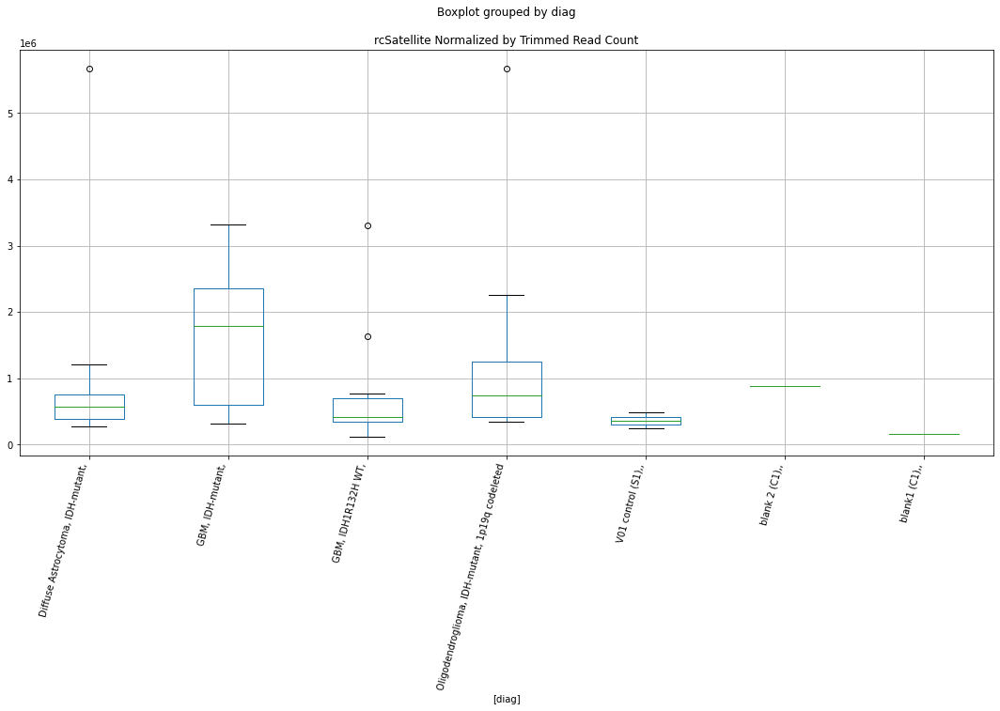

rcSatellite D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8282482378837082
	p = 0.08413461469732539
rcSatellite D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8282482378837082
	p = 0.08413461469732539


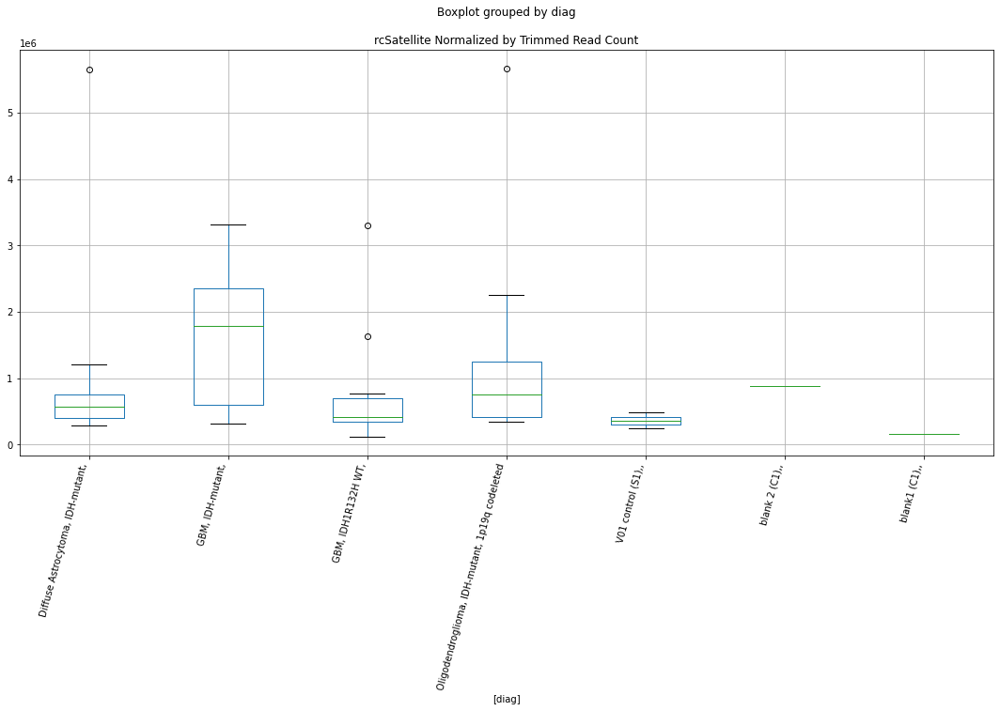

rcrRNA D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7509709469889445
	p = 0.09697404158718215
rcrRNA D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7509709469889445
	p = 0.09697404158718215


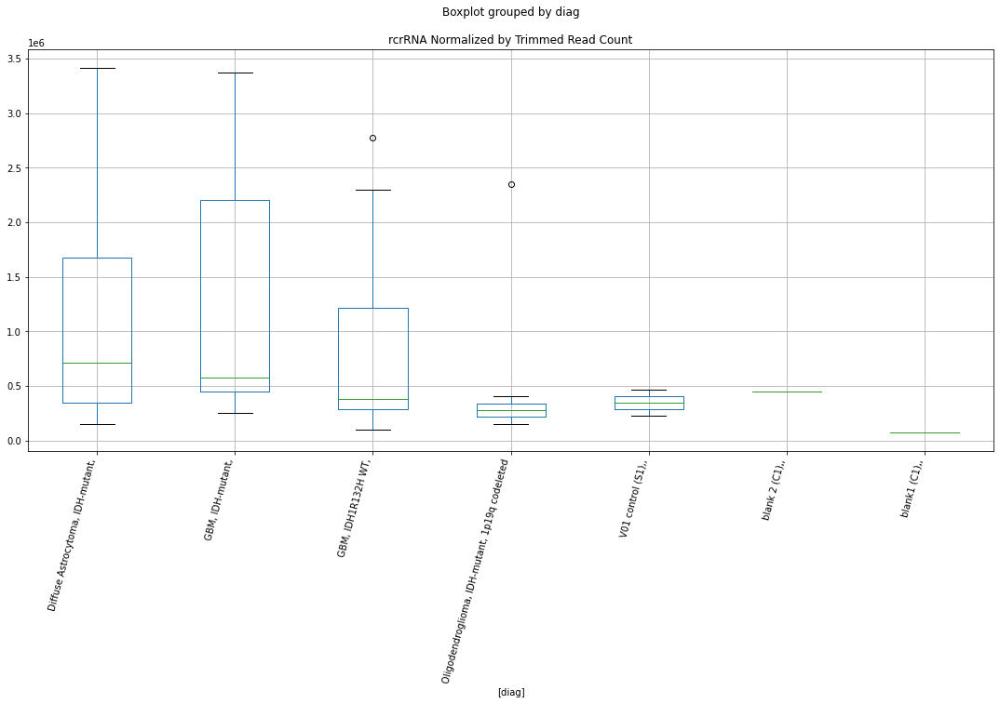

rcrRNA D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7502581067681915
	p = 0.09709999986270744
rcrRNA D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7502581067681915
	p = 0.09709999986270744


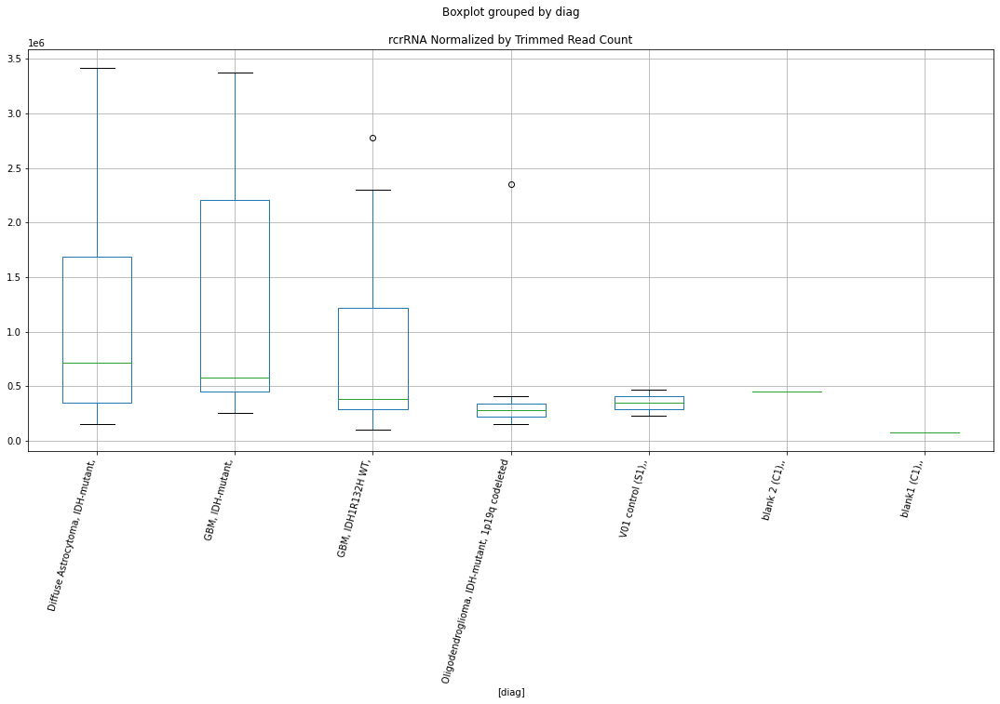

rcrRNA D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7502669534652913
	p = 0.09709843578970356
rcrRNA D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7502669534652913
	p = 0.09709843578970356


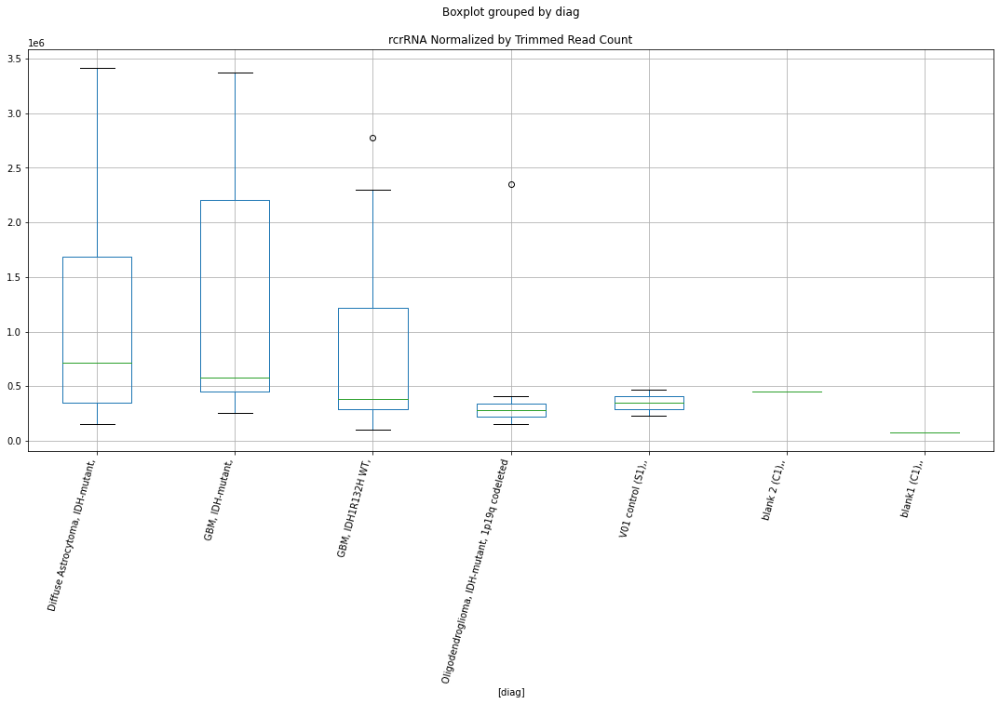

rctRNA D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7385980671863666
	p = 0.09918054026500964
rctRNA D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8719258775444532
	p = 0.07755799284828228
rctRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7385980671863666
	p = 0.09918054026500964
rctRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8719258775444532
	p = 0.07755799284828228


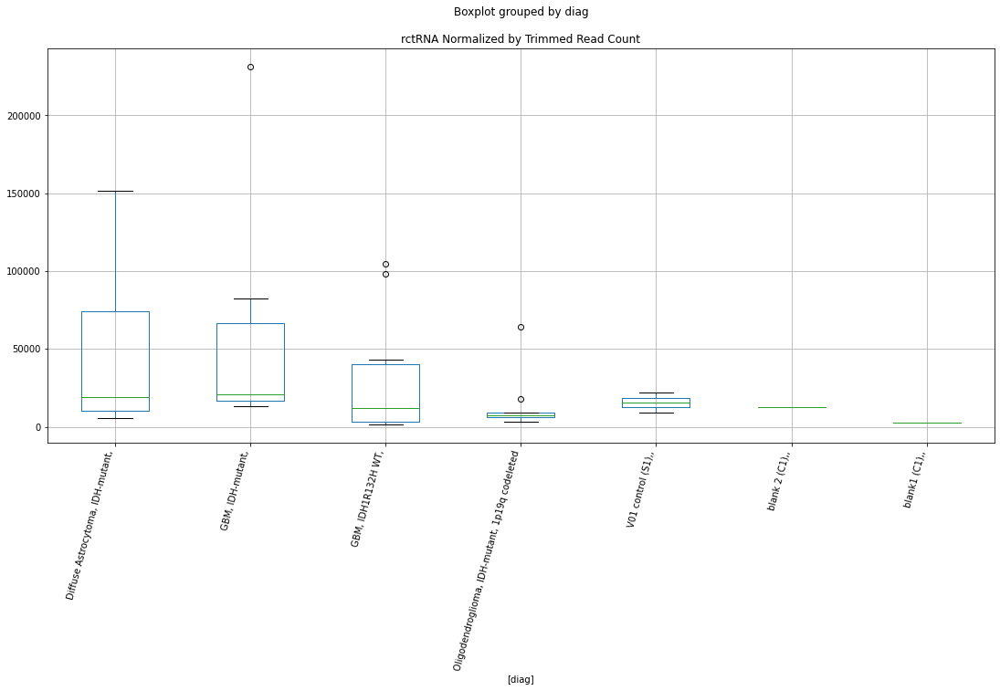

rcsrpRNA D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7747503139494307
	p = 0.09285273101551164
rcsrpRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7747503139494307
	p = 0.09285273101551164


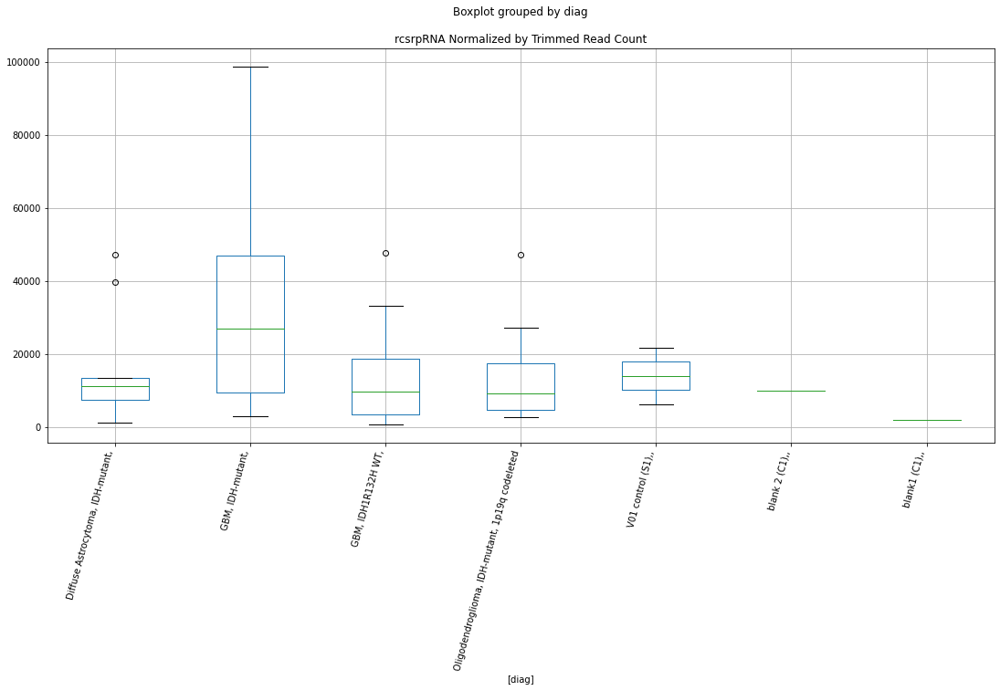

rcRC D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7520686720338206
	p = 0.09678035159433576
rcRC D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7520686720338206
	p = 0.09678035159433576


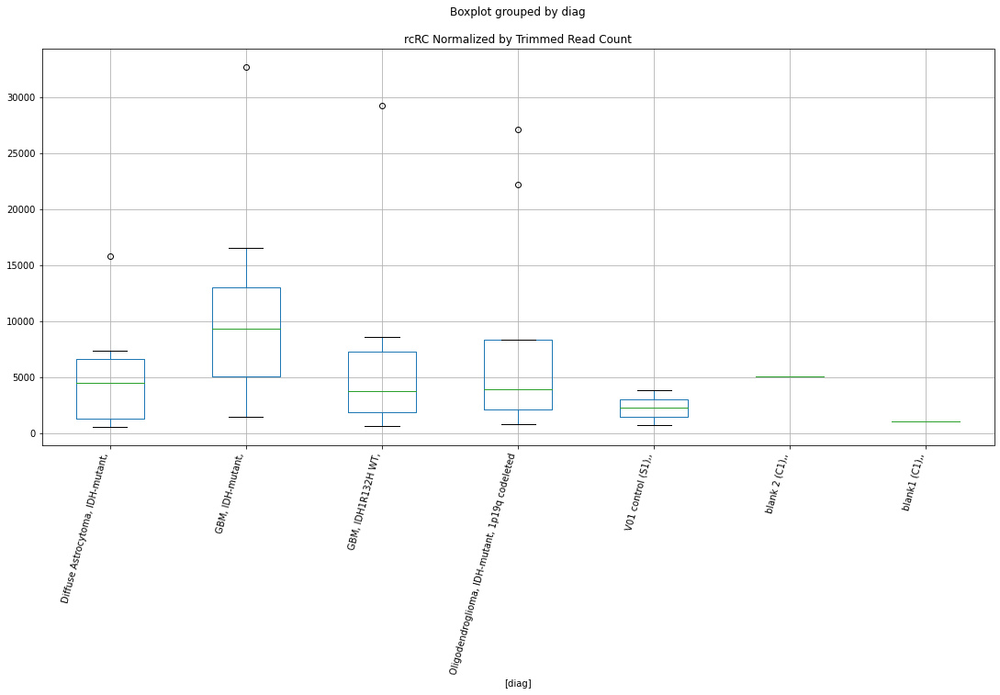

In [76]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmskclasses:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


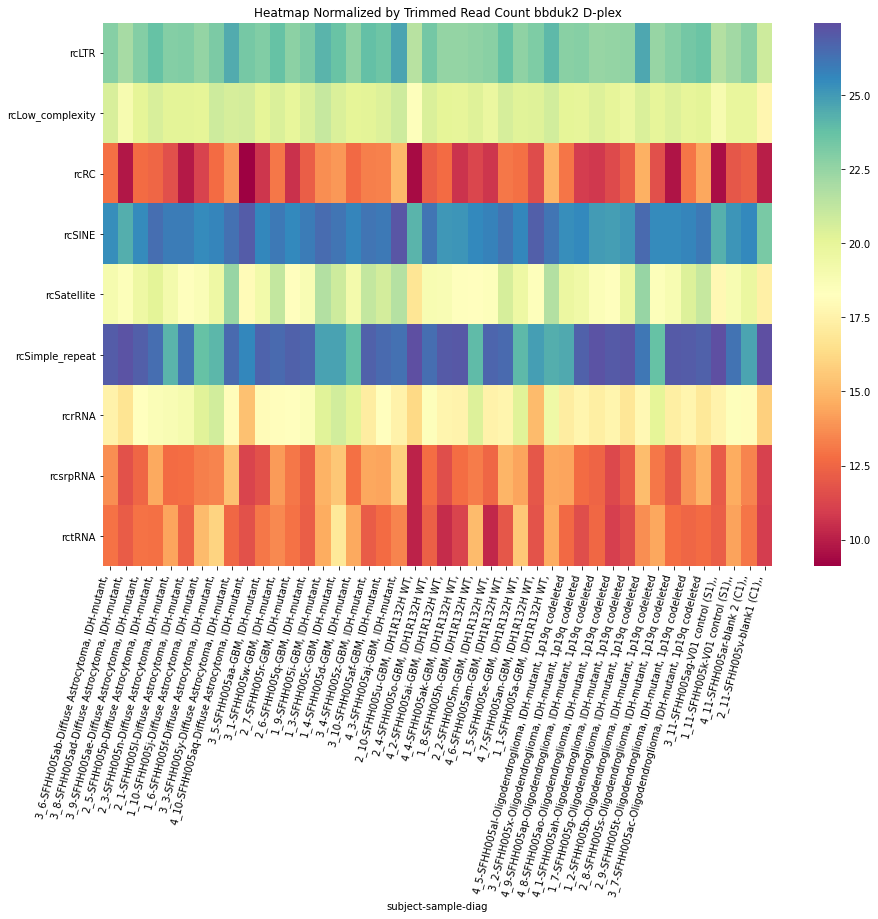

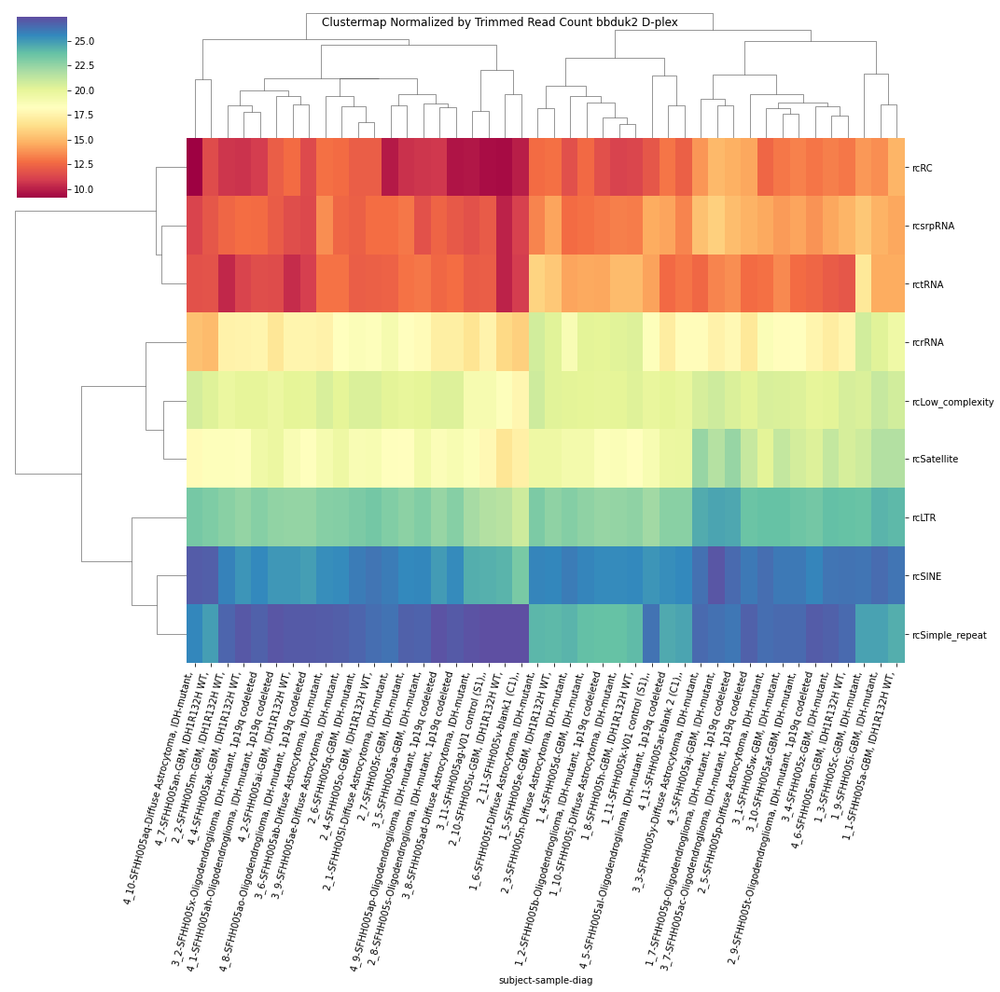

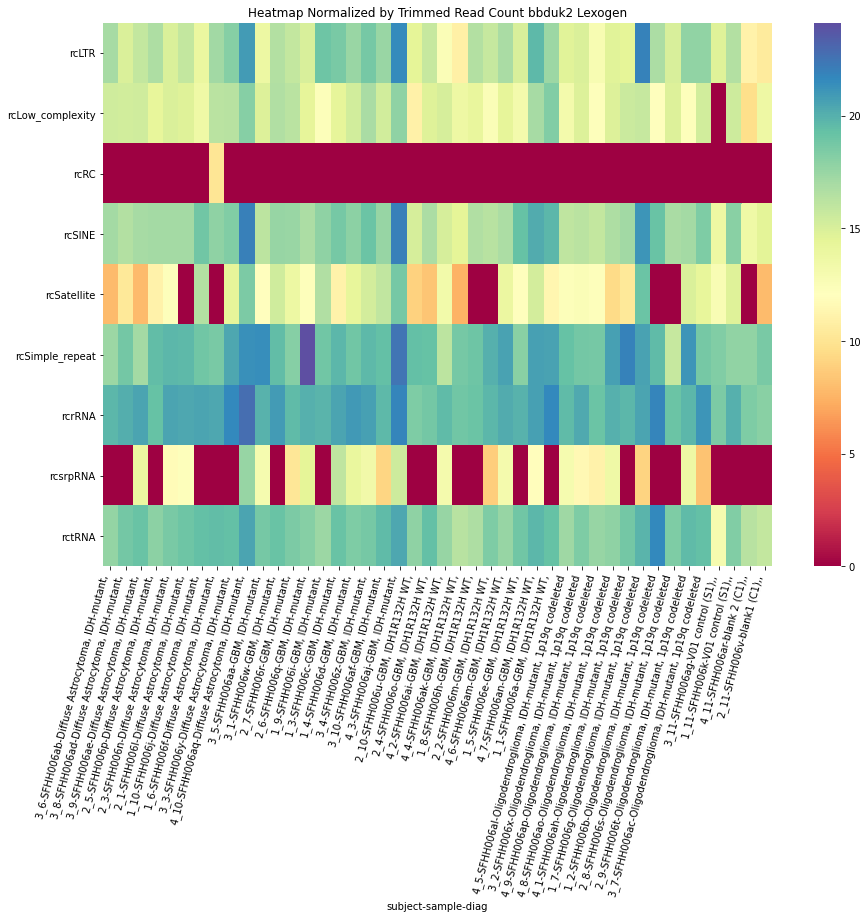

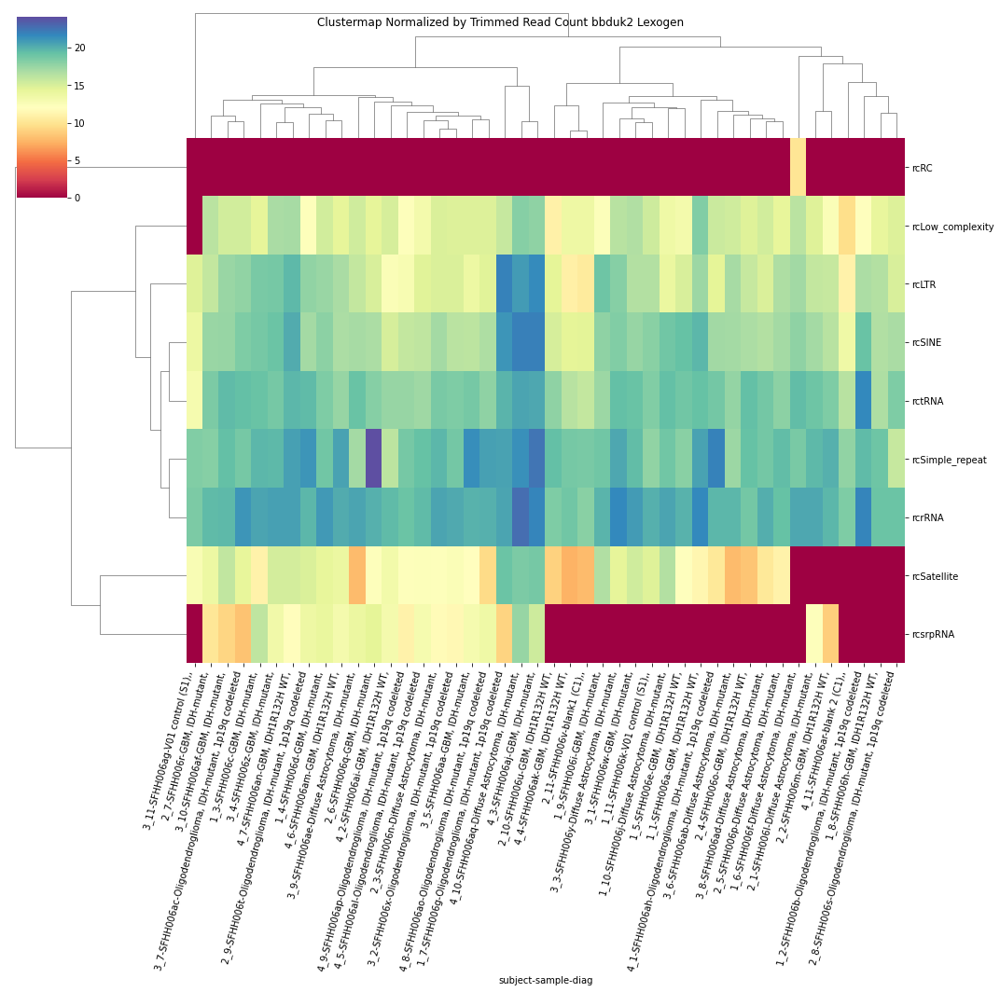

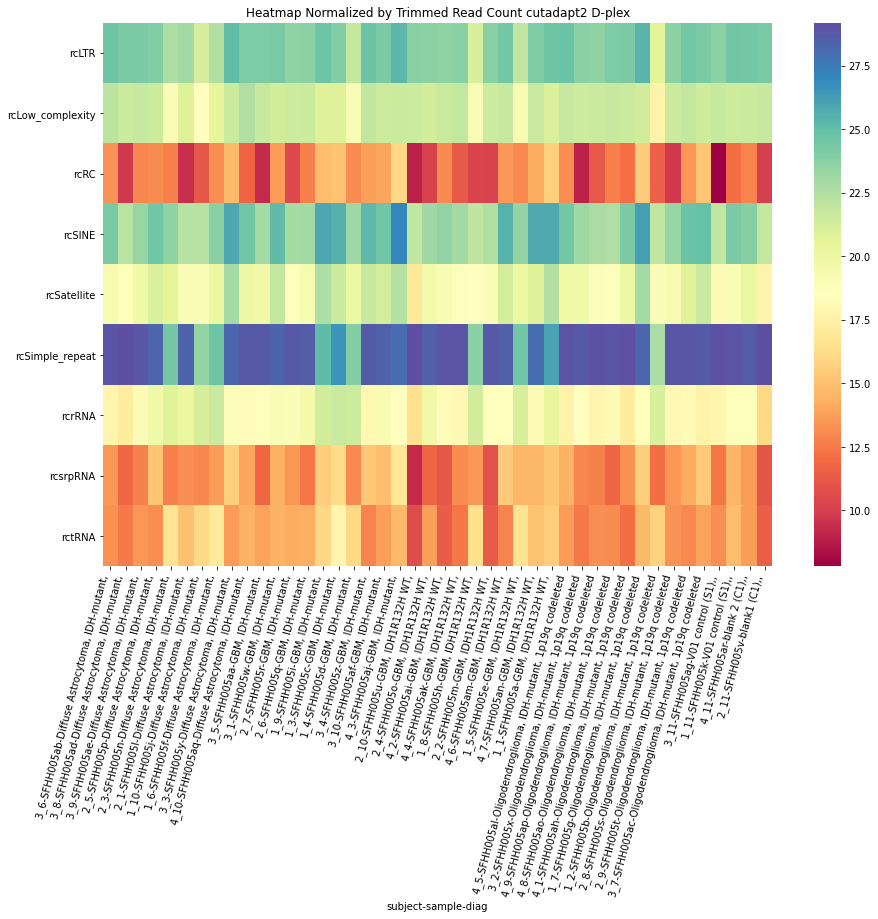

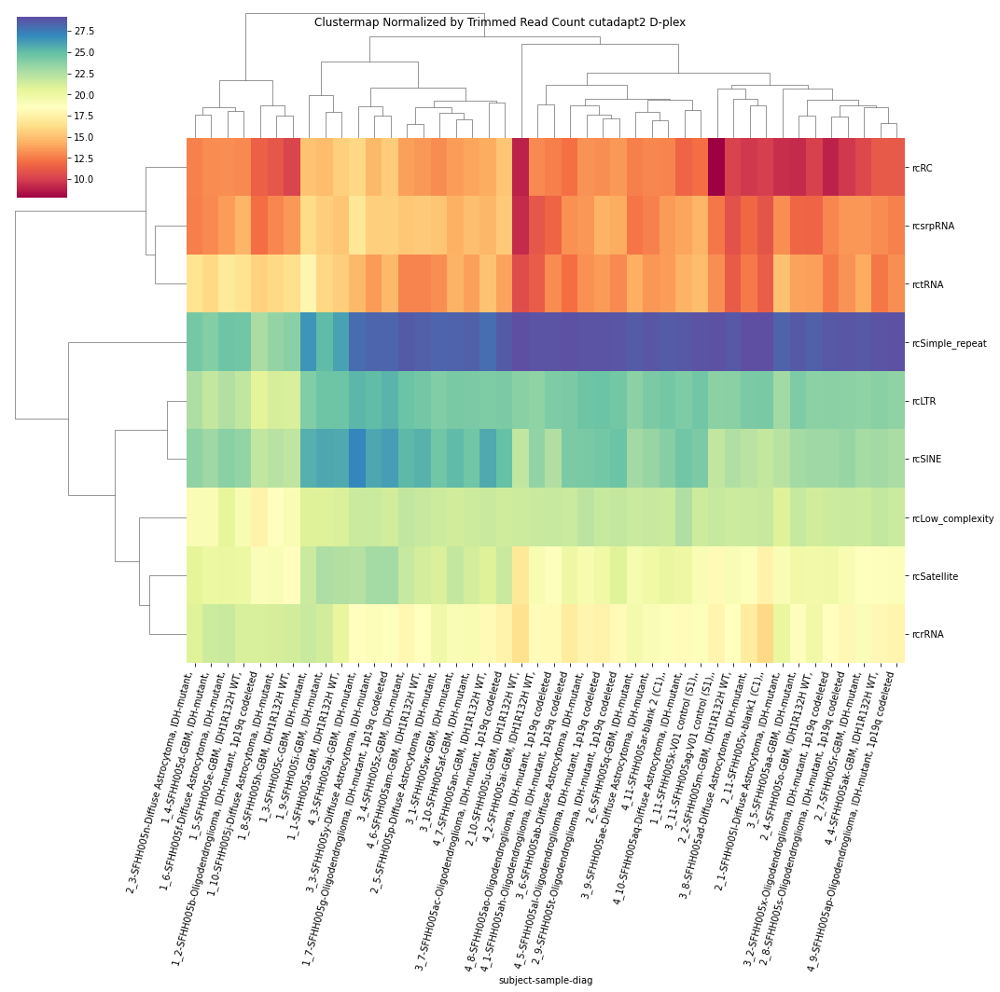

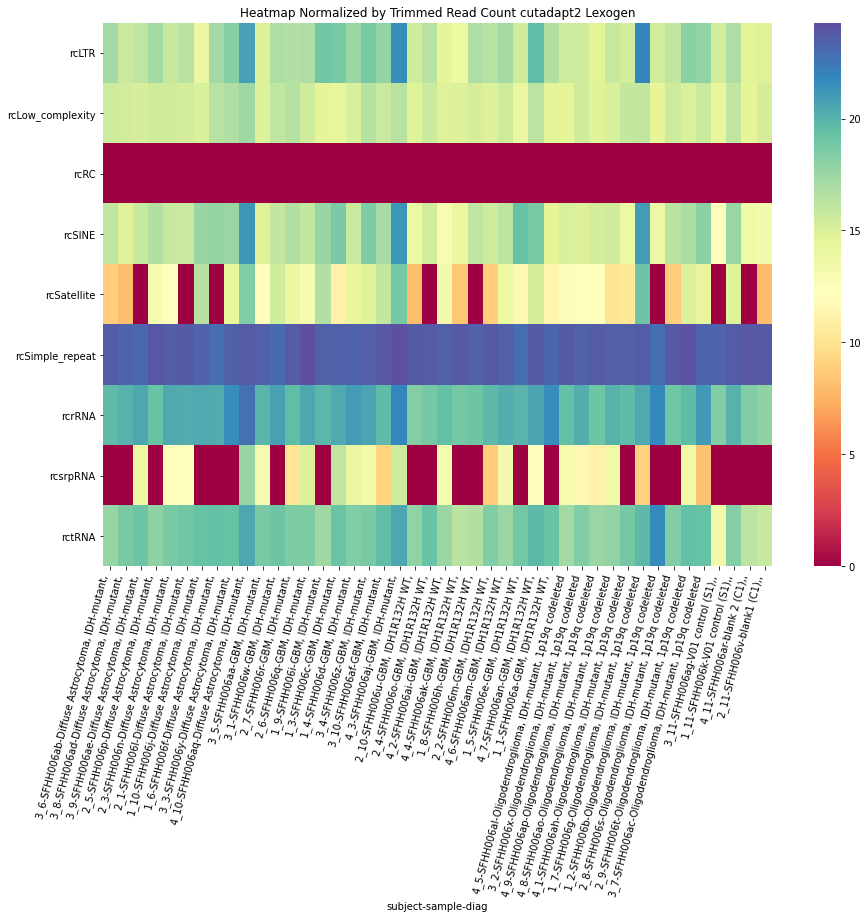

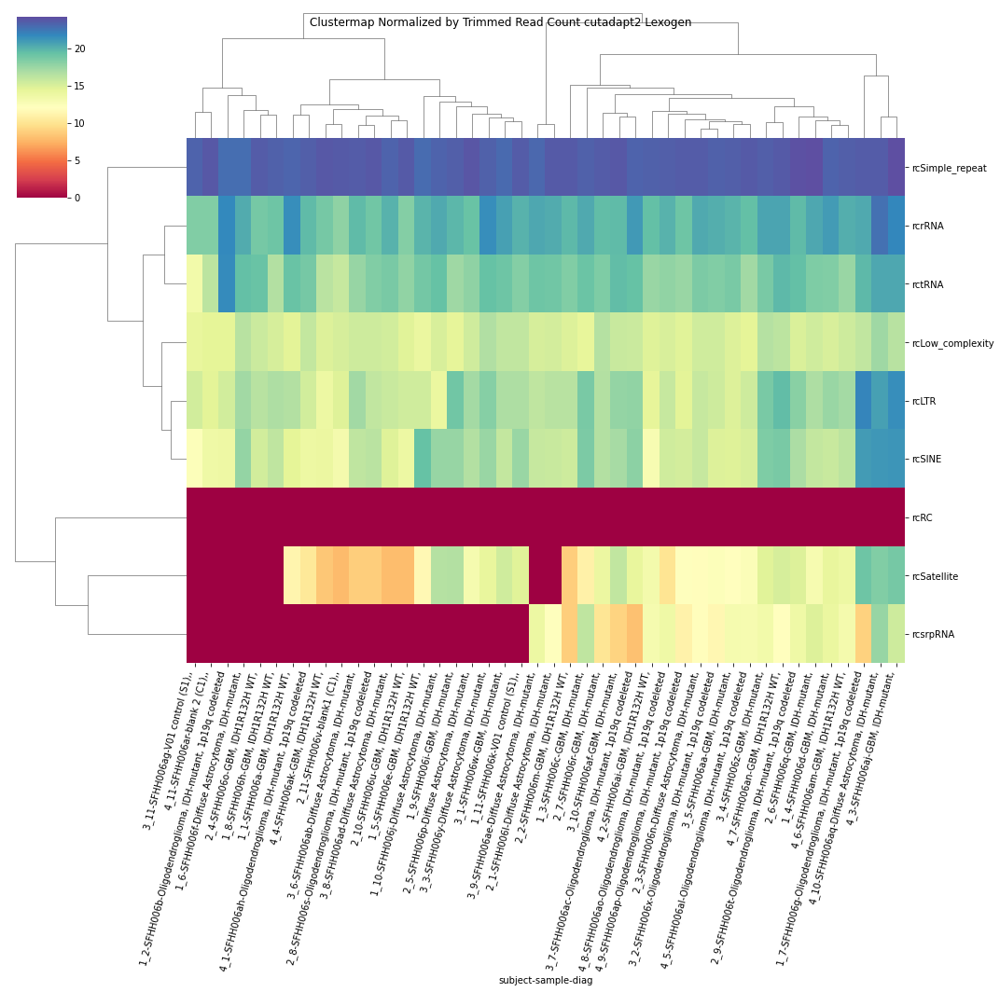

In [77]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap Normalized by Trimmed Read Count "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap Normalized by Trimmed Read Count "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rn(G)n D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.859028673217422
	p = 0.0794511007937431
rn(G)n D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.859028673217422
	p = 0.0794511007937431


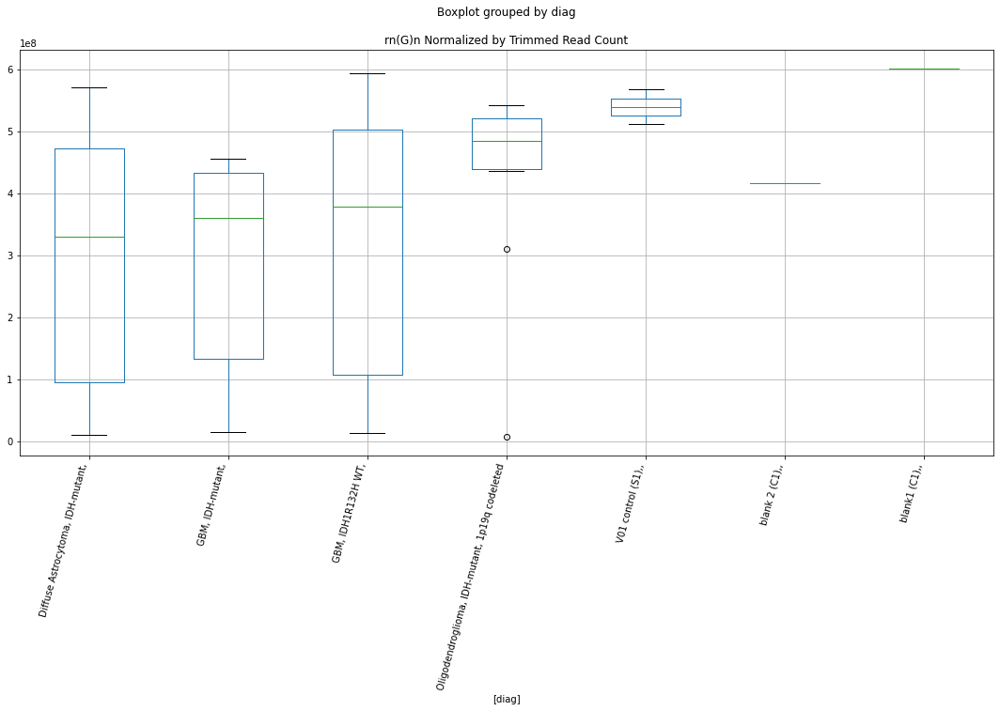

rn(G)n D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.861913796615567
	p = 0.07902410625285287
rn(G)n D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.861913796615567
	p = 0.07902410625285287


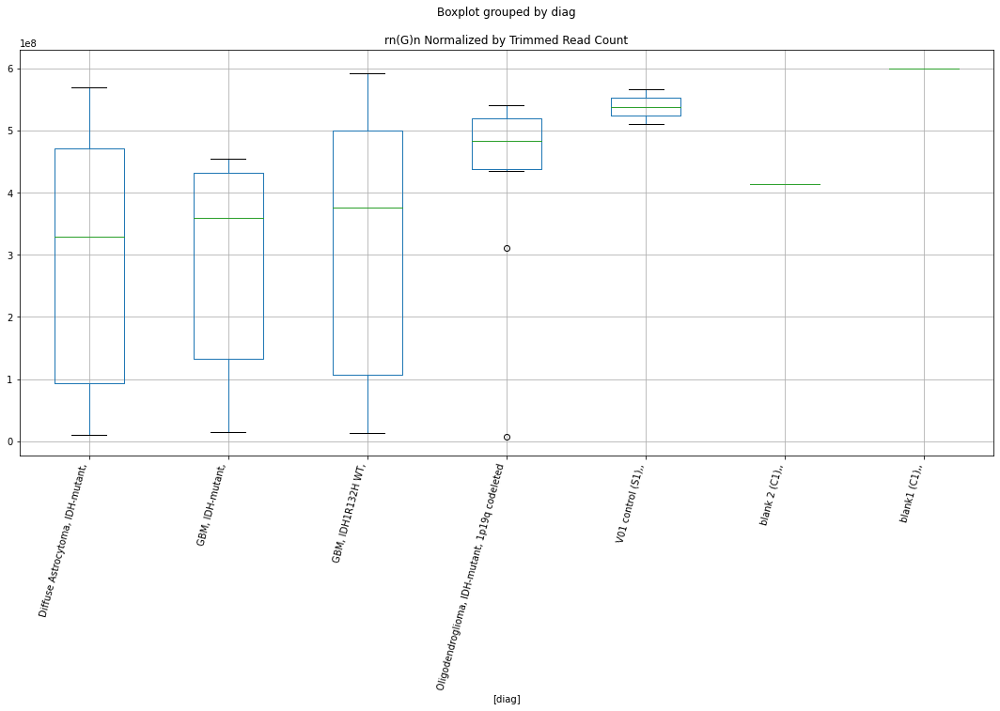

rn(G)n D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8618333707240509
	p = 0.07903598170361717
rn(G)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8618333707240509
	p = 0.07903598170361717


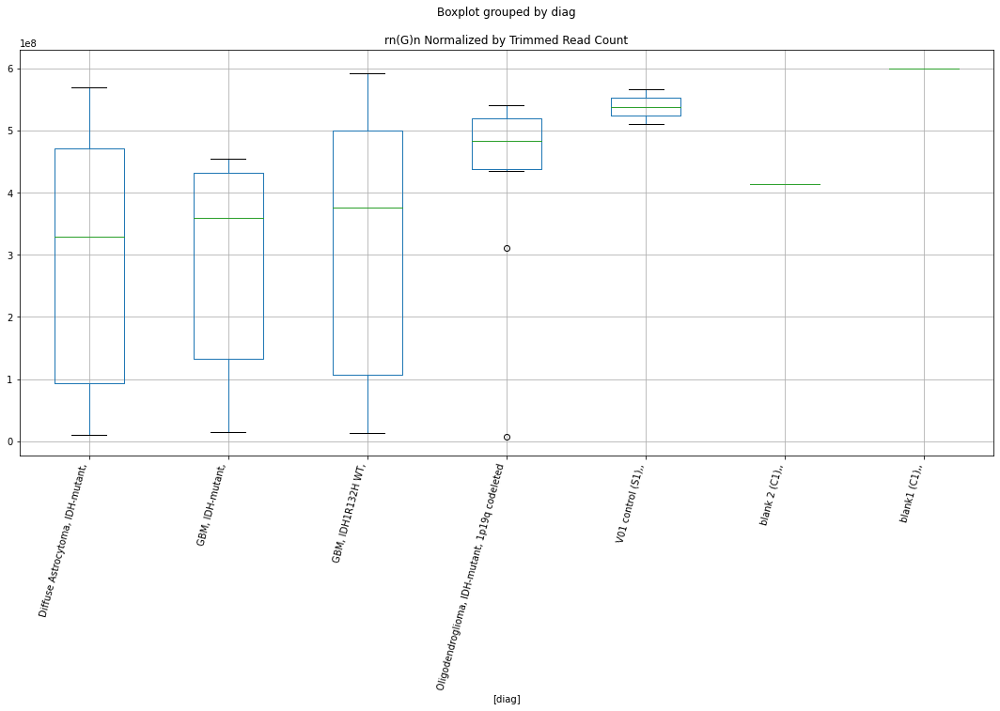

rnMER52A D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9168775805783695
	p = 0.07126780456085136
rnMER52A D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9168775805783695
	p = 0.07126780456085136


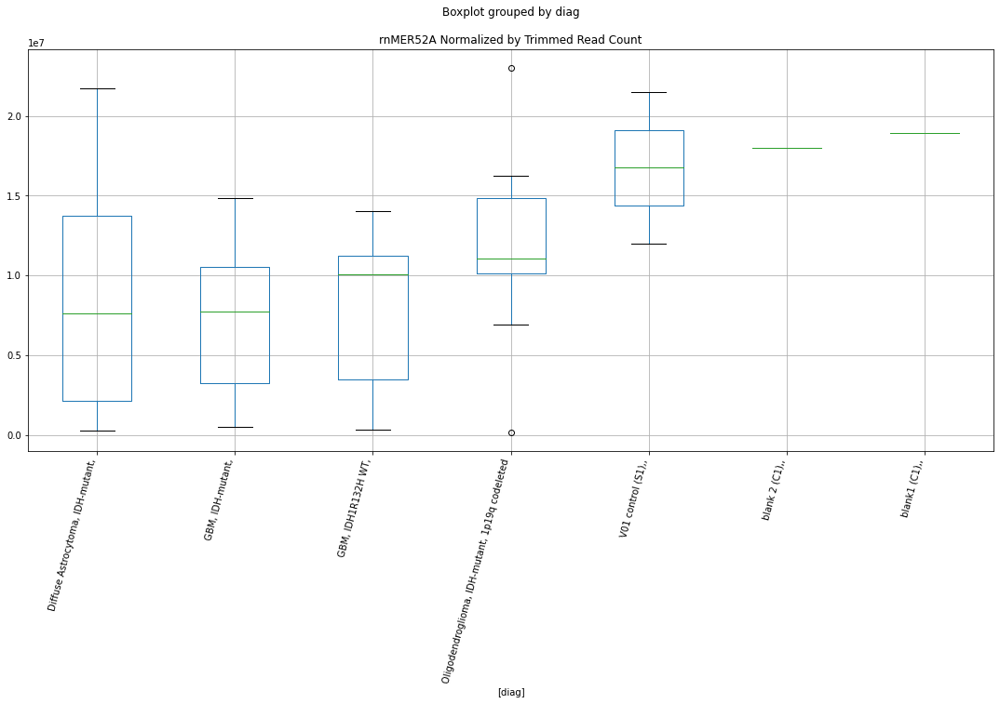

rnMER52A D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9170790415405983
	p = 0.07124066414873521
rnMER52A D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9170790415405983
	p = 0.07124066414873521


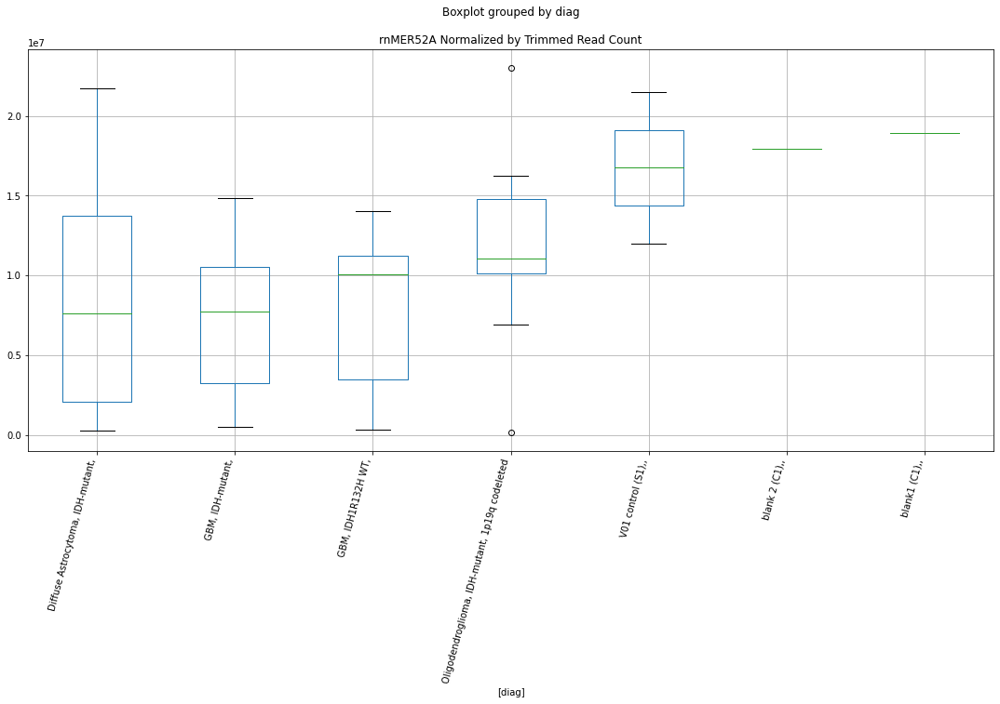

rnMER52A D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.917166410128105
	p = 0.0712288968859646
rnMER52A D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.917166410128105
	p = 0.0712288968859646


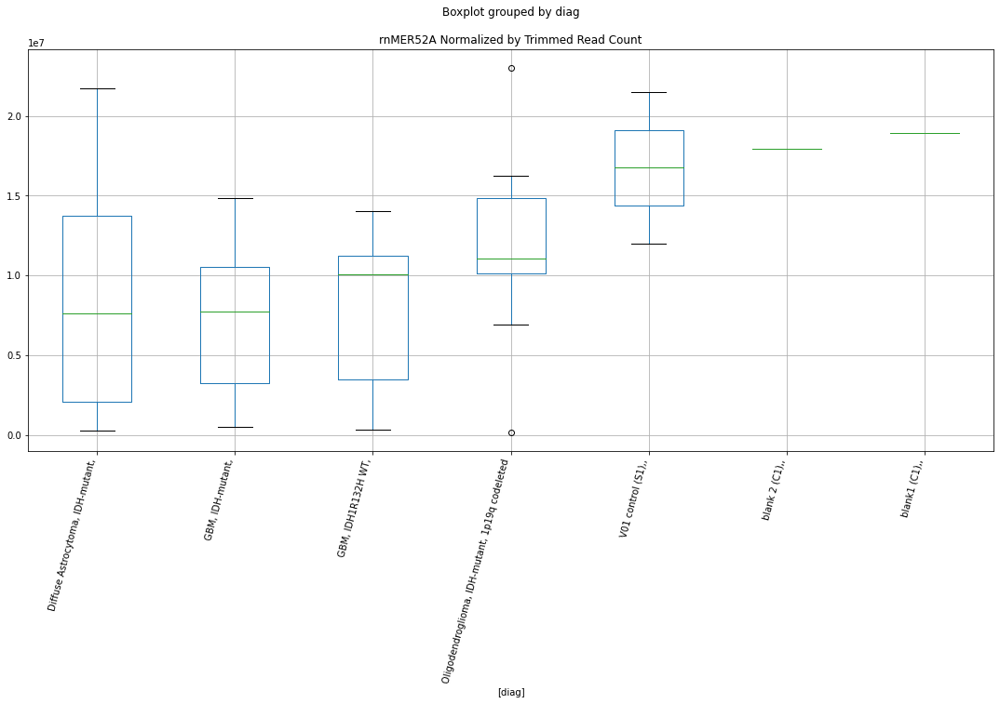

rn(C)n D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7661875341693476
	p = 0.09431889260593192
rn(C)n D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7661875341693476
	p = 0.09431889260593192


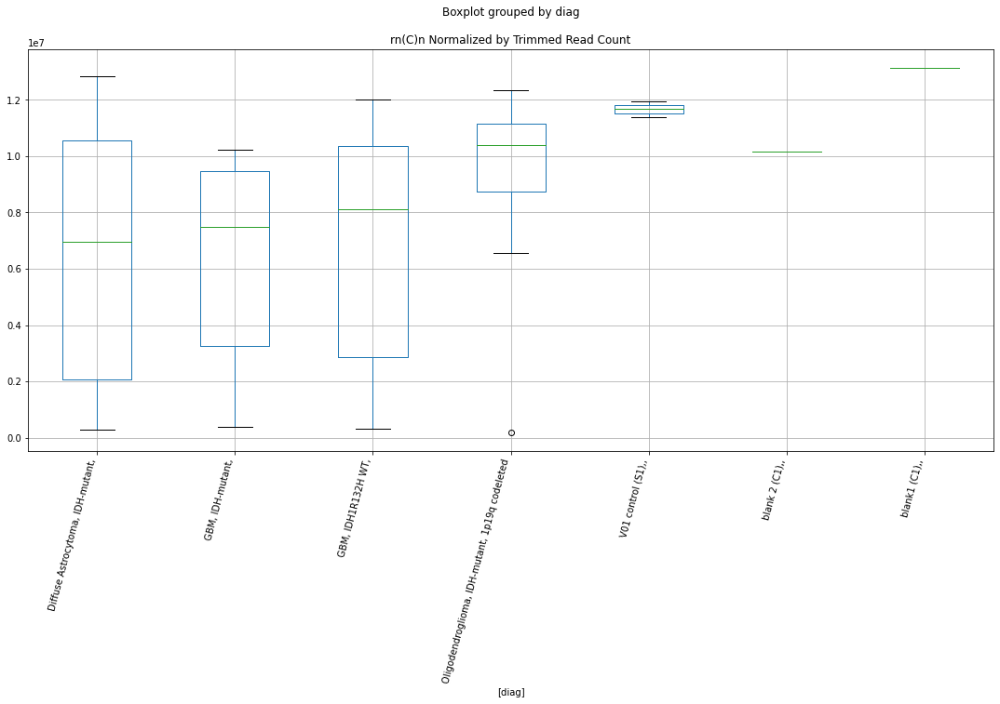

rn(C)n D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7700520678527285
	p = 0.0936547134907317
rn(C)n D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7700520678527285
	p = 0.0936547134907317


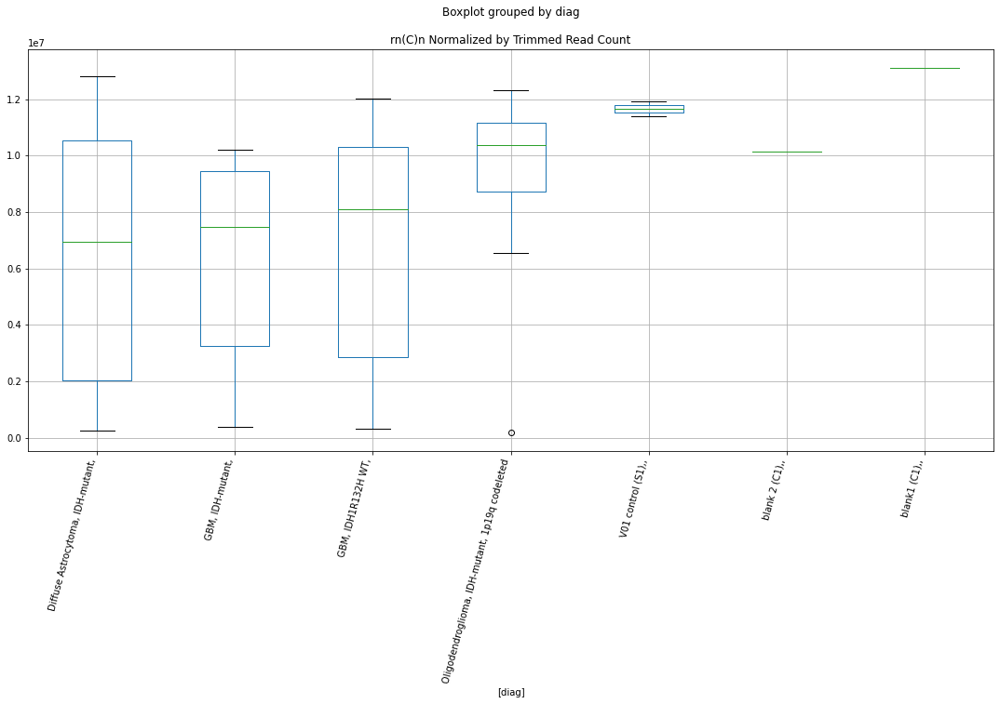

rn(C)n D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7698207234493977
	p = 0.09369435878170891
rn(C)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7698207234493977
	p = 0.09369435878170891


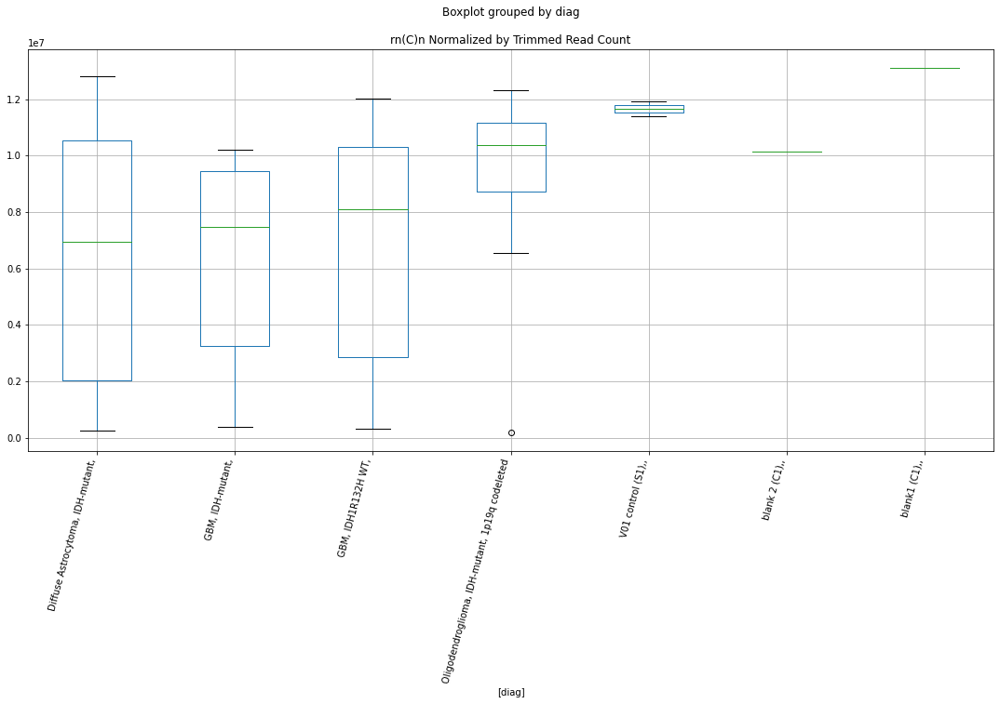

rnAluY D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.225557422556883
	p = 0.03906325070030739
rnAluY D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.225557422556883
	p = 0.03906325070030739


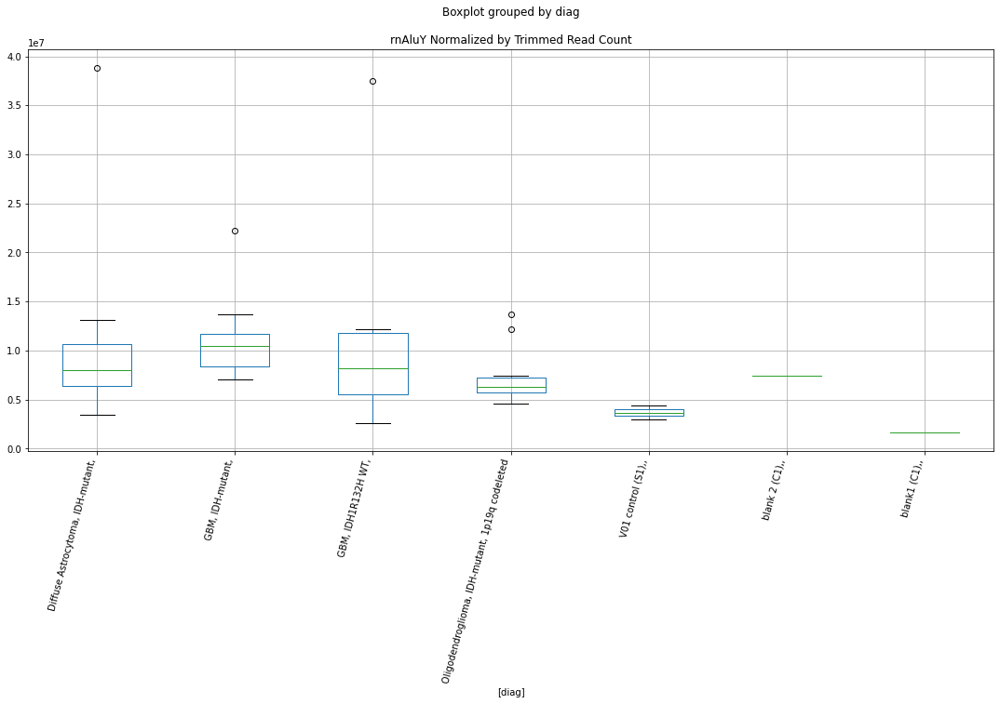

rnAluY D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.253481008631906
	p = 0.03693595129831763
rnAluY D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.253481008631906
	p = 0.03693595129831763


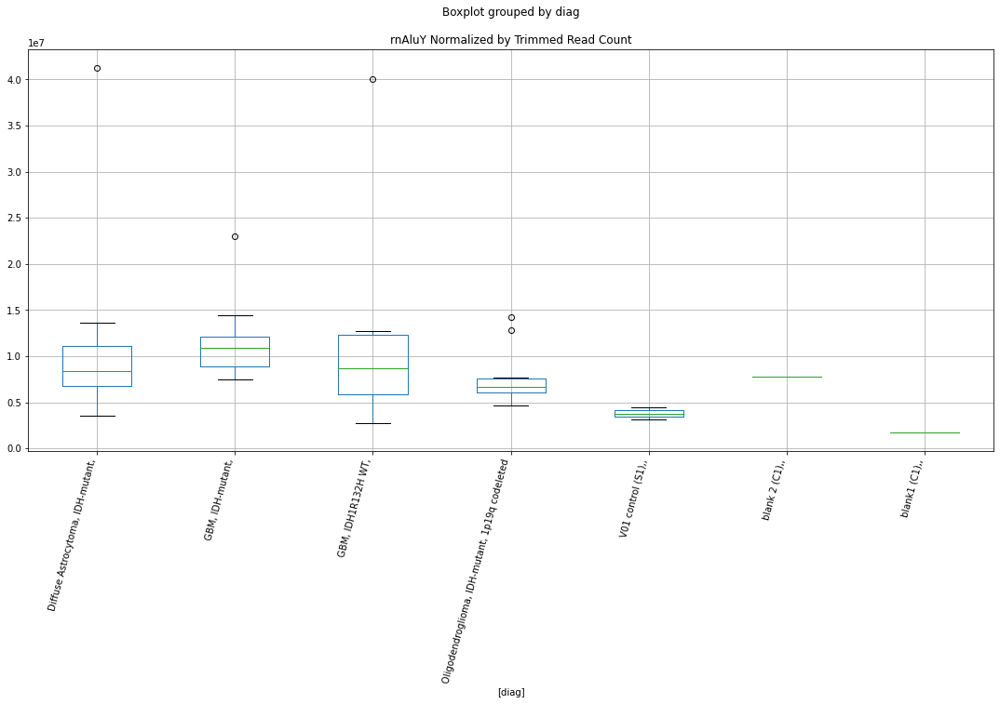

rnAluSz D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0389880803359093
	p = 0.05641270932537156
rnAluSz D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0389880803359093
	p = 0.05641270932537156


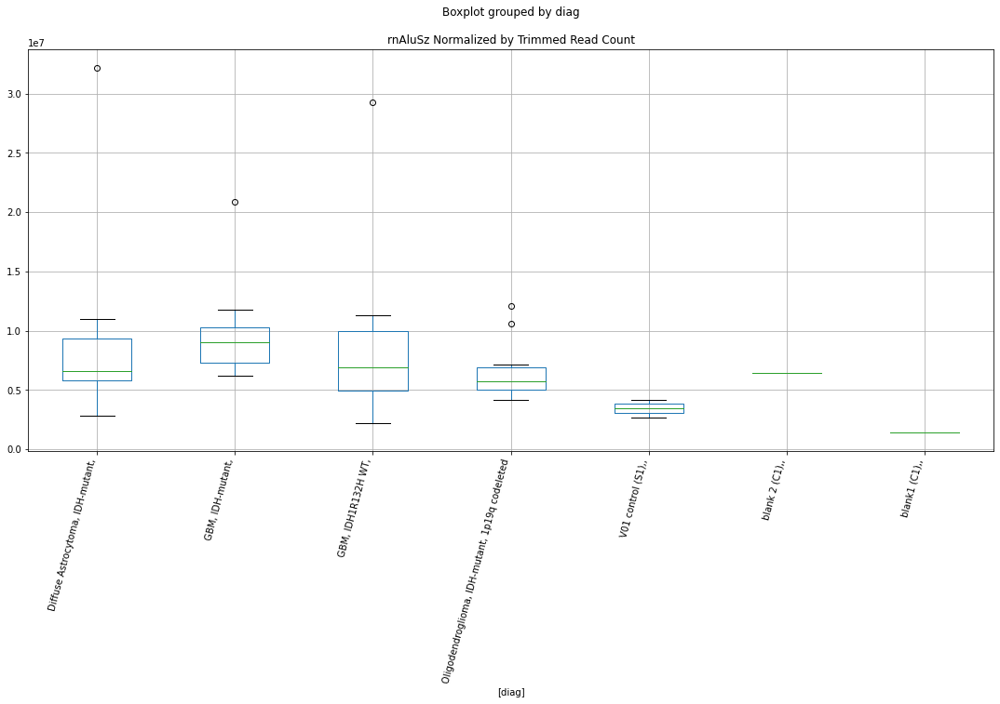

rnAluSz D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.084799292995223
	p = 0.051602391537827454
rnAluSz D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.084799292995223
	p = 0.051602391537827454


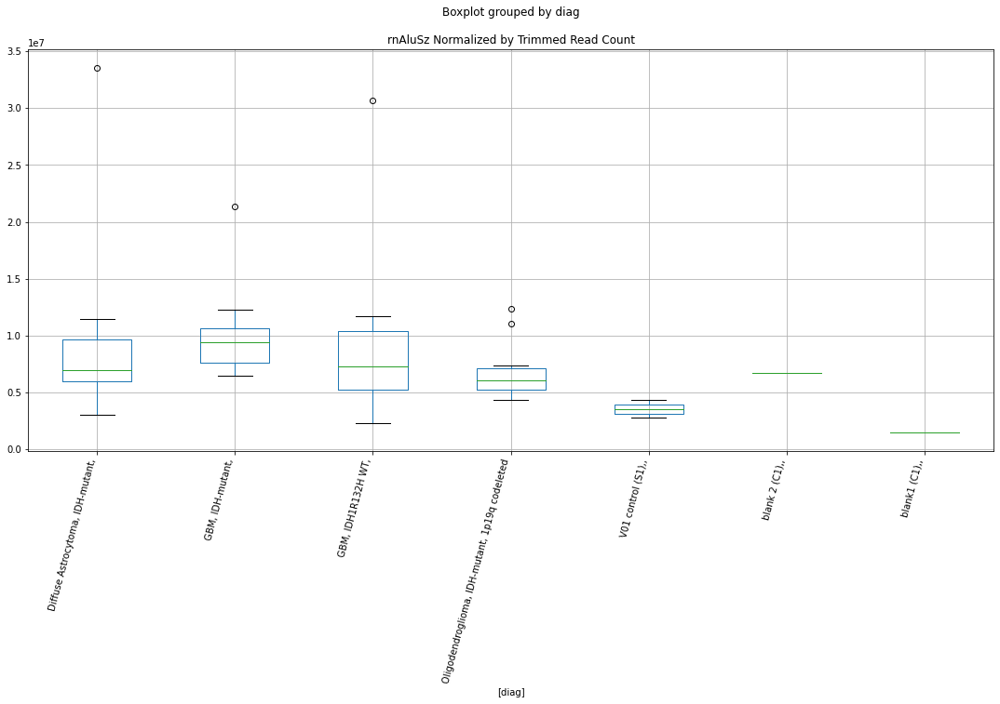

rn(T)n D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.4460797171932245
	p = 0.0028816863606412318
rn(T)n D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.937630945347155
	p = 0.06851978923070039
rn(T)n D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0930734795038353
	p = 0.05077431179313713
rn(T)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.4460797171932245
	p = 0.0028816863606412318
rn(T)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0930734795038353
	p = 0.05077431179313713
rn(T)n D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.937630945347155
	p = 0.06851978923070039


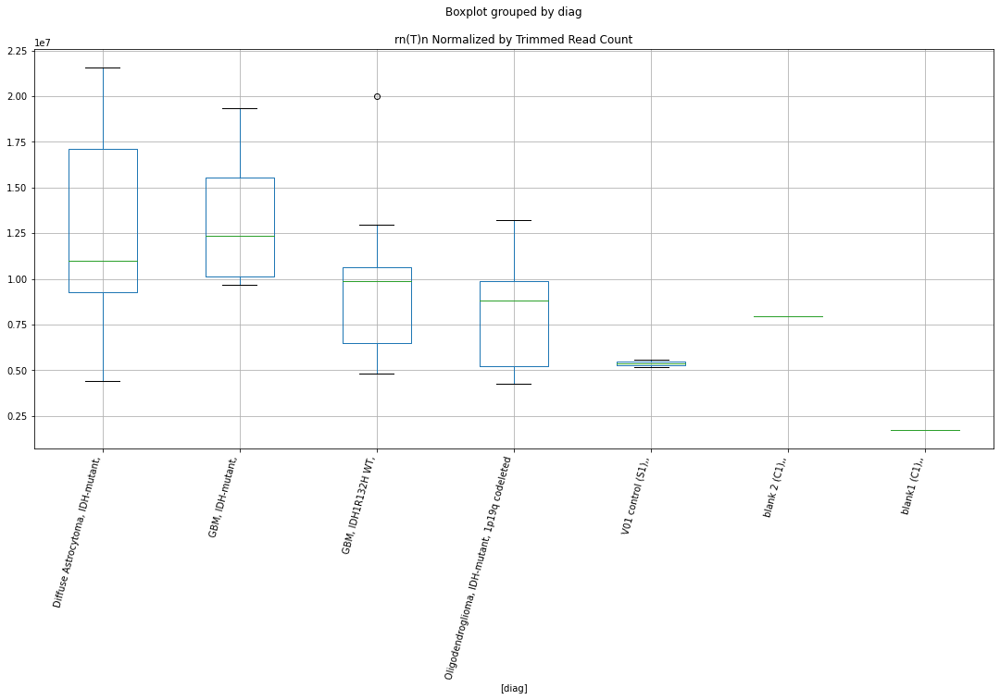

rn(T)n D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.4661194305062435
	p = 0.0027564021462181394
rn(T)n D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.925720971091478
	p = 0.07008505779820418
rn(T)n D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0990315831124486
	p = 0.05018551856713795
rn(T)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.4661194305062435
	p = 0.0027564021462181394
rn(T)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0990315831124486
	p = 0.05018551856713795
rn(T)n D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.925720971091478
	p = 0.07008505779820418


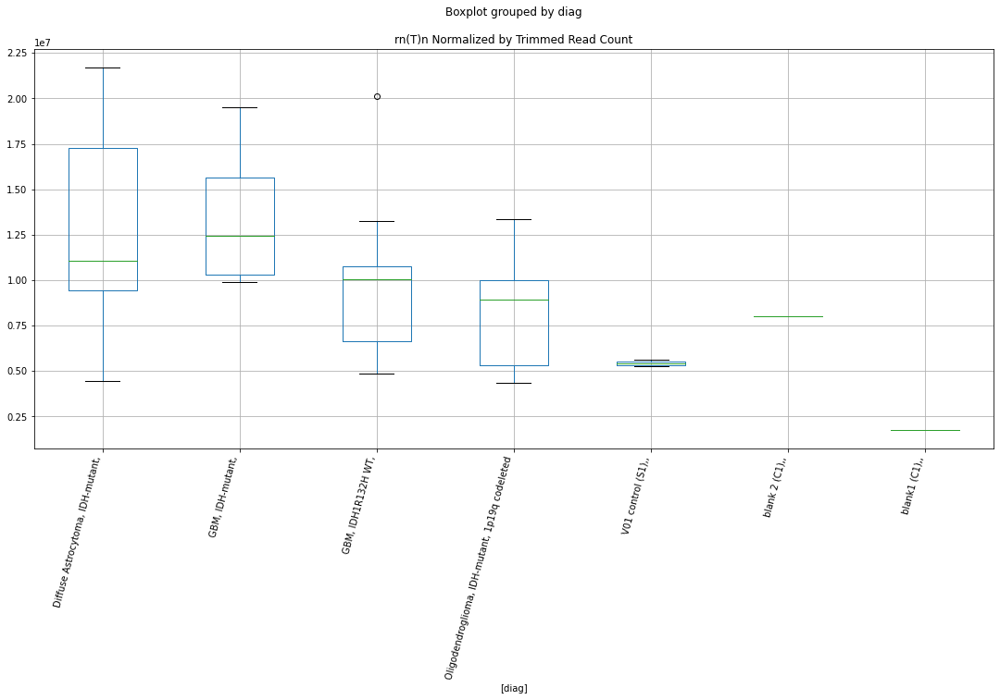

rnAluJb D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.537236696235625
	p = 0.020642957659885698
rnAluJb D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9356345190322606
	p = 0.06877997702370994
rnAluJb D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.537236696235625
	p = 0.020642957659885698
rnAluJb D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9356345190322606
	p = 0.06877997702370994


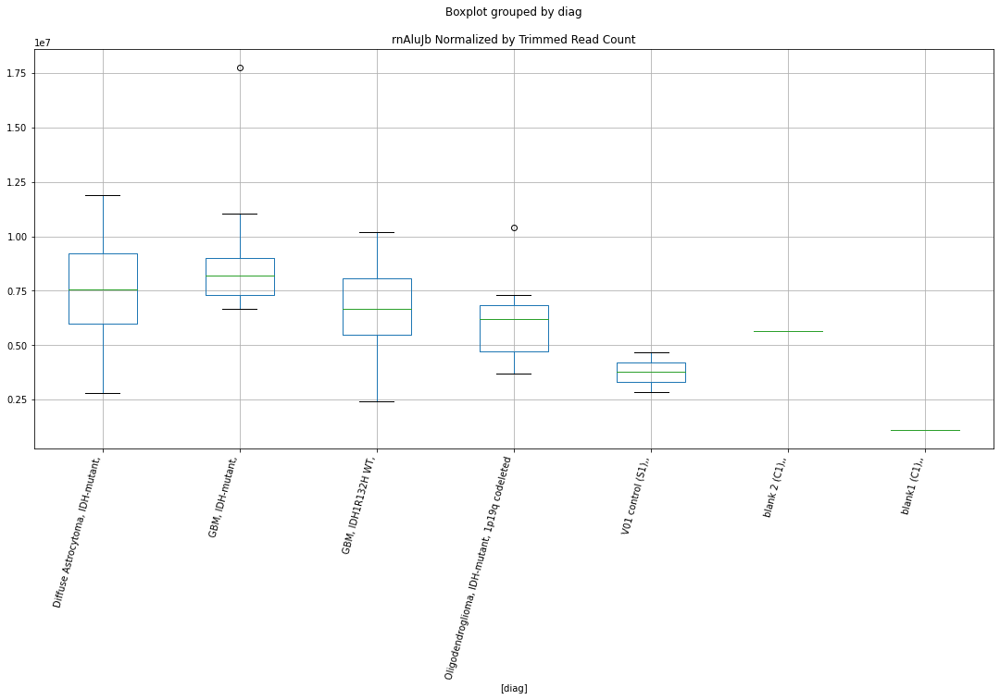

rnAluJb D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.625361743165195
	p = 0.017158369747395097
rnAluJb D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.926570891265
	p = 0.06997231139960058
rnAluJb D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.625361743165195
	p = 0.017158369747395097
rnAluJb D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.926570891265
	p = 0.06997231139960058


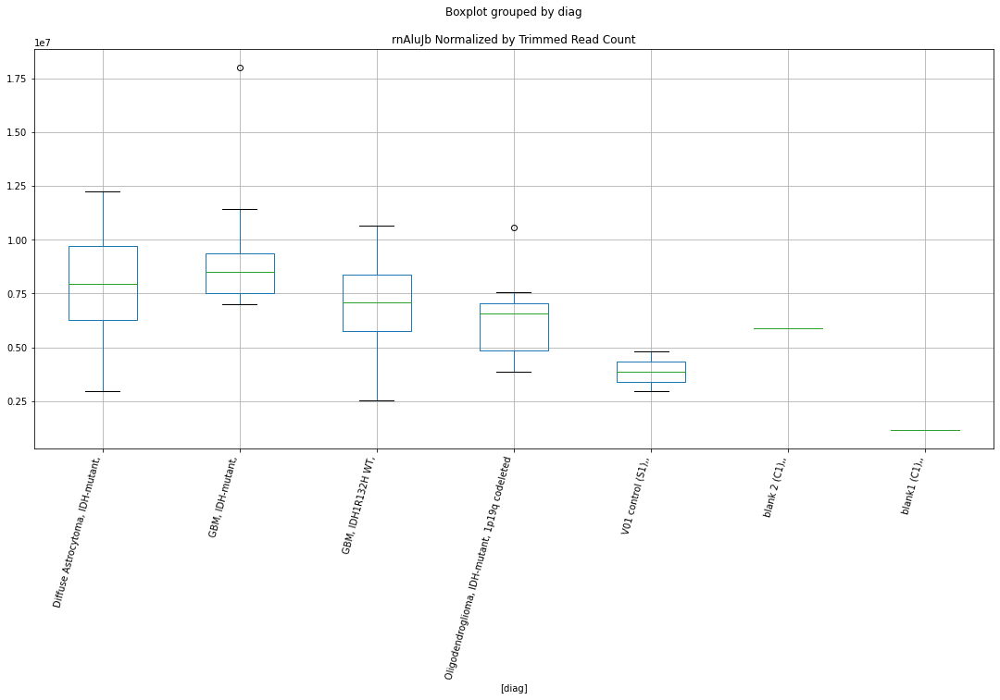

rnAluSx D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.802047032033012
	p = 0.08831056178240931
rnAluSx D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.802047032033012
	p = 0.08831056178240931


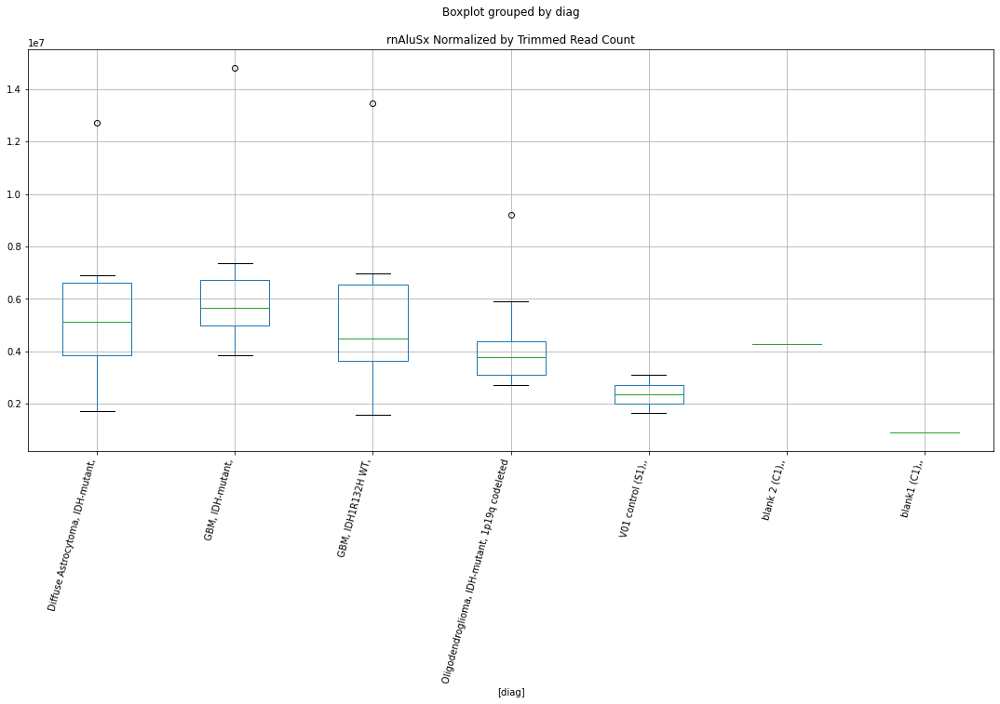

rnAluSx D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.875764909935902
	p = 0.07700222956725686
rnAluSx D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.875764909935902
	p = 0.07700222956725686


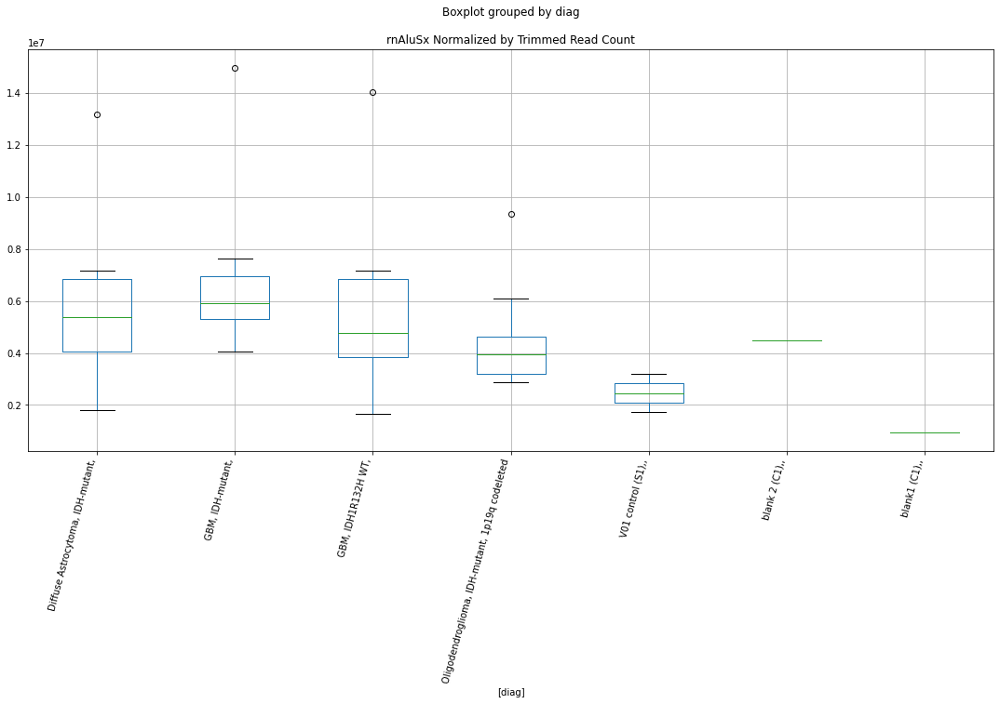

rnAluSx1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.146711892492394
	p = 0.045692798956714215
rnAluSx1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.146711892492394
	p = 0.045692798956714215


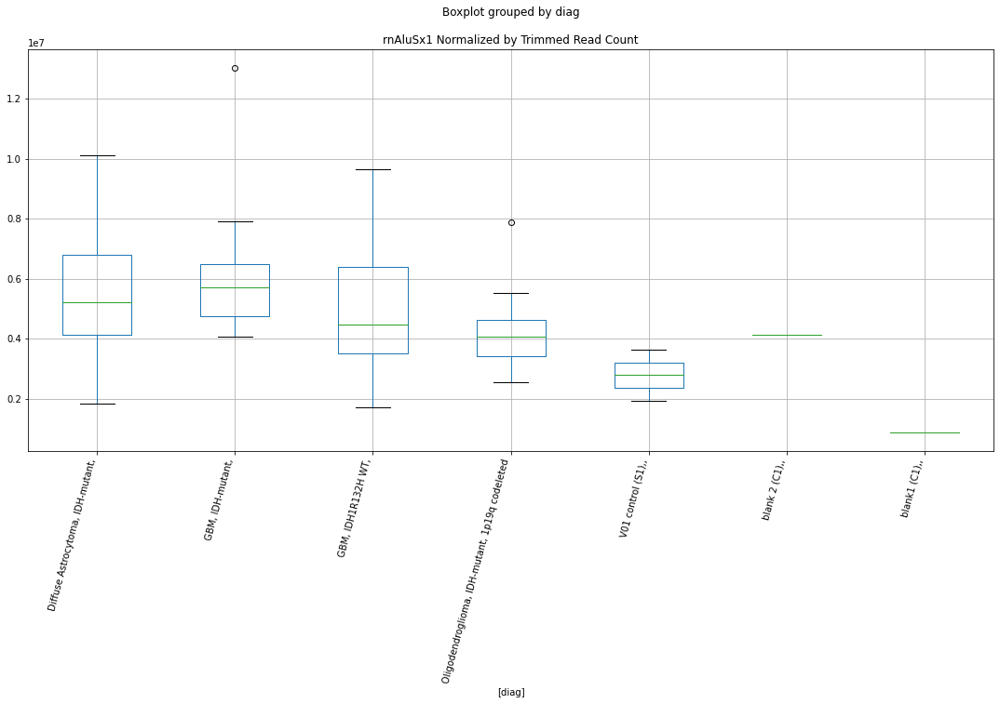

rnAluSx1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2211233739495064
	p = 0.039411252115598025
rnAluSx1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2211233739495064
	p = 0.039411252115598025


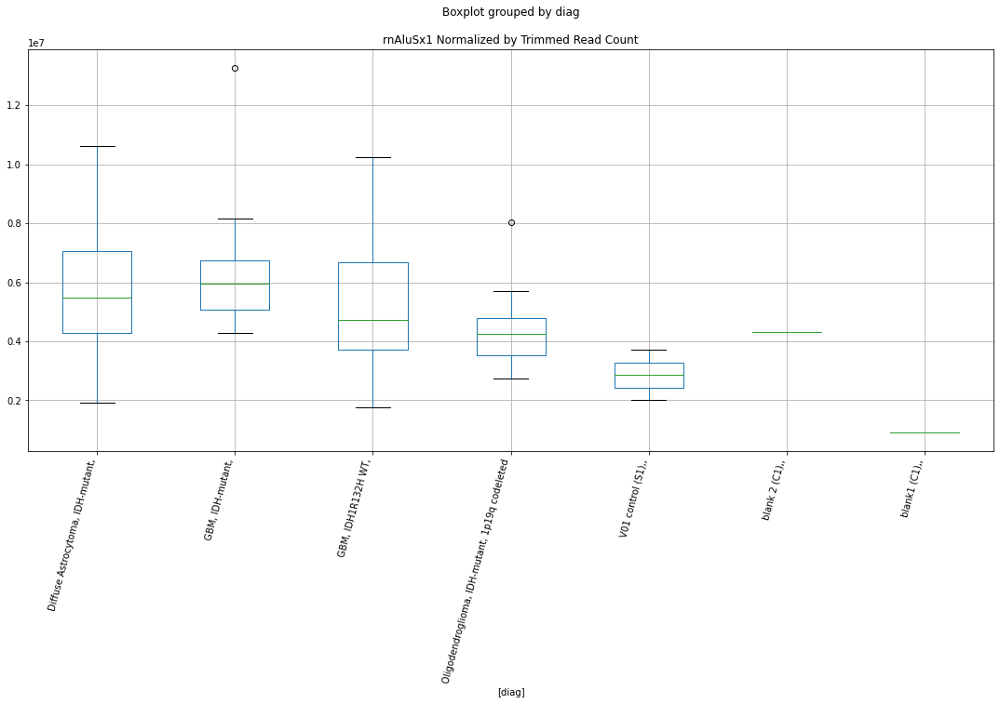

rnL1P4 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2260322352487103
	p = 0.03902615371647909
rnL1P4 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2260322352487103
	p = 0.03902615371647909


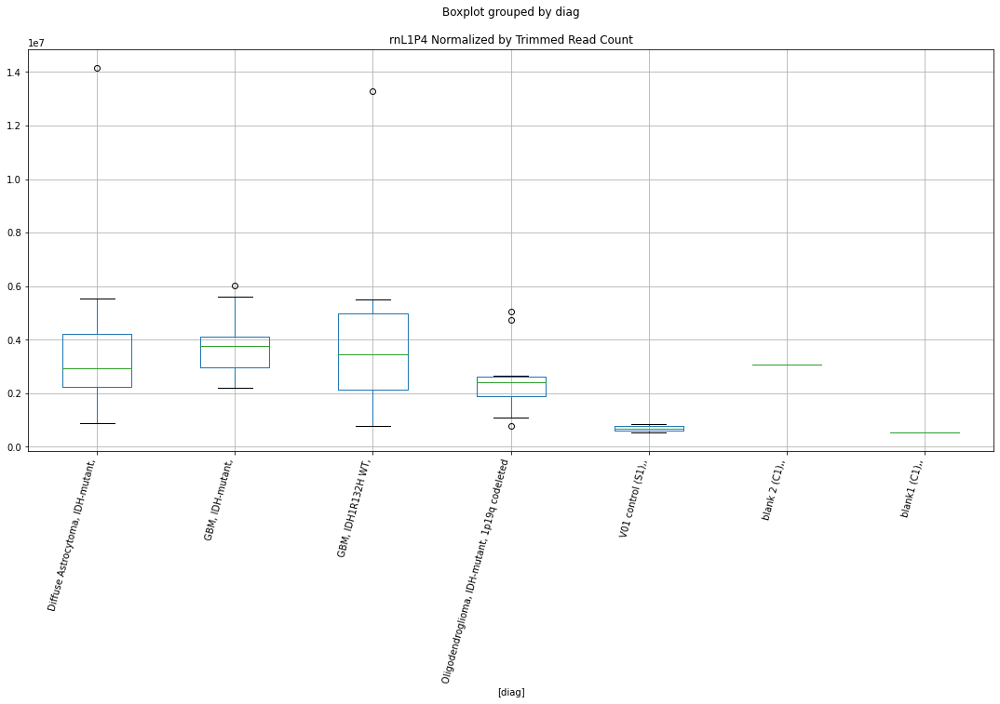

rnL1P4 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3120180765645997
	p = 0.03281936093734738
rnL1P4 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3120180765645997
	p = 0.03281936093734738


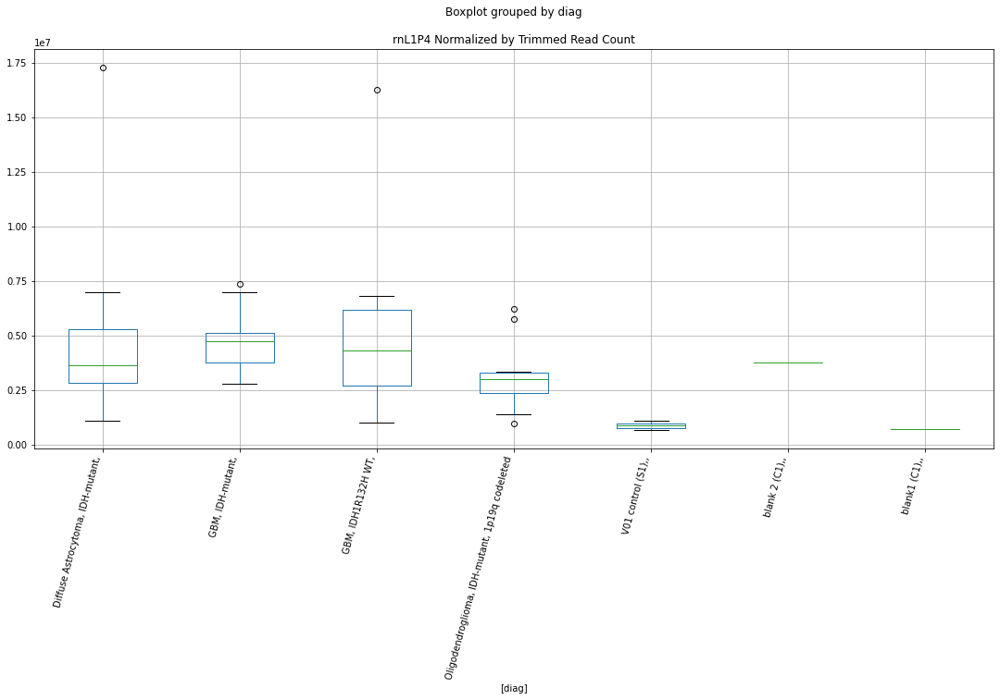

rnAluJr D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7476785226329044
	p = 0.09755699644104301
rnAluJr D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7476785226329044
	p = 0.09755699644104301


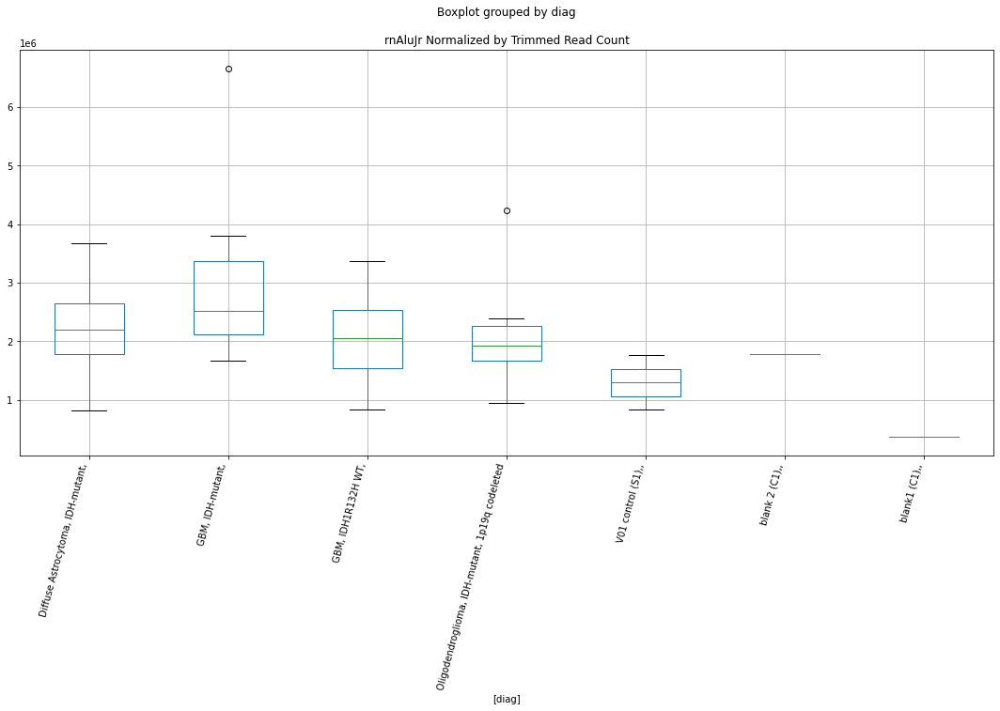

rnAluJr D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8064061737357382
	p = 0.08760346988151782
rnAluJr D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8064061737357382
	p = 0.08760346988151782


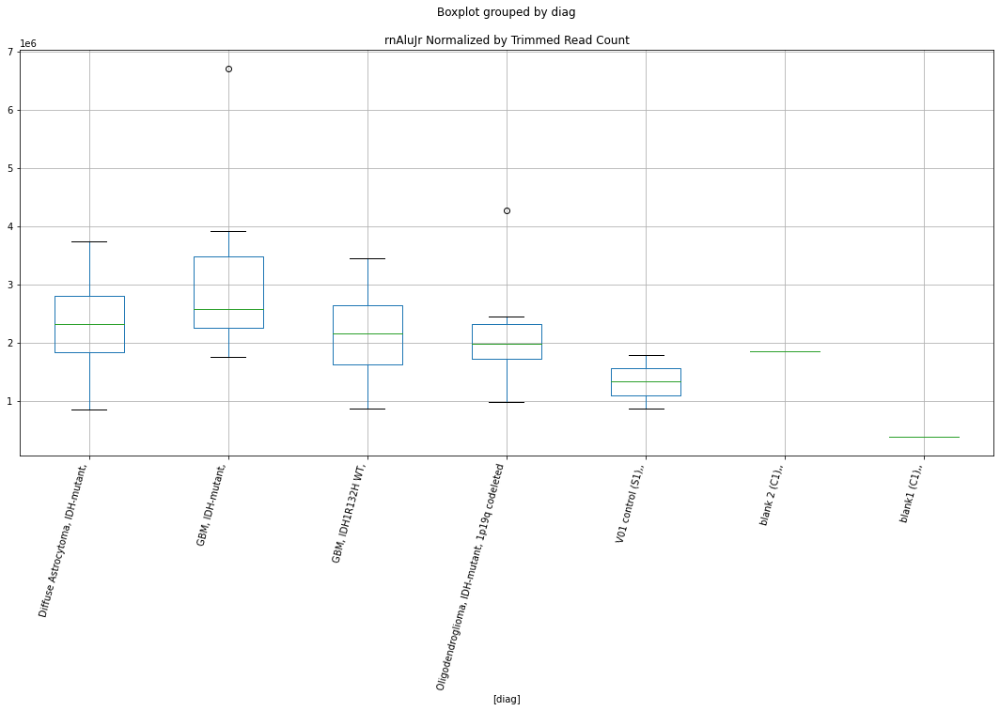

rnAluSq2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.463623487560755
	p = 0.024056201824640897
rnAluSq2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.463623487560755
	p = 0.024056201824640897


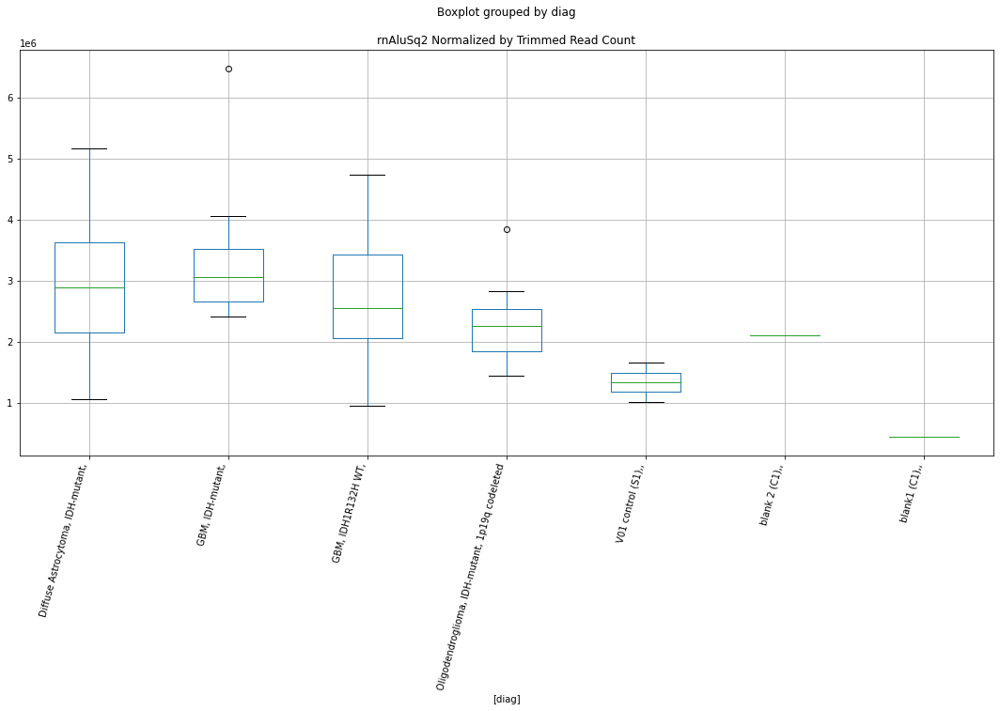

rnAluSq2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.533231222278283
	p = 0.020816265936212778
rnAluSq2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.533231222278283
	p = 0.020816265936212778


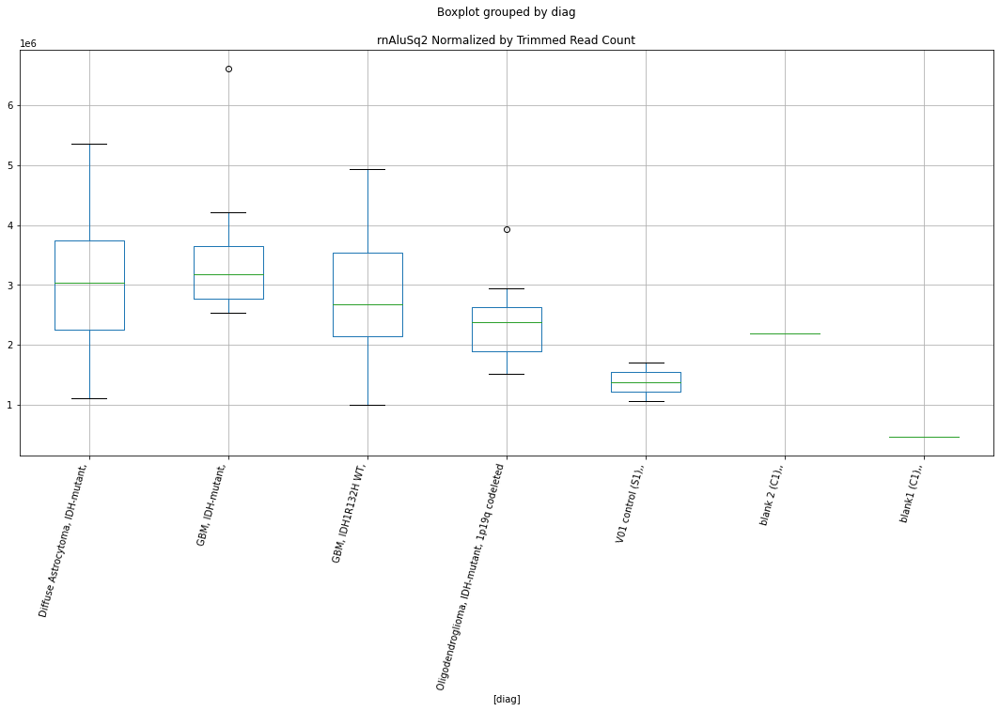

rnAluJo D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7842668265689234
	p = 0.09124658252561091
rnAluJo D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7842668265689234
	p = 0.09124658252561091


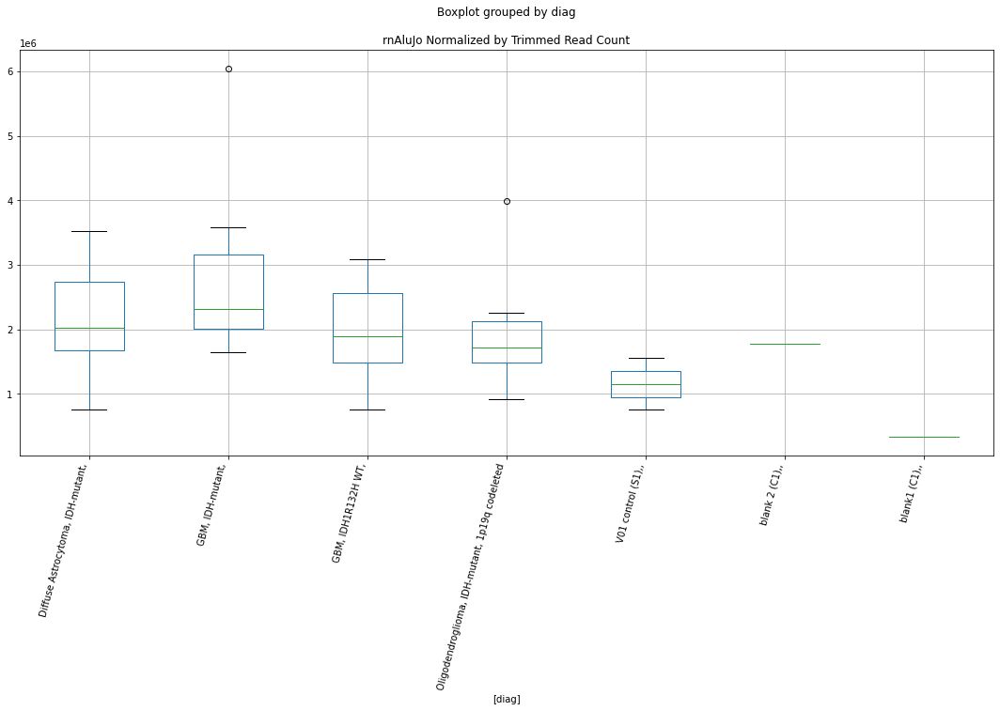

rnAluJo D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8501980508932454
	p = 0.08077068678733026
rnAluJo D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8501980508932454
	p = 0.08077068678733026


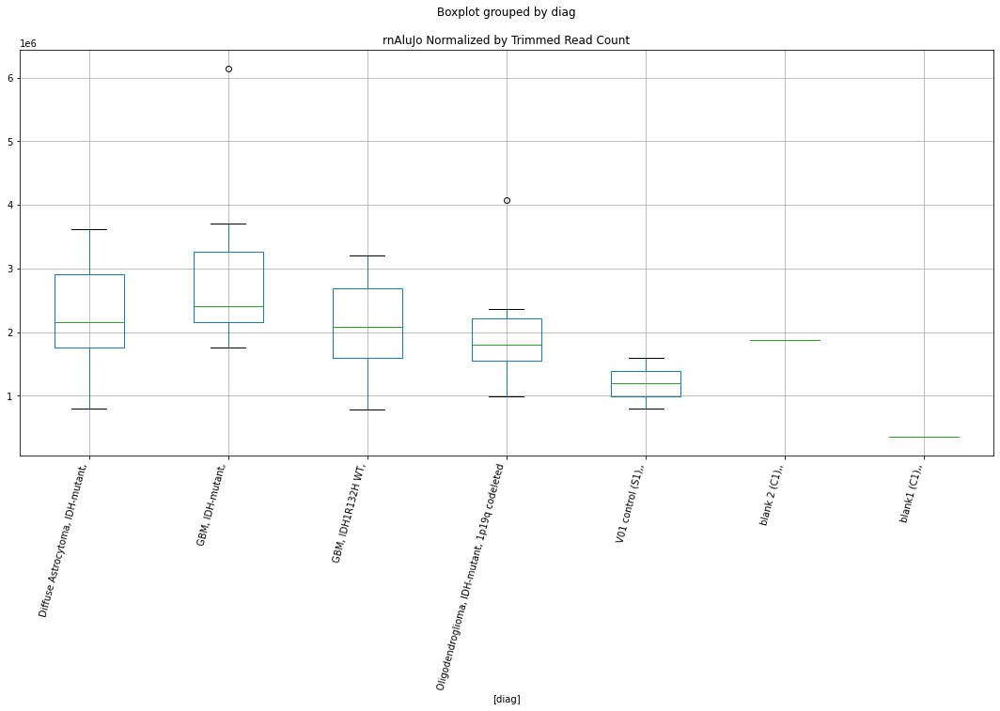

rnAluSp D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.106779174352912
	p = 0.04942916556439325
rnAluSp D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1899329662605775
	p = 0.041940910530434035
rnAluSp D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.106779174352912
	p = 0.04942916556439325
rnAluSp D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1899329662605775
	p = 0.041940910530434035


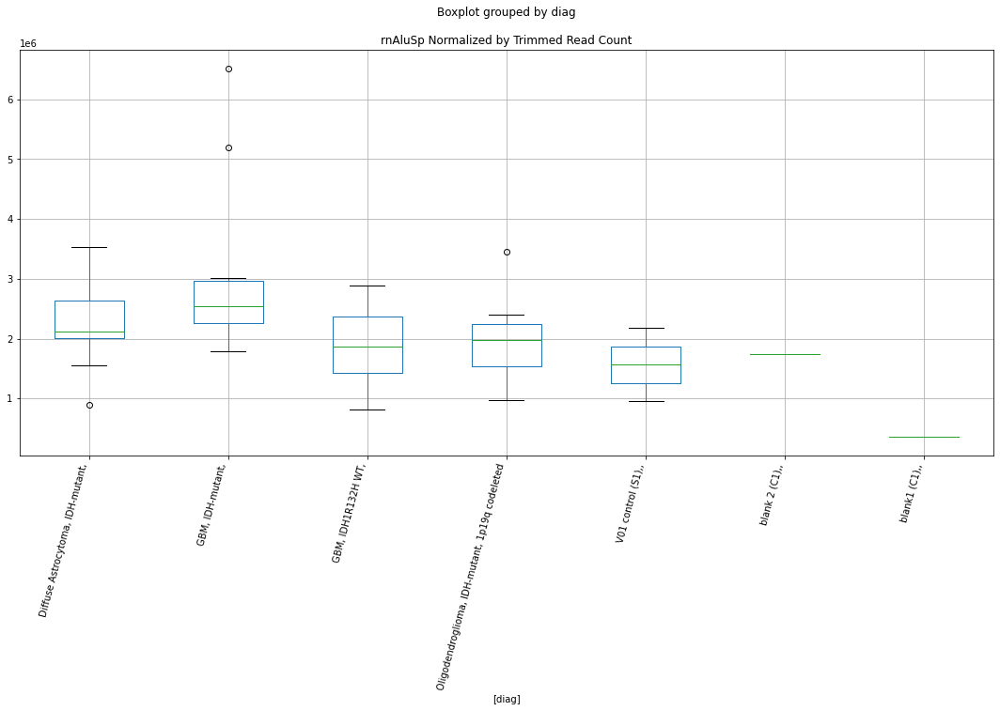

rnAluSp D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1293362824719457
	p = 0.04728572505091431
rnAluSp D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1877376556591566
	p = 0.042124456216870755
rnAluSp D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1293362824719457
	p = 0.04728572505091431
rnAluSp D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1877376556591566
	p = 0.042124456216870755


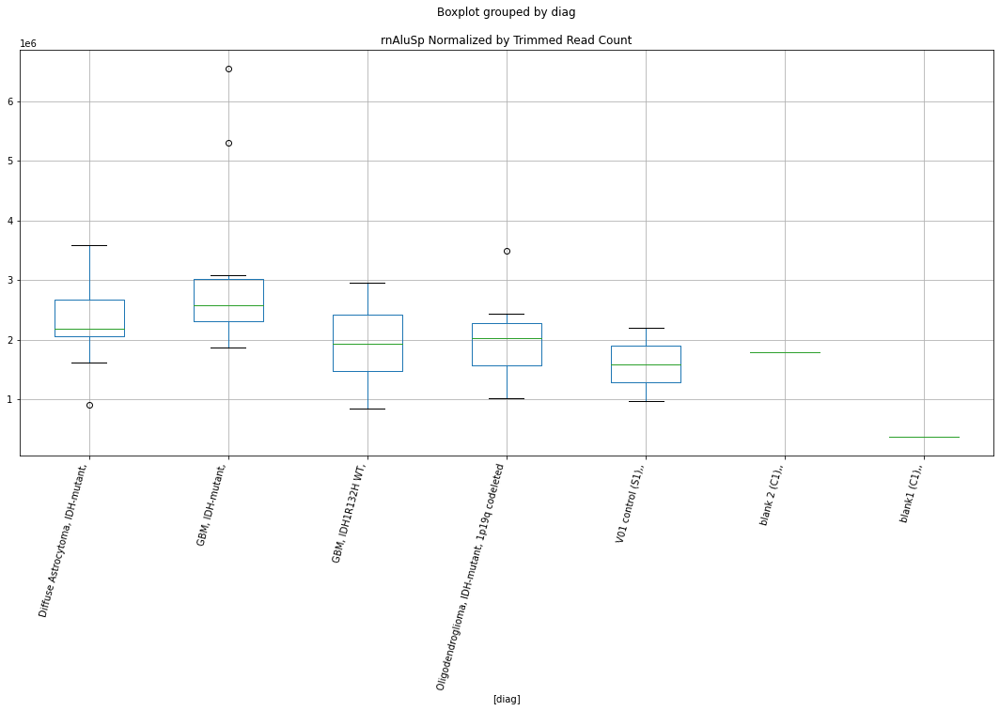

rn(A)n D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.9449188163035527
	p = 0.0009494659664170781
rn(A)n D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.32121600160267
	p = 0.032212600842089316
rn(A)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.9449188163035527
	p = 0.0009494659664170781
rn(A)n D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.32121600160267
	p = 0.032212600842089316


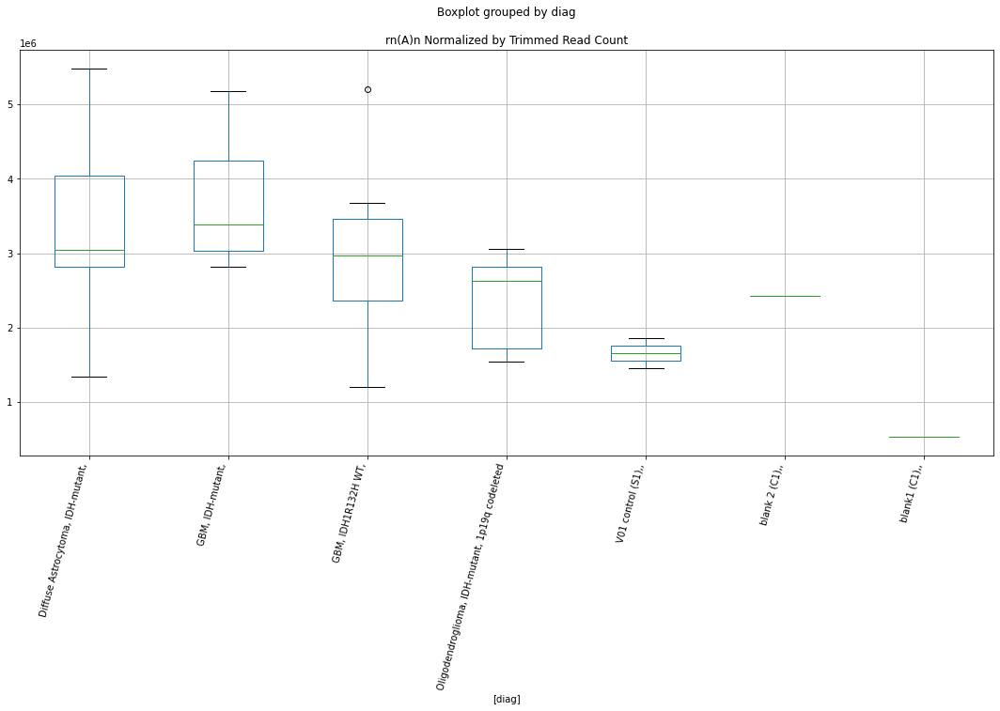

rn(A)n D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 4.07137366617791
	p = 0.0007164352647209832
rn(A)n D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3235173124314157
	p = 0.0320624280757151
rn(A)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -4.07137366617791
	p = 0.0007164352647209832
rn(A)n D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.3235173124314157
	p = 0.0320624280757151


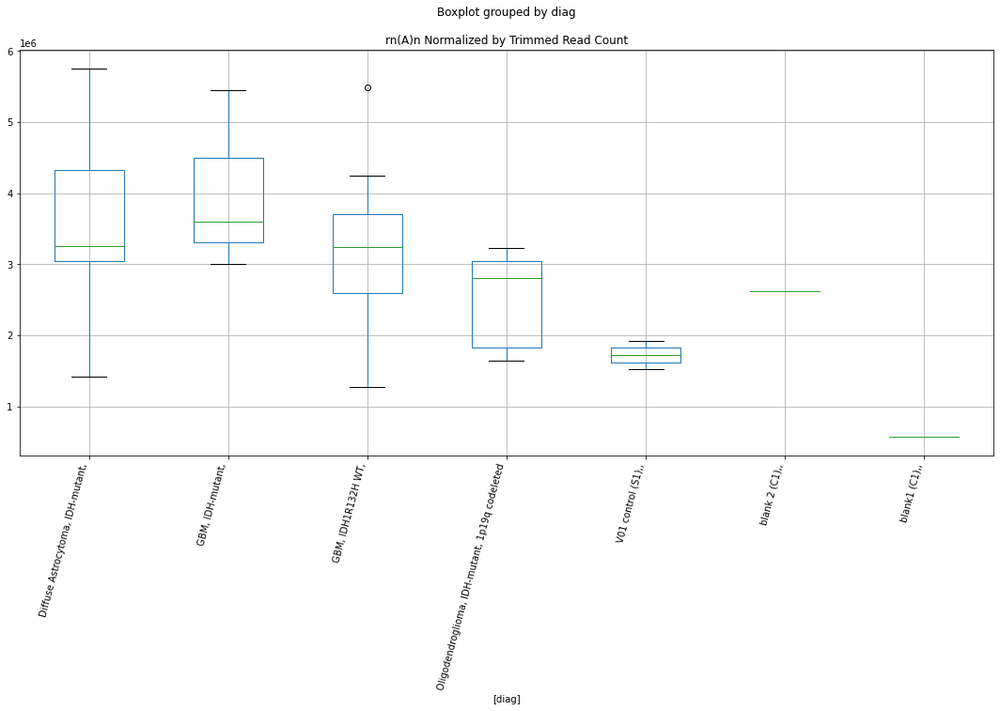

rnL1PA7 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7416367057847804
	p = 0.0986346604086322
rnL1PA7 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7416367057847804
	p = 0.0986346604086322


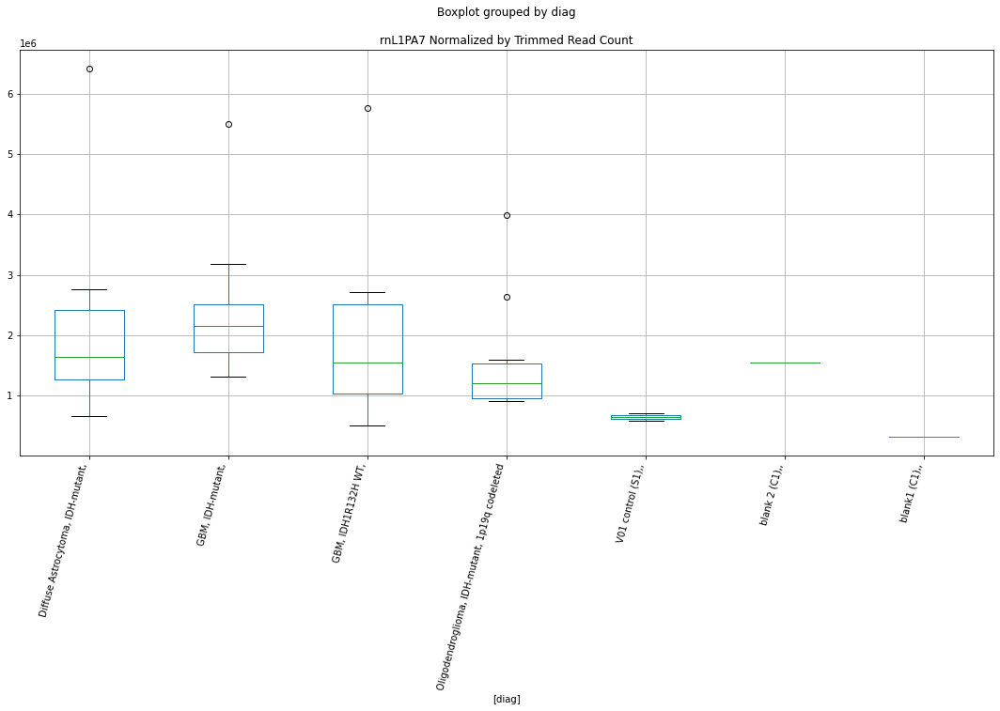

rnL1PA7 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7803116157890937
	p = 0.0919111588081714
rnL1PA7 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7803116157890937
	p = 0.0919111588081714


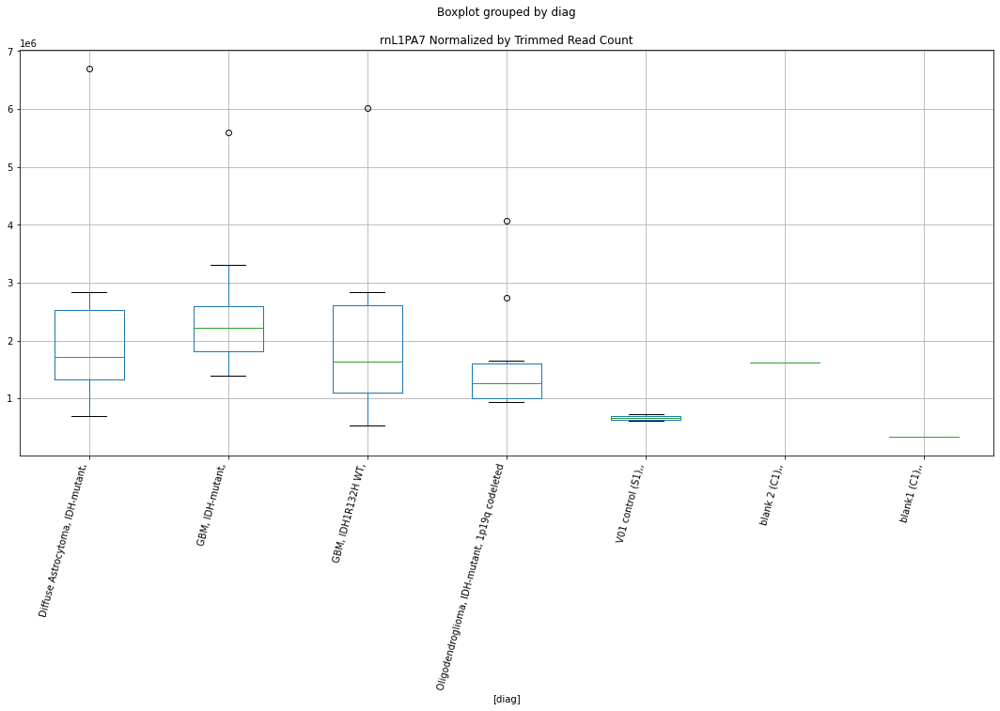

rnAluSg D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.244631633838339
	p = 0.004498291352083774
rnAluSg D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.854249405869772
	p = 0.08016290272146949
rnAluSg D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.244631633838339
	p = 0.004498291352083774
rnAluSg D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.854249405869772
	p = 0.08016290272146949


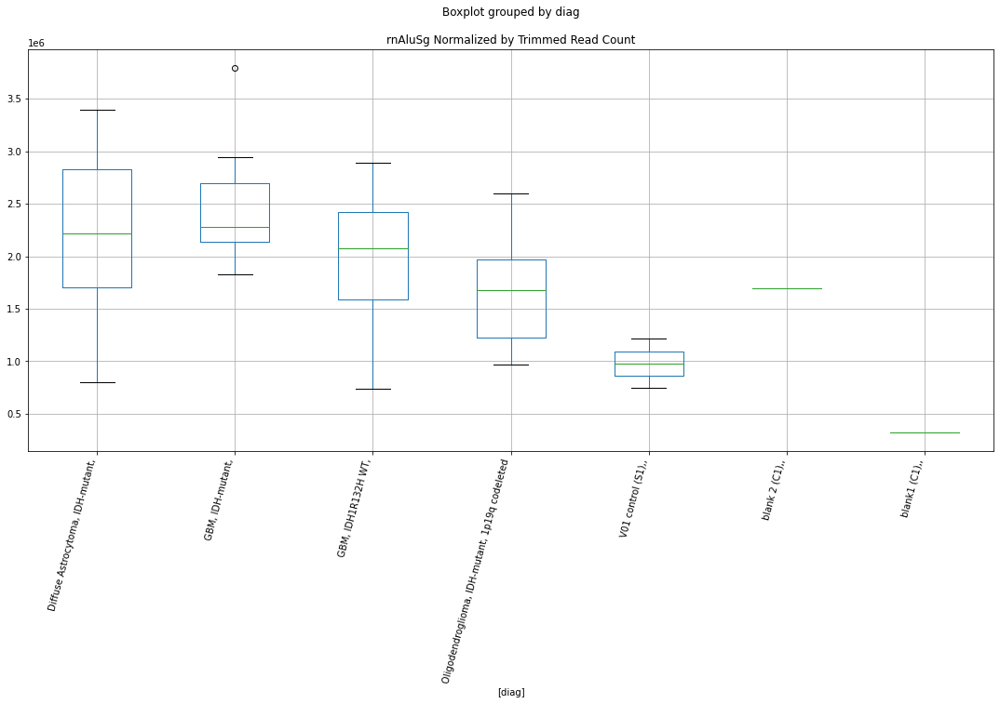

rnAluSg D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.4078482149007927
	p = 0.003136509708378316
rnAluSg D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8737601688847134
	p = 0.0772920083559366
rnAluSg D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.4078482149007927
	p = 0.003136509708378316
rnAluSg D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8737601688847134
	p = 0.0772920083559366


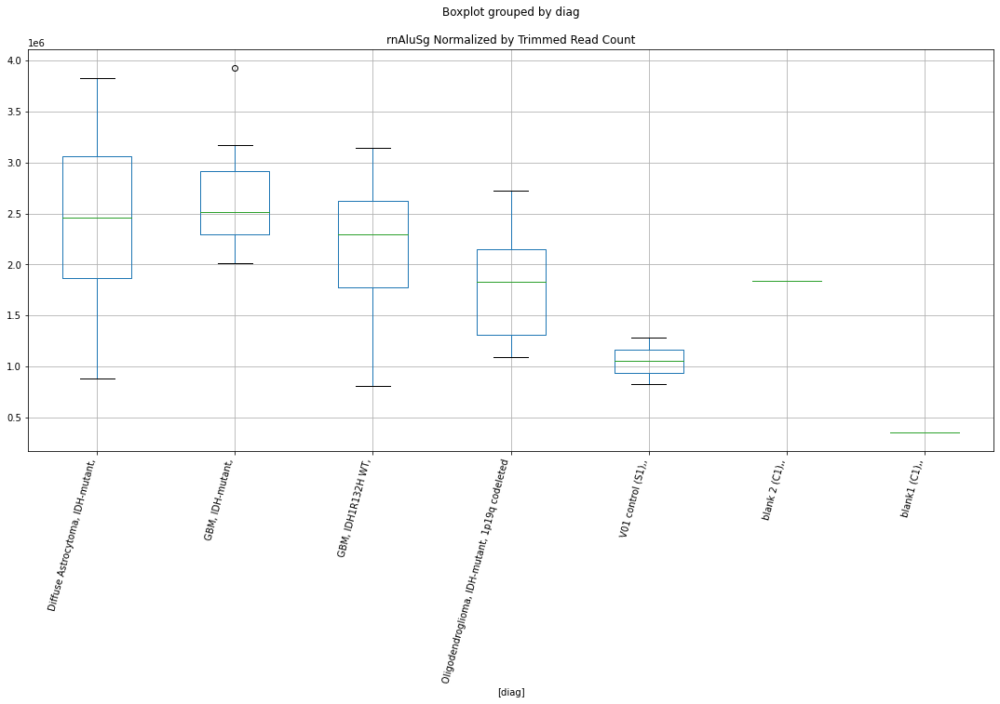

rnAluSx3 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.9290561397904775
	p = 0.008964194861194359
rnAluSx3 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0304091878812915
	p = 0.057357308515019835
rnAluSx3 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7836582490501378
	p = 0.09134856560185252
rnAluSx3 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.9290561397904775
	p = 0.008964194861194359
rnAluSx3 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7836582490501378
	p = 0.09134856560185252
rnAluSx3 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0304091878812915
	p = 0.057357308515019835


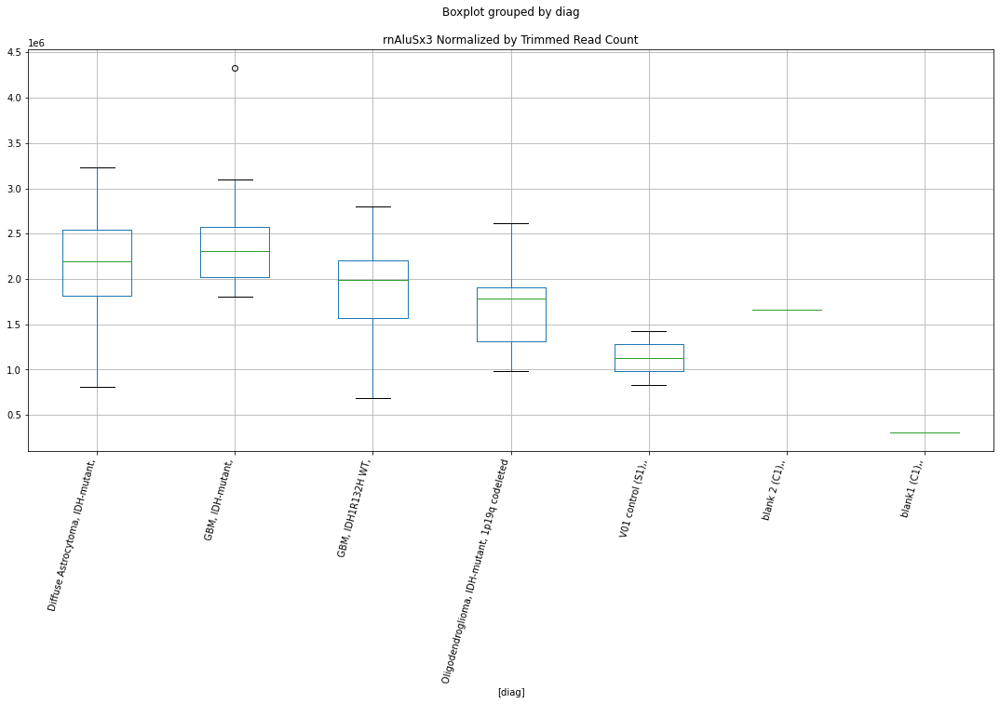

rnAluSx3 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.12037683395691
	p = 0.005909796769333456
rnAluSx3 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0183461110019105
	p = 0.05870966735873515
rnAluSx3 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8587242689918833
	p = 0.07949627065283463
rnAluSx3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.12037683395691
	p = 0.005909796769333456
rnAluSx3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8587242689918833
	p = 0.07949627065283463
rnAluSx3 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0183461110019105
	p = 0.05870966735873515


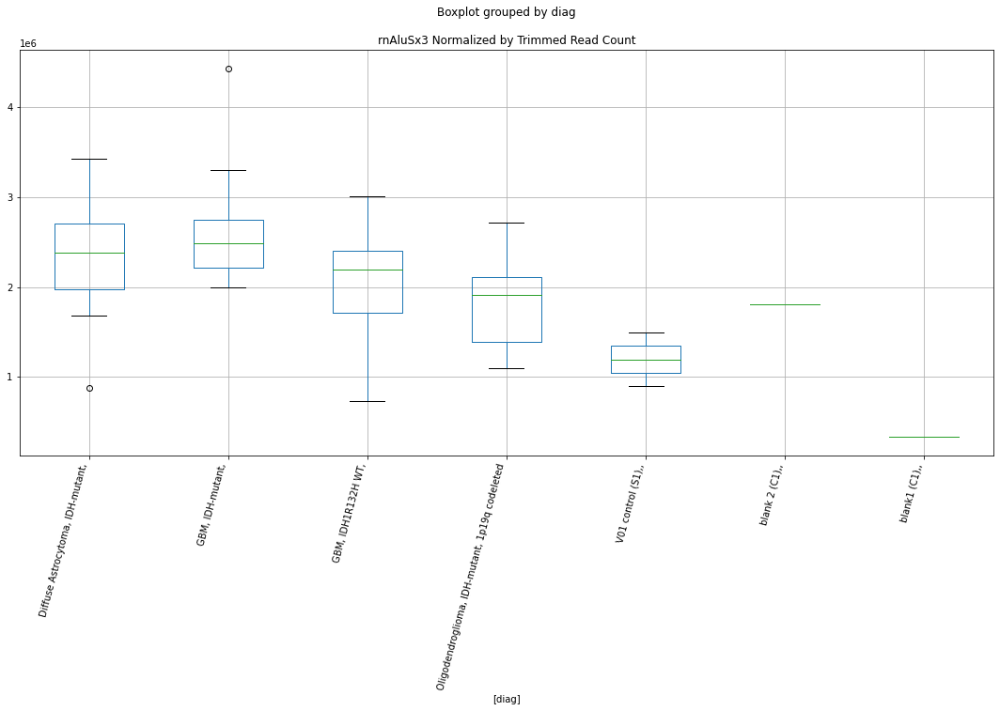

rnAluSz6 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0424272645327037
	p = 0.056037988428082545
rnAluSz6 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.854333742243756
	p = 0.08015029350714858
rnAluSz6 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0424272645327037
	p = 0.056037988428082545
rnAluSz6 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.854333742243756
	p = 0.08015029350714858


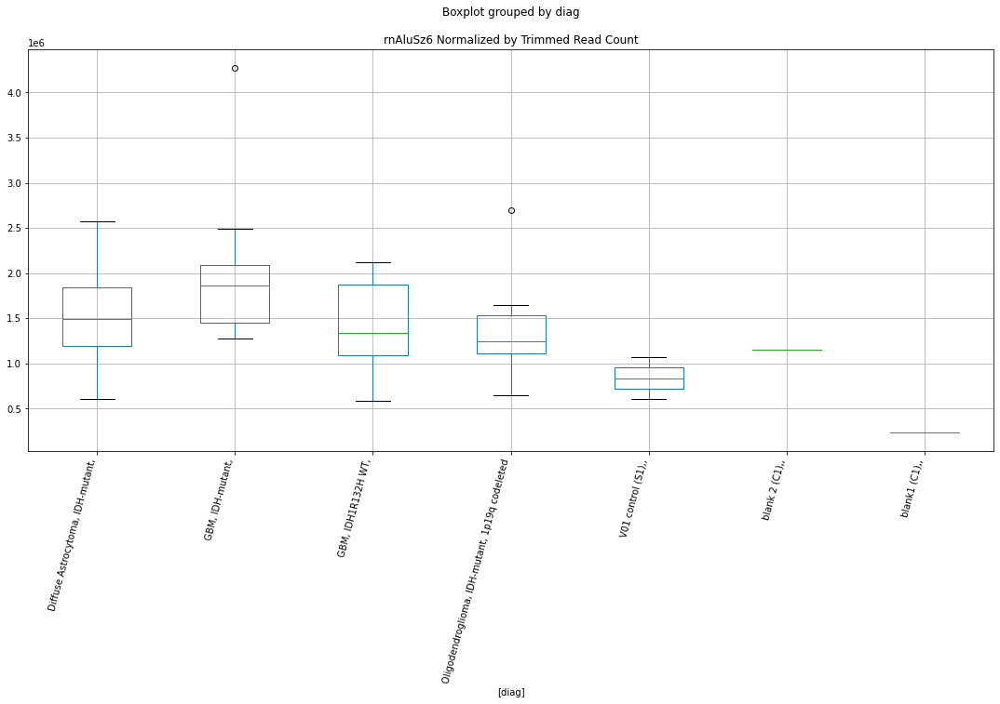

rnAluSz6 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0748917012013197
	p = 0.052610051344409124
rnAluSz6 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8630494463266694
	p = 0.07885658749328403
rnAluSz6 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0748917012013197
	p = 0.052610051344409124
rnAluSz6 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8630494463266694
	p = 0.07885658749328403


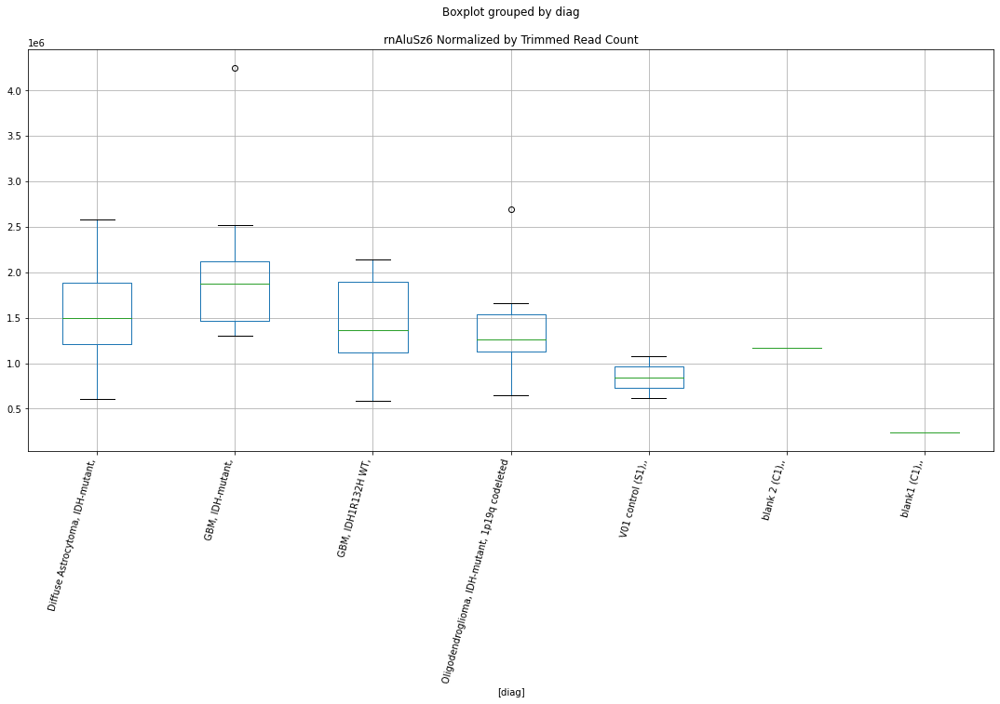

rnAluSc D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.564390145443237
	p = 0.019503560696031343
rnAluSc D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.564390145443237
	p = 0.019503560696031343


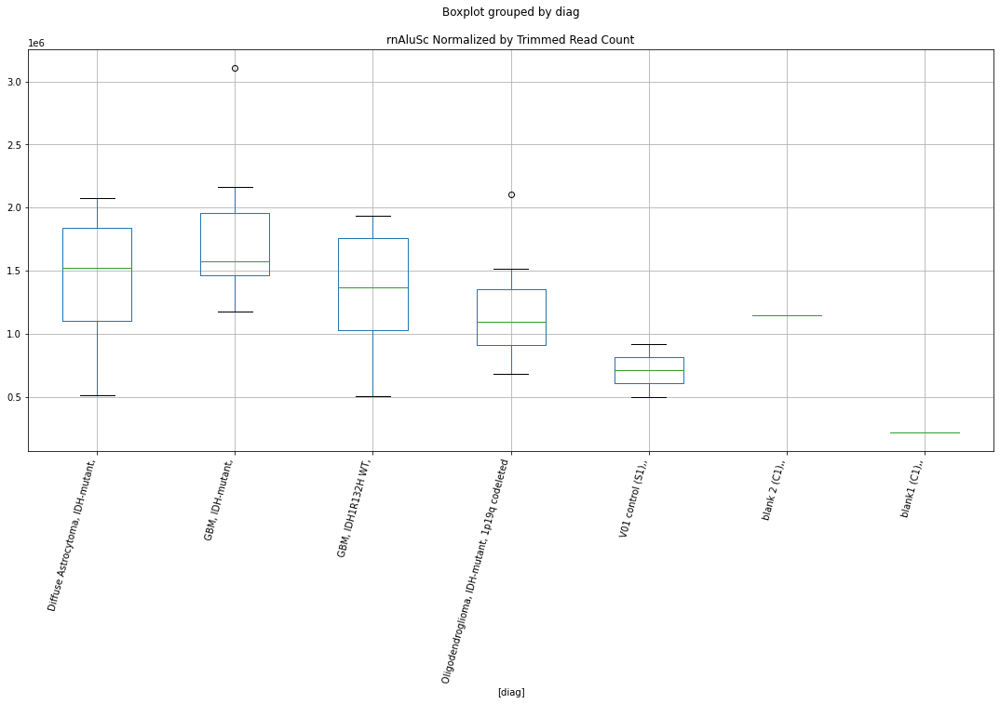

rnAluSc D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.677310534778679
	p = 0.01537415270937986
rnAluSc D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.677310534778679
	p = 0.01537415270937986


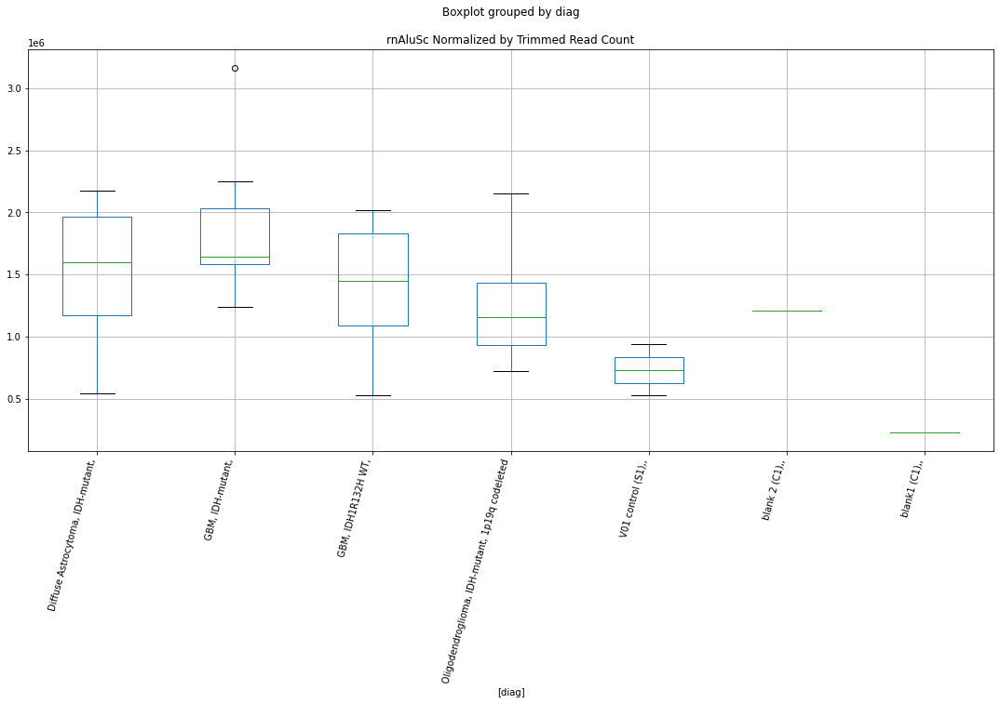

rnALR/Alpha D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7823290596451364
	p = 0.09157165159760641
rnALR/Alpha D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7823290596451364
	p = 0.09157165159760641


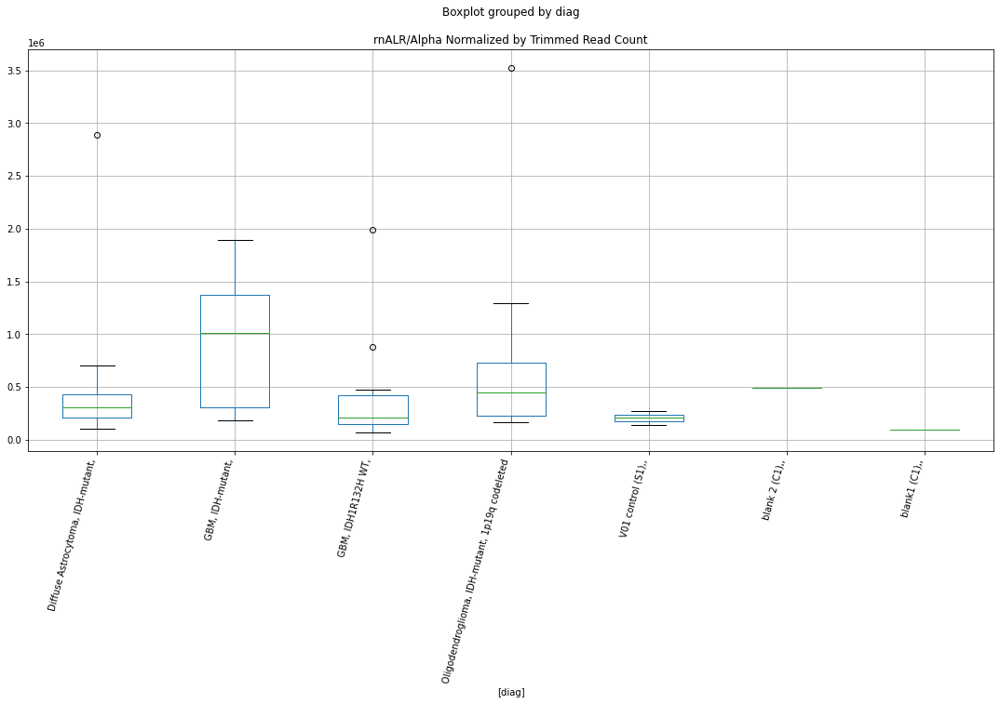

rnALR/Alpha D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7801219270057231
	p = 0.09194313708103738
rnALR/Alpha D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7801219270057231
	p = 0.09194313708103738


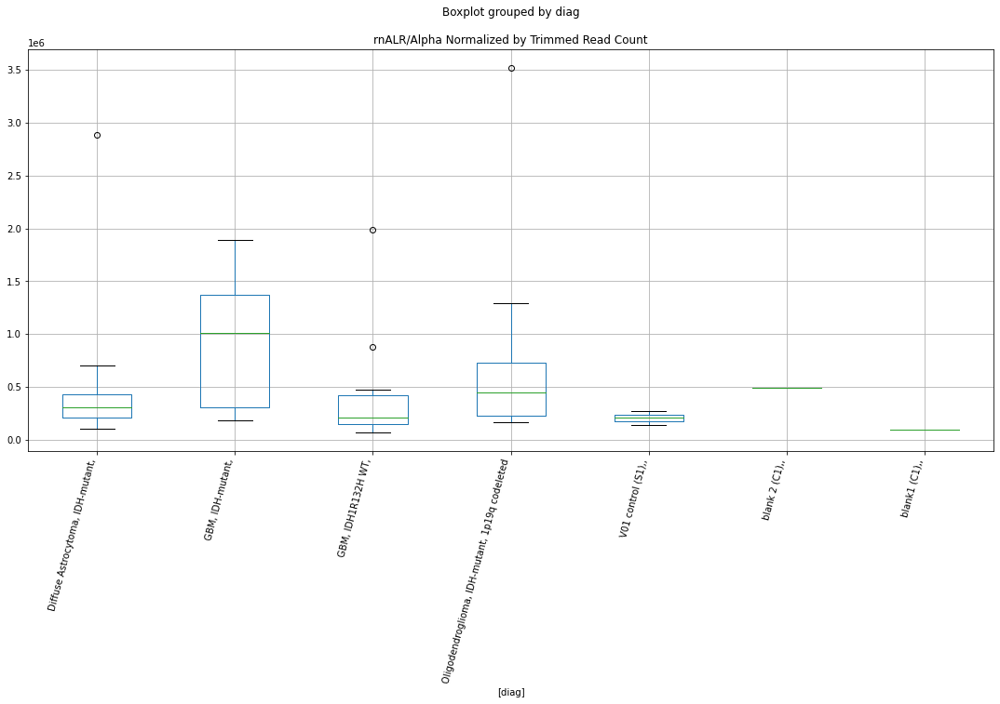

rnMER61-int D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.092140348858823
	p = 0.006286450610359294
rnMER61-int D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8659800839235208
	p = 0.07842573809585147
rnMER61-int D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.092140348858823
	p = 0.006286450610359294
rnMER61-int D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8659800839235208
	p = 0.07842573809585147


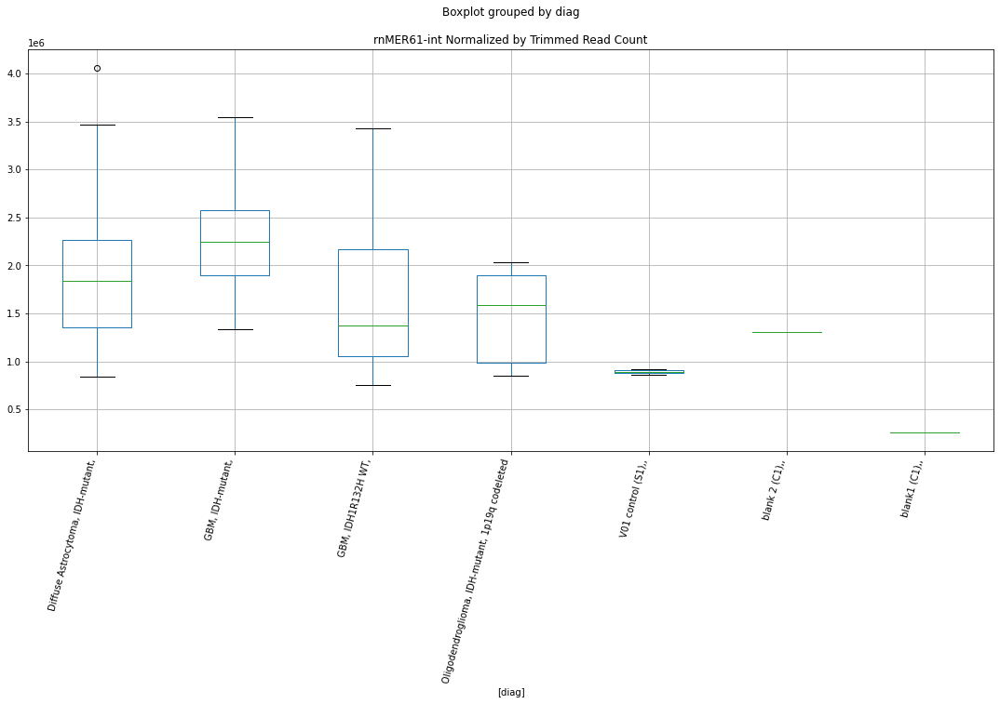

rnMER61-int D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.082779457264846
	p = 0.006416408962129683
rnMER61-int D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7934316013104488
	p = 0.08972274819438676
rnMER61-int D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.082779457264846
	p = 0.006416408962129683
rnMER61-int D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7934316013104488
	p = 0.08972274819438676


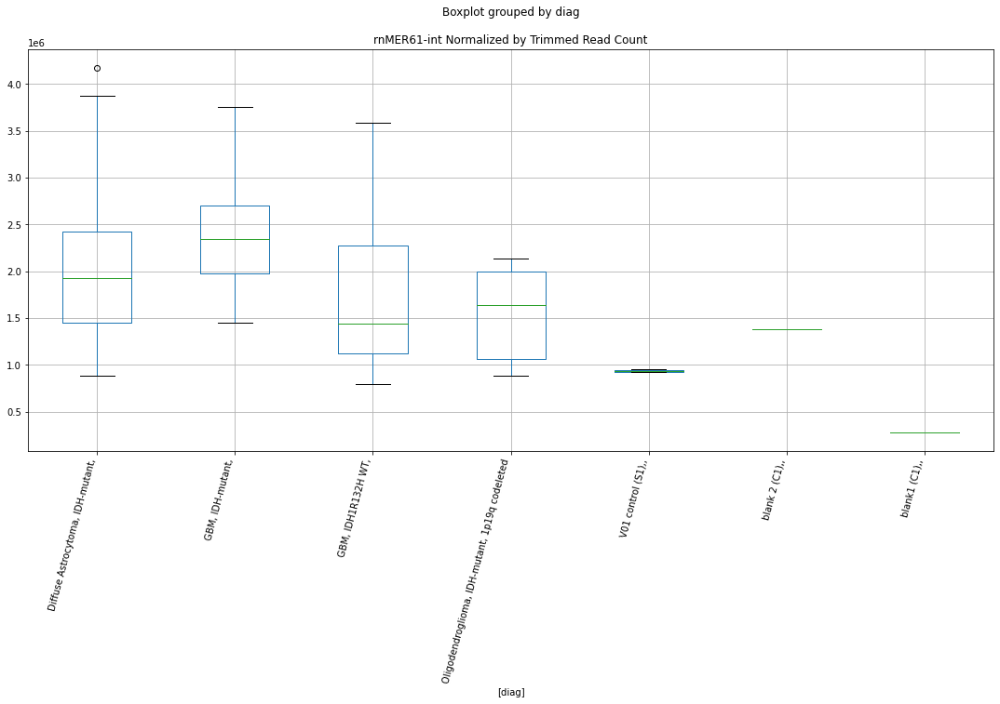

rnMER61-int D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.208260794799866
	p = 0.04043696083557337
rnMER61-int D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.208260794799866
	p = 0.04043696083557337


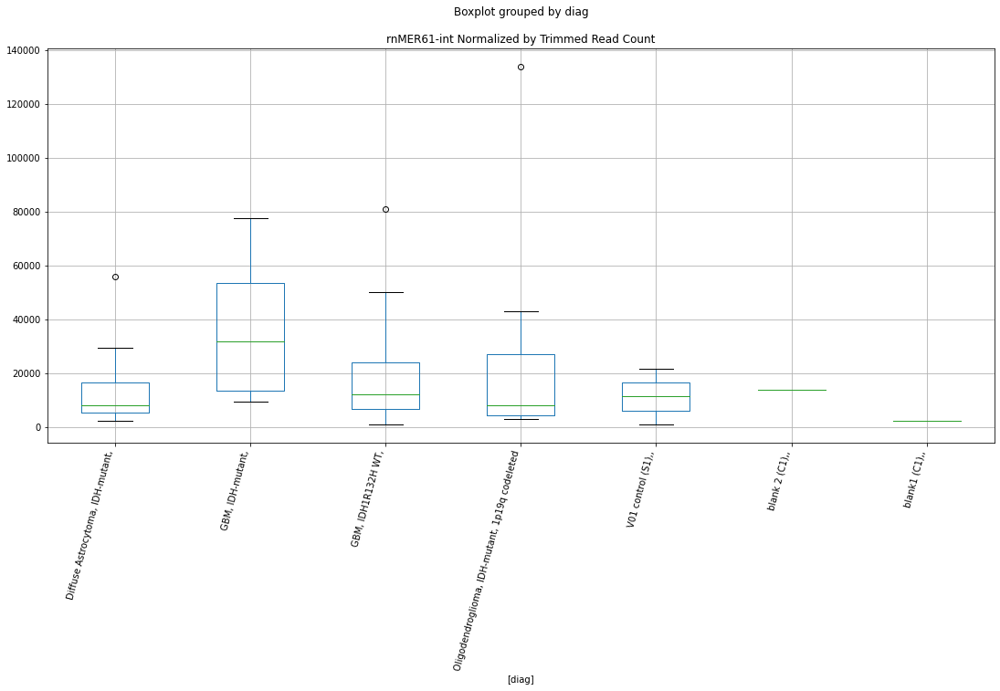

rnMER61-int D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2081123455621645
	p = 0.04044894068510764
rnMER61-int D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.2081123455621645
	p = 0.04044894068510764


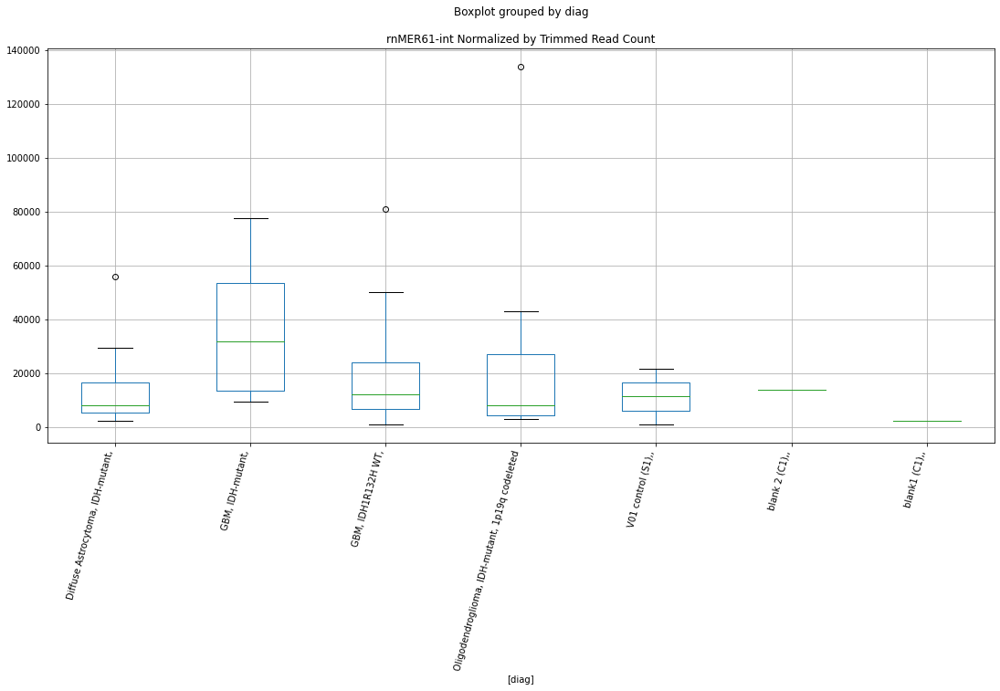

rnMER61-int D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.208095253160301
	p = 0.04045032025088606
rnMER61-int D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.208095253160301
	p = 0.04045032025088606


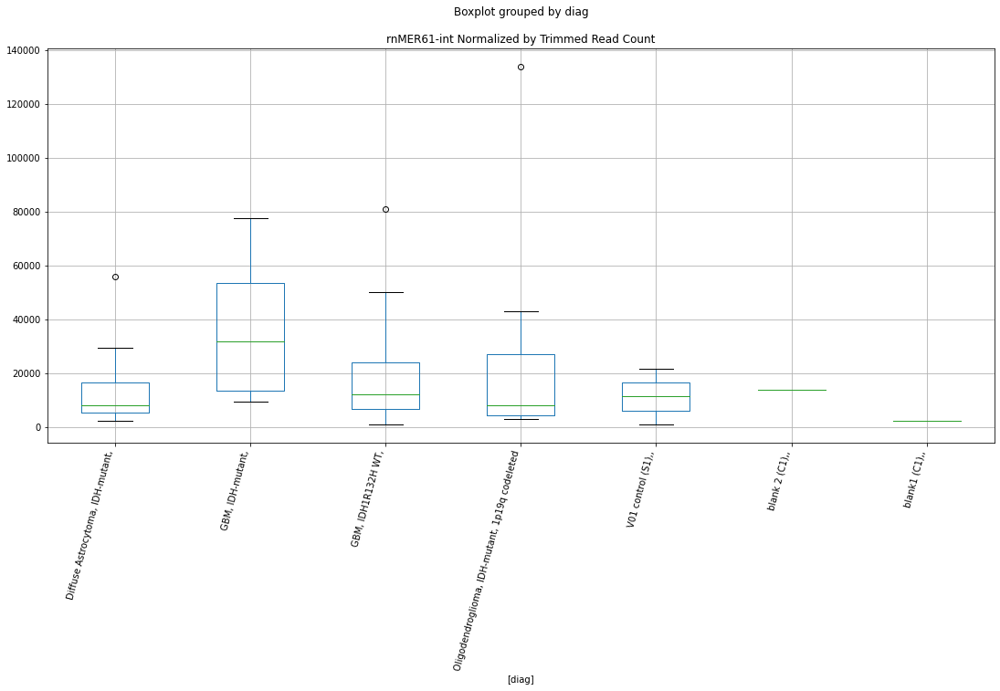

rnAluSc8 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.398344758172576
	p = 0.02752019542445687
rnAluSc8 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.398344758172576
	p = 0.02752019542445687


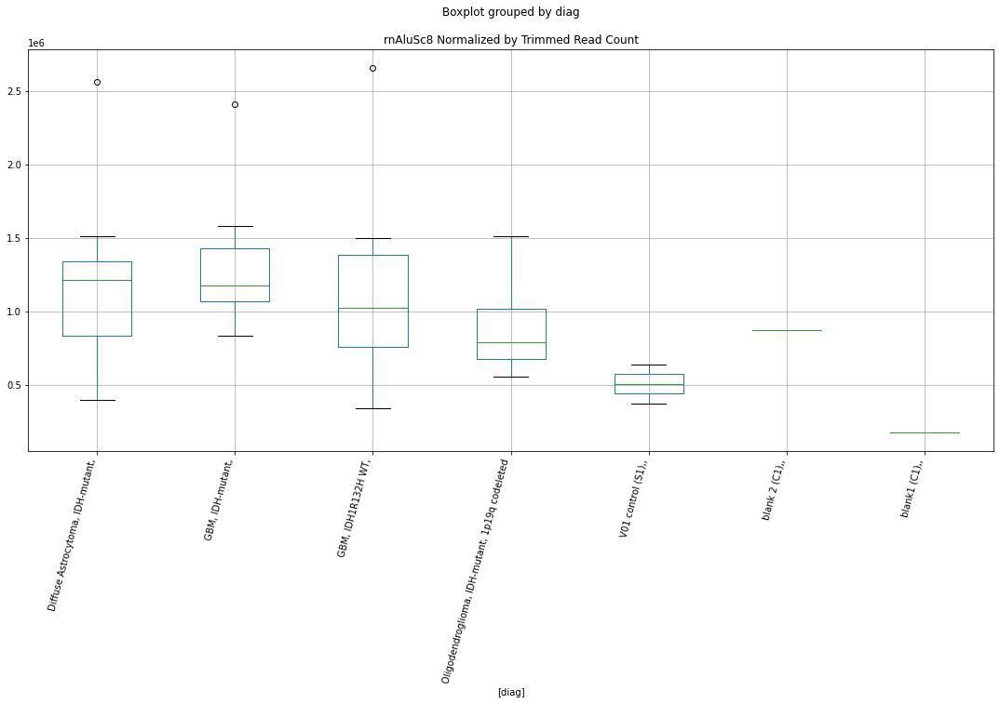

rnAluSc8 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.539316697746035
	p = 0.020553499132868882
rnAluSc8 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.539316697746035
	p = 0.020553499132868882


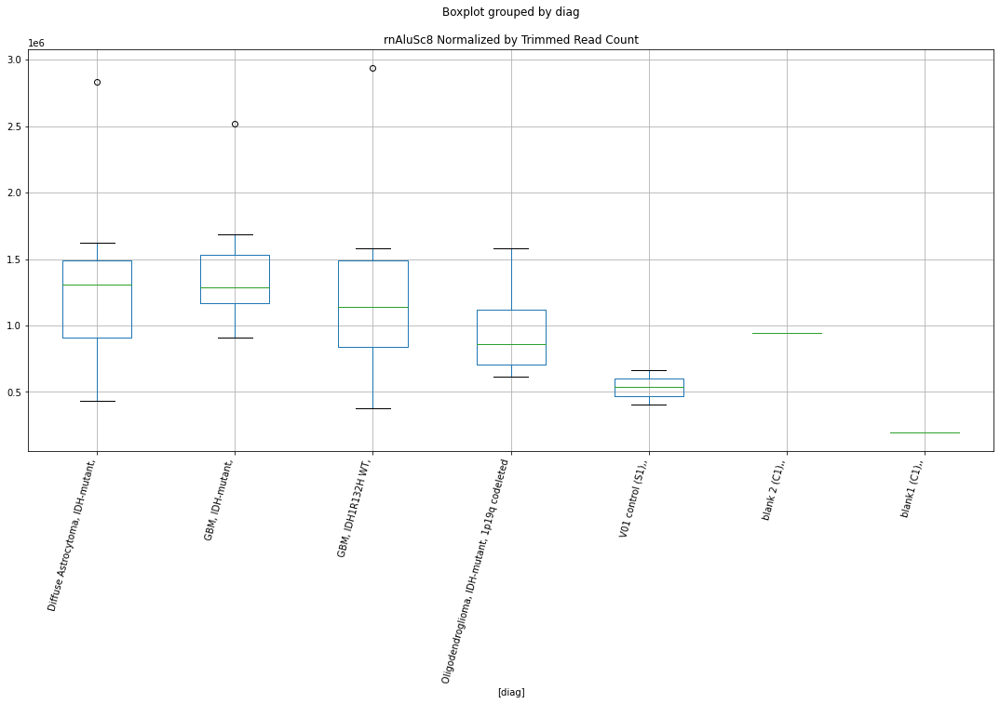

rnAluJr4 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2579603039046234
	p = 0.036604826569536765
rnAluJr4 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2579603039046234
	p = 0.036604826569536765


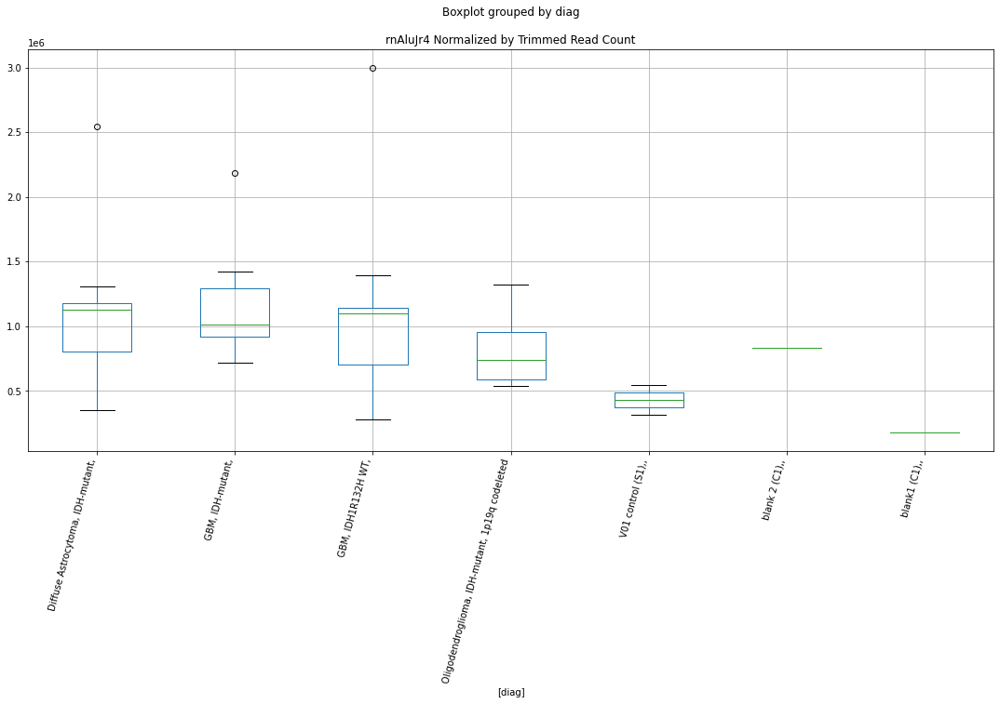

rnAluJr4 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.535004273501627
	p = 0.020739380925539425
rnAluJr4 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.535004273501627
	p = 0.020739380925539425


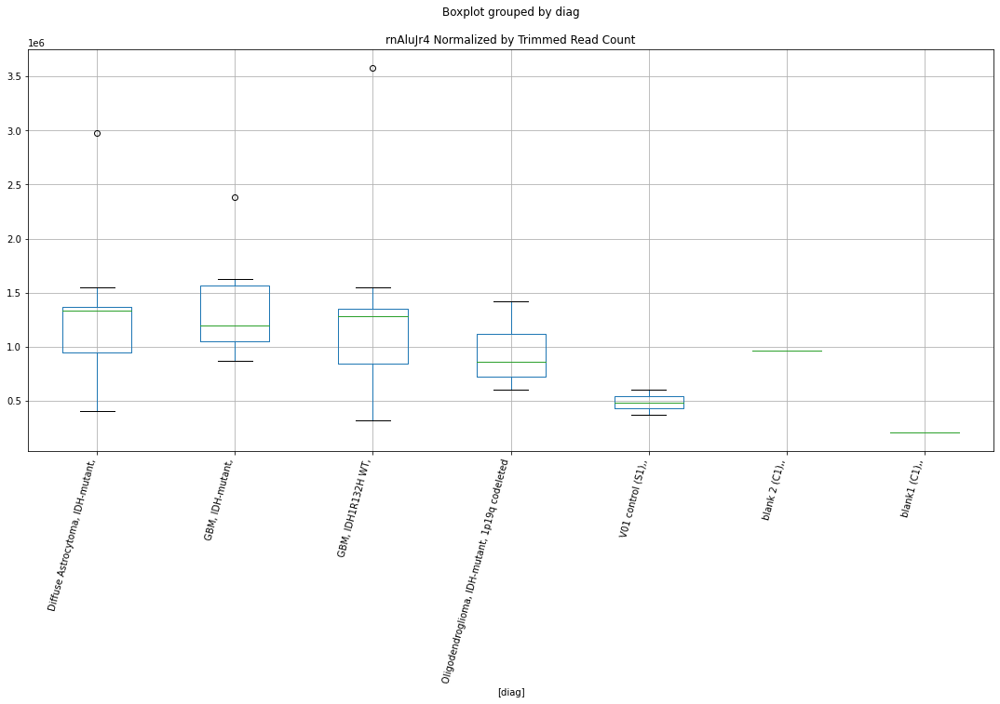

rnL1M5 D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.75687136839581
	p = 0.09593687238388633
rnL1M5 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.75687136839581
	p = 0.09593687238388633


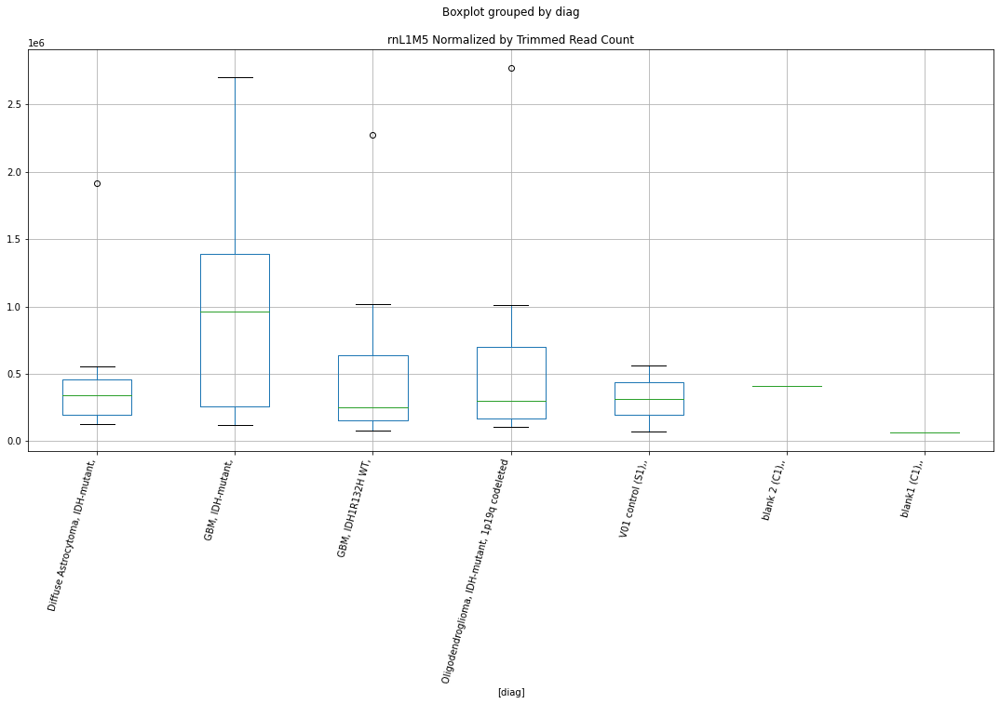

rnL1M5 D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7568523530836773
	p = 0.09594019934976306
rnL1M5 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7568523530836773
	p = 0.09594019934976306


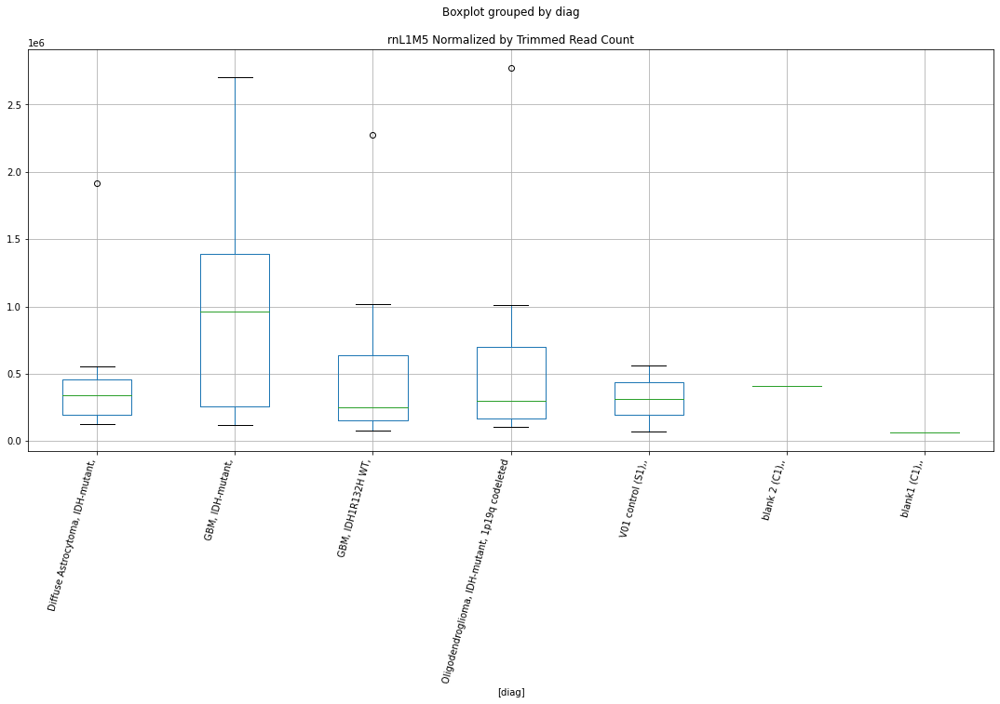

rnL1M5 D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7570010253597215
	p = 0.09591418995125243
rnL1M5 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7570010253597215
	p = 0.09591418995125243


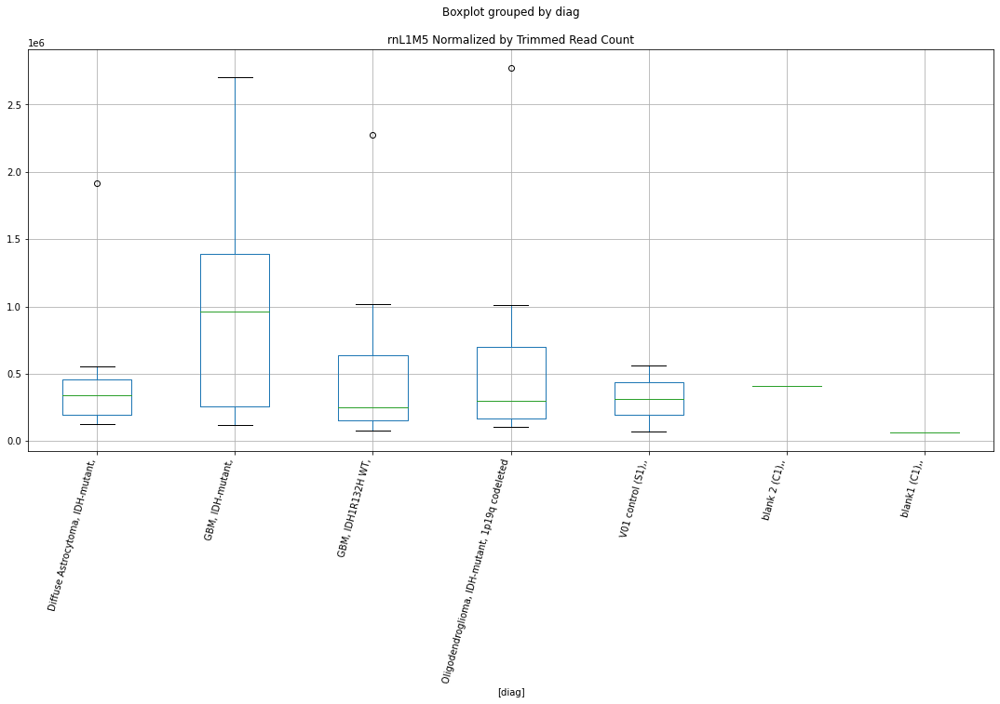

rnL1M4 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8079565762324723
	p = 0.08735317730893769
rnL1M4 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8079565762324723
	p = 0.08735317730893769


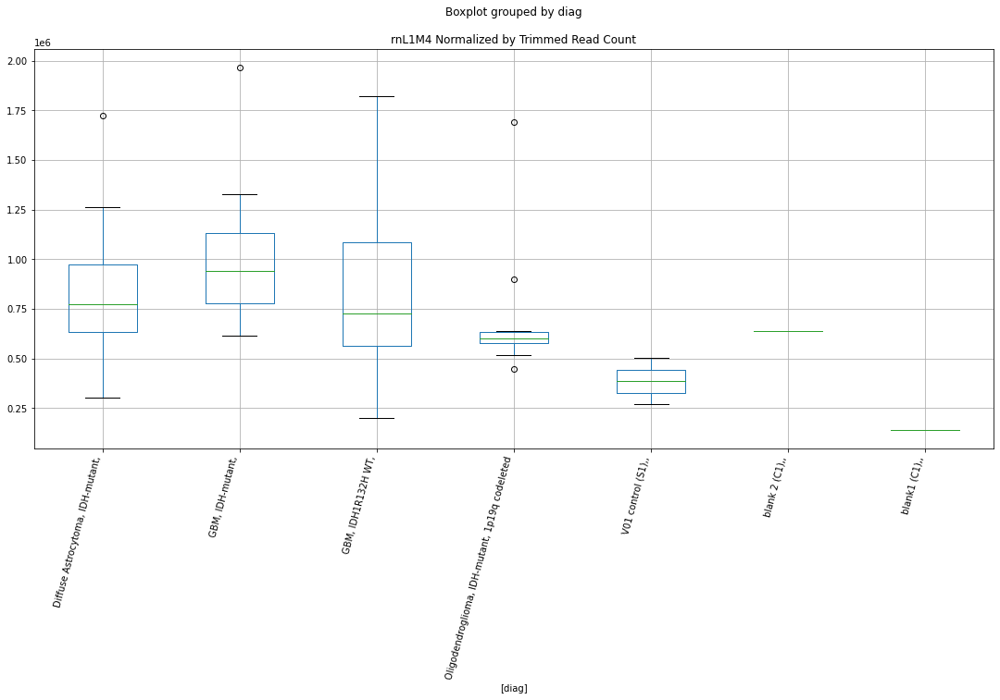

rnL1M4 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8461630806168672
	p = 0.08138004220147915
rnL1M4 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8461630806168672
	p = 0.08138004220147915


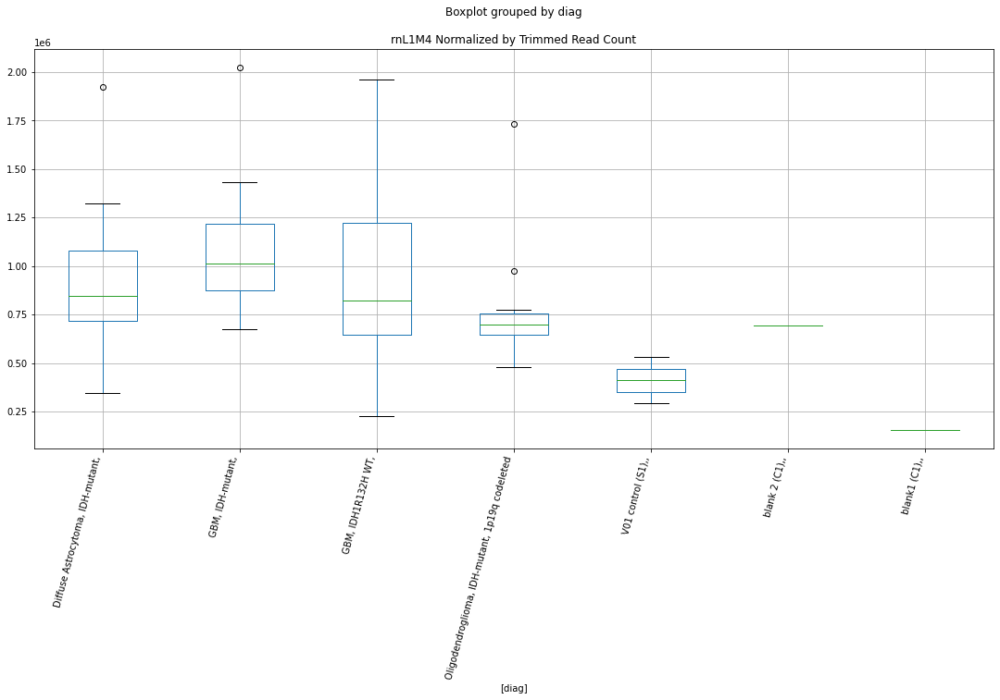

rnL1PA5 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7381752002937414
	p = 0.09925671357192513
rnL1PA5 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7381752002937414
	p = 0.09925671357192513


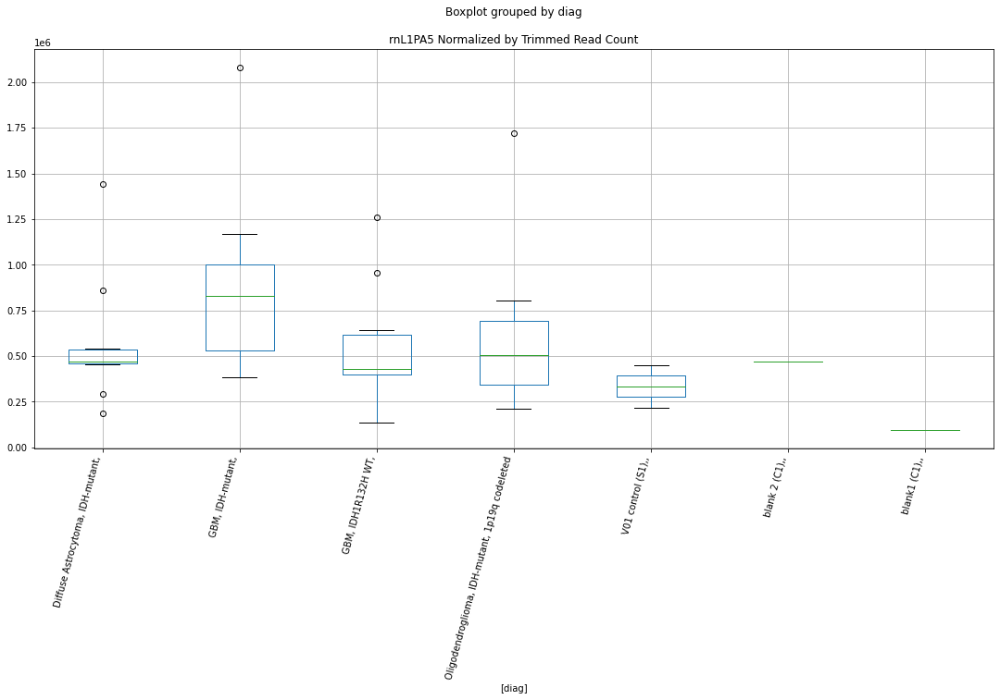

rnL1PA6 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7581572702689532
	p = 0.09571212008032923
rnL1PA6 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7581572702689532
	p = 0.09571212008032923


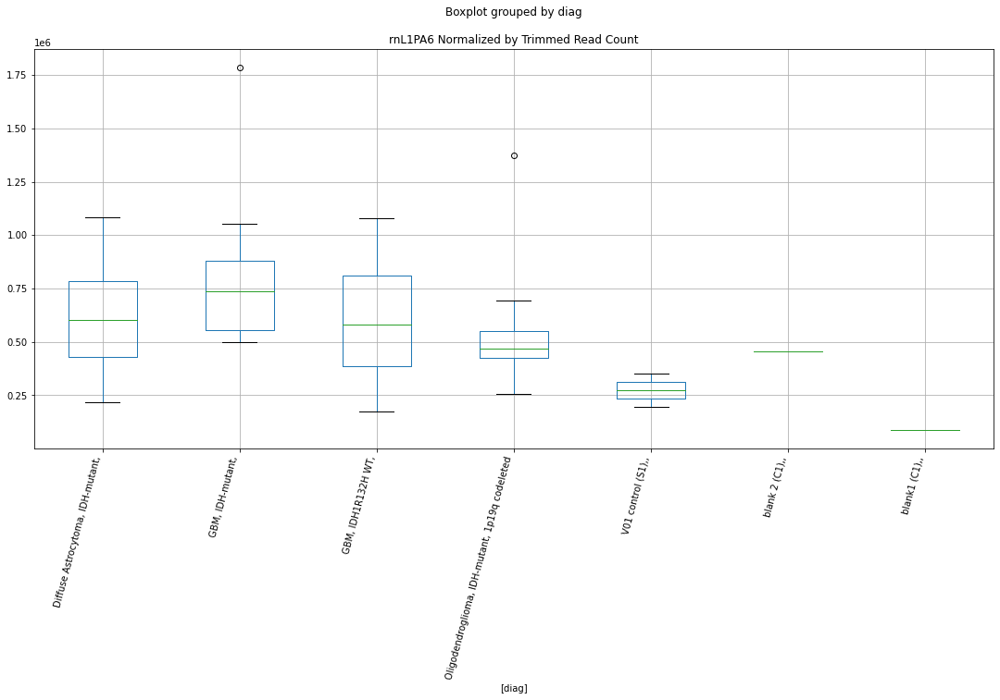

rnL1PA6 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.783594231276146
	p = 0.09135929922762157
rnL1PA6 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.783594231276146
	p = 0.09135929922762157


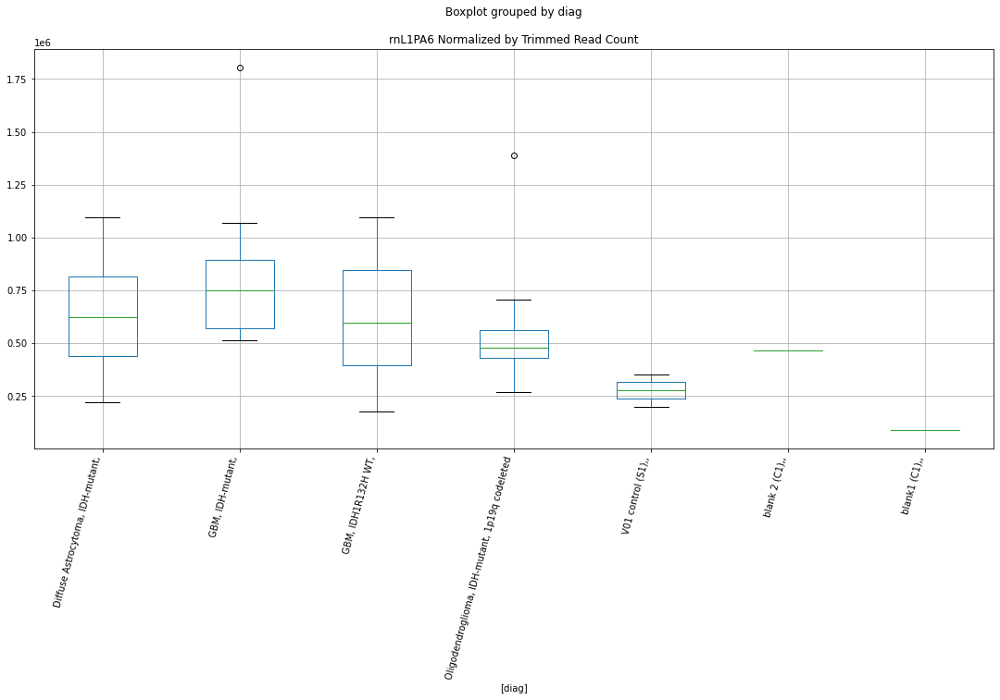

rnSSU-rRNA_Hsa D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8846323729158605
	p = 0.07573195364225373
rnSSU-rRNA_Hsa D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8846323729158605
	p = 0.07573195364225373


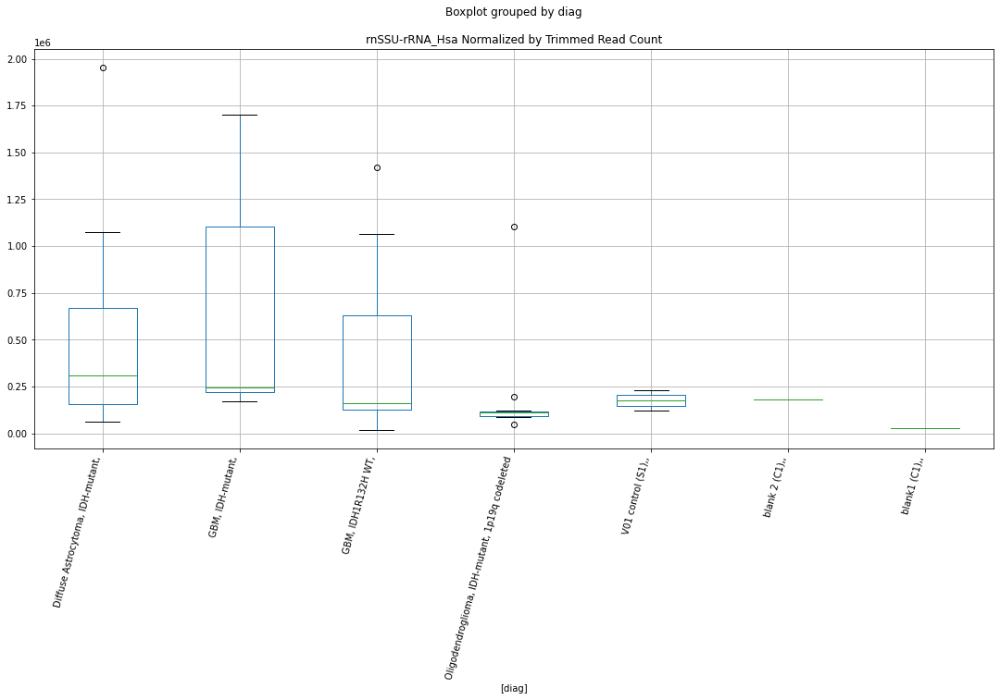

rnSSU-rRNA_Hsa D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8729266099866457
	p = 0.07741277990197999
rnSSU-rRNA_Hsa D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8729266099866457
	p = 0.07741277990197999


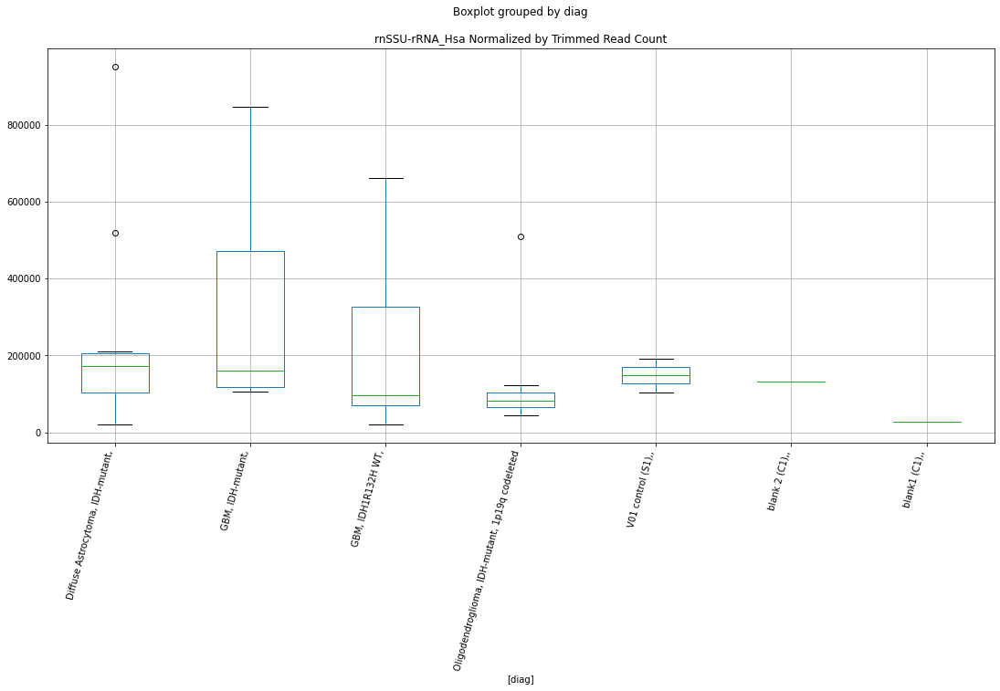

rnSSU-rRNA_Hsa D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.874811205924522
	p = 0.07713996443535275
rnSSU-rRNA_Hsa D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.874811205924522
	p = 0.07713996443535275


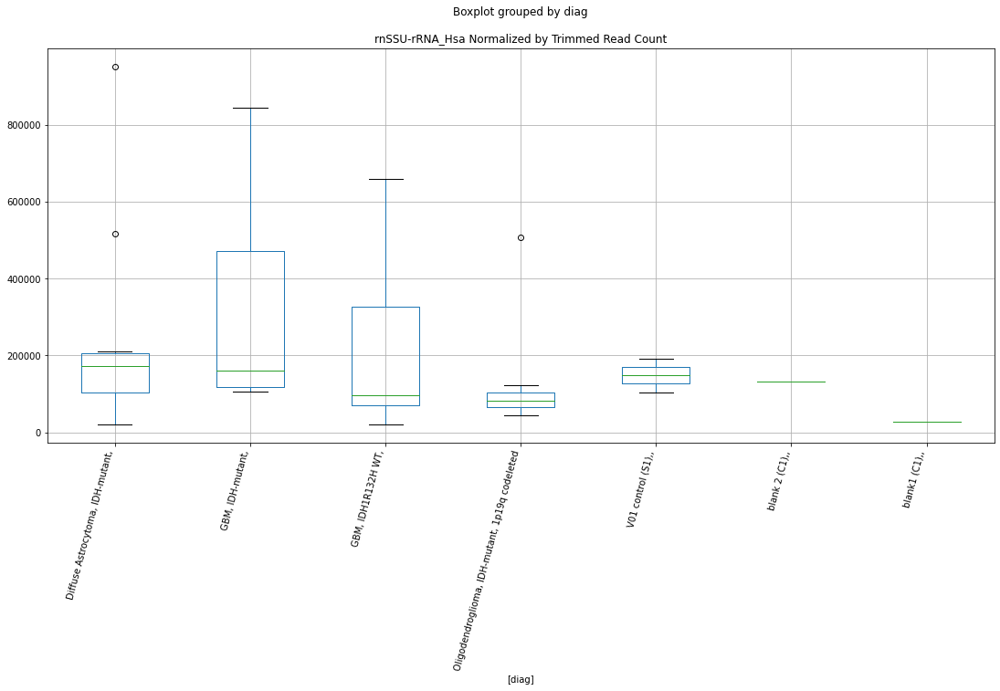

rnSSU-rRNA_Hsa D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.916672958113645
	p = 0.07129538029090113
rnSSU-rRNA_Hsa D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.916672958113645
	p = 0.07129538029090113


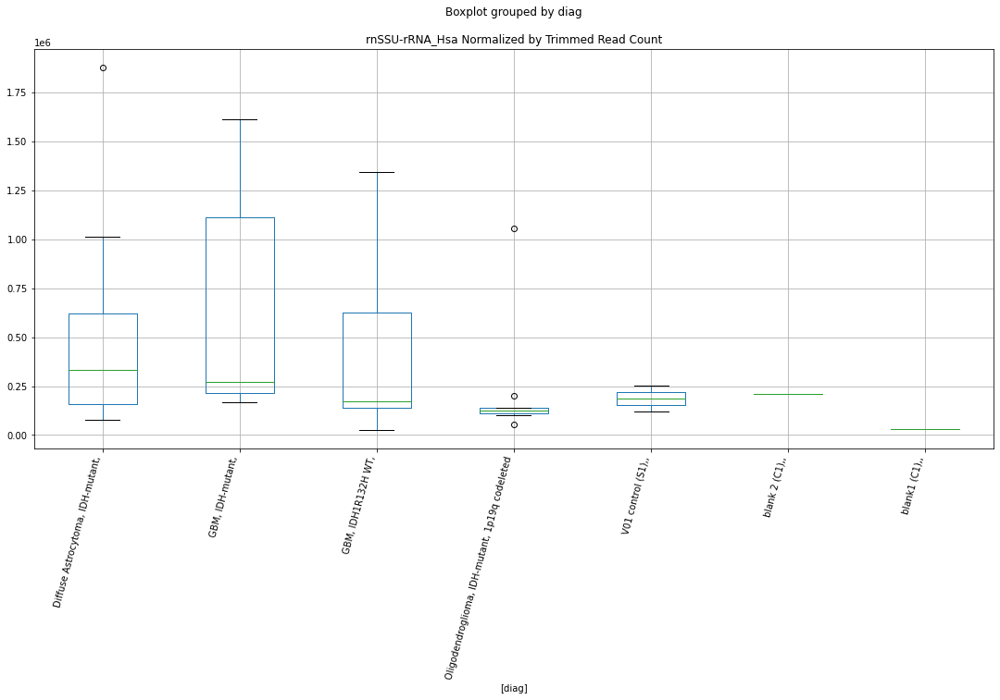

rnSSU-rRNA_Hsa D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9168953075006685
	p = 0.0712654160571624
rnSSU-rRNA_Hsa D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9168953075006685
	p = 0.0712654160571624


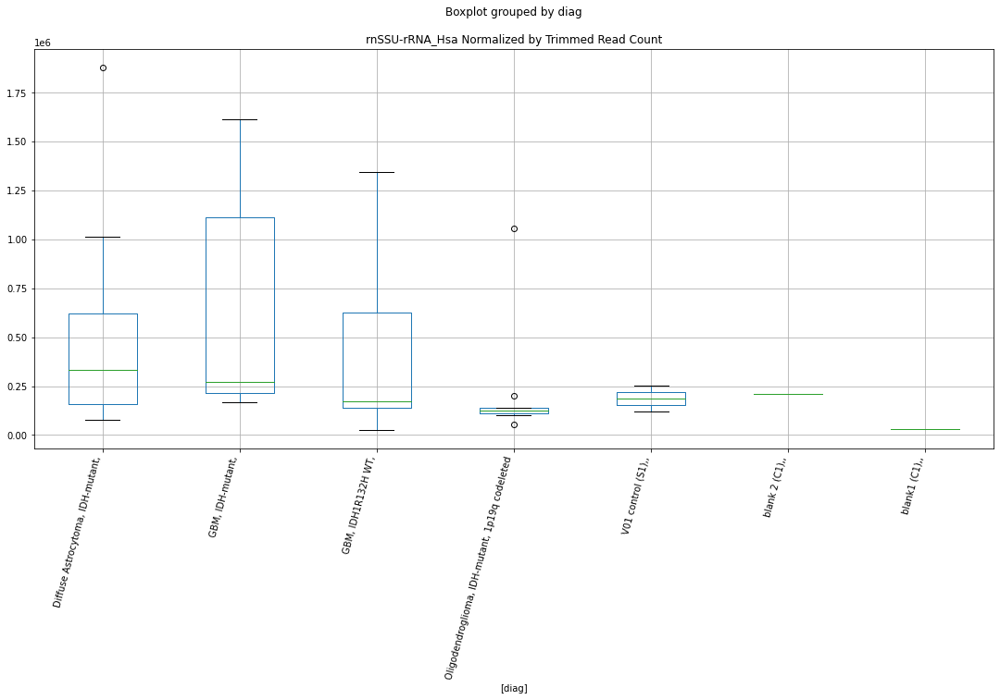

rnSSU-rRNA_Hsa D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9167292204309556
	p = 0.07128779721412283
rnSSU-rRNA_Hsa D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9167292204309556
	p = 0.07128779721412283


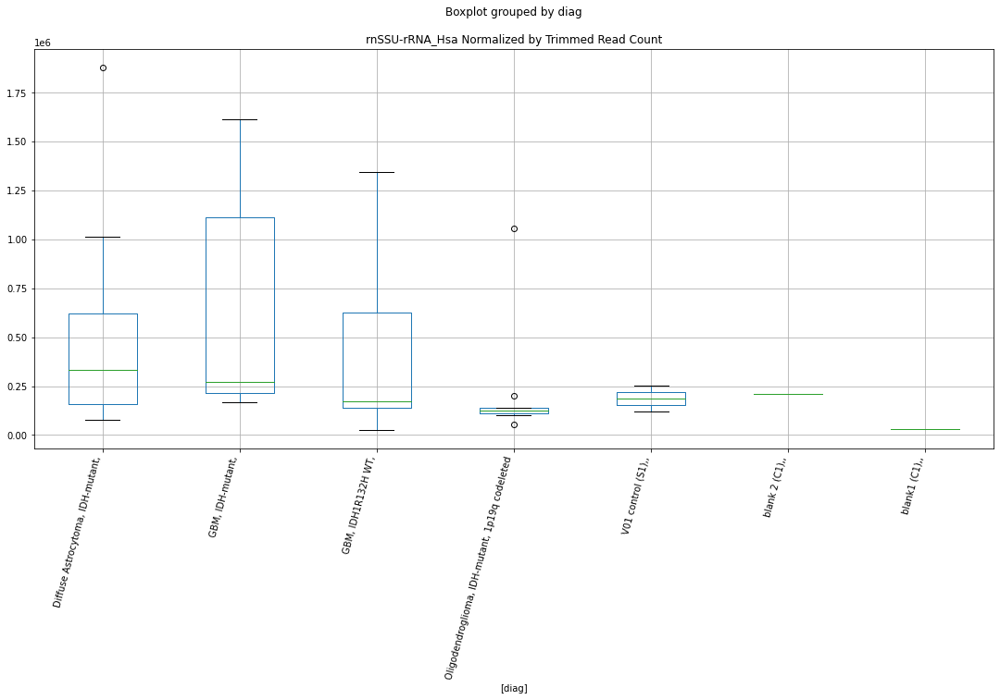

rnL1M2 D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8000626576425867
	p = 0.088634094480597
rnL1M2 D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8000626576425867
	p = 0.088634094480597


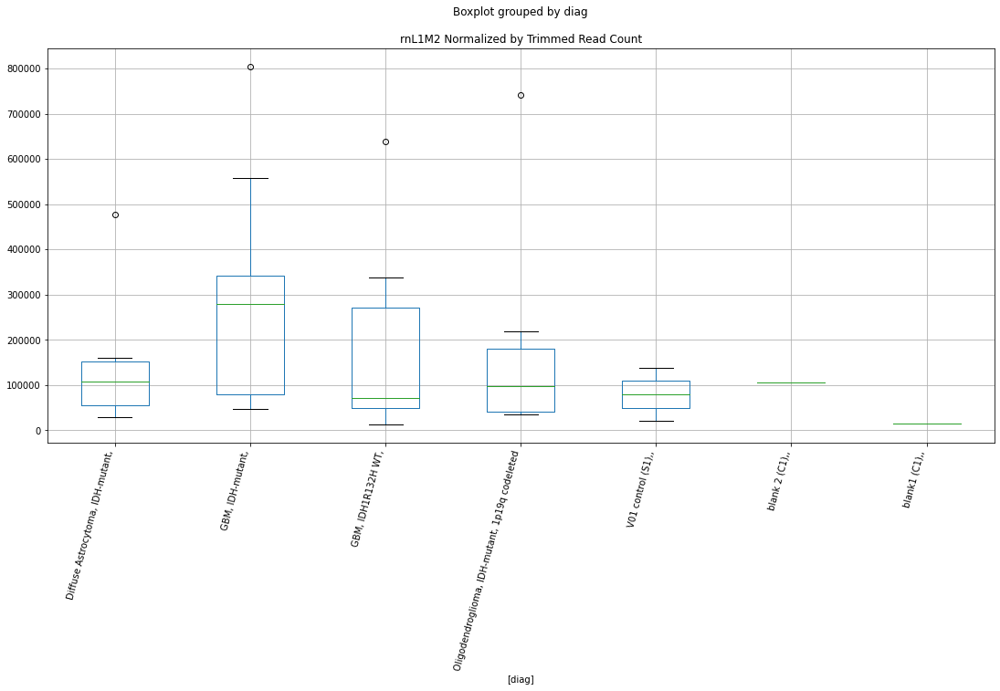

rnA-rich D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.096133237944129
	p = 0.006231800850104519
rnA-rich D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.12844154439128
	p = 0.04736910617142999
rnA-rich D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.096133237944129
	p = 0.006231800850104519
rnA-rich D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.12844154439128
	p = 0.04736910617142999
rnA-rich D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -1.7711942609065872
	p = 0.09345919065871787
rnA-rich D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7711942609065872
	p = 0.09345919065871787


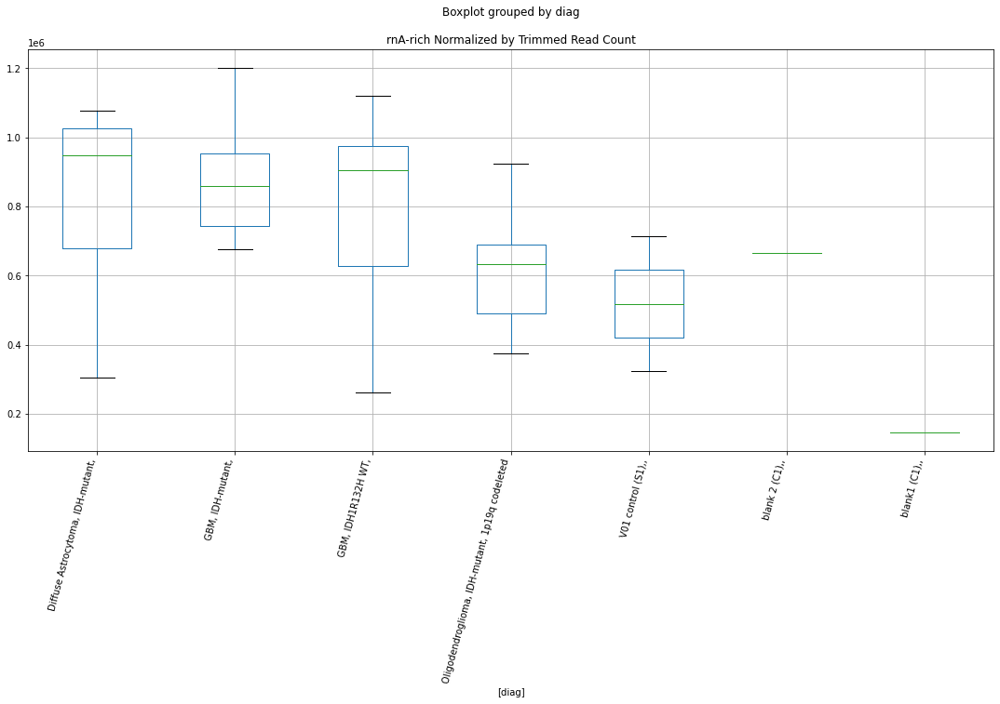

rnA-rich D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.172328501895471
	p = 0.005273524580288611
rnA-rich D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.132810227333638
	p = 0.04696325321943042
rnA-rich D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.172328501895471
	p = 0.005273524580288611
rnA-rich D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.132810227333638
	p = 0.04696325321943042
rnA-rich D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -1.7781728891312345
	p = 0.0922722732839207
rnA-rich D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7781728891312345
	p = 0.0922722732839207


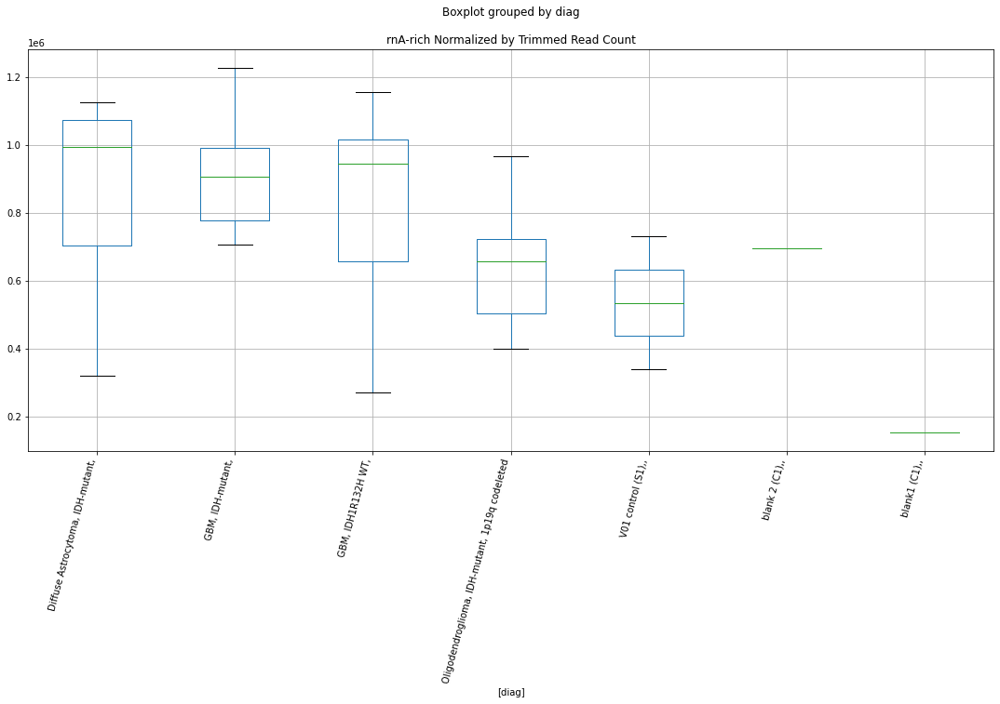

In [78]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsknames:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


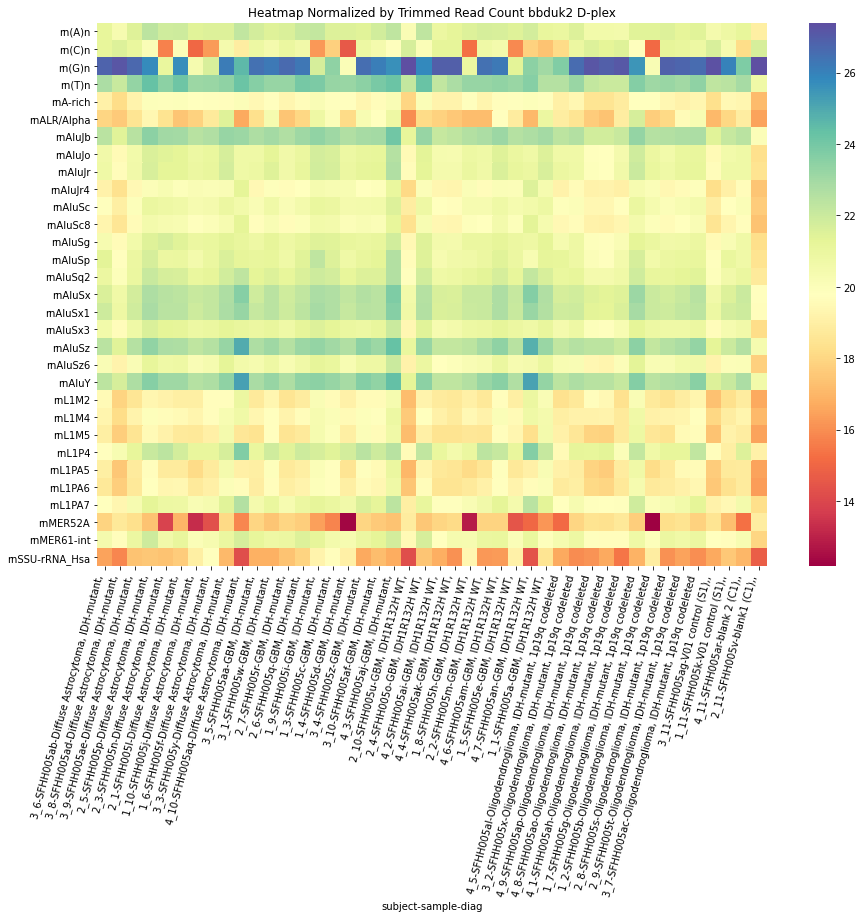

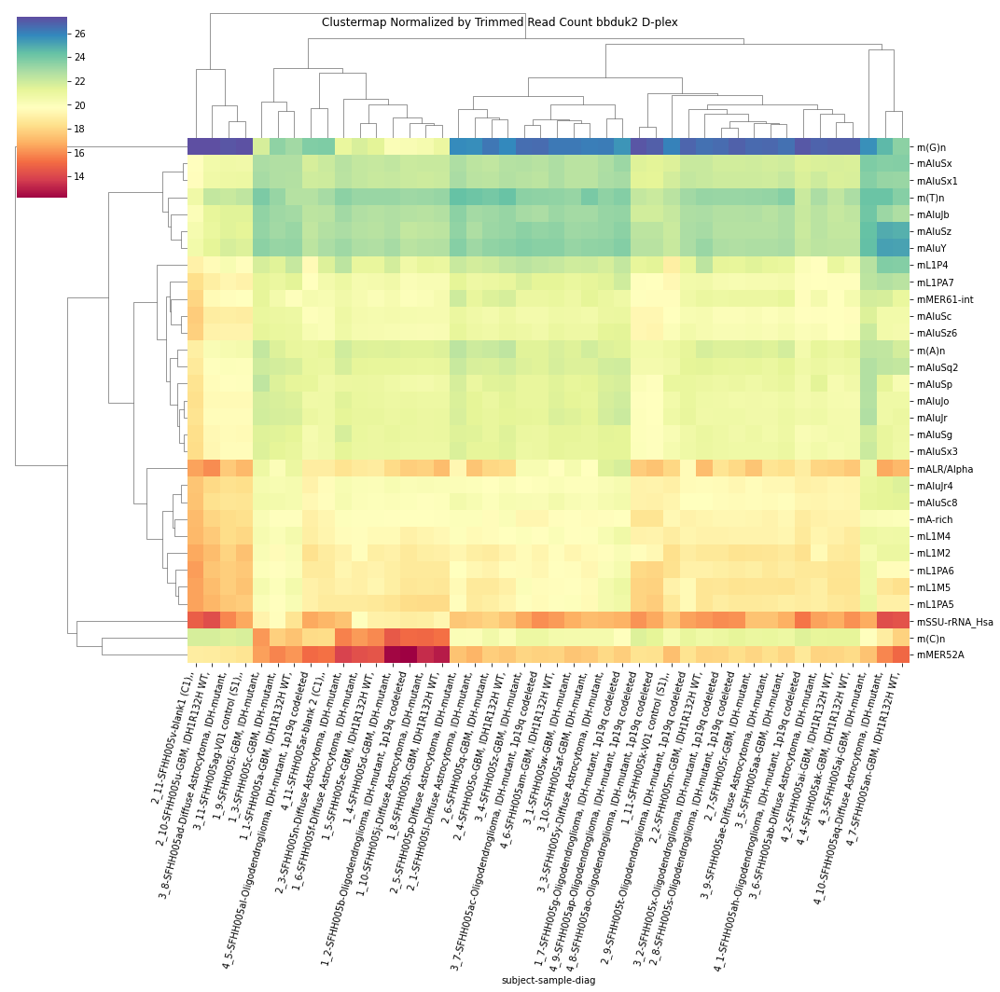

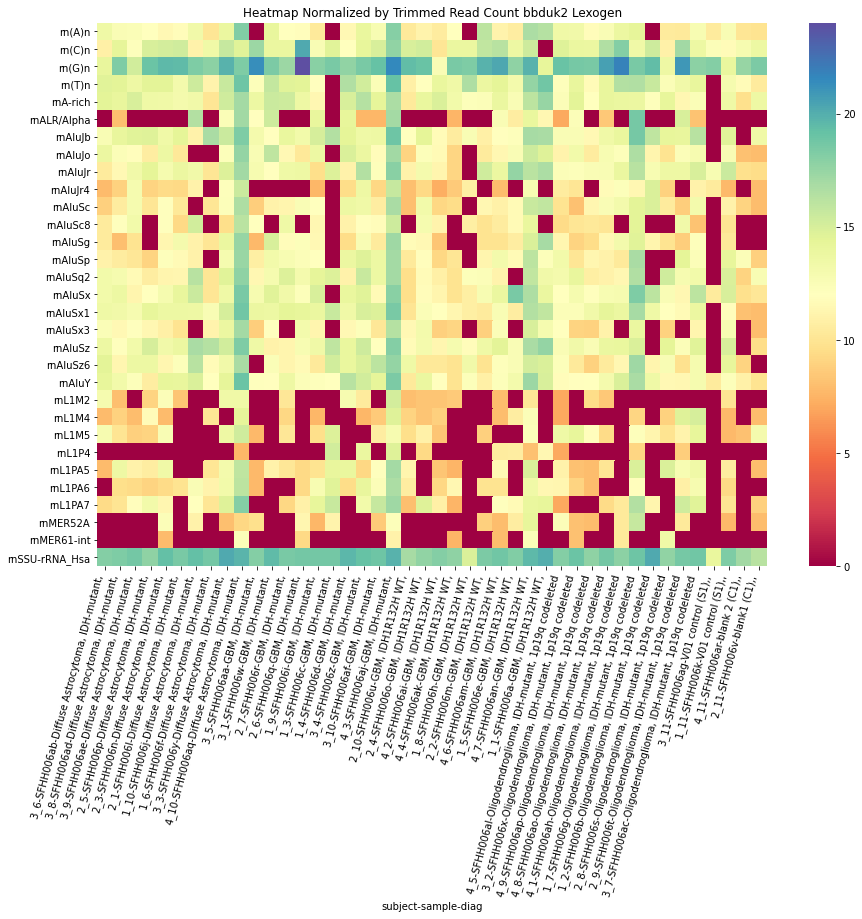

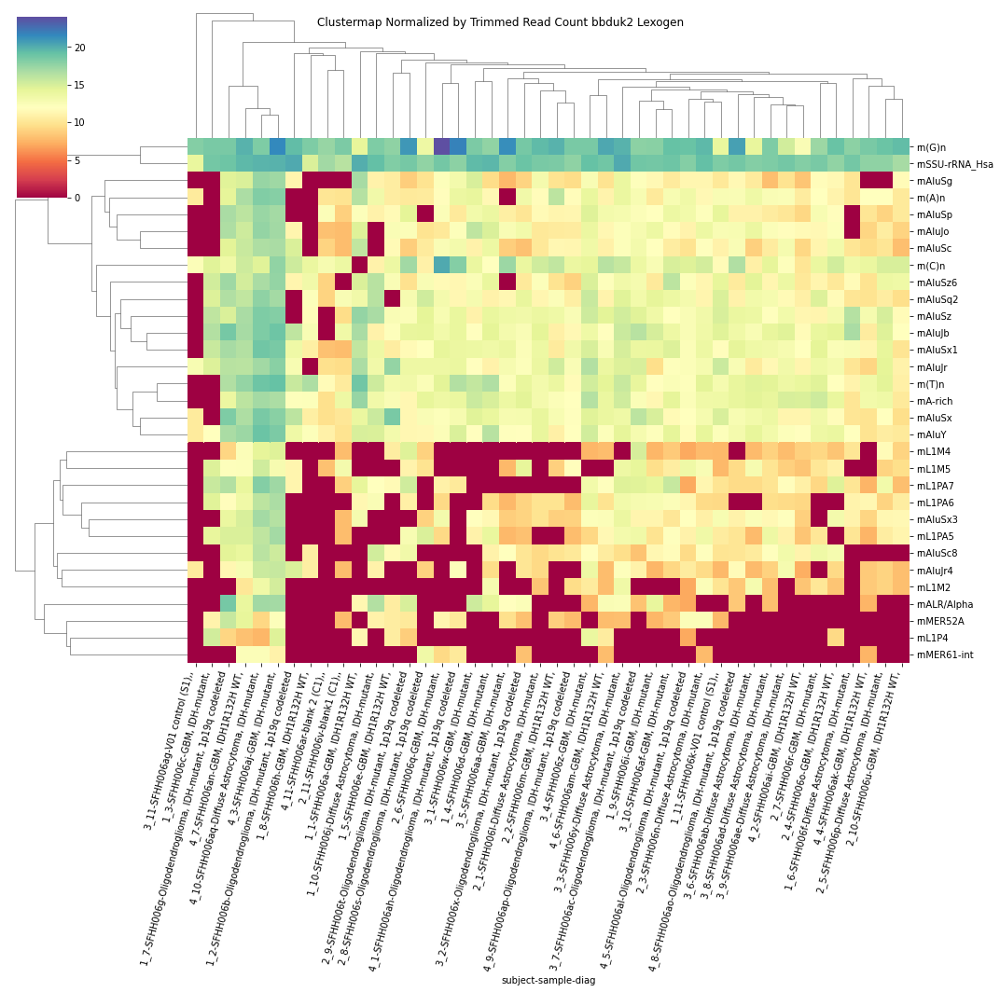

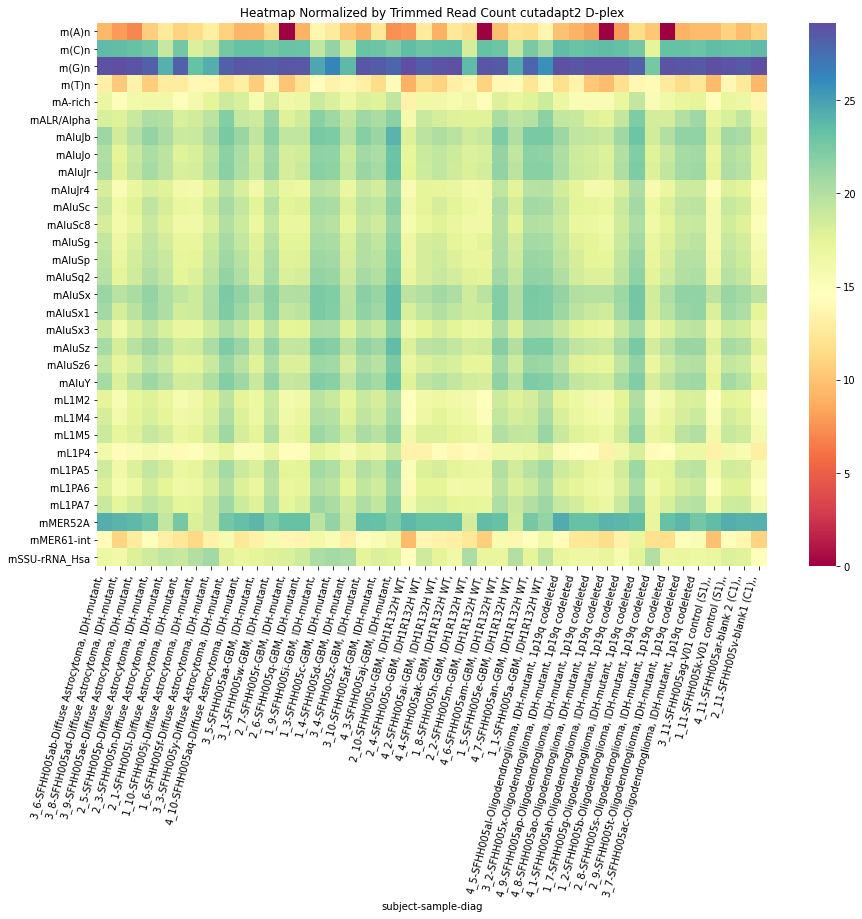

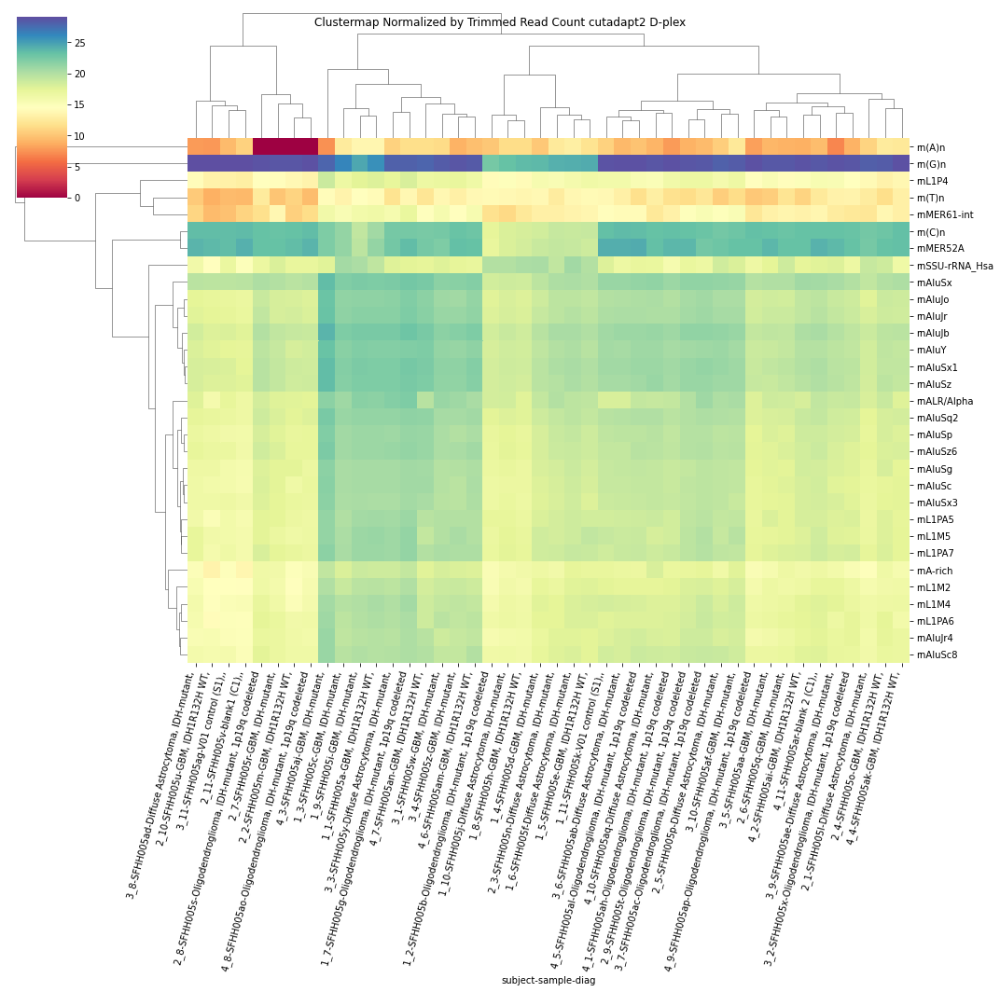

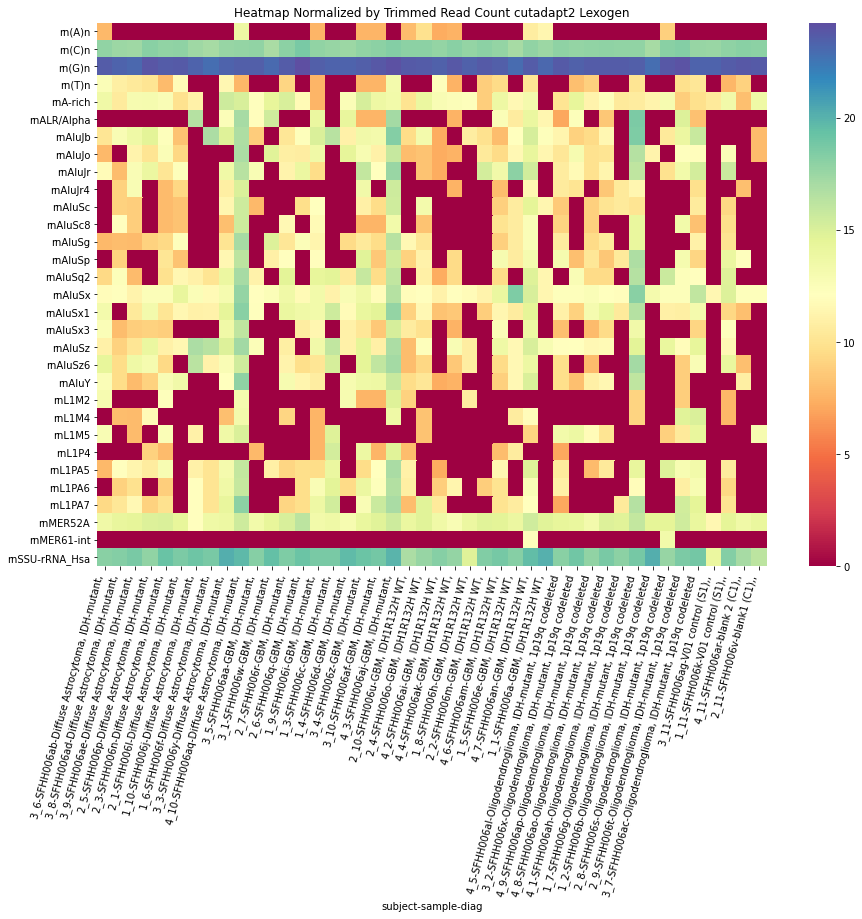

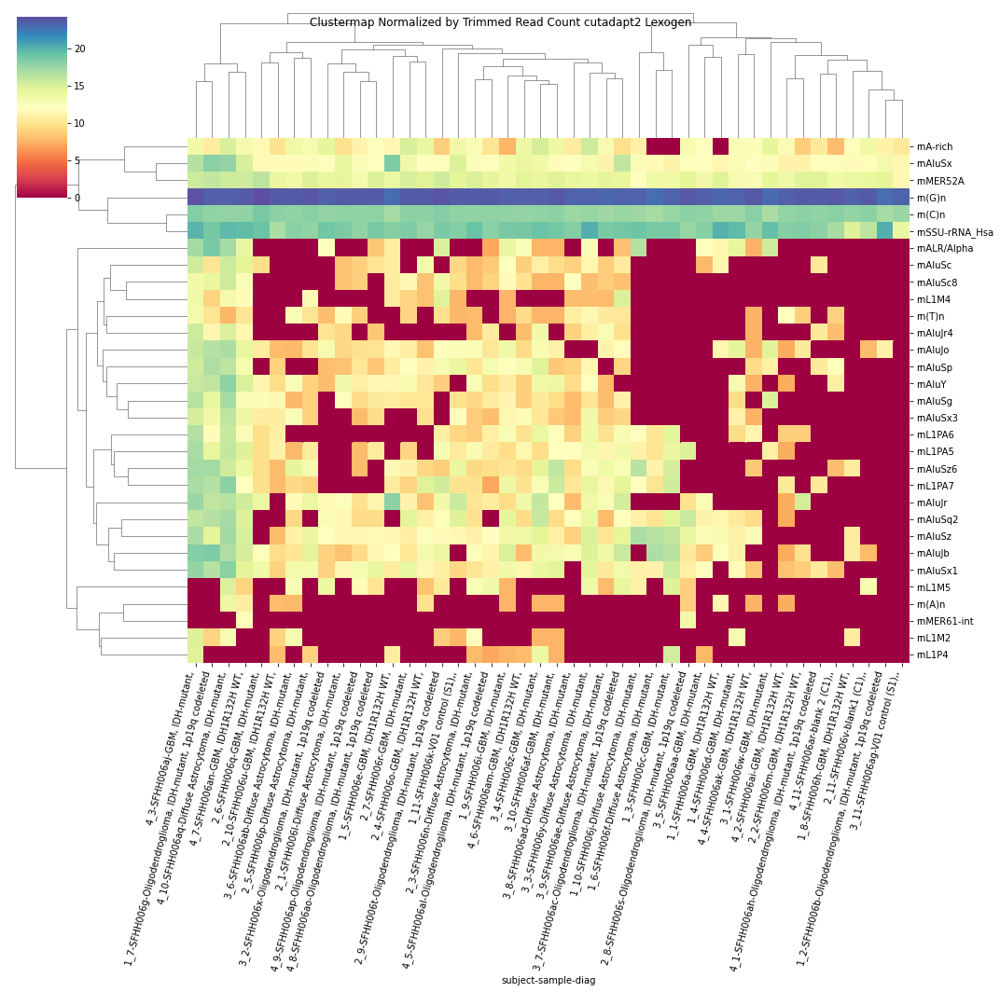

In [79]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap Normalized by Trimmed Read Count "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap Normalized by Trimmed Read Count "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

In [80]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [81]:
pd.set_option('display.max_columns', default_max_columns)

In [82]:
pd.set_option('display.max_rows',default_max_rows)

In [83]:
pd.set_option('display.precision', default_precision)